# Monte Carlo Methods

In this notebook, you will write your own implementations of many Monte Carlo (MC) algorithms. 

While we have provided some starter code, you are welcome to erase these hints and write your code from scratch.

### Part 0: Explore BlackjackEnv

We begin by importing the necessary packages.

In [1]:
import sys
import gym
import numpy as np
from collections import defaultdict

from plot_utils import plot_blackjack_values, plot_policy

Use the code cell below to create an instance of the [Blackjack](https://github.com/openai/gym/blob/master/gym/envs/toy_text/blackjack.py) environment.

In [2]:
env = gym.make('Blackjack-v0')

c:\users\simon.chauvin\documents\private github\gym\gym\__init__.py:22: UserWarning: DEPRECATION WARNING: to improve load times, gym no longer automatically loads gym.spaces. Please run "import gym.spaces" to load gym.spaces on your own. This warning will turn into an error in a future version of gym.
  warnings.warn('DEPRECATION WARNING: to improve load times, gym no longer automatically loads gym.spaces. Please run "import gym.spaces" to load gym.spaces on your own. This warning will turn into an error in a future version of gym.')


Each state is a 3-tuple of:
- the player's current sum $\in \{0, 1, \ldots, 31\}$,
- the dealer's face up card $\in \{1, \ldots, 10\}$, and
- whether or not the player has a usable ace (`no` $=0$, `yes` $=1$).

The agent has two potential actions:

```
    STICK = 0
    HIT = 1
```
Verify this by running the code cell below.

In [10]:
print(env.observation_space)
print(env.action_space)

Tuple(Discrete(32), Discrete(11), Discrete(2))
Discrete(2)


Execute the code cell below to play Blackjack with a random policy.  

(_The code currently plays Blackjack three times - feel free to change this number, or to run the cell multiple times.  The cell is designed for you to get some experience with the output that is returned as the agent interacts with the environment._)

In [5]:
for i_episode in range(3):
    state = env.reset()
    while True:
        print(state)
        action = env.action_space.sample()
        state, reward, done, info = env.step(action)
        if done:
            print('End game! Reward: ', reward)
            print('You won :)\n') if reward > 0 else print('You lost :(\n')
            break

(19, 10, False)
End game! Reward:  -1
You lost :(

(21, 4, True)
(14, 4, False)
(16, 4, False)
End game! Reward:  -1
You lost :(

(6, 10, False)
(15, 10, False)
End game! Reward:  -1
You lost :(



### Part 1: MC Prediction

In this section, you will write your own implementation of MC prediction (for estimating the action-value function).  

We will begin by investigating a policy where the player _almost_ always sticks if the sum of her cards exceeds 18.  In particular, she selects action `STICK` with 80% probability if the sum is greater than 18; and, if the sum is 18 or below, she selects action `HIT` with 80% probability.  The function `generate_episode_from_limit_stochastic` samples an episode using this policy. 

The function accepts as **input**:
- `bj_env`: This is an instance of OpenAI Gym's Blackjack environment.

It returns as **output**:
- `episode`: This is a list of (state, action, reward) tuples (of tuples) and corresponds to $(S_0, A_0, R_1, \ldots, S_{T-1}, A_{T-1}, R_{T})$, where $T$ is the final time step.  In particular, `episode[i]` returns $(S_i, A_i, R_{i+1})$, and `episode[i][0]`, `episode[i][1]`, and `episode[i][2]` return $S_i$, $A_i$, and $R_{i+1}$, respectively.

In [6]:
def generate_episode_from_limit_stochastic(bj_env):
    episode = []
    state = bj_env.reset()
    while True:
        probs = [0.8, 0.2] if state[0] > 18 else [0.2, 0.8]
        action = np.random.choice(np.arange(2), p=probs)
        next_state, reward, done, info = bj_env.step(action)
        episode.append((state, action, reward))
        state = next_state
        if done:
            break
    return episode

Execute the code cell below to play Blackjack with the policy. 

(*The code currently plays Blackjack three times - feel free to change this number, or to run the cell multiple times.  The cell is designed for you to gain some familiarity with the output of the `generate_episode_from_limit_stochastic` function.*)

In [7]:
for i in range(3):
    print(generate_episode_from_limit_stochastic(env))

[((21, 6, True), 0, 1.0)]
[((18, 5, False), 1, 0), ((19, 5, False), 0, -1.0)]
[((19, 4, False), 0, 1.0)]


Now, you are ready to write your own implementation of MC prediction.  Feel free to implement either first-visit or every-visit MC prediction; in the case of the Blackjack environment, the techniques are equivalent.

Your algorithm has three arguments:
- `env`: This is an instance of an OpenAI Gym environment.
- `num_episodes`: This is the number of episodes that are generated through agent-environment interaction.
- `generate_episode`: This is a function that returns an episode of interaction.
- `gamma`: This is the discount rate.  It must be a value between 0 and 1, inclusive (default value: `1`).

The algorithm returns as output:
- `Q`: This is a dictionary (of one-dimensional arrays) where `Q[s][a]` is the estimated action value corresponding to state `s` and action `a`.

In [11]:
# Every-Visit version
def mc_prediction_q(env, num_episodes, generate_episode, gamma=1.0):
    # initialize empty dictionaries of arrays
    returns_sum = defaultdict(lambda: np.zeros(env.action_space.n))
    N = defaultdict(lambda: np.zeros(env.action_space.n))
    Q = defaultdict(lambda: np.zeros(env.action_space.n))
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        # monitor progress
        if i_episode % 1000 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        # generate an episode
        episode = generate_episode(env)
        # obtain the states, actions, and rewards
        states, actions, rewards = zip(*episode)
        # prepare for discounting
        discounts = np.array([gamma**i for i in range(len(rewards)+1)])
        # update the sum of the returns, number of visits, and action-value 
        # function estimates for each state-action pair in the episode
        for i, state in enumerate(states):
            returns_sum[state][actions[i]] += sum(rewards[i:]*discounts[:-(1+i)])
            N[state][actions[i]] += 1.0
            Q[state][actions[i]] = returns_sum[state][actions[i]] / N[state][actions[i]]
    return Q

Use the cell below to obtain the action-value function estimate $Q$.  We have also plotted the corresponding state-value function.

To check the accuracy of your implementation, compare the plot below to the corresponding plot in the solutions notebook **Monte_Carlo_Solution.ipynb**.

(7, 8, False)
(16, 5, False)
(20, 5, False)
(14, 10, False)
(17, 10, False)
(20, 2, False)
(6, 1, False)
(13, 1, False)
(16, 5, False)
(9, 3, False)
(20, 3, True)
(20, 10, False)
(12, 2, False)
(14, 2, False)
(9, 1, False)
(17, 4, False)
(18, 10, False)
(17, 3, False)
(21, 10, True)
(16, 7, False)
(17, 7, False)
(10, 6, False)
(16, 6, False)
(20, 6, False)
(17, 6, False)
(14, 6, False)
(13, 2, False)
(21, 8, True)
(21, 8, False)
(17, 10, False)
(21, 10, False)
(13, 2, False)
(17, 2, False)
(13, 9, False)
(16, 9, False)
(10, 2, False)
(12, 2, False)
(16, 2, False)
(17, 10, False)
(20, 10, False)
(18, 10, False)
(17, 5, True)
(17, 5, False)
(21, 10, True)
(19, 10, False)
(13, 10, False)
(18, 6, False)
(20, 6, False)
(18, 7, True)
(12, 9, False)
(12, 10, True)
(17, 10, True)
(19, 10, True)
(17, 10, False)
(21, 10, True)
(16, 10, False)
(6, 10, False)
(20, 4, False)
(14, 6, False)
(17, 6, False)
(12, 5, False)
(14, 10, False)
(19, 9, False)
(20, 3, True)
(13, 9, False)
(15, 7, False)
(21, 

(12, 9, False)
(17, 9, False)
(17, 3, False)
(20, 3, False)
(10, 10, False)
(15, 10, False)
(17, 10, False)
(18, 1, False)
(20, 10, False)
(11, 7, False)
(16, 7, False)
(21, 7, False)
(15, 7, False)
(10, 10, False)
(20, 10, False)
(12, 6, False)
(14, 10, True)
(19, 10, True)
(20, 10, False)
(19, 10, False)
(15, 10, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(10, 10, False)
(21, 10, True)
(15, 7, False)
(18, 7, False)
(18, 7, False)
(17, 10, False)
(16, 9, False)
(20, 2, False)
(21, 3, True)
(20, 5, True)
(13, 5, False)
(16, 10, False)
(12, 8, False)
(16, 8, False)
(10, 7, False)
(12, 7, False)
(18, 10, False)
(16, 10, True)
(19, 10, True)
(19, 10, False)
(15, 5, False)
(7, 3, False)
(10, 3, False)
(20, 3, False)
(14, 9, True)
(14, 9, False)
(15, 9, False)
(18, 9, False)
(8, 7, False)
(14, 7, False)
(16, 9, False)
(9, 10, False)
(17, 10, False)
(9, 10, False)
(15, 10, False)
(21, 10, False)
(10, 3, False)
(17, 3, False)
(13, 10, False)
(13, 10, False)
(9, 10, False)
(14, 10,

(20, 8, False)
(19, 4, False)
(12, 2, False)
(17, 4, False)
(21, 4, False)
(7, 9, False)
(17, 9, False)
(10, 5, False)
(21, 5, True)
(13, 10, False)
(13, 10, False)
(12, 10, False)
(12, 7, False)
(14, 10, False)
(8, 3, False)
(18, 3, False)
(16, 9, False)
(12, 5, False)
(11, 6, False)
(19, 6, False)
(11, 10, False)
(21, 10, False)
(16, 7, False)
(6, 5, False)
(17, 5, True)
(20, 10, False)
(14, 10, False)
(17, 10, False)
(21, 10, False)
(18, 10, False)
(14, 10, False)
(14, 9, False)
(21, 9, False)
(18, 3, True)
(19, 3, True)
(10, 10, False)
(7, 9, False)
(17, 9, False)
(17, 9, False)
(7, 1, False)
(10, 1, False)
(12, 5, False)
(14, 5, False)
(20, 5, False)
(19, 7, False)
(14, 4, False)
(21, 4, False)
(18, 1, False)
(20, 1, False)
(12, 7, False)
(12, 10, False)
(12, 4, False)
(13, 4, False)
(19, 3, False)
(8, 9, False)
(14, 9, False)
(8, 6, False)
(18, 6, False)
(12, 4, False)
(12, 7, False)
(13, 7, False)
(20, 7, False)
(4, 4, False)
(14, 4, False)
(11, 5, False)
(20, 5, False)
(11, 3, 

(15, 10, False)
(19, 10, False)
(17, 10, False)
(20, 10, False)
(16, 10, False)
(18, 10, False)
(12, 1, False)
(10, 4, False)
(20, 4, False)
(10, 4, False)
(13, 10, False)
(15, 10, False)
(7, 10, False)
(17, 10, False)
(13, 1, False)
(15, 1, False)
(17, 1, False)
(6, 10, False)
(15, 10, False)
(20, 10, False)
(19, 8, False)
(20, 6, False)
(13, 10, False)
(18, 10, False)
(21, 10, True)
(20, 2, False)
(13, 5, True)
(12, 5, False)
(14, 10, False)
(13, 10, False)
(15, 5, False)
(15, 4, False)
(19, 4, False)
(14, 5, False)
(19, 5, False)
(12, 3, False)
(18, 3, False)
(19, 3, False)
(12, 10, False)
(17, 5, False)
(18, 5, False)
(18, 4, False)
(13, 6, False)
(9, 4, False)
(14, 4, False)
(20, 9, False)
(12, 8, False)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(11, 10, False)
(17, 10, False)
(18, 10, False)
(17, 10, False)
(18, 10, True)
(16, 10, False)
(15, 4, True)
(16, 4, True)
(12, 4, False)
(21, 2, True)
(12, 2, False)
(20, 6, False)
(10, 10, False)
(20, 10, False)
(10, 9, False)
(12,

(11, 10, False)
(12, 10, False)
(20, 10, False)
(19, 1, False)
(15, 10, False)
(17, 10, False)
(17, 10, False)
(20, 10, False)
(18, 3, False)
(16, 5, False)
(20, 8, False)
(17, 10, False)
(18, 10, False)
(8, 9, False)
(18, 9, False)
(11, 9, False)
(10, 10, False)
(12, 10, False)
(14, 6, False)
(17, 10, False)
(18, 9, True)
(14, 7, False)
(8, 5, False)
(18, 5, False)
(18, 7, False)
(10, 5, False)
(20, 5, False)
(18, 3, True)
(16, 3, False)
(14, 5, False)
(15, 5, False)
(18, 5, False)
(10, 2, False)
(17, 2, False)
(18, 2, False)
(21, 2, False)
(12, 1, False)
(14, 1, False)
(17, 1, False)
(20, 10, False)
(13, 3, True)
(17, 3, True)
(17, 3, False)
(20, 7, False)
(15, 10, False)
(13, 8, False)
(14, 8, False)
(16, 8, False)
(21, 10, True)
(14, 1, False)
(14, 10, True)
(17, 10, True)
(15, 10, False)
(21, 10, False)
(12, 7, False)
(19, 7, False)
(9, 10, False)
(14, 10, False)
(19, 3, False)
(14, 10, False)
(20, 4, False)
(18, 2, False)
(20, 9, False)
(20, 9, True)
(16, 10, False)
(21, 10, True

(18, 3, True)
(19, 3, True)
(15, 3, False)
(16, 3, False)
(21, 3, False)
(19, 10, False)
(8, 5, False)
(19, 5, True)
(11, 1, False)
(12, 1, False)
Episode 3000/500000.(9, 10, False)
(18, 10, False)
(15, 7, False)
(19, 7, False)
(15, 6, False)
(15, 3, False)
(9, 9, False)
(12, 9, False)
(10, 7, False)
(17, 7, False)
(14, 4, False)
(20, 10, True)
(20, 5, False)
(21, 1, True)
(20, 3, False)
(12, 4, False)
(14, 4, False)
(18, 4, False)
(10, 10, False)
(20, 10, False)
(19, 5, False)
(14, 1, False)
(19, 1, False)
(13, 9, False)
(19, 7, False)
(21, 10, True)
(13, 10, False)
(18, 10, False)
(19, 9, False)
(15, 9, False)
(9, 4, False)
(17, 4, False)
(11, 8, False)
(14, 8, False)
(19, 8, False)
(15, 7, False)
(18, 7, False)
(20, 7, False)
(21, 4, True)
(20, 4, False)
(15, 10, False)
(12, 10, False)
(21, 2, True)
(18, 7, False)
(13, 1, True)
(21, 1, True)
(14, 8, False)
(21, 2, True)
(18, 2, False)
(21, 2, False)
(15, 6, False)
(20, 6, False)
(21, 6, False)
(20, 6, False)
(14, 10, False)
(18, 6, 

(14, 3, False)
(17, 5, False)
(8, 5, False)
(19, 5, True)
(20, 8, True)
(16, 10, False)
(11, 7, False)
(14, 7, False)
(13, 4, False)
(18, 4, False)
(16, 9, False)
(18, 9, False)
(15, 10, False)
(13, 2, False)
(15, 2, False)
(19, 2, False)
(13, 8, False)
(20, 10, False)
(19, 9, False)
(20, 6, False)
(17, 10, False)
(14, 8, True)
(19, 8, True)
(19, 8, False)
(10, 10, False)
(18, 10, False)
(14, 10, False)
(11, 8, False)
(16, 8, False)
(20, 2, False)
(13, 10, False)
(21, 10, False)
(13, 10, False)
(18, 9, False)
(15, 10, False)
(19, 1, False)
(17, 1, False)
(16, 4, False)
(15, 10, False)
(21, 10, True)
(14, 5, False)
(11, 10, False)
(18, 10, False)
(12, 10, False)
(16, 10, False)
(14, 9, False)
(17, 10, False)
(15, 10, False)
(19, 8, False)
(9, 10, False)
(19, 10, False)
(12, 6, False)
(11, 5, False)
(21, 5, False)
(13, 1, False)
(17, 1, False)
(10, 8, False)
(14, 8, False)
(10, 7, False)
(15, 7, False)
(18, 7, False)
(16, 4, False)
(20, 10, False)
(8, 1, False)
(18, 1, False)
(13, 5, Fal

Episode 4000/500000.(15, 5, True)
(15, 5, False)
(15, 10, False)
(14, 10, False)
(9, 9, False)
(19, 9, False)
(12, 10, False)
(19, 7, False)
(17, 6, False)
(18, 6, False)
(12, 9, False)
(11, 8, False)
(15, 8, False)
(12, 8, False)
(14, 8, False)
(19, 1, False)
(17, 10, False)
(15, 10, False)
(21, 10, False)
(12, 9, True)
(12, 9, False)
(15, 9, False)
(21, 9, False)
(16, 8, True)
(14, 8, False)
(13, 1, False)
(18, 10, False)
(17, 9, False)
(19, 5, False)
(12, 1, False)
(20, 1, False)
(19, 4, False)
(14, 7, False)
(10, 4, False)
(17, 4, False)
(20, 10, False)
(12, 2, True)
(12, 2, False)
(15, 2, False)
(13, 5, True)
(21, 7, True)
(13, 8, False)
(15, 10, False)
(15, 8, False)
(19, 6, False)
(20, 1, False)
(8, 7, False)
(9, 9, False)
(17, 9, False)
(21, 9, False)
(15, 10, False)
(14, 1, False)
(9, 10, False)
(16, 10, False)
(20, 2, False)
(5, 7, False)
(13, 7, False)
(8, 5, False)
(14, 5, False)
(18, 7, True)
(15, 10, False)
(20, 9, False)
(14, 10, False)
(20, 6, False)
(12, 7, False)
(21,

(19, 5, True)
(15, 3, True)
(18, 3, True)
(18, 3, False)
(12, 7, False)
(6, 6, False)
(12, 6, False)
(19, 3, True)
(10, 2, False)
(16, 2, False)
(13, 10, False)
(14, 10, False)
(16, 4, False)
(19, 4, False)
(20, 5, True)
(18, 5, False)
(13, 10, False)
(18, 2, False)
(15, 10, False)
(20, 10, False)
(16, 3, False)
(15, 1, False)
(20, 1, False)
(20, 1, False)
(12, 1, False)
(21, 1, False)
(15, 10, False)
(20, 6, False)
(15, 4, False)
(8, 10, False)
(15, 10, False)
(14, 3, False)
(20, 3, False)
(20, 10, False)
(21, 7, True)
(17, 6, False)
(21, 6, False)
(6, 6, False)
(13, 6, False)
(15, 3, False)
(16, 4, False)
(19, 10, False)
(14, 9, False)
(12, 8, False)
(15, 8, False)
(16, 8, False)
(6, 10, False)
(9, 8, False)
(14, 8, False)
(16, 8, False)
(19, 8, False)
(15, 8, False)
(18, 8, False)
(15, 10, True)
(16, 10, True)
(21, 8, True)
(20, 10, False)
(18, 4, False)
(14, 4, False)
(10, 1, False)
(19, 1, False)
(15, 10, False)
(17, 10, False)
(21, 5, True)
(10, 10, False)
(17, 10, False)
(13, 10

Episode 5000/500000.(12, 9, False)
(18, 9, False)
(19, 9, False)
(9, 6, False)
(19, 6, False)
(10, 10, False)
(13, 10, False)
(14, 10, False)
(15, 3, False)
(14, 5, False)
(19, 5, False)
(20, 5, False)
(13, 8, False)
(16, 4, False)
(10, 9, False)
(18, 9, False)
(20, 9, False)
(13, 6, False)
(15, 9, True)
(19, 9, True)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(20, 10, False)
(13, 10, False)
(21, 10, False)
(20, 10, False)
(15, 3, False)
(21, 3, False)
(20, 9, False)
(15, 8, False)
(18, 3, False)
(20, 3, False)
(10, 5, False)
(8, 10, False)
(10, 10, False)
(13, 10, False)
(15, 10, False)
(18, 10, False)
(21, 7, True)
(17, 9, False)
(11, 10, False)
(10, 6, False)
(8, 7, False)
(18, 7, False)
(19, 7, False)
(17, 10, False)
(21, 5, True)
(20, 9, False)
(14, 1, False)
(20, 1, False)
(14, 6, False)
(17, 6, False)
(12, 6, False)
(17, 6, False)
(18, 3, False)
(16, 6, False)
(12, 10, False)
(12, 3, False)
(16, 3, False)
(17, 3, False)
(20, 10, False)
(18, 10, True)
(18, 10, False)
(18, 6, F

(12, 8, False)
(12, 7, False)
(20, 6, False)
(18, 5, False)
(18, 10, False)
(12, 10, False)
(16, 1, False)
(21, 1, False)
(18, 10, True)
(18, 10, False)
(18, 2, False)
(13, 8, False)
(18, 8, False)
(9, 10, False)
(15, 10, False)
(19, 10, False)
(14, 10, False)
(17, 10, False)
(19, 9, False)
(7, 3, False)
(12, 3, False)
(17, 3, False)
(19, 1, False)
(19, 6, False)
(12, 10, False)
(18, 10, False)
(13, 2, False)
(19, 2, False)
(10, 9, False)
(14, 9, False)
(20, 4, True)
(7, 3, False)
(14, 4, False)
(17, 5, False)
(21, 5, False)
(12, 9, False)
(18, 7, False)
(15, 10, False)
(19, 10, False)
(19, 8, False)
(19, 1, False)
(19, 4, True)
(15, 10, False)
(20, 10, False)
(17, 6, False)
(19, 6, False)
(15, 9, False)
(8, 9, False)
(18, 9, False)
(19, 9, False)
(13, 8, False)
(18, 8, False)
(14, 10, False)
(10, 8, False)
(14, 8, False)
(19, 8, False)
(18, 4, False)
(21, 9, True)
(15, 2, False)
(15, 10, False)
(13, 10, False)
(16, 10, False)
(20, 3, True)
(13, 3, False)
(18, 3, False)
(14, 7, False)


Episode 6000/500000.(14, 8, False)
(12, 5, False)
(12, 6, False)
(15, 6, False)
(13, 10, False)
(10, 1, False)
(20, 1, False)
(14, 10, False)
(10, 2, False)
(20, 2, False)
(20, 3, False)
(12, 10, False)
(15, 10, False)
(21, 10, False)
(18, 10, False)
(20, 3, False)
(19, 10, False)
(14, 7, False)
(13, 10, False)
(12, 10, False)
(16, 10, False)
(10, 4, False)
(12, 6, False)
(13, 2, True)
(18, 2, True)
(20, 2, True)
(20, 10, False)
(10, 3, False)
(21, 2, True)
(21, 2, False)
(16, 10, False)
(13, 2, False)
(14, 2, False)
(7, 1, False)
(13, 1, False)
(7, 10, False)
(12, 10, False)
(18, 10, False)
(19, 10, False)
(18, 3, False)
(15, 10, False)
(20, 10, True)
(19, 4, False)
(14, 5, False)
(18, 10, False)
(20, 7, False)
(8, 3, False)
(16, 3, False)
(17, 3, False)
(13, 10, False)
(18, 10, False)
(21, 10, False)
(10, 1, False)
(15, 1, False)
(21, 1, False)
(12, 1, False)
(13, 2, False)
(20, 1, False)
(20, 5, False)
(20, 9, False)
(21, 10, True)
(17, 3, False)
(21, 4, True)
(21, 10, True)
(18, 2,

(12, 6, False)
(13, 4, False)
(20, 4, False)
(14, 10, True)
(5, 10, False)
(12, 10, False)
(13, 10, False)
(5, 7, False)
(21, 7, True)
(16, 5, False)
(18, 5, True)
(9, 5, False)
(11, 5, False)
(15, 5, False)
(13, 8, False)
(20, 8, False)
(13, 3, False)
(7, 9, False)
(17, 9, False)
(20, 9, False)
(18, 10, True)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(20, 2, False)
(19, 3, True)
(20, 3, False)
(8, 10, False)
(12, 10, False)
(12, 10, False)
(20, 10, False)
(17, 2, True)
(17, 2, False)
(17, 10, False)
(17, 7, False)
(8, 1, False)
(16, 4, False)
(20, 10, False)
(18, 10, False)
(12, 10, False)
(20, 10, False)
(19, 4, True)
(20, 7, False)
(13, 8, False)
(20, 7, False)
(13, 10, False)
(16, 7, False)
(16, 2, False)
(19, 4, False)
(20, 10, True)
(14, 5, False)
(16, 5, False)
(21, 1, True)
(20, 10, True)
(15, 6, True)
(20, 6, True)
(17, 10, False)
(11, 8, False)
(12, 8, False)
(10, 1, False)
(14, 1, False)
(21, 1, False)
(14, 9, False)
(20, 1, False)
(11, 6, False)
(21, 6, False)
(11, 7,

Episode 7000/500000.(11, 7, False)
(13, 7, False)
(8, 2, False)
(18, 2, False)
(12, 10, False)
(15, 1, False)
(21, 1, False)
(11, 3, False)
(20, 9, False)
(19, 10, False)
(13, 10, False)
(14, 8, False)
(16, 8, False)
(11, 8, False)
(19, 8, False)
(14, 9, False)
(14, 10, True)
(14, 10, False)
(16, 10, False)
(13, 2, False)
(13, 6, False)
(19, 6, False)
(17, 7, True)
(17, 7, False)
(20, 7, False)
(15, 2, False)
(9, 7, False)
(18, 7, False)
(7, 9, False)
(7, 2, False)
(14, 2, False)
(21, 2, False)
(12, 6, False)
(12, 2, False)
(17, 8, False)
(6, 6, False)
(14, 6, False)
(16, 6, False)
(20, 7, False)
(13, 10, False)
(18, 10, False)
(19, 10, False)
(14, 1, False)
(20, 10, False)
(19, 10, False)
(15, 6, False)
(21, 6, False)
(10, 3, False)
(10, 10, False)
(13, 10, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(15, 10, True)
(17, 10, True)
(21, 10, True)
(8, 9, False)
(13, 9, False)
(14, 9, False)
(20, 9, False)
(15, 3, False)
(16, 3, False)
(16, 7, False)
(8, 8, False)
(12, 10, Fals

(9, 4, False)
(19, 4, False)
(16, 6, False)
(21, 4, True)
(14, 2, False)
(6, 7, False)
(11, 7, False)
(19, 7, False)
(13, 2, False)
(16, 2, False)
(17, 5, False)
(15, 7, False)
(13, 10, False)
(18, 10, False)
(17, 10, False)
(19, 6, False)
(20, 2, True)
(20, 5, False)
(9, 9, False)
(18, 9, False)
(13, 4, False)
(21, 4, False)
(10, 10, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(8, 10, False)
(7, 6, False)
(17, 6, False)
(18, 6, False)
(12, 10, True)
(14, 10, True)
(15, 10, True)
(21, 10, True)
(16, 4, False)
(14, 4, False)
(16, 3, False)
(9, 8, False)
(19, 8, False)
(13, 5, False)
(20, 3, False)
(13, 10, False)
(13, 7, False)
(8, 2, False)
(11, 2, False)
(17, 2, False)
(15, 5, False)
(15, 10, False)
(16, 10, False)
(12, 10, False)
(13, 10, False)
(14, 10, False)
(16, 10, False)
(13, 7, False)
(14, 7, False)
(19, 7, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(18, 5, False)
(20, 10, True)
(17, 10, False)
(17, 2, False)
(15, 7, False)
(18, 7, False)
(20, 7, False)
(

Episode 8000/500000.(12, 10, False)
(12, 3, False)
(20, 3, False)
(15, 3, False)
(10, 2, False)
(17, 2, False)
(20, 2, False)
(21, 8, True)
(12, 10, False)
(18, 8, False)
(12, 10, False)
(13, 10, False)
(20, 10, False)
(14, 8, True)
(14, 8, False)
(16, 8, False)
(17, 8, False)
(20, 8, False)
(17, 6, False)
(17, 10, False)
(19, 10, False)
(19, 2, False)
(11, 10, False)
(18, 10, False)
(17, 9, False)
(15, 6, False)
(12, 4, False)
(15, 5, False)
(11, 3, False)
(15, 3, False)
(20, 3, False)
(10, 10, False)
(13, 2, False)
(21, 9, True)
(18, 6, False)
(19, 6, False)
(14, 9, False)
(15, 1, False)
(14, 7, True)
(19, 7, True)
(9, 10, False)
(16, 10, False)
(20, 10, False)
(17, 10, False)
(19, 10, False)
(11, 9, False)
(13, 9, False)
(20, 9, False)
(15, 2, False)
(19, 2, False)
(11, 10, False)
(16, 10, False)
(15, 8, False)
(20, 7, False)
(13, 5, False)
(21, 5, False)
(14, 2, False)
(6, 9, False)
(17, 9, True)
(12, 9, False)
(20, 9, False)
(21, 10, True)
(12, 10, False)
(19, 10, False)
(16, 9, T

(20, 3, False)
(11, 10, False)
(21, 10, False)
(7, 9, False)
(17, 9, False)
(12, 5, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(19, 4, False)
(12, 5, False)
(19, 5, False)
(13, 3, False)
(21, 3, False)
(20, 6, False)
(11, 1, False)
(18, 1, False)
(20, 6, False)
(11, 5, False)
(12, 5, False)
(14, 7, False)
(17, 7, False)
(12, 10, False)
(19, 10, False)
(12, 10, False)
(14, 10, False)
(13, 7, False)
(18, 7, False)
(12, 6, False)
(16, 9, False)
(21, 10, True)
(10, 3, False)
(13, 3, False)
(16, 3, False)
(15, 5, False)
(21, 5, True)
(7, 10, False)
(17, 10, False)
(20, 3, False)
(7, 6, False)
(16, 6, False)
(16, 10, True)
(20, 10, True)
(19, 10, True)
(21, 1, True)
(7, 10, False)
(17, 10, False)
(15, 10, True)
(18, 10, False)
(14, 7, True)
(20, 7, True)
(14, 3, False)
(15, 3, False)
(19, 10, False)
(7, 9, False)
(12, 9, False)
(19, 9, False)
(12, 2, False)
(10, 10, False)
(19, 10, False)
(18, 9, False)
(20, 3, False)
(11, 10, False)
(13, 1, False)
(17, 1, False)
(2

(15, 10, False)
(18, 10, False)
(19, 10, False)
(15, 1, False)
(13, 6, False)
(18, 2, False)
(19, 2, False)
(15, 1, False)
(18, 9, False)
(15, 2, False)
(19, 2, False)
(20, 4, False)
(13, 10, False)
(21, 10, False)
(17, 5, False)
(11, 7, False)
(21, 7, False)
(16, 10, True)
(16, 10, False)
(17, 9, False)
(20, 9, False)
(12, 3, False)
(21, 3, False)
(16, 10, False)
(19, 10, False)
(14, 6, False)
(12, 10, False)
(10, 2, False)
(19, 2, False)
(17, 4, False)
(14, 10, False)
(13, 3, False)
(14, 10, False)
(18, 10, False)
(19, 3, False)
(9, 3, False)
(19, 3, False)
(14, 10, True)
(12, 10, False)
(17, 10, False)
(19, 6, False)
(14, 10, False)
(18, 10, False)
(19, 3, True)
(14, 3, False)
(18, 3, False)
(14, 4, False)
(17, 4, False)
(19, 4, False)
(14, 10, False)
(17, 4, False)
(12, 3, False)
(16, 3, False)
(20, 10, False)
(15, 7, False)
(20, 10, False)
(17, 10, True)
(13, 10, False)
(14, 10, False)
(7, 2, False)
(13, 2, False)
(19, 2, False)
(18, 2, False)
(20, 2, False)
(16, 10, True)
(16, 10

(17, 3, False)
(18, 3, False)
(10, 5, False)
(18, 5, False)
(6, 10, False)
(11, 10, False)
(16, 10, False)
(12, 3, False)
(21, 3, False)
(8, 10, False)
(16, 10, False)
(17, 10, False)
(12, 2, False)
(20, 2, False)
(20, 6, False)
(21, 6, False)
(16, 1, False)
(18, 1, False)
(14, 8, True)
(17, 8, True)
(17, 8, False)
(12, 5, True)
(12, 5, False)
(19, 5, False)
(14, 10, True)
(14, 10, False)
(18, 10, False)
(21, 10, False)
(18, 10, False)
(18, 7, False)
(19, 7, False)
(13, 10, False)
(17, 5, False)
(21, 5, False)
(17, 10, False)
(13, 7, False)
(13, 1, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, False)
(19, 10, False)
(12, 10, False)
(14, 8, True)
(20, 8, True)
(20, 8, False)
(18, 10, True)
(13, 10, False)
(19, 10, False)
(10, 5, False)
(20, 5, False)
(16, 10, False)
(9, 2, False)
(18, 2, False)
(13, 10, False)
(15, 10, False)
(17, 5, False)
(21, 5, False)
(20, 4, False)
(12, 7, False)
(15, 7, False)
(21, 7, False)
(19, 10, True)
(15, 10, False)
(17, 10, False)
(15, 8, 

(16, 10, False)
(5, 2, False)
(15, 2, False)
(15, 1, False)
(12, 2, False)
(16, 2, False)
(21, 2, False)
(16, 8, False)
(13, 8, False)
(19, 8, False)
(6, 1, False)
(15, 10, False)
(16, 8, False)
(13, 10, False)
(15, 10, False)
(14, 10, False)
(14, 8, False)
(11, 10, False)
(14, 10, False)
(18, 10, False)
(10, 9, False)
(19, 9, False)
(16, 10, True)
(18, 10, True)
(21, 10, True)
(16, 10, True)
(12, 10, False)
(13, 3, False)
(18, 3, False)
(15, 4, False)
(21, 4, False)
(20, 2, False)
(19, 5, False)
(6, 7, False)
(15, 7, False)
(12, 10, False)
(10, 4, False)
(12, 4, False)
(14, 2, False)
(18, 10, False)
(12, 4, False)
(19, 4, False)
(17, 3, True)
(16, 3, False)
(15, 8, False)
(21, 8, False)
(14, 9, False)
(20, 9, False)
(7, 6, False)
(13, 6, False)
(16, 3, False)
(21, 3, False)
(16, 2, True)
(7, 10, False)
(14, 10, False)
(18, 6, False)
(16, 10, False)
(19, 3, False)
(14, 10, False)
(20, 10, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(13, 7, False)
(20, 7, False)
(12, 2, False

(18, 8, False)
(17, 10, False)
(21, 10, False)
(16, 3, False)
(11, 10, False)
(17, 10, False)
(20, 10, False)
(8, 10, False)
(16, 10, False)
(20, 10, False)
(11, 7, False)
(12, 7, False)
(18, 6, False)
(19, 7, False)
(14, 1, True)
(14, 8, False)
(16, 8, False)
(11, 5, False)
(16, 5, False)
(13, 5, False)
(20, 5, False)
(18, 10, False)
(17, 6, False)
(19, 2, False)
(18, 7, False)
(14, 5, False)
(15, 5, False)
(17, 5, False)
(17, 7, False)
(16, 10, True)
(12, 10, False)
(20, 10, False)
(9, 4, False)
(13, 4, False)
(19, 2, False)
(19, 2, True)
(15, 2, False)
(19, 10, False)
(14, 5, False)
(19, 1, False)
(6, 10, False)
(16, 10, False)
(17, 10, False)
(17, 1, False)
(21, 1, False)
(14, 10, False)
(20, 1, False)
(17, 10, False)
(10, 3, False)
(20, 10, False)
(18, 7, False)
(19, 7, False)
(12, 5, False)
(14, 10, True)
(13, 10, False)
(9, 10, False)
(19, 10, False)
(19, 5, False)
(16, 10, False)
(17, 10, False)
(15, 10, True)
(14, 10, False)
(11, 7, False)
(21, 7, False)
(15, 8, False)
(21, 10

Episode 11000/500000.(16, 3, False)
(14, 10, False)
(21, 10, False)
(16, 8, True)
(13, 8, False)
(18, 8, False)
(13, 6, False)
(18, 6, False)
(15, 9, False)
(20, 9, False)
(14, 6, False)
(12, 5, False)
(13, 5, False)
(12, 10, False)
(18, 7, False)
(13, 9, False)
(18, 3, False)
(9, 10, False)
(13, 10, False)
(19, 9, False)
(14, 3, False)
(17, 3, False)
(18, 3, False)
(19, 3, False)
(18, 10, True)
(15, 10, False)
(16, 10, False)
(21, 10, False)
(11, 9, False)
(21, 9, False)
(19, 4, False)
(15, 7, False)
(17, 2, False)
(19, 2, False)
(14, 6, False)
(17, 1, False)
(20, 1, False)
(15, 2, False)
(13, 10, False)
(10, 1, False)
(20, 1, False)
(20, 3, False)
(19, 7, False)
(20, 5, False)
(9, 3, False)
(17, 3, False)
(14, 10, False)
(16, 10, False)
(16, 10, False)
(19, 10, False)
(18, 7, True)
(15, 7, False)
(6, 3, False)
(15, 3, False)
(19, 5, True)
(17, 6, False)
(17, 10, False)
(19, 10, False)
(14, 9, False)
(15, 10, False)
(17, 10, False)
(17, 10, False)
(12, 10, False)
(14, 10, False)
(17, 

(16, 10, False)
(14, 10, False)
(20, 10, False)
(13, 2, False)
(18, 6, False)
(5, 1, False)
(10, 9, False)
(15, 9, False)
(13, 3, False)
(20, 10, False)
(14, 7, True)
(17, 7, True)
(14, 7, False)
(15, 7, False)
(21, 7, False)
(17, 3, False)
(7, 3, False)
(11, 3, False)
(15, 3, False)
(18, 3, False)
(10, 10, False)
(19, 10, False)
(6, 6, False)
(13, 6, False)
(15, 6, False)
(20, 10, False)
(17, 1, False)
(12, 9, False)
(20, 10, False)
(11, 7, False)
(20, 7, False)
(13, 1, False)
(17, 1, False)
(20, 1, False)
(17, 8, False)
(16, 5, True)
(16, 5, False)
(20, 5, False)
(21, 6, True)
(13, 1, False)
(16, 10, False)
(19, 10, False)
(20, 6, False)
(20, 10, False)
(18, 8, False)
(16, 10, False)
(5, 3, False)
(11, 3, False)
(20, 6, False)
(20, 1, False)
(18, 10, False)
(9, 8, False)
(13, 8, False)
(19, 8, False)
(9, 10, False)
(19, 10, False)
(17, 5, False)
(19, 5, False)
(20, 10, False)
(13, 5, False)
(18, 5, False)
(18, 9, False)
(17, 8, False)
(19, 8, False)
(14, 5, False)
(17, 10, True)
(17,

Episode 12000/500000.(16, 8, False)
(15, 1, True)
(14, 7, True)
(11, 10, False)
(21, 10, False)
(15, 4, True)
(17, 4, True)
(19, 4, True)
(18, 9, False)
(10, 8, False)
(14, 3, False)
(20, 3, False)
(9, 4, False)
(19, 4, False)
(21, 1, True)
(20, 9, True)
(14, 10, True)
(14, 10, False)
(16, 10, False)
(14, 1, False)
(21, 4, True)
(20, 4, False)
(13, 8, False)
(18, 8, False)
(16, 10, False)
(19, 10, False)
(20, 8, False)
(20, 4, False)
(15, 4, False)
(14, 10, False)
(18, 10, False)
(12, 9, False)
(12, 10, False)
(16, 10, False)
(8, 8, False)
(10, 8, False)
(14, 8, False)
(14, 8, False)
(19, 8, False)
(21, 8, True)
(12, 8, False)
(13, 8, False)
(14, 8, False)
(21, 8, False)
(17, 10, False)
(21, 10, False)
(12, 7, False)
(16, 7, False)
(17, 10, False)
(7, 10, False)
(19, 10, True)
(19, 10, False)
(20, 8, False)
(20, 6, False)
(15, 4, False)
(19, 4, False)
(15, 8, False)
(20, 7, False)
(7, 5, False)
(17, 5, False)
(9, 10, False)
(16, 2, False)
(13, 6, False)
(10, 3, False)
(15, 3, False)
(1

(19, 4, False)
(17, 9, True)
(20, 9, True)
(20, 9, False)
(18, 6, False)
(19, 7, False)
(16, 9, False)
(19, 9, False)
(10, 10, False)
(16, 10, False)
(20, 10, False)
(16, 8, True)
(19, 8, True)
(12, 8, False)
(17, 8, False)
(14, 3, False)
(16, 6, False)
(19, 6, False)
(19, 4, False)
(20, 5, False)
(10, 1, False)
(18, 1, False)
(9, 2, False)
(13, 2, False)
(13, 10, False)
(8, 1, False)
(11, 1, False)
(21, 1, False)
(16, 9, False)
(20, 9, False)
(13, 3, False)
(13, 3, False)
(14, 3, False)
(21, 5, True)
(19, 5, False)
(18, 2, False)
(21, 2, False)
(14, 7, False)
(14, 2, False)
(16, 2, False)
(18, 7, False)
(13, 8, False)
(14, 8, False)
(15, 10, False)
(20, 9, False)
(18, 8, False)
(14, 1, False)
(20, 1, False)
(12, 5, False)
(15, 9, True)
(20, 1, False)
(13, 7, False)
(14, 2, False)
(21, 7, True)
(17, 7, False)
(13, 10, False)
(11, 10, False)
(20, 10, True)
(18, 8, False)
(8, 10, False)
(10, 10, False)
(19, 8, False)
(21, 10, True)
(16, 10, False)
(9, 2, False)
(18, 2, False)
(12, 10, Fa

Episode 13000/500000.(14, 6, False)
(20, 6, False)
(18, 3, False)
(15, 8, False)
(21, 8, False)
(16, 10, True)
(12, 10, False)
(16, 10, True)
(16, 10, False)
(21, 10, False)
(14, 10, False)
(8, 2, False)
(7, 1, False)
(15, 5, False)
(17, 3, True)
(14, 3, False)
(16, 4, False)
(21, 4, False)
(10, 10, False)
(20, 10, False)
(12, 9, False)
(17, 6, False)
(21, 4, True)
(20, 4, False)
(12, 2, False)
(19, 2, False)
(13, 6, False)
(10, 4, False)
(21, 4, True)
(14, 10, False)
(20, 7, False)
(20, 10, False)
(18, 6, False)
(20, 5, False)
(13, 7, False)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(8, 6, False)
(16, 6, False)
(18, 6, False)
(15, 9, True)
(15, 9, False)
(14, 10, False)
(15, 1, False)
(12, 7, False)
(19, 7, False)
(16, 10, False)
(13, 9, False)
(14, 10, False)
(17, 10, False)
(16, 10, False)
(19, 8, False)
(7, 7, False)
(15, 7, False)
(19, 7, False)
(16, 8, False)
(21, 8, False)
(11, 10, False)
(5, 6, False)
(17, 6, False)
(19, 6, False)
(16, 3, False)
(16, 8, False)
(17, 8, Fal

(11, 10, False)
(21, 10, False)
(21, 2, True)
(12, 3, False)
(16, 3, False)
(18, 8, False)
(19, 8, False)
(18, 7, True)
(18, 7, False)
(15, 10, True)
(15, 10, False)
(18, 10, False)
(13, 9, False)
(21, 9, False)
(16, 6, False)
(19, 6, False)
(20, 1, False)
(17, 4, False)
(18, 4, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(9, 4, False)
(18, 4, False)
(21, 4, False)
(8, 10, False)
(17, 10, False)
(16, 2, False)
(21, 2, False)
(14, 10, False)
(21, 10, True)
(12, 7, False)
(18, 7, False)
(5, 9, False)
(10, 9, False)
(21, 9, True)
(21, 9, False)
(13, 4, True)
(20, 4, True)
(17, 4, False)
(21, 10, True)
(19, 6, False)
(20, 3, False)
(12, 1, False)
(15, 1, False)
(15, 10, False)
(19, 10, False)
(12, 5, False)
(13, 5, False)
(15, 10, False)
(12, 10, False)
(21, 10, False)
(17, 4, False)
(10, 10, False)
(14, 10, False)
(9, 7, False)
(18, 7, False)
(20, 5, False)
(17, 5, True)
(17, 5, False)
(21, 5, False)
(12, 1, False)
(19, 1, False)
(9, 6, False)
(12, 6, False)
(19, 6, False)
(13,

Episode 14000/500000.(9, 1, False)
(18, 1, False)
(17, 10, False)
(21, 10, False)
(11, 5, False)
(17, 8, False)
(12, 10, False)
(17, 10, False)
(19, 1, False)
(9, 5, False)
(17, 5, False)
(20, 5, False)
(18, 3, False)
(20, 3, False)
(11, 10, False)
(21, 10, False)
(16, 2, False)
(21, 2, False)
(17, 9, True)
(6, 10, False)
(15, 6, False)
(21, 9, True)
(13, 9, False)
(14, 9, False)
(16, 9, False)
(20, 9, False)
(11, 8, False)
(18, 10, True)
(18, 10, False)
(12, 4, False)
(7, 10, False)
(14, 10, False)
(15, 10, False)
(11, 10, False)
(17, 10, False)
(12, 10, False)
(10, 8, False)
(20, 8, False)
(20, 5, False)
(13, 3, False)
(13, 10, False)
(15, 5, False)
(16, 8, False)
(8, 6, False)
(17, 6, False)
(18, 6, False)
(15, 8, False)
(19, 7, False)
(20, 10, False)
(13, 2, False)
(18, 2, False)
(21, 10, True)
(20, 1, False)
(16, 3, True)
(9, 6, False)
(19, 6, False)
(7, 9, False)
(13, 9, False)
(21, 9, False)
(12, 2, False)
(17, 2, False)
(21, 2, False)
(18, 1, True)
(16, 1, False)
(13, 2, False)

(17, 7, False)
(18, 1, True)
(15, 10, False)
(18, 10, False)
(13, 3, False)
(18, 3, False)
(18, 10, False)
(17, 1, False)
(8, 2, False)
(17, 2, False)
(20, 2, False)
(17, 10, False)
(11, 9, False)
(18, 9, False)
(17, 7, False)
(18, 2, False)
(11, 10, False)
(21, 10, False)
(12, 10, False)
(12, 4, False)
(13, 1, False)
(21, 5, True)
(16, 10, False)
(18, 10, False)
(10, 5, False)
(13, 5, False)
(21, 5, False)
(10, 10, False)
(20, 10, False)
(12, 2, False)
(13, 2, False)
(11, 10, False)
(18, 10, False)
(12, 10, False)
(18, 10, False)
(20, 10, False)
(6, 6, False)
(8, 6, False)
(18, 6, False)
(13, 7, False)
(16, 7, False)
(8, 4, False)
(18, 4, False)
(9, 7, False)
(12, 7, False)
(13, 10, False)
(20, 10, False)
(15, 6, False)
(20, 10, False)
(19, 4, False)
(21, 4, False)
(12, 1, True)
(12, 1, False)
(21, 1, False)
(14, 1, False)
(19, 10, False)
(16, 4, False)
(20, 4, False)
(13, 1, False)
(21, 1, False)
(18, 4, False)
(12, 3, False)
(18, 3, False)
(16, 10, False)
(13, 6, False)
(15, 6, Fals

(16, 1, False)
(13, 6, False)
(18, 6, False)
(10, 6, False)
(11, 9, False)
(12, 9, False)
(20, 9, False)
(14, 10, False)
(18, 10, False)
(20, 5, False)
(14, 7, False)
(15, 8, True)
(15, 8, False)
(21, 8, False)
(8, 5, False)
(18, 5, False)
(13, 10, False)
(8, 10, False)
(18, 10, False)
(13, 10, False)
(9, 7, False)
(19, 7, False)
(17, 10, False)
(6, 8, False)
(20, 6, True)
(19, 10, False)
(13, 2, True)
(13, 2, False)
(17, 2, False)
(14, 3, True)
(10, 10, False)
(15, 10, False)
(20, 10, False)
(19, 5, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(15, 6, False)
(20, 6, False)
(12, 10, False)
(17, 3, False)
(12, 9, False)
(17, 6, False)
(15, 10, False)
(14, 5, False)
(18, 5, False)
(17, 8, False)
(13, 10, False)
(15, 10, False)
(20, 6, False)
(20, 5, False)
(16, 2, False)
Episode 15000/500000.(9, 1, False)
(11, 1, False)
(15, 1, False)
(4, 10, False)
(6, 10, False)
(16, 10, False)
(18, 10, False)
(20, 7, False)
(17, 4, False)
(16, 5, False)
(10, 10, False)
(17, 10, False)
(18, 5

(20, 8, False)
(15, 2, False)
(15, 4, False)
(19, 4, False)
(12, 10, False)
(16, 10, False)
(19, 5, False)
(14, 6, False)
(12, 3, True)
(17, 3, True)
(17, 3, False)
(18, 3, False)
(15, 10, True)
(20, 10, True)
(13, 5, False)
(13, 6, False)
(14, 6, False)
(20, 8, False)
(19, 5, True)
(21, 7, True)
(14, 2, False)
(7, 5, False)
(16, 5, False)
(19, 6, False)
(16, 10, False)
(15, 10, False)
(19, 4, False)
(16, 10, False)
(21, 10, False)
(16, 9, True)
(17, 9, True)
(17, 9, False)
(10, 8, False)
(13, 8, False)
(20, 8, False)
(20, 7, False)
(20, 6, True)
(15, 9, True)
(20, 9, True)
(6, 8, False)
(14, 8, False)
(19, 8, False)
(20, 8, False)
(15, 10, False)
(20, 1, False)
(4, 8, False)
(8, 8, False)
(13, 8, False)
(21, 8, False)
(15, 6, False)
(10, 10, False)
(14, 10, False)
(11, 10, False)
(16, 10, False)
(18, 3, False)
(19, 3, False)
(18, 10, False)
(16, 4, False)
(19, 4, False)
(14, 5, False)
(18, 5, False)
(21, 5, False)
(15, 2, False)
(18, 2, False)
(8, 8, False)
(11, 8, False)
(13, 4, True

Episode 16000/500000.(16, 10, False)
(10, 5, False)
(16, 5, False)
(20, 9, False)
(16, 10, False)
(20, 1, True)
(20, 2, False)
(6, 10, False)
(16, 10, False)
(15, 2, False)
(11, 6, False)
(12, 6, False)
(17, 6, False)
(10, 1, False)
(20, 7, False)
(15, 10, False)
(19, 10, False)
(9, 10, False)
(19, 5, False)
(18, 2, False)
(12, 10, False)
(18, 10, False)
(17, 1, False)
(21, 4, True)
(17, 8, True)
(18, 7, True)
(12, 7, False)
(19, 4, False)
(10, 9, False)
(15, 9, False)
(17, 9, False)
(14, 6, True)
(14, 6, False)
(13, 8, False)
(21, 8, False)
(17, 3, True)
(14, 3, False)
(20, 3, False)
(21, 2, True)
(12, 3, False)
(13, 8, False)
(15, 8, False)
(8, 2, False)
(7, 10, False)
(12, 10, False)
(16, 10, False)
(15, 2, False)
(20, 2, False)
(11, 10, False)
(12, 10, False)
(17, 10, False)
(20, 6, False)
(20, 5, False)
(15, 7, False)
(20, 5, False)
(4, 1, False)
(7, 1, False)
(17, 1, False)
(21, 1, False)
(14, 1, False)
(20, 1, False)
(19, 9, False)
(17, 8, False)
(9, 3, False)
(17, 3, False)
(21

(18, 1, False)
(19, 1, False)
(13, 10, False)
(18, 10, False)
(12, 7, False)
(16, 7, False)
(19, 7, False)
(20, 6, False)
(5, 4, False)
(16, 8, False)
(14, 10, False)
(17, 10, False)
(21, 10, True)
(21, 10, False)
(15, 10, False)
(13, 6, False)
(21, 6, False)
(11, 9, False)
(18, 9, False)
(20, 9, False)
(4, 10, False)
(12, 10, False)
(14, 10, False)
(13, 9, False)
(21, 9, False)
(16, 2, False)
(19, 2, False)
(4, 2, False)
(13, 2, False)
(15, 2, False)
(20, 2, False)
(21, 9, True)
(16, 9, False)
(10, 9, False)
(18, 9, False)
(12, 3, True)
(20, 10, False)
(12, 6, False)
(13, 6, False)
(8, 10, False)
(19, 10, True)
(18, 10, False)
(17, 2, False)
(18, 10, True)
(15, 9, False)
(21, 9, True)
(21, 9, False)
(18, 9, False)
(8, 6, False)
(11, 6, False)
(19, 6, False)
(19, 10, True)
(9, 2, False)
(12, 2, False)
(13, 2, False)
(15, 3, True)
(18, 3, True)
(17, 3, False)
(16, 7, False)
(21, 7, False)
(11, 2, False)
(21, 2, False)
(20, 10, False)
(10, 10, False)
(17, 10, False)
(15, 2, True)
(12, 2,

Episode 17000/500000.(20, 10, False)
(20, 4, False)
(6, 9, False)
(12, 9, False)
(14, 9, False)
(16, 9, False)
(21, 9, False)
(5, 1, False)
(15, 1, False)
(11, 2, False)
(12, 2, False)
(20, 2, False)
(13, 2, False)
(14, 2, False)
(15, 2, False)
(19, 2, False)
(16, 6, False)
(9, 10, False)
(16, 10, False)
(12, 3, False)
(18, 3, False)
(18, 7, False)
(14, 2, False)
(10, 4, False)
(20, 4, False)
(18, 5, False)
(13, 1, False)
(18, 6, False)
(20, 1, True)
(14, 5, False)
(19, 10, False)
(14, 4, False)
(18, 8, False)
(13, 10, False)
(20, 10, False)
(14, 8, True)
(20, 5, False)
(10, 3, False)
(15, 3, False)
(18, 3, False)
(14, 10, False)
(4, 7, False)
(13, 10, False)
(12, 10, False)
(16, 5, False)
(17, 5, False)
(20, 4, False)
(14, 1, False)
(18, 1, False)
(19, 10, False)
(16, 7, False)
(12, 9, False)
(13, 6, False)
(21, 6, False)
(4, 7, False)
(10, 7, False)
(20, 7, False)
(8, 7, False)
(18, 7, False)
(15, 10, True)
(13, 10, False)
(18, 8, False)
(19, 3, False)
(16, 10, True)
(14, 10, False)


(19, 9, True)
(16, 9, False)
(17, 9, False)
(14, 4, False)
(12, 6, False)
(18, 2, False)
(11, 4, False)
(21, 4, False)
(14, 5, False)
(17, 5, False)
(15, 3, True)
(18, 3, True)
(14, 3, False)
(16, 2, True)
(12, 2, False)
(17, 2, False)
(9, 3, False)
(18, 3, False)
(21, 1, True)
(12, 10, False)
(19, 10, False)
(13, 10, False)
(9, 10, False)
(13, 10, False)
(20, 10, False)
(17, 6, True)
(21, 6, True)
(16, 6, False)
(12, 9, False)
(19, 9, False)
(17, 2, False)
(17, 7, False)
(9, 8, False)
(19, 8, False)
(16, 9, False)
(20, 9, False)
(15, 10, False)
(13, 10, False)
(13, 4, False)
(13, 9, False)
(15, 5, False)
(17, 5, False)
(21, 5, False)
(9, 10, False)
(12, 10, False)
(16, 10, False)
(10, 10, False)
(16, 10, False)
(19, 10, False)
(18, 9, False)
(15, 6, True)
(15, 6, False)
(20, 6, False)
(21, 6, False)
(20, 2, False)
(6, 3, False)
(16, 3, False)
(14, 8, False)
(21, 10, True)
(14, 10, False)
(18, 4, False)
(20, 7, False)
(14, 2, True)
(9, 6, False)
(15, 6, False)
(21, 6, False)
(8, 5, Fal

Episode 18000/500000.(21, 8, True)
(11, 7, False)
(21, 7, False)
(12, 5, False)
(20, 9, False)
(15, 6, False)
(16, 3, True)
(15, 3, False)
(18, 3, False)
(9, 2, False)
(14, 2, False)
(20, 2, False)
(20, 9, False)
(12, 2, False)
(19, 2, False)
(4, 4, False)
(9, 4, False)
(12, 4, False)
(17, 10, False)
(17, 2, False)
(20, 9, False)
(14, 10, False)
(12, 8, False)
(20, 8, False)
(21, 4, True)
(17, 7, False)
(20, 7, False)
(12, 4, False)
(20, 1, False)
(12, 10, False)
(15, 10, False)
(20, 10, False)
(20, 10, False)
(7, 9, False)
(18, 9, True)
(20, 9, True)
(13, 2, False)
(14, 10, False)
(8, 10, False)
(15, 10, False)
(17, 7, True)
(12, 3, False)
(18, 3, False)
(15, 2, True)
(15, 2, False)
(21, 2, False)
(12, 7, False)
(13, 7, False)
(20, 7, False)
(14, 10, False)
(14, 9, False)
(17, 9, False)
(19, 9, False)
(20, 3, False)
(15, 5, False)
(19, 5, False)
(15, 7, False)
(19, 7, False)
(10, 3, False)
(13, 3, False)
(18, 10, True)
(17, 10, False)
(12, 10, False)
(19, 10, False)
(20, 5, False)
(6,

(14, 7, False)
(4, 7, False)
(14, 7, False)
(20, 6, False)
(18, 10, False)
(21, 10, False)
(20, 10, False)
(21, 9, True)
(13, 10, False)
(8, 4, False)
(12, 4, False)
(13, 4, False)
(18, 4, False)
(21, 4, False)
(20, 5, False)
(18, 10, False)
(20, 8, False)
(20, 5, False)
(13, 10, False)
(16, 10, False)
(21, 10, False)
(18, 2, False)
(19, 2, False)
(7, 8, False)
(14, 4, False)
(4, 6, False)
(20, 4, False)
(13, 10, False)
(20, 10, False)
(14, 10, False)
(17, 10, False)
(12, 10, False)
(19, 10, False)
(14, 10, False)
(21, 10, False)
(16, 10, False)
(17, 10, False)
(18, 1, False)
(20, 1, False)
(19, 6, False)
(12, 7, False)
(14, 10, True)
(14, 10, False)
(11, 3, False)
(20, 3, False)
(20, 8, False)
(15, 4, False)
(17, 4, False)
(13, 4, False)
(16, 4, False)
(16, 8, False)
(19, 8, False)
(7, 10, False)
(9, 10, False)
(21, 10, True)
(18, 5, False)
(20, 10, False)
(20, 7, False)
(18, 3, False)
(13, 10, False)
(15, 10, False)
(20, 10, False)
(17, 2, True)
(14, 2, False)
(7, 10, False)
(13, 10,

Episode 19000/500000.(19, 7, False)
(7, 10, False)
(17, 10, False)
(20, 6, False)
(13, 6, False)
(8, 4, False)
(19, 4, True)
(21, 4, True)
(14, 10, False)
(13, 5, False)
(17, 5, False)
(15, 3, False)
(16, 3, False)
(18, 6, False)
(20, 2, False)
(14, 3, True)
(13, 3, False)
(15, 5, False)
(12, 7, False)
(19, 7, False)
(17, 4, False)
(20, 1, False)
(7, 10, False)
(12, 10, False)
(11, 8, False)
(15, 8, False)
(13, 6, False)
(15, 6, False)
(8, 7, False)
(7, 2, False)
(17, 2, False)
(18, 7, False)
(20, 10, False)
(18, 8, False)
(19, 8, False)
(20, 8, False)
(21, 8, True)
(17, 8, False)
(12, 10, False)
(16, 4, False)
(14, 9, False)
(17, 9, False)
(11, 10, False)
(21, 10, False)
(7, 10, False)
(5, 7, False)
(20, 10, False)
(12, 10, False)
(13, 10, False)
(21, 10, False)
(8, 10, False)
(10, 10, False)
(19, 10, False)
(18, 1, False)
(19, 1, False)
(17, 7, False)
(19, 7, False)
(16, 3, True)
(5, 10, False)
(15, 10, False)
(16, 10, False)
(13, 10, False)
(21, 1, True)
(9, 10, False)
(19, 10, Fals

(16, 5, False)
(20, 5, False)
(14, 3, False)
(20, 3, False)
(14, 10, False)
(17, 10, False)
(8, 4, False)
(19, 4, True)
(19, 7, True)
(16, 7, False)
(18, 7, False)
(15, 2, False)
(16, 2, False)
(7, 10, False)
(17, 10, False)
(17, 10, False)
(14, 1, False)
(14, 5, False)
(18, 10, False)
(6, 10, False)
(16, 10, False)
(19, 10, False)
(18, 7, True)
(16, 7, False)
(17, 2, False)
(18, 3, False)
(21, 3, False)
(11, 6, False)
(5, 9, False)
(14, 9, False)
(17, 9, False)
(15, 10, True)
(20, 10, True)
(21, 3, True)
(12, 10, False)
(13, 3, False)
(16, 3, False)
(12, 1, False)
(13, 1, False)
(17, 10, False)
(21, 10, False)
(13, 3, False)
(14, 3, False)
(12, 10, False)
(15, 10, False)
(15, 3, False)
(17, 3, False)
(9, 10, False)
(19, 10, False)
(8, 8, False)
(18, 8, False)
(18, 7, False)
(13, 10, False)
(11, 10, False)
(19, 10, False)
(16, 8, False)
(13, 10, False)
(18, 10, False)
(13, 9, False)
(15, 9, False)
(19, 9, False)
(12, 10, False)
(19, 10, False)
(21, 10, False)
(5, 2, False)
(12, 2, Fals

Episode 20000/500000.(18, 2, False)
(20, 8, False)
(13, 10, False)
(16, 10, False)
(16, 2, True)
(15, 2, False)
(18, 10, False)
(21, 10, False)
(12, 10, False)
(13, 6, False)
(14, 6, False)
(17, 6, False)
(18, 1, True)
(14, 1, False)
(20, 10, False)
(20, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(12, 5, False)
(20, 5, False)
(15, 1, False)
(12, 10, False)
(14, 10, False)
(13, 7, False)
(12, 4, False)
(18, 4, False)
(10, 10, False)
(20, 10, False)
(13, 10, False)
(18, 10, False)
(17, 1, False)
(20, 4, False)
(19, 10, True)
(16, 5, True)
(13, 5, False)
(16, 5, False)
(13, 2, False)
(15, 2, False)
(11, 8, False)
(16, 8, False)
(18, 4, False)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(21, 10, True)
(16, 10, False)
(10, 4, False)
(15, 4, False)
(6, 10, False)
(12, 10, False)
(17, 10, False)
(17, 6, False)
(11, 6, False)
(19, 6, False)
(19, 8, False)
(19, 5, False)
(14, 5, True)
(12, 5, False)
(13, 5, False)
(17, 5, False)
(15, 6, False)
(19, 1, False)
(14, 4, False)
(1

(13, 6, False)
(21, 6, False)
(8, 10, False)
(18, 10, False)
(6, 7, False)
(10, 9, False)
(10, 5, False)
(20, 5, False)
(14, 7, True)
(19, 7, True)
(20, 5, False)
(5, 8, False)
(9, 8, False)
(10, 10, False)
(15, 10, False)
(21, 10, False)
(17, 3, False)
(8, 1, False)
(18, 1, False)
(9, 1, False)
(16, 1, False)
(21, 1, False)
(7, 10, False)
(15, 10, False)
(18, 10, True)
(18, 10, False)
(16, 10, False)
(21, 10, False)
(19, 4, False)
(20, 3, False)
(12, 10, False)
(17, 10, False)
(13, 2, False)
(16, 9, False)
(14, 3, False)
(18, 3, False)
(21, 3, False)
(20, 10, False)
(12, 2, False)
(15, 2, False)
(21, 2, False)
(16, 5, False)
(20, 10, True)
(10, 5, False)
(20, 5, False)
(14, 1, False)
(13, 9, False)
(16, 9, False)
(13, 7, False)
(21, 8, True)
(15, 2, False)
(20, 10, False)
(10, 3, False)
(12, 10, False)
(19, 10, False)
(10, 9, False)
(16, 4, False)
(20, 8, False)
(15, 5, False)
(20, 5, False)
(15, 6, True)
(9, 10, False)
(13, 10, False)
(20, 6, False)
(4, 6, False)
(14, 6, False)
(12, 

Episode 21000/500000.(19, 1, False)
(17, 10, False)
(18, 10, False)
(20, 10, False)
(17, 3, False)
(19, 3, False)
(20, 9, False)
(18, 8, False)
(20, 8, False)
(21, 1, True)
(19, 1, False)
(10, 8, False)
(19, 8, False)
(13, 7, False)
(14, 10, False)
(15, 10, False)
(14, 2, False)
(13, 10, False)
(13, 10, False)
(14, 10, True)
(17, 10, True)
(18, 10, False)
(5, 2, False)
(15, 2, False)
(21, 2, False)
(12, 1, False)
(19, 1, False)
(19, 10, False)
(10, 10, False)
(13, 7, False)
(18, 7, False)
(14, 10, False)
(12, 2, False)
(12, 9, False)
(14, 9, False)
(20, 9, False)
(19, 10, False)
(20, 5, False)
(14, 5, False)
(16, 5, False)
(17, 10, False)
(19, 10, False)
(12, 9, False)
(16, 5, False)
(17, 5, False)
(18, 5, False)
(5, 1, False)
(11, 1, False)
(17, 1, False)
(12, 1, False)
(16, 1, False)
(16, 1, False)
(13, 10, False)
(16, 10, False)
(14, 10, False)
(16, 10, False)
(16, 5, True)
(12, 5, False)
(21, 5, False)
(19, 9, True)
(19, 5, False)
(20, 5, False)
(14, 10, True)
(21, 10, True)
(21, 1

(12, 5, False)
(13, 4, False)
(20, 2, True)
(19, 10, False)
(10, 4, False)
(20, 4, False)
(12, 10, False)
(19, 10, False)
(13, 2, False)
(21, 2, False)
(15, 7, False)
(11, 10, False)
(13, 10, False)
(19, 10, False)
(20, 10, False)
(15, 7, False)
(21, 7, False)
(16, 3, False)
(5, 5, False)
(16, 5, True)
(7, 9, False)
(16, 9, False)
(19, 5, False)
(5, 7, False)
(16, 7, True)
(16, 7, False)
(7, 9, False)
(16, 9, False)
(12, 1, True)
(12, 1, False)
(20, 1, False)
(19, 3, False)
(7, 3, False)
(12, 9, False)
(15, 7, False)
(19, 1, False)
(15, 10, False)
(20, 10, False)
(11, 10, False)
(21, 7, True)
(18, 3, True)
(18, 3, False)
(14, 10, True)
(11, 9, False)
(13, 9, False)
(14, 9, False)
(6, 10, False)
(8, 10, False)
(13, 10, False)
(8, 5, False)
(18, 5, False)
(20, 9, True)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(11, 8, False)
(18, 8, False)
(20, 8, False)
(9, 1, False)
(20, 1, True)
(16, 4, False)
(8, 10, False)
(13, 10, False)
(20, 10, False)
(20, 7, False)
(19, 5, False)
(20, 5, Fa

Episode 22000/500000.(15, 6, False)
(14, 10, False)
(13, 5, False)
(14, 5, False)
(19, 5, False)
(10, 1, False)
(20, 1, False)
(12, 10, False)
(20, 10, False)
(18, 7, False)
(19, 10, False)
(13, 4, False)
(12, 7, False)
(12, 10, False)
(17, 10, True)
(14, 10, False)
(21, 10, True)
(14, 10, False)
(19, 10, True)
(19, 10, False)
(21, 2, True)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(15, 10, False)
(16, 3, False)
(20, 3, False)
(16, 10, False)
(16, 6, False)
(19, 6, False)
(20, 6, False)
(16, 2, False)
(12, 8, False)
(19, 8, False)
(15, 6, False)
(20, 10, False)
(12, 10, False)
(20, 10, False)
(14, 4, False)
(19, 4, False)
(14, 5, False)
(15, 1, False)
(21, 1, False)
(17, 10, False)
(20, 10, False)
(13, 5, False)
(14, 5, False)
(8, 10, False)
(20, 8, True)
(13, 8, False)
(16, 8, False)
(9, 7, False)
(11, 7, False)
(13, 7, False)
(11, 1, False)
(12, 1, False)
(21, 1, False)
(20, 10, False)
(15, 1, True)
(16, 1, True)
(20, 1, True)
(13, 6, False)
(17, 10, False)
(14, 9, False)
(21, 

(14, 8, False)
(16, 8, False)
(19, 8, False)
(8, 8, False)
(15, 8, False)
(8, 6, False)
(12, 6, False)
(20, 1, False)
(10, 10, False)
(13, 10, False)
(21, 5, True)
(20, 8, False)
(21, 8, False)
(6, 4, False)
(8, 4, False)
(18, 4, False)
(13, 7, False)
(9, 10, False)
(11, 4, False)
(19, 4, False)
(15, 3, False)
(12, 4, False)
(6, 6, False)
(17, 6, True)
(17, 6, False)
(16, 10, False)
(20, 5, True)
(12, 2, False)
(16, 4, False)
(18, 9, True)
(17, 9, False)
(11, 2, False)
(12, 2, False)
(11, 9, False)
(21, 9, False)
(16, 10, False)
(9, 7, False)
(17, 7, False)
(20, 10, True)
(9, 1, False)
(19, 1, False)
(13, 5, False)
(18, 2, False)
(20, 3, False)
(17, 9, False)
(16, 5, False)
(8, 2, False)
(18, 2, False)
(17, 10, True)
(21, 10, True)
(21, 10, False)
(14, 7, False)
(19, 10, False)
(7, 8, False)
(10, 8, False)
(21, 8, True)
(13, 8, False)
(16, 8, False)
(17, 3, False)
(16, 1, False)
(13, 10, False)
(14, 10, False)
(20, 9, False)
(13, 3, False)
(18, 3, False)
(9, 4, False)
(20, 4, True)
(19

Episode 23000/500000.(15, 6, False)
(9, 8, False)
(15, 8, False)
(17, 9, True)
(16, 9, False)
(17, 9, False)
(19, 10, False)
(21, 10, True)
(19, 10, False)
(16, 10, True)
(15, 10, False)
(10, 10, False)
(20, 10, False)
(12, 1, False)
(13, 1, False)
(21, 1, False)
(20, 6, False)
(14, 2, False)
(15, 8, True)
(17, 8, True)
(5, 7, False)
(14, 7, False)
(19, 3, True)
(19, 10, True)
(18, 10, False)
(20, 10, False)
(9, 7, False)
(19, 7, False)
(20, 10, False)
(21, 4, True)
(15, 10, False)
(20, 10, False)
(10, 5, False)
(21, 5, True)
(17, 10, False)
(18, 3, False)
(14, 2, False)
(21, 2, False)
(14, 5, False)
(21, 5, False)
(13, 4, False)
(15, 4, False)
(20, 4, False)
(13, 10, True)
(13, 10, False)
(17, 3, False)
(17, 2, False)
(21, 2, False)
(14, 2, False)
(16, 10, True)
(16, 10, False)
(21, 9, True)
(17, 10, True)
(21, 10, True)
(19, 10, False)
(13, 10, False)
(15, 10, False)
(12, 6, False)
(11, 2, False)
(21, 2, False)
(19, 3, False)
(18, 2, False)
(21, 2, False)
(17, 10, False)
(12, 10, Fal

(15, 2, False)
(19, 2, False)
(17, 1, True)
(12, 1, False)
(19, 1, False)
(16, 10, False)
(20, 10, False)
(19, 10, False)
(12, 6, True)
(13, 6, True)
(13, 6, False)
(18, 6, False)
(16, 1, False)
(21, 1, False)
(19, 8, True)
(15, 8, False)
(12, 9, False)
(21, 10, True)
(21, 10, False)
(14, 10, False)
(12, 9, False)
(12, 6, False)
(15, 5, True)
(12, 5, False)
(18, 5, False)
(20, 5, False)
(7, 5, False)
(11, 5, False)
(18, 5, False)
(14, 10, False)
(17, 6, False)
(16, 6, False)
(20, 10, False)
(18, 8, False)
(8, 10, False)
(18, 10, False)
(14, 2, False)
(19, 10, False)
(19, 8, False)
(16, 6, False)
(20, 1, False)
(12, 1, False)
(16, 1, False)
(21, 8, True)
(15, 8, False)
(21, 8, False)
(13, 3, False)
(17, 9, True)
(12, 9, False)
(14, 1, False)
(20, 10, False)
(15, 10, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(20, 9, False)
(15, 1, True)
(17, 1, True)
(18, 1, True)
(19, 10, True)
(16, 2, False)
(17, 6, False)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(12

(11, 7, False)
(15, 7, False)
(16, 7, False)
(19, 7, False)
(9, 10, False)
(17, 10, False)
(5, 10, False)
(13, 10, False)
(20, 10, False)
(9, 7, False)
(19, 7, False)
(5, 2, False)
(15, 2, False)
(12, 9, False)
(13, 9, False)
(14, 9, False)
(14, 2, False)
(20, 2, False)
(20, 10, False)
(16, 1, True)
(16, 1, False)
(18, 10, False)
(19, 1, False)
(18, 6, True)
(18, 6, False)
(8, 3, False)
(12, 2, False)
(17, 2, False)
(17, 5, True)
(12, 5, False)
(7, 10, False)
(10, 7, False)
(20, 7, False)
(18, 5, True)
(16, 5, False)
(15, 3, False)
(20, 3, False)
(11, 10, False)
(21, 10, False)
(18, 4, False)
(15, 10, False)
(18, 8, False)
(20, 1, False)
(6, 8, False)
(12, 8, False)
(13, 6, False)
(15, 6, False)
(13, 6, False)
(12, 4, False)
(17, 4, False)
(17, 6, True)
(17, 6, False)
(12, 3, False)
(6, 2, False)
(14, 2, False)
(19, 1, True)
(19, 5, False)
(20, 6, False)
(13, 10, False)
(17, 10, False)
(15, 10, False)
(21, 10, False)
(13, 7, False)
(18, 7, False)
(10, 10, False)
(17, 10, False)
(17, 8,

(13, 8, False)
(9, 2, False)
(11, 2, False)
(14, 10, False)
(8, 9, False)
(19, 9, True)
(17, 10, True)
(18, 10, True)
(16, 10, False)
(16, 9, False)
(20, 9, False)
(15, 6, True)
(16, 6, True)
(19, 6, True)
(9, 2, False)
(19, 2, False)
(12, 10, False)
(21, 4, True)
(16, 6, False)
(7, 5, False)
(18, 5, True)
(18, 5, False)
(19, 5, False)
(9, 6, False)
(19, 6, False)
(20, 8, False)
(13, 10, False)
(9, 10, False)
(10, 10, False)
(17, 10, False)
(9, 9, False)
(11, 9, False)
(14, 1, False)
(15, 3, False)
(7, 6, False)
(17, 6, False)
(18, 6, False)
(11, 9, False)
(17, 9, False)
(8, 10, False)
(12, 7, False)
(18, 7, False)
(6, 4, False)
(10, 4, False)
(17, 3, False)
(12, 2, False)
(20, 10, True)
(20, 1, True)
(14, 7, False)
(13, 8, False)
(17, 1, False)
(9, 3, False)
(9, 1, False)
(20, 1, True)
(11, 3, False)
(21, 3, False)
(20, 2, True)
(7, 3, False)
(17, 3, False)
(12, 2, False)
(14, 2, False)
(11, 7, False)
(20, 9, False)
(14, 5, True)
(14, 5, False)
(18, 5, False)
(20, 5, False)
(14, 10, F

Episode 25000/500000.(21, 8, True)
(13, 3, False)
(12, 9, False)
(20, 9, False)
(16, 9, False)
(21, 7, True)
(18, 7, False)
(16, 5, False)
(20, 5, False)
(14, 4, False)
(17, 10, False)
(18, 10, False)
(18, 6, False)
(21, 6, False)
(14, 8, False)
(21, 5, True)
(14, 9, False)
(18, 9, False)
(13, 10, False)
(20, 10, False)
(8, 10, False)
(14, 10, False)
(15, 4, False)
(20, 3, False)
(21, 3, False)
(12, 10, False)
(17, 10, False)
(13, 6, False)
(16, 6, False)
(14, 6, False)
(11, 2, False)
(14, 3, False)
(12, 5, False)
(21, 5, False)
(17, 10, False)
(9, 6, False)
(19, 6, False)
(14, 6, False)
(16, 6, False)
(14, 2, False)
(13, 2, False)
(15, 9, False)
(21, 9, False)
(9, 10, False)
(12, 8, False)
(14, 8, False)
(12, 5, False)
(20, 5, False)
(20, 7, False)
(14, 9, False)
(17, 3, False)
(17, 7, False)
(16, 4, False)
(12, 8, False)
(16, 1, False)
(20, 1, False)
(14, 4, False)
(20, 9, False)
(11, 8, False)
(16, 10, False)
(15, 2, False)
(20, 2, False)
(15, 8, False)
(20, 8, False)
(6, 1, False)


(11, 1, False)
(13, 8, False)
(13, 10, True)
(20, 1, False)
(13, 3, False)
(14, 3, False)
(14, 6, False)
(20, 6, False)
(15, 10, False)
(18, 7, False)
(17, 1, False)
(17, 10, False)
(8, 2, False)
(15, 2, False)
(15, 6, False)
(16, 8, False)
(10, 3, False)
(16, 3, False)
(7, 6, False)
(17, 6, False)
(21, 10, True)
(9, 10, False)
(9, 10, False)
(14, 10, False)
(15, 10, False)
(12, 7, False)
(20, 7, False)
(7, 10, False)
(18, 10, True)
(17, 10, False)
(4, 5, False)
(15, 5, True)
(15, 5, False)
(19, 4, False)
(5, 5, False)
(13, 10, False)
(19, 10, False)
(21, 7, True)
(20, 4, False)
(20, 8, True)
(21, 8, True)
(12, 8, False)
(6, 10, False)
(12, 10, False)
(19, 10, False)
(10, 3, False)
(15, 3, False)
(17, 3, False)
(19, 3, False)
(12, 3, False)
(21, 10, True)
(21, 10, False)
(20, 10, False)
(16, 6, False)
(16, 7, False)
(10, 1, False)
(13, 10, True)
(20, 10, True)
(18, 10, False)
(16, 9, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(8, 10, False)
(18, 10, False)
(13, 10, False)
(

(20, 3, False)
(15, 4, False)
(12, 10, False)
(16, 10, False)
(12, 9, False)
(14, 9, False)
(15, 9, False)
(12, 9, False)
(21, 9, False)
(20, 1, False)
(16, 10, True)
(16, 10, False)
(12, 7, False)
(8, 10, False)
(20, 3, False)
(21, 4, True)
(18, 10, False)
(21, 9, True)
(13, 10, False)
(8, 10, False)
(19, 10, True)
(13, 10, False)
(20, 10, False)
(14, 6, False)
(19, 6, False)
(12, 7, True)
(21, 7, True)
(20, 4, False)
(6, 2, False)
(9, 2, False)
(13, 8, False)
(10, 9, False)
(17, 9, False)
(17, 10, False)
Episode 26000/500000.(15, 6, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(21, 8, True)
(14, 5, False)
(10, 3, False)
(9, 9, False)
(19, 9, False)
(17, 10, False)
(15, 10, False)
(21, 10, True)
(8, 10, False)
(18, 10, False)
(13, 4, False)
(19, 4, False)
(13, 8, False)
(15, 8, False)
(19, 8, False)
(18, 10, True)
(14, 10, False)
(12, 10, False)
(18, 10, False)
(15, 7, False)
(9, 10, False)
(19, 10, False)
(5, 10, False)
(9, 10, False)
(17, 10, False)
(21, 10, True)
(20, 1, 

(21, 10, True)
(19, 10, False)
(21, 10, False)
(18, 10, False)
(10, 10, False)
(11, 9, False)
(15, 9, False)
(16, 3, False)
(17, 3, False)
(20, 5, False)
(5, 2, False)
(17, 2, False)
(20, 2, False)
(17, 10, False)
(13, 10, True)
(12, 10, False)
(13, 2, False)
(17, 10, True)
(21, 10, True)
(21, 10, False)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(16, 2, False)
(12, 10, False)
(12, 8, False)
(13, 8, False)
(19, 8, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(14, 9, False)
(16, 1, False)
(14, 7, False)
(20, 7, False)
(17, 4, False)
(16, 5, False)
(13, 10, False)
(19, 10, False)
(20, 2, False)
(12, 10, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(17, 10, False)
(16, 3, False)
(13, 6, False)
(18, 6, False)
(20, 9, False)
(14, 9, False)
(21, 1, True)
(13, 1, False)
(18, 4, False)
(19, 10, True)
(6, 7, False)
(8, 7, False)
(19, 7, True)
(18, 4, False)
(20, 4, False)
(14, 5, True)
(17, 5, True)
(17, 5, False)
(17, 6, False)
(18, 6, False)
(19, 2, False)
(6, 6, Fals

(20, 7, False)
(11, 9, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(10, 8, False)
(17, 8, False)
(13, 9, False)
(17, 9, False)
(19, 9, False)
(14, 6, False)
(13, 5, False)
(21, 5, False)
(16, 4, False)
(20, 8, False)
(20, 7, False)
(18, 7, False)
(19, 7, False)
(16, 9, False)
(19, 7, False)
(20, 10, False)
(20, 7, False)
(17, 5, False)
(21, 7, True)
(13, 3, True)
(20, 3, True)
(18, 3, False)
(11, 4, False)
(18, 4, False)
(19, 3, False)
(17, 10, False)
(16, 6, False)
(6, 10, False)
(16, 10, False)
(11, 5, False)
(18, 5, False)
(21, 5, False)
(16, 1, False)
(20, 1, False)
(18, 1, False)
(19, 1, False)
(17, 10, False)
(9, 10, False)
(15, 10, False)
(20, 2, False)
(17, 5, False)
(13, 2, False)
(9, 1, False)
(12, 1, False)
(14, 1, False)
(15, 1, False)
(13, 3, False)
(21, 3, False)
(12, 6, False)
(10, 7, False)
(14, 7, False)
(9, 7, False)
(18, 7, False)
(18, 8, True)
(12, 8, False)
(20, 8, False)
(14, 10, False)
(17, 5, False)
(12, 10, False)
(19, 1, True)
(10, 6, False)
(20, 6,

(17, 1, False)
(14, 10, False)
(18, 9, False)
(19, 9, False)
(20, 8, False)
(14, 10, False)
(21, 10, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(16, 10, False)
(15, 10, True)
(15, 10, False)
(16, 10, False)
(16, 2, False)
(18, 10, True)
(20, 10, True)
(19, 8, False)
(12, 1, False)
(15, 5, False)
(15, 6, True)
(15, 6, False)
(20, 9, False)
(12, 1, False)
(12, 7, False)
(12, 6, False)
(15, 4, False)
(9, 7, False)
(16, 7, False)
(13, 10, False)
(5, 3, False)
(12, 3, False)
(17, 3, False)
(12, 6, False)
(21, 6, False)
(21, 1, True)
(9, 7, False)
(15, 7, False)
(19, 7, False)
(15, 10, False)
(21, 10, True)
(9, 10, False)
(19, 10, False)
(21, 6, True)
(16, 5, False)
(21, 5, False)
(15, 9, False)
(21, 5, True)
(9, 9, False)
(12, 9, False)
(19, 9, False)
(15, 6, False)
(13, 6, False)
(19, 6, False)
(21, 8, True)
(18, 10, False)
(13, 10, False)
(13, 3, False)
(19, 3, False)
(14, 5, False)
(18, 5, False)
(5, 10, False)
(13, 5, False)
(16, 1, False)
(20, 6, False)
(15, 10, False)
(13,

Episode 28000/500000.(14, 3, True)
(13, 3, False)
(18, 2, False)
(5, 8, False)
(9, 8, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(14, 1, False)
(18, 1, False)
(21, 1, False)
(18, 10, True)
(17, 2, False)
(10, 3, False)
(20, 4, False)
(13, 10, False)
(20, 3, False)
(17, 10, False)
(15, 4, False)
(20, 4, False)
(18, 2, False)
(19, 10, True)
(17, 10, True)
(18, 6, True)
(18, 6, False)
(21, 3, True)
(13, 3, True)
(16, 3, True)
(12, 3, False)
(11, 7, False)
(14, 7, False)
(15, 7, False)
(12, 6, False)
(17, 6, False)
(10, 10, False)
(19, 10, False)
(14, 10, False)
(13, 10, False)
(15, 5, False)
(10, 7, False)
(15, 2, False)
(12, 3, False)
(21, 3, False)
(19, 6, False)
(13, 7, True)
(13, 7, False)
(21, 7, False)
(12, 3, True)
(13, 3, True)
(13, 8, False)
(16, 8, False)
(18, 10, False)
(12, 5, False)
(18, 10, False)
(17, 2, False)
(13, 9, False)
(11, 10, False)
(12, 10, False)
(19, 9, False)
(9, 7, False)
(11, 7, False)
(19, 7, False)
(6, 4, False)
(16, 4, False)
(20, 4, False)
(12

(18, 10, False)
(20, 10, False)
(9, 10, False)
(15, 10, False)
(16, 7, False)
(13, 2, False)
(17, 2, False)
(19, 8, True)
(17, 2, True)
(17, 2, False)
(20, 9, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(19, 5, True)
(13, 2, True)
(20, 2, True)
(20, 9, False)
(17, 10, False)
(6, 4, False)
(9, 4, False)
(14, 4, False)
(16, 4, False)
(9, 10, False)
(16, 10, False)
(8, 9, False)
(16, 9, False)
(14, 7, False)
(18, 7, False)
(12, 6, False)
(20, 10, False)
(20, 8, False)
(14, 10, False)
(11, 10, False)
(17, 10, False)
(15, 8, False)
(12, 10, False)
(20, 10, False)
(18, 10, False)
(21, 8, True)
(14, 8, False)
(12, 3, False)
(20, 3, False)
(9, 3, False)
(11, 3, False)
(18, 3, False)
(20, 3, False)
(13, 2, False)
(20, 6, False)
(14, 10, False)
(16, 7, False)
(18, 7, False)
(19, 7, False)
(6, 9, False)
(15, 9, False)
(20, 9, False)
(21, 10, True)
(21, 1, True)
(13, 1, False)
(17, 1, False)
(6, 10, False)
(11, 10, False)
(19, 7, False)
(16, 3, False)
(21, 10, True)
(17, 6, False)
(11, 

Episode 29000/500000.(8, 1, False)
(10, 1, False)
(15, 1, False)
(17, 1, False)
(16, 9, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(12, 4, True)
(12, 4, False)
(16, 1, False)
(14, 2, False)
(19, 2, False)
(12, 5, False)
(16, 5, False)
(21, 10, True)
(13, 9, False)
(15, 10, True)
(16, 10, True)
(15, 3, False)
(14, 3, False)
(7, 7, False)
(15, 7, False)
(16, 7, False)
(18, 3, False)
(21, 3, False)
(14, 5, False)
(20, 1, False)
(15, 3, True)
(15, 3, False)
(19, 3, False)
(14, 8, False)
(16, 8, False)
(7, 10, False)
(17, 10, False)
(12, 7, False)
(21, 7, False)
(12, 6, False)
(13, 6, False)
(15, 6, False)
(19, 6, False)
(13, 1, False)
(17, 1, False)
(20, 1, False)
(9, 10, False)
(18, 10, False)
(10, 10, False)
(11, 10, False)
(18, 10, False)
(8, 7, False)
(20, 2, False)
(15, 4, False)
(13, 1, False)
(20, 1, False)
(13, 3, False)
(19, 2, False)
(21, 8, True)
(12, 10, False)
(18, 10, False)
(15, 10, True)
(15, 10, False)
(16, 10, False)
(16, 9, False)
(20, 2, False)
(13, 8, False

(8, 10, False)
(14, 10, False)
(10, 9, False)
(12, 9, False)
(14, 9, False)
(21, 9, False)
(15, 5, False)
(14, 5, False)
(8, 10, False)
(13, 10, False)
(19, 10, False)
(6, 1, False)
(14, 1, False)
(16, 1, False)
(20, 5, False)
(18, 2, False)
(19, 3, False)
(17, 2, False)
(11, 7, False)
(20, 10, False)
(12, 8, False)
(17, 8, False)
(20, 8, False)
(11, 9, False)
(21, 9, False)
(9, 10, False)
(19, 10, False)
(16, 2, False)
(13, 10, False)
(20, 10, False)
(10, 4, False)
(19, 4, False)
(12, 4, False)
(13, 8, False)
(18, 8, False)
(12, 3, False)
(16, 3, False)
(14, 5, False)
(10, 6, False)
(20, 6, False)
(20, 10, False)
(21, 4, True)
(17, 10, False)
(21, 10, True)
(20, 10, False)
(21, 1, True)
(11, 10, False)
(13, 10, False)
(20, 10, False)
(21, 10, True)
(14, 10, False)
(18, 3, False)
(14, 7, False)
(15, 7, False)
(18, 7, False)
(11, 1, False)
(15, 1, False)
(21, 1, False)
(14, 10, False)
(5, 9, False)
(15, 9, False)
(20, 9, False)
(15, 2, True)
(15, 2, False)
(19, 2, False)
(15, 10, False)

Episode 30000/500000.(14, 10, False)
(10, 10, False)
(19, 10, False)
(9, 3, False)
(19, 3, False)
(13, 10, False)
(15, 10, False)
(20, 10, False)
(16, 3, False)
(16, 10, False)
(21, 10, False)
(21, 9, True)
(12, 9, False)
(17, 10, False)
(21, 10, False)
(15, 9, True)
(15, 9, False)
(19, 7, False)
(17, 2, False)
(16, 2, False)
(20, 2, False)
(15, 8, False)
(13, 2, False)
(18, 4, True)
(12, 4, False)
(14, 4, False)
(12, 7, False)
(15, 7, False)
(20, 7, False)
(7, 8, False)
(17, 8, False)
(13, 5, True)
(12, 5, False)
(16, 5, False)
(20, 5, False)
(8, 10, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(15, 4, True)
(14, 4, False)
(16, 4, False)
(19, 7, False)
(13, 7, False)
(8, 10, False)
(12, 10, False)
(15, 9, False)
(17, 10, False)
(17, 5, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(4, 6, False)
(14, 6, False)
(14, 3, False)
(10, 8, False)
(19, 10, True)
(15, 10, False)
(16, 10, False)
(16, 10, True)
(12, 10, False)
(17, 10, False)
(18, 8, False)
(7, 7, False)
(12, 7

(16, 2, False)
(7, 10, False)
(15, 2, False)
(16, 2, False)
(18, 2, False)
(19, 5, False)
(17, 6, False)
(20, 6, False)
(11, 10, False)
(21, 10, False)
(13, 6, False)
(19, 6, False)
(17, 10, False)
(17, 7, False)
(15, 1, True)
(13, 1, False)
(20, 10, False)
(18, 9, False)
(9, 9, False)
(19, 9, False)
(21, 8, True)
(14, 7, False)
(19, 7, False)
(16, 1, False)
(12, 10, False)
(17, 10, False)
(14, 6, False)
(21, 6, False)
(13, 7, False)
(13, 2, False)
(21, 2, False)
(15, 10, False)
(16, 10, False)
(8, 1, False)
(12, 1, False)
(20, 1, False)
(21, 3, True)
(16, 3, False)
(9, 1, False)
(19, 1, False)
(15, 9, False)
(12, 5, False)
(15, 5, False)
(19, 5, False)
(19, 10, False)
(17, 10, False)
(20, 1, False)
(17, 9, False)
(17, 6, False)
(20, 6, False)
(19, 10, False)
(14, 7, False)
(11, 6, False)
(21, 6, False)
(15, 10, False)
(19, 10, False)
(20, 2, False)
(16, 10, False)
(17, 10, False)
(12, 10, False)
(16, 4, False)
(20, 10, False)
(15, 10, False)
(16, 5, True)
(16, 5, False)
(17, 10, False

(10, 6, False)
(20, 6, False)
(17, 10, False)
(21, 10, False)
(15, 3, False)
(19, 3, False)
(21, 6, True)
(19, 10, True)
(16, 10, False)
(20, 10, False)
(13, 9, False)
(15, 8, False)
(14, 10, False)
(18, 10, False)
(20, 10, False)
(12, 7, False)
(21, 8, True)
(9, 10, False)
(14, 10, False)
(10, 2, False)
(20, 2, False)
(12, 3, False)
(17, 3, False)
(10, 2, False)
(18, 9, False)
(14, 2, False)
(11, 10, False)
(21, 10, False)
(12, 8, False)
(12, 3, False)
(13, 3, False)
(21, 4, True)
(9, 9, False)
(17, 9, False)
(21, 9, False)
(21, 6, True)
(13, 10, True)
(13, 10, False)
(18, 10, False)
(14, 10, False)
(12, 10, False)
(14, 10, False)
(16, 10, False)
(21, 10, False)
(13, 4, False)
(15, 9, False)
(16, 10, False)
(21, 10, False)
(13, 10, False)
(15, 3, False)
(16, 4, False)
(10, 10, False)
(18, 10, False)
(16, 7, False)
(16, 10, False)
(15, 2, False)
(14, 3, True)
(14, 3, False)
(19, 7, True)
(19, 7, False)
(15, 5, False)
(18, 5, False)
(9, 5, False)
(19, 5, False)
(19, 8, False)
(20, 6, Fa

(15, 10, False)
(7, 3, False)
(18, 3, True)
(18, 3, False)
(19, 3, False)
(18, 8, False)
(5, 10, False)
(13, 10, False)
(13, 7, False)
(19, 7, False)
(14, 2, False)
(15, 2, False)
(4, 8, False)
(12, 8, False)
(13, 10, False)
(12, 10, False)
(13, 10, False)
(17, 10, False)
(14, 6, False)
(7, 1, False)
(17, 1, False)
(12, 10, False)
(16, 10, False)
(16, 10, False)
(21, 10, False)
(15, 9, False)
(9, 10, False)
(8, 10, False)
(18, 10, False)
(18, 9, False)
(20, 6, False)
(8, 2, False)
(18, 2, False)
(15, 8, False)
(14, 6, False)
(6, 10, False)
(16, 5, False)
(17, 3, False)
(19, 3, False)
(16, 7, False)
(19, 7, False)
(20, 7, False)
(12, 3, False)
(18, 9, False)
(21, 9, False)
(20, 8, False)
(20, 7, False)
(4, 2, False)
(8, 2, False)
(18, 2, False)
(18, 4, True)
(15, 4, False)
(20, 4, False)
(7, 10, False)
(15, 10, False)
(20, 10, False)
(20, 7, False)
(16, 9, False)
(18, 9, False)
(12, 9, False)
(17, 9, False)
(11, 6, False)
(21, 6, False)
(17, 10, False)
(14, 10, False)
(20, 10, False)
(8

(20, 6, False)
(17, 10, False)
(13, 10, False)
(19, 1, False)
(7, 10, False)
(15, 7, False)
(18, 3, False)
(10, 6, False)
(18, 6, False)
(19, 1, False)
(21, 1, False)
(18, 8, False)
(18, 7, False)
(19, 4, False)
(19, 10, True)
(15, 1, True)
(17, 1, True)
(18, 2, False)
(21, 3, True)
(18, 3, False)
(10, 10, False)
(20, 10, False)
(8, 6, False)
(18, 6, False)
(20, 6, False)
(13, 2, True)
(13, 2, False)
(19, 2, False)
(12, 2, False)
(13, 2, False)
(18, 2, False)
(5, 10, False)
(10, 10, False)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(19, 1, False)
(9, 10, False)
(15, 6, False)
(20, 2, False)
(19, 6, True)
(16, 8, False)
(18, 8, False)
(16, 8, False)
(21, 8, True)
(17, 2, False)
(20, 2, False)
(21, 2, False)
(12, 7, False)
(17, 7, False)
(20, 7, False)
(19, 10, False)
(18, 5, True)
(18, 5, False)
(21, 5, False)
(13, 4, False)
(15, 4, False)
(7, 10, False)
(17, 10, False)
(12, 6, False)
(17, 6, False)
(7, 5, False)
(14, 5, False)
(19, 8, False)
(12, 10, False)
(21, 10, False)
(15, 2,

(11, 6, False)
(20, 6, False)
(12, 10, False)
(16, 10, False)
(13, 8, False)
(15, 8, False)
(16, 8, False)
(18, 8, False)
(19, 8, False)
(9, 10, False)
(19, 10, False)
(17, 8, False)
(21, 8, False)
(16, 10, False)
(17, 10, False)
(17, 1, False)
(19, 1, False)
(18, 10, False)
(10, 7, False)
(14, 7, False)
(19, 7, False)
(20, 2, False)
(21, 10, True)
(17, 9, False)
(20, 1, False)
(21, 10, True)
(9, 10, False)
(13, 10, False)
(15, 10, False)
(12, 9, True)
(16, 9, True)
(13, 9, False)
(14, 6, False)
(21, 10, True)
(12, 6, False)
(15, 1, False)
(16, 1, False)
(17, 4, True)
(17, 4, False)
(18, 4, False)
(9, 4, False)
(14, 4, False)
(17, 4, False)
(20, 4, False)
(12, 9, False)
(18, 4, False)
(19, 5, False)
(15, 10, False)
(20, 10, False)
(10, 5, False)
(21, 5, True)
(20, 7, False)
(8, 4, False)
(14, 4, False)
(20, 4, False)
(17, 3, False)
(4, 10, False)
(11, 10, False)
(7, 6, False)
(16, 6, False)
(4, 6, False)
(14, 6, False)
(21, 6, False)
(16, 9, True)
(16, 9, False)
(15, 10, False)
(9, 10,

(18, 8, False)
(21, 8, False)
(14, 10, False)
(16, 10, False)
(17, 1, False)
(15, 4, False)
(9, 7, False)
(12, 4, False)
(14, 4, False)
(12, 1, False)
(12, 9, False)
(20, 10, True)
(11, 10, False)
(21, 10, False)
(19, 10, False)
(13, 10, False)
(21, 10, False)
(9, 4, False)
(14, 4, False)
(18, 4, False)
(11, 4, False)
(12, 6, False)
(16, 6, False)
(12, 10, False)
(17, 10, False)
(19, 1, False)
(19, 3, False)
(20, 10, False)
(8, 7, False)
(17, 7, False)
(12, 1, False)
(14, 5, False)
(15, 9, False)
(18, 9, False)
(10, 9, False)
(16, 9, False)
(18, 1, False)
(16, 4, False)
(12, 2, False)
(20, 2, False)
(15, 10, False)
(14, 6, False)
(12, 4, False)
(8, 7, False)
(18, 7, False)
(13, 1, False)
(16, 9, False)
(21, 9, False)
(18, 1, False)
(21, 3, True)
(20, 4, False)
(14, 9, False)
(18, 9, False)
(20, 10, False)
(18, 9, True)
(21, 9, True)
(15, 5, True)
(12, 1, False)
(14, 1, False)
(20, 9, False)
(20, 10, False)
(14, 10, False)
(20, 9, False)
(20, 2, False)
(12, 1, False)
(7, 10, False)
(7, 

(13, 7, False)
(5, 8, False)
(15, 8, False)
(12, 4, True)
(18, 4, True)
(14, 4, False)
(6, 2, False)
(15, 2, False)
(18, 2, False)
(19, 7, False)
(15, 6, False)
(17, 6, False)
(19, 5, False)
(10, 5, False)
(17, 8, False)
(13, 8, False)
(18, 8, False)
(20, 5, False)
(14, 3, False)
(13, 4, True)
(18, 4, True)
(21, 4, True)
(21, 4, False)
(13, 4, True)
(15, 9, False)
(8, 5, False)
(18, 5, False)
(15, 10, False)
(20, 2, True)
(14, 7, False)
(9, 4, False)
(15, 8, False)
(5, 10, False)
(11, 10, False)
(16, 10, False)
(18, 10, False)
(11, 8, False)
(21, 8, False)
(14, 6, False)
(13, 9, False)
(15, 10, False)
(14, 1, False)
(20, 5, False)
(20, 2, True)
(16, 2, False)
(18, 9, False)
(19, 9, False)
(14, 4, False)
(17, 4, False)
(13, 9, False)
(20, 1, False)
(11, 7, False)
(16, 7, False)
(17, 7, False)
(8, 4, False)
(9, 8, False)
(16, 8, False)
(11, 9, False)
(16, 9, False)
(17, 5, False)
(11, 3, False)
(20, 1, False)
(15, 9, False)
(12, 10, False)
(18, 10, False)
(13, 8, False)
(20, 8, False)
(2

(15, 1, False)
(13, 3, False)
(8, 10, False)
(16, 10, False)
(20, 4, False)
(7, 2, False)
(15, 2, False)
(19, 2, False)
(20, 9, False)
(14, 9, False)
(13, 1, False)
(5, 3, False)
(12, 3, False)
(18, 9, False)
(19, 9, False)
(16, 5, False)
(21, 5, False)
(21, 7, True)
(20, 7, False)
(21, 3, True)
(19, 3, False)
(16, 2, False)
(18, 2, False)
(11, 8, False)
(19, 8, False)
(10, 2, False)
(17, 2, False)
(20, 2, False)
(16, 8, False)
(6, 3, False)
(15, 3, False)
(10, 8, False)
(20, 8, False)
(7, 5, False)
(13, 5, False)
(12, 10, False)
(15, 10, False)
(20, 6, False)
(13, 4, False)
(16, 8, False)
(14, 10, False)
(18, 10, False)
(16, 10, False)
(9, 10, False)
(14, 10, False)
(20, 10, False)
(10, 7, False)
(13, 7, False)
(17, 10, False)
(19, 3, False)
(15, 1, True)
(15, 1, False)
(14, 8, True)
(19, 8, True)
(20, 4, False)
(14, 10, False)
(12, 10, False)
(18, 10, False)
(10, 10, False)
(12, 10, False)
(21, 10, False)
(10, 6, False)
(17, 6, False)
(10, 3, False)
(16, 3, False)
(16, 1, False)
(13,

(20, 5, False)
(10, 1, False)
(17, 2, True)
(17, 2, False)
(19, 2, False)
(13, 10, True)
(21, 10, True)
(14, 1, True)
(19, 1, True)
(13, 1, False)
(15, 1, False)
(19, 1, False)
(18, 3, False)
(12, 2, False)
(19, 2, False)
(12, 5, False)
(20, 5, False)
(14, 6, False)
(20, 10, False)
(20, 3, False)
(15, 10, False)
(20, 9, False)
(12, 9, False)
(9, 5, False)
(16, 5, False)
(11, 6, False)
(12, 6, False)
(7, 9, False)
(17, 9, False)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(20, 10, False)
(20, 10, True)
(14, 4, False)
(10, 2, False)
(19, 1, False)
(12, 8, False)
(14, 2, False)
(18, 3, False)
(10, 10, False)
(20, 10, False)
(13, 4, False)
(11, 10, False)
(19, 10, False)
(15, 6, False)
(12, 9, False)
(21, 9, False)
(15, 5, True)
(11, 1, False)
(21, 1, False)
(18, 10, False)
(12, 2, False)
(13, 4, False)
(15, 4, False)
(14, 8, False)
(20, 8, False)
(21, 8, False)
(12, 10, False)
(10, 9, False)
(21, 2, True)
(13, 4, False)
(15, 10, False)
(18, 10, False)
(17, 10, False)
(13, 10, False)
(

Episode 38000/500000.(7, 10, False)
(17, 10, False)
(15, 2, False)
(20, 2, False)
(15, 3, False)
(17, 3, False)
(17, 10, False)
(19, 8, False)
(16, 4, False)
(20, 4, False)
(19, 7, True)
(13, 8, False)
(19, 8, False)
(11, 7, False)
(19, 6, False)
(21, 6, False)
(13, 1, False)
(13, 7, True)
(13, 7, False)
(20, 7, False)
(12, 3, False)
(15, 5, True)
(15, 5, False)
(5, 5, False)
(9, 5, False)
(14, 5, False)
(12, 4, False)
(17, 4, False)
(19, 10, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(10, 10, False)
(16, 10, False)
(8, 7, False)
(5, 10, False)
(7, 10, False)
(15, 4, False)
(12, 2, False)
(19, 2, False)
(19, 10, False)
(15, 8, False)
(19, 8, False)
(9, 8, False)
(19, 8, False)
(12, 10, False)
(21, 10, False)
(14, 10, False)
(15, 8, False)
(17, 8, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(18, 4, False)
(7, 1, False)
(17, 1, False)
(19, 10, True)
(21, 7, True)
(20, 8, False)
(13, 6, False)
(12, 5, True)
(14, 5, True)
(18, 5, True)
(14, 5, False)
(9, 10, False)
(

(17, 10, False)
(8, 10, False)
(12, 10, False)
(13, 10, False)
(12, 1, False)
(6, 5, False)
(8, 5, False)
(11, 5, False)
(14, 10, True)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(21, 8, True)
(21, 8, False)
(14, 10, False)
(10, 10, False)
(20, 10, False)
(17, 4, False)
(18, 10, False)
(20, 10, False)
(13, 2, True)
(13, 10, False)
(5, 10, False)
(9, 10, False)
(16, 10, True)
(14, 10, False)
(13, 1, False)
(20, 3, False)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(14, 6, False)
(15, 6, False)
(20, 4, False)
(11, 4, False)
(17, 4, False)
(14, 8, True)
(13, 4, False)
(14, 4, False)
(17, 2, False)
(17, 1, False)
(17, 6, False)
(18, 6, False)
(20, 3, True)
(17, 10, False)
(20, 10, False)
(19, 7, True)
(20, 10, False)
(18, 10, False)
(17, 3, False)
(12, 9, False)
(17, 9, False)
(21, 9, False)
(15, 7, False)
(16, 7, False)
(20, 7, False)
(13, 10, True)
(17, 10, True)
(13, 10, False)
(12, 10, False)
(21, 10, True)
(19, 10, False)
(15, 10, False)
(9, 5, False)
(19, 5, False)
(10, 7, F

Episode 39000/500000.(20, 3, False)
(17, 10, True)
(17, 10, False)
(13, 9, False)
(15, 9, False)
(14, 10, False)
(15, 10, False)
(21, 7, True)
(21, 6, True)
(18, 8, True)
(14, 8, False)
(21, 8, False)
(16, 10, False)
(21, 10, False)
(10, 6, False)
(14, 10, False)
(8, 6, False)
(14, 1, False)
(12, 7, False)
(14, 10, False)
(19, 8, True)
(19, 8, False)
(8, 3, False)
(13, 3, False)
(16, 8, False)
(17, 3, False)
(20, 5, False)
(17, 3, False)
(12, 9, False)
(14, 9, False)
(10, 6, False)
(21, 6, True)
(21, 6, True)
(14, 7, False)
(16, 2, False)
(6, 8, False)
(10, 8, False)
(15, 4, False)
(20, 9, False)
(20, 3, False)
(16, 10, False)
(18, 3, False)
(14, 2, False)
(11, 8, False)
(21, 8, False)
(19, 8, True)
(15, 3, False)
(16, 5, False)
(13, 9, False)
(13, 7, False)
(13, 9, False)
(20, 9, False)
(14, 6, False)
(19, 10, True)
(8, 8, False)
(17, 2, False)
(7, 10, False)
(9, 10, False)
(18, 10, False)
(11, 8, False)
(19, 8, False)
(14, 1, False)
(15, 10, False)
(12, 10, False)
(14, 10, False)
(17

(11, 10, False)
(16, 10, False)
(16, 10, False)
(19, 10, False)
(20, 10, False)
(16, 8, True)
(18, 10, True)
(20, 10, True)
(19, 10, False)
(19, 8, True)
(20, 3, True)
(17, 7, False)
(18, 7, False)
(21, 7, False)
(13, 2, False)
(19, 2, False)
(13, 3, False)
(15, 3, False)
(19, 3, False)
(16, 4, False)
(21, 4, False)
(21, 3, True)
(19, 10, False)
(20, 8, False)
(12, 10, False)
(18, 10, False)
(18, 9, False)
(8, 2, False)
(18, 2, False)
(13, 6, False)
(21, 6, False)
(16, 5, False)
(19, 1, False)
(17, 5, False)
(15, 4, False)
(18, 4, False)
(18, 10, False)
(20, 10, False)
(21, 10, True)
(9, 2, False)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(8, 2, False)
(10, 2, False)
(15, 8, False)
(14, 10, False)
(21, 10, False)
(12, 9, False)
(16, 6, False)
(11, 10, False)
(12, 10, False)
(18, 10, False)
(18, 8, False)
(6, 9, False)
(15, 9, False)
(10, 7, False)
(21, 7, True)
(18, 10, False)
(14, 3, False)
(17, 10, False)
(20, 4, True)
(19, 4, False)
(16, 5, False)
(20, 3, False)
(19, 2, False)


Episode 40000/500000.(19, 4, False)
(11, 10, False)
(15, 1, False)
(17, 10, False)
(16, 10, False)
(11, 5, False)
(20, 5, False)
(12, 9, False)
(20, 9, False)
(18, 10, False)
(19, 7, False)
(8, 7, False)
(14, 7, False)
(16, 1, False)
(14, 7, False)
(18, 7, False)
(9, 10, False)
(19, 10, False)
(6, 3, False)
(16, 3, False)
(8, 9, False)
(18, 9, False)
(19, 9, False)
(12, 3, False)
(14, 3, False)
(14, 2, False)
(20, 2, False)
(9, 10, False)
(19, 10, False)
(16, 10, False)
(21, 10, False)
(21, 1, True)
(17, 9, False)
(18, 9, False)
(4, 1, False)
(10, 1, False)
(18, 1, False)
(19, 10, False)
(15, 6, False)
(17, 10, False)
(18, 9, False)
(7, 10, False)
(18, 3, False)
(8, 1, False)
(16, 10, False)
(12, 5, False)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(11, 2, False)
(21, 2, False)
(18, 7, False)
(13, 9, False)
(19, 6, True)
(13, 8, False)
(12, 10, True)
(15, 10, True)
(20, 8, False)
(9, 10, False)
(19, 10, False)
(10, 10, False)
(18, 10, False)
(10, 10, False)
(12, 10, False)
(19, 3,

(16, 9, False)
(13, 3, False)
(13, 7, False)
(20, 7, False)
(12, 6, False)
(19, 6, False)
(8, 2, False)
(19, 10, False)
(20, 2, False)
(14, 10, False)
(19, 10, False)
(20, 4, False)
(19, 2, False)
(14, 8, False)
(19, 8, False)
(15, 8, False)
(21, 8, False)
(14, 10, False)
(19, 10, False)
(20, 10, False)
(18, 10, False)
(15, 5, False)
(9, 4, False)
(18, 4, False)
(18, 6, True)
(12, 6, False)
(20, 6, False)
(21, 6, False)
(21, 10, True)
(9, 10, False)
(17, 10, False)
(12, 10, False)
(16, 6, False)
(21, 6, False)
(20, 10, False)
(17, 10, False)
(20, 6, False)
(20, 1, False)
(20, 1, False)
(5, 8, False)
(11, 6, False)
(19, 5, False)
(17, 5, False)
(19, 5, False)
(15, 9, False)
(12, 5, False)
(17, 5, False)
(20, 8, False)
(11, 3, False)
(14, 2, False)
(15, 10, False)
(10, 10, False)
(15, 10, False)
(12, 3, False)
(17, 10, True)
(17, 10, False)
(18, 3, False)
(16, 10, True)
(16, 10, False)
(15, 6, False)
(17, 10, False)
(20, 2, False)
(14, 1, True)
(13, 6, False)
(18, 4, False)
(20, 6, False

Episode 41000/500000.(13, 9, False)
(21, 9, False)
(15, 2, False)
(12, 4, False)
(17, 4, False)
(18, 5, False)
(19, 10, False)
(15, 3, False)
(19, 7, True)
(4, 4, False)
(15, 10, False)
(17, 10, False)
(20, 10, False)
(20, 1, False)
(8, 4, False)
(12, 4, False)
(20, 4, False)
(12, 10, False)
(20, 10, False)
(18, 9, False)
(15, 4, False)
(16, 4, False)
(21, 4, False)
(13, 1, False)
(14, 1, False)
(19, 1, False)
(10, 3, False)
(20, 1, True)
(16, 1, True)
(17, 1, True)
(21, 1, True)
(21, 4, True)
(20, 6, True)
(20, 6, False)
(11, 6, False)
(21, 1, True)
(10, 10, False)
(19, 10, False)
(13, 1, False)
(17, 1, False)
(15, 3, False)
(12, 7, False)
(20, 10, False)
(13, 7, False)
(19, 7, False)
(8, 10, False)
(9, 2, False)
(13, 2, False)
(14, 2, False)
(19, 2, False)
(10, 8, False)
(12, 3, False)
(15, 3, False)
(21, 9, True)
(21, 10, True)
(16, 10, False)
(21, 10, False)
(21, 8, True)
(14, 8, False)
(12, 1, False)
(12, 8, False)
(20, 10, False)
(21, 7, True)
(21, 10, True)
(21, 4, True)
(21, 4,

(9, 6, False)
(20, 6, True)
(14, 2, True)
(16, 2, True)
(15, 2, False)
(14, 10, False)
(19, 10, False)
(12, 4, False)
(14, 4, False)
(10, 10, False)
(20, 10, False)
(11, 4, False)
(9, 5, False)
(18, 5, False)
(20, 2, False)
(17, 5, False)
(16, 8, False)
(21, 8, False)
(17, 8, False)
(16, 7, False)
(14, 7, False)
(19, 7, False)
(16, 8, False)
(17, 8, False)
(16, 8, False)
(18, 8, False)
(9, 6, False)
(14, 6, False)
(11, 10, False)
(21, 10, False)
(12, 10, False)
(21, 10, False)
(21, 10, True)
(14, 7, False)
(19, 7, False)
(10, 5, False)
(20, 5, False)
(17, 2, False)
(20, 2, False)
(21, 4, True)
(14, 1, False)
(19, 1, False)
(20, 7, False)
(21, 8, True)
(12, 10, False)
(18, 6, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(16, 4, False)
(19, 1, False)
(12, 9, False)
(21, 9, False)
(10, 6, False)
(15, 10, False)
(18, 10, False)
(9, 6, False)
(19, 6, False)
(21, 6, True)
(13, 6, False)
(19, 3, False)
(15, 9, False)
(8, 10, False)
(13, 10, False)
(15, 5, False)
(17, 5, False)
(21, 

Episode 42000/500000.(12, 5, False)
(16, 5, False)
(13, 6, False)
(19, 10, False)
(5, 1, False)
(15, 7, False)
(16, 7, False)
(17, 1, False)
(12, 10, False)
(14, 10, False)
(18, 10, False)
(19, 4, False)
(15, 10, False)
(9, 5, False)
(19, 5, False)
(9, 10, False)
(14, 1, False)
(17, 1, False)
(18, 10, False)
(20, 10, False)
(15, 1, False)
(13, 8, False)
(19, 8, False)
(7, 2, False)
(20, 10, False)
(14, 2, True)
(15, 2, True)
(13, 10, False)
(18, 10, False)
(14, 10, False)
(18, 10, False)
(20, 2, False)
(21, 9, True)
(20, 2, False)
(15, 7, False)
(16, 5, False)
(17, 5, False)
(20, 8, False)
(13, 1, False)
(16, 1, False)
(20, 1, False)
(15, 9, False)
(18, 10, False)
(20, 10, False)
(16, 6, False)
(21, 7, True)
(15, 9, True)
(10, 6, False)
(13, 6, False)
(16, 6, False)
(8, 3, False)
(19, 3, True)
(12, 7, False)
(17, 7, False)
(21, 10, True)
(17, 1, False)
(16, 1, False)
(12, 10, False)
(21, 3, True)
(8, 5, False)
(13, 5, False)
(12, 9, False)
(16, 9, False)
(17, 10, False)
(18, 10, False)

(20, 3, False)
(8, 4, False)
(18, 4, False)
(15, 3, False)
(9, 1, False)
(14, 1, False)
(11, 10, False)
(13, 3, False)
(19, 2, False)
(16, 7, False)
(17, 7, False)
(18, 7, True)
(12, 1, False)
(19, 1, False)
(9, 3, False)
(19, 3, False)
(11, 9, False)
(17, 9, False)
(12, 10, True)
(12, 10, False)
(18, 10, True)
(15, 10, False)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(10, 8, False)
(12, 2, False)
(8, 2, False)
(17, 2, False)
(14, 2, False)
(10, 5, False)
(20, 5, False)
(15, 5, False)
(20, 9, False)
(14, 4, False)
(21, 4, True)
(17, 4, False)
(18, 4, False)
(4, 7, False)
(11, 7, False)
(13, 7, False)
(21, 7, False)
(10, 2, False)
(13, 2, False)
(21, 2, False)
(19, 8, False)
(15, 9, True)
(14, 9, False)
(15, 10, False)
(17, 9, False)
(20, 9, False)
(15, 10, True)
(15, 10, False)
(20, 10, False)
(19, 6, False)
(16, 10, False)
(13, 2, False)
(16, 10, False)
(16, 2, False)
(17, 2, False)
(21, 2, False)
(12, 10, False)
(15, 10, False)
(4, 1, False)
(13, 1, False)
(12, 4, False)
(15, 4,

Episode 43000/500000.(9, 9, False)
(6, 9, False)
(12, 9, False)
(15, 9, False)
(9, 4, False)
(17, 4, False)
(15, 7, False)
(7, 1, False)
(11, 1, False)
(14, 7, True)
(14, 8, False)
(15, 8, False)
(20, 8, False)
(15, 5, False)
(13, 10, False)
(17, 10, False)
(16, 9, False)
(21, 1, True)
(8, 10, False)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(12, 2, False)
(14, 6, False)
(20, 6, False)
(15, 8, False)
(5, 10, False)
(11, 10, False)
(15, 2, False)
(6, 10, False)
(10, 10, False)
(18, 3, False)
(17, 6, False)
(12, 5, False)
(18, 5, False)
(20, 10, False)
(14, 3, False)
(15, 3, False)
(12, 4, False)
(14, 4, False)
(18, 4, False)
(20, 9, False)
(13, 9, False)
(16, 9, False)
(13, 10, False)
(19, 10, False)
(14, 4, False)
(19, 8, False)
(21, 10, True)
(19, 5, False)
(17, 9, False)
(20, 10, False)
(19, 3, False)
(12, 10, False)
(19, 10, False)
(15, 10, True)
(16, 10, True)
(11, 10, False)
(15, 2, False)
(20, 2, False)
(14, 5, False)
(20, 5, False)
(9, 4, False)
(11, 4, False)
(21, 10, Tru

(13, 10, False)
(17, 2, False)
(13, 7, True)
(18, 7, True)
(20, 7, True)
(19, 7, False)
(19, 8, False)
(11, 5, False)
(21, 5, False)
(14, 4, False)
(15, 4, False)
(21, 4, False)
(15, 7, True)
(16, 7, True)
(13, 6, False)
(16, 2, False)
(19, 2, False)
(17, 6, False)
(11, 7, False)
(21, 7, False)
(7, 6, False)
(17, 6, False)
(9, 6, False)
(19, 6, False)
(8, 2, False)
(10, 2, False)
(18, 2, False)
(17, 7, True)
(14, 7, False)
(20, 10, False)
(13, 8, False)
(14, 4, False)
(19, 4, False)
(15, 10, True)
(19, 10, True)
(19, 10, False)
(21, 1, True)
(8, 4, False)
(15, 4, False)
(12, 10, False)
(20, 10, False)
(12, 9, False)
(13, 6, False)
(21, 6, False)
(16, 4, False)
(13, 10, False)
(10, 10, False)
(15, 10, False)
(16, 3, False)
(9, 2, False)
(17, 2, False)
(20, 2, False)
(12, 7, False)
(16, 7, False)
(17, 7, False)
(7, 8, False)
(7, 10, False)
(17, 4, False)
(19, 9, False)
(5, 5, False)
(11, 5, False)
(15, 5, False)
(13, 10, False)
(14, 10, False)
(18, 10, False)
(12, 2, False)
(17, 2, False

(16, 10, False)
(17, 10, False)
(19, 10, False)
(18, 4, False)
(11, 10, False)
(19, 10, False)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(16, 10, False)
(20, 8, False)
(16, 1, False)
(12, 4, False)
(16, 4, False)
(18, 4, False)
(20, 4, False)
(12, 4, False)
(14, 4, False)
(15, 4, False)
(19, 10, False)
(12, 8, False)
(19, 8, False)
(17, 9, False)
(20, 8, False)
(14, 5, False)
(19, 5, False)
(6, 7, False)
(19, 9, False)
(10, 10, False)
(21, 4, True)
(20, 5, False)
Episode 44000/500000.(20, 2, False)
(16, 10, False)
(20, 2, False)
(8, 10, False)
(15, 10, False)
(21, 10, False)
(14, 3, False)
(19, 3, False)
(10, 8, False)
(17, 8, False)
(19, 8, False)
(12, 1, False)
(18, 1, False)
(16, 2, True)
(19, 2, True)
(19, 2, False)
(9, 10, False)
(13, 10, False)
(14, 2, False)
(18, 2, False)
(19, 1, False)
(12, 6, False)
(13, 3, False)
(13, 1, False)
(13, 8, False)
(14, 8, False)
(18, 8, False)
(17, 9, False)
(14, 8, False)
(9, 2, False)
(12, 4, False)
(19, 10, False)
(9, 7, False)
(18, 7, Fa

(8, 3, False)
(12, 3, False)
(11, 1, False)
(21, 1, False)
(17, 10, False)
(16, 3, False)
(14, 8, False)
(19, 8, False)
(11, 9, False)
(15, 9, False)
(17, 10, True)
(20, 10, False)
(14, 2, True)
(20, 2, True)
(10, 3, False)
(12, 3, False)
(15, 3, False)
(17, 3, False)
(14, 5, False)
(18, 6, False)
(20, 6, False)
(20, 10, False)
(6, 8, False)
(9, 8, False)
(19, 8, False)
(6, 4, False)
(15, 6, False)
(16, 9, True)
(13, 9, False)
(8, 5, False)
(20, 9, False)
(11, 3, False)
(18, 3, False)
(16, 10, False)
(18, 10, False)
(16, 8, False)
(19, 8, False)
(21, 10, True)
(21, 10, False)
(14, 6, False)
(21, 1, True)
(15, 1, False)
(13, 5, True)
(16, 5, True)
(16, 5, False)
(15, 10, True)
(15, 10, False)
(19, 6, False)
(11, 6, False)
(21, 6, False)
(13, 5, False)
(18, 5, False)
(21, 2, True)
(18, 9, True)
(13, 9, False)
(12, 6, False)
(16, 6, False)
(21, 6, False)
(12, 7, False)
(13, 7, False)
(21, 7, False)
(12, 9, False)
(15, 9, False)
(12, 4, False)
(17, 4, False)
(12, 5, True)
(21, 5, True)
(12

Episode 45000/500000.(20, 10, True)
(17, 2, False)
(18, 10, True)
(15, 10, False)
(16, 10, False)
(16, 6, False)
(14, 8, False)
(16, 3, True)
(18, 3, True)
(13, 3, False)
(15, 3, False)
(21, 3, False)
(17, 8, False)
(8, 9, False)
(15, 4, False)
(15, 2, False)
(16, 2, False)
(12, 10, False)
(12, 8, False)
(13, 5, False)
(8, 1, False)
(17, 1, False)
(9, 1, False)
(19, 1, False)
(20, 10, False)
(21, 10, False)
(19, 6, False)
(13, 5, False)
(17, 5, False)
(14, 6, False)
(16, 10, False)
(18, 9, False)
(4, 7, False)
(12, 7, False)
(4, 5, False)
(8, 5, False)
(13, 4, False)
(20, 1, False)
(14, 10, False)
(18, 4, False)
(21, 4, False)
(15, 4, True)
(15, 4, False)
(12, 3, False)
(12, 10, False)
(16, 10, False)
(18, 5, True)
(18, 5, False)
(14, 4, False)
(12, 8, False)
(13, 8, False)
(18, 8, False)
(13, 10, False)
(10, 5, False)
(14, 10, False)
(15, 7, False)
(16, 7, False)
(20, 7, False)
(8, 10, False)
(17, 10, False)
(14, 9, False)
(13, 10, False)
(7, 8, False)
(9, 8, False)
(18, 8, False)
(17

(16, 5, False)
(21, 5, False)
(8, 9, False)
(18, 9, False)
(16, 10, False)
(20, 10, False)
(19, 1, False)
(16, 10, True)
(20, 10, True)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(19, 1, False)
(17, 10, False)
(20, 10, False)
(13, 5, False)
(17, 5, False)
(20, 2, False)
(14, 6, False)
(18, 10, False)
(15, 9, False)
(19, 9, False)
(10, 3, False)
(19, 3, False)
(17, 1, False)
(20, 10, False)
(15, 10, False)
(11, 4, False)
(9, 3, False)
(18, 5, False)
(16, 10, False)
(20, 3, False)
(11, 3, False)
(17, 3, False)
(13, 10, True)
(13, 10, False)
(14, 1, False)
(19, 2, False)
(14, 7, False)
(18, 7, False)
(6, 10, False)
(18, 5, False)
(16, 7, False)
(20, 7, False)
(13, 10, False)
(20, 10, False)
(13, 8, False)
(11, 10, False)
(21, 10, False)
(18, 2, False)
(15, 10, False)
(14, 4, True)
(14, 4, False)
(14, 10, False)
(15, 10, False)
(11, 8, False)
(14, 8, False)
(16, 10, False)
(6, 8, False)
(13, 8, False)
(16, 8, False)
(21, 8, False)
(16, 8, False)
(20, 10, False)
(20, 6, False)
(14, 8, F

Episode 46000/500000.(19, 10, False)
(14, 2, False)
(15, 2, False)
(16, 2, False)
(17, 2, False)
(21, 10, True)
(15, 6, False)
(18, 10, False)
(11, 5, False)
(20, 5, False)
(13, 1, False)
(18, 1, False)
(21, 10, True)
(19, 1, False)
(16, 10, False)
(14, 10, False)
(17, 8, False)
(14, 4, False)
(9, 10, False)
(13, 10, False)
(11, 7, False)
(18, 7, False)
(20, 10, False)
(20, 4, False)
(18, 1, False)
(17, 10, True)
(17, 10, False)
(16, 6, False)
(17, 3, False)
(18, 10, False)
(20, 10, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(14, 7, False)
(20, 7, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(18, 5, True)
(19, 5, True)
(18, 10, False)
(20, 10, False)
(17, 9, False)
(17, 9, False)
(16, 8, False)
(20, 7, False)
(21, 9, True)
(5, 3, False)
(10, 1, False)
(21, 1, True)
(15, 5, False)
(10, 10, False)
(20, 10, False)
(8, 7, False)
(17, 7, False)
(19, 7, False)
(15, 10, False)
(21, 9, True)
(14, 5, False)
(19, 5, False)
(5, 1, False)
(11, 1, False)
(19, 1, False)
(20, 1,

(12, 3, False)
(13, 3, False)
(13, 5, False)
(20, 10, False)
(9, 1, False)
(19, 1, False)
(6, 3, False)
(11, 3, False)
(18, 3, False)
(20, 10, False)
(21, 3, True)
(14, 3, False)
(15, 3, False)
(14, 4, False)
(12, 10, False)
(10, 10, False)
(20, 10, False)
(13, 1, False)
(20, 1, False)
(7, 10, False)
(18, 10, True)
(17, 10, False)
(6, 10, False)
(17, 10, True)
(18, 10, True)
(19, 10, True)
(17, 10, False)
(15, 2, False)
(20, 2, False)
(19, 1, False)
(16, 6, False)
(11, 4, False)
(16, 7, False)
(16, 10, False)
(21, 4, True)
(19, 9, False)
(9, 7, False)
(20, 7, True)
(15, 7, False)
(21, 7, False)
(4, 7, False)
(15, 7, True)
(20, 9, False)
(20, 10, False)
(20, 5, False)
(21, 5, False)
(13, 10, False)
(13, 10, False)
(21, 10, False)
(19, 5, False)
(8, 7, False)
(16, 9, False)
(21, 9, False)
(17, 4, False)
(10, 6, False)
(20, 6, False)
(15, 10, False)
(21, 10, False)
(9, 8, False)
(19, 8, False)
(13, 10, True)
(15, 10, True)
(21, 2, True)
(17, 10, True)
(21, 3, True)
(10, 5, False)
(15, 5, 

Episode 47000/500000.(17, 4, False)
(18, 4, False)
(19, 4, False)
(6, 10, False)
(8, 10, False)
(18, 10, False)
(9, 7, False)
(14, 1, False)
(15, 1, False)
(15, 7, False)
(9, 4, False)
(19, 4, False)
(13, 4, False)
(19, 4, False)
(14, 10, True)
(15, 10, True)
(15, 10, False)
(19, 8, False)
(17, 9, False)
(5, 10, False)
(11, 10, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(21, 10, True)
(18, 10, False)
(19, 2, False)
(20, 5, False)
(12, 8, False)
(7, 3, False)
(20, 10, False)
(7, 10, False)
(19, 10, False)
(13, 6, False)
(21, 6, False)
(16, 4, False)
(15, 6, False)
(9, 10, False)
(19, 10, False)
(17, 9, False)
(20, 10, False)
(17, 2, True)
(13, 2, False)
(12, 5, False)
(15, 7, False)
(14, 8, False)
(18, 8, False)
(12, 4, False)
(16, 4, False)
(12, 7, False)
(15, 5, False)
(11, 1, False)
(16, 1, False)
(17, 1, False)
(20, 9, False)
(17, 4, False)
(21, 4, False)
(12, 2, False)
(15, 10, False)
(18, 5, True)
(14, 10, False)
(19, 10, False)
(20, 9, False)
(19, 5, False)
(12, 6, Fa

(17, 7, False)
(10, 8, False)
(15, 10, False)
(21, 1, True)
(20, 10, False)
(4, 10, False)
(17, 9, False)
(14, 2, False)
(15, 2, False)
(15, 7, False)
(10, 10, False)
(13, 10, False)
(20, 10, False)
(17, 2, True)
(17, 2, False)
(16, 4, False)
(13, 1, True)
(18, 1, True)
(21, 1, True)
(14, 1, False)
(11, 7, False)
(21, 7, False)
(19, 4, True)
(15, 4, False)
(14, 2, False)
(18, 2, False)
(12, 10, False)
(12, 4, False)
(16, 7, False)
(18, 7, False)
(20, 10, False)
(11, 7, False)
(14, 7, False)
(12, 1, False)
(13, 1, False)
(11, 10, False)
(17, 10, False)
(13, 9, False)
(18, 2, False)
(20, 2, False)
(16, 9, True)
(16, 9, False)
(15, 10, False)
(21, 10, False)
(7, 5, False)
(17, 5, False)
(20, 5, False)
(18, 4, False)
(14, 5, False)
(17, 5, False)
(21, 3, True)
(20, 7, False)
(13, 6, False)
(14, 5, False)
(17, 5, False)
(12, 8, False)
(20, 8, False)
(17, 1, False)
(21, 9, True)
(17, 9, False)
(7, 10, False)
(17, 10, False)
(18, 10, False)
(5, 10, False)
(12, 1, False)
(14, 1, False)
(20, 1,

Episode 48000/500000.(17, 10, True)
(17, 10, False)
(14, 4, True)
(14, 4, False)
(7, 10, False)
(20, 7, False)
(13, 9, False)
(21, 4, True)
(9, 7, False)
(19, 7, False)
(17, 9, True)
(17, 9, False)
(13, 9, True)
(14, 9, True)
(14, 9, False)
(16, 10, False)
(14, 10, False)
(20, 10, False)
(19, 5, False)
(15, 4, False)
(17, 4, False)
(20, 5, False)
(16, 6, False)
(20, 6, False)
(6, 6, False)
(16, 10, False)
(12, 10, False)
(14, 10, False)
(14, 6, False)
(19, 10, True)
(15, 9, False)
(19, 9, False)
(13, 4, False)
(20, 6, False)
(18, 10, False)
(11, 5, False)
(13, 5, False)
(19, 5, False)
(13, 10, False)
(14, 10, False)
(14, 10, False)
(18, 10, False)
(15, 2, False)
(16, 2, False)
(20, 2, False)
(18, 10, False)
(13, 7, False)
(14, 7, False)
(18, 7, False)
(20, 7, False)
(18, 6, False)
(20, 6, False)
(18, 9, False)
(14, 10, False)
(20, 10, False)
(7, 8, False)
(11, 8, False)
(20, 9, True)
(8, 4, False)
(11, 4, False)
(18, 4, False)
(11, 10, False)
(21, 10, False)
(15, 10, False)
(14, 5, Fal

(15, 10, False)
(19, 4, False)
(16, 4, False)
(18, 2, False)
(11, 1, False)
(16, 1, False)
(20, 2, False)
(13, 10, False)
(20, 10, False)
(19, 4, True)
(15, 1, False)
(19, 2, False)
(19, 1, False)
(17, 2, False)
(18, 2, False)
(20, 10, False)
(16, 10, False)
(14, 10, False)
(11, 9, False)
(15, 9, False)
(15, 4, True)
(16, 4, True)
(20, 4, True)
(10, 10, False)
(20, 7, True)
(15, 3, True)
(15, 6, True)
(17, 6, True)
(14, 6, False)
(18, 6, False)
(9, 10, False)
(18, 10, True)
(18, 10, False)
(18, 2, False)
(16, 7, False)
(20, 7, False)
(14, 8, True)
(15, 8, True)
(12, 9, False)
(14, 9, False)
(21, 9, False)
(12, 10, False)
(19, 6, False)
(17, 1, False)
(13, 4, False)
(18, 4, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, True)
(20, 10, False)
(21, 10, True)
(21, 10, False)
(14, 6, False)
(16, 6, False)
(14, 2, True)
(14, 2, False)
(19, 7, False)
(17, 1, True)
(21, 1, True)
(12, 1, False)
(15, 1, False)
(16, 1, False)
(19, 1, False)
(16, 8, False)
(19, 8, False)
(12, 8, F

Episode 49000/500000.(19, 4, False)
(13, 10, False)
(14, 10, False)
(15, 10, False)
(15, 10, False)
(21, 5, True)
(19, 5, False)
(14, 5, False)
(16, 5, False)
(15, 10, False)
(20, 10, False)
(12, 4, False)
(13, 7, False)
(15, 10, False)
(13, 8, True)
(18, 8, True)
(18, 8, False)
(10, 10, False)
(14, 10, False)
(13, 10, False)
(19, 10, False)
(14, 9, False)
(9, 9, False)
(10, 10, False)
(12, 10, False)
(14, 10, False)
(19, 8, False)
(12, 4, False)
(15, 4, False)
(11, 5, False)
(16, 5, False)
(20, 3, False)
(21, 10, True)
(13, 2, False)
(13, 10, False)
(11, 4, False)
(21, 4, False)
(13, 1, False)
(12, 2, True)
(16, 2, True)
(16, 2, False)
(21, 2, False)
(19, 6, False)
(11, 5, False)
(15, 5, False)
(14, 7, False)
(18, 7, False)
(21, 10, True)
(9, 10, False)
(16, 10, False)
(20, 10, False)
(16, 2, False)
(21, 2, False)
(16, 10, False)
(21, 10, True)
(12, 9, False)
(20, 5, False)
(19, 7, True)
(12, 2, False)
(10, 1, False)
(13, 1, False)
(19, 10, False)
(19, 10, False)
(20, 6, False)
(19, 2

(17, 6, False)
(19, 6, False)
(7, 9, False)
(18, 10, False)
(19, 10, False)
(21, 10, False)
(14, 2, False)
(15, 2, False)
(7, 10, False)
(14, 10, False)
(8, 3, False)
(6, 6, False)
(15, 1, False)
(20, 1, False)
(15, 5, False)
(9, 4, False)
(20, 4, True)
(13, 4, False)
(6, 1, False)
(10, 1, False)
(20, 1, False)
(13, 4, False)
(21, 4, False)
(20, 10, True)
(13, 10, False)
(21, 10, False)
(12, 4, False)
(15, 4, False)
(10, 6, False)
(16, 6, False)
(15, 10, False)
(18, 10, False)
(15, 5, False)
(14, 3, False)
(19, 8, False)
(21, 10, True)
(20, 8, False)
(19, 9, True)
(18, 9, False)
(12, 7, False)
(18, 7, False)
(12, 3, False)
(18, 3, False)
(19, 2, True)
(20, 10, False)
(13, 8, False)
(14, 2, False)
(10, 7, False)
(10, 10, False)
(12, 4, True)
(13, 4, True)
(14, 10, False)
(17, 8, False)
(13, 9, False)
(21, 3, True)
(19, 3, True)
(12, 1, False)
(8, 7, False)
(11, 7, False)
(19, 7, False)
(13, 1, False)
(18, 1, False)
(19, 10, True)
(14, 2, False)
(17, 2, False)
(5, 8, False)
(13, 8, False

Episode 50000/500000.(21, 1, True)
(18, 10, False)
(15, 10, False)
(18, 10, False)
(20, 10, False)
(21, 5, True)
(10, 10, False)
(20, 10, False)
(19, 10, False)
(10, 1, False)
(20, 1, False)
(17, 10, False)
(13, 5, False)
(19, 7, False)
(19, 4, False)
(10, 7, False)
(20, 3, False)
(20, 8, False)
(20, 6, False)
(12, 1, False)
(14, 1, False)
(12, 10, False)
(14, 10, False)
(17, 10, True)
(16, 9, False)
(19, 10, False)
(12, 10, False)
(12, 7, False)
(14, 7, False)
(16, 7, False)
(17, 10, False)
(20, 10, False)
(7, 9, False)
(17, 9, False)
(19, 9, False)
(14, 5, False)
(15, 5, False)
(21, 5, False)
(9, 6, False)
(10, 10, False)
(20, 10, False)
(19, 9, False)
(12, 10, False)
(16, 2, True)
(15, 2, False)
(15, 7, False)
(7, 9, False)
(13, 10, False)
(19, 10, False)
(20, 4, False)
(11, 3, False)
(16, 3, False)
(9, 10, False)
(14, 10, False)
(15, 10, False)
(15, 1, False)
(17, 8, False)
(16, 1, False)
(16, 9, False)
(21, 9, False)
(8, 10, False)
(18, 10, False)
(15, 10, False)
(21, 10, False)
(

(21, 7, True)
(6, 7, False)
(11, 7, False)
(18, 7, False)
(21, 7, False)
(16, 10, False)
(18, 10, False)
(11, 2, False)
(13, 2, False)
(20, 6, False)
(14, 1, False)
(15, 6, False)
(16, 1, False)
(20, 1, False)
(9, 10, False)
(16, 3, False)
(15, 10, False)
(20, 1, False)
(20, 7, False)
(9, 6, False)
(20, 6, True)
(11, 10, False)
(21, 10, False)
(6, 10, False)
(17, 10, True)
(17, 10, False)
(14, 7, False)
(19, 7, False)
(11, 3, False)
(12, 3, False)
(14, 6, False)
(20, 6, False)
(19, 5, False)
(14, 3, True)
(13, 3, False)
(16, 5, False)
(14, 5, False)
(21, 5, False)
(20, 10, False)
(13, 1, False)
(16, 1, False)
(18, 1, False)
(12, 2, False)
(19, 7, False)
(12, 4, False)
(16, 4, False)
(9, 10, False)
(12, 10, False)
(15, 10, False)
(13, 1, False)
(15, 1, False)
(13, 10, False)
(16, 10, False)
(21, 10, False)
(15, 4, True)
(15, 4, False)
(11, 10, False)
(9, 9, False)
(11, 9, False)
(19, 9, False)
(8, 6, False)
(10, 6, False)
(15, 6, False)
(12, 3, False)
(17, 3, False)
(15, 5, False)
(16, 

Episode 51000/500000.(14, 10, False)
(17, 1, False)
(19, 7, True)
(4, 4, False)
(14, 4, False)
(16, 3, False)
(16, 7, False)
(12, 9, False)
(20, 10, False)
(14, 1, False)
(20, 1, False)
(20, 7, False)
(9, 10, False)
(19, 10, False)
(17, 3, True)
(15, 3, False)
(7, 6, False)
(9, 6, False)
(19, 6, False)
(13, 10, False)
(12, 10, True)
(13, 10, True)
(17, 10, True)
(15, 10, False)
(21, 9, True)
(20, 5, False)
(16, 4, False)
(21, 10, True)
(14, 7, False)
(20, 4, False)
(15, 5, True)
(18, 5, True)
(15, 5, False)
(19, 5, False)
(20, 5, False)
(21, 7, True)
(20, 5, False)
(14, 10, False)
(15, 10, False)
(15, 2, False)
(17, 1, False)
(21, 10, True)
(5, 10, False)
(8, 10, False)
(11, 10, False)
(21, 10, False)
(8, 8, False)
(18, 8, False)
(13, 9, False)
(16, 9, False)
(13, 1, False)
(18, 6, False)
(20, 6, False)
(12, 5, True)
(18, 5, True)
(15, 5, False)
(21, 2, True)
(14, 10, False)
(19, 7, False)
(17, 8, False)
(20, 10, False)
(9, 2, False)
(16, 2, False)
(20, 2, False)
(17, 5, True)
(17, 5, 

(4, 9, False)
(11, 9, False)
(21, 9, False)
(9, 4, False)
(19, 4, False)
(13, 4, False)
(18, 4, False)
(20, 10, False)
(13, 8, False)
(14, 2, False)
(21, 2, False)
(17, 6, False)
(18, 6, False)
(13, 3, False)
(14, 3, False)
(18, 3, False)
(18, 8, True)
(17, 8, False)
(20, 9, False)
(17, 10, False)
(21, 10, False)
(16, 2, False)
(13, 1, False)
(17, 10, True)
(6, 10, False)
(14, 10, False)
(7, 9, False)
(15, 6, False)
(15, 10, True)
(16, 10, True)
(14, 2, False)
(18, 4, False)
(13, 1, False)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(9, 7, False)
(18, 7, False)
(7, 4, False)
(18, 4, True)
(13, 4, False)
(17, 2, False)
(19, 10, False)
(17, 2, False)
(21, 2, False)
(17, 5, False)
(12, 10, False)
(8, 2, False)
(18, 2, False)
(13, 4, False)
(18, 4, False)
(13, 6, False)
(19, 1, False)
(19, 2, False)
(16, 10, False)
(17, 10, False)
(15, 7, True)
(13, 7, False)
(11, 1, False)
(14, 5, False)
(19, 10, False)
(14, 8, False)
(9, 5, False)
(17, 5, False)
(20, 5, False)
(21, 1, True)
(15, 1, Fa

Episode 52000/500000.(20, 1, False)
(12, 7, False)
(19, 7, False)
(16, 8, False)
(19, 8, False)
(18, 10, False)
(15, 10, False)
(16, 4, False)
(17, 4, False)
(20, 10, False)
(20, 1, False)
(15, 7, False)
(18, 7, False)
(20, 9, False)
(7, 10, False)
(17, 10, False)
(11, 10, False)
(16, 10, False)
(13, 10, False)
(12, 9, False)
(16, 9, False)
(15, 10, False)
(11, 10, False)
(17, 10, False)
(10, 3, False)
(20, 5, False)
(14, 9, False)
(20, 9, False)
(13, 3, False)
(16, 7, True)
(21, 7, True)
(11, 9, False)
(21, 9, False)
(15, 2, False)
(11, 9, False)
(21, 9, False)
(8, 10, False)
(11, 5, False)
(19, 8, False)
(15, 2, False)
(18, 6, False)
(19, 6, False)
(9, 9, False)
(19, 9, False)
(16, 6, False)
(7, 10, False)
(16, 10, False)
(18, 10, False)
(21, 7, True)
(14, 7, False)
(21, 7, False)
(19, 5, False)
(4, 4, False)
(12, 10, True)
(21, 10, True)
(13, 10, False)
(18, 10, False)
(11, 3, False)
(17, 10, False)
(16, 4, False)
(20, 4, False)
(13, 8, False)
(15, 8, False)
(20, 8, False)
(11, 10, 

(12, 10, False)
(16, 10, False)
(16, 7, True)
(14, 7, False)
(20, 6, False)
(15, 10, True)
(12, 10, False)
(19, 10, False)
(17, 7, False)
(17, 1, True)
(14, 1, False)
(18, 1, False)
(19, 1, False)
(20, 1, False)
(7, 1, False)
(15, 1, False)
(14, 5, False)
(21, 5, False)
(17, 1, False)
(15, 1, False)
(10, 2, False)
(18, 2, False)
(20, 10, False)
(21, 10, False)
(20, 6, False)
(13, 4, False)
(12, 10, False)
(21, 10, False)
(6, 10, False)
(11, 10, False)
(14, 10, False)
(21, 10, False)
(17, 7, False)
(13, 9, False)
(13, 10, False)
(19, 8, False)
(12, 7, False)
(15, 1, False)
(17, 10, False)
(20, 10, False)
(15, 4, False)
(17, 10, False)
(15, 5, False)
(8, 10, False)
(18, 10, False)
(13, 10, False)
(16, 10, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(13, 10, False)
(6, 5, False)
(16, 5, False)
(19, 5, False)
(20, 10, False)
(10, 9, False)
(18, 9, False)
(10, 10, False)
(20, 10, False)
(11, 2, False)
(21, 2, False)
(20, 10, False)
(14, 5, False)
(16, 10, False)
(18, 10, False)
(2

Episode 53000/500000.(4, 1, False)
(15, 5, True)
(17, 5, True)
(20, 5, True)
(14, 7, False)
(13, 10, False)
(10, 10, False)
(20, 10, False)
(5, 1, False)
(15, 1, False)
(20, 10, False)
(20, 10, False)
(16, 10, False)
(17, 5, False)
(20, 9, False)
(19, 10, False)
(14, 1, True)
(17, 1, True)
(21, 1, True)
(8, 5, False)
(12, 5, False)
(20, 10, False)
(13, 10, False)
(17, 10, False)
(14, 10, False)
(12, 10, False)
(13, 10, False)
(13, 1, False)
(20, 1, False)
(12, 10, False)
(15, 10, False)
(17, 1, False)
(17, 9, False)
(6, 10, False)
(18, 10, False)
(6, 9, False)
(15, 9, False)
(20, 9, False)
(7, 2, False)
(13, 10, False)
(18, 2, False)
(8, 6, False)
(18, 6, False)
(17, 9, False)
(20, 2, False)
(6, 10, False)
(12, 10, False)
(21, 9, True)
(21, 10, True)
(18, 1, True)
(17, 1, False)
(21, 1, True)
(12, 10, True)
(13, 5, False)
(15, 5, False)
(21, 5, False)
(14, 10, False)
(15, 10, False)
(6, 10, False)
(11, 10, False)
(21, 10, False)
(20, 9, False)
(17, 10, False)
(13, 1, False)
(15, 1, Fal

(20, 7, False)
(11, 10, False)
(21, 10, False)
(13, 10, True)
(18, 10, True)
(16, 10, False)
(19, 4, False)
(15, 10, False)
(18, 10, False)
(21, 7, True)
(13, 10, False)
(20, 9, False)
(9, 6, False)
(16, 6, False)
(10, 10, False)
(14, 10, False)
(11, 10, False)
(21, 10, False)
(12, 7, False)
(16, 7, False)
(9, 5, False)
(20, 5, True)
(20, 10, False)
(20, 9, False)
(17, 6, False)
(20, 1, False)
(17, 10, False)
(18, 10, False)
(20, 10, True)
(16, 9, False)
(20, 10, False)
(9, 9, False)
(12, 9, False)
(8, 1, False)
(15, 1, False)
(8, 1, False)
(10, 1, False)
(14, 1, False)
(20, 3, False)
(8, 9, False)
(18, 9, False)
(20, 9, False)
(5, 10, False)
(12, 10, False)
(10, 6, False)
(20, 6, False)
(11, 10, False)
(16, 10, False)
(11, 10, False)
(11, 1, False)
(21, 1, False)
(13, 10, False)
(16, 6, True)
(16, 6, False)
(18, 6, False)
(11, 10, False)
(21, 10, False)
(13, 10, False)
(15, 5, False)
(17, 1, False)
(15, 9, False)
(12, 3, False)
(20, 3, False)
(20, 9, False)
(10, 3, False)
(13, 3, Fals

Episode 54000/500000.(21, 8, True)
(19, 6, False)
(7, 10, False)
(18, 10, True)
(13, 10, False)
(21, 10, False)
(20, 3, False)
(14, 6, False)
(18, 5, False)
(12, 2, False)
(18, 2, False)
(9, 7, False)
(18, 7, False)
(8, 9, False)
(16, 9, False)
(7, 8, False)
(14, 6, False)
(17, 2, False)
(7, 10, False)
(17, 10, False)
(20, 10, False)
(14, 10, False)
(9, 10, False)
(18, 10, False)
(11, 10, False)
(13, 10, False)
(17, 5, False)
(12, 2, False)
(13, 1, False)
(14, 1, False)
(21, 1, False)
(7, 10, False)
(18, 10, True)
(12, 10, False)
(12, 8, False)
(16, 7, False)
(20, 6, False)
(20, 1, False)
(16, 7, False)
(12, 4, True)
(19, 4, True)
(20, 4, False)
(8, 6, False)
(18, 6, False)
(16, 9, False)
(13, 4, True)
(13, 4, False)
(19, 4, False)
(14, 6, True)
(18, 6, True)
(13, 6, False)
(15, 5, True)
(14, 5, False)
(16, 5, False)
(15, 10, True)
(15, 10, False)
(17, 9, False)
(15, 6, True)
(17, 6, True)
(17, 6, False)
(11, 3, False)
(18, 3, False)
(12, 8, False)
(16, 6, False)
(13, 2, False)
(18, 5,

(21, 7, True)
(13, 10, False)
(19, 3, True)
(15, 2, False)
(14, 8, True)
(14, 8, False)
(18, 6, False)
(11, 2, False)
(21, 2, False)
(19, 10, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(9, 6, False)
(17, 6, False)
(14, 8, False)
(18, 8, False)
(10, 7, False)
(19, 7, False)
(12, 1, False)
(21, 1, False)
(18, 10, False)
(14, 9, False)
(15, 9, False)
(20, 10, False)
(13, 6, False)
(13, 2, False)
(9, 7, False)
(21, 10, True)
(20, 10, False)
(19, 3, False)
(20, 5, False)
(15, 10, False)
(5, 10, False)
(15, 10, False)
(18, 8, False)
(21, 10, True)
(13, 10, False)
(15, 10, False)
(18, 10, False)
(13, 10, False)
(19, 10, False)
(19, 9, False)
(9, 2, False)
(15, 2, False)
(15, 7, False)
(14, 2, False)
(21, 2, False)
(19, 1, False)
(13, 9, False)
(21, 9, False)
(20, 10, False)
(19, 10, False)
(14, 5, False)
(16, 5, False)
(15, 10, False)
(20, 10, False)
(20, 8, False)
(20, 8, True)
(13, 9, False)
(18, 10, False)
(17, 10, False)
(10, 10, False)
(17, 10, False)
(13, 10, False)
(13, 8, 

Episode 55000/500000.(20, 1, False)
(14, 10, False)
(17, 9, False)
(15, 10, False)
(16, 10, False)
(12, 10, False)
(21, 10, False)
(21, 10, True)
(17, 1, False)
(11, 2, False)
(20, 2, False)
(20, 10, False)
(11, 10, False)
(12, 4, False)
(20, 4, False)
(17, 10, True)
(12, 10, False)
(17, 10, False)
(14, 2, False)
(15, 2, False)
(14, 6, False)
(19, 6, False)
(8, 10, False)
(14, 10, False)
(14, 1, False)
(12, 10, False)
(19, 10, False)
(18, 8, False)
(13, 1, True)
(13, 1, False)
(20, 10, False)
(13, 5, False)
(12, 3, False)
(14, 2, False)
(19, 2, False)
(8, 3, False)
(18, 3, False)
(12, 9, False)
(20, 9, False)
(16, 4, False)
(21, 4, False)
(21, 10, True)
(11, 2, False)
(14, 2, False)
(18, 2, False)
(16, 9, False)
(17, 7, False)
(15, 5, False)
(5, 3, False)
(7, 1, False)
(17, 1, False)
(19, 1, False)
(8, 6, False)
(17, 6, False)
(21, 6, False)
(20, 3, False)
(4, 10, False)
(15, 10, True)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(16, 10, True)
(16, 10, False)
(11, 7

(18, 1, False)
(14, 10, False)
(13, 10, False)
(21, 1, True)
(14, 2, False)
(13, 10, False)
(15, 10, False)
(14, 10, False)
(11, 7, False)
(20, 7, False)
(16, 4, False)
(19, 10, False)
(14, 5, False)
(16, 10, False)
(18, 10, False)
(14, 10, True)
(15, 10, True)
(19, 10, True)
(12, 6, False)
(17, 6, False)
(15, 9, True)
(15, 9, False)
(19, 9, False)
(21, 9, False)
(20, 6, False)
(13, 4, False)
(15, 4, False)
(14, 4, False)
(15, 4, False)
(8, 2, False)
(20, 7, False)
(12, 6, False)
(20, 2, False)
(19, 1, False)
(14, 4, True)
(16, 4, True)
(16, 4, False)
(16, 10, False)
(16, 7, False)
(13, 10, False)
(15, 10, False)
(14, 4, False)
(15, 3, False)
(7, 1, False)
(14, 1, False)
(16, 1, False)
(17, 1, False)
(13, 10, False)
(18, 10, False)
(12, 10, False)
(18, 10, False)
(9, 9, False)
(18, 7, False)
(21, 2, True)
(17, 2, False)
(19, 2, False)
(21, 8, True)
(10, 10, False)
(20, 10, False)
(20, 5, False)
(12, 6, False)
(16, 6, False)
(20, 6, False)
(18, 2, False)
(18, 10, False)
(21, 10, False)


(20, 10, False)
(21, 5, True)
(11, 8, False)
(19, 8, False)
(13, 3, False)
(20, 3, False)
(14, 5, False)
(20, 5, False)
(9, 1, False)
(14, 1, False)
(15, 9, True)
(15, 9, False)
(20, 1, False)
(17, 10, False)
(20, 5, False)
(15, 10, False)
(18, 10, False)
(19, 1, False)
(14, 2, False)
(12, 4, False)
(20, 4, False)
(16, 10, False)
(20, 3, False)
(20, 10, False)
(16, 8, False)
(21, 8, False)
(8, 8, False)
(18, 8, False)
(20, 8, False)
(20, 6, False)
(15, 7, False)
(16, 7, False)
(13, 9, False)
(21, 4, True)
(14, 3, True)
(16, 3, True)
(17, 3, True)
(17, 3, False)
(15, 3, False)
(13, 4, True)
(18, 4, True)
(18, 4, False)
(12, 2, False)
(13, 2, False)
(9, 8, False)
(13, 8, False)
(12, 1, False)
(11, 5, False)
(15, 5, False)
(19, 5, False)
(14, 7, False)
(18, 7, False)
(20, 7, False)
(15, 10, False)
(14, 4, True)
(21, 4, True)
(12, 2, False)
(17, 2, False)
(21, 8, True)
(10, 10, False)
(15, 1, True)
(13, 1, False)
(11, 8, False)
(13, 10, False)
(18, 10, False)
(16, 4, False)
(18, 4, False)


(19, 8, False)
(18, 5, True)
(20, 5, True)
(21, 4, True)
(14, 10, False)
(17, 4, False)
(17, 8, False)
(12, 7, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(16, 10, False)
(17, 10, False)
(19, 1, False)
(12, 1, False)
(16, 1, False)
(15, 7, False)
(15, 8, False)
(11, 3, False)
(19, 3, False)
(20, 10, True)
(20, 10, False)
(11, 7, False)
(10, 1, False)
(21, 1, True)
(19, 2, False)
(16, 3, False)
(19, 3, False)
(12, 9, False)
(17, 10, False)
(13, 10, True)
(20, 10, True)
(20, 10, False)
(17, 10, True)
(13, 6, False)
(18, 10, True)
(21, 10, True)
(19, 7, False)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(12, 1, False)
(14, 1, False)
(20, 1, False)
(16, 1, False)
(19, 10, True)
(19, 10, False)
(14, 10, False)
(17, 10, False)
(15, 9, True)
(21, 1, True)
(12, 1, False)
(19, 1, False)
(14, 5, False)
(20, 9, False)
(19, 8, False)
(13, 2, False)
(17, 1, False)
(16, 10, False)
(18, 4, False)
(18, 3, False)
(13, 1, False)
(19, 7, False)
(12, 5, False)
(16, 5, False)

(16, 10, False)
(21, 10, False)
(12, 7, False)
(16, 7, False)
(17, 3, False)
(15, 5, False)
(20, 10, False)
(20, 3, True)
(13, 3, False)
(12, 8, False)
(18, 8, False)
(14, 3, True)
(12, 3, False)
(10, 10, False)
(12, 10, False)
(19, 10, False)
(13, 10, False)
(16, 10, False)
(21, 10, False)
(15, 2, True)
(18, 2, True)
(16, 2, False)
(21, 9, True)
(21, 9, False)
(10, 8, False)
(20, 10, False)
(17, 4, False)
(14, 3, False)
(18, 3, False)
(14, 10, False)
(19, 10, False)
(18, 10, False)
(12, 10, False)
(21, 10, False)
(14, 10, False)
(12, 8, False)
(16, 6, False)
(20, 7, True)
(20, 7, False)
(12, 8, False)
(14, 2, False)
(8, 6, False)
(18, 6, False)
(10, 10, False)
(14, 10, False)
(16, 10, False)
(15, 2, False)
(17, 2, False)
(11, 7, False)
(18, 10, False)
(13, 9, True)
(18, 9, True)
(16, 9, False)
(17, 9, False)
(14, 1, False)
(19, 1, False)
(13, 10, True)
(21, 10, True)
(21, 2, True)
(16, 9, False)
(20, 9, False)
(16, 10, False)
(20, 7, False)
(17, 1, False)
(16, 4, False)
(10, 5, False)

Episode 58000/500000.(13, 3, False)
(21, 3, False)
(19, 5, False)
(12, 8, False)
(18, 8, False)
(14, 6, False)
(16, 6, False)
(16, 10, False)
(13, 1, False)
(7, 10, False)
(15, 10, False)
(14, 3, False)
(16, 7, False)
(17, 7, False)
(12, 10, False)
(18, 10, False)
(15, 5, False)
(12, 7, False)
(15, 7, False)
(21, 4, True)
(16, 4, False)
(17, 4, False)
(21, 10, True)
(20, 9, False)
(14, 10, False)
(13, 8, False)
(18, 8, False)
(20, 8, False)
(18, 5, False)
(14, 3, False)
(5, 1, False)
(14, 1, False)
(16, 1, False)
(15, 1, False)
(14, 10, False)
(17, 10, False)
(21, 10, True)
(17, 10, False)
(18, 10, False)
(12, 10, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(15, 7, False)
(11, 8, False)
(15, 8, False)
(19, 10, True)
(14, 10, True)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(19, 9, False)
(20, 10, False)
(15, 7, False)
(16, 7, False)
(20, 7, False)
(17, 6, False)
(17, 10, False)
(19, 10, True)
(20, 10, False)
(14, 9, True)
(17, 9, True)
(15, 9, False)
(19, 9, True)
(14, 

(7, 6, False)
(17, 6, False)
(11, 5, False)
(21, 5, False)
(21, 5, True)
(12, 2, False)
(16, 2, False)
(21, 2, False)
(19, 4, False)
(14, 9, False)
(6, 3, False)
(16, 3, False)
(12, 2, False)
(16, 4, False)
(19, 4, False)
(11, 10, False)
(14, 10, False)
(18, 10, False)
(14, 8, False)
(10, 10, False)
(18, 10, False)
(20, 10, False)
(11, 4, False)
(17, 4, False)
(19, 4, False)
(19, 10, False)
(20, 6, False)
(15, 7, False)
(20, 8, False)
(13, 1, False)
(17, 1, False)
(15, 2, False)
(21, 2, False)
(14, 10, False)
(9, 5, False)
(19, 5, False)
(14, 3, False)
(17, 3, False)
(20, 10, False)
(9, 1, False)
(17, 1, False)
(16, 5, False)
(17, 5, False)
(17, 10, True)
(16, 10, False)
(8, 7, False)
(19, 7, True)
(16, 7, False)
(20, 10, False)
(21, 1, True)
(18, 10, False)
(21, 10, False)
(6, 10, False)
(12, 10, False)
(20, 10, False)
(9, 10, False)
(18, 10, False)
(21, 10, False)
(14, 4, False)
(16, 2, False)
(16, 3, False)
(15, 10, True)
(15, 10, False)
(15, 10, False)
(21, 1, True)
(18, 5, False)


Episode 59000/500000.(19, 4, False)
(19, 10, True)
(11, 10, False)
(20, 10, False)
(15, 5, False)
(16, 8, False)
(17, 2, True)
(17, 2, False)
(21, 5, True)
(16, 7, False)
(21, 7, False)
(13, 10, False)
(12, 1, False)
(20, 3, False)
(11, 2, False)
(15, 2, False)
(12, 7, False)
(18, 7, False)
(13, 5, False)
(12, 1, False)
(21, 9, True)
(14, 10, False)
(17, 10, False)
(18, 1, False)
(16, 10, True)
(16, 10, False)
(14, 4, False)
(17, 4, False)
(21, 4, False)
(7, 4, False)
(17, 4, False)
(16, 10, False)
(20, 4, False)
(14, 6, False)
(20, 6, False)
(12, 5, False)
(21, 5, False)
(9, 8, False)
(16, 8, False)
(8, 7, False)
(11, 7, False)
(17, 7, False)
(12, 5, False)
(20, 5, False)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(20, 5, False)
(21, 5, True)
(18, 5, False)
(12, 3, False)
(18, 5, False)
(9, 10, False)
(16, 10, False)
(20, 10, True)
(18, 2, False)
(21, 2, False)
(16, 10, False)
(16, 10, False)
(14, 7, False)
(20, 7, False)
(9, 6, False)
(15, 6, False)
(13, 5, False)
(10, 7, False)

(13, 2, True)
(17, 2, True)
(21, 2, True)
(17, 2, False)
(20, 2, False)
(14, 4, False)
(12, 8, False)
(12, 2, False)
(15, 2, False)
(21, 2, False)
(13, 1, False)
(17, 1, False)
(17, 8, False)
(13, 6, False)
(13, 2, False)
(16, 2, False)
(11, 3, False)
(18, 3, False)
(12, 7, False)
(21, 7, True)
(20, 9, False)
(20, 3, False)
(15, 8, False)
(11, 10, False)
(20, 10, False)
(14, 7, True)
(14, 7, False)
(15, 7, False)
(17, 7, False)
(17, 10, False)
(18, 10, True)
(18, 10, False)
(16, 10, False)
(20, 7, False)
(13, 3, False)
(16, 3, False)
(18, 6, False)
(19, 6, False)
(11, 3, False)
(21, 3, False)
(13, 6, False)
(14, 3, True)
(19, 3, True)
(12, 4, False)
(15, 3, False)
(16, 3, False)
(20, 3, False)
(8, 1, False)
(10, 1, False)
(20, 1, False)
(16, 3, False)
(19, 3, False)
(15, 4, False)
(16, 9, True)
(15, 9, False)
(18, 9, False)
(17, 7, True)
(11, 7, False)
(21, 7, False)
(17, 10, False)
(20, 10, False)
(11, 9, False)
(21, 9, False)
(9, 10, False)
(14, 10, False)
(15, 10, False)
(12, 3, Fal

Episode 60000/500000.(13, 2, False)
(10, 9, False)
(20, 9, False)
(19, 2, False)
(13, 9, True)
(18, 7, False)
(21, 7, False)
(19, 10, False)
(14, 5, False)
(15, 5, False)
(16, 10, True)
(20, 10, True)
(18, 10, False)
(12, 5, False)
(16, 10, False)
(16, 6, False)
(16, 4, False)
(14, 6, False)
(12, 1, False)
(18, 1, False)
(18, 4, False)
(14, 8, False)
(14, 8, False)
(21, 8, False)
(21, 10, True)
(13, 10, False)
(12, 5, False)
(16, 4, False)
(13, 5, True)
(18, 10, False)
(6, 3, False)
(16, 3, False)
(21, 10, True)
(19, 9, False)
(18, 6, False)
(20, 8, False)
(11, 6, False)
(7, 10, False)
(16, 10, False)
(20, 4, False)
(10, 10, False)
(20, 10, False)
(12, 2, False)
(15, 2, False)
(18, 4, False)
(18, 7, False)
(13, 10, False)
(19, 10, False)
(18, 6, False)
(11, 5, False)
(20, 5, False)
(7, 9, False)
(9, 9, False)
(19, 9, False)
(20, 8, False)
(20, 2, False)
(14, 3, False)
(10, 7, False)
(7, 10, False)
(17, 4, False)
(14, 10, False)
(17, 10, False)
(17, 9, True)
(17, 9, False)
(14, 4, False

(19, 1, False)
(12, 3, False)
(20, 3, False)
(13, 10, True)
(13, 6, False)
(16, 6, False)
(19, 2, False)
(15, 10, False)
(15, 10, False)
(21, 9, True)
(17, 7, False)
(12, 5, False)
(12, 2, True)
(15, 2, True)
(17, 2, True)
(17, 2, False)
(20, 8, False)
(19, 3, False)
(13, 10, False)
(17, 10, False)
(16, 7, True)
(20, 7, True)
(20, 10, False)
(17, 4, False)
(12, 1, False)
(17, 1, False)
(10, 10, False)
(19, 10, False)
(21, 6, True)
(12, 3, False)
(13, 3, False)
(14, 3, False)
(16, 10, False)
(9, 9, False)
(11, 9, False)
(20, 7, True)
(12, 4, False)
(16, 4, False)
(19, 10, False)
(16, 2, False)
(9, 6, False)
(19, 6, False)
(18, 7, False)
(18, 9, False)
(8, 3, False)
(15, 3, False)
(15, 2, False)
(18, 2, False)
(20, 2, False)
(12, 5, False)
(19, 5, False)
(16, 6, False)
(21, 6, False)
(20, 1, False)
(18, 2, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(11, 7, False)
(17, 7, False)
(21, 1, True)
(15, 4, False)
(17, 4, False)
(13, 10, False)
(20, 10, False)
(18, 7, False)
(20, 7, 

Episode 61000/500000.(12, 4, False)
(10, 6, False)
(20, 6, False)
(20, 4, False)
(20, 10, False)
(19, 10, False)
(11, 10, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(12, 4, False)
(18, 4, False)
(20, 3, True)
(18, 8, False)
(20, 8, False)
(20, 5, False)
(21, 10, True)
(12, 10, False)
(15, 10, False)
(10, 10, False)
(17, 9, False)
(21, 9, False)
(8, 10, False)
(18, 10, False)
(20, 7, True)
(19, 4, False)
(16, 1, True)
(14, 1, False)
(16, 1, False)
(19, 6, False)
(12, 1, False)
(18, 1, False)
(21, 4, True)
(12, 2, False)
(15, 2, False)
(18, 2, False)
(18, 6, False)
(9, 9, False)
(15, 9, False)
(10, 10, False)
(13, 10, False)
(13, 1, False)
(9, 7, False)
(18, 7, False)
(19, 7, False)
(11, 8, False)
(16, 3, False)
(8, 6, False)
(19, 6, True)
(11, 2, False)
(19, 2, False)
(20, 1, False)
(11, 10, False)
(18, 10, False)
(15, 4, True)
(17, 4, True)
(16, 4, False)
(18, 6, False)
(16, 6, False)
(14, 4, False)
(19, 7, False)
(18, 9, True)
(14, 9, False)
(18, 10, False)
(15, 3, False)


(14, 2, True)
(21, 2, True)
(17, 10, True)
(16, 10, False)
(14, 4, True)
(12, 4, False)
(14, 4, False)
(21, 4, False)
(20, 4, False)
(18, 8, False)
(8, 6, False)
(13, 6, False)
(6, 2, False)
(12, 2, False)
(15, 10, False)
(16, 10, False)
(12, 3, False)
(14, 8, False)
(8, 7, False)
(18, 7, False)
(21, 7, False)
(14, 5, False)
(16, 10, False)
(20, 8, False)
(11, 10, False)
(4, 10, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(13, 1, False)
(12, 3, False)
(21, 9, True)
(13, 10, True)
(19, 10, True)
(11, 3, False)
(17, 3, False)
(19, 3, False)
(20, 2, False)
(16, 10, True)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(20, 3, False)
(14, 7, False)
(21, 7, False)
(15, 1, False)
(10, 10, False)
(16, 10, False)
(14, 6, False)
(20, 10, True)
(20, 9, True)
(18, 4, False)
(21, 10, True)
(17, 10, False)
(20, 10, False)
(8, 10, False)
(10, 10, False)
(21, 10, True)
(11, 3, False)
(19, 3, False)
(9, 8, False)
(18, 2, False)
(19, 2, False)
(21, 5, True)
(2

Episode 62000/500000.(14, 3, False)
(21, 9, True)
(16, 2, True)
(18, 2, True)
(18, 2, False)
(21, 2, False)
(12, 5, False)
(19, 4, True)
(18, 4, False)
(8, 10, False)
(16, 10, False)
(19, 10, False)
(13, 10, False)
(14, 10, False)
(17, 1, False)
(20, 1, False)
(13, 2, False)
(15, 10, False)
(13, 10, True)
(14, 10, True)
(18, 10, True)
(18, 10, False)
(21, 4, True)
(19, 3, False)
(10, 10, False)
(18, 10, False)
(20, 10, False)
(13, 10, False)
(18, 7, False)
(12, 6, False)
(9, 3, False)
(16, 3, False)
(12, 8, False)
(19, 8, False)
(15, 6, True)
(13, 6, False)
(14, 7, True)
(18, 7, True)
(18, 7, False)
(14, 8, False)
(20, 8, False)
(21, 10, True)
(12, 3, False)
(21, 3, False)
(15, 3, False)
(15, 7, True)
(15, 7, False)
(19, 7, False)
(20, 10, True)
(15, 2, False)
(12, 10, False)
(18, 10, True)
(14, 10, False)
(15, 2, False)
(20, 2, False)
(18, 2, False)
(21, 2, False)
(11, 9, False)
(19, 9, False)
(11, 3, False)
(20, 10, False)
(17, 10, False)
(13, 6, False)
(20, 6, False)
(21, 6, False)


(20, 8, False)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(14, 2, False)
(7, 3, False)
(15, 3, False)
(17, 9, True)
(17, 9, False)
(17, 2, False)
(18, 5, False)
(6, 9, False)
(18, 10, False)
(7, 4, False)
(17, 4, False)
(7, 5, False)
(11, 5, False)
(12, 5, False)
(8, 2, False)
(18, 2, False)
(14, 9, False)
(12, 3, True)
(17, 3, True)
(12, 3, False)
(14, 2, False)
(14, 2, False)
(16, 2, False)
(9, 5, False)
(11, 5, False)
(21, 5, False)
(14, 9, False)
(4, 10, False)
(14, 2, False)
(16, 5, False)
(18, 6, False)
(9, 8, False)
(14, 10, False)
(20, 10, False)
(13, 1, False)
(20, 1, False)
(11, 3, False)
(21, 3, False)
(12, 2, False)
(7, 6, False)
(9, 6, False)
(18, 6, False)
(19, 10, True)
(16, 8, False)
(19, 8, False)
(16, 8, False)
(16, 5, False)
(16, 6, False)
(14, 8, False)
(21, 8, False)
(17, 10, False)
(19, 2, True)
(7, 10, False)
(15, 10, False)
(14, 4, False)
(13, 4, False)
(12, 3, False)
(12, 1, True)
(20, 1, True)
(15, 3, False)
(16, 3, False)
(17, 3, False)
(16, 10, False)
(

Episode 63000/500000.(20, 10, False)
(16, 10, False)
(19, 8, False)
(20, 9, False)
(14, 4, False)
(17, 4, False)
(13, 9, True)
(14, 9, True)
(12, 9, False)
(13, 9, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(15, 10, False)
(18, 1, False)
(12, 10, False)
(6, 7, False)
(16, 7, False)
(16, 1, False)
(20, 1, False)
(20, 9, False)
(9, 1, False)
(18, 1, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(10, 10, False)
(13, 10, False)
(18, 2, False)
(12, 10, False)
(13, 10, False)
(19, 10, False)
(17, 10, True)
(19, 3, False)
(7, 2, False)
(17, 2, False)
(21, 2, False)
(9, 10, False)
(17, 7, True)
(17, 7, False)
(18, 9, False)
(6, 9, False)
(10, 9, False)
(12, 4, False)
(14, 4, False)
(17, 4, False)
(14, 9, False)
(8, 3, False)
(15, 3, False)
(21, 3, False)
(12, 10, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(20, 2, False)
(9, 4, False)
(19, 4, False)
(16, 4, False)
(12, 2, False)
(10, 1, False)
(19, 8, False)
(15, 10, False)
(19, 10, False)
(18, 8, False)
(14, 1,

(16, 6, False)
(19, 1, False)
(14, 3, False)
(17, 6, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(9, 5, False)
(17, 5, False)
(15, 3, False)
(7, 10, False)
(17, 10, False)
(21, 7, True)
(21, 7, False)
(13, 10, True)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(19, 1, False)
(18, 4, False)
(13, 10, False)
(17, 9, False)
(21, 9, False)
(20, 7, False)
(13, 6, False)
(14, 6, False)
(10, 5, False)
(20, 5, False)
(14, 10, False)
(19, 10, False)
(19, 9, False)
(13, 8, False)
(12, 4, False)
(19, 6, True)
(12, 6, False)
(13, 1, False)
(16, 1, False)
(20, 1, False)
(14, 10, False)
(17, 10, False)
(12, 8, False)
(17, 8, False)
(12, 2, False)
(19, 2, False)
(17, 10, False)
(21, 2, True)
(16, 2, False)
(7, 3, False)
(12, 3, False)
(16, 3, False)
(17, 10, False)
(11, 10, False)
(20, 10, False)
(4, 7, False)
(19, 10, False)
(13, 10, False)
(20, 3, True)
(20, 3, False)
(11, 3, False)
(17, 3, False)
(20, 10, False)
(17, 7, False)
(12, 2, False)
(13, 2, False)
(16, 2, False)
(12, 10, Fals

Episode 64000/500000.(17, 6, False)
(19, 1, False)
(20, 10, False)
(13, 4, False)
(11, 10, False)
(19, 10, False)
(17, 8, False)
(12, 10, False)
(17, 10, False)
(21, 10, False)
(7, 10, False)
(13, 10, False)
(14, 10, False)
(8, 6, False)
(18, 6, False)
(13, 7, False)
(13, 3, False)
(18, 6, False)
(19, 6, False)
(14, 8, True)
(10, 10, False)
(20, 10, False)
(17, 7, False)
(14, 7, False)
(21, 8, True)
(12, 8, False)
(17, 8, False)
(13, 10, False)
(14, 10, False)
(16, 10, False)
(16, 4, True)
(16, 4, False)
(12, 8, False)
(18, 8, False)
(19, 10, False)
(21, 9, True)
(14, 9, False)
(18, 9, False)
(20, 6, False)
(17, 4, False)
(21, 4, False)
(12, 7, False)
(18, 7, False)
(21, 6, True)
(21, 6, False)
(16, 4, False)
(17, 4, False)
(20, 6, False)
(15, 6, False)
(20, 6, False)
(10, 3, False)
(12, 1, False)
(12, 9, False)
(9, 6, False)
(12, 6, False)
(16, 6, False)
(15, 1, False)
(12, 5, False)
(12, 10, False)
(20, 10, False)
(10, 10, False)
(13, 10, False)
(19, 1, False)
(20, 1, False)
(18, 6, 

(21, 3, True)
(11, 8, False)
(17, 8, False)
(20, 8, False)
(7, 5, False)
(12, 5, False)
(19, 5, False)
(16, 5, False)
(7, 9, False)
(17, 9, False)
(11, 10, False)
(15, 7, False)
(21, 6, True)
(14, 10, False)
(16, 10, False)
(14, 8, False)
(20, 8, False)
(10, 10, False)
(12, 10, False)
(18, 10, False)
(6, 10, False)
(16, 10, False)
(9, 10, False)
(19, 10, False)
(13, 5, False)
(12, 2, False)
(15, 10, False)
(18, 3, False)
(19, 10, True)
(13, 10, True)
(20, 7, False)
(7, 9, False)
(12, 9, False)
(16, 9, False)
(16, 8, False)
(13, 8, False)
(18, 6, False)
(21, 1, True)
(16, 1, False)
(14, 7, False)
(13, 6, False)
(21, 6, False)
(8, 10, False)
(18, 10, False)
(21, 10, False)
(15, 10, False)
(12, 4, False)
(19, 9, False)
(13, 5, False)
(20, 5, False)
(15, 4, True)
(17, 4, True)
(12, 4, False)
(11, 8, False)
(17, 10, False)
(10, 6, False)
(12, 6, False)
(19, 10, False)
(11, 1, False)
(21, 1, False)
(12, 8, False)
(13, 10, False)
(20, 7, False)
(21, 7, False)
(6, 2, False)
(15, 2, False)
(18,

Episode 65000/500000.(14, 5, False)
(18, 5, False)
(17, 10, False)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(20, 8, False)
(20, 1, False)
(9, 1, False)
(17, 1, False)
(13, 10, False)
(19, 1, False)
(14, 9, False)
(20, 9, False)
(14, 3, False)
(19, 3, False)
(15, 10, False)
(19, 10, False)
(18, 5, False)
(19, 5, False)
(13, 1, True)
(19, 10, False)
(16, 4, False)
(20, 10, False)
(20, 10, False)
(20, 4, False)
(15, 2, False)
(16, 7, False)
(17, 5, False)
(20, 5, False)
(20, 5, True)
(19, 10, False)
(11, 9, False)
(14, 9, False)
(18, 9, False)
(17, 2, False)
(6, 4, False)
(16, 4, False)
(13, 10, True)
(19, 10, True)
(20, 8, False)
(18, 8, False)
(19, 8, False)
(16, 10, False)
(20, 10, False)
(8, 5, False)
(7, 4, False)
(17, 4, False)
(19, 10, False)
(14, 2, False)
(21, 9, True)
(19, 4, True)
(14, 4, False)
(17, 5, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(6, 4, False)
(15, 4, False)
(18, 10, True)
(21, 10, True)
(21, 10, True)
(13, 6, False)
(12, 1, False)
(11, 8, False

(10, 8, False)
(18, 10, False)
(19, 10, False)
(5, 10, False)
(15, 10, False)
(15, 10, False)
(20, 10, False)
(17, 6, True)
(15, 6, False)
(16, 5, False)
(16, 1, False)
(21, 1, False)
(12, 9, False)
(14, 9, False)
(16, 9, False)
(20, 9, False)
(6, 1, False)
(10, 1, False)
(18, 1, False)
(19, 1, False)
(18, 2, False)
(10, 4, False)
(20, 4, False)
(7, 10, False)
(14, 10, False)
(5, 2, False)
(15, 2, False)
(17, 6, False)
(15, 6, True)
(14, 1, False)
(15, 3, False)
(21, 10, True)
(13, 10, False)
(6, 4, False)
(9, 4, False)
(20, 4, True)
(10, 6, False)
(20, 6, False)
(13, 9, False)
(20, 2, False)
(6, 1, False)
(9, 1, False)
(17, 2, False)
(20, 10, False)
(11, 10, False)
(12, 10, False)
(19, 10, False)
(10, 1, False)
(19, 1, False)
(20, 9, False)
(8, 10, False)
(15, 10, False)
(21, 10, True)
(15, 5, True)
(13, 5, False)
(18, 5, False)
(21, 5, False)
(19, 10, False)
(20, 10, False)
(16, 3, True)
(19, 3, True)
(11, 10, False)
(11, 6, False)
(21, 6, False)
(17, 10, False)
(8, 8, False)
(15, 8,

(8, 2, False)
(14, 2, False)
(21, 2, False)
(9, 10, False)
(14, 10, False)
(18, 10, False)
(15, 2, False)
(10, 2, False)
(18, 2, False)
(14, 3, False)
(21, 10, True)
(12, 10, False)
(19, 7, False)
(17, 9, True)
(20, 9, True)
(14, 6, False)
(13, 9, False)
(16, 3, False)
(16, 2, False)
(20, 7, False)
(20, 5, False)
(8, 10, False)
(13, 10, False)
(20, 10, False)
(15, 10, False)
(16, 10, False)
(20, 9, False)
(11, 2, False)
(18, 2, False)
(14, 8, False)
(13, 10, False)
(19, 2, True)
(12, 2, False)
(15, 2, False)
(21, 2, False)
(18, 4, False)
(8, 10, False)
(11, 10, False)
(20, 10, False)
(12, 8, False)
(16, 8, False)
(14, 5, False)
(18, 5, False)
(10, 6, False)
(21, 7, True)
(21, 7, False)
(7, 3, False)
(17, 3, False)
(20, 2, False)
(18, 2, False)
(21, 7, True)
(20, 7, False)
(6, 7, False)
(20, 10, False)
(18, 5, False)
(17, 5, False)
(12, 6, False)
(15, 5, False)
(19, 10, True)
(13, 10, False)
(17, 10, False)
(13, 4, False)
(20, 4, False)
(13, 10, False)
(19, 10, False)
(14, 3, False)
(14

(14, 1, False)
(19, 1, False)
(19, 10, False)
(17, 1, True)
(20, 8, False)
(13, 2, False)
(12, 3, False)
(20, 3, False)
(21, 5, True)
(15, 4, True)
(14, 4, False)
(20, 10, False)
(17, 4, False)
(21, 4, False)
(14, 4, False)
(9, 8, False)
(20, 8, True)
(19, 6, True)
(14, 10, False)
(21, 4, True)
(21, 4, False)
(9, 7, False)
(17, 7, False)
(17, 10, False)
(13, 4, False)
(14, 4, False)
(6, 10, False)
(16, 10, False)
(10, 6, False)
(16, 6, False)
(19, 10, False)
(10, 10, False)
(13, 10, False)
(8, 6, False)
(11, 6, False)
(16, 6, False)
(11, 8, False)
(21, 8, False)
(8, 10, False)
(15, 10, False)
(21, 10, False)
(11, 8, False)
(18, 8, False)
(14, 10, False)
(16, 10, False)
(21, 10, False)
(17, 10, True)
(13, 6, False)
(20, 6, False)
(20, 10, False)
(20, 5, False)
(15, 9, True)
(16, 9, True)
(18, 9, False)
(21, 9, False)
(14, 9, False)
(20, 9, False)
(13, 2, True)
(13, 2, False)
(20, 2, False)
(17, 10, False)
(20, 2, False)
(19, 2, True)
(14, 6, False)
(16, 4, False)
(7, 10, False)
(17, 10,

(20, 8, False)
(20, 6, False)
(16, 9, False)
(13, 10, False)
(21, 8, True)
(16, 10, False)
(19, 10, False)
(14, 5, False)
(16, 5, False)
(12, 9, True)
(17, 9, True)
(17, 9, False)
(19, 10, False)
(14, 3, False)
(21, 3, False)
(4, 6, False)
(15, 6, True)
(20, 6, True)
(20, 10, False)
(14, 8, False)
(19, 8, False)
(16, 7, False)
(20, 10, False)
(20, 9, False)
(21, 10, True)
(10, 4, False)
(20, 4, False)
(20, 8, True)
(17, 8, False)
(20, 8, False)
(12, 10, True)
(15, 10, True)
(19, 10, True)
(7, 8, False)
(16, 8, False)
(20, 8, False)
(9, 10, False)
(19, 10, False)
(15, 3, False)
(17, 1, False)
(14, 6, False)
(18, 6, False)
(21, 5, True)
(10, 8, False)
(10, 10, False)
(17, 10, False)
(20, 10, False)
(13, 8, False)
(20, 10, True)
(16, 10, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(14, 2, False)
(19, 2, False)
(17, 10, False)
(13, 4, False)
(18, 4, False)
(20, 4, False)
(9, 10, False)
(17, 2, True)
(12, 2, False)
(19, 7, True)
(13, 10, False)
(14, 10, False)
(15, 10, True)
(20,

(19, 8, False)
(20, 8, False)
(8, 10, False)
(15, 10, False)
(19, 10, False)
(21, 1, True)
(9, 2, False)
(16, 2, False)
(13, 5, False)
(16, 5, False)
(12, 4, False)
(16, 4, False)
(17, 10, False)
(12, 3, False)
(14, 3, False)
(16, 10, False)
(11, 10, False)
(21, 10, False)
(17, 10, False)
(20, 2, False)
(11, 10, False)
(10, 10, False)
(16, 10, False)
(20, 4, False)
(17, 9, False)
(18, 9, False)
(20, 9, False)
(20, 1, False)
(14, 8, False)
(9, 4, False)
(19, 4, False)
(18, 2, False)
(15, 7, False)
(18, 7, False)
(19, 7, False)
(9, 10, False)
(19, 10, False)
(7, 8, False)
(17, 8, False)
(14, 3, True)
(19, 10, False)
(18, 2, False)
(13, 1, False)
(17, 4, False)
(19, 1, False)
(20, 10, False)
(12, 5, False)
(14, 5, False)
(18, 5, False)
(9, 4, False)
(20, 4, True)
(10, 1, False)
(19, 1, False)
(18, 4, False)
(19, 5, False)
(11, 10, False)
(21, 10, False)
(15, 8, False)
(12, 2, False)
(18, 2, False)
(19, 4, False)
(20, 2, False)
(12, 10, False)
(14, 10, False)
(15, 9, True)
(13, 9, False)
(

(21, 2, False)
(15, 4, False)
(11, 10, False)
(12, 10, False)
(12, 2, False)
(10, 4, False)
(19, 4, False)
(13, 6, False)
(10, 1, False)
(16, 1, False)
(13, 10, False)
(18, 10, False)
(6, 7, False)
(9, 7, False)
(13, 7, False)
(14, 7, False)
(17, 8, False)
(20, 10, False)
(7, 5, False)
(12, 10, False)
(20, 1, False)
(15, 2, False)
(8, 9, False)
(18, 9, False)
(21, 9, True)
(12, 10, False)
(11, 8, False)
(19, 3, False)
(19, 2, True)
(14, 2, False)
(12, 10, False)
(12, 10, False)
(18, 10, False)
(5, 10, False)
(11, 10, False)
(18, 10, False)
(16, 10, False)
(13, 4, False)
(6, 8, False)
(9, 8, False)
(18, 4, False)
(11, 2, False)
(13, 10, False)
(17, 10, False)
(14, 4, False)
(18, 4, False)
(13, 6, False)
(16, 10, False)
(15, 9, False)
(20, 6, False)
(6, 2, False)
(15, 2, False)
(19, 2, False)
(14, 10, True)
(13, 7, False)
(15, 10, False)
(19, 10, False)
(17, 5, False)
(10, 4, False)
(14, 4, False)
(15, 4, False)
(17, 1, False)
(18, 1, False)
(18, 2, False)
(20, 2, False)
(20, 10, False)


(10, 10, False)
(13, 8, True)
(17, 8, True)
(20, 2, False)
(19, 4, False)
(9, 2, False)
(19, 2, False)
(20, 10, False)
(12, 10, False)
(15, 10, False)
(20, 10, False)
(13, 3, False)
(7, 9, False)
(11, 9, False)
(13, 6, False)
(13, 1, True)
(14, 1, True)
(14, 1, False)
(18, 1, False)
(17, 10, False)
(14, 4, False)
(7, 9, False)
(19, 2, False)
(13, 5, False)
(18, 5, False)
(17, 1, False)
(18, 1, False)
(18, 9, True)
(14, 9, False)
(15, 9, False)
(17, 9, False)
(21, 9, False)
(9, 10, False)
(20, 10, True)
(13, 9, True)
(13, 9, False)
(14, 9, False)
(16, 9, False)
(17, 2, False)
(7, 10, False)
(16, 10, False)
(17, 10, False)
(18, 1, False)
(11, 10, False)
(21, 10, False)
(14, 3, False)
(17, 3, False)
(15, 10, False)
(17, 5, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(18, 9, True)
(14, 3, True)
(15, 3, True)
(17, 3, True)
(18, 3, True)
(20, 10, False)
(9, 5, False)
(19, 5, False)
(18, 4, False)
(17, 3, False)
(18, 3, False)
(17, 3, False)
(21, 3, True)
(21, 3, False)
(13, 10, Fa

(13, 7, False)
(15, 8, False)
(21, 8, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(14, 7, True)
(16, 7, True)
(10, 10, False)
(20, 4, False)
(15, 10, True)
(18, 10, True)
(13, 10, False)
(12, 10, False)
(16, 10, False)
(15, 9, False)
(9, 10, False)
(18, 10, False)
(19, 3, False)
(20, 5, False)
(17, 10, False)
(13, 9, False)
(17, 9, False)
(21, 9, False)
(15, 9, True)
(15, 9, False)
(17, 9, False)
(14, 3, True)
(16, 2, False)
(8, 10, False)
(17, 10, False)
(13, 4, False)
(17, 6, True)
(17, 6, False)
(19, 6, False)
(19, 5, True)
(14, 10, False)
(14, 10, False)
(17, 10, False)
(21, 6, True)
(18, 3, False)
(16, 7, True)
(16, 7, False)
(10, 10, False)
(20, 10, False)
(15, 8, False)
(9, 10, False)
(12, 10, False)
(20, 10, False)
(12, 8, True)
(11, 7, False)
(17, 7, False)
(21, 8, True)
(8, 9, False)
(18, 9, False)
(20, 9, False)
(10, 10, False)
(17, 10, False)
(21, 10, False)
(21, 10, True)
(13, 1, False)
(20, 10, False)
(21, 10, False)
(20, 10, False)
(9, 4, False)
(15, 4, False)

Episode 72000/500000.(16, 10, False)
(17, 6, False)
(17, 6, False)
(13, 5, True)
(8, 7, False)
(18, 7, False)
(14, 10, False)
(20, 7, False)
(14, 6, False)
(15, 5, False)
(13, 10, True)
(16, 10, True)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(9, 1, False)
(17, 1, False)
(21, 1, False)
(12, 5, False)
(20, 5, False)
(21, 9, True)
(12, 10, True)
(12, 10, False)
(14, 10, False)
(7, 2, False)
(15, 2, False)
(17, 4, False)
(18, 4, False)
(20, 10, False)
(11, 2, False)
(13, 2, False)
(19, 10, False)
(14, 8, False)
(17, 7, True)
(16, 7, False)
(19, 4, False)
(4, 2, False)
(17, 2, False)
(19, 2, False)
(19, 7, False)
(14, 8, False)
(11, 5, False)
(21, 5, False)
(14, 10, False)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(16, 4, False)
(13, 10, False)
(17, 10, True)
(12, 10, False)
(20, 10, False)
(13, 1, False)
(14, 5, False)
(14, 3, False)
(13, 7, False)
(14, 6, False)
(12, 1, False)
(15, 1, False)
(19, 1, False)
(10, 3, False)
(20, 3, False)
(18, 5, False)
(7, 6, False)
(18, 6, True

(5, 10, False)
(14, 10, False)
(19, 4, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(8, 10, False)
(12, 10, False)
(16, 1, False)
(13, 5, False)
(14, 5, False)
(19, 5, False)
(21, 9, True)
(18, 10, False)
(4, 10, False)
(6, 10, False)
(9, 10, False)
(18, 10, False)
(14, 4, False)
(15, 4, False)
(20, 10, False)
(13, 10, False)
(16, 8, False)
(19, 8, False)
(12, 10, False)
(17, 10, False)
(13, 10, False)
(14, 10, False)
(5, 5, False)
(15, 5, False)
(20, 5, False)
(14, 10, False)
(10, 10, False)
(20, 10, False)
(8, 10, False)
(18, 10, False)
(11, 6, False)
(18, 6, False)
(11, 5, False)
(20, 7, True)
(20, 10, False)
(10, 7, False)
(20, 8, False)
(9, 6, False)
(14, 9, False)
(20, 9, False)
(16, 5, False)
(21, 5, False)
(15, 1, False)
(19, 9, False)
(15, 10, True)
(7, 10, False)
(17, 10, False)
(20, 1, False)
(17, 10, False)
(15, 4, False)
(16, 8, False)
(20, 8, False)
(17, 1, False)
(20, 1, False)
(7, 7, False)
(17, 7, False)
(13, 5, False)
(14, 5, False)
(8, 1, False)
(18, 1, Fal

Episode 73000/500000.(13, 3, False)
(19, 3, False)
(7, 10, False)
(15, 10, False)
(14, 5, False)
(20, 9, False)
(18, 3, False)
(20, 1, True)
(15, 2, False)
(11, 2, False)
(21, 2, False)
(7, 3, False)
(15, 3, False)
(20, 6, False)
(9, 6, False)
(19, 6, False)
(10, 2, False)
(20, 2, False)
(18, 9, True)
(13, 9, False)
(17, 9, False)
(17, 10, False)
(16, 9, False)
(10, 5, False)
(18, 1, True)
(20, 1, True)
(12, 6, False)
(13, 6, False)
(16, 6, False)
(21, 3, True)
(13, 3, False)
(16, 5, False)
(20, 8, False)
(4, 6, False)
(14, 6, False)
(20, 3, False)
(14, 10, False)
(11, 10, False)
(15, 10, False)
(16, 10, False)
(19, 3, False)
(17, 3, False)
(17, 6, True)
(20, 6, True)
(20, 3, False)
(17, 3, False)
(18, 3, False)
(15, 6, False)
(19, 6, False)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(15, 10, False)
(12, 6, False)
(19, 6, False)
(20, 4, False)
(13, 4, True)
(17, 4, True)
(20, 4, True)
(14, 6, False)
(15, 9, False)
(21, 9, False)
(14, 4, False)
(13, 7, False)
(15, 2

(16, 5, False)
(20, 6, False)
(17, 5, False)
(15, 10, False)
(21, 10, False)
(13, 2, False)
(20, 2, False)
(21, 7, True)
(18, 1, False)
(20, 7, False)
(15, 10, False)
(18, 10, False)
(17, 7, True)
(17, 7, False)
(12, 9, False)
(14, 9, False)
(13, 9, False)
(17, 9, False)
(19, 9, False)
(17, 7, False)
(19, 7, False)
(13, 4, False)
(16, 4, False)
(18, 4, False)
(21, 8, True)
(19, 5, False)
(15, 6, False)
(21, 3, True)
(14, 10, False)
(21, 10, True)
(12, 10, False)
(14, 10, False)
(8, 4, False)
(16, 4, False)
(18, 7, True)
(18, 7, False)
(19, 7, False)
(12, 10, False)
(14, 5, True)
(12, 5, False)
(19, 5, False)
(7, 10, False)
(10, 10, False)
(12, 10, False)
(16, 3, False)
(19, 3, False)
(5, 3, False)
(10, 3, False)
(12, 3, False)
(21, 5, True)
(14, 6, True)
(15, 6, True)
(17, 6, True)
(20, 6, True)
(8, 10, False)
(18, 10, False)
(12, 10, False)
(18, 10, False)
(15, 2, False)
(9, 7, False)
(11, 7, False)
(15, 7, False)
(19, 7, False)
(19, 10, False)
(12, 6, False)
(15, 10, False)
(10, 9, F

Episode 74000/500000.(15, 9, False)
(20, 9, False)
(15, 2, True)
(13, 2, False)
(18, 9, False)
(16, 6, False)
(8, 10, False)
(10, 10, False)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(17, 9, False)
(15, 3, False)
(20, 10, False)
(14, 10, True)
(14, 10, False)
(20, 1, False)
(13, 10, False)
(16, 10, False)
(20, 9, True)
(18, 4, False)
(19, 4, False)
(20, 6, False)
(13, 2, False)
(15, 2, False)
(17, 2, False)
(19, 5, False)
(14, 3, False)
(19, 3, False)
(16, 7, True)
(16, 7, False)
(21, 7, False)
(12, 5, False)
(13, 5, False)
(15, 5, True)
(15, 5, False)
(17, 5, False)
(20, 5, False)
(21, 5, True)
(14, 1, False)
(21, 1, False)
(16, 4, False)
(21, 4, False)
(17, 7, False)
(20, 10, False)
(16, 3, True)
(16, 3, False)
(15, 10, False)
(16, 8, False)
(21, 1, True)
(21, 9, True)
(9, 10, False)
(20, 10, True)
(19, 5, True)
(16, 2, False)
(11, 3, False)
(20, 3, False)
(14, 9, False)
(21, 9, False)
(17, 5, False)
(20, 9, False)
(17, 4, False)
(19, 4, False)
(12, 10, False)
(13, 10, False)
(

(14, 9, True)
(21, 9, True)
(17, 9, False)
(20, 9, False)
(13, 10, False)
(12, 10, False)
(21, 10, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(20, 9, False)
(14, 2, True)
(14, 2, False)
(19, 2, False)
(20, 10, False)
(7, 3, False)
(18, 3, True)
(17, 6, False)
(21, 6, True)
(12, 8, False)
(20, 2, False)
(7, 10, False)
(10, 10, False)
(14, 10, False)
(16, 8, False)
(15, 8, False)
(19, 8, False)
(20, 10, True)
(13, 9, False)
(9, 10, False)
(14, 10, False)
(10, 9, False)
(13, 2, False)
(11, 6, False)
(17, 6, False)
(17, 7, False)
(19, 10, False)
(20, 10, False)
(17, 10, True)
(14, 10, False)
(15, 1, False)
(19, 6, False)
(6, 4, False)
(16, 4, False)
(20, 1, False)
(15, 10, False)
(12, 10, False)
(13, 10, False)
(21, 10, False)
(20, 10, False)
(15, 5, False)
(17, 10, False)
(15, 8, False)
(19, 3, False)
(20, 2, True)
(20, 9, False)
(14, 9, True)
(14, 9, False)
(19, 4, False)
(16, 10, False)
(9, 7, False)
(13, 7, False)
(14, 7, False)
(7, 7, False)
(17, 7, False)
(14, 10, True)
(

Episode 75000/500000.(19, 3, False)
(17, 10, False)
(12, 1, False)
(18, 1, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(21, 2, True)
(16, 10, False)
(13, 8, False)
(18, 8, False)
(17, 10, False)
(14, 4, False)
(13, 4, False)
(15, 4, False)
(21, 4, False)
(16, 1, False)
(19, 1, False)
(21, 1, False)
(18, 7, False)
(9, 10, False)
(17, 10, False)
(8, 8, False)
(18, 8, False)
(19, 8, False)
(21, 10, True)
(16, 9, False)
(18, 9, False)
(17, 2, False)
(21, 9, True)
(14, 6, False)
(18, 6, False)
(14, 1, False)
(21, 1, False)
(16, 10, False)
(14, 3, False)
(21, 1, True)
(13, 1, False)
(20, 1, False)
(15, 9, False)
(16, 3, False)
(17, 3, False)
(12, 6, False)
(19, 6, False)
(10, 10, False)
(20, 10, False)
(12, 4, False)
(14, 9, False)
(19, 2, False)
(15, 8, False)
(16, 8, False)
(17, 8, False)
(15, 8, False)
(20, 8, False)
(10, 8, False)
(14, 8, False)
(19, 6, False)
(14, 1, True)
(14, 1, False)
(20, 1, False)
(11, 10, False)
(14, 10, False)
(15, 10, False)
(20, 6, False)
(16, 2, Fal

(18, 5, False)
(16, 6, False)
(19, 8, False)
(19, 10, False)
(14, 9, False)
(17, 6, False)
(9, 10, False)
(11, 10, False)
(12, 10, False)
(16, 10, False)
(20, 10, False)
(19, 10, False)
(15, 8, False)
(16, 8, False)
(12, 5, True)
(20, 5, True)
(18, 6, False)
(16, 7, True)
(12, 7, False)
(15, 7, False)
(17, 1, False)
(21, 3, True)
(13, 10, False)
(14, 10, True)
(21, 10, True)
(19, 10, False)
(17, 6, False)
(20, 7, False)
(16, 10, False)
(20, 10, False)
(21, 1, True)
(21, 1, False)
(15, 8, False)
(19, 8, False)
(18, 5, True)
(13, 5, False)
(16, 4, True)
(15, 4, False)
(10, 6, False)
(8, 5, False)
(18, 5, False)
(21, 5, False)
(9, 7, False)
(20, 7, True)
(19, 1, False)
(11, 6, False)
(13, 6, False)
(11, 9, False)
(11, 5, False)
(21, 5, False)
(14, 4, True)
(14, 4, False)
(19, 4, False)
(10, 4, False)
(20, 4, False)
(13, 10, False)
(17, 10, False)
(13, 3, False)
(12, 6, False)
(19, 6, False)
(16, 10, False)
(11, 3, False)
(21, 3, False)
(21, 10, True)
(13, 1, False)
(11, 10, False)
(21, 10

Episode 76000/500000.(13, 3, False)
(21, 8, True)
(8, 5, False)
(11, 7, False)
(14, 7, False)
(21, 7, False)
(21, 4, True)
(19, 10, False)
(14, 10, False)
(7, 7, False)
(16, 2, False)
(20, 7, True)
(9, 4, False)
(12, 4, False)
(6, 10, False)
(20, 4, True)
(10, 10, False)
(20, 10, False)
(12, 2, False)
(15, 2, False)
(20, 2, False)
(16, 5, True)
(12, 3, False)
(14, 10, True)
(14, 10, False)
(12, 1, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(11, 9, False)
(21, 9, False)
(21, 5, True)
(17, 5, False)
(18, 5, False)
(15, 1, False)
(14, 3, False)
(9, 3, False)
(15, 3, False)
(21, 3, False)
(13, 5, False)
(13, 10, False)
(14, 10, False)
(12, 1, False)
(17, 10, False)
(19, 3, False)
(13, 6, True)
(16, 6, True)
(20, 6, True)
(16, 10, False)
(15, 10, False)
(17, 10, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(17, 9, False)
(15, 9, False)
(20, 9, False)
(9, 6, False)
(19, 6, False)
(21, 6, False)
(20, 2, False)
(6, 5, False)
(15, 6, False)
(12, 10, False)
(12, 9, False)
(

(17, 8, True)
(18, 8, True)
(18, 8, False)
(20, 1, False)
(14, 10, False)
(17, 10, False)
(10, 6, False)
(15, 6, False)
(15, 7, False)
(11, 9, False)
(20, 10, False)
(16, 6, True)
(15, 6, False)
(14, 8, False)
(13, 5, False)
(15, 5, False)
(11, 1, False)
(18, 1, False)
(13, 3, False)
(15, 2, False)
(10, 4, False)
(10, 5, False)
(20, 5, False)
(18, 9, False)
(16, 8, False)
(12, 10, False)
(19, 10, False)
(13, 1, False)
(5, 6, False)
(9, 6, False)
(12, 2, False)
(13, 2, False)
(20, 2, False)
(17, 5, False)
(21, 4, True)
(20, 7, True)
(13, 7, False)
(14, 7, False)
(16, 7, False)
(18, 10, False)
(11, 9, False)
(19, 5, False)
(9, 10, False)
(19, 10, False)
(13, 7, True)
(13, 7, False)
(14, 4, False)
(15, 4, False)
(16, 4, False)
(21, 4, False)
(9, 6, False)
(19, 6, False)
(13, 4, True)
(12, 9, False)
(12, 5, False)
(13, 1, False)
(14, 1, False)
(14, 5, False)
(21, 2, True)
(13, 5, False)
(6, 10, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(13, 9, False)
(13, 4, False)
(15, 8, Fal

Episode 77000/500000.(13, 4, False)
(12, 10, False)
(13, 6, True)
(13, 6, False)
(17, 6, False)
(19, 10, False)
(12, 8, False)
(14, 5, False)
(19, 3, False)
(15, 10, False)
(11, 3, False)
(14, 3, False)
(17, 3, False)
(21, 3, False)
(21, 9, True)
(6, 10, False)
(9, 10, False)
(11, 10, False)
(14, 5, False)
(12, 10, False)
(20, 10, False)
(12, 10, False)
(9, 8, False)
(19, 8, False)
(16, 5, False)
(18, 3, False)
(19, 3, False)
(19, 3, False)
(12, 4, False)
(19, 10, True)
(17, 10, False)
(18, 10, False)
(18, 7, False)
(20, 9, False)
(18, 5, False)
(20, 9, False)
(12, 9, False)
(15, 4, True)
(15, 5, False)
(16, 5, False)
(20, 10, False)
(17, 2, False)
(15, 10, False)
(20, 10, False)
(18, 4, False)
(11, 10, False)
(21, 10, False)
(8, 10, False)
(18, 10, False)
(16, 10, False)
(17, 10, False)
(14, 10, False)
(20, 4, False)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(13, 10, False)
(18, 10, False)
(14, 10, False)
(20, 10, False)
(14, 6, False)
(18, 10, False)
(18, 10, False)
(8, 10, Fals

(13, 1, True)
(13, 5, False)
(10, 5, False)
(14, 10, False)
(15, 2, False)
(16, 5, False)
(21, 5, False)
(11, 10, False)
(21, 10, False)
(18, 4, False)
(20, 1, False)
(17, 10, False)
(19, 8, False)
(12, 10, False)
(13, 10, False)
(19, 2, True)
(12, 4, True)
(15, 4, True)
(21, 4, True)
(13, 10, False)
(15, 4, False)
(12, 4, False)
(15, 4, False)
(12, 7, False)
(17, 6, True)
(19, 6, True)
(12, 3, False)
(20, 3, False)
(15, 7, False)
(21, 7, False)
(12, 4, False)
(13, 4, False)
(15, 9, False)
(13, 10, False)
(14, 10, False)
(17, 4, False)
(6, 10, False)
(8, 10, False)
(18, 10, False)
(19, 10, True)
(21, 3, True)
(19, 1, False)
(20, 1, False)
(16, 7, True)
(15, 7, False)
(16, 7, False)
(20, 7, False)
(21, 8, True)
(13, 10, False)
(14, 10, False)
(17, 8, False)
(16, 10, False)
(17, 3, False)
(20, 3, False)
(15, 7, False)
(20, 7, False)
(12, 10, False)
(11, 4, False)
(16, 4, False)
(13, 3, True)
(14, 3, True)
(14, 3, False)
(19, 3, False)
(21, 10, True)
(19, 2, False)
(21, 4, True)
(15, 4, F

Episode 78000/500000.(7, 10, False)
(17, 10, False)
(20, 10, False)
(20, 7, False)
(15, 6, False)
(19, 7, True)
(7, 2, False)
(15, 2, False)
(15, 10, False)
(16, 6, False)
(8, 4, False)
(19, 4, True)
(8, 10, False)
(16, 10, False)
(15, 4, True)
(21, 4, True)
(14, 4, False)
(19, 10, False)
(12, 5, False)
(13, 5, False)
(15, 10, False)
(13, 1, False)
(21, 1, False)
(14, 1, False)
(9, 4, False)
(13, 4, False)
(16, 4, False)
(13, 10, False)
(8, 10, False)
(15, 10, False)
(13, 2, False)
(15, 2, False)
(20, 2, False)
(12, 10, False)
(9, 2, False)
(19, 9, False)
(12, 10, False)
(13, 10, False)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(8, 3, False)
(10, 3, False)
(16, 3, False)
(13, 10, False)
(20, 10, False)
(16, 10, False)
(19, 1, False)
(17, 9, False)
(21, 2, True)
(12, 2, False)
(11, 9, False)
(16, 9, False)
(11, 10, False)
(14, 3, False)
(17, 3, False)
(21, 7, True)
(19, 7, False)
(18, 7, True)
(16, 7, False)
(19, 7, False)
(15, 2, False)
(5, 10, False)
(14, 10, False)
(18, 10, Fal

(17, 10, False)
(10, 4, False)
(20, 4, False)
(15, 10, True)
(21, 10, True)
(21, 10, False)
(17, 7, True)
(12, 1, False)
(19, 5, False)
(20, 3, False)
(18, 8, False)
(12, 1, False)
(10, 9, False)
(11, 3, False)
(21, 3, False)
(12, 6, False)
(18, 6, False)
(20, 2, False)
(14, 7, True)
(16, 7, True)
(16, 7, False)
(20, 7, True)
(20, 7, False)
(11, 10, False)
(17, 10, False)
(7, 1, False)
(10, 1, False)
(20, 1, False)
(12, 10, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(12, 10, False)
(18, 10, False)
(14, 10, False)
(21, 10, True)
(13, 6, False)
(16, 6, False)
(15, 9, False)
(20, 6, True)
(20, 10, False)
(20, 1, False)
(10, 2, False)
(10, 2, False)
(10, 7, False)
(21, 3, True)
(14, 10, False)
(13, 1, False)
(20, 1, False)
(19, 2, False)
(6, 10, False)
(16, 10, False)
(15, 7, False)
(12, 10, False)
(20, 10, False)
(16, 3, False)
(19, 3, False)
(19, 2, False)
(9, 10, False)
(12, 10, False)
(21, 10, False)
(12, 9, False)
(15, 9, False)
(20, 4, False)
(16, 7, True)
(19, 7, True)
(

Episode 79000/500000.(14, 7, False)
(19, 7, False)
(11, 10, False)
(12, 8, False)
(13, 1, False)
(19, 1, False)
(20, 10, False)
(19, 9, False)
(19, 9, False)
(15, 10, False)
(7, 7, False)
(19, 10, False)
(14, 10, False)
(18, 3, False)
(19, 3, False)
(16, 3, False)
(17, 2, True)
(17, 2, False)
(20, 1, True)
(13, 10, False)
(18, 8, False)
(21, 8, False)
(7, 9, False)
(12, 9, False)
(12, 4, False)
(20, 4, False)
(13, 10, False)
(19, 10, False)
(17, 9, False)
(20, 9, False)
(6, 5, False)
(12, 5, False)
(16, 4, False)
(17, 10, False)
(8, 1, False)
(18, 1, False)
(12, 10, False)
(14, 10, False)
(18, 10, False)
(10, 6, False)
(18, 8, True)
(18, 8, False)
(20, 7, False)
(12, 1, False)
(8, 10, False)
(18, 10, False)
(21, 4, True)
(16, 10, False)
(20, 10, False)
(18, 3, True)
(17, 10, False)
(19, 1, False)
(12, 10, False)
(14, 10, False)
(20, 10, False)
(20, 3, False)
(12, 1, False)
(21, 1, False)
(13, 1, False)
(19, 6, False)
(15, 4, False)
(20, 10, False)
(12, 5, False)
(20, 5, False)
(10, 10,

(17, 5, False)
(15, 8, False)
(19, 8, False)
(20, 10, False)
(12, 3, False)
(13, 3, False)
(20, 10, False)
(17, 5, False)
(21, 5, False)
(15, 10, False)
(16, 10, False)
(21, 10, False)
(10, 10, False)
(20, 10, False)
(4, 10, False)
(7, 10, False)
(10, 10, False)
(17, 10, False)
(5, 1, False)
(9, 1, False)
(20, 1, True)
(8, 2, False)
(13, 10, False)
(14, 1, False)
(17, 1, False)
(20, 1, False)
(20, 2, False)
(12, 5, False)
(14, 5, False)
(14, 10, False)
(15, 10, False)
(10, 10, False)
(20, 10, False)
(5, 5, False)
(15, 5, False)
(19, 5, False)
(21, 6, True)
(15, 5, False)
(19, 10, False)
(19, 6, False)
(21, 6, False)
(19, 10, False)
(13, 10, False)
(14, 10, False)
(21, 5, True)
(16, 8, False)
(20, 8, False)
(14, 10, False)
(15, 10, False)
(13, 4, False)
(20, 5, False)
(13, 10, False)
(17, 10, False)
(10, 5, False)
(20, 5, False)
(20, 8, False)
(9, 7, False)
(15, 7, False)
(5, 4, False)
(15, 4, False)
(7, 10, False)
(19, 8, False)
(15, 1, False)
(18, 1, False)
(18, 5, False)
(21, 5, Fals

Episode 80000/500000.(11, 6, False)
(18, 6, False)
(13, 5, False)
(20, 9, False)
(12, 9, False)
(13, 9, False)
(20, 9, False)
(17, 6, True)
(20, 6, True)
(13, 6, False)
(12, 10, False)
(21, 5, True)
(17, 10, False)
(14, 10, False)
(17, 10, False)
(15, 1, True)
(21, 1, True)
(12, 9, False)
(16, 9, False)
(10, 5, False)
(18, 5, False)
(20, 5, False)
(15, 5, True)
(21, 5, True)
(8, 4, False)
(13, 4, False)
(16, 4, False)
(16, 4, False)
(6, 1, False)
(16, 1, False)
(19, 10, True)
(14, 2, False)
(18, 2, False)
(20, 10, True)
(17, 9, False)
(20, 8, False)
(8, 9, False)
(14, 9, False)
(13, 1, False)
(21, 10, True)
(10, 4, False)
(13, 4, False)
(6, 4, False)
(14, 4, False)
(11, 8, False)
(15, 8, False)
(18, 10, False)
(9, 4, False)
(14, 4, False)
(16, 4, False)
(10, 3, False)
(20, 3, False)
(13, 3, False)
(18, 3, False)
(17, 8, False)
(12, 1, False)
(15, 5, False)
(21, 4, True)
(20, 1, False)
(8, 7, False)
(12, 7, False)
(11, 10, False)
(20, 10, False)
(16, 3, False)
(21, 9, True)
(11, 10, Fal

(14, 3, False)
(20, 1, False)
(14, 8, False)
(7, 5, False)
(18, 5, True)
(13, 1, True)
(21, 1, True)
(15, 9, False)
(16, 9, False)
(19, 9, False)
(19, 2, True)
(19, 2, False)
(16, 6, False)
(15, 5, False)
(18, 3, False)
(20, 8, False)
(13, 9, False)
(14, 9, False)
(14, 2, False)
(16, 9, False)
(21, 9, False)
(13, 10, False)
(20, 2, True)
(15, 2, False)
(17, 2, False)
(10, 10, False)
(16, 10, False)
(17, 5, False)
(10, 10, False)
(16, 10, False)
(20, 10, False)
(18, 9, False)
(18, 4, False)
(10, 6, False)
(14, 6, False)
(17, 6, False)
(16, 2, False)
(11, 10, False)
(17, 10, False)
(7, 1, False)
(15, 1, False)
(7, 5, False)
(11, 5, False)
(16, 5, False)
(14, 10, False)
(20, 4, False)
(14, 5, False)
(13, 9, False)
(15, 9, False)
(10, 9, False)
(20, 9, False)
(19, 3, False)
(12, 10, False)
(19, 10, False)
(17, 8, False)
(15, 10, False)
(19, 4, False)
(11, 10, False)
(14, 10, False)
(15, 10, False)
(20, 10, False)
(16, 6, False)
(19, 10, False)
(20, 10, False)
(16, 4, False)
(17, 6, False)


Episode 81000/500000.(12, 10, False)
(14, 10, False)
(19, 2, False)
(19, 8, False)
(14, 10, False)
(12, 7, False)
(7, 8, False)
(12, 8, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(15, 10, False)
(19, 10, False)
(14, 10, False)
(14, 5, False)
(16, 7, False)
(19, 7, False)
(8, 10, False)
(11, 10, False)
(16, 10, False)
(15, 1, True)
(15, 1, False)
(20, 1, False)
(12, 7, False)
(20, 10, False)
(16, 8, False)
(13, 2, True)
(9, 9, False)
(11, 3, False)
(21, 3, False)
(16, 4, False)
(12, 6, False)
(18, 6, False)
(17, 7, True)
(17, 7, False)
(21, 7, False)
(19, 7, False)
(18, 7, False)
(11, 10, False)
(21, 10, False)
(14, 6, False)
(18, 6, False)
(14, 10, False)
(20, 10, False)
(17, 2, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(12, 3, False)
(21, 3, False)
(14, 4, False)
(14, 10, False)
(18, 10, False)
(11, 1, False)
(21, 1, False)
(15, 6, False)
(16, 6, False)
(10, 6, False)
(20, 6, False)
(15, 9, False)
(15, 10, False)
(17, 7, True)
(15, 7, False)
(19, 1, False)
(21

(14, 9, False)
(21, 7, True)
(19, 7, False)
(16, 5, False)
(17, 4, False)
(18, 4, False)
(20, 1, False)
(5, 7, False)
(12, 7, False)
(21, 7, False)
(7, 9, False)
(12, 9, False)
(9, 4, False)
(20, 4, True)
(12, 10, False)
(15, 10, False)
(12, 1, True)
(12, 1, False)
(9, 10, False)
(12, 10, False)
(11, 7, False)
(21, 7, False)
(9, 1, False)
(16, 1, False)
(14, 6, False)
(18, 6, False)
(9, 10, False)
(19, 10, False)
(10, 6, False)
(17, 6, False)
(16, 5, False)
(20, 5, False)
(12, 7, False)
(13, 6, False)
(17, 8, False)
(16, 10, False)
(13, 8, False)
(17, 8, False)
(14, 2, False)
(15, 2, False)
(18, 2, False)
(13, 10, False)
(16, 10, False)
(17, 10, True)
(16, 10, False)
(21, 10, False)
(18, 4, False)
(17, 1, False)
(19, 2, False)
(14, 7, False)
(17, 2, False)
(18, 3, True)
(19, 3, True)
(9, 10, False)
(17, 10, False)
(21, 10, False)
(14, 6, False)
(11, 2, False)
(21, 2, False)
(7, 1, False)
(13, 1, False)
(19, 1, False)
(15, 5, False)
(21, 5, False)
(21, 10, True)
(21, 10, False)
(21, 7, 

(12, 2, False)
(20, 2, False)
(20, 9, False)
Episode 82000/500000.(15, 10, True)
(14, 10, False)
(14, 5, False)
(16, 5, False)
(15, 10, False)
(21, 10, False)
(9, 7, False)
(20, 2, False)
(20, 10, False)
(14, 4, True)
(14, 4, False)
(20, 6, False)
(18, 10, True)
(17, 10, False)
(17, 7, False)
(6, 9, False)
(15, 9, False)
(17, 9, False)
(21, 9, False)
(16, 4, False)
(11, 10, False)
(17, 10, False)
(18, 7, False)
(14, 4, False)
(18, 4, False)
(14, 10, False)
(18, 5, True)
(15, 5, False)
(14, 6, False)
(13, 10, False)
(13, 10, False)
(20, 10, False)
(13, 10, False)
(14, 5, False)
(13, 10, False)
(19, 10, False)
(15, 2, False)
(18, 2, False)
(12, 1, False)
(16, 1, False)
(4, 10, False)
(9, 10, False)
(17, 10, False)
(20, 4, False)
(21, 4, False)
(14, 1, False)
(13, 1, False)
(19, 1, False)
(21, 3, True)
(17, 9, False)
(20, 9, False)
(13, 2, False)
(19, 2, False)
(16, 10, False)
(14, 1, False)
(18, 10, False)
(19, 8, True)
(18, 8, False)
(18, 7, False)
(21, 7, False)
(11, 4, False)
(13, 4, 

(17, 6, False)
(19, 6, False)
(15, 4, False)
(9, 4, False)
(16, 4, False)
(21, 10, True)
(14, 4, False)
(16, 5, False)
(21, 5, False)
(12, 4, False)
(21, 4, False)
(15, 1, False)
(20, 8, False)
(16, 5, False)
(19, 5, False)
(21, 5, False)
(15, 8, True)
(11, 7, False)
(20, 7, False)
(19, 9, False)
(20, 10, False)
(16, 8, False)
(9, 10, False)
(11, 10, False)
(18, 10, False)
(19, 7, False)
(19, 3, False)
(11, 8, False)
(12, 8, False)
(16, 8, False)
(6, 10, False)
(14, 10, False)
(19, 10, False)
(12, 7, False)
(13, 4, False)
(16, 6, False)
(16, 10, True)
(18, 10, True)
(20, 10, True)
(15, 10, False)
(19, 10, False)
(20, 3, False)
(14, 10, False)
(14, 9, False)
(16, 9, False)
(14, 10, False)
(18, 10, False)
(15, 4, False)
(20, 6, False)
(12, 6, False)
(18, 6, False)
(14, 10, False)
(19, 10, False)
(20, 4, False)
(8, 6, False)
(20, 9, False)
(11, 10, False)
(12, 10, False)
(16, 10, False)
(19, 10, False)
(16, 10, False)
(17, 8, False)
(18, 8, False)
(12, 10, False)
(12, 9, False)
(9, 3, Fal

Episode 83000/500000.(21, 5, True)
(9, 10, False)
(16, 10, False)
(21, 10, True)
(19, 3, False)
(15, 8, False)
(8, 10, False)
(10, 9, False)
(20, 9, False)
(16, 8, False)
(5, 10, False)
(7, 10, False)
(17, 6, True)
(13, 10, False)
(16, 3, False)
(20, 3, True)
(20, 3, False)
(8, 10, False)
(12, 1, False)
(15, 9, False)
(13, 1, True)
(13, 1, False)
(20, 1, False)
(12, 6, False)
(10, 10, False)
(21, 10, True)
(9, 4, False)
(19, 4, False)
(12, 6, False)
(20, 6, False)
(13, 5, True)
(18, 5, True)
(19, 5, True)
(21, 9, True)
(11, 10, False)
(10, 6, False)
(18, 10, True)
(14, 10, False)
(12, 9, False)
(12, 10, False)
(20, 10, False)
(16, 10, True)
(21, 10, True)
(13, 10, False)
(15, 10, False)
(18, 10, False)
(21, 10, True)
(21, 5, True)
(14, 5, False)
(12, 10, False)
(8, 4, False)
(16, 4, False)
(20, 3, False)
(16, 10, False)
(13, 6, False)
(9, 10, False)
(19, 10, False)
(12, 10, False)
(20, 7, False)
(14, 7, False)
(19, 7, False)
(20, 9, False)
(9, 10, False)
(11, 10, False)
(12, 10, False)

(14, 5, False)
(9, 10, False)
(19, 10, False)
(17, 6, True)
(17, 6, False)
(16, 2, False)
(21, 10, True)
(16, 9, True)
(12, 9, False)
(14, 9, False)
(16, 10, False)
(16, 4, False)
(20, 4, False)
(16, 7, False)
(12, 1, True)
(18, 1, True)
(15, 1, False)
(16, 1, False)
(12, 10, False)
(14, 10, False)
(15, 10, False)
(9, 2, False)
(19, 2, False)
(10, 10, False)
(14, 10, False)
(18, 7, False)
(19, 2, False)
(20, 5, True)
(9, 7, False)
(13, 7, False)
(21, 7, False)
(9, 9, False)
(19, 9, False)
(17, 9, True)
(20, 9, True)
(10, 3, False)
(14, 3, False)
(9, 7, False)
(20, 7, True)
(7, 5, False)
(16, 5, False)
(18, 5, False)
(8, 10, False)
(16, 10, False)
(16, 8, True)
(13, 8, False)
(15, 8, False)
(15, 10, False)
(14, 10, False)
(9, 7, False)
(15, 7, False)
(14, 6, True)
(19, 6, True)
(13, 6, False)
(19, 9, False)
(17, 10, False)
(17, 10, False)
(20, 4, False)
(21, 4, False)
(14, 10, False)
(19, 10, False)
(6, 2, False)
(16, 6, False)
(6, 10, False)
(20, 4, False)
(17, 8, False)
(18, 3, False)

Episode 84000/500000.(20, 6, False)
(20, 5, False)
(17, 4, False)
(10, 7, False)
(17, 7, False)
(9, 10, False)
(20, 10, True)
(13, 3, False)
(11, 4, False)
(13, 4, False)
(21, 4, False)
(13, 4, False)
(20, 4, False)
(15, 3, False)
(20, 9, True)
(19, 9, False)
(15, 10, False)
(16, 6, False)
(19, 4, False)
(14, 9, False)
(12, 6, False)
(18, 6, False)
(18, 9, True)
(21, 9, True)
(8, 9, False)
(17, 9, False)
(13, 4, True)
(14, 4, True)
(13, 4, False)
(21, 4, False)
(13, 10, False)
(15, 5, False)
(17, 5, False)
(20, 5, False)
(5, 1, False)
(12, 3, False)
(20, 10, False)
(13, 6, False)
(16, 7, False)
(17, 7, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(21, 10, True)
(21, 10, False)
(19, 10, True)
(16, 7, False)
(17, 7, False)
(18, 7, False)
(17, 10, False)
(16, 10, True)
(16, 10, False)
(12, 4, True)
(12, 4, False)
(19, 10, False)
(13, 1, False)
(14, 1, False)
(19, 1, False)
(19, 1, False)
(8, 4, False)
(19, 4, True)
(16, 8, False)
(21, 3, True)
(11, 4, False)
(18, 10, False)
(14,

(18, 10, False)
(13, 10, False)
(13, 8, False)
(9, 10, False)
(13, 7, False)
(18, 7, False)
(18, 10, True)
(14, 10, False)
(17, 10, False)
(17, 10, False)
(19, 2, False)
(12, 10, False)
(13, 10, False)
(17, 6, False)
(12, 4, False)
(14, 4, False)
(20, 4, False)
(12, 10, False)
(15, 2, False)
(19, 9, False)
(15, 5, False)
(10, 10, False)
(12, 10, False)
(9, 1, False)
(19, 10, True)
(13, 9, False)
(14, 8, False)
(12, 5, False)
(19, 5, False)
(15, 3, False)
(17, 3, False)
(20, 5, False)
(10, 4, False)
(14, 4, False)
(15, 4, False)
(15, 9, True)
(20, 9, True)
(12, 1, False)
(15, 1, False)
(20, 1, False)
(14, 10, False)
(21, 10, False)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(16, 2, False)
(10, 2, False)
(17, 7, True)
(16, 7, False)
(16, 10, False)
(18, 7, True)
(19, 7, True)
(16, 4, True)
(20, 4, True)
(11, 4, False)
(13, 10, False)
(12, 9, False)
(17, 9, False)
(15, 8, False)
(16, 8, False)
(20, 8, False)
(12, 3, False)
(14, 3, False)
(11, 10, False)
(18, 10, False)
(11, 9, False)

Episode 85000/500000.(18, 10, False)
(9, 1, False)
(18, 1, False)
(13, 7, False)
(16, 7, False)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(12, 10, False)
(21, 10, True)
(17, 9, True)
(17, 9, False)
(16, 1, False)
(20, 1, False)
(20, 2, False)
(9, 10, False)
(12, 10, False)
(19, 10, False)
(18, 1, False)
(19, 10, False)
(7, 10, False)
(11, 2, False)
(13, 10, False)
(16, 10, False)
(20, 4, False)
(20, 6, False)
(17, 4, False)
(11, 10, False)
(13, 10, False)
(20, 10, False)
(14, 9, True)
(12, 9, False)
(15, 9, False)
(18, 9, False)
(21, 9, False)
(12, 10, False)
(14, 10, False)
(15, 6, False)
(17, 6, False)
(20, 6, False)
(14, 7, False)
(17, 7, False)
(20, 4, False)
(13, 9, False)
(18, 8, True)
(18, 10, False)
(20, 10, False)
(14, 2, False)
(13, 10, False)
(19, 10, False)
(17, 10, False)
(18, 10, False)
(21, 7, True)
(19, 8, False)
(15, 10, True)
(15, 10, False)
(17, 10, False)
(8, 7, False)
(11, 7, False)
(18, 7, False)
(14, 2, False)
(21, 2, False)
(9, 10, False)
(15, 10, False)
(1

(20, 1, False)
(15, 10, False)
(18, 1, False)
(12, 1, False)
(16, 10, False)
(16, 10, False)
(18, 5, False)
(5, 10, False)
(10, 10, False)
(20, 10, False)
(12, 1, False)
(19, 1, False)
(16, 8, False)
(18, 8, False)
(21, 8, False)
(12, 2, False)
(13, 2, False)
(15, 5, True)
(14, 5, False)
(21, 5, False)
(15, 10, False)
(14, 10, True)
(12, 10, False)
(14, 10, False)
(14, 3, False)
(13, 7, False)
(13, 10, False)
(19, 10, False)
(12, 4, False)
(20, 4, False)
(14, 8, False)
(14, 5, True)
(20, 5, True)
(6, 10, False)
(11, 8, False)
(13, 8, False)
(16, 8, False)
(20, 9, False)
(10, 7, False)
(21, 7, True)
(19, 5, False)
(8, 1, False)
(10, 1, False)
(13, 1, False)
(16, 1, False)
(10, 2, False)
(15, 2, False)
(12, 9, False)
(19, 9, False)
(17, 6, False)
(19, 6, False)
(15, 10, False)
(7, 1, False)
(18, 4, False)
(17, 5, True)
(17, 5, False)
(8, 2, False)
(12, 2, False)
(16, 2, False)
(14, 1, False)
(15, 10, False)
(12, 10, False)
(13, 10, False)
(13, 3, False)
(21, 3, False)
(12, 5, False)
(17,

Episode 86000/500000.(10, 10, False)
(12, 10, False)
(13, 10, False)
(15, 7, False)
(18, 7, False)
(19, 9, True)
(20, 9, True)
(8, 10, False)
(10, 10, False)
(21, 10, True)
(18, 10, False)
(19, 10, False)
(16, 2, False)
(17, 2, False)
(20, 2, False)
(6, 6, False)
(16, 6, False)
(17, 6, True)
(20, 6, True)
(21, 10, True)
(18, 8, False)
(14, 10, False)
(15, 2, False)
(18, 9, False)
(18, 10, False)
(14, 2, False)
(17, 2, False)
(10, 10, False)
(19, 10, False)
(21, 10, True)
(12, 1, False)
(20, 1, False)
(15, 10, False)
(21, 10, False)
(15, 10, False)
(12, 7, False)
(18, 8, False)
(14, 10, False)
(19, 10, True)
(13, 10, False)
(17, 10, False)
(19, 10, True)
(8, 9, False)
(18, 9, False)
(15, 10, False)
(9, 4, False)
(15, 4, False)
(6, 9, False)
(14, 9, False)
(21, 9, False)
(10, 6, False)
(20, 6, False)
(12, 8, False)
(18, 8, False)
(14, 10, False)
(16, 10, False)
(17, 6, False)
(21, 4, True)
(9, 6, False)
(14, 6, False)
(12, 10, False)
(17, 4, False)
(20, 4, False)
(14, 6, False)
(9, 8, Fa

(16, 3, False)
(16, 6, False)
(7, 10, False)
(17, 10, False)
(21, 5, True)
(18, 9, False)
(21, 9, False)
(8, 6, False)
(16, 6, False)
(18, 10, False)
(6, 7, False)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(14, 5, False)
(20, 5, False)
(13, 10, False)
(20, 2, False)
(9, 3, False)
(14, 3, False)
(13, 7, False)
(15, 10, True)
(17, 10, True)
(12, 10, False)
(18, 10, False)
(13, 9, False)
(14, 9, False)
(19, 9, False)
(21, 1, True)
(10, 5, False)
(14, 5, False)
(15, 1, True)
(13, 1, False)
(18, 1, False)
(14, 10, False)
(16, 3, False)
(15, 3, False)
(9, 10, False)
(20, 10, True)
(10, 10, False)
(20, 10, False)
(14, 5, False)
(19, 4, False)
(14, 3, False)
(16, 3, False)
(18, 10, True)
(18, 10, False)
(19, 1, False)
(16, 8, False)
(19, 1, False)
(19, 5, False)
(7, 10, False)
(20, 3, False)
(5, 8, False)
(14, 8, False)
(16, 8, False)
(11, 3, False)
(16, 9, True)
(16, 9, False)
(17, 9, False)
(17, 8, False)
(19, 8, False)
(11, 3, False)
(20, 3, False)
(10, 10, False)
(13, 10, False)
(21,

Episode 87000/500000.(20, 10, False)
(11, 10, False)
(15, 10, False)
(10, 9, False)
(14, 9, False)
(7, 5, False)
(14, 5, False)
(17, 10, False)
(21, 10, False)
(14, 10, False)
(20, 10, False)
(20, 7, False)
(11, 1, False)
(13, 1, False)
(15, 1, False)
(13, 7, False)
(8, 1, False)
(11, 1, False)
(6, 5, False)
(12, 9, False)
(15, 1, False)
(20, 1, False)
(14, 5, False)
(16, 5, False)
(19, 9, False)
(20, 4, True)
(13, 3, False)
(15, 3, False)
(12, 2, False)
(18, 2, False)
(17, 5, False)
(13, 4, False)
(12, 6, False)
(17, 6, False)
(7, 9, False)
(10, 9, False)
(10, 7, False)
(14, 5, True)
(9, 7, False)
(14, 7, False)
(13, 4, False)
(18, 4, False)
(19, 4, False)
(15, 5, False)
(12, 10, False)
(14, 10, False)
(15, 10, False)
(21, 2, True)
(14, 5, False)
(15, 5, False)
(14, 1, False)
(16, 5, False)
(9, 7, False)
(19, 7, False)
(9, 2, False)
(14, 2, False)
(17, 2, False)
(16, 10, False)
(5, 10, False)
(9, 10, False)
(19, 10, False)
(12, 2, False)
(18, 2, False)
(15, 10, False)
(19, 10, False)


(21, 10, True)
(12, 10, False)
(20, 10, False)
(18, 2, False)
(11, 5, False)
(12, 5, False)
(17, 10, True)
(16, 10, False)
(13, 4, False)
(19, 4, False)
(13, 10, True)
(19, 10, True)
(14, 8, False)
(16, 10, False)
(12, 1, False)
(5, 8, False)
(8, 4, False)
(12, 4, False)
(20, 4, False)
(7, 6, False)
(10, 6, False)
(17, 6, True)
(13, 6, False)
(12, 3, False)
(18, 3, False)
(15, 4, False)
(18, 4, False)
(20, 10, False)
(10, 6, False)
(20, 6, False)
(20, 4, False)
(11, 10, False)
(21, 10, False)
(19, 8, False)
(21, 4, True)
(14, 4, False)
(19, 4, False)
(16, 6, False)
(18, 6, False)
(20, 10, False)
(6, 10, False)
(16, 10, False)
(19, 10, False)
(17, 10, False)
(18, 5, True)
(21, 4, True)
(19, 10, False)
(19, 10, False)
(12, 1, False)
(17, 1, False)
(14, 8, True)
(6, 10, False)
(17, 10, True)
(21, 10, True)
(14, 10, False)
(20, 8, False)
(12, 7, False)
(16, 8, False)
(21, 8, False)
(18, 1, False)
(6, 3, False)
(16, 3, False)
(16, 2, True)
(12, 2, False)
(15, 2, False)
(21, 7, True)
(21, 7,

(8, 8, False)
(11, 2, False)
(21, 2, False)
(18, 2, False)
(15, 10, False)
(18, 5, False)
(18, 5, False)
(20, 5, False)
(20, 10, False)
(14, 6, False)
(17, 6, False)
(17, 1, False)
(11, 1, False)
(21, 7, True)
(17, 10, False)
(20, 9, False)
(14, 6, False)
(8, 10, False)
(19, 10, True)
(14, 10, False)
Episode 88000/500000.(10, 7, False)
(21, 7, True)
(17, 6, False)
(19, 1, False)
(18, 8, False)
(11, 1, False)
(21, 1, False)
(13, 10, False)
(15, 10, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(16, 2, True)
(14, 2, False)
(18, 5, True)
(19, 4, False)
(7, 10, False)
(11, 10, False)
(21, 10, False)
(12, 6, False)
(18, 6, False)
(16, 3, False)
(20, 6, False)
(13, 3, False)
(11, 7, False)
(21, 7, False)
(13, 8, False)
(18, 9, False)
(9, 8, False)
(16, 8, False)
(11, 10, False)
(16, 7, True)
(21, 7, True)
(20, 7, False)
(16, 1, False)
(18, 1, False)
(14, 4, False)
(12, 10, False)
(16, 6, False)
(20, 6, False)
(10, 6, False)
(14, 6, False)
(12, 5, False)
(17, 5, False)
(19, 5, False)

(20, 7, False)
(7, 4, False)
(17, 4, False)
(19, 10, False)
(17, 6, True)
(17, 6, False)
(21, 6, False)
(10, 3, False)
(19, 3, False)
(15, 1, False)
(13, 2, False)
(21, 2, True)
(6, 10, False)
(8, 10, False)
(18, 10, False)
(15, 10, True)
(15, 10, False)
(15, 4, True)
(13, 4, False)
(15, 4, False)
(18, 4, False)
(11, 8, False)
(20, 8, False)
(10, 3, False)
(16, 3, False)
(21, 3, False)
(15, 10, False)
(20, 10, False)
(12, 3, False)
(20, 3, False)
(21, 3, False)
(20, 10, False)
(17, 10, False)
(20, 8, False)
(21, 9, True)
(16, 3, False)
(7, 1, False)
(18, 1, True)
(13, 1, False)
(16, 1, False)
(17, 1, False)
(17, 7, True)
(17, 7, False)
(20, 9, True)
(20, 5, False)
(15, 8, True)
(18, 8, True)
(16, 8, False)
(7, 1, False)
(10, 1, False)
(15, 1, False)
(19, 10, False)
(21, 10, True)
(21, 10, False)
(13, 2, False)
(12, 8, False)
(20, 8, False)
(20, 10, False)
(12, 1, False)
(17, 10, False)
(12, 3, False)
(16, 10, False)
(16, 4, True)
(16, 4, False)
(14, 2, False)
(9, 10, False)
(16, 10, Fa

Episode 89000/500000.(16, 10, False)
(11, 5, False)
(18, 5, False)
(16, 6, False)
(19, 6, False)
(14, 5, False)
(17, 9, False)
(20, 9, False)
(11, 9, False)
(16, 9, False)
(19, 9, False)
(20, 5, False)
(6, 4, False)
(14, 4, False)
(19, 4, False)
(19, 8, False)
(11, 8, False)
(20, 8, False)
(9, 6, False)
(19, 6, False)
(13, 6, False)
(12, 1, False)
(12, 3, False)
(18, 3, False)
(12, 8, False)
(13, 3, False)
(13, 10, False)
(15, 9, False)
(11, 9, False)
(12, 9, False)
(19, 9, False)
(11, 9, False)
(21, 9, False)
(13, 10, False)
(16, 10, False)
(8, 5, False)
(12, 5, False)
(15, 7, True)
(21, 7, True)
(18, 8, True)
(16, 8, False)
(15, 10, False)
(17, 10, False)
(18, 4, False)
(20, 6, False)
(21, 1, True)
(13, 5, False)
(19, 5, False)
(17, 1, False)
(19, 1, False)
(21, 7, True)
(18, 7, False)
(19, 7, False)
(11, 6, False)
(18, 5, False)
(11, 9, False)
(21, 9, False)
(15, 8, False)
(18, 10, True)
(17, 10, False)
(19, 10, False)
(9, 2, False)
(19, 2, False)
(12, 1, False)
(18, 1, False)
(10, 

(19, 6, False)
(13, 7, False)
(16, 5, False)
(17, 3, False)
(13, 4, False)
(20, 4, False)
(13, 10, False)
(16, 10, False)
(14, 6, False)
(19, 6, False)
(9, 6, False)
(11, 6, False)
(21, 6, False)
(12, 8, False)
(14, 7, False)
(6, 10, False)
(5, 3, False)
(20, 1, False)
(18, 10, False)
(20, 1, True)
(7, 4, False)
(16, 4, False)
(18, 4, False)
(21, 10, True)
(12, 10, False)
(9, 10, False)
(13, 10, False)
(7, 8, False)
(16, 8, False)
(12, 3, False)
(16, 3, False)
(18, 5, False)
(13, 10, False)
(21, 10, True)
(17, 10, False)
(21, 10, True)
(20, 5, False)
(12, 10, False)
(20, 10, False)
(21, 10, True)
(20, 10, False)
(12, 4, False)
(14, 4, False)
(18, 7, False)
(12, 5, False)
(13, 5, False)
(17, 5, False)
(21, 1, True)
(15, 3, False)
(9, 3, False)
(16, 10, False)
(19, 10, False)
(13, 2, False)
(21, 9, True)
(15, 9, False)
(14, 3, False)
(19, 3, False)
(20, 10, True)
(13, 5, True)
(16, 5, True)
(16, 5, False)
(16, 3, True)
(16, 3, False)
(20, 10, False)
(13, 6, False)
(17, 9, False)
(12, 7, 

Episode 90000/500000.(21, 4, True)
(10, 2, False)
(20, 2, False)
(20, 10, False)
(9, 10, False)
(16, 7, False)
(21, 6, True)
(14, 6, False)
(21, 6, False)
(15, 10, True)
(21, 10, True)
(19, 7, False)
(16, 3, False)
(20, 10, False)
(17, 4, False)
(10, 1, False)
(20, 1, False)
(20, 10, False)
(16, 10, False)
(19, 10, False)
(21, 10, True)
(21, 9, True)
(16, 10, False)
(20, 2, True)
(16, 4, False)
(12, 5, False)
(15, 6, False)
(13, 5, False)
(19, 5, False)
(6, 10, False)
(8, 10, False)
(10, 10, False)
(12, 10, False)
(10, 10, False)
(15, 10, False)
(13, 2, False)
(20, 9, False)
(16, 4, False)
(16, 7, False)
(20, 10, True)
(14, 10, False)
(20, 10, False)
(16, 10, True)
(15, 10, False)
(17, 10, False)
(9, 10, False)
(19, 10, False)
(21, 10, True)
(16, 10, True)
(15, 10, False)
(20, 10, True)
(21, 10, True)
(14, 10, False)
(19, 10, False)
(17, 6, False)
(18, 6, False)
(20, 1, False)
(11, 10, False)
(15, 8, True)
(13, 8, False)
(18, 8, False)
(12, 5, False)
(18, 2, False)
(20, 2, False)
(19, 

(19, 10, False)
(11, 2, False)
(19, 2, False)
(14, 6, False)
(17, 6, False)
(18, 6, False)
(20, 6, False)
(18, 3, False)
(12, 10, False)
(14, 10, False)
(18, 10, False)
(17, 10, False)
(17, 10, False)
(19, 10, False)
(14, 10, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(18, 10, False)
(20, 10, False)
(16, 9, False)
(20, 9, False)
(10, 5, False)
(18, 5, False)
(21, 1, True)
(15, 2, False)
(18, 1, False)
(17, 1, True)
(17, 1, False)
(10, 1, False)
(20, 1, False)
(20, 5, False)
(20, 5, False)
(20, 1, False)
(19, 6, True)
(14, 3, False)
(14, 3, False)
(19, 6, False)
(6, 10, False)
(16, 10, False)
(14, 10, False)
(20, 10, False)
(21, 2, True)
(14, 2, False)
(20, 2, False)
(20, 4, False)
(17, 3, True)
(21, 3, True)
(16, 6, False)
(12, 4, False)
(5, 1, False)
(15, 1, False)
(20, 1, False)
(9, 5, False)
(17, 7, False)
(12, 3, False)
(13, 7, False)
(13, 10, True)
(19, 10, True)
(13, 10, False)
(14, 2, False)
(12, 10, True)
(14, 10, Fals

Episode 91000/500000.(17, 6, False)
(13, 9, False)
(17, 9, False)
(21, 9, False)
(21, 1, True)
(13, 4, False)
(16, 4, False)
(18, 4, False)
(20, 4, False)
(16, 10, False)
(13, 9, False)
(17, 9, False)
(20, 2, False)
(16, 5, True)
(16, 5, False)
(17, 5, False)
(20, 5, False)
(5, 4, False)
(14, 4, False)
(21, 4, False)
(10, 5, False)
(18, 5, False)
(14, 9, True)
(12, 10, False)
(16, 7, False)
(19, 8, False)
(20, 1, False)
(19, 1, False)
(10, 2, False)
(13, 2, False)
(19, 1, False)
(14, 1, False)
(6, 10, False)
(10, 10, False)
(11, 6, False)
(19, 6, False)
(19, 3, False)
(13, 1, False)
(9, 2, False)
(19, 2, False)
(17, 10, False)
(15, 10, False)
(21, 10, False)
(19, 5, False)
(15, 10, False)
(14, 2, False)
(16, 2, False)
(19, 5, False)
(18, 10, False)
(20, 1, False)
(20, 10, False)
(16, 5, False)
(17, 5, False)
(16, 10, False)
(19, 10, False)
(20, 7, False)
(19, 9, False)
(20, 4, False)
(21, 4, True)
(21, 4, False)
(14, 10, False)
(13, 10, False)
(8, 7, False)
(18, 7, False)
(13, 3, False

(21, 3, False)
(14, 9, False)
(13, 1, False)
(15, 7, True)
(15, 7, False)
(14, 8, True)
(13, 8, False)
(16, 7, False)
(20, 1, False)
(13, 4, False)
(12, 5, False)
(21, 5, False)
(16, 6, False)
(18, 6, False)
(14, 5, False)
(19, 5, False)
(7, 5, False)
(10, 5, False)
(20, 5, False)
(15, 7, False)
(14, 3, False)
(21, 10, True)
(15, 10, False)
(18, 2, True)
(18, 2, False)
(17, 7, True)
(17, 7, False)
(19, 10, True)
(18, 10, True)
(19, 10, True)
(19, 4, False)
(12, 3, False)
(15, 3, False)
(12, 10, False)
(16, 10, False)
(20, 2, False)
(15, 8, False)
(20, 5, False)
(11, 10, False)
(15, 10, False)
(17, 10, False)
(5, 9, False)
(8, 9, False)
(15, 9, False)
(18, 7, False)
(14, 1, False)
(20, 5, False)
(16, 9, False)
(10, 10, False)
(20, 10, True)
(11, 7, False)
(17, 7, False)
(18, 7, False)
(21, 1, True)
(19, 10, False)
(18, 10, False)
(20, 5, False)
(8, 3, False)
(8, 10, False)
(9, 8, False)
(18, 8, False)
(10, 10, False)
(21, 10, True)
(19, 10, True)
(10, 4, False)
(13, 7, False)
(20, 8, Tr

Episode 92000/500000.(20, 1, True)
(13, 2, False)
(20, 2, False)
(13, 4, True)
(17, 4, True)
(17, 4, False)
(19, 4, False)
(7, 8, False)
(17, 8, False)
(20, 6, False)
(16, 10, True)
(14, 10, False)
(8, 1, False)
(16, 1, False)
(17, 3, False)
(19, 10, False)
(20, 10, False)
(20, 10, True)
(16, 10, False)
(17, 9, False)
(19, 9, False)
(21, 1, True)
(17, 1, False)
(19, 1, False)
(18, 10, False)
(20, 10, False)
(9, 7, False)
(11, 7, False)
(12, 7, False)
(13, 3, False)
(16, 8, False)
(12, 6, False)
(10, 10, False)
(17, 10, False)
(13, 6, False)
(14, 6, False)
(12, 6, False)
(11, 10, False)
(13, 3, False)
(18, 3, False)
(19, 3, False)
(16, 7, False)
(20, 10, False)
(18, 6, False)
(20, 5, False)
(19, 10, False)
(12, 10, False)
(20, 10, False)
(16, 10, False)
(16, 6, False)
(7, 6, False)
(12, 6, False)
(13, 6, False)
(16, 9, False)
(12, 8, False)
(7, 9, False)
(18, 9, True)
(9, 7, False)
(15, 7, False)
(13, 10, True)
(16, 1, False)
(20, 1, False)
(18, 9, False)
(20, 9, False)
(13, 5, False)
(

(21, 9, True)
(12, 3, False)
(20, 10, False)
(17, 2, False)
(21, 8, True)
(20, 2, False)
(16, 10, True)
(12, 10, False)
(8, 6, False)
(18, 6, False)
(20, 6, False)
(12, 2, False)
(12, 5, False)
(13, 5, False)
(20, 5, False)
(10, 10, False)
(20, 10, False)
(11, 9, False)
(12, 9, False)
(13, 1, False)
(14, 1, False)
(19, 1, False)
(19, 5, False)
(14, 4, False)
(18, 4, False)
(9, 6, False)
(16, 6, False)
(21, 6, False)
(14, 10, False)
(17, 10, False)
(16, 10, False)
(19, 10, False)
(10, 4, False)
(20, 4, False)
(14, 9, False)
(9, 1, False)
(12, 1, False)
(18, 7, False)
(10, 9, False)
(15, 9, False)
(18, 9, False)
(16, 2, False)
(18, 7, True)
(13, 4, False)
(13, 4, False)
(14, 4, False)
(20, 4, False)
(10, 5, False)
(14, 5, False)
(15, 5, False)
(17, 7, False)
(21, 7, False)
(15, 10, False)
(18, 10, False)
(15, 10, False)
(21, 10, False)
(17, 10, False)
(15, 8, False)
(16, 8, False)
(19, 8, False)
(20, 3, False)
(15, 10, True)
(18, 5, False)
(14, 3, False)
(16, 10, False)
(8, 9, False)
(12

Episode 93000/500000.(18, 4, False)
(19, 4, False)
(17, 3, False)
(19, 3, False)
(6, 3, False)
(10, 3, False)
(18, 3, False)
(12, 10, False)
(19, 10, False)
(13, 3, False)
(18, 3, False)
(18, 7, False)
(14, 6, False)
(18, 10, False)
(20, 10, False)
(20, 10, True)
(20, 10, False)
(20, 10, False)
(20, 8, False)
(18, 10, False)
(13, 7, False)
(16, 7, False)
(19, 10, False)
(14, 7, False)
(21, 7, False)
(13, 7, False)
(13, 2, False)
(16, 7, True)
(20, 4, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(20, 10, False)
(20, 1, False)
(12, 6, False)
(21, 6, False)
(10, 4, False)
(17, 4, False)
(21, 4, False)
(11, 1, False)
(17, 1, False)
(18, 10, False)
(21, 10, False)
(15, 10, False)
(13, 6, False)
(13, 6, False)
(21, 6, False)
(11, 9, False)
(21, 9, False)
(15, 10, False)
(20, 10, False)
(14, 5, False)
(16, 5, False)
(16, 2, False)
(18, 2, True)
(5, 10, False)
(8, 10, False)
(18, 10, False)
(20, 5, False)
(21, 10, True)
(17, 2, False)
(19, 2, False)
(20, 10, False)
(5, 10, False)
(7,

(12, 10, False)
(17, 10, False)
(20, 8, False)
(20, 2, False)
(19, 9, False)
(9, 10, False)
(18, 10, False)
(16, 2, False)
(19, 2, False)
(14, 2, False)
(17, 2, False)
(17, 7, False)
(12, 1, False)
(13, 1, False)
(20, 1, False)
(16, 10, False)
(9, 3, False)
(16, 3, False)
(19, 10, False)
(20, 3, False)
(12, 9, False)
(20, 10, False)
(6, 10, False)
(16, 10, False)
(20, 10, False)
(16, 10, False)
(15, 10, False)
(17, 10, False)
(10, 9, False)
(20, 9, False)
(13, 6, False)
(14, 6, False)
(21, 6, False)
(14, 5, False)
(12, 1, False)
(17, 1, False)
(19, 10, True)
(5, 1, False)
(15, 1, False)
(19, 10, True)
(14, 10, False)
(21, 10, False)
(4, 10, False)
(14, 10, False)
(21, 10, False)
(12, 5, False)
(14, 10, False)
(17, 8, False)
(20, 4, False)
(16, 10, False)
(20, 9, False)
(17, 7, False)
(14, 2, False)
(16, 2, False)
(18, 2, False)
(13, 10, False)
(15, 8, False)
(6, 2, False)
(12, 2, False)
(7, 3, False)
(18, 3, True)
(20, 3, True)
(13, 3, False)
(16, 10, False)
(17, 10, False)
(20, 3, Fal

Episode 94000/500000.(14, 2, True)
(21, 3, True)
(17, 2, True)
(17, 2, False)
(21, 2, False)
(7, 7, False)
(9, 7, False)
(12, 7, False)
(15, 2, False)
(16, 2, False)
(16, 2, False)
(18, 2, False)
(16, 4, False)
(12, 7, False)
(13, 7, False)
(21, 6, True)
(18, 6, False)
(14, 9, True)
(16, 9, True)
(7, 5, False)
(17, 5, False)
(18, 5, False)
(10, 7, False)
(20, 5, False)
(10, 10, False)
(20, 10, False)
(21, 10, False)
(18, 9, False)
(18, 9, False)
(16, 10, False)
(17, 10, False)
(10, 6, False)
(14, 6, False)
(18, 9, False)
(12, 7, False)
(21, 8, True)
(14, 3, False)
(20, 3, False)
(20, 2, False)
(12, 1, False)
(14, 1, False)
(19, 7, False)
(12, 3, False)
(20, 3, False)
(17, 10, False)
(7, 3, False)
(16, 3, False)
(16, 1, True)
(16, 1, False)
(11, 10, False)
(17, 10, False)
(20, 10, False)
(10, 10, False)
(15, 10, False)
(20, 7, False)
(19, 5, True)
(20, 9, False)
(14, 4, False)
(19, 4, False)
(15, 4, False)
(9, 1, False)
(16, 1, False)
(19, 1, False)
(20, 6, False)
(9, 1, False)
(19, 1, 

(19, 2, False)
(20, 8, False)
(8, 8, False)
(11, 8, False)
(17, 10, False)
(6, 10, False)
(14, 10, False)
(17, 2, False)
(13, 10, False)
(21, 7, True)
(15, 6, False)
(21, 10, True)
(19, 9, False)
(8, 4, False)
(19, 4, True)
(13, 7, False)
(20, 7, False)
(20, 10, False)
(12, 8, False)
(13, 7, False)
(12, 9, False)
(13, 10, False)
(18, 10, False)
(12, 2, False)
(16, 5, False)
(20, 5, False)
(19, 10, True)
(15, 7, False)
(10, 4, False)
(17, 4, False)
(18, 4, False)
(5, 9, False)
(13, 9, False)
(15, 9, False)
(17, 9, False)
(15, 6, False)
(20, 10, False)
(15, 10, True)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(20, 10, False)
(12, 10, False)
(15, 10, False)
(9, 4, False)
(13, 4, False)
(15, 10, False)
(20, 7, False)
(15, 7, False)
(9, 10, False)
(17, 2, False)
(13, 6, False)
(14, 6, False)
(16, 2, False)
(12, 9, False)
(20, 9, False)
(17, 9, False)
(19, 9, False)
(17, 6, False)
(18, 6, False)
(6, 8, False)
(16, 8, False)
(17, 6, False)
(13, 4, False)
(21, 4, False)
(17, 9, False)
(8,

Episode 95000/500000.(14, 5, False)
(13, 10, False)
(18, 10, False)
(18, 10, False)
(13, 10, False)
(16, 4, False)
(19, 4, False)
(13, 4, False)
(14, 9, False)
(16, 9, False)
(18, 9, False)
(12, 4, False)
(16, 4, False)
(12, 3, False)
(21, 3, False)
(10, 10, False)
(20, 10, False)
(13, 10, False)
(14, 10, False)
(15, 10, False)
(14, 10, False)
(20, 10, False)
(18, 7, False)
(7, 1, False)
(17, 1, False)
(19, 1, False)
(9, 10, False)
(16, 10, False)
(21, 2, True)
(17, 9, False)
(21, 9, False)
(14, 10, False)
(20, 10, False)
(21, 5, True)
(20, 5, False)
(10, 8, False)
(20, 8, False)
(21, 8, False)
(13, 7, False)
(20, 10, False)
(7, 10, False)
(17, 10, False)
(6, 10, False)
(11, 10, False)
(20, 10, False)
(13, 10, True)
(14, 10, True)
(15, 10, True)
(15, 10, False)
(16, 10, False)
(13, 2, False)
(17, 1, False)
(17, 10, True)
(19, 10, True)
(19, 8, False)
(5, 10, False)
(11, 10, False)
(15, 10, False)
(11, 4, False)
(21, 4, False)
(10, 8, False)
(20, 8, False)
(6, 9, False)
(10, 9, False)
(

(13, 10, True)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(9, 6, False)
(19, 9, False)
(20, 6, False)
(20, 8, True)
(21, 4, True)
(8, 10, False)
(12, 9, False)
(16, 10, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(20, 1, True)
(11, 10, False)
(17, 10, False)
(19, 10, False)
(6, 2, False)
(14, 2, False)
(20, 2, False)
(13, 10, False)
(20, 10, False)
(14, 10, False)
(8, 9, False)
(13, 9, False)
(20, 9, False)
(18, 10, False)
(19, 10, False)
(18, 1, True)
(19, 10, False)
(17, 4, True)
(12, 4, False)
(5, 9, False)
(7, 9, False)
(18, 9, True)
(18, 9, False)
(20, 9, False)
(13, 3, False)
(14, 3, False)
(21, 3, False)
(14, 10, False)
(7, 10, False)
(17, 10, False)
(14, 10, False)
(10, 1, False)
(21, 1, True)
(16, 9, False)
(15, 10, True)
(12, 7, False)
(15, 8, False)
(7, 6, False)
(14, 6, False)
(15, 6, False)
(21, 6, False)
(4, 10, False)
(7, 10, False)
(13, 10, False)
(19, 10, False)
(13, 1, False)
(17, 1, False)
(6, 6, False)
(16, 6, False)
(18, 5, False)
(12, 5, False)
(20

Episode 96000/500000.(11, 10, False)
(14, 10, False)
(5, 8, False)
(13, 8, False)
(11, 10, False)
(20, 10, False)
(7, 4, False)
(14, 4, False)
(20, 8, False)
(17, 10, False)
(15, 10, False)
(15, 10, True)
(15, 3, False)
(18, 3, False)
(8, 10, False)
(19, 10, True)
(17, 10, False)
(19, 10, False)
(14, 4, False)
(17, 4, False)
(20, 10, False)
(15, 4, False)
(17, 4, False)
(18, 4, False)
(15, 1, False)
(18, 1, False)
(20, 2, False)
(20, 9, False)
(20, 1, False)
(11, 9, False)
(21, 9, False)
(18, 10, False)
(13, 6, False)
(20, 6, False)
(11, 10, False)
(15, 10, False)
(20, 10, False)
(17, 7, False)
(20, 7, False)
(16, 8, False)
(18, 8, False)
(20, 8, False)
(12, 9, False)
(19, 9, False)
(15, 1, False)
(13, 10, False)
(21, 10, True)
(21, 3, True)
(21, 3, False)
(12, 4, False)
(20, 10, True)
(14, 10, False)
(15, 5, False)
(19, 5, False)
(13, 7, False)
(12, 10, False)
(21, 10, False)
(11, 4, False)
(12, 10, False)
(18, 10, False)
(20, 4, False)
(11, 10, False)
(14, 10, False)
(18, 10, False)


(18, 10, True)
(15, 4, False)
(12, 10, False)
(14, 8, False)
(12, 2, False)
(17, 9, False)
(21, 10, True)
(20, 2, False)
(20, 6, False)
(18, 10, False)
(16, 9, False)
(18, 9, False)
(9, 2, False)
(15, 2, False)
(15, 10, False)
(14, 4, False)
(17, 4, False)
(21, 4, False)
(11, 4, False)
(21, 4, False)
(14, 6, True)
(16, 2, False)
(8, 4, False)
(10, 4, False)
(16, 4, False)
(11, 6, False)
(16, 6, False)
(14, 7, False)
(14, 2, False)
(20, 2, False)
(15, 10, False)
(19, 10, False)
(21, 6, True)
(13, 2, False)
(21, 2, False)
(20, 5, False)
(18, 3, False)
(12, 5, False)
(18, 5, False)
(19, 5, False)
(20, 9, True)
(16, 8, False)
(14, 10, False)
(13, 10, False)
(10, 7, False)
(9, 2, False)
(11, 2, False)
(21, 2, False)
(12, 7, False)
(15, 7, False)
(13, 10, False)
(21, 10, False)
(15, 1, False)
(15, 6, False)
(20, 6, False)
(21, 8, True)
(12, 9, True)
(12, 9, False)
(15, 9, False)
(18, 9, False)
(16, 2, False)
(18, 2, True)
(20, 2, True)
(14, 3, False)
(18, 3, False)
(17, 7, False)
(14, 3, Fal

Episode 97000/500000.(11, 8, False)
(14, 8, False)
(15, 3, False)
(19, 1, False)
(12, 4, False)
(19, 5, True)
(16, 10, True)
(13, 10, False)
(19, 9, False)
(7, 9, False)
(15, 9, False)
(21, 5, True)
(15, 9, False)
(16, 9, False)
(21, 9, True)
(17, 10, False)
(16, 10, False)
(19, 4, False)
(13, 3, False)
(19, 5, False)
(10, 5, False)
(21, 5, True)
(20, 10, False)
(20, 3, False)
(15, 8, False)
(16, 1, False)
(21, 1, False)
(13, 1, False)
(19, 1, False)
(8, 6, False)
(19, 6, True)
(19, 6, False)
(13, 10, True)
(16, 10, True)
(16, 10, False)
(19, 10, False)
(5, 3, False)
(10, 3, False)
(20, 3, False)
(16, 10, False)
(5, 10, False)
(11, 10, False)
(15, 10, False)
(17, 4, True)
(18, 4, True)
(18, 4, False)
(20, 10, True)
(20, 1, False)
(11, 6, False)
(18, 6, False)
(20, 6, False)
(15, 2, False)
(20, 2, False)
(19, 9, True)
(5, 8, False)
(8, 8, False)
(20, 9, False)
(15, 2, False)
(17, 4, False)
(14, 9, False)
(12, 10, False)
(18, 10, False)
(12, 3, False)
(16, 3, False)
(19, 10, False)
(9, 5

(19, 3, False)
(15, 9, True)
(15, 10, False)
(18, 10, False)
(14, 2, False)
(17, 2, False)
(21, 7, True)
(19, 7, False)
(13, 4, True)
(15, 4, True)
(21, 4, True)
(11, 10, False)
(13, 10, False)
(19, 10, False)
(17, 1, False)
(19, 3, False)
(14, 6, True)
(12, 6, False)
(17, 6, False)
(18, 6, False)
(15, 1, True)
(17, 1, True)
(18, 1, True)
(18, 1, False)
(15, 5, True)
(9, 5, False)
(19, 10, False)
(11, 10, False)
(16, 10, False)
(15, 10, False)
(20, 10, False)
(9, 10, False)
(10, 6, False)
(14, 6, False)
(21, 6, False)
(14, 6, True)
(21, 6, True)
(13, 8, False)
(20, 8, False)
(15, 3, False)
(16, 3, False)
(10, 8, False)
(15, 8, False)
(21, 10, True)
(21, 10, False)
(21, 4, True)
(14, 4, False)
(18, 8, False)
(15, 3, False)
(16, 3, False)
(19, 3, False)
(6, 1, False)
(14, 9, True)
(12, 9, False)
(13, 6, False)
(18, 3, False)
(20, 3, False)
(18, 10, False)
(16, 10, False)
(17, 10, False)
(19, 10, False)
(6, 3, False)
(14, 10, True)
(21, 10, True)
(20, 10, False)
(13, 8, False)
(18, 8, Fal

Episode 98000/500000.(10, 6, False)
(21, 6, True)
(17, 6, False)
(10, 10, False)
(12, 10, False)
(21, 10, False)
(18, 8, False)
(20, 8, False)
(9, 2, False)
(11, 2, False)
(17, 2, False)
(20, 2, False)
(10, 10, False)
(17, 5, True)
(13, 5, False)
(21, 5, False)
(17, 10, False)
(13, 10, False)
(16, 7, True)
(15, 7, False)
(14, 2, False)
(14, 10, True)
(16, 10, True)
(18, 10, False)
(7, 3, False)
(7, 2, False)
(17, 2, False)
(18, 8, False)
(14, 5, False)
(17, 1, False)
(18, 1, False)
(20, 1, False)
(19, 2, False)
(18, 10, False)
(21, 10, False)
(18, 1, False)
(17, 10, False)
(19, 10, False)
(7, 4, False)
(11, 4, False)
(14, 4, False)
(18, 10, False)
(19, 3, False)
(17, 6, False)
(20, 6, False)
(17, 3, False)
(21, 9, True)
(17, 10, False)
(8, 10, False)
(13, 10, False)
(20, 10, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(9, 10, False)
(12, 10, False)
(11, 9, False)
(21, 9, False)
(18, 2, False)
(11, 3, False)
(17, 3, False)
(18, 8, False)
(11, 8, False)
(21, 8,

(20, 3, False)
(5, 5, False)
(15, 5, False)
(6, 10, False)
(11, 10, False)
(20, 7, False)
(20, 2, False)
(12, 7, False)
(13, 7, False)
(18, 9, False)
(14, 9, False)
(18, 9, False)
(20, 9, False)
(6, 6, False)
(14, 6, False)
(18, 2, False)
(12, 3, False)
(20, 3, False)
(11, 10, False)
(18, 10, False)
(4, 10, False)
(15, 10, True)
(20, 10, True)
(8, 10, False)
(18, 10, False)
(16, 3, False)
(21, 7, True)
(17, 3, False)
(11, 10, False)
(21, 10, False)
(19, 6, False)
(8, 9, False)
(19, 2, False)
(15, 10, False)
(20, 8, False)
(17, 10, False)
(21, 10, False)
(8, 10, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(21, 4, True)
(20, 10, False)
(15, 2, False)
(19, 2, False)
(19, 4, False)
(15, 8, False)
(21, 7, True)
(17, 4, False)
(19, 7, False)
(12, 2, False)
(16, 4, True)
(15, 4, False)
(16, 10, True)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(21, 7, True)
(17, 7, False)
(12, 10, True)
(19, 10, True)
(11, 2, False)
(21, 2, False)
(12, 6, False)
(17, 4, True)
(20, 4, True)
(19,

Episode 99000/500000.(12, 3, False)
(13, 3, False)
(16, 8, False)
(16, 8, False)
(15, 3, False)
(21, 3, False)
(16, 6, True)
(12, 6, False)
(19, 6, False)
(15, 10, False)
(10, 3, False)
(20, 3, False)
(18, 10, True)
(18, 10, False)
(17, 2, False)
(18, 2, False)
(16, 9, False)
(18, 6, False)
(18, 10, False)
(10, 8, False)
(13, 10, False)
(21, 10, False)
(20, 9, False)
(9, 10, False)
(12, 10, False)
(18, 10, False)
(21, 7, True)
(18, 9, False)
(17, 1, False)
(14, 10, False)
(17, 7, True)
(14, 7, False)
(20, 10, False)
(15, 5, False)
(20, 5, False)
(14, 4, False)
(19, 4, False)
(15, 6, False)
(20, 1, False)
(17, 1, True)
(16, 1, False)
(19, 6, False)
(9, 10, False)
(19, 10, False)
(16, 2, False)
(12, 1, False)
(6, 10, False)
(17, 1, False)
(21, 10, True)
(16, 7, False)
(21, 7, False)
(13, 9, True)
(14, 9, True)
(12, 9, False)
(17, 9, False)
(18, 9, False)
(19, 10, True)
(19, 5, True)
(21, 3, True)
(14, 10, False)
(20, 10, False)
(13, 10, False)
(19, 10, False)
(9, 10, False)
(14, 10, Fals

(9, 3, False)
(13, 4, False)
(13, 10, False)
(17, 10, False)
(14, 3, False)
(16, 6, False)
(20, 10, False)
(20, 10, False)
(16, 2, False)
(15, 4, False)
(6, 3, False)
(9, 3, False)
(13, 3, False)
(11, 10, False)
(21, 10, False)
(18, 6, False)
(12, 2, False)
(21, 2, False)
(19, 10, False)
(18, 8, False)
(21, 8, False)
(13, 10, False)
(20, 3, False)
(16, 2, False)
(13, 3, False)
(13, 5, False)
(17, 5, True)
(19, 5, True)
(14, 1, False)
(13, 10, False)
(14, 10, False)
(19, 10, False)
(12, 10, False)
(20, 9, True)
(12, 10, True)
(15, 10, True)
(19, 10, True)
(19, 10, False)
(21, 9, True)
(20, 10, False)
(16, 10, False)
(12, 10, False)
(20, 10, False)
(18, 1, False)
(7, 10, False)
(15, 10, False)
(12, 10, False)
(16, 6, False)
(9, 10, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(16, 10, True)
(13, 10, False)
(13, 6, False)
(16, 6, False)
(11, 7, False)
(12, 10, False)
(21, 7, True)
(10, 3, False)
(15, 3, False)
(14, 5, False)
(12, 3, False)
(21, 3, False)
(15, 1, True)
(15, 1, Fa

Episode 100000/500000.(14, 7, False)
(18, 7, False)
(19, 6, False)
(14, 2, False)
(20, 2, False)
(12, 10, True)
(12, 10, False)
(21, 10, False)
(8, 1, False)
(18, 1, False)
(16, 10, False)
(11, 5, False)
(17, 5, False)
(19, 5, False)
(20, 6, False)
(14, 8, False)
(16, 7, False)
(20, 7, False)
(18, 4, False)
(20, 7, True)
(13, 2, False)
(14, 2, False)
(13, 8, False)
(6, 2, False)
(8, 2, False)
(16, 10, False)
(14, 10, True)
(17, 10, True)
(15, 10, False)
(18, 10, False)
(17, 8, False)
(12, 10, False)
(13, 10, False)
(15, 10, False)
(20, 5, False)
(16, 10, False)
(18, 10, False)
(20, 2, False)
(15, 10, False)
(19, 6, False)
(18, 5, False)
(21, 5, False)
(15, 8, False)
(13, 5, False)
(15, 2, False)
(20, 2, False)
(18, 7, False)
(18, 1, True)
(20, 1, True)
(15, 10, False)
(19, 10, False)
(14, 1, False)
(19, 1, False)
(17, 8, False)
(10, 10, False)
(14, 10, False)
(13, 10, False)
(18, 10, False)
(11, 7, False)
(21, 7, False)
(21, 3, True)
(7, 9, False)
(18, 9, True)
(14, 9, False)
(14, 4, F

(14, 10, False)
(19, 10, False)
(14, 3, True)
(15, 10, False)
(16, 2, False)
(21, 10, True)
(20, 10, False)
(16, 3, False)
(11, 10, False)
(15, 7, False)
(19, 7, False)
(17, 10, False)
(14, 3, True)
(20, 3, True)
(13, 10, False)
(12, 3, False)
(17, 3, False)
(17, 1, False)
(5, 9, False)
(15, 9, False)
(8, 1, False)
(10, 1, False)
(20, 1, False)
(14, 3, False)
(18, 9, False)
(20, 5, False)
(16, 2, False)
(17, 2, False)
(12, 2, False)
(19, 2, False)
(14, 6, False)
(9, 7, False)
(15, 7, False)
(18, 7, False)
(18, 7, False)
(20, 7, False)
(18, 10, False)
(13, 4, False)
(20, 4, False)
(5, 2, False)
(16, 2, True)
(12, 2, False)
(21, 2, False)
(7, 10, False)
(18, 10, True)
(15, 10, False)
(17, 10, False)
(16, 2, False)
(19, 2, False)
(19, 3, False)
(13, 7, False)
(9, 9, False)
(19, 5, False)
(13, 10, False)
(17, 10, False)
(20, 3, False)
(13, 5, False)
(17, 5, False)
(13, 4, False)
(18, 4, False)
(12, 1, False)
(17, 1, False)
(17, 9, False)
(20, 10, False)
(14, 9, False)
(19, 9, False)
(16, 8

(12, 3, False)
(18, 4, False)
(16, 2, False)
(13, 7, False)
(21, 7, False)
(15, 10, False)
(18, 10, False)
(11, 10, False)
(20, 10, False)
(6, 2, False)
(16, 2, False)
(20, 8, False)
(13, 10, False)
(14, 4, True)
(15, 4, True)
(17, 4, True)
(17, 4, False)
(7, 3, False)
(18, 3, True)
(20, 3, True)
(7, 1, False)
(17, 1, False)
(11, 3, False)
(20, 6, False)
(21, 10, True)
(15, 10, False)
(10, 6, False)
(12, 6, False)
(14, 5, False)
(21, 5, False)
(18, 1, True)
(12, 1, False)
(18, 1, False)
(10, 10, False)
(15, 10, False)
(11, 9, False)
(17, 10, False)
(16, 3, False)
(17, 8, False)
(9, 1, False)
(17, 1, False)
(18, 1, False)
(13, 6, False)
(16, 3, False)
(13, 6, False)
(15, 3, False)
(18, 3, False)
(15, 2, False)
(15, 7, False)
(16, 7, False)
(12, 8, False)
(21, 8, False)
(15, 10, False)
(12, 7, False)
(20, 7, False)
(18, 4, False)
(19, 1, True)
(13, 4, False)
(17, 4, False)
(20, 4, False)
(12, 5, False)
(20, 10, False)
(14, 1, False)
(20, 10, False)
(16, 1, False)
(9, 3, False)
(18, 3, Fa

(21, 10, False)
(17, 3, False)
(16, 7, False)
(17, 9, False)
(10, 6, False)
(15, 1, False)
(14, 4, False)
(21, 4, False)
(19, 9, True)
(8, 5, False)
(18, 5, False)
(20, 5, False)
(9, 5, False)
(19, 5, False)
(16, 9, False)
(19, 9, False)
(12, 5, False)
(21, 5, False)
(10, 10, False)
(13, 10, False)
(15, 10, False)
(20, 10, False)
(5, 10, False)
(14, 10, False)
(11, 3, False)
(20, 3, False)
(16, 2, False)
(20, 2, False)
(17, 10, False)
(17, 1, False)
(17, 3, True)
(19, 3, True)
(17, 8, False)
(14, 7, False)
(16, 3, False)
(10, 7, False)
(18, 7, False)
(6, 3, False)
(17, 3, True)
(18, 3, True)
(12, 3, False)
(7, 10, False)
(10, 10, False)
(17, 3, False)
(19, 3, False)
(14, 4, False)
(21, 4, True)
(9, 10, False)
(19, 10, False)
(19, 8, False)
(10, 10, False)
(19, 10, False)
(13, 10, False)
(21, 10, False)
(20, 7, False)
(14, 5, False)
(15, 5, False)
(20, 5, False)
(20, 10, False)
(19, 6, False)
(8, 8, False)
(11, 8, False)
(12, 10, False)
(19, 10, False)
(16, 10, True)
(15, 10, False)
(20

(15, 6, False)
(21, 6, False)
(18, 10, False)
(13, 10, False)
(9, 9, False)
(19, 9, False)
(9, 10, False)
(16, 1, False)
(13, 2, False)
(8, 10, False)
(18, 10, False)
(13, 4, False)
(21, 4, False)
(16, 5, False)
(19, 5, False)
(20, 1, True)
(14, 10, False)
(17, 10, False)
(20, 10, False)
(16, 10, False)
(5, 6, False)
(13, 6, False)
(21, 6, False)
(20, 5, False)
(19, 10, False)
(11, 10, False)
(20, 10, False)
(12, 7, False)
(9, 10, False)
(20, 6, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(13, 7, False)
(14, 3, False)
(20, 3, False)
(8, 7, False)
(17, 7, False)
(15, 10, False)
(16, 10, False)
(14, 3, False)
(17, 3, False)
(21, 3, False)
(19, 10, False)
(20, 10, False)
(17, 1, False)
(14, 8, True)
(13, 8, False)
(18, 8, False)
(13, 4, False)
(16, 4, False)
(20, 7, False)
(11, 6, False)
(20, 6, False)
(15, 10, True)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(15, 7, True)
(15, 7, False)
(14, 5, False)
(15, 5, False)
(19, 1, False)
(15, 10, False)
(20, 5, True)
(20, 5, Fals

Episode 103000/500000.(13, 7, False)
(17, 7, False)
(15, 10, False)
(20, 10, False)
(14, 9, False)
(20, 9, False)
(17, 7, True)
(17, 7, False)
(20, 5, False)
(17, 6, False)
(21, 6, False)
(12, 5, False)
(20, 7, False)
(9, 5, False)
(11, 5, False)
(15, 5, False)
(14, 6, False)
(21, 6, False)
(15, 4, False)
(11, 4, False)
(12, 4, False)
(15, 5, False)
(14, 5, False)
(16, 5, False)
(13, 10, False)
(21, 10, False)
(16, 10, False)
(15, 6, False)
(10, 3, False)
(15, 3, False)
(8, 1, False)
(16, 3, False)
(18, 10, False)
(20, 8, False)
(20, 5, False)
(14, 5, False)
(16, 1, False)
(19, 5, False)
(16, 8, False)
(12, 4, False)
(13, 4, False)
(20, 10, False)
(14, 10, False)
(13, 5, False)
(14, 5, False)
(15, 3, False)
(4, 1, False)
(14, 1, False)
(17, 1, False)
(19, 1, False)
(13, 1, False)
(17, 1, False)
(20, 10, False)
(21, 3, True)
(8, 1, False)
(18, 1, False)
(21, 6, True)
(12, 1, False)
(15, 1, False)
(21, 2, True)
(12, 10, False)
(10, 5, False)
(18, 4, False)
(16, 6, False)
(13, 7, False)
(

(16, 3, False)
(7, 4, False)
(14, 4, False)
(18, 4, False)
(13, 2, False)
(15, 2, False)
(14, 5, False)
(15, 5, False)
(20, 4, False)
(10, 5, False)
(20, 5, False)
(15, 2, False)
(20, 6, False)
(21, 3, True)
(13, 7, False)
(14, 7, False)
(20, 7, False)
(13, 1, True)
(12, 1, False)
(21, 1, False)
(12, 8, False)
(21, 8, True)
(11, 9, False)
(19, 9, False)
(20, 10, False)
(16, 10, False)
(15, 4, False)
(12, 10, False)
(21, 10, False)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(18, 3, False)
(15, 9, False)
(10, 10, False)
(13, 10, False)
(8, 10, False)
(16, 10, False)
(14, 9, False)
(6, 1, False)
(11, 1, False)
(15, 1, False)
(17, 1, False)
(13, 10, False)
(14, 8, False)
(19, 10, False)
(10, 7, False)
(19, 7, False)
(13, 7, False)
(17, 10, False)
(21, 10, False)
(17, 5, False)
(12, 10, False)
(17, 10, False)
(7, 6, False)
(17, 6, False)
(14, 2, False)
(20, 2, False)
(9, 2, False)
(19, 2, False)
(8, 1, False)
(20, 4, False)
(9, 3, False)
(14, 9, True)
(14, 10, True)
(15, 10, True)
(14,

Episode 104000/500000.(20, 6, False)
(12, 10, False)
(16, 9, False)
(19, 9, False)
(18, 10, False)
(13, 10, False)
(17, 10, False)
(18, 6, False)
(20, 10, False)
(9, 9, False)
(17, 9, False)
(17, 10, True)
(21, 10, True)
(20, 8, False)
(21, 10, True)
(17, 9, False)
(14, 1, True)
(14, 1, False)
(18, 1, False)
(21, 9, True)
(8, 5, False)
(10, 5, False)
(20, 5, False)
(14, 1, False)
(21, 1, False)
(10, 6, False)
(14, 5, False)
(18, 5, False)
(18, 10, False)
(14, 6, False)
(17, 6, False)
(17, 5, True)
(14, 5, False)
(13, 5, False)
(17, 5, False)
(20, 5, False)
(13, 2, False)
(18, 2, False)
(14, 4, False)
(13, 9, False)
(20, 9, False)
(15, 2, False)
(12, 10, False)
(12, 10, False)
(14, 10, False)
(5, 4, False)
(7, 4, False)
(17, 4, False)
(7, 10, False)
(14, 10, False)
(17, 10, True)
(15, 10, False)
(20, 2, True)
(14, 10, False)
(21, 10, True)
(20, 5, False)
(13, 1, False)
(18, 6, False)
(15, 10, False)
(20, 6, True)
(15, 6, False)
(20, 2, False)
(13, 2, True)
(20, 2, True)
(19, 6, False)
(

(7, 9, False)
(12, 9, False)
(15, 9, False)
(8, 5, False)
(11, 5, False)
(21, 5, False)
(19, 1, True)
(10, 5, False)
(17, 8, False)
(21, 8, False)
(12, 1, False)
(8, 9, False)
(18, 9, False)
(17, 10, False)
(13, 8, False)
(9, 10, False)
(11, 1, False)
(21, 1, False)
(17, 2, False)
(20, 2, False)
(15, 4, True)
(12, 4, False)
(15, 4, False)
(10, 2, False)
(13, 2, False)
(6, 7, False)
(12, 3, False)
(20, 10, False)
(11, 4, False)
(21, 4, False)
(18, 8, False)
(9, 2, False)
(19, 2, False)
(13, 4, False)
(20, 4, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(19, 10, False)
(12, 10, False)
(12, 6, True)
(14, 10, False)
(20, 4, False)
(20, 10, False)
(9, 8, False)
(20, 8, True)
(11, 7, False)
(12, 8, False)
(17, 8, False)
(17, 2, False)
(20, 6, False)
(11, 7, False)
(21, 7, False)
(16, 5, True)
(16, 5, False)
(16, 9, False)
(20, 9, False)
(13, 2, False)
(16, 2, False)
(17, 2, False)
(5, 2, False)
(11, 2, False)
(21, 2, False)
(11, 10, False)
(18, 10, False)
(16, 5, False)
(7, 5, Fals

(15, 8, False)
(11, 10, False)
(6, 10, False)
(16, 10, False)
(17, 7, False)
(18, 7, False)
(21, 7, False)
(20, 1, False)
(13, 5, False)
(16, 3, False)
Episode 105000/500000.(15, 10, True)
(16, 10, True)
(16, 10, False)
(21, 10, False)
(16, 9, False)
(21, 9, False)
(18, 4, False)
(19, 4, False)
(7, 1, False)
(9, 1, False)
(11, 1, False)
(8, 5, False)
(16, 5, False)
(16, 5, False)
(16, 10, False)
(20, 7, True)
(13, 7, False)
(17, 7, False)
(9, 7, False)
(12, 7, False)
(12, 2, False)
(13, 2, False)
(16, 2, False)
(18, 10, False)
(10, 10, False)
(15, 10, False)
(18, 10, False)
(20, 8, False)
(19, 5, False)
(16, 5, False)
(13, 10, False)
(21, 10, False)
(10, 10, False)
(21, 10, True)
(17, 10, False)
(12, 8, False)
(15, 5, False)
(10, 6, False)
(14, 6, False)
(14, 10, False)
(17, 10, False)
(19, 10, False)
(12, 4, False)
(19, 4, False)
(13, 5, False)
(18, 5, False)
(20, 2, False)
(10, 10, False)
(20, 10, False)
(14, 4, False)
(17, 6, False)
(21, 3, True)
(16, 7, False)
(20, 7, False)
(8, 4,

(15, 9, False)
(9, 10, False)
(14, 10, False)
(13, 4, True)
(7, 6, False)
(14, 4, False)
(16, 4, False)
(18, 3, False)
(20, 3, False)
(13, 3, False)
(21, 3, False)
(12, 10, False)
(16, 10, False)
(20, 5, False)
(17, 10, True)
(13, 10, True)
(15, 10, True)
(18, 10, True)
(18, 10, False)
(17, 7, True)
(18, 7, True)
(20, 7, True)
(18, 8, False)
(17, 3, True)
(13, 3, False)
(20, 3, False)
(11, 7, False)
(18, 7, False)
(12, 1, False)
(20, 1, False)
(20, 10, False)
(17, 10, False)
(20, 10, False)
(16, 10, False)
(17, 7, False)
(15, 5, False)
(16, 5, False)
(20, 5, False)
(17, 9, False)
(15, 3, False)
(15, 4, False)
(17, 4, False)
(15, 8, False)
(19, 8, False)
(10, 7, False)
(15, 7, False)
(8, 1, False)
(18, 1, False)
(20, 1, False)
(20, 5, False)
(13, 2, False)
(14, 1, False)
(10, 1, False)
(20, 1, False)
(17, 10, True)
(17, 10, False)
(20, 6, True)
(21, 6, True)
(18, 1, False)
(21, 10, True)
(13, 10, False)
(19, 4, True)
(16, 10, False)
(18, 4, False)
(15, 8, False)
(17, 8, False)
(18, 6, T

Episode 106000/500000.(15, 10, False)
(20, 10, False)
(17, 7, True)
(19, 7, True)
(19, 7, True)
(13, 10, False)
(21, 10, False)
(10, 10, False)
(15, 10, False)
(19, 10, False)
(15, 1, False)
(13, 1, False)
(18, 1, False)
(18, 10, True)
(18, 10, False)
(10, 1, False)
(16, 1, False)
(12, 7, False)
(15, 7, False)
(16, 10, False)
(18, 10, False)
(20, 10, False)
(21, 4, True)
(9, 8, False)
(16, 8, False)
(17, 8, False)
(15, 8, False)
(21, 9, True)
(21, 1, True)
(20, 10, False)
(16, 3, False)
(13, 9, False)
(20, 2, False)
(12, 10, False)
(8, 10, False)
(15, 10, False)
(12, 6, False)
(14, 9, False)
(21, 9, True)
(18, 10, False)
(15, 10, False)
(12, 6, False)
(14, 6, False)
(12, 7, False)
(16, 7, False)
(18, 7, False)
(18, 2, False)
(12, 5, False)
(10, 10, False)
(17, 7, False)
(19, 9, False)
(15, 1, False)
(13, 5, False)
(19, 5, False)
(13, 5, False)
(20, 5, False)
(9, 2, False)
(13, 2, False)
(13, 7, True)
(21, 7, True)
(15, 7, False)
(19, 7, False)
(17, 10, False)
(20, 10, False)
(21, 10, F

(21, 6, True)
(11, 10, False)
(20, 10, False)
(20, 10, False)
(11, 4, False)
(7, 8, False)
(12, 2, False)
(15, 2, False)
(11, 9, False)
(15, 9, False)
(18, 9, False)
(16, 10, False)
(17, 10, False)
(11, 10, False)
(21, 10, False)
(17, 2, False)
(11, 10, False)
(14, 10, False)
(12, 2, False)
(16, 9, False)
(13, 10, False)
(19, 10, False)
(21, 10, True)
(17, 10, False)
(20, 8, False)
(15, 3, False)
(18, 3, False)
(20, 7, False)
(13, 7, False)
(20, 4, False)
(21, 10, True)
(21, 10, False)
(13, 5, False)
(16, 2, False)
(21, 2, False)
(15, 9, False)
(10, 4, False)
(20, 4, False)
(20, 9, False)
(5, 10, False)
(13, 10, False)
(21, 7, True)
(21, 7, False)
(14, 6, False)
(16, 6, False)
(20, 6, False)
(15, 10, True)
(15, 10, False)
(17, 10, False)
(9, 9, False)
(18, 7, False)
(12, 9, False)
(19, 9, False)
(19, 3, False)
(12, 3, False)
(18, 3, False)
(11, 3, False)
(18, 3, False)
(10, 3, False)
(20, 3, False)
(10, 8, False)
(21, 9, True)
(9, 3, False)
(13, 3, False)
(15, 10, False)
(19, 10, False

Episode 107000/500000.(17, 9, False)
(7, 6, False)
(10, 6, False)
(20, 6, False)
(20, 9, False)
(20, 9, False)
(20, 10, False)
(18, 1, False)
(15, 4, False)
(17, 10, False)
(19, 10, False)
(12, 6, False)
(13, 6, False)
(19, 10, True)
(17, 10, False)
(21, 10, False)
(20, 4, False)
(20, 10, False)
(12, 7, False)
(8, 6, False)
(12, 1, False)
(17, 1, False)
(17, 10, False)
(20, 6, False)
(12, 8, False)
(21, 8, False)
(11, 3, False)
(16, 3, False)
(11, 7, False)
(13, 7, False)
(9, 5, False)
(17, 5, False)
(15, 9, False)
(10, 4, False)
(20, 4, False)
(18, 3, False)
(20, 3, False)
(9, 10, False)
(18, 10, False)
(20, 8, False)
(9, 5, False)
(16, 5, False)
(16, 7, False)
(12, 10, False)
(19, 10, False)
(12, 10, False)
(13, 8, False)
(14, 2, False)
(13, 5, False)
(11, 10, False)
(15, 6, False)
(10, 5, False)
(16, 5, False)
(20, 9, True)
(20, 9, False)
(12, 6, False)
(20, 6, False)
(18, 1, False)
(10, 6, False)
(17, 10, False)
(6, 10, False)
(8, 10, False)
(18, 10, False)
(6, 4, False)
(16, 4, Fa

(12, 8, False)
(18, 5, False)
(18, 4, False)
(9, 10, False)
(18, 2, True)
(19, 2, True)
(13, 5, False)
(14, 5, False)
(17, 2, False)
(14, 5, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(7, 10, False)
(17, 10, False)
(20, 10, False)
(18, 10, False)
(17, 7, False)
(9, 1, False)
(13, 1, False)
(18, 1, False)
(14, 9, False)
(20, 7, False)
(20, 6, False)
(12, 2, False)
(16, 2, False)
(21, 2, False)
(14, 3, False)
(19, 3, False)
(19, 5, False)
(12, 3, False)
(20, 3, False)
(9, 10, False)
(18, 10, False)
(20, 10, False)
(21, 5, True)
(20, 3, False)
(14, 10, False)
(16, 10, False)
(14, 6, False)
(16, 6, False)
(16, 9, False)
(17, 10, False)
(20, 9, False)
(12, 1, False)
(17, 1, False)
(9, 10, False)
(19, 10, False)
(13, 10, True)
(18, 10, True)
(19, 10, True)
(12, 9, False)
(16, 9, False)
(17, 2, False)
(18, 2, False)
(20, 2, False)
(14, 9, False)
(16, 2, False)
(18, 2, False)
(11, 10, False)
(21, 10, False)
(7, 10, False)
(19, 9, True)
(15, 10, False)
(18, 3, False)

Episode 108000/500000.(11, 1, False)
(8, 7, False)
(11, 7, False)
(21, 7, False)
(12, 6, False)
(16, 6, False)
(17, 6, False)
(19, 2, False)
(21, 2, False)
(17, 4, True)
(17, 4, False)
(20, 4, False)
(9, 10, False)
(12, 10, False)
(14, 10, False)
(21, 10, False)
(10, 10, False)
(15, 10, False)
(21, 10, False)
(8, 5, False)
(18, 5, False)
(19, 5, False)
(18, 10, False)
(11, 4, False)
(5, 2, False)
(13, 2, False)
(13, 5, False)
(18, 3, True)
(18, 3, False)
(18, 6, False)
(18, 9, False)
(12, 6, True)
(12, 6, False)
(20, 6, False)
(19, 10, False)
(12, 10, False)
(14, 10, False)
(20, 10, False)
(18, 10, False)
(19, 10, False)
(12, 4, False)
(6, 9, False)
(8, 9, False)
(15, 9, False)
(16, 9, False)
(18, 6, False)
(19, 6, False)
(20, 8, False)
(11, 2, False)
(13, 5, False)
(14, 5, False)
(21, 5, False)
(20, 10, False)
(15, 10, False)
(15, 7, False)
(21, 2, True)
(15, 4, False)
(12, 1, False)
(18, 1, False)
(20, 1, False)
(13, 10, False)
(20, 10, False)
(4, 3, False)
(11, 3, False)
(12, 5, Fal

(9, 4, False)
(16, 4, False)
(12, 8, False)
(20, 8, False)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(21, 10, True)
(15, 10, False)
(19, 10, False)
(17, 10, False)
(7, 3, False)
(12, 3, False)
(12, 4, False)
(11, 10, False)
(17, 5, False)
(12, 7, False)
(21, 7, False)
(15, 10, False)
(21, 10, False)
(14, 8, True)
(18, 8, True)
(13, 8, False)
(20, 8, False)
(16, 3, False)
(18, 3, False)
(15, 6, True)
(15, 6, False)
(21, 4, True)
(21, 4, False)
(20, 8, False)
(8, 7, False)
(15, 10, False)
(19, 10, False)
(17, 1, False)
(20, 1, False)
(18, 5, False)
(19, 3, False)
(15, 10, False)
(16, 10, False)
(17, 5, False)
(13, 2, True)
(19, 2, True)
(12, 7, False)
(15, 7, False)
(15, 9, False)
(20, 9, False)
(17, 10, False)
(21, 5, True)
(12, 8, False)
(17, 8, False)
(21, 8, False)
(12, 10, True)
(10, 5, False)
(12, 5, False)
(16, 5, False)
(12, 10, False)
(14, 3, False)
(19, 3, False)
(15, 9, False)
(21, 9, False)
(20, 4, False)
(15, 10, False)
(7, 10, False)
(14, 10, False)
(6, 10, False)
(11

Episode 109000/500000.(20, 10, False)
(19, 2, False)
(20, 10, False)
(18, 6, False)
(18, 8, False)
(20, 10, False)
(17, 10, False)
(18, 4, False)
(20, 8, False)
(20, 1, True)
(10, 2, False)
(20, 2, False)
(20, 2, False)
(18, 8, False)
(19, 8, False)
(12, 10, False)
(18, 10, False)
(20, 10, False)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(8, 2, False)
(12, 2, False)
(18, 5, False)
(18, 8, False)
(12, 6, False)
(15, 6, False)
(11, 2, False)
(12, 2, False)
(21, 5, True)
(17, 5, False)
(10, 2, False)
(9, 10, False)
(19, 10, False)
(21, 10, False)
(15, 4, False)
(18, 4, False)
(16, 8, False)
(12, 10, False)
(19, 10, False)
(17, 2, True)
(17, 2, False)
(13, 3, False)
(21, 3, True)
(8, 9, False)
(16, 9, False)
(20, 9, False)
(11, 3, False)
(21, 3, False)
(17, 5, True)
(20, 5, True)
(14, 3, False)
(15, 3, False)
(16, 3, False)
(9, 5, False)
(20, 5, True)
(12, 10, False)
(15, 10, False)
(14, 1, False)
(16, 1, False)
(17, 1, False)
(14, 9, False)
(21, 9, Fa

(14, 2, False)
(18, 2, False)
(20, 9, False)
(17, 9, False)
(21, 9, False)
(7, 1, False)
(15, 2, False)
(18, 2, False)
(19, 2, False)
(9, 6, False)
(18, 6, False)
(16, 10, False)
(19, 10, False)
(12, 10, False)
(20, 8, False)
(18, 6, True)
(15, 6, False)
(20, 6, True)
(14, 10, False)
(15, 10, False)
(15, 1, False)
(17, 1, False)
(18, 10, False)
(18, 3, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(18, 3, False)
(9, 2, False)
(8, 10, False)
(15, 10, False)
(18, 3, False)
(17, 2, True)
(18, 7, False)
(18, 10, False)
(13, 2, False)
(14, 2, False)
(15, 2, False)
(16, 2, False)
(19, 2, False)
(16, 8, False)
(16, 10, False)
(17, 10, False)
(15, 4, False)
(17, 2, False)
(19, 2, False)
(7, 3, False)
(17, 3, False)
(12, 10, False)
(14, 10, False)
(8, 3, False)
(18, 3, False)
(14, 4, False)
(18, 4, False)
(21, 3, True)
(17, 10, False)
(13, 6, False)
(16, 3, False)
(21, 3, False)
(9, 10, False)
(19, 10, False)
(19, 6, True)
(20, 5, False)
(20, 9, False)
(20, 6, False)
(9, 10, False)
(12

(13, 6, True)
(20, 6, True)
(12, 1, True)
(16, 1, False)
(20, 6, False)
(8, 8, False)
(15, 8, False)
(19, 8, False)
(12, 5, False)
(16, 5, False)
(13, 3, False)
(14, 10, False)
(17, 4, False)
(13, 9, False)
(20, 6, False)
(11, 1, False)
(21, 1, False)
(14, 6, False)
(8, 10, False)
(14, 10, False)
(12, 10, False)
(13, 10, False)
(10, 10, False)
(18, 10, False)
(19, 10, False)
(14, 9, False)
(20, 9, False)
(14, 10, False)
(19, 7, False)
(18, 7, False)
(18, 6, False)
(17, 10, True)
(17, 10, False)
(12, 2, False)
(13, 2, False)
(12, 3, False)
(18, 3, False)
(18, 10, False)
(14, 4, True)
(14, 4, False)
Episode 110000/500000.(20, 3, False)
(7, 4, False)
(21, 5, True)
(20, 10, False)
(17, 2, False)
(13, 9, False)
(18, 9, False)
(20, 2, False)
(13, 10, False)
(14, 10, False)
(11, 8, False)
(15, 5, False)
(12, 9, False)
(15, 10, False)
(20, 10, False)
(13, 7, True)
(19, 7, True)
(16, 7, False)
(11, 10, False)
(19, 10, False)
(21, 3, True)
(19, 3, False)
(8, 7, False)
(18, 7, False)
(12, 5, Fals

(12, 5, False)
(19, 10, False)
(16, 4, False)
(12, 10, False)
(14, 8, False)
(17, 8, False)
(12, 1, False)
(13, 1, False)
(16, 8, False)
(13, 10, False)
(15, 10, False)
(12, 10, True)
(13, 10, True)
(13, 10, False)
(17, 10, False)
(21, 10, False)
(17, 7, False)
(10, 7, False)
(12, 7, False)
(19, 3, False)
(14, 3, False)
(19, 3, False)
(12, 10, True)
(9, 2, False)
(14, 2, False)
(18, 3, False)
(17, 9, True)
(16, 9, False)
(21, 10, True)
(14, 1, False)
(8, 10, False)
(16, 9, False)
(15, 10, True)
(20, 10, True)
(6, 10, False)
(16, 10, False)
(21, 10, False)
(16, 10, False)
(19, 10, False)
(20, 2, False)
(15, 10, False)
(17, 5, False)
(19, 1, False)
(20, 2, False)
(20, 8, False)
(14, 5, False)
(16, 5, False)
(20, 1, False)
(13, 10, False)
(8, 8, False)
(15, 8, False)
(20, 7, False)
(14, 1, False)
(12, 7, False)
(20, 7, False)
(15, 10, False)
(20, 5, True)
(15, 10, False)
(11, 1, False)
(8, 2, False)
(10, 2, False)
(19, 2, False)
(10, 1, False)
(20, 1, False)
(15, 7, False)
(7, 4, False)
(

Episode 111000/500000.(13, 10, False)
(14, 10, False)
(17, 10, False)
(18, 9, False)
(19, 6, False)
(20, 2, False)
(8, 7, False)
(13, 7, False)
(16, 7, False)
(5, 2, False)
(12, 2, False)
(11, 10, False)
(21, 10, False)
(9, 7, False)
(18, 7, False)
(21, 7, False)
(15, 10, False)
(21, 10, False)
(12, 5, False)
(7, 10, False)
(15, 10, False)
(20, 5, False)
(10, 6, False)
(16, 6, False)
(21, 5, True)
(15, 10, False)
(20, 7, False)
(19, 1, False)
(11, 8, False)
(13, 8, False)
(17, 8, False)
(20, 8, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(12, 7, False)
(20, 7, False)
(16, 4, False)
(17, 4, False)
(18, 4, False)
(7, 10, False)
(14, 10, False)
(18, 10, False)
(16, 10, False)
(17, 9, True)
(19, 9, True)
(11, 8, False)
(18, 8, False)
(12, 8, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(20, 10, False)
(15, 10, False)
(18, 8, False)
(20, 1, False)
(13, 5, False)
(17, 5, False)
(20, 1, False)
(16, 4, False)
(16, 5, True)
(11, 10, False)
(14, 10, False)
(18, 10, False)
(1

(13, 4, False)
(18, 10, False)
(19, 10, False)
(9, 2, False)
(15, 2, False)
(17, 2, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(15, 9, False)
(20, 9, False)
(15, 10, False)
(14, 1, False)
(18, 1, False)
(16, 5, False)
(16, 10, False)
(18, 10, False)
(10, 5, False)
(11, 10, False)
(16, 6, False)
(8, 8, False)
(11, 8, False)
(15, 10, False)
(17, 10, False)
(21, 10, False)
(17, 8, False)
(17, 5, False)
(13, 10, False)
(15, 10, False)
(20, 10, False)
(13, 2, False)
(20, 5, False)
(21, 10, True)
(18, 2, False)
(17, 7, False)
(21, 7, False)
(14, 10, False)
(20, 10, False)
(13, 5, False)
(19, 5, False)
(13, 5, False)
(18, 2, False)
(20, 10, False)
(15, 10, False)
(16, 10, False)
(15, 10, True)
(19, 10, True)
(18, 10, False)
(16, 5, False)
(21, 4, True)
(15, 1, False)
(20, 1, False)
(8, 6, False)
(10, 10, False)
(16, 10, False)
(13, 9, False)
(21, 9, False)
(13, 10, False)
(20, 10, False)
(13, 10, False)
(15, 10, False)
(18, 9, True)
(20, 9, True)
(18, 4, False)
(16, 9, False)
(17,

Episode 112000/500000.(7, 6, False)
(17, 6, False)
(9, 6, False)
(17, 6, False)
(12, 3, False)
(17, 8, False)
(19, 8, False)
(10, 10, False)
(12, 10, False)
(21, 10, False)
(17, 10, True)
(19, 10, True)
(12, 2, False)
(20, 2, False)
(12, 10, False)
(17, 10, False)
(20, 1, False)
(13, 10, False)
(16, 3, False)
(21, 3, False)
(20, 10, False)
(5, 5, False)
(7, 5, False)
(12, 5, False)
(13, 5, False)
(21, 5, False)
(11, 10, False)
(19, 10, False)
(20, 3, False)
(10, 6, False)
(13, 6, False)
(14, 6, False)
(18, 6, False)
(11, 1, False)
(21, 1, False)
(15, 6, False)
(21, 6, False)
(11, 4, False)
(12, 3, False)
(20, 3, False)
(20, 5, False)
(11, 7, False)
(12, 7, False)
(14, 7, False)
(18, 7, False)
(18, 2, True)
(18, 6, False)
(13, 10, False)
(11, 10, False)
(9, 10, False)
(18, 10, False)
(5, 10, False)
(16, 10, True)
(17, 10, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(17, 9, False)
(19, 9, False)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(14, 10, False)
(20, 2, False)
(11

(17, 3, True)
(14, 8, False)
(20, 8, False)
(14, 10, False)
(20, 10, False)
(14, 1, False)
(15, 9, True)
(12, 9, False)
(19, 9, False)
(21, 7, True)
(11, 10, False)
(17, 10, False)
(16, 8, True)
(18, 9, True)
(18, 9, False)
(16, 8, True)
(18, 8, True)
(13, 8, False)
(16, 10, False)
(9, 9, False)
(19, 9, False)
(20, 1, False)
(18, 4, False)
(13, 4, False)
(6, 6, False)
(12, 6, False)
(19, 6, False)
(20, 1, False)
(14, 10, True)
(10, 8, False)
(16, 8, False)
(19, 8, False)
(19, 10, False)
(14, 9, True)
(15, 9, True)
(17, 9, True)
(16, 9, False)
(17, 9, False)
(20, 9, False)
(15, 4, False)
(18, 7, False)
(14, 4, True)
(19, 4, True)
(12, 10, False)
(20, 10, True)
(14, 4, False)
(18, 4, False)
(20, 1, True)
(21, 5, True)
(14, 5, False)
(12, 5, False)
(13, 3, False)
(21, 10, True)
(7, 3, False)
(18, 3, True)
(16, 8, False)
(20, 8, False)
(15, 5, False)
(21, 10, True)
(11, 2, False)
(17, 2, False)
(10, 1, False)
(20, 1, False)
(17, 6, True)
(17, 6, False)
(21, 6, False)
(20, 1, False)
(18, 10

Episode 113000/500000.(15, 4, False)
(14, 7, False)
(20, 7, False)
(7, 10, False)
(11, 10, False)
(15, 6, False)
(15, 5, False)
(17, 7, False)
(19, 7, False)
(14, 10, False)
(21, 10, False)
(15, 10, False)
(21, 10, False)
(15, 8, False)
(16, 8, False)
(16, 9, False)
(8, 9, False)
(11, 9, False)
(12, 9, False)
(14, 9, False)
(15, 9, False)
(19, 10, False)
(9, 10, False)
(20, 10, True)
(9, 1, False)
(12, 1, False)
(7, 10, False)
(15, 10, False)
(16, 5, True)
(21, 5, True)
(13, 10, False)
(13, 1, False)
(17, 1, False)
(21, 1, False)
(18, 10, False)
(5, 8, False)
(12, 8, False)
(20, 8, False)
(12, 6, False)
(18, 6, False)
(15, 10, False)
(19, 10, False)
(8, 4, False)
(14, 7, False)
(15, 7, False)
(20, 10, False)
(10, 1, False)
(14, 1, False)
(21, 1, False)
(15, 10, False)
(9, 10, False)
(14, 10, False)
(21, 7, True)
(18, 10, False)
(12, 10, False)
(15, 4, False)
(13, 6, False)
(21, 10, True)
(13, 8, False)
(13, 3, False)
(15, 3, False)
(17, 6, False)
(12, 10, True)
(12, 10, False)
(18, 10,

(14, 7, False)
(17, 3, True)
(18, 3, True)
(15, 3, False)
(19, 3, False)
(15, 3, False)
(18, 3, False)
(16, 10, False)
(6, 5, False)
(12, 5, False)
(19, 5, False)
(15, 10, False)
(6, 6, False)
(17, 6, True)
(17, 6, False)
(17, 5, True)
(13, 5, False)
(21, 5, False)
(20, 3, False)
(21, 5, True)
(21, 5, False)
(11, 10, False)
(16, 10, False)
(13, 9, True)
(21, 9, True)
(17, 2, False)
(19, 2, False)
(20, 2, False)
(13, 6, False)
(17, 6, False)
(6, 1, False)
(16, 1, False)
(9, 10, False)
(19, 10, False)
(10, 10, False)
(20, 10, False)
(20, 10, False)
(13, 10, False)
(11, 10, False)
(13, 10, False)
(18, 10, False)
(17, 10, False)
(20, 10, False)
(21, 10, True)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(16, 10, False)
(17, 5, False)
(12, 10, False)
(14, 2, False)
(18, 2, False)
(10, 5, False)
(20, 5, False)
(16, 2, False)
(12, 4, False)
(13, 9, False)
(14, 9, False)
(19, 8, False)
(13, 9, False)
(9, 4, False)
(20, 4, True)
(14, 8, False)
(18, 8, False)
(8, 6, False)
(13, 5, False)
(20,

Episode 114000/500000.(11, 5, False)
(13, 5, False)
(20, 5, False)
(13, 2, False)
(16, 2, False)
(14, 2, False)
(9, 6, False)
(14, 6, False)
(19, 6, False)
(15, 4, True)
(14, 4, False)
(21, 10, True)
(16, 9, False)
(19, 9, False)
(15, 10, False)
(16, 10, False)
(20, 4, False)
(17, 4, False)
(13, 6, False)
(15, 6, False)
(13, 1, False)
(15, 1, False)
(18, 1, False)
(14, 10, False)
(18, 10, False)
(21, 10, False)
(12, 8, True)
(13, 8, True)
(14, 8, True)
(12, 8, False)
(13, 8, False)
(13, 10, False)
(20, 10, False)
(16, 4, True)
(16, 4, False)
(8, 6, False)
(15, 6, False)
(19, 8, True)
(18, 10, False)
(21, 10, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(21, 7, True)
(14, 6, False)
(15, 6, False)
(21, 6, False)
(9, 10, False)
(19, 10, False)
(15, 10, True)
(12, 10, False)
(13, 10, False)
(15, 10, False)
(6, 10, False)
(16, 10, False)
(12, 9, False)
(13, 9, False)
(17, 3, False)
(7, 10, False)
(10, 10, False)
(18, 10, False)
(19, 10, False)
(6, 3, False)
(14, 3, False)
(6, 2, F

(19, 4, False)
(12, 2, False)
(15, 2, False)
(19, 4, False)
(20, 2, True)
(11, 2, False)
(12, 2, False)
(16, 2, False)
(18, 10, True)
(15, 10, False)
(12, 7, False)
(11, 10, False)
(19, 10, False)
(14, 8, True)
(12, 8, False)
(21, 4, True)
(11, 4, False)
(20, 4, False)
(7, 9, False)
(17, 9, False)
(15, 3, False)
(16, 1, False)
(6, 5, False)
(8, 5, False)
(15, 3, False)
(14, 6, False)
(17, 3, False)
(18, 7, False)
(7, 7, False)
(14, 7, False)
(11, 8, False)
(20, 8, False)
(8, 10, False)
(7, 3, False)
(17, 3, False)
(14, 8, True)
(14, 8, False)
(18, 8, False)
(6, 8, False)
(9, 8, False)
(9, 10, False)
(19, 10, False)
(21, 5, True)
(12, 5, False)
(13, 7, False)
(14, 7, False)
(18, 7, False)
(15, 5, False)
(11, 4, False)
(13, 4, False)
(6, 10, False)
(16, 10, False)
(11, 10, False)
(12, 10, False)
(15, 8, False)
(16, 8, False)
(18, 8, False)
(19, 7, False)
(13, 1, False)
(12, 1, False)
(13, 9, False)
(16, 3, False)
(18, 3, False)
(13, 8, False)
(20, 8, False)
(6, 1, False)
(13, 1, False)
(

(18, 10, False)
(16, 10, False)
(21, 10, True)
(12, 10, False)
(12, 9, False)
(15, 9, False)
(17, 9, False)
(13, 10, False)
(15, 10, False)
(11, 8, False)
(13, 8, False)
(12, 9, False)
(15, 9, False)
(10, 7, False)
(20, 7, False)
(14, 2, False)
(17, 8, False)
(14, 8, False)
(18, 8, False)
(13, 8, False)
(12, 3, False)
(14, 10, False)
(20, 10, False)
Episode 115000/500000.(19, 6, True)
(9, 4, False)
(7, 5, False)
(12, 5, False)
(19, 5, False)
(12, 7, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(10, 10, False)
(16, 10, False)
(20, 10, False)
(10, 2, False)
(20, 2, False)
(17, 10, False)
(13, 3, False)
(12, 3, False)
(20, 10, True)
(12, 10, False)
(14, 8, False)
(9, 10, False)
(16, 8, False)
(21, 8, False)
(21, 1, True)
(13, 1, False)
(12, 8, False)
(12, 5, False)
(21, 8, True)
(19, 8, False)
(7, 10, False)
(17, 10, False)
(7, 10, False)
(17, 10, False)
(12, 9, False)
(18, 9, False)
(19, 8, False)
(12, 10, False)
(15, 10, False)
(13, 9, False)
(7, 3, False)
(17, 3, False)
(17, 

(14, 8, False)
(16, 8, False)
(20, 5, False)
(20, 4, False)
(20, 10, True)
(11, 9, False)
(20, 9, False)
(21, 7, True)
(15, 9, False)
(18, 9, False)
(19, 9, False)
(18, 8, False)
(11, 3, False)
(14, 3, False)
(20, 3, False)
(18, 5, False)
(20, 5, False)
(21, 10, True)
(18, 10, False)
(12, 1, False)
(21, 1, False)
(12, 10, False)
(19, 10, False)
(15, 10, False)
(20, 7, False)
(15, 10, False)
(15, 2, False)
(19, 7, False)
(12, 10, False)
(14, 3, False)
(13, 10, False)
(20, 9, False)
(18, 2, True)
(20, 2, True)
(18, 2, False)
(21, 5, True)
(12, 5, False)
(16, 5, False)
(20, 5, False)
(5, 10, False)
(14, 10, False)
(19, 10, False)
(14, 6, True)
(12, 6, False)
(18, 10, True)
(18, 10, False)
(21, 10, False)
(11, 8, False)
(14, 8, False)
(8, 3, False)
(12, 3, False)
(9, 10, False)
(20, 10, False)
(8, 10, False)
(16, 5, False)
(19, 5, False)
(17, 10, False)
(14, 9, True)
(11, 5, False)
(20, 5, False)
(8, 8, False)
(11, 8, False)
(17, 8, False)
(16, 10, False)
(13, 6, False)
(21, 6, False)
(20,

Episode 116000/500000.(16, 9, False)
(14, 10, False)
(19, 10, False)
(6, 6, False)
(20, 10, False)
(11, 9, False)
(19, 9, False)
(12, 9, False)
(20, 2, False)
(16, 7, False)
(21, 7, False)
(14, 10, False)
(18, 10, False)
(12, 1, False)
(13, 1, False)
(18, 1, False)
(18, 6, False)
(13, 2, False)
(19, 9, False)
(11, 1, False)
(21, 1, False)
(12, 10, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(15, 4, False)
(17, 7, False)
(14, 4, False)
(19, 10, False)
(18, 4, False)
(13, 2, False)
(18, 2, False)
(11, 10, False)
(10, 8, False)
(20, 8, False)
(17, 6, False)
(21, 6, False)
(8, 8, False)
(15, 8, False)
(17, 8, False)
(14, 10, False)
(17, 10, False)
(14, 2, False)
(17, 2, False)
(12, 10, False)
(15, 10, False)
(10, 6, False)
(20, 6, False)
(15, 1, False)
(17, 10, False)
(11, 8, False)
(21, 8, False)
(9, 10, False)
(14, 10, False)
(13, 8, False)
(21, 8, False)
(12, 6, False)
(16, 6, False)
(14, 10, False)
(17, 10, False)
(20, 10, False)
(6, 10, False)
(16, 10, False

(13, 8, False)
(15, 8, False)
(17, 8, False)
(18, 4, True)
(14, 4, False)
(16, 4, False)
(16, 10, False)
(20, 2, False)
(13, 10, False)
(20, 3, False)
(9, 8, False)
(19, 2, False)
(11, 3, False)
(21, 3, False)
(12, 1, False)
(12, 10, False)
(17, 10, False)
(11, 1, False)
(13, 1, False)
(19, 1, False)
(13, 10, False)
(14, 10, False)
(18, 1, False)
(20, 1, False)
(8, 1, False)
(15, 1, False)
(19, 10, False)
(13, 10, False)
(20, 10, False)
(15, 6, True)
(10, 3, False)
(19, 3, False)
(4, 10, False)
(12, 10, False)
(12, 10, False)
(16, 4, True)
(16, 4, False)
(19, 4, False)
(8, 1, False)
(16, 1, False)
(15, 7, False)
(20, 7, False)
(20, 10, False)
(13, 5, False)
(11, 8, False)
(14, 8, False)
(16, 8, False)
(17, 8, False)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(13, 1, False)
(19, 1, False)
(21, 1, False)
(17, 6, False)
(18, 6, False)
(18, 2, False)
(21, 2, False)
(7, 7, False)
(18, 7, True)
(20, 7, True)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(4, 10, False)
(6, 10, False)
(1

Episode 117000/500000.(8, 2, False)
(18, 2, False)
(16, 10, False)
(16, 7, False)
(21, 7, False)
(20, 3, False)
(20, 1, True)
(19, 10, True)
(18, 10, False)
(20, 4, False)
(14, 1, False)
(18, 1, False)
(10, 8, False)
(20, 8, False)
(13, 2, False)
(19, 2, False)
(8, 10, False)
(10, 10, False)
(21, 10, True)
(10, 4, False)
(20, 4, False)
(12, 6, False)
(11, 6, False)
(15, 6, False)
(21, 6, False)
(11, 4, False)
(15, 4, False)
(18, 4, False)
(20, 4, False)
(15, 9, False)
(20, 9, False)
(13, 2, False)
(15, 9, False)
(21, 9, False)
(14, 4, False)
(16, 4, False)
(10, 2, False)
(20, 2, False)
(14, 4, True)
(20, 1, True)
(18, 3, False)
(16, 6, False)
(21, 9, True)
(13, 9, False)
(21, 9, False)
(14, 7, False)
(16, 7, False)
(8, 6, False)
(16, 6, False)
(14, 10, False)
(19, 2, True)
(18, 10, False)
(6, 7, False)
(14, 7, False)
(18, 5, True)
(14, 3, True)
(12, 3, False)
(15, 3, False)
(5, 4, False)
(15, 4, False)
(11, 4, False)
(15, 4, False)
(17, 3, True)
(14, 3, False)
(21, 8, True)
(12, 8, Fal

(19, 3, False)
(15, 9, False)
(21, 9, True)
(13, 9, False)
(12, 3, False)
(13, 6, False)
(16, 9, False)
(19, 9, False)
(16, 10, False)
(16, 5, False)
(13, 10, False)
(18, 10, False)
(18, 10, False)
(14, 7, False)
(18, 7, False)
(17, 5, False)
(20, 10, False)
(13, 4, False)
(16, 9, False)
(15, 3, False)
(4, 10, False)
(14, 10, False)
(12, 6, False)
(13, 6, False)
(19, 3, False)
(12, 10, False)
(16, 10, False)
(13, 4, False)
(12, 10, False)
(13, 10, False)
(21, 6, True)
(14, 2, False)
(18, 4, False)
(20, 4, False)
(20, 1, False)
(14, 10, False)
(17, 10, False)
(10, 10, False)
(14, 10, False)
(17, 10, False)
(17, 4, False)
(15, 9, False)
(11, 5, False)
(21, 5, False)
(12, 5, False)
(18, 10, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(15, 5, False)
(20, 6, False)
(12, 8, False)
(21, 8, False)
(15, 10, True)
(13, 10, True)
(19, 10, True)
(8, 10, False)
(18, 10, False)
(13, 6, False)
(14, 5, False)
(20, 10, False)
(16, 3, False)
(15, 3, False)
(12, 10, False)
(17, 10, False)
(15,

Episode 118000/500000.(13, 4, False)
(17, 1, False)
(17, 8, False)
(15, 1, False)
(15, 10, False)
(19, 7, True)
(15, 3, False)
(13, 5, False)
(21, 5, False)
(17, 10, False)
(20, 10, False)
(15, 3, False)
(19, 3, False)
(13, 2, False)
(14, 2, False)
(15, 6, False)
(21, 6, False)
(6, 10, False)
(17, 10, True)
(17, 3, False)
(14, 1, True)
(14, 1, False)
(13, 10, False)
(13, 1, False)
(17, 10, False)
(19, 10, False)
(21, 2, True)
(16, 2, True)
(18, 2, True)
(21, 10, True)
(17, 10, False)
(19, 10, False)
(14, 10, False)
(19, 10, False)
(5, 10, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(17, 9, False)
(19, 9, False)
(13, 5, False)
(17, 5, False)
(16, 10, False)
(19, 10, False)
(13, 5, False)
(13, 5, False)
(21, 5, False)
(5, 4, False)
(8, 7, False)
(15, 7, False)
(20, 7, False)
(14, 1, False)
(11, 8, False)
(21, 8, False)
(16, 4, False)
(16, 7, False)
(13, 9, False)
(17, 9, False)
(19, 9, False)
(14, 9, False)
(13, 8, False)
(16, 8, False)
(15, 6, False)
(20, 7, False)
(20, 5, Fal

(10, 10, False)
(9, 9, False)
(11, 9, False)
(14, 9, False)
(9, 4, False)
(19, 4, False)
(19, 6, False)
(21, 10, True)
(13, 9, False)
(12, 1, False)
(13, 1, False)
(16, 10, False)
(19, 10, False)
(16, 8, False)
(20, 6, False)
(13, 7, False)
(21, 1, True)
(20, 4, True)
(12, 10, False)
(15, 10, False)
(19, 8, False)
(11, 10, False)
(20, 10, False)
(13, 3, True)
(21, 3, True)
(16, 9, False)
(18, 9, False)
(12, 7, False)
(16, 10, False)
(13, 10, False)
(7, 7, False)
(16, 3, False)
(21, 6, True)
(15, 8, False)
(16, 8, False)
(18, 8, False)
(20, 7, False)
(15, 8, False)
(17, 8, False)
(18, 6, False)
(19, 3, False)
(14, 5, False)
(20, 5, False)
(16, 9, False)
(19, 9, False)
(14, 10, False)
(16, 6, False)
(21, 10, True)
(12, 9, False)
(13, 9, False)
(14, 10, False)
(18, 2, False)
(12, 8, False)
(18, 8, False)
(20, 4, False)
(15, 6, False)
(16, 10, False)
(17, 10, False)
(14, 2, False)
(19, 10, False)
(15, 1, False)
(20, 1, False)
(12, 6, False)
(17, 2, False)
(18, 10, False)
(16, 3, False)
(16

Episode 119000/500000.(18, 10, True)
(18, 10, False)
(11, 10, False)
(19, 10, False)
(6, 10, False)
(16, 10, False)
(15, 7, False)
(21, 7, False)
(14, 10, False)
(18, 10, False)
(14, 1, False)
(20, 10, False)
(19, 6, False)
(17, 4, False)
(20, 4, False)
(21, 4, False)
(16, 10, False)
(4, 6, False)
(14, 6, False)
(8, 6, False)
(11, 6, False)
(13, 6, False)
(11, 4, False)
(21, 4, False)
(21, 10, True)
(13, 10, False)
(21, 10, True)
(13, 9, False)
(14, 4, False)
(20, 10, False)
(17, 1, False)
(18, 1, False)
(11, 5, False)
(13, 5, False)
(13, 4, True)
(18, 4, True)
(18, 4, False)
(19, 4, False)
(16, 6, False)
(15, 3, True)
(18, 3, True)
(17, 3, False)
(12, 7, True)
(20, 2, True)
(10, 10, False)
(13, 10, False)
(19, 9, False)
(15, 4, False)
(20, 6, True)
(16, 3, False)
(14, 10, True)
(16, 10, False)
(11, 6, False)
(21, 6, False)
(18, 10, True)
(19, 10, True)
(16, 8, False)
(19, 8, False)
(20, 8, False)
(9, 10, False)
(14, 10, False)
(21, 10, False)
(16, 7, False)
(21, 7, False)
(15, 2, Fals

(13, 10, False)
(14, 3, False)
(19, 10, True)
(19, 10, False)
(15, 8, False)
(20, 10, False)
(17, 9, True)
(19, 6, True)
(19, 10, False)
(20, 4, True)
(9, 7, False)
(11, 6, False)
(21, 6, False)
(17, 9, False)
(10, 10, False)
(20, 10, False)
(11, 4, False)
(17, 4, False)
(18, 9, True)
(17, 9, False)
(19, 9, False)
(16, 7, False)
(19, 7, False)
(14, 8, False)
(16, 9, False)
(20, 9, False)
(11, 10, False)
(21, 10, False)
(18, 1, False)
(12, 7, False)
(15, 7, False)
(18, 9, False)
(16, 6, False)
(11, 3, False)
(20, 10, False)
(13, 10, False)
(14, 3, False)
(20, 8, False)
(15, 9, True)
(15, 3, False)
(18, 3, False)
(7, 3, False)
(15, 3, False)
(16, 3, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(20, 6, False)
(11, 10, False)
(13, 10, False)
(14, 10, False)
(6, 3, False)
(9, 3, False)
(16, 7, False)
(21, 8, True)
(21, 8, False)
(13, 4, True)
(17, 4, True)
(14, 9, False)
(17, 5, False)
(15, 5, False)
(17, 5, False)
(20, 5, False)
(20, 7, False)
(16, 9, True)
(14, 9, False)
(21, 9,

Episode 120000/500000.(20, 8, False)
(12, 10, False)
(18, 10, False)
(20, 8, False)
(13, 7, False)
(17, 7, False)
(6, 2, False)
(16, 2, False)
(19, 2, False)
(12, 5, False)
(20, 9, False)
(20, 4, False)
(21, 6, True)
(19, 4, False)
(13, 10, False)
(21, 10, True)
(17, 2, False)
(20, 2, False)
(13, 5, True)
(16, 5, True)
(13, 5, False)
(15, 5, False)
(8, 1, False)
(17, 10, False)
(12, 4, False)
(21, 4, False)
(12, 10, False)
(16, 10, False)
(13, 10, False)
(15, 6, False)
(20, 5, False)
(11, 5, False)
(16, 5, False)
(18, 5, True)
(18, 5, False)
(13, 9, False)
(16, 9, False)
(20, 3, False)
(11, 2, False)
(20, 3, False)
(13, 1, False)
(14, 6, True)
(19, 5, True)
(20, 6, False)
(12, 5, False)
(11, 2, False)
(21, 2, False)
(12, 5, False)
(7, 10, False)
(12, 10, False)
(19, 10, False)
(11, 10, False)
(21, 10, False)
(14, 8, False)
(18, 10, False)
(18, 10, True)
(18, 10, False)
(7, 5, False)
(17, 5, False)
(9, 4, False)
(13, 4, False)
(9, 2, False)
(20, 2, True)
(19, 10, False)
(15, 8, False)
(

(8, 2, False)
(17, 2, False)
(17, 10, False)
(20, 9, True)
(15, 2, False)
(14, 5, False)
(15, 6, False)
(21, 6, False)
(18, 8, False)
(19, 8, False)
(12, 9, False)
(15, 7, False)
(14, 10, False)
(14, 2, False)
(17, 6, False)
(9, 10, False)
(18, 10, False)
(12, 9, True)
(18, 9, True)
(20, 5, False)
(6, 8, False)
(18, 8, False)
(20, 8, False)
(13, 3, False)
(14, 3, False)
(18, 3, False)
(19, 3, False)
(17, 7, False)
(13, 9, False)
(20, 1, False)
(12, 9, False)
(15, 3, False)
(21, 3, False)
(16, 8, False)
(20, 10, True)
(15, 10, False)
(8, 6, False)
(19, 6, True)
(20, 3, False)
(14, 7, False)
(21, 4, True)
(12, 1, False)
(11, 3, False)
(15, 3, False)
(21, 4, True)
(15, 3, False)
(15, 10, True)
(15, 10, False)
(20, 10, False)
(15, 5, False)
(14, 10, False)
(20, 1, False)
(11, 7, False)
(21, 7, False)
(5, 4, False)
(13, 4, False)
(21, 4, False)
(7, 1, False)
(9, 1, False)
(16, 1, False)
(16, 5, False)
(18, 5, False)
(14, 3, False)
(13, 8, False)
(16, 8, False)
(17, 8, False)
(13, 3, False)


Episode 121000/500000.(16, 9, False)
(9, 3, False)
(19, 3, False)
(12, 7, False)
(17, 10, False)
(8, 10, False)
(16, 10, False)
(12, 3, False)
(15, 3, False)
(16, 3, False)
(10, 6, False)
(13, 6, False)
(15, 6, False)
(19, 6, False)
(14, 1, False)
(20, 1, False)
(9, 10, False)
(12, 1, False)
(13, 1, False)
(21, 1, False)
(17, 10, False)
(21, 10, False)
(14, 3, True)
(16, 3, True)
(14, 3, False)
(17, 9, False)
(13, 8, False)
(18, 8, False)
(12, 10, False)
(13, 10, False)
(14, 4, False)
(12, 4, False)
(11, 10, False)
(13, 10, False)
(12, 10, False)
(18, 10, False)
(16, 2, False)
(19, 2, False)
(18, 10, True)
(21, 10, True)
(10, 1, False)
(18, 1, False)
(7, 4, False)
(12, 4, False)
(14, 7, True)
(17, 7, True)
(14, 7, False)
(16, 7, False)
(21, 7, False)
(13, 10, False)
(14, 9, False)
(15, 9, False)
(16, 9, False)
(17, 10, True)
(17, 10, False)
(5, 5, False)
(15, 5, False)
(13, 5, False)
(18, 5, False)
(19, 5, False)
(13, 10, False)
(14, 7, False)
(15, 9, False)
(9, 10, False)
(19, 10, Fal

(18, 9, False)
(19, 10, False)
(5, 4, False)
(16, 4, True)
(16, 4, False)
(16, 6, False)
(17, 10, True)
(15, 10, False)
(20, 10, False)
(6, 7, False)
(14, 7, False)
(20, 7, False)
(20, 1, False)
(20, 4, False)
(16, 10, False)
(20, 10, False)
(21, 10, False)
(18, 10, False)
(21, 10, False)
(11, 6, False)
(18, 6, False)
(12, 3, False)
(12, 9, False)
(11, 10, False)
(12, 10, False)
(12, 10, False)
(13, 10, False)
(13, 10, False)
(17, 10, False)
(6, 6, False)
(16, 6, False)
(10, 7, False)
(14, 7, False)
(11, 10, False)
(17, 10, False)
(15, 9, True)
(21, 9, True)
(9, 6, False)
(17, 6, False)
(20, 10, False)
(17, 10, False)
(17, 2, True)
(18, 2, True)
(8, 10, False)
(19, 1, False)
(8, 7, False)
(19, 7, True)
(6, 6, False)
(16, 6, False)
(14, 10, False)
(21, 10, False)
(14, 7, False)
(15, 8, False)
(19, 8, False)
(20, 6, False)
(14, 6, True)
(9, 10, False)
(16, 10, False)
(12, 7, False)
(14, 7, False)
(20, 7, False)
(20, 9, False)
(19, 10, True)
(16, 2, False)
(17, 2, False)
(17, 6, True)
(17

Episode 122000/500000.(17, 10, False)
(19, 10, False)
(17, 7, False)
(16, 6, False)
(18, 6, False)
(20, 3, False)
(15, 10, False)
(20, 10, False)
(14, 1, False)
(20, 1, False)
(13, 5, False)
(18, 5, False)
(20, 5, False)
(17, 7, False)
(15, 10, False)
(17, 10, False)
(8, 10, False)
(14, 10, False)
(20, 10, False)
(11, 10, False)
(13, 10, False)
(19, 10, False)
(19, 10, False)
(17, 1, False)
(7, 2, False)
(17, 2, False)
(18, 2, False)
(19, 2, False)
(6, 1, False)
(20, 1, False)
(5, 9, False)
(9, 9, False)
(11, 9, False)
(18, 9, False)
(5, 9, False)
(17, 8, False)
(18, 8, False)
(17, 3, False)
(19, 4, True)
(14, 8, False)
(15, 8, False)
(21, 8, False)
(6, 9, False)
(17, 5, True)
(17, 5, False)
(18, 8, True)
(18, 8, False)
(9, 8, False)
(8, 5, False)
(16, 5, False)
(13, 10, True)
(13, 10, False)
(16, 10, False)
(12, 7, False)
(13, 7, False)
(15, 5, False)
(21, 5, False)
(16, 5, False)
(20, 5, False)
(16, 1, False)
(21, 1, False)
(18, 10, False)
(17, 6, False)
(16, 4, False)
(20, 4, False)

(17, 6, True)
(15, 7, False)
(15, 10, False)
(18, 10, False)
(17, 10, False)
(20, 4, False)
(12, 9, False)
(20, 9, False)
(15, 2, False)
(21, 8, True)
(13, 8, False)
(21, 8, False)
(16, 7, False)
(20, 7, False)
(20, 1, False)
(16, 9, False)
(17, 2, False)
(19, 2, False)
(19, 10, False)
(9, 7, False)
(14, 7, False)
(10, 1, False)
(20, 1, False)
(8, 5, False)
(10, 10, False)
(4, 2, False)
(9, 2, False)
(15, 2, False)
(17, 4, False)
(6, 4, False)
(16, 4, True)
(17, 5, False)
(11, 6, False)
(14, 6, False)
(19, 6, False)
(4, 10, False)
(6, 10, False)
(12, 10, False)
(21, 10, False)
(10, 5, False)
(16, 5, False)
(18, 10, True)
(15, 10, False)
(19, 10, False)
(14, 6, False)
(15, 5, False)
(14, 9, True)
(16, 9, True)
(16, 9, False)
(12, 10, True)
(20, 10, True)
(16, 8, False)
(20, 4, False)
(14, 8, False)
(16, 4, False)
(20, 7, False)
(16, 10, False)
(20, 8, False)
(9, 10, False)
(9, 7, False)
(20, 7, True)
(6, 10, False)
(19, 2, False)
(17, 3, False)
(4, 8, False)
(14, 2, False)
(16, 7, False

Episode 123000/500000.(19, 3, True)
(13, 10, False)
(8, 1, False)
(16, 1, False)
(21, 6, True)
(14, 3, False)
(17, 3, False)
(6, 10, False)
(17, 10, True)
(14, 10, False)
(14, 2, False)
(14, 10, False)
(13, 7, False)
(17, 7, False)
(10, 10, False)
(17, 10, False)
(19, 10, False)
(18, 4, False)
(21, 4, False)
(15, 9, True)
(15, 9, False)
(14, 10, True)
(21, 10, True)
(13, 5, False)
(15, 5, False)
(18, 5, False)
(11, 10, False)
(16, 10, False)
(13, 10, False)
(16, 10, False)
(14, 10, False)
(12, 6, False)
(15, 6, False)
(5, 1, False)
(15, 1, False)
(13, 8, False)
(17, 10, False)
(19, 10, False)
(7, 8, False)
(12, 8, False)
(5, 10, False)
(10, 10, False)
(14, 10, False)
(17, 10, False)
(14, 8, False)
(17, 3, False)
(7, 2, False)
(15, 10, True)
(20, 9, False)
(19, 3, False)
(14, 10, False)
(21, 10, True)
(21, 3, True)
(13, 10, False)
(7, 10, False)
(17, 10, False)
(5, 8, False)
(12, 8, False)
(14, 8, False)
(18, 7, False)
(14, 6, False)
(11, 3, False)
(21, 3, False)
(10, 10, False)
(17, 10

(15, 10, False)
(18, 10, False)
(10, 10, False)
(12, 10, False)
(20, 10, False)
(12, 10, False)
(15, 10, False)
(20, 10, False)
(11, 5, False)
(21, 5, False)
(15, 5, False)
(13, 10, False)
(15, 10, False)
(12, 7, False)
(16, 7, False)
(19, 3, False)
(14, 8, True)
(18, 8, True)
(18, 8, False)
(20, 8, False)
(16, 10, False)
(16, 3, False)
(18, 4, False)
(9, 10, False)
(19, 10, False)
(13, 9, False)
(19, 3, False)
(14, 8, False)
(21, 8, False)
(9, 2, False)
(16, 2, False)
(20, 5, False)
(15, 8, False)
(4, 10, False)
(8, 10, False)
(16, 10, False)
(20, 10, False)
(17, 10, True)
(12, 10, False)
(16, 10, False)
(20, 2, False)
(16, 10, False)
(21, 10, True)
(16, 4, True)
(16, 4, False)
(19, 4, False)
(13, 10, False)
(18, 10, False)
(14, 10, False)
(19, 10, False)
(13, 9, False)
(20, 9, False)
(16, 2, False)
(16, 6, False)
(16, 10, False)
(19, 3, False)
(21, 9, True)
(13, 1, False)
(12, 5, True)
(16, 5, True)
(13, 5, False)
(18, 5, False)
(6, 8, False)
(16, 8, False)
(11, 2, False)
(17, 2, Fal

Episode 124000/500000.(10, 3, False)
(15, 3, False)
(14, 1, False)
(17, 1, False)
(20, 1, False)
(4, 10, False)
(19, 10, True)
(19, 3, False)
(14, 5, False)
(17, 5, False)
(8, 1, False)
(9, 10, False)
(21, 1, True)
(17, 1, False)
(18, 10, False)
(10, 4, False)
(13, 4, False)
(8, 5, False)
(15, 5, False)
(9, 5, False)
(19, 5, False)
(16, 8, True)
(15, 8, False)
(13, 3, False)
(6, 4, False)
(8, 4, False)
(14, 4, False)
(18, 1, False)
(17, 1, False)
(19, 6, False)
(12, 3, False)
(20, 3, False)
(20, 10, False)
(10, 9, False)
(20, 9, False)
(14, 2, False)
(19, 2, False)
(9, 10, False)
(21, 2, True)
(20, 10, False)
(12, 3, False)
(15, 3, False)
(18, 3, False)
(16, 1, False)
(20, 1, False)
(8, 7, False)
(18, 7, False)
(13, 5, False)
(20, 5, False)
(18, 6, False)
(17, 10, False)
(20, 7, True)
(16, 7, False)
(17, 3, False)
(20, 3, False)
(16, 8, False)
(14, 9, False)
(12, 2, False)
(18, 2, False)
(19, 6, False)
(8, 10, False)
(11, 10, False)
(15, 8, True)
(15, 8, False)
(20, 10, False)
(10, 10,

(21, 9, True)
(14, 10, True)
(19, 10, True)
(16, 10, False)
(8, 10, False)
(12, 10, False)
(18, 10, False)
(14, 8, True)
(14, 8, False)
(19, 8, False)
(5, 10, False)
(16, 6, True)
(20, 6, True)
(14, 7, False)
(17, 7, False)
(16, 1, False)
(10, 10, False)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(20, 10, False)
(20, 10, False)
(20, 10, False)
(21, 6, True)
(19, 6, False)
(15, 8, False)
(17, 8, False)
(12, 10, False)
(18, 9, False)
(14, 8, False)
(19, 8, False)
(12, 10, False)
(20, 10, False)
(7, 10, False)
(15, 10, False)
(21, 10, False)
(10, 9, False)
(11, 10, False)
(18, 10, False)
(21, 10, False)
(6, 10, False)
(10, 4, False)
(10, 10, False)
(20, 10, False)
(7, 10, False)
(12, 10, False)
(15, 4, False)
(11, 8, False)
(12, 8, False)
(13, 6, False)
(16, 4, False)
(15, 5, False)
(21, 5, False)
(16, 7, False)
(21, 7, False)
(21, 5, True)
(13, 9, False)
(16, 9, False)
(12, 8, False)
(15, 10, True)
(14, 10, False)
(16, 10, False)
(20, 5, False)
(13, 10, True)
(16, 10, True)
(16, 5, 

Episode 125000/500000.(19, 1, False)
(17, 10, False)
(7, 4, False)
(9, 4, False)
(19, 4, False)
(18, 8, False)
(13, 7, False)
(18, 5, False)
(6, 4, False)
(7, 5, False)
(21, 10, True)
(8, 7, False)
(18, 7, False)
(16, 10, False)
(17, 2, False)
(18, 2, False)
(15, 10, False)
(12, 4, False)
(17, 10, False)
(16, 5, False)
(17, 5, False)
(20, 5, False)
(17, 3, True)
(16, 3, False)
(18, 10, False)
(17, 8, False)
(12, 4, False)
(20, 4, False)
(21, 6, True)
(21, 6, False)
(6, 1, False)
(9, 1, False)
(19, 1, False)
(15, 6, False)
(18, 1, False)
(18, 9, False)
(6, 10, False)
(13, 10, False)
(20, 10, False)
(14, 10, True)
(21, 10, True)
(14, 10, False)
(19, 10, False)
(13, 10, False)
(17, 8, False)
(20, 8, False)
(16, 2, False)
(9, 5, False)
(20, 5, True)
(12, 10, False)
(12, 4, False)
(13, 8, False)
(21, 6, True)
(14, 10, False)
(15, 5, False)
(17, 5, False)
(16, 10, False)
(20, 4, False)
(20, 7, False)
(12, 1, False)
(20, 3, True)
(12, 10, False)
(17, 10, False)
(16, 5, False)
(11, 10, False)


(15, 10, False)
(19, 10, False)
(20, 4, False)
(12, 2, False)
(18, 10, False)
(15, 5, False)
(15, 6, False)
(12, 2, False)
(16, 2, False)
(14, 6, False)
(12, 8, False)
(14, 9, False)
(15, 9, False)
(18, 9, False)
(8, 9, False)
(16, 9, False)
(13, 10, False)
(17, 10, False)
(14, 1, False)
(16, 1, False)
(18, 10, False)
(20, 10, False)
(21, 8, True)
(9, 5, False)
(20, 5, True)
(15, 5, False)
(13, 10, False)
(12, 10, False)
(14, 10, False)
(7, 1, False)
(16, 1, False)
(19, 1, False)
(17, 7, False)
(18, 7, False)
(17, 8, False)
(18, 5, True)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(12, 10, False)
(14, 10, False)
(11, 10, False)
(19, 10, False)
(17, 10, False)
(20, 6, False)
(17, 7, False)
(13, 7, False)
(12, 8, False)
(15, 10, False)
(16, 10, False)
(21, 10, False)
(20, 10, False)
(16, 7, False)
(21, 7, True)
(13, 10, True)
(12, 10, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(21, 10, False)
(13, 2, False)
(14, 2, False)
(10, 3, False)
(19, 3, False)
(13, 9, False)
(17, 9

(20, 10, False)
(19, 8, False)
(7, 10, False)
(11, 10, False)
(20, 4, False)
(20, 8, False)
(20, 10, False)
(15, 10, False)
(18, 4, False)
(19, 10, False)
(15, 6, False)
(18, 6, False)
(17, 5, False)
(20, 6, False)
(15, 10, False)
(12, 7, True)
(15, 10, False)
(19, 10, False)
(19, 7, False)
(17, 2, False)
(14, 10, False)
(17, 10, False)
(17, 1, False)
(19, 5, False)
(16, 10, False)
(13, 10, False)
(8, 10, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(17, 2, False)
(20, 2, False)
(12, 10, False)
(15, 10, False)
(20, 9, False)
(19, 10, False)
(16, 10, False)
(21, 3, True)
(14, 7, True)
(20, 4, False)
(18, 6, False)
(20, 6, False)
(16, 4, False)
(19, 4, False)
(17, 6, False)
(9, 1, False)
(19, 1, False)
(14, 8, False)
(15, 1, False)
(13, 5, False)
(15, 5, False)
(16, 10, True)
(16, 10, False)
(21, 10, False)
(13, 2, False)
(14, 2, False)
(16, 2, False)
(19, 2, False)
(18, 10, False)
(19, 10, False)
(19, 7, False)
(17, 1, False)
(19, 3, False)
(21, 6, True)
(5, 5, False)
(15, 5, 

(21, 4, False)
(16, 8, True)
(21, 8, True)
(19, 1, False)
(16, 10, True)
(14, 10, False)
(20, 7, False)
(9, 9, False)
(17, 9, False)
(10, 7, False)
(21, 7, True)
(9, 3, False)
(19, 3, False)
(19, 6, False)
(14, 10, False)
(21, 10, False)
(15, 1, False)
(17, 4, True)
(19, 4, True)
(10, 10, False)
(12, 10, False)
(18, 8, False)
(20, 7, False)
(14, 3, False)
(17, 3, False)
(19, 3, False)
(14, 1, False)
(4, 10, False)
(14, 10, False)
(13, 3, True)
(17, 3, True)
(18, 3, True)
(18, 3, False)
(13, 10, False)
(21, 10, False)
(20, 2, False)
(20, 7, False)
(15, 2, False)
(17, 2, False)
(21, 2, False)
(13, 9, False)
(21, 9, False)
(10, 8, False)
(17, 7, False)
(16, 5, False)
(18, 5, False)
(7, 4, False)
(11, 4, False)
(9, 10, False)
(14, 3, False)
(21, 10, True)
(19, 1, False)
(15, 10, False)
(18, 10, False)
(13, 5, False)
(19, 6, False)
(11, 2, False)
(21, 2, False)
(18, 10, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(13, 4, True)
(15, 4, True)
(15, 4, False)
(16, 7, False)
(14, 7, T

(8, 8, False)
(12, 8, False)
(13, 2, False)
(18, 2, False)
(18, 6, False)
(21, 6, False)
(14, 5, False)
(15, 10, False)
(21, 10, False)
(20, 9, False)
(20, 4, True)
(10, 7, False)
(17, 7, False)
(15, 8, False)
(13, 4, False)
(17, 4, False)
(17, 10, True)
(20, 7, False)
(14, 2, False)
(21, 2, True)
(19, 10, False)
(9, 10, False)
(6, 10, False)
(16, 10, False)
(18, 10, False)
(21, 9, True)
(18, 10, False)
(19, 10, False)
(8, 6, False)
(18, 6, False)
(15, 10, False)
(9, 5, False)
(13, 5, False)
(15, 5, False)
(18, 5, False)
(19, 5, False)
(20, 10, True)
(16, 10, False)
(16, 10, False)
(19, 7, False)
(19, 3, False)
(8, 10, False)
(12, 10, False)
(15, 5, False)
(16, 5, False)
(17, 5, False)
(9, 1, False)
(12, 1, False)
(16, 1, False)
(12, 1, True)
(21, 1, True)
(9, 10, False)
(12, 10, False)
(17, 10, False)
(12, 10, False)
(19, 2, False)
(14, 10, False)
(12, 7, False)
(21, 7, False)
(15, 10, False)
(15, 10, False)
(20, 10, False)
(17, 10, False)
(20, 3, False)
(15, 2, False)
(16, 2, False)


Episode 128000/500000.(16, 3, False)
(20, 1, False)
(6, 5, False)
(13, 5, False)
(16, 5, False)
(17, 5, False)
(21, 5, False)
(12, 10, True)
(16, 10, True)
(6, 8, False)
(16, 8, False)
(17, 3, False)
(12, 9, False)
(12, 9, False)
(19, 9, False)
(20, 9, False)
(9, 10, False)
(19, 10, False)
(11, 10, False)
(21, 10, False)
(13, 7, False)
(18, 7, False)
(14, 8, False)
(21, 8, False)
(8, 6, False)
(19, 6, True)
(19, 10, False)
(14, 9, False)
(12, 4, False)
(17, 4, False)
(20, 4, False)
(15, 10, True)
(20, 10, True)
(15, 4, False)
(17, 4, False)
(15, 1, False)
(17, 1, False)
(19, 9, False)
(16, 10, False)
(19, 10, False)
(20, 10, False)
(13, 1, False)
(17, 5, False)
(21, 5, False)
(18, 10, False)
(16, 1, False)
(21, 10, True)
(12, 10, False)
(8, 1, False)
(13, 1, False)
(19, 1, False)
(15, 10, True)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(10, 4, False)
(10, 5, False)
(20, 5, False)
(21, 8, True)
(6, 10, False)
(15, 10, False)
(16, 10, False)
(14, 7, False)
(20, 4, T

(19, 7, True)
(12, 2, False)
(16, 2, False)
(17, 2, False)
(11, 10, False)
(21, 10, False)
(21, 7, True)
(21, 7, False)
(20, 5, False)
(15, 1, False)
(19, 1, False)
(4, 7, False)
(15, 7, True)
(21, 7, True)
(11, 10, False)
(16, 10, False)
(15, 8, False)
(12, 10, False)
(7, 7, False)
(17, 10, False)
(20, 6, False)
(14, 7, True)
(14, 7, False)
(16, 7, False)
(12, 10, False)
(17, 10, False)
(16, 5, False)
(12, 10, False)
(16, 10, False)
(10, 10, False)
(15, 10, False)
(19, 10, False)
(16, 10, True)
(16, 10, False)
(17, 10, False)
(9, 1, False)
(19, 1, False)
(5, 10, False)
(16, 2, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(19, 10, False)
(20, 4, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(21, 10, True)
(13, 1, False)
(20, 1, False)
(13, 5, False)
(21, 5, True)
(20, 10, False)
(20, 10, False)
(14, 9, True)
(18, 9, True)
(20, 9, True)
(10, 10, False)
(16, 10, False)
(19, 10, False)
(16, 1, False)
(19, 10, False)
(14, 10, False)
(12, 5, False)
(14, 5, False)
(19, 5, 

Episode 129000/500000.(14, 10, True)
(14, 10, False)
(7, 8, False)
(17, 8, False)
(21, 8, False)
(15, 10, False)
(12, 9, False)
(20, 1, True)
(20, 5, False)
(16, 5, False)
(16, 4, False)
(11, 4, False)
(16, 4, False)
(17, 2, False)
(18, 10, False)
(6, 10, False)
(16, 10, False)
(20, 10, False)
(18, 10, True)
(20, 10, True)
(12, 6, False)
(17, 6, False)
(18, 6, False)
(20, 10, False)
(13, 9, False)
(18, 9, False)
(15, 8, False)
(17, 6, False)
(13, 10, False)
(19, 5, False)
(18, 10, False)
(12, 6, False)
(6, 7, False)
(12, 7, False)
(13, 1, False)
(12, 8, False)
(18, 8, False)
(15, 7, False)
(9, 1, False)
(13, 8, True)
(13, 8, False)
(19, 3, False)
(12, 8, False)
(12, 10, False)
(20, 10, False)
(21, 4, True)
(20, 4, False)
(12, 10, False)
(14, 10, False)
(13, 5, False)
(17, 5, False)
(15, 4, False)
(18, 4, False)
(15, 10, False)
(12, 10, False)
(16, 10, False)
(16, 3, False)
(20, 3, False)
(15, 5, False)
(21, 5, False)
(12, 10, False)
(21, 5, True)
(18, 10, False)
(14, 1, False)
(13, 8, 

(16, 1, False)
(13, 9, False)
(12, 2, True)
(12, 2, False)
(13, 2, False)
(15, 10, False)
(18, 10, False)
(20, 8, False)
(19, 5, False)
(8, 5, False)
(18, 5, False)
(18, 8, False)
(13, 10, False)
(15, 10, False)
(12, 10, False)
(19, 10, False)
(18, 4, True)
(18, 4, False)
(6, 5, False)
(15, 5, False)
(14, 5, False)
(14, 1, False)
(8, 10, False)
(17, 4, False)
(11, 4, False)
(15, 4, False)
(17, 1, False)
(14, 4, False)
(19, 10, False)
(8, 10, False)
(10, 10, False)
(21, 10, True)
(19, 3, False)
(11, 3, False)
(20, 3, False)
(20, 10, False)
(11, 5, False)
(20, 5, False)
(12, 3, False)
(13, 9, False)
(17, 8, False)
(18, 8, False)
(15, 6, False)
(18, 3, True)
(15, 3, False)
(18, 3, False)
(9, 6, False)
(19, 6, False)
(11, 10, False)
(18, 10, False)
(19, 10, False)
(17, 8, False)
(13, 8, False)
(18, 8, False)
(16, 3, False)
(17, 3, False)
(21, 3, False)
(16, 7, False)
(16, 3, False)
(18, 3, False)
(20, 10, False)
(7, 5, False)
(17, 5, False)
(6, 8, False)
(16, 8, False)
(9, 5, False)
(11, 5

Episode 130000/500000.(17, 2, False)
(19, 2, False)
(16, 6, True)
(10, 9, False)
(20, 10, False)
(15, 10, False)
(10, 10, False)
(13, 10, False)
(12, 9, False)
(7, 2, False)
(9, 2, False)
(16, 4, False)
(5, 7, False)
(7, 7, False)
(17, 7, False)
(20, 10, False)
(19, 10, False)
(20, 2, False)
(17, 8, False)
(14, 2, True)
(13, 2, False)
(19, 2, False)
(17, 10, False)
(19, 10, False)
(19, 3, False)
(13, 10, False)
(16, 10, False)
(17, 7, False)
(19, 7, False)
(17, 6, False)
(21, 6, False)
(13, 10, True)
(13, 10, False)
(14, 10, False)
(16, 2, True)
(16, 2, False)
(19, 2, False)
(18, 3, False)
(20, 3, False)
(11, 3, False)
(19, 3, False)
(20, 4, False)
(16, 10, False)
(19, 10, False)
(12, 4, False)
(19, 5, False)
(12, 1, False)
(18, 9, False)
(12, 8, False)
(19, 8, False)
(17, 10, False)
(15, 1, False)
(17, 1, False)
(12, 2, False)
(15, 2, False)
(20, 3, False)
(18, 8, False)
(15, 5, False)
(19, 5, False)
(20, 6, True)
(19, 10, True)
(14, 10, False)
(14, 2, False)
(17, 8, False)
(15, 5, Fa

(9, 2, False)
(20, 2, True)
(13, 6, False)
(8, 6, False)
(18, 6, False)
(20, 10, False)
(13, 10, False)
(18, 10, False)
(10, 4, False)
(18, 8, False)
(17, 5, False)
(21, 5, False)
(16, 7, False)
(18, 8, False)
(18, 9, False)
(19, 3, False)
(17, 9, False)
(13, 10, False)
(18, 10, False)
(11, 6, False)
(19, 7, False)
(12, 10, False)
(21, 1, True)
(14, 8, True)
(18, 10, False)
(12, 4, False)
(21, 1, True)
(17, 8, False)
(21, 8, False)
(7, 10, False)
(14, 10, False)
(6, 9, False)
(16, 9, False)
(15, 3, False)
(21, 2, True)
(20, 8, False)
(21, 2, True)
(19, 6, False)
(19, 3, False)
(20, 3, False)
(20, 10, True)
(8, 10, False)
(18, 10, False)
(9, 9, False)
(13, 9, False)
(15, 9, False)
(11, 10, False)
(13, 4, False)
(16, 4, False)
(20, 4, False)
(13, 10, False)
(15, 6, False)
(20, 10, False)
(9, 10, False)
(17, 10, False)
(8, 10, False)
(18, 10, False)
(8, 9, False)
(11, 9, False)
(16, 9, False)
(18, 9, False)
(5, 7, False)
(15, 7, False)
(9, 3, False)
(19, 3, False)
(13, 6, True)
(21, 6, Tr

(12, 3, False)
(13, 3, False)
(11, 5, False)
(5, 10, False)
(12, 10, False)
(12, 7, True)
(12, 7, False)
(21, 7, False)
(20, 2, False)
(19, 6, False)
(15, 6, False)
(20, 3, False)
(11, 1, False)
(21, 1, False)
(16, 1, False)
(19, 10, False)
(14, 10, False)
(19, 10, False)
(20, 8, True)
(20, 2, False)
(17, 10, False)
(18, 10, False)
(9, 1, False)
(13, 1, False)
(20, 8, False)
(12, 1, False)
(20, 1, False)
(15, 5, False)
(13, 3, True)
(13, 8, False)
(19, 5, False)
(21, 1, True)
(19, 1, False)
(13, 1, True)
(15, 5, True)
(14, 5, False)
(14, 5, True)
(17, 5, True)
(17, 5, False)
(20, 5, False)
(13, 1, False)
(11, 1, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(9, 10, False)
(16, 10, False)
(4, 1, False)
(9, 1, False)
(19, 1, False)
(10, 2, False)
(13, 2, False)
(14, 5, True)
(11, 9, False)
(16, 9, False)
(18, 1, False)
(15, 10, False)
(20, 10, False)
(13, 6, True)
(13, 6, False)
(16, 6, False)
(19, 6, False)
(15, 6, False)
(17, 6, False)
(20, 6, False)
(6, 6, False)
(12, 6, Fals

(18, 2, False)
(15, 7, True)
(12, 7, False)
(11, 8, False)
(12, 8, False)
(17, 8, False)
(14, 2, True)
(10, 10, False)
(14, 6, False)
(16, 3, False)
(21, 2, True)
(18, 10, False)
(21, 1, True)
(7, 6, False)
(11, 6, False)
(20, 6, False)
(7, 4, False)
(17, 4, False)
(19, 4, False)
(21, 9, True)
(19, 1, False)
(17, 8, False)
(14, 9, False)
(20, 9, False)
(13, 3, False)
(17, 10, False)
(20, 7, False)
(18, 4, True)
(12, 1, False)
(19, 1, False)
(17, 2, False)
(8, 10, False)
(15, 10, False)
(18, 10, False)
(21, 10, False)
(16, 6, False)
(13, 10, False)
(21, 3, True)
(21, 3, False)
(18, 3, False)
(20, 3, False)
(18, 10, True)
(20, 10, True)
(11, 10, False)
(18, 10, False)
(16, 3, False)
(20, 3, False)
(16, 10, False)
(18, 3, False)
(10, 10, False)
(14, 10, False)
(13, 5, True)
(14, 5, True)
(18, 5, True)
(16, 5, False)
(13, 3, False)
(21, 3, False)
(14, 2, False)
(18, 2, False)
(19, 10, False)
(12, 10, True)
(12, 6, False)
(21, 6, False)
(16, 10, False)
(15, 6, False)
(16, 10, False)
(15, 10

(17, 3, True)
(17, 3, False)
(21, 2, True)
(14, 8, True)
(21, 8, True)
(13, 5, True)
(13, 5, False)
(12, 3, False)
(16, 3, False)
(20, 10, True)
(15, 1, False)
(13, 9, False)
(11, 3, False)
(21, 3, False)
(8, 10, False)
(15, 10, False)
(8, 10, False)
(15, 10, False)
(14, 10, True)
(14, 10, False)
(20, 10, False)
(18, 9, False)
(7, 10, False)
(17, 10, False)
(16, 10, False)
(10, 6, False)
(16, 6, False)
(18, 10, False)
(10, 6, False)
(20, 6, False)
(16, 1, True)
(17, 1, True)
(12, 1, False)
(15, 1, False)
(20, 7, False)
(18, 2, False)
(17, 1, False)
(19, 1, False)
(8, 6, False)
(19, 6, True)
(12, 4, False)
(14, 4, False)
(15, 4, False)
(20, 4, False)
(14, 10, False)
(21, 10, False)
(14, 5, True)
(16, 5, True)
(16, 5, False)
(7, 10, False)
(9, 10, False)
(14, 10, False)
(20, 8, False)
(18, 2, False)
(14, 1, False)
(14, 2, False)
(4, 3, False)
(14, 3, False)
(15, 3, False)
(17, 3, False)
(11, 3, False)
(19, 3, False)
(17, 1, False)
(5, 10, False)
(13, 10, False)
(18, 10, False)
(21, 10, F

Episode 133000/500000.(14, 3, False)
(16, 10, False)
(15, 6, False)
(14, 3, False)
(18, 3, False)
(21, 5, True)
(18, 5, False)
(20, 6, False)
(17, 10, False)
(20, 5, False)
(15, 6, False)
(21, 6, False)
(13, 10, False)
(20, 10, False)
(7, 5, False)
(11, 5, False)
(13, 5, False)
(19, 7, True)
(20, 5, False)
(20, 9, False)
(6, 10, False)
(9, 10, False)
(14, 10, False)
(16, 10, False)
(21, 10, False)
(19, 4, True)
(9, 10, False)
(16, 10, False)
(19, 10, False)
(20, 2, True)
(20, 2, False)
(7, 3, False)
(16, 3, False)
(13, 7, False)
(21, 7, False)
(21, 3, True)
(13, 9, False)
(15, 1, False)
(12, 10, False)
(18, 10, False)
(14, 9, False)
(17, 9, False)
(17, 10, False)
(20, 10, False)
(18, 3, True)
(16, 10, False)
(19, 10, False)
(16, 6, False)
(9, 2, False)
(20, 2, True)
(13, 4, False)
(17, 10, False)
(10, 1, False)
(20, 1, False)
(5, 8, False)
(16, 8, True)
(17, 8, True)
(20, 8, True)
(14, 10, False)
(21, 10, True)
(16, 10, False)
(20, 9, False)
(17, 1, False)
(9, 10, False)
(12, 1, False)

(11, 10, False)
(8, 3, False)
(13, 10, False)
(17, 4, False)
(15, 2, False)
(21, 5, True)
(20, 8, False)
(12, 2, False)
(16, 2, False)
(17, 2, False)
(16, 7, False)
(13, 3, False)
(12, 7, False)
(17, 7, False)
(20, 7, False)
(15, 10, False)
(21, 10, False)
(14, 4, False)
(17, 4, False)
(18, 4, False)
(21, 4, False)
(15, 10, False)
(20, 10, False)
(14, 10, False)
(14, 5, False)
(15, 9, True)
(15, 9, False)
(19, 9, False)
(13, 9, False)
(21, 6, True)
(14, 10, False)
(13, 10, True)
(15, 10, True)
(12, 10, False)
(21, 10, False)
(21, 5, True)
(9, 2, False)
(13, 2, False)
(13, 4, False)
(21, 4, False)
(13, 2, False)
(18, 3, False)
(12, 9, False)
(20, 9, False)
(12, 2, False)
(13, 2, False)
(17, 2, False)
(7, 4, False)
(18, 4, True)
(14, 4, False)
(15, 9, False)
(13, 10, False)
(12, 9, False)
(12, 10, False)
(17, 8, False)
(19, 8, False)
(13, 1, True)
(18, 1, True)
(18, 1, False)
(10, 1, False)
(20, 1, False)
(17, 5, False)
(17, 7, False)
(19, 7, False)
(21, 4, True)
(19, 10, False)
(20, 10,

Episode 134000/500000.(19, 4, True)
(17, 10, False)
(13, 5, False)
(17, 5, False)
(17, 8, False)
(21, 8, False)
(14, 6, False)
(6, 10, False)
(16, 10, False)
(13, 10, False)
(19, 10, False)
(18, 8, False)
(12, 2, True)
(15, 2, True)
(21, 2, True)
(12, 10, False)
(16, 2, False)
(20, 2, False)
(14, 10, False)
(11, 9, False)
(21, 9, False)
(19, 5, False)
(14, 10, True)
(11, 10, False)
(19, 8, False)
(8, 4, False)
(10, 4, False)
(14, 4, False)
(15, 4, True)
(10, 10, False)
(17, 10, False)
(19, 10, False)
(9, 3, False)
(16, 3, False)
(21, 3, False)
(20, 10, False)
(20, 1, True)
(15, 3, False)
(21, 3, False)
(18, 10, False)
(11, 5, False)
(12, 5, False)
(13, 5, False)
(17, 5, False)
(21, 5, False)
(12, 1, False)
(14, 1, False)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(14, 10, False)
(10, 1, False)
(18, 1, False)
(9, 10, False)
(21, 9, True)
(20, 9, False)
(20, 3, False)
(15, 8, False)
(15, 8, False)
(13, 9, False)
(14, 5, False)
(18, 5, False)
(15, 10, False)
(13, 5, False)
(10, 10, Fa

(20, 5, False)
(15, 7, False)
(16, 7, False)
(21, 7, False)
(13, 9, False)
(21, 6, True)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(13, 6, False)
(14, 6, False)
(10, 7, False)
(20, 7, False)
(6, 10, False)
(10, 10, False)
(15, 7, False)
(15, 6, False)
(18, 6, False)
(15, 2, False)
(9, 9, False)
(14, 9, False)
(20, 9, False)
(14, 10, False)
(16, 6, False)
(19, 9, True)
(13, 9, False)
(15, 4, False)
(8, 4, False)
(12, 8, False)
(19, 4, False)
(14, 10, False)
(20, 10, False)
(17, 9, False)
(19, 8, False)
(17, 4, False)
(18, 4, False)
(12, 8, False)
(17, 8, False)
(19, 8, False)
(14, 3, True)
(16, 3, True)
(16, 3, False)
(20, 8, False)
(19, 9, False)
(13, 2, False)
(11, 1, False)
(20, 1, False)
(9, 9, False)
(15, 9, False)
(16, 1, True)
(21, 1, True)
(13, 1, False)
(18, 1, False)
(12, 7, True)
(12, 7, False)
(20, 7, False)
(11, 10, False)
(18, 3, False)
(15, 10, False)
(20, 6, True)
(16, 6, True)
(18, 6, True)
(14, 6, False)
(17, 6, False)
(19, 9, False)
(12, 1, False)
(21, 5, True)


Episode 135000/500000.(7, 4, False)
(13, 4, False)
(20, 4, False)
(21, 8, True)
(15, 8, False)
(17, 4, False)
(18, 1, False)
(13, 7, False)
(9, 2, False)
(16, 2, False)
(10, 10, False)
(20, 10, False)
(14, 10, False)
(14, 2, False)
(10, 5, False)
(13, 5, False)
(17, 10, False)
(5, 3, False)
(10, 3, False)
(16, 3, False)
(17, 5, False)
(11, 5, False)
(16, 5, False)
(10, 3, False)
(17, 3, False)
(10, 9, False)
(19, 10, True)
(17, 10, False)
(18, 10, False)
(19, 5, True)
(19, 5, False)
(18, 8, False)
(9, 6, False)
(19, 7, False)
(16, 8, False)
(21, 10, True)
(20, 10, False)
(14, 10, False)
(21, 10, False)
(12, 1, False)
(19, 1, False)
(8, 3, False)
(17, 3, False)
(21, 3, False)
(12, 7, False)
(18, 7, False)
(13, 10, False)
(15, 8, False)
(13, 4, False)
(14, 4, False)
(11, 10, False)
(19, 10, False)
(17, 5, False)
(15, 3, False)
(14, 3, False)
(19, 5, False)
(9, 3, False)
(19, 3, False)
(13, 10, False)
(18, 3, False)
(20, 8, False)
(10, 8, False)
(15, 8, False)
(16, 5, True)
(21, 8, True)


(17, 3, False)
(12, 3, False)
(16, 3, False)
(20, 3, False)
(14, 2, True)
(19, 2, False)
(20, 6, False)
(12, 10, False)
(15, 7, False)
(17, 7, True)
(17, 7, False)
(20, 5, False)
(18, 9, False)
(9, 10, False)
(19, 10, False)
(12, 4, True)
(20, 4, True)
(16, 7, False)
(11, 1, False)
(20, 1, False)
(21, 8, True)
(14, 6, False)
(15, 6, False)
(12, 10, False)
(13, 10, False)
(18, 10, False)
(20, 1, False)
(20, 7, False)
(19, 1, False)
(11, 6, False)
(21, 6, False)
(20, 6, False)
(7, 9, False)
(10, 9, False)
(20, 9, False)
(12, 4, False)
(20, 4, False)
(14, 10, False)
(12, 3, False)
(21, 3, False)
(21, 3, True)
(12, 6, False)
(19, 6, False)
(16, 10, False)
(20, 10, False)
(18, 5, False)
(18, 9, False)
(18, 3, False)
(12, 3, False)
(15, 3, False)
(20, 7, True)
(14, 7, False)
(16, 7, False)
(14, 2, False)
(15, 2, False)
(18, 5, False)
(14, 10, False)
(16, 10, False)
(13, 5, False)
(20, 5, False)
(17, 10, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(19, 5, False)
(21, 10, True)
(12,

(13, 2, False)
Episode 136000/500000.(10, 7, False)
(20, 7, False)
(14, 8, False)
(19, 8, False)
(11, 5, False)
(20, 5, False)
(13, 5, False)
(14, 10, False)
(21, 10, False)
(16, 2, False)
(15, 3, False)
(20, 3, False)
(12, 8, False)
(16, 8, False)
(18, 3, False)
(11, 3, False)
(12, 3, False)
(7, 10, False)
(14, 10, False)
(12, 5, False)
(13, 10, False)
(19, 10, False)
(13, 10, False)
(21, 4, True)
(11, 8, False)
(16, 6, False)
(20, 6, False)
(14, 2, False)
(21, 4, True)
(12, 5, False)
(21, 5, False)
(13, 1, True)
(20, 1, True)
(18, 10, False)
(19, 10, False)
(11, 6, False)
(18, 6, False)
(13, 3, False)
(20, 3, False)
(13, 9, True)
(6, 10, False)
(9, 10, False)
(19, 10, False)
(12, 1, False)
(20, 1, False)
(12, 3, False)
(17, 3, False)
(21, 3, False)
(18, 10, False)
(12, 9, False)
(15, 9, False)
(17, 9, False)
(18, 9, False)
(11, 3, False)
(9, 10, False)
(19, 10, False)
(8, 10, False)
(17, 9, False)
(16, 2, False)
(17, 2, False)
(15, 6, False)
(18, 6, False)
(5, 10, False)
(10, 10, Fal

(14, 8, False)
(18, 8, False)
(16, 9, False)
(19, 9, False)
(10, 6, False)
(21, 6, True)
(21, 6, True)
(13, 2, False)
(21, 2, False)
(20, 8, False)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(8, 2, False)
(18, 2, False)
(19, 1, False)
(17, 3, False)
(7, 10, False)
(19, 10, False)
(19, 4, False)
(13, 5, True)
(15, 10, False)
(19, 10, False)
(20, 6, True)
(20, 3, False)
(8, 10, False)
(19, 10, True)
(15, 10, False)
(10, 6, False)
(19, 6, False)
(13, 7, False)
(6, 10, False)
(9, 10, False)
(19, 10, False)
(16, 10, False)
(19, 1, False)
(17, 10, False)
(16, 6, False)
(19, 6, False)
(14, 3, False)
(18, 3, False)
(21, 6, True)
(21, 10, True)
(18, 10, False)
(14, 10, False)
(18, 4, True)
(16, 4, False)
(19, 2, False)
(17, 5, False)
(21, 3, True)
(19, 3, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(9, 3, False)
(19, 3, False)
(11, 10, False)
(16, 10, False)
(20, 10, False)
(15, 10, True)
(12, 10, False)
(20, 9, True)
(12, 6, False)
(12, 8, False)
(21, 8, False)
(19, 4, False)
(

Episode 137000/500000.(13, 10, False)
(17, 10, False)
(21, 2, True)
(20, 9, False)
(18, 3, False)
(6, 1, False)
(17, 10, False)
(20, 10, False)
(19, 10, False)
(21, 10, True)
(15, 10, False)
(14, 4, False)
(15, 8, False)
(20, 8, False)
(20, 4, False)
(13, 10, False)
(14, 1, False)
(15, 1, False)
(18, 1, False)
(17, 1, False)
(20, 1, False)
(16, 4, False)
(18, 6, True)
(12, 6, False)
(16, 3, False)
(13, 3, False)
(4, 10, False)
(13, 10, False)
(18, 8, False)
(19, 2, True)
(20, 6, False)
(10, 7, False)
(12, 10, False)
(13, 10, False)
(7, 6, False)
(16, 6, False)
(13, 8, False)
(18, 1, False)
(21, 1, False)
(19, 6, False)
(20, 6, False)
(20, 10, False)
(13, 4, True)
(17, 4, True)
(14, 4, False)
(20, 10, False)
(11, 10, False)
(14, 5, False)
(21, 10, True)
(12, 4, False)
(16, 4, False)
(21, 3, True)
(12, 8, False)
(13, 8, False)
(20, 9, True)
(16, 9, False)
(8, 7, False)
(9, 1, False)
(11, 1, False)
(19, 1, False)
(13, 10, False)
(20, 10, False)
(18, 1, False)
(13, 4, False)
(18, 4, False)

(13, 10, False)
(14, 6, False)
(17, 5, True)
(12, 7, False)
(12, 10, False)
(20, 10, False)
(17, 2, False)
(20, 10, False)
(18, 2, False)
(7, 10, False)
(18, 10, False)
(20, 10, False)
(16, 10, False)
(9, 5, False)
(12, 6, False)
(21, 6, False)
(21, 10, True)
(12, 5, False)
(13, 5, False)
(21, 7, True)
(16, 4, True)
(15, 9, False)
(20, 5, False)
(14, 4, False)
(20, 4, True)
(5, 10, False)
(9, 10, False)
(19, 10, False)
(17, 10, False)
(21, 10, False)
(8, 3, False)
(10, 3, False)
(20, 3, False)
(12, 8, False)
(8, 6, False)
(18, 6, False)
(16, 10, True)
(16, 10, False)
(18, 5, False)
(11, 9, False)
(14, 9, False)
(19, 10, False)
(19, 10, False)
(13, 1, True)
(13, 1, False)
(8, 4, False)
(19, 4, True)
(19, 10, False)
(18, 7, False)
(10, 10, False)
(15, 10, False)
(18, 10, False)
(20, 10, False)
(12, 3, False)
(14, 3, False)
(9, 7, False)
(20, 7, True)
(20, 7, False)
(13, 1, False)
(18, 1, False)
(9, 8, False)
(13, 8, False)
(21, 8, False)
(12, 10, False)
(15, 10, False)
(13, 10, False)
(1

Episode 138000/500000.(18, 8, False)
(16, 10, False)
(17, 10, True)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(13, 6, False)
(14, 6, False)
(15, 6, False)
(6, 5, False)
(12, 5, False)
(20, 3, False)
(21, 9, True)
(20, 9, False)
(13, 10, False)
(19, 10, False)
(10, 4, False)
(12, 4, False)
(20, 4, False)
(8, 3, False)
(17, 3, False)
(11, 5, False)
(19, 5, False)
(10, 4, False)
(12, 4, False)
(20, 4, False)
(16, 4, False)
(12, 10, False)
(14, 10, False)
(21, 10, False)
(16, 10, False)
(12, 1, False)
(13, 1, False)
(16, 3, False)
(17, 5, False)
(21, 5, False)
(14, 10, False)
(16, 10, False)
(15, 10, True)
(14, 10, False)
(13, 10, True)
(21, 10, True)
(21, 10, False)
(14, 3, True)
(14, 3, False)
(18, 8, False)
(17, 4, False)
(16, 8, False)
(20, 8, False)
(20, 4, False)
(14, 2, False)
(16, 10, False)
(8, 8, False)
(14, 9, False)
(21, 8, True)
(18, 1, False)
(17, 1, False)
(12, 10, False)
(20, 10, False)
(18, 8, False)
(16, 7, False)
(18, 7, False)
(12, 6, True)
(18, 6,

(5, 10, False)
(15, 10, False)
(13, 9, False)
(20, 9, False)
(20, 10, False)
(10, 7, False)
(21, 10, True)
(11, 7, False)
(12, 3, True)
(20, 3, True)
(13, 10, False)
(17, 3, False)
(12, 7, True)
(18, 7, True)
(19, 7, True)
(15, 7, False)
(20, 7, False)
(20, 10, False)
(6, 6, False)
(8, 6, False)
(18, 6, False)
(19, 6, False)
(21, 10, True)
(19, 10, False)
(15, 10, False)
(17, 6, False)
(19, 5, True)
(18, 2, False)
(21, 10, True)
(12, 10, False)
(13, 10, False)
(15, 5, False)
(13, 10, False)
(21, 10, False)
(19, 10, True)
(21, 3, True)
(18, 10, False)
(17, 5, False)
(20, 5, False)
(15, 4, False)
(7, 9, False)
(17, 9, False)
(21, 9, False)
(10, 3, False)
(20, 3, False)
(14, 3, False)
(21, 2, True)
(7, 1, False)
(12, 1, False)
(16, 1, False)
(14, 10, False)
(18, 10, False)
(21, 10, False)
(16, 10, False)
(18, 10, False)
(11, 10, False)
(17, 10, False)
(21, 10, True)
(12, 9, False)
(19, 4, False)
(21, 4, False)
(19, 1, False)
(11, 4, False)
(21, 4, False)
(16, 9, False)
(15, 10, False)
(19

Episode 139000/500000.(13, 10, False)
(16, 10, False)
(17, 10, False)
(13, 5, False)
(21, 5, False)
(13, 9, False)
(18, 9, False)
(20, 10, False)
(17, 10, False)
(17, 9, False)
(16, 9, False)
(17, 10, False)
(20, 10, True)
(14, 6, False)
(10, 10, False)
(8, 10, False)
(17, 2, False)
(20, 10, False)
(13, 7, False)
(15, 6, False)
(18, 6, False)
(18, 5, False)
(20, 8, False)
(13, 4, False)
(18, 4, False)
(21, 4, False)
(17, 9, False)
(11, 10, False)
(21, 10, False)
(17, 10, False)
(10, 7, False)
(18, 6, False)
(13, 6, False)
(14, 8, False)
(15, 8, False)
(12, 2, True)
(16, 2, True)
(20, 2, True)
(11, 10, False)
(15, 10, False)
(11, 9, False)
(16, 9, False)
(20, 10, False)
(18, 10, False)
(16, 4, False)
(12, 10, False)
(16, 10, False)
(15, 4, False)
(19, 4, False)
(14, 10, True)
(7, 7, False)
(14, 7, False)
(5, 7, False)
(15, 10, False)
(20, 4, False)
(10, 4, False)
(12, 5, False)
(20, 5, False)
(19, 7, False)
(12, 9, False)
(13, 9, False)
(15, 9, False)
(18, 9, False)
(16, 6, False)
(17, 

(13, 2, False)
(14, 2, False)
(12, 9, False)
(13, 9, False)
(14, 1, False)
(16, 8, False)
(12, 7, False)
(11, 10, False)
(15, 10, False)
(20, 10, False)
(16, 6, False)
(12, 1, False)
(16, 1, False)
(11, 10, False)
(15, 10, False)
(19, 7, False)
(14, 1, False)
(8, 10, False)
(16, 10, False)
(7, 5, False)
(16, 5, False)
(17, 1, False)
(20, 1, False)
(16, 6, False)
(13, 6, False)
(14, 10, False)
(9, 10, False)
(11, 10, False)
(20, 5, False)
(8, 1, False)
(10, 1, False)
(20, 1, False)
(15, 6, False)
(18, 6, False)
(15, 6, False)
(7, 7, False)
(18, 7, True)
(12, 7, False)
(13, 7, False)
(16, 4, True)
(15, 4, False)
(12, 6, False)
(13, 6, False)
(17, 6, False)
(18, 3, True)
(21, 3, True)
(8, 10, False)
(17, 10, False)
(14, 10, False)
(10, 8, False)
(17, 8, False)
(17, 10, True)
(13, 10, False)
(20, 10, False)
(11, 9, False)
(16, 9, False)
(13, 6, False)
(16, 6, False)
(17, 6, False)
(21, 2, True)
(19, 6, False)
(16, 4, False)
(13, 8, False)
(13, 10, False)
(15, 9, False)
(12, 10, False)
(14,

Episode 140000/500000.(10, 7, False)
(17, 7, False)
(20, 9, False)
(21, 7, True)
(14, 7, False)
(16, 7, False)
(12, 10, False)
(18, 3, True)
(13, 3, False)
(12, 9, False)
(20, 9, False)
(21, 3, True)
(5, 5, False)
(12, 5, False)
(13, 5, False)
(12, 10, False)
(20, 6, False)
(12, 7, False)
(11, 10, False)
(21, 10, False)
(6, 10, False)
(9, 10, False)
(19, 10, False)
(15, 10, False)
(14, 10, False)
(18, 10, False)
(6, 10, False)
(16, 10, False)
(17, 10, False)
(10, 7, False)
(21, 7, True)
(21, 7, False)
(21, 6, True)
(21, 8, True)
(16, 10, False)
(13, 8, False)
(19, 8, False)
(11, 10, False)
(17, 10, False)
(8, 10, False)
(17, 10, False)
(12, 9, False)
(17, 9, False)
(16, 8, False)
(11, 4, False)
(17, 4, False)
(16, 7, False)
(16, 3, False)
(20, 10, True)
(6, 4, False)
(17, 4, True)
(13, 4, False)
(18, 1, False)
(16, 10, False)
(21, 9, True)
(15, 7, True)
(15, 7, False)
(12, 10, False)
(15, 10, False)
(10, 8, False)
(20, 8, False)
(14, 3, False)
(19, 3, False)
(19, 8, False)
(15, 10, Fal

(16, 10, False)
(10, 1, False)
(20, 1, False)
(12, 10, False)
(20, 9, False)
(15, 6, False)
(16, 6, False)
(14, 4, True)
(17, 4, True)
(13, 4, False)
(18, 4, False)
(19, 4, False)
(19, 8, False)
(18, 10, False)
(4, 10, False)
(14, 10, False)
(15, 1, False)
(20, 1, False)
(11, 10, False)
(20, 10, False)
(15, 10, False)
(8, 4, False)
(18, 4, False)
(20, 2, True)
(19, 10, False)
(13, 10, True)
(21, 5, True)
(5, 9, False)
(15, 9, False)
(17, 2, False)
(11, 10, False)
(20, 1, False)
(21, 1, False)
(10, 7, False)
(15, 7, False)
(14, 3, False)
(18, 3, True)
(18, 3, False)
(10, 7, False)
(12, 7, False)
(13, 7, False)
(19, 7, False)
(7, 10, False)
(12, 10, False)
(14, 10, False)
(21, 6, True)
(13, 6, False)
(14, 6, False)
(12, 10, False)
(17, 10, False)
(19, 7, False)
(15, 2, False)
(18, 9, False)
(20, 5, False)
(13, 3, False)
(18, 3, False)
(18, 2, False)
(14, 2, False)
(15, 2, False)
(15, 5, False)
(13, 1, False)
(18, 6, False)
(20, 7, False)
(14, 10, False)
(16, 10, False)
(10, 9, False)
(20

Episode 141000/500000.(12, 2, False)
(21, 2, False)
(18, 10, False)
(19, 10, False)
(13, 10, False)
(20, 10, False)
(11, 8, False)
(21, 8, False)
(4, 10, False)
(12, 10, False)
(20, 10, False)
(14, 3, False)
(14, 10, False)
(20, 10, False)
(17, 10, False)
(20, 3, False)
(13, 4, False)
(12, 7, False)
(14, 6, False)
(16, 6, False)
(11, 8, False)
(17, 8, False)
(14, 8, False)
(20, 7, False)
(16, 10, True)
(14, 10, False)
(14, 10, False)
(17, 10, False)
(12, 6, False)
(13, 6, False)
(13, 7, False)
(17, 7, False)
(21, 4, True)
(13, 4, False)
(16, 4, False)
(14, 8, False)
(19, 10, False)
(13, 4, False)
(14, 4, False)
(16, 10, False)
(21, 10, False)
(13, 9, False)
(20, 4, True)
(16, 1, False)
(18, 1, False)
(20, 4, False)
(20, 10, False)
(16, 10, False)
(19, 10, False)
(18, 9, False)
(19, 9, False)
(13, 10, False)
(10, 1, False)
(15, 1, False)
(18, 1, False)
(12, 1, False)
(19, 3, False)
(19, 2, False)
(10, 7, False)
(20, 7, False)
(11, 5, False)
(13, 5, False)
(19, 10, False)
(14, 3, False)


(10, 4, False)
(15, 4, False)
(15, 8, False)
(19, 1, False)
(11, 10, False)
(16, 10, False)
(13, 9, False)
(21, 9, False)
(19, 1, False)
(13, 1, False)
(15, 1, False)
(16, 1, False)
(13, 1, False)
(12, 10, False)
(12, 3, False)
(16, 1, False)
(21, 7, True)
(12, 7, False)
(21, 7, False)
(9, 7, False)
(12, 7, False)
(16, 7, False)
(20, 10, False)
(7, 8, False)
(17, 8, False)
(7, 10, False)
(14, 10, False)
(15, 10, False)
(18, 10, False)
(15, 4, False)
(16, 4, False)
(20, 4, False)
(14, 8, False)
(18, 8, False)
(13, 1, False)
(18, 1, False)
(20, 1, False)
(14, 4, False)
(19, 4, False)
(20, 7, False)
(13, 3, False)
(20, 3, False)
(8, 10, False)
(21, 8, True)
(19, 10, False)
(11, 10, False)
(14, 6, False)
(21, 6, False)
(13, 10, True)
(9, 8, False)
(17, 8, False)
(14, 10, False)
(15, 10, False)
(19, 10, False)
(14, 10, False)
(17, 8, False)
(14, 1, False)
(20, 4, False)
(19, 4, False)
(15, 8, False)
(20, 8, False)
(20, 10, False)
(15, 10, False)
(17, 10, False)
(21, 8, True)
(20, 3, False)


Episode 142000/500000.(16, 10, False)
(14, 2, False)
(12, 9, False)
(15, 10, True)
(18, 10, True)
(17, 10, False)
(14, 2, True)
(9, 10, False)
(16, 10, False)
(19, 10, False)
(14, 10, False)
(14, 4, False)
(17, 4, False)
(18, 10, False)
(13, 9, False)
(19, 9, False)
(16, 8, False)
(17, 8, False)
(18, 8, False)
(18, 9, False)
(18, 10, False)
(16, 9, False)
(18, 9, False)
(14, 5, False)
(15, 4, True)
(19, 1, False)
(17, 10, False)
(11, 8, False)
(20, 4, False)
(13, 2, False)
(18, 1, False)
(11, 1, False)
(16, 1, False)
(13, 10, True)
(13, 10, False)
(18, 10, False)
(19, 10, False)
(15, 6, False)
(17, 9, True)
(18, 9, True)
(14, 9, False)
(8, 10, False)
(16, 10, False)
(21, 10, False)
(19, 10, False)
(21, 10, False)
(20, 7, False)
(9, 8, False)
(19, 8, False)
(21, 7, True)
(18, 3, False)
(19, 3, False)
(14, 9, False)
(20, 2, False)
(17, 10, True)
(21, 10, True)
(12, 2, False)
(16, 7, False)
(17, 7, False)
(19, 7, False)
(20, 10, False)
(17, 7, False)
(15, 2, False)
(9, 6, False)
(14, 5, F

(12, 1, False)
(19, 1, False)
(17, 10, False)
(12, 7, False)
(13, 10, False)
(16, 10, False)
(18, 9, False)
(19, 6, True)
(13, 5, False)
(16, 5, False)
(20, 5, False)
(13, 1, False)
(20, 1, False)
(12, 5, False)
(12, 3, False)
(19, 3, False)
(18, 9, False)
(19, 6, False)
(12, 5, True)
(18, 1, False)
(13, 10, False)
(20, 10, False)
(19, 7, True)
(11, 10, False)
(15, 10, False)
(20, 10, False)
(18, 10, False)
(15, 6, False)
(14, 10, False)
(18, 7, False)
(19, 7, False)
(10, 10, False)
(13, 10, False)
(5, 8, False)
(19, 10, False)
(17, 5, True)
(15, 5, False)
(17, 10, True)
(19, 10, True)
(12, 5, False)
(20, 9, True)
(11, 1, False)
(14, 1, False)
(19, 1, False)
(8, 3, False)
(10, 3, False)
(15, 3, False)
(16, 3, False)
(21, 3, False)
(13, 1, False)
(18, 1, False)
(20, 8, False)
(14, 6, False)
(20, 3, False)
(12, 10, False)
(16, 10, False)
(19, 10, False)
(16, 3, False)
(5, 6, False)
(8, 6, False)
(12, 6, False)
(19, 6, False)
(16, 5, False)
(20, 4, False)
(13, 3, False)
(15, 3, False)
(21

Episode 143000/500000.(16, 10, False)
(18, 10, False)
(20, 10, False)
(18, 1, False)
(11, 9, False)
(14, 9, False)
(21, 9, False)
(12, 9, False)
(12, 5, False)
(14, 9, False)
(16, 9, False)
(11, 10, False)
(14, 10, False)
(16, 8, False)
(13, 10, False)
(17, 10, False)
(12, 9, False)
(18, 9, False)
(16, 6, False)
(19, 6, False)
(18, 3, False)
(13, 2, True)
(16, 2, True)
(16, 2, False)
(7, 10, False)
(17, 10, False)
(14, 10, False)
(20, 2, False)
(14, 10, False)
(19, 7, False)
(13, 9, False)
(15, 9, False)
(20, 3, False)
(15, 10, True)
(12, 7, True)
(12, 7, False)
(20, 7, False)
(11, 3, False)
(21, 3, False)
(15, 2, False)
(16, 10, False)
(15, 5, False)
(21, 5, False)
(20, 7, True)
(17, 2, True)
(21, 2, True)
(15, 1, False)
(14, 1, False)
(17, 1, False)
(10, 3, False)
(17, 3, False)
(19, 3, False)
(19, 6, False)
(20, 10, False)
(7, 7, False)
(17, 7, False)
(14, 3, False)
(19, 4, False)
(18, 10, False)
(14, 7, False)
(19, 7, False)
(18, 5, False)
(8, 5, False)
(17, 5, False)
(15, 10, True

(21, 10, True)
(21, 10, True)
(15, 10, False)
(21, 10, False)
(13, 10, False)
(21, 10, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(15, 10, False)
(14, 5, False)
(20, 1, False)
(16, 10, False)
(18, 10, False)
(17, 10, False)
(7, 3, False)
(19, 4, False)
(14, 4, False)
(17, 4, False)
(19, 4, False)
(9, 10, False)
(15, 6, False)
(20, 10, False)
(12, 9, False)
(14, 2, True)
(16, 2, True)
(6, 10, False)
(12, 10, False)
(20, 4, False)
(12, 4, False)
(19, 4, False)
(11, 5, False)
(16, 5, False)
(21, 5, True)
(11, 5, False)
(14, 5, False)
(14, 8, False)
(20, 10, False)
(14, 9, False)
(18, 9, False)
(21, 9, False)
(8, 8, False)
(18, 8, False)
(14, 2, False)
(12, 8, False)
(18, 5, False)
(18, 5, False)
(15, 5, False)
(18, 1, False)
(19, 1, False)
(16, 5, False)
(18, 5, False)
(21, 5, False)
(15, 10, False)
(15, 8, False)
(20, 8, False)
(18, 8, True)
(17, 8, False)
(19, 8, False)
(17, 10, False)
(14, 10, False)
(7, 7, False)
(14, 7, False)
(13, 8, False)
(21, 8, False)
(13, 4, False)


(14, 2, True)
(14, 2, False)
(12, 4, False)
(19, 4, False)
(14, 5, False)
(17, 5, False)
(13, 2, True)
(13, 2, False)
(18, 2, False)
(17, 6, False)
(21, 6, False)
(8, 6, False)
(12, 6, False)
(12, 10, False)
(17, 10, False)
(21, 10, False)
(21, 10, True)
(13, 2, True)
(19, 2, True)
(17, 10, True)
(21, 10, True)
(14, 3, False)
(18, 3, False)
(20, 8, False)
(17, 10, True)
(20, 10, True)
(15, 4, False)
(15, 4, False)
(6, 10, False)
(14, 10, False)
(16, 10, False)
(11, 10, False)
(12, 10, False)
(16, 10, False)
(15, 6, False)
(14, 3, False)
(16, 3, False)
(13, 1, False)
(21, 1, False)
(8, 1, False)
(10, 1, False)
(19, 1, False)
(14, 10, False)
(17, 4, False)
(18, 4, False)
(12, 2, False)
(6, 9, False)
(16, 9, False)
(20, 1, False)
(13, 5, False)
(16, 5, False)
(20, 5, False)
(8, 10, False)
(13, 10, False)
(21, 10, False)
(9, 7, False)
(17, 7, False)
(19, 7, False)
(13, 8, False)
(8, 10, False)
(14, 10, False)
(19, 9, False)
(20, 8, False)
(9, 9, False)
(14, 10, False)
(17, 10, False)
(21, 

(21, 4, False)
(20, 8, False)
(19, 1, True)
(17, 1, False)
(20, 2, False)
(8, 10, False)
(13, 10, False)
(17, 10, False)
(13, 3, False)
(5, 4, False)
(16, 9, False)
(20, 9, False)
(10, 10, False)
(20, 10, False)
(15, 5, False)
(20, 5, False)
(16, 9, True)
(20, 6, False)
(14, 10, False)
(14, 6, False)
(20, 9, True)
(7, 10, False)
(12, 10, True)
(18, 10, True)
(21, 10, True)
(19, 10, False)
(11, 7, False)
(18, 7, False)
(13, 2, False)
(17, 2, False)
(16, 10, False)
(11, 10, False)
(16, 10, False)
(9, 10, False)
(15, 10, False)
(20, 6, False)
(13, 2, False)
(20, 2, False)
(10, 10, False)
(15, 10, False)
(17, 1, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(15, 6, False)
(8, 7, False)
(17, 9, False)
(21, 9, False)
(14, 1, False)
(14, 1, False)
(18, 1, False)
(19, 1, False)
(20, 7, False)
(10, 5, False)
(20, 5, False)
(7, 2, False)
(15, 2, False)
(13, 3, False)
(13, 7, False)
(19, 7, False)
(13, 4, False)
(19, 4, False)
(16, 10, False)
(14, 2, False)
(19, 2, False)
(13, 5, False)


Episode 146000/500000.(14, 9, True)
(15, 9, True)
(20, 10, False)
(15, 7, False)
(16, 7, False)
(16, 2, True)
(16, 2, False)
(4, 6, False)
(13, 10, False)
(12, 3, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(20, 1, False)
(14, 1, False)
(13, 6, False)
(18, 6, False)
(17, 1, True)
(9, 1, False)
(18, 1, False)
(12, 10, False)
(20, 10, False)
(21, 9, True)
(21, 9, False)
(21, 9, True)
(13, 1, False)
(19, 1, False)
(16, 10, True)
(13, 6, True)
(12, 6, False)
(14, 4, False)
(15, 4, False)
(13, 7, False)
(11, 10, False)
(15, 10, False)
(16, 10, False)
(16, 1, False)
(9, 3, False)
(19, 3, False)
(9, 4, False)
(19, 4, False)
(14, 7, False)
(15, 10, False)
(17, 10, False)
(20, 10, False)
(11, 4, False)
(21, 4, False)
(13, 4, False)
(9, 8, False)
(11, 8, False)
(15, 10, False)
(18, 6, True)
(15, 6, False)
(20, 3, False)
(21, 3, False)
(13, 6, False)
(9, 10, False)
(19, 10, False)
(13, 9, False)
(15, 9, False)
(17, 9, False)
(12, 4, False)
(17, 4, False)
(11, 10, False)
(18, 10, False)

(12, 1, False)
(20, 1, False)
(14, 5, False)
(21, 5, False)
(10, 5, False)
(13, 5, False)
(17, 10, False)
(18, 10, False)
(16, 9, False)
(17, 9, False)
(20, 9, True)
(12, 10, False)
(18, 10, False)
(19, 10, False)
(19, 2, False)
(18, 6, True)
(18, 6, False)
(9, 10, False)
(12, 10, False)
(20, 8, False)
(10, 5, False)
(12, 5, False)
(20, 5, False)
(13, 10, False)
(14, 3, True)
(19, 3, True)
(13, 3, False)
(14, 3, False)
(12, 8, False)
(16, 8, False)
(20, 8, False)
(6, 10, False)
(9, 10, False)
(19, 10, False)
(17, 5, False)
(20, 1, False)
(21, 2, True)
(19, 2, False)
(13, 4, True)
(20, 4, True)
(15, 10, False)
(20, 7, False)
(15, 8, False)
(20, 8, False)
(12, 1, False)
(12, 9, False)
(19, 9, False)
(12, 5, False)
(9, 10, False)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(21, 3, True)
(20, 4, False)
(13, 4, False)
(15, 4, False)
(19, 10, True)
(16, 10, False)
(19, 10, False)
(18, 3, False)
(20, 10, False)
(15, 10, False)
(16, 10, False)
(12, 10, False)
(18, 4, True)
(20, 4, True)
(1

Episode 147000/500000.(16, 3, False)
(12, 9, False)
(13, 4, False)
(20, 4, False)
(18, 10, False)
(18, 9, False)
(19, 9, False)
(20, 7, False)
(6, 10, False)
(14, 10, False)
(9, 4, False)
(15, 4, False)
(19, 4, False)
(21, 7, True)
(9, 4, False)
(19, 4, False)
(20, 7, False)
(8, 4, False)
(16, 4, False)
(20, 8, False)
(13, 4, True)
(14, 4, True)
(14, 4, False)
(21, 4, False)
(12, 5, False)
(13, 5, False)
(18, 5, False)
(13, 5, False)
(14, 5, False)
(13, 6, False)
(16, 6, False)
(18, 1, False)
(10, 7, False)
(20, 7, False)
(17, 6, True)
(15, 6, False)
(19, 10, False)
(15, 4, False)
(13, 7, False)
(19, 7, False)
(19, 4, False)
(20, 6, False)
(18, 1, False)
(19, 1, False)
(16, 2, False)
(21, 1, True)
(16, 1, False)
(15, 10, False)
(15, 10, True)
(19, 10, True)
(20, 10, True)
(20, 10, False)
(15, 8, False)
(20, 3, False)
(11, 4, False)
(20, 7, False)
(18, 10, False)
(16, 9, False)
(6, 6, False)
(15, 6, False)
(18, 6, False)
(20, 6, False)
(20, 10, False)
(20, 10, False)
(19, 7, True)
(14, 

(13, 10, False)
(13, 10, False)
(17, 3, False)
(19, 3, False)
(15, 10, False)
(12, 10, False)
(13, 10, False)
(14, 10, False)
(11, 9, False)
(21, 9, False)
(14, 1, False)
(15, 10, False)
(13, 2, False)
(12, 7, False)
(19, 7, False)
(13, 1, True)
(19, 1, True)
(16, 5, False)
(13, 2, False)
(15, 2, False)
(19, 6, False)
(10, 8, False)
(18, 8, False)
(13, 5, False)
(13, 4, False)
(21, 5, True)
(17, 4, False)
(9, 4, False)
(13, 4, False)
(14, 7, False)
(18, 2, False)
(20, 7, False)
(16, 2, False)
(13, 7, True)
(20, 2, False)
(20, 2, False)
(17, 1, False)
(18, 9, True)
(18, 9, False)
(9, 7, False)
(13, 7, False)
(17, 7, False)
(13, 3, False)
(18, 3, False)
(21, 2, True)
(11, 3, False)
(20, 10, False)
(8, 7, False)
(18, 7, False)
(19, 7, False)
(8, 6, False)
(14, 6, False)
(17, 6, False)
(15, 10, False)
(21, 8, True)
(12, 1, False)
(12, 5, False)
(20, 4, False)
(13, 10, False)
(19, 10, False)
(14, 10, False)
(19, 10, False)
(5, 5, False)
(13, 5, False)
(9, 5, False)
(19, 5, False)
(20, 1, Fa

Episode 148000/500000.(11, 10, False)
(17, 10, False)
(19, 7, False)
(15, 2, False)
(13, 10, False)
(20, 10, False)
(9, 3, False)
(17, 3, False)
(14, 2, False)
(17, 2, False)
(20, 2, False)
(20, 9, False)
(20, 10, False)
(15, 6, False)
(8, 7, False)
(16, 7, False)
(21, 4, True)
(4, 10, False)
(6, 10, False)
(17, 9, True)
(17, 9, False)
(4, 1, False)
(12, 1, False)
(13, 1, False)
(20, 1, False)
(10, 4, False)
(20, 4, False)
(10, 7, False)
(14, 7, False)
(19, 10, False)
(17, 4, False)
(10, 3, False)
(13, 3, False)
(18, 3, False)
(8, 10, False)
(13, 10, False)
(18, 4, True)
(20, 4, True)
(18, 10, True)
(19, 10, True)
(12, 10, False)
(14, 6, False)
(15, 10, False)
(20, 1, False)
(21, 10, True)
(8, 10, False)
(21, 4, True)
(6, 10, False)
(9, 10, False)
(18, 10, False)
(9, 10, False)
(19, 10, False)
(19, 3, True)
(12, 5, False)
(15, 5, False)
(19, 5, False)
(14, 9, False)
(12, 4, False)
(14, 1, False)
(18, 1, False)
(21, 1, False)
(6, 10, False)
(11, 10, False)
(17, 10, False)
(20, 5, False)

(5, 9, False)
(14, 9, False)
(18, 9, False)
(19, 10, False)
(14, 2, False)
(18, 5, False)
(16, 4, False)
(10, 5, False)
(16, 5, False)
(19, 5, False)
(15, 6, False)
(17, 6, False)
(4, 3, False)
(13, 3, False)
(20, 7, False)
(15, 1, False)
(15, 9, False)
(18, 9, False)
(17, 10, False)
(15, 10, True)
(16, 10, True)
(13, 10, False)
(12, 10, False)
(12, 6, False)
(17, 6, False)
(13, 8, False)
(15, 7, True)
(14, 7, False)
(11, 4, False)
(21, 4, False)
(10, 7, False)
(13, 7, False)
(17, 7, False)
(18, 4, False)
(21, 4, False)
(8, 4, False)
(18, 4, False)
(12, 3, False)
(14, 3, False)
(12, 9, False)
(21, 8, True)
(9, 2, False)
(16, 2, False)
(15, 2, True)
(15, 2, False)
(20, 2, False)
(15, 10, False)
(13, 1, False)
(19, 1, False)
(12, 5, False)
(21, 3, True)
(19, 10, False)
(17, 5, False)
(12, 3, False)
(18, 8, False)
(15, 10, False)
(21, 10, False)
(18, 10, False)
(15, 7, False)
(9, 8, False)
(17, 8, False)
(9, 1, False)
(17, 1, False)
(19, 1, False)
(10, 9, False)
(20, 9, False)
(14, 9, Fal

Episode 149000/500000.(18, 6, False)
(11, 10, False)
(21, 10, False)
(19, 8, False)
(15, 4, True)
(15, 4, False)
(17, 4, False)
(17, 10, False)
(15, 10, False)
(20, 6, False)
(10, 8, False)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(19, 7, False)
(12, 1, False)
(16, 1, False)
(9, 10, False)
(18, 10, False)
(13, 8, False)
(17, 4, False)
(19, 4, False)
(13, 1, False)
(16, 1, False)
(19, 10, False)
(13, 5, False)
(6, 10, False)
(16, 10, False)
(10, 7, False)
(21, 10, True)
(15, 7, False)
(16, 5, False)
(13, 4, False)
(8, 9, False)
(14, 9, False)
(19, 3, True)
(6, 8, False)
(9, 8, False)
(14, 8, False)
(21, 8, False)
(6, 9, False)
(17, 9, True)
(17, 9, False)
(18, 1, True)
(18, 1, False)
(13, 4, False)
(11, 8, False)
(7, 7, False)
(16, 7, False)
(17, 7, False)
(10, 1, False)
(15, 1, False)
(12, 5, False)
(15, 5, False)
(17, 5, False)
(13, 9, False)
(10, 4, False)
(20, 4, False)
(13, 3, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(8, 2, False)
(11, 2, False)
(17, 2, False)


(16, 9, False)
(12, 5, False)
(14, 5, False)
(19, 2, False)
(20, 10, False)
(13, 4, False)
(15, 10, False)
(17, 10, False)
(17, 5, False)
(6, 2, False)
(13, 2, False)
(17, 6, False)
(18, 6, False)
(15, 10, False)
(9, 5, False)
(11, 5, False)
(14, 5, False)
(8, 10, False)
(16, 10, False)
(18, 8, False)
(14, 10, False)
(20, 10, False)
(20, 1, False)
(19, 10, True)
(16, 5, False)
(20, 5, False)
(14, 7, False)
(10, 5, False)
(20, 5, False)
(19, 4, False)
(15, 10, True)
(19, 10, True)
(17, 10, False)
(19, 4, True)
(19, 4, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(12, 3, False)
(21, 3, False)
(13, 3, False)
(14, 3, False)
(11, 9, False)
(20, 9, False)
(18, 10, False)
(17, 8, False)
(18, 4, True)
(18, 4, False)
(20, 4, False)
(20, 2, True)
(21, 7, True)
(14, 7, False)
(13, 10, False)
(13, 5, False)
(12, 8, False)
(19, 8, False)
(14, 6, False)
(14, 4, False)
(19, 4, False)
(13, 8, False)
(13, 5, True)
(13, 5, False)
(16, 5, True)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(1

Episode 150000/500000.(12, 4, False)
(17, 4, False)
(16, 8, False)
(18, 8, False)
(21, 8, False)
(19, 6, False)
(12, 10, False)
(17, 10, False)
(12, 3, False)
(17, 7, False)
(15, 1, False)
(19, 1, False)
(16, 1, False)
(19, 8, False)
(6, 2, False)
(14, 7, False)
(15, 6, False)
(15, 8, False)
(11, 8, False)
(21, 8, False)
(16, 10, False)
(15, 10, False)
(21, 10, False)
(15, 4, False)
(20, 7, False)
(13, 10, False)
(5, 1, False)
(15, 10, False)
(19, 10, False)
(10, 10, False)
(19, 8, False)
(13, 7, False)
(16, 7, False)
(19, 7, False)
(21, 8, True)
(16, 10, True)
(16, 10, False)
(14, 10, False)
(19, 7, False)
(16, 6, True)
(10, 3, False)
(21, 3, True)
(19, 3, False)
(17, 3, True)
(12, 3, False)
(18, 9, False)
(15, 7, False)
(20, 7, False)
(14, 1, True)
(12, 1, False)
(14, 1, False)
(20, 2, False)
(19, 2, False)
(21, 8, True)
(9, 8, False)
(19, 8, False)
(12, 8, False)
(11, 7, False)
(20, 7, False)
(13, 10, False)
(10, 6, False)
(15, 6, False)
(18, 6, False)
(4, 4, False)
(14, 4, False)
(

(16, 10, True)
(16, 10, False)
(14, 4, False)
(15, 4, False)
(18, 4, False)
(10, 10, False)
(5, 5, False)
(12, 5, False)
(17, 5, False)
(12, 5, False)
(15, 10, False)
(12, 4, False)
(18, 4, False)
(12, 7, False)
(15, 7, False)
(13, 10, False)
(12, 4, False)
(14, 4, False)
(10, 2, False)
(19, 2, False)
(20, 4, False)
(12, 3, False)
(19, 3, False)
(21, 1, True)
(13, 10, False)
(18, 10, False)
(16, 10, False)
(16, 10, False)
(19, 10, False)
(7, 10, False)
(16, 10, False)
(15, 9, False)
(21, 9, False)
(8, 4, False)
(18, 4, False)
(19, 4, False)
(15, 2, False)
(11, 10, False)
(20, 5, True)
(15, 7, False)
(18, 7, False)
(20, 10, False)
(20, 5, True)
(14, 5, False)
(19, 10, False)
(21, 9, True)
(14, 2, False)
(20, 2, False)
(15, 10, False)
(13, 10, False)
(15, 3, False)
(12, 3, False)
(20, 3, False)
(20, 7, False)
(10, 4, False)
(20, 4, False)
(18, 10, False)
(8, 2, False)
(10, 2, False)
(20, 2, False)
(17, 1, False)
(17, 5, False)
(17, 7, False)
(13, 10, False)
(16, 10, False)
(11, 9, False)

Episode 151000/500000.(9, 6, False)
(15, 6, False)
(13, 3, False)
(21, 3, False)
(6, 2, False)
(8, 2, False)
(18, 2, False)
(19, 3, False)
(21, 10, True)
(5, 4, False)
(15, 4, False)
(15, 10, False)
(11, 1, False)
(20, 1, False)
(6, 6, False)
(16, 6, False)
(21, 6, False)
(21, 1, True)
(6, 6, False)
(16, 6, False)
(15, 10, False)
(13, 2, False)
(18, 4, True)
(17, 4, False)
(20, 10, False)
(15, 6, False)
(20, 9, False)
(20, 5, False)
(13, 6, False)
(17, 6, False)
(16, 5, False)
(20, 4, False)
(17, 10, False)
(21, 10, False)
(17, 10, False)
(13, 2, False)
(15, 6, False)
(21, 6, False)
(20, 10, False)
(21, 10, True)
(12, 2, False)
(15, 2, False)
(9, 10, False)
(14, 10, False)
(9, 3, False)
(9, 7, False)
(19, 7, False)
(16, 3, False)
(17, 7, False)
(19, 7, False)
(20, 10, False)
(12, 8, False)
(14, 8, False)
(18, 8, False)
(12, 2, False)
(14, 2, False)
(16, 2, False)
(17, 2, False)
(8, 9, False)
(18, 9, False)
(13, 2, False)
(16, 10, False)
(16, 5, False)
(16, 2, False)
(17, 2, False)
(18,

(13, 9, False)
(12, 9, False)
(17, 9, False)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, False)
(19, 3, False)
(20, 10, False)
(14, 8, False)
(19, 8, False)
(17, 4, False)
(21, 4, False)
(18, 1, False)
(20, 1, False)
(10, 1, False)
(13, 1, False)
(18, 1, False)
(9, 6, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(20, 10, False)
(12, 5, False)
(13, 9, False)
(21, 9, False)
(20, 9, False)
(14, 10, False)
(20, 10, False)
(14, 6, False)
(18, 2, False)
(17, 3, False)
(17, 4, False)
(4, 6, False)
(9, 6, False)
(15, 6, False)
(10, 10, False)
(19, 10, False)
(13, 10, False)
(16, 5, True)
(16, 5, False)
(17, 5, False)
(21, 10, True)
(12, 1, True)
(15, 1, True)
(18, 1, True)
(12, 1, False)
(21, 10, True)
(16, 10, False)
(18, 10, False)
(13, 3, True)
(14, 3, True)
(20, 3, True)
(21, 2, True)
(16, 5, False)
(13, 10, False)
(17, 10, False)
(14, 2, False)
(17, 2, False)
(12, 2, False)
(17, 2, False)
(12, 8, False)
(20, 8, False)
(13, 10, False)
(18, 10, False)


Episode 152000/500000.(12, 4, False)
(20, 10, False)
(10, 8, False)
(20, 1, False)
(13, 10, False)
(19, 7, False)
(7, 7, False)
(15, 7, False)
(21, 4, True)
(10, 1, False)
(21, 1, True)
(12, 1, False)
(20, 1, False)
(4, 10, False)
(11, 10, False)
(17, 10, False)
(18, 10, False)
(20, 8, False)
(14, 7, False)
(15, 7, False)
(15, 5, False)
(16, 8, False)
(14, 10, False)
(17, 10, False)
(13, 10, False)
(20, 5, False)
(7, 7, False)
(17, 10, False)
(18, 10, False)
(20, 1, False)
(8, 10, False)
(19, 10, True)
(7, 3, False)
(16, 3, False)
(12, 9, False)
(13, 9, False)
(18, 9, False)
(17, 5, False)
(21, 5, False)
(18, 9, False)
(19, 9, False)
(15, 9, False)
(20, 9, False)
(13, 10, False)
(17, 7, False)
(7, 3, False)
(12, 3, True)
(12, 3, False)
(17, 3, False)
(11, 6, False)
(21, 6, True)
(5, 1, False)
(15, 1, False)
(16, 4, False)
(14, 10, False)
(15, 10, False)
(20, 9, False)
(17, 8, False)
(14, 3, True)
(13, 3, False)
(16, 9, False)
(20, 9, False)
(13, 2, False)
(21, 2, False)
(8, 9, False)
(

(16, 3, True)
(18, 3, True)
(18, 3, False)
(21, 3, False)
(14, 3, False)
(19, 10, False)
(17, 3, False)
(19, 10, True)
(14, 6, False)
(15, 6, False)
(21, 1, True)
(14, 1, False)
(20, 9, False)
(18, 10, False)
(18, 9, False)
(20, 9, False)
(14, 10, False)
(18, 10, False)
(20, 8, False)
(12, 3, False)
(14, 6, False)
(16, 5, False)
(19, 10, True)
(15, 10, False)
(8, 10, False)
(4, 8, False)
(14, 8, False)
(15, 8, False)
(18, 8, False)
(17, 6, False)
(18, 3, False)
(11, 4, False)
(13, 4, False)
(15, 10, False)
(12, 8, False)
(17, 8, False)
(18, 8, False)
(20, 2, False)
(13, 2, False)
(16, 2, False)
(18, 2, False)
(8, 3, False)
(16, 3, False)
(11, 5, False)
(18, 5, False)
(19, 5, False)
(21, 1, True)
(19, 4, True)
(13, 8, False)
(17, 8, False)
(16, 6, False)
(21, 6, False)
(11, 2, False)
(18, 2, False)
(14, 5, False)
(20, 10, False)
(10, 5, False)
(16, 5, False)
(15, 6, False)
(18, 10, True)
(21, 10, True)
(12, 4, False)
(13, 1, False)
(16, 1, False)
(17, 10, True)
(21, 10, True)
(17, 4, Fa

Episode 153000/500000.(19, 10, False)
(8, 10, False)
(19, 10, True)
(20, 10, False)
(18, 1, False)
(7, 5, False)
(13, 10, False)
(12, 2, True)
(20, 9, False)
(19, 10, False)
(8, 10, False)
(15, 10, False)
(19, 10, False)
(8, 7, False)
(19, 7, True)
(20, 3, False)
(7, 2, False)
(17, 2, False)
(18, 10, False)
(17, 9, False)
(21, 9, False)
(14, 1, False)
(16, 9, False)
(18, 9, False)
(12, 5, False)
(10, 4, False)
(16, 4, False)
(12, 10, False)
(19, 10, False)
(8, 4, False)
(10, 5, False)
(20, 5, False)
(16, 8, True)
(16, 8, False)
(17, 8, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(10, 8, False)
(13, 8, False)
(14, 8, False)
(18, 8, False)
(11, 8, False)
(20, 8, False)
(13, 6, False)
(17, 6, False)
(20, 6, False)
(14, 6, True)
(12, 6, False)
(17, 2, False)
(20, 2, False)
(8, 7, False)
(17, 7, False)
(20, 7, False)
(19, 1, False)
(21, 1, False)
(19, 9, False)
(13, 10, False)
(21, 10, False)
(15, 6, False)
(18, 6, False)
(17, 7, True)
(15, 7, False)
(13, 10, True)
(13, 10, False

(11, 9, False)
(19, 3, True)
(12, 7, False)
(14, 5, False)
(19, 5, False)
(20, 1, False)
(20, 2, False)
(11, 10, False)
(12, 10, False)
(16, 10, False)
(10, 5, False)
(12, 5, False)
(16, 9, False)
(17, 9, False)
(15, 1, False)
(9, 9, False)
(18, 9, False)
(15, 10, False)
(15, 2, False)
(21, 2, False)
(7, 3, False)
(20, 10, False)
(18, 5, False)
(15, 4, False)
(21, 4, False)
(12, 1, False)
(16, 1, False)
(17, 9, False)
(18, 9, False)
(13, 2, False)
(17, 2, False)
(12, 8, False)
(19, 8, False)
(15, 10, True)
(17, 10, True)
(19, 10, True)
(12, 5, False)
(12, 10, False)
(16, 10, False)
(16, 6, False)
(8, 2, False)
(11, 2, False)
(17, 2, False)
(13, 10, False)
(20, 10, False)
(15, 10, False)
(20, 3, False)
(14, 7, False)
(20, 3, False)
(10, 1, False)
(15, 1, False)
(14, 10, False)
(13, 1, False)
(5, 10, False)
(15, 10, False)
(17, 1, False)
(18, 1, False)
(20, 10, False)
(15, 8, False)
(18, 1, False)
(17, 6, False)
(12, 10, False)
(18, 10, False)
(14, 7, True)
(11, 2, False)
(21, 2, False)


Episode 154000/500000.(8, 10, False)
(12, 10, False)
(21, 10, False)
(16, 2, True)
(16, 2, False)
(20, 6, False)
(9, 1, False)
(13, 1, False)
(9, 2, False)
(10, 4, False)
(13, 5, False)
(20, 9, False)
(16, 1, True)
(14, 1, False)
(16, 1, False)
(19, 1, False)
(16, 1, False)
(9, 10, False)
(19, 10, False)
(12, 10, False)
(17, 10, False)
(11, 2, False)
(14, 2, False)
(15, 2, False)
(19, 2, False)
(20, 4, False)
(13, 10, False)
(18, 6, False)
(14, 3, False)
(16, 9, False)
(20, 10, False)
(19, 8, False)
(13, 1, False)
(13, 5, True)
(13, 5, False)
(19, 5, False)
(19, 9, False)
(15, 4, True)
(18, 4, True)
(13, 7, False)
(18, 7, False)
(20, 7, False)
(21, 7, False)
(13, 3, False)
(18, 3, False)
(8, 10, False)
(13, 10, False)
(18, 1, True)
(21, 1, True)
(14, 7, False)
(9, 1, False)
(19, 1, False)
(19, 1, False)
(17, 2, False)
(17, 10, True)
(12, 10, False)
(10, 10, False)
(21, 10, True)
(21, 10, False)
(15, 8, False)
(7, 5, False)
(9, 9, False)
(19, 9, False)
(19, 8, False)
(13, 8, False)
(14,

(14, 1, False)
(12, 10, False)
(15, 2, False)
(21, 10, True)
(13, 8, False)
(20, 9, False)
(20, 10, False)
(17, 5, False)
(15, 7, False)
(18, 10, False)
(21, 10, True)
(15, 10, False)
(17, 10, False)
(10, 6, False)
(20, 6, False)
(18, 6, False)
(19, 6, False)
(21, 3, True)
(19, 3, False)
(19, 1, False)
(8, 6, False)
(18, 5, True)
(18, 5, False)
(15, 5, False)
(20, 2, False)
(15, 10, False)
(17, 10, False)
(15, 10, False)
(17, 10, False)
(21, 10, False)
(14, 10, False)
(13, 8, False)
(16, 10, False)
(14, 5, False)
(18, 5, False)
(14, 5, True)
(16, 5, True)
(20, 5, True)
(9, 2, False)
(19, 2, False)
(9, 1, False)
(15, 1, False)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(20, 7, False)
(12, 5, True)
(19, 5, True)
(15, 7, False)
(14, 3, False)
(19, 6, False)
(20, 10, True)
(12, 10, False)
(14, 10, False)
(8, 10, False)
(18, 10, False)
(9, 5, False)
(19, 5, False)
(15, 7, False)
(14, 2, False)
(20, 2, False)
(16, 9, False)
(15, 4, False)
(12, 5, False)
(10, 5, False)
(1

(13, 2, False)
(17, 2, False)
(11, 9, False)
(20, 10, False)
(15, 3, False)
(14, 2, True)
(17, 2, True)
(13, 7, False)
(19, 7, False)
(14, 6, False)
(13, 6, True)
(13, 6, False)
(21, 6, False)
(17, 1, False)
(17, 1, False)
(12, 6, False)
(18, 2, False)
(16, 5, False)
(13, 8, True)
(13, 8, False)
(13, 10, True)
(15, 10, True)
(15, 10, False)
(14, 6, True)
(19, 6, True)
(10, 10, False)
(21, 10, True)
(20, 10, False)
(12, 10, False)
(13, 5, False)
(7, 4, False)
(18, 4, True)
(15, 10, False)
(12, 5, False)
(18, 5, False)
(11, 5, False)
(20, 10, False)
(14, 5, False)
(12, 4, False)
(18, 5, True)
(14, 5, False)
(12, 2, False)
(18, 6, False)
(17, 10, False)
(18, 10, False)
(17, 3, False)
(18, 4, True)
(16, 4, False)
(21, 6, True)
(10, 3, False)
(16, 3, False)
(18, 6, False)
(19, 6, False)
(18, 8, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(14, 9, False)
(21, 9, False)
(14, 2, False)
(19, 2, False)
(17, 10, True)
(12, 10, False)
(15, 9, False)
(20, 10, False)
(13, 1, False)
(21, 1,

(12, 9, False)
(16, 9, False)
(8, 1, False)
(18, 2, False)
(17, 6, False)
(20, 6, False)
(14, 5, False)
(8, 10, False)
(12, 10, False)
(21, 10, False)
(16, 7, False)
(9, 10, False)
(13, 10, False)
(13, 4, False)
(9, 7, False)
(20, 7, True)
(14, 7, False)
(16, 7, True)
(12, 7, False)
(20, 7, False)
(12, 2, True)
(18, 2, False)
(16, 10, False)
(5, 5, False)
(13, 5, False)
(20, 4, False)
(16, 5, True)
(19, 5, True)
(19, 5, False)
(18, 10, False)
(12, 4, False)
(19, 4, False)
(11, 6, False)
(12, 2, False)
(15, 2, False)
(17, 2, False)
(15, 10, False)
(18, 3, True)
(18, 3, False)
(14, 1, False)
(18, 1, False)
(13, 6, False)
(17, 10, False)
(17, 10, False)
(20, 10, False)
(12, 5, False)
(11, 8, False)
(13, 8, False)
(13, 10, False)
(14, 8, True)
(15, 6, False)
(21, 6, False)
(11, 10, False)
(15, 10, False)
(18, 10, False)
(16, 10, False)
(18, 8, False)
(11, 10, False)
(18, 10, False)
(17, 10, False)
(16, 3, True)
(16, 3, False)
(14, 10, False)
(19, 1, False)
(13, 8, False)
(13, 10, False)
(1

Episode 156000/500000.(14, 1, False)
(20, 8, False)
(10, 7, False)
(20, 7, False)
(9, 1, False)
(14, 1, False)
(20, 1, False)
(19, 7, False)
(12, 9, False)
(13, 9, False)
(7, 2, False)
(13, 2, False)
(11, 10, False)
(12, 10, False)
(14, 10, False)
(11, 10, False)
(11, 10, False)
(19, 10, False)
(13, 8, False)
(20, 2, False)
(15, 10, False)
(19, 10, False)
(10, 4, False)
(17, 9, True)
(20, 4, False)
(9, 1, False)
(19, 1, False)
(14, 3, False)
(15, 5, False)
(13, 2, False)
(20, 6, False)
(12, 10, False)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(14, 8, False)
(7, 9, False)
(18, 6, True)
(19, 6, True)
(10, 10, False)
(19, 10, False)
(11, 1, False)
(17, 8, False)
(13, 4, False)
(12, 3, False)
(15, 3, False)
(20, 3, False)
(20, 10, False)
(13, 10, False)
(21, 5, True)
(20, 7, False)
(21, 10, True)
(21, 10, False)
(21, 3, True)
(11, 9, False)
(19, 9, False)
(8, 10, False)
(17, 10, False)
(12, 3, False)
(7, 10, False)
(12, 10, False)
(13, 9, False)
(17, 9, False)
(20, 4, False)
(15, 5, 

(21, 10, True)
(16, 10, False)
(18, 10, False)
(12, 2, False)
(14, 2, False)
(18, 2, False)
(19, 7, False)
(6, 1, False)
(16, 1, False)
(18, 1, False)
(14, 3, True)
(21, 3, True)
(21, 4, True)
(13, 7, False)
(15, 7, False)
(17, 7, False)
(17, 9, False)
(17, 3, False)
(14, 9, False)
(12, 5, False)
(20, 5, True)
(17, 10, False)
(13, 2, False)
(16, 2, False)
(20, 2, False)
(15, 7, False)
(19, 7, False)
(20, 8, False)
(21, 4, True)
(19, 6, True)
(17, 6, False)
(18, 10, False)
(16, 10, False)
(21, 10, True)
(16, 10, True)
(17, 10, True)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(20, 1, False)
(17, 4, False)
(19, 4, False)
(13, 10, False)
(19, 10, False)
(21, 1, True)
(9, 2, False)
(19, 2, False)
(16, 5, True)
(13, 5, False)
(12, 2, False)
(14, 7, False)
(17, 2, True)
(17, 2, False)
(18, 2, False)
(17, 10, False)
(19, 10, False)
(20, 10, False)
(19, 4, False)
(12, 3, False)
(6, 3, False)
(8, 3, False)
(12, 3, False)
(19, 3, False)
(9, 10, False)
(18, 3, False)
(6, 9, False)
(17, 9, Tru

(16, 10, False)
(18, 10, False)
(18, 10, False)
(13, 10, False)
(16, 10, False)
(17, 6, False)
(10, 5, False)
(19, 5, False)
(15, 10, False)
(8, 9, False)
(16, 9, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(13, 2, False)
(16, 2, False)
(20, 2, False)
(20, 1, False)
(12, 5, False)
(18, 5, False)
(12, 10, False)
(12, 10, False)
(17, 10, False)
(14, 3, False)
(15, 3, False)
(16, 4, False)
(18, 4, False)
(19, 10, False)
(16, 2, False)
(18, 2, False)
(10, 10, False)
(13, 2, False)
(17, 2, False)
(8, 2, False)
(18, 2, False)
(21, 10, True)
(13, 3, False)
(12, 2, False)
(16, 2, False)
(18, 2, False)
(21, 8, True)
(17, 2, True)
(17, 2, False)
(21, 10, True)
(20, 10, False)
(17, 10, False)
(16, 4, False)
(21, 4, False)
(6, 4, False)
(17, 4, True)
(13, 4, False)
Episode 157000/500000.(14, 2, False)
(20, 2, False)
(18, 10, False)
(18, 4, False)
(16, 1, False)
(11, 7, False)
(16, 7, False)
(18, 7, False)
(19, 7, False)
(18, 3, False)
(6, 1, False)
(15, 1, False)
(15, 10, False)
(16, 10

(21, 5, False)
(12, 3, False)
(13, 8, False)
(17, 8, False)
(20, 8, False)
(14, 6, False)
(18, 7, False)
(18, 7, False)
(20, 7, False)
(21, 9, True)
(17, 4, True)
(20, 4, True)
(20, 4, False)
(11, 2, False)
(12, 5, False)
(19, 10, False)
(17, 5, False)
(20, 1, False)
(15, 6, False)
(14, 2, False)
(15, 2, False)
(8, 7, False)
(17, 7, False)
(20, 7, False)
(19, 8, False)
(5, 5, False)
(13, 5, False)
(19, 5, False)
(19, 10, True)
(17, 10, False)
(20, 10, False)
(21, 5, True)
(18, 7, True)
(20, 10, True)
(12, 10, False)
(17, 10, False)
(12, 8, False)
(16, 10, True)
(18, 1, False)
(11, 1, False)
(21, 1, False)
(17, 7, False)
(21, 7, False)
(7, 10, False)
(16, 10, True)
(16, 10, False)
(21, 7, True)
(6, 7, False)
(8, 7, False)
(19, 7, True)
(15, 6, False)
(21, 6, False)
(12, 3, False)
(20, 6, False)
(15, 10, True)
(13, 10, False)
(14, 2, True)
(14, 2, False)
(19, 6, False)
(16, 10, False)
(19, 10, False)
(15, 7, False)
(16, 7, False)
(19, 8, False)
(7, 10, False)
(10, 10, False)
(14, 10, Fal

Episode 158000/500000.(12, 3, False)
(16, 3, False)
(19, 3, False)
(15, 2, False)
(21, 2, False)
(6, 5, False)
(12, 10, False)
(19, 10, False)
(13, 6, False)
(14, 2, False)
(20, 4, True)
(20, 4, False)
(19, 10, False)
(12, 6, False)
(21, 6, True)
(9, 6, False)
(15, 6, False)
(20, 6, False)
(12, 7, False)
(16, 7, False)
(11, 4, False)
(13, 4, False)
(9, 7, False)
(18, 7, False)
(8, 8, False)
(12, 10, True)
(17, 3, False)
(18, 3, False)
(19, 3, False)
(7, 2, False)
(14, 2, False)
(17, 10, False)
(19, 10, False)
(20, 6, True)
(19, 4, False)
(8, 1, False)
(14, 1, False)
(19, 1, False)
(13, 9, False)
(6, 8, False)
(11, 8, False)
(14, 7, False)
(14, 6, False)
(15, 6, False)
(17, 5, False)
(9, 2, False)
(11, 2, False)
(18, 2, False)
(20, 2, False)
(9, 8, False)
(15, 8, False)
(17, 8, False)
(16, 6, True)
(14, 4, False)
(6, 7, False)
(16, 7, False)
(18, 1, False)
(20, 1, False)
(21, 8, True)
(13, 9, False)
(21, 2, True)
(13, 4, False)
(14, 4, False)
(13, 1, False)
(15, 1, False)
(13, 7, False)

(20, 9, False)
(9, 10, False)
(19, 10, False)
(18, 2, False)
(20, 2, False)
(16, 7, False)
(21, 8, True)
(14, 3, False)
(18, 3, False)
(13, 6, False)
(15, 6, False)
(7, 2, False)
(17, 2, False)
(19, 10, False)
(21, 3, True)
(20, 9, True)
(13, 9, True)
(19, 9, True)
(15, 10, False)
(20, 6, False)
(18, 4, False)
(17, 10, False)
(13, 7, False)
(17, 7, False)
(15, 6, False)
(16, 6, False)
(16, 8, False)
(12, 10, False)
(16, 4, False)
(18, 4, False)
(19, 4, False)
(15, 8, False)
(20, 8, False)
(19, 10, False)
(8, 2, False)
(18, 2, False)
(20, 7, False)
(13, 5, False)
(14, 5, False)
(4, 10, False)
(10, 6, False)
(19, 6, False)
(11, 9, False)
(20, 9, False)
(10, 2, False)
(6, 10, False)
(16, 10, False)
(5, 10, False)
(9, 10, False)
(17, 10, False)
(19, 10, True)
(12, 10, False)
(20, 10, False)
(11, 7, False)
(19, 7, False)
(6, 9, False)
(17, 9, True)
(14, 9, False)
(20, 9, False)
(12, 10, False)
(13, 10, False)
(19, 10, False)
(15, 3, False)
(20, 1, False)
(17, 10, False)
(14, 10, False)
(17,

Episode 159000/500000.(19, 10, False)
(13, 3, False)
(18, 3, False)
(9, 10, False)
(17, 10, False)
(19, 8, True)
(18, 8, False)
(12, 7, False)
(15, 3, True)
(15, 3, False)
(17, 10, True)
(14, 10, False)
(20, 6, False)
(12, 2, False)
(19, 2, False)
(15, 2, False)
(12, 5, False)
(21, 5, False)
(15, 10, False)
(21, 2, True)
(19, 10, False)
(19, 4, False)
(14, 4, False)
(15, 5, False)
(20, 5, False)
(9, 10, False)
(19, 10, False)
(11, 5, False)
(18, 5, False)
(14, 10, False)
(15, 10, False)
(20, 4, False)
(5, 8, False)
(15, 8, False)
(21, 8, False)
(15, 10, False)
(13, 10, False)
(16, 8, False)
(21, 8, False)
(13, 1, False)
(20, 1, False)
(20, 8, True)
(18, 10, False)
(20, 10, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(12, 10, False)
(9, 10, False)
(19, 10, False)
(11, 10, False)
(17, 10, True)
(21, 10, True)
(14, 10, False)
(19, 10, False)
(18, 2, False)
(10, 10, False)
(12, 10, False)
(10, 7, False)
(13, 7, False)
(16, 10, False)
(14, 10, False)
(17, 10, False)
(15, 2, False)

(11, 4, False)
(15, 8, False)
(21, 8, False)
(20, 7, False)
(9, 10, False)
(15, 10, False)
(10, 5, False)
(16, 5, False)
(12, 6, False)
(14, 8, False)
(11, 3, False)
(13, 5, False)
(20, 5, False)
(18, 9, False)
(19, 6, False)
(13, 7, False)
(14, 7, False)
(19, 7, False)
(21, 3, True)
(17, 3, False)
(15, 10, False)
(13, 3, False)
(16, 3, False)
(20, 3, False)
(11, 10, False)
(14, 10, False)
(20, 10, False)
(10, 10, False)
(13, 10, False)
(18, 10, False)
(19, 10, False)
(12, 4, False)
(10, 8, False)
(18, 8, False)
(17, 8, False)
(18, 8, False)
(20, 8, False)
(15, 2, False)
(19, 3, False)
(20, 4, False)
(13, 10, False)
(12, 10, False)
(18, 6, False)
(13, 4, False)
(14, 4, False)
(15, 8, False)
(19, 8, False)
(13, 6, False)
(15, 6, False)
(20, 6, False)
(15, 1, False)
(18, 4, False)
(20, 4, False)
(12, 6, False)
(9, 10, False)
(19, 10, False)
(12, 10, False)
(15, 10, False)
(7, 3, False)
(17, 10, False)
(19, 10, False)
(21, 10, False)
(12, 10, True)
(12, 10, False)
(17, 10, False)
(17, 10,

Episode 160000/500000.(20, 5, False)
(14, 3, False)
(20, 3, False)
(20, 10, False)
(21, 5, True)
(21, 3, True)
(18, 3, False)
(18, 7, False)
(21, 7, False)
(10, 4, False)
(12, 4, False)
(19, 10, False)
(17, 2, False)
(18, 2, False)
(12, 10, False)
(21, 4, True)
(11, 9, False)
(21, 9, False)
(16, 4, False)
(19, 5, False)
(13, 10, False)
(20, 10, False)
(13, 10, False)
(21, 6, True)
(14, 7, True)
(20, 7, True)
(18, 1, False)
(7, 8, False)
(10, 8, False)
(21, 10, True)
(15, 6, False)
(13, 3, False)
(20, 3, False)
(12, 10, False)
(18, 10, False)
(20, 2, False)
(14, 10, False)
(17, 10, False)
(12, 5, False)
(20, 5, False)
(12, 7, False)
(12, 5, False)
(15, 5, False)
(19, 6, False)
(11, 5, False)
(16, 5, False)
(18, 5, False)
(19, 2, True)
(17, 4, True)
(18, 4, True)
(13, 4, False)
(12, 3, False)
(18, 3, False)
(21, 3, False)
(21, 8, True)
(13, 7, False)
(18, 7, False)
(13, 10, False)
(9, 10, False)
(19, 10, False)
(9, 10, False)
(14, 10, False)
(17, 8, False)
(20, 8, False)
(13, 10, False)


(19, 10, False)
(20, 9, False)
(20, 10, False)
(18, 1, False)
(21, 1, False)
(9, 10, False)
(18, 10, False)
(14, 10, False)
(21, 10, False)
(9, 4, False)
(18, 4, False)
(20, 4, False)
(6, 10, False)
(16, 10, False)
(16, 4, False)
(11, 10, False)
(21, 10, False)
(12, 9, True)
(21, 9, True)
(13, 4, True)
(16, 9, True)
(15, 9, False)
(14, 10, False)
(10, 8, False)
(17, 8, False)
(17, 10, False)
(16, 10, False)
(8, 10, False)
(11, 10, False)
(21, 10, False)
(14, 2, False)
(15, 2, False)
(20, 5, False)
(15, 7, True)
(12, 7, False)
(13, 1, False)
(19, 1, False)
(12, 5, False)
(20, 10, False)
(12, 9, False)
(19, 9, False)
(16, 6, False)
(13, 2, False)
(14, 5, False)
(14, 3, False)
(20, 3, False)
(9, 10, False)
(19, 10, False)
(12, 9, False)
(13, 10, False)
(17, 10, False)
(5, 9, False)
(15, 9, False)
(20, 9, False)
(13, 1, False)
(21, 1, False)
(20, 10, False)
(21, 10, False)
(12, 9, False)
(15, 10, False)
(13, 10, False)
(19, 10, False)
(21, 7, True)
(20, 9, False)
(15, 5, True)
(16, 5, True

Episode 161000/500000.(20, 10, False)
(19, 6, False)
(13, 10, False)
(19, 10, False)
(18, 9, False)
(17, 10, True)
(19, 10, True)
(9, 3, False)
(13, 10, False)
(20, 5, False)
(16, 10, False)
(19, 7, False)
(19, 5, False)
(10, 7, False)
(13, 7, False)
(14, 7, False)
(6, 10, False)
(20, 6, False)
(7, 7, False)
(9, 7, False)
(19, 7, False)
(7, 7, False)
(9, 7, False)
(13, 7, False)
(16, 7, False)
(21, 4, True)
(13, 5, False)
(18, 5, False)
(14, 4, True)
(20, 4, True)
(8, 4, False)
(13, 4, False)
(18, 4, False)
(19, 4, False)
(17, 7, False)
(20, 10, False)
(7, 1, False)
(17, 1, False)
(18, 1, False)
(10, 3, False)
(20, 3, False)
(13, 1, False)
(17, 10, True)
(17, 10, False)
(17, 9, False)
(16, 9, False)
(17, 10, False)
(7, 9, False)
(18, 9, True)
(20, 9, True)
(17, 5, False)
(12, 4, False)
(13, 4, False)
(20, 4, False)
(17, 7, False)
(20, 7, False)
(10, 8, False)
(20, 4, True)
(14, 5, False)
(21, 9, True)
(6, 10, False)
(16, 10, False)
(12, 10, False)
(19, 10, False)
(16, 8, True)
(16, 8, 

(13, 6, False)
(17, 6, False)
(14, 9, False)
(21, 9, False)
(12, 10, False)
(20, 10, False)
(13, 1, False)
(17, 10, False)
(21, 10, False)
(4, 7, False)
(6, 7, False)
(10, 7, False)
(12, 7, False)
(14, 7, False)
(16, 6, False)
(18, 4, False)
(17, 2, False)
(18, 10, False)
(20, 8, True)
(17, 9, False)
(17, 5, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(18, 8, False)
(10, 5, False)
(20, 5, False)
(16, 3, False)
(9, 9, False)
(20, 10, False)
(21, 10, False)
(12, 8, False)
(14, 8, False)
(17, 8, True)
(19, 8, True)
(16, 10, False)
(13, 6, False)
(21, 6, False)
(12, 10, False)
(18, 10, False)
(9, 7, False)
(20, 7, True)
(12, 5, False)
(21, 5, False)
(13, 9, False)
(21, 9, False)
(15, 9, False)
(14, 6, False)
(19, 6, False)
(20, 10, False)
(9, 8, False)
(13, 8, False)
(11, 5, False)
(21, 5, False)
(12, 3, False)
(20, 3, False)
(12, 10, False)
(16, 4, True)
(15, 4, False)
(16, 3, False)
(13, 6, False)
(16, 6, False)
(15, 1, False)
(18, 1, False)
(15, 6, False)
(21, 6, False)
(12, 

(16, 7, False)
(15, 7, False)
(17, 1, False)
(19, 1, False)
(10, 9, False)
(20, 9, False)
(12, 3, False)
(18, 3, False)
(12, 9, False)
(20, 9, False)
(10, 9, False)
(15, 5, False)
(6, 1, False)
(16, 1, False)
(16, 5, False)
(18, 5, False)
(14, 9, False)
(17, 10, False)
(15, 7, False)
(19, 7, False)
(18, 8, False)
Episode 162000/500000.(9, 6, False)
(14, 6, False)
(18, 6, False)
(7, 8, False)
(17, 8, False)
(18, 8, False)
(12, 5, False)
(12, 9, False)
(14, 9, False)
(8, 10, False)
(11, 6, False)
(17, 6, False)
(17, 10, False)
(20, 10, False)
(19, 4, False)
(20, 10, False)
(15, 8, False)
(14, 2, False)
(19, 2, False)
(13, 4, True)
(18, 4, True)
(19, 4, True)
(12, 5, False)
(7, 10, False)
(10, 10, False)
(20, 10, False)
(16, 4, False)
(19, 10, False)
(16, 6, False)
(20, 10, False)
(14, 10, False)
(20, 10, False)
(20, 6, False)
(13, 7, False)
(13, 6, False)
(19, 6, False)
(12, 9, False)
(19, 9, False)
(6, 10, False)
(17, 10, True)
(20, 10, True)
(13, 3, False)
(11, 10, False)
(18, 10, Fals

(9, 10, False)
(18, 10, False)
(15, 6, False)
(10, 5, False)
(12, 5, False)
(9, 4, False)
(16, 4, False)
(18, 4, False)
(12, 7, False)
(20, 8, False)
(11, 1, False)
(21, 1, False)
(8, 8, False)
(18, 8, False)
(19, 8, False)
(15, 9, False)
(14, 3, False)
(15, 1, False)
(13, 4, False)
(7, 8, False)
(15, 10, False)
(20, 10, False)
(13, 5, False)
(14, 4, False)
(16, 1, True)
(16, 1, False)
(16, 6, False)
(18, 6, False)
(21, 6, False)
(18, 4, False)
(21, 4, False)
(15, 6, False)
(17, 6, False)
(12, 10, False)
(21, 10, False)
(10, 10, False)
(16, 10, False)
(8, 9, False)
(10, 9, False)
(15, 9, False)
(13, 10, True)
(16, 10, True)
(12, 10, False)
(13, 10, False)
(12, 10, False)
(17, 10, True)
(16, 10, False)
(20, 10, False)
(13, 8, True)
(21, 8, True)
(15, 10, True)
(21, 7, True)
(20, 2, False)
(20, 1, False)
(14, 8, False)
(16, 6, False)
(7, 5, False)
(17, 6, False)
(12, 10, False)
(7, 9, False)
(17, 9, False)
(11, 10, False)
(17, 10, False)
(11, 7, False)
(11, 9, False)
(21, 9, False)
(13, 

(18, 10, False)
(16, 10, False)
(19, 10, False)
(15, 7, False)
(12, 10, False)
(17, 10, False)
(12, 6, False)
(15, 9, False)
(17, 9, False)
(19, 9, False)
(9, 8, False)
(19, 8, False)
(18, 4, False)
(20, 4, False)
(12, 1, False)
(21, 1, False)
(9, 10, False)
(18, 10, False)
(21, 5, True)
(8, 5, False)
(11, 5, False)
(18, 5, False)
(15, 8, True)
(15, 8, False)
(13, 6, False)
(17, 6, False)
(18, 6, False)
(8, 4, False)
(10, 4, False)
(15, 4, False)
(14, 5, False)
(16, 5, False)
(20, 2, True)
(14, 2, False)
(20, 8, False)
(18, 10, False)
(18, 10, False)
(17, 9, False)
(6, 5, False)
(9, 5, False)
(19, 5, False)
(11, 2, False)
(21, 2, False)
(20, 8, False)
(12, 10, False)
(18, 10, False)
(15, 4, False)
(19, 4, False)
(10, 4, False)
(21, 4, True)
(15, 6, False)
(13, 1, False)
(17, 1, False)
(12, 4, False)
(13, 7, False)
(16, 2, False)
(17, 4, False)
(20, 4, False)
(19, 9, False)
(8, 10, False)
(15, 3, False)
(20, 5, False)
(7, 4, False)
(13, 4, False)
(21, 4, False)
(8, 10, False)
(11, 10, F

(18, 5, False)
(21, 9, True)
(20, 7, False)
(15, 5, False)
(6, 10, False)
(12, 10, False)
(21, 10, False)
(17, 10, False)
(18, 4, False)
(21, 4, False)
(5, 1, False)
(14, 1, False)
(13, 9, False)
(19, 9, False)
(8, 10, False)
(12, 10, False)
(20, 10, False)
(17, 6, False)
(15, 4, False)
(12, 9, False)
(19, 9, False)
(19, 8, False)
(16, 3, False)
(21, 3, False)
(18, 2, False)
(14, 10, False)
(21, 10, False)
(12, 5, False)
(19, 5, False)
(21, 5, False)
(11, 10, False)
(15, 10, False)
(12, 7, False)
(21, 7, False)
(19, 1, True)
(12, 6, False)
(9, 1, False)
(12, 1, False)
(9, 4, False)
(18, 4, False)
(21, 4, False)
(9, 10, False)
(10, 7, False)
(17, 7, True)
(20, 1, False)
(20, 8, False)
(20, 4, False)
(13, 10, False)
(12, 4, False)
(13, 3, False)
(10, 10, False)
(21, 10, True)
(20, 1, False)
(16, 9, False)
(21, 10, True)
(13, 10, True)
(13, 10, False)
(16, 7, True)
(13, 7, False)
(20, 9, False)
(19, 6, False)
(6, 1, False)
(10, 1, False)
(12, 1, False)
(16, 1, False)
(10, 8, False)
(12, 8

Episode 165000/500000.(6, 10, False)
(15, 10, False)
(20, 8, False)
(20, 10, False)
(17, 3, False)
(12, 10, False)
(18, 4, False)
(14, 10, False)
(19, 4, False)
(11, 10, False)
(18, 10, False)
(18, 5, False)
(14, 5, True)
(20, 5, True)
(20, 2, False)
(7, 2, False)
(17, 2, False)
(6, 10, False)
(17, 10, True)
(15, 10, False)
(20, 10, False)
(17, 2, False)
(13, 7, False)
(16, 7, False)
(11, 10, False)
(19, 10, False)
(20, 10, False)
(5, 10, False)
(18, 9, False)
(21, 9, False)
(19, 6, False)
(17, 8, False)
(15, 5, False)
(20, 10, False)
(10, 10, False)
(16, 10, False)
(9, 10, False)
(20, 1, True)
(19, 6, False)
(14, 10, False)
(17, 5, False)
(7, 10, False)
(12, 10, False)
(15, 8, False)
(18, 8, False)
(18, 4, False)
(8, 10, False)
(17, 10, False)
(10, 5, False)
(20, 5, False)
(12, 6, False)
(16, 6, False)
(15, 4, False)
(19, 4, False)
(20, 6, False)
(19, 10, False)
(11, 10, False)
(12, 10, False)
(11, 5, False)
(17, 5, False)
(11, 9, False)
(12, 9, False)
(14, 9, False)
(18, 9, False)
(1

(19, 5, False)
(14, 2, False)
(21, 9, True)
(20, 10, False)
(17, 2, True)
(18, 2, True)
(21, 10, True)
(18, 7, False)
(19, 7, False)
(13, 7, False)
(14, 7, False)
(14, 4, False)
(21, 6, True)
(17, 10, False)
(19, 10, False)
(16, 10, False)
(14, 5, False)
(14, 8, False)
(18, 8, False)
(20, 8, False)
(18, 5, False)
(9, 3, False)
(19, 3, False)
(21, 4, True)
(6, 2, False)
(11, 2, False)
(17, 2, False)
(9, 4, False)
(14, 4, False)
(20, 9, False)
(17, 10, True)
(21, 10, True)
(18, 10, False)
(14, 7, False)
(18, 2, False)
(20, 8, False)
(16, 3, True)
(20, 3, True)
(21, 4, True)
(16, 8, False)
(17, 8, False)
(20, 2, False)
(14, 1, True)
(15, 1, True)
(16, 1, True)
(15, 1, False)
(20, 1, False)
(7, 5, False)
(17, 5, False)
(20, 5, False)
(21, 10, True)
(12, 2, False)
(16, 2, False)
(17, 2, False)
(21, 2, False)
(19, 6, False)
(14, 4, False)
(11, 8, False)
(12, 8, False)
(18, 8, False)
(21, 10, True)
(17, 2, False)
(20, 2, False)
(9, 1, False)
(14, 1, False)
(11, 8, False)
(13, 10, False)
(20, 

Episode 166000/500000.(13, 8, False)
(14, 6, False)
(14, 6, False)
(20, 5, True)
(20, 5, False)
(12, 10, False)
(15, 10, False)
(16, 9, False)
(19, 3, False)
(17, 2, False)
(18, 2, False)
(21, 2, False)
(6, 10, False)
(8, 10, False)
(18, 10, False)
(21, 6, True)
(21, 4, True)
(13, 1, False)
(6, 6, False)
(16, 6, False)
(20, 6, False)
(15, 3, False)
(20, 3, False)
(15, 10, False)
(9, 6, False)
(17, 6, False)
(20, 8, False)
(10, 9, False)
(12, 9, False)
(10, 5, False)
(18, 5, False)
(13, 7, False)
(20, 7, False)
(14, 8, False)
(16, 8, False)
(20, 3, False)
(10, 8, False)
(12, 8, False)
(10, 6, False)
(21, 6, True)
(13, 10, False)
(20, 10, False)
(18, 5, False)
(18, 3, False)
(15, 6, False)
(18, 6, False)
(18, 10, True)
(13, 10, False)
(19, 10, True)
(18, 5, False)
(15, 3, True)
(18, 3, True)
(21, 3, True)
(9, 3, False)
(20, 3, True)
(15, 5, False)
(20, 4, False)
(16, 3, False)
(13, 10, True)
(12, 6, True)
(21, 6, True)
(19, 6, False)
(15, 2, False)
(6, 7, False)
(16, 7, False)
(12, 6, Fa

(16, 2, False)
(20, 2, False)
(20, 10, False)
(4, 10, False)
(11, 10, False)
(21, 10, False)
(18, 10, True)
(18, 10, False)
(5, 4, False)
(16, 4, True)
(13, 4, False)
(19, 4, False)
(15, 5, False)
(18, 5, False)
(21, 3, True)
(19, 10, False)
(16, 5, False)
(7, 7, False)
(10, 7, False)
(10, 9, False)
(16, 10, False)
(17, 10, False)
(6, 7, False)
(9, 7, False)
(15, 7, False)
(16, 10, False)
(16, 10, True)
(21, 10, True)
(5, 10, False)
(11, 1, False)
(21, 1, False)
(9, 10, False)
(8, 4, False)
(14, 4, False)
(21, 2, True)
(21, 2, False)
(15, 9, False)
(17, 9, False)
(17, 10, False)
(19, 10, False)
(19, 5, False)
(15, 3, True)
(15, 3, False)
(15, 10, False)
(19, 10, False)
(20, 10, False)
(8, 8, False)
(12, 8, False)
(20, 4, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(13, 8, False)
(19, 8, False)
(13, 8, True)
(12, 8, False)
(15, 8, False)
(19, 8, False)
(14, 3, False)
(12, 2, False)
(15, 2, False)
(17, 2, False)
(10, 8, False)
(13, 8, False)
(18, 8, False)
(18, 5, False)
(15, 

(21, 9, False)
(15, 10, False)
(19, 10, False)
(18, 10, False)
(7, 6, False)
(13, 6, False)
(17, 7, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(17, 5, False)
(15, 3, False)
(16, 3, False)
(17, 7, False)
(14, 10, True)
(9, 4, False)
(14, 4, False)
(19, 7, False)
(16, 10, False)
(12, 10, False)
(18, 10, False)
(18, 10, False)
(21, 2, True)
(13, 5, False)
(17, 2, False)
(16, 10, False)
(13, 7, False)
(16, 10, False)
(9, 7, False)
(19, 7, False)
(13, 9, False)
(15, 9, False)
(19, 4, False)
(13, 3, False)
(11, 8, False)
(21, 8, False)
(21, 1, True)
(15, 6, False)
(16, 10, True)
(17, 10, True)
(12, 10, False)
(13, 10, False)
(20, 3, False)
(13, 10, False)
(19, 10, False)
(18, 3, False)
(13, 9, False)
(8, 10, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(21, 10, True)
(17, 10, False)
(18, 10, False)
(16, 1, False)
(13, 9, False)
(19, 9, False)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(19, 2, True)
(12, 2, True)
(12, 2, False)
(16, 2, False)
(12, 10, False)
(13, 10

(16, 5, False)
(21, 10, True)
(12, 2, False)
(21, 2, False)
(20, 10, False)
(17, 10, False)
(19, 10, False)
(10, 1, False)
(18, 1, False)
(7, 6, False)
(8, 7, False)
(15, 6, True)
(16, 6, True)
(16, 6, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(12, 8, True)
(12, 8, False)
(17, 2, False)
(20, 10, False)
(21, 4, True)
(19, 4, False)
(9, 10, False)
(19, 10, False)
(4, 7, False)
(10, 7, False)
(20, 7, False)
(17, 9, False)
(5, 8, False)
(14, 8, False)
(21, 8, False)
(18, 8, False)
(12, 5, False)
(18, 5, False)
(12, 1, True)
(12, 1, False)
(17, 1, False)
(16, 10, False)
(12, 9, False)
(8, 10, False)
(12, 10, False)
(20, 10, False)
(16, 2, False)
(15, 5, False)
(20, 8, False)
(12, 5, False)
(21, 5, False)
(18, 1, False)
(16, 10, False)
(13, 8, False)
(15, 8, False)
(18, 3, False)
(20, 7, True)
(11, 10, False)
(13, 9, True)
(16, 5, False)
(20, 5, False)
(14, 4, False)
(14, 4, False)
(18, 10, False)
(19, 10, False)
(20, 3, False)
(14, 8, False)
(16, 6, False)
(5, 6, False)
(17, 1,

(16, 2, False)
(18, 2, False)
(19, 2, False)
(9, 9, False)
(14, 9, False)
(20, 2, False)
(20, 1, False)
(20, 1, False)
(11, 3, False)
(15, 1, False)
(12, 10, False)
(21, 7, True)
(13, 2, False)
(15, 3, False)
(20, 3, False)
(13, 2, True)
(17, 2, True)
(21, 2, True)
(8, 6, False)
(18, 10, False)
(18, 1, False)
(14, 1, False)
(20, 6, True)
(21, 7, True)
(13, 10, False)
(12, 9, False)
(19, 3, False)
(15, 4, True)
(12, 1, False)
(20, 8, False)
(17, 7, False)
(13, 10, True)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(12, 4, True)
(15, 2, False)
(18, 2, False)
(14, 10, False)
(15, 3, False)
(18, 3, False)
(20, 6, False)
(11, 10, False)
(18, 10, False)
(13, 4, False)
(7, 1, False)
(11, 1, False)
(20, 1, False)
(20, 7, True)
(20, 7, False)
(7, 10, False)
(17, 10, False)
(8, 1, False)
(13, 1, False)
(15, 7, False)
(18, 1, False)
(13, 3, False)
(19, 10, False)
(6, 10, False)
(16, 10, False)
(19, 10, False)
(20, 5, False)
(12, 1, False)
(14, 1, False)
(15, 1, False)
(16, 1, False)
(14, 10, F

(12, 6, False)
(20, 5, False)
(19, 9, False)
(14, 7, False)
(16, 10, False)
(21, 10, False)
(21, 6, True)
(21, 10, True)
(16, 8, False)
(18, 8, False)
(20, 6, False)
(13, 10, False)
(21, 10, False)
(19, 5, False)
(16, 8, False)
(11, 3, False)
(18, 3, False)
(11, 1, False)
(9, 3, False)
(19, 3, False)
(13, 10, False)
(14, 10, False)
(13, 10, False)
(14, 5, False)
(21, 5, False)
(19, 9, False)
(14, 9, False)
(21, 1, True)
(19, 10, False)
(16, 8, False)
(18, 8, False)
(7, 10, False)
(12, 10, False)
(8, 10, False)
(19, 10, True)
(8, 9, False)
(15, 9, False)
(18, 8, False)
(16, 2, False)
(17, 2, False)
(21, 9, True)
(7, 1, False)
(17, 1, False)
(19, 1, False)
(13, 1, False)
(11, 9, False)
(18, 9, False)
(20, 6, False)
(17, 10, True)
(18, 10, True)
(12, 10, False)
(9, 10, False)
(12, 10, False)
(13, 10, False)
(13, 9, False)
(16, 9, False)
(6, 9, False)
(14, 9, False)
(6, 10, False)
(16, 10, False)
(15, 8, False)
(13, 10, False)
(20, 8, True)
(11, 9, False)
(12, 9, False)
(7, 10, False)
(17,

Episode 169000/500000.(15, 5, False)
(12, 10, False)
(4, 9, False)
(15, 9, True)
(15, 9, False)
(5, 9, False)
(8, 9, False)
(16, 9, False)
(16, 10, False)
(16, 10, False)
(19, 10, False)
(18, 2, True)
(14, 2, False)
(13, 10, False)
(19, 10, False)
(16, 3, True)
(17, 3, True)
(19, 3, True)
(20, 7, False)
(12, 1, False)
(18, 1, False)
(15, 10, False)
(20, 10, False)
(21, 10, False)
(18, 3, False)
(12, 2, False)
(18, 2, False)
(13, 1, False)
(17, 3, False)
(8, 6, False)
(18, 6, False)
(20, 6, False)
(14, 4, False)
(21, 6, True)
(13, 4, False)
(10, 10, False)
(12, 10, False)
(15, 10, False)
(5, 1, False)
(18, 10, False)
(20, 10, False)
(7, 6, False)
(15, 10, False)
(17, 10, False)
(10, 4, False)
(11, 8, False)
(20, 8, False)
(17, 5, True)
(18, 5, True)
(20, 5, True)
(17, 6, False)
(5, 10, False)
(15, 10, False)
(17, 10, False)
(20, 10, False)
(19, 6, False)
(15, 1, False)
(21, 1, False)
(12, 4, False)
(16, 7, False)
(18, 4, False)
(14, 10, True)
(14, 10, False)
(15, 1, False)
(19, 4, False

(14, 10, False)
(16, 10, False)
(18, 6, True)
(15, 6, False)
(21, 6, False)
(18, 3, False)
(20, 1, False)
(6, 1, False)
(16, 1, False)
(14, 10, False)
(18, 1, True)
(21, 1, True)
(19, 3, False)
(12, 2, False)
(16, 2, False)
(13, 1, False)
(14, 10, False)
(18, 10, False)
(12, 10, False)
(20, 10, False)
(17, 4, False)
(18, 2, False)
(21, 2, False)
(11, 4, False)
(16, 4, False)
(20, 4, False)
(12, 1, False)
(10, 9, False)
(20, 9, False)
(20, 7, False)
(16, 8, False)
(14, 10, False)
(15, 10, False)
(11, 10, False)
(21, 10, False)
(12, 8, False)
(15, 8, False)
(16, 8, False)
(18, 5, False)
(13, 9, False)
(17, 9, False)
(20, 10, True)
(6, 6, False)
(14, 6, False)
(16, 6, False)
(19, 6, False)
(9, 9, False)
(12, 9, False)
(21, 9, False)
(14, 5, True)
(15, 4, False)
(16, 4, False)
(14, 4, True)
(20, 10, False)
(15, 10, False)
(10, 10, False)
(12, 10, False)
(12, 4, False)
(14, 6, False)
(20, 10, False)
(13, 10, False)
(17, 10, False)
(12, 2, False)
(14, 2, False)
(17, 2, False)
(18, 2, False)


Episode 170000/500000.(16, 5, True)
(15, 5, False)
(19, 10, False)
(20, 9, False)
(20, 5, True)
(20, 9, False)
(15, 2, False)
(15, 4, False)
(13, 3, False)
(20, 3, False)
(19, 5, True)
(17, 10, False)
(19, 4, False)
(20, 3, False)
(16, 5, True)
(20, 8, False)
(20, 10, False)
(13, 1, False)
(15, 1, False)
(12, 10, False)
(17, 3, False)
(20, 3, False)
(11, 3, False)
(14, 3, False)
(17, 10, True)
(21, 10, True)
(14, 6, False)
(6, 2, False)
(10, 2, False)
(18, 2, False)
(19, 2, False)
(14, 3, False)
(20, 3, False)
(10, 10, False)
(14, 7, False)
(19, 6, False)
(7, 3, False)
(12, 3, False)
(13, 3, False)
(12, 2, False)
(13, 10, False)
(19, 10, False)
(14, 10, False)
(19, 10, False)
(17, 4, False)
(14, 10, False)
(19, 10, False)
(14, 10, False)
(11, 1, False)
(21, 1, False)
(17, 7, False)
(18, 10, False)
(20, 10, False)
(16, 5, False)
(18, 5, False)
(21, 5, False)
(12, 10, False)
(16, 10, True)
(15, 10, False)
(20, 3, False)
(14, 4, False)
(14, 6, False)
(17, 4, False)
(10, 5, False)
(18, 5, 

(15, 2, False)
(15, 10, False)
(8, 5, False)
(15, 5, False)
(21, 5, False)
(12, 8, False)
(14, 8, False)
(15, 8, False)
(19, 8, False)
(20, 10, False)
(17, 10, True)
(13, 6, False)
(20, 8, False)
(12, 1, False)
(7, 9, False)
(9, 9, False)
(16, 9, False)
(21, 5, True)
(17, 5, False)
(21, 5, False)
(13, 2, True)
(13, 2, False)
(15, 2, False)
(17, 10, False)
(20, 10, True)
(9, 10, False)
(19, 10, False)
(19, 5, False)
(13, 3, True)
(16, 3, True)
(14, 2, False)
(19, 2, False)
(16, 4, False)
(17, 4, False)
(21, 4, False)
(9, 10, False)
(16, 10, False)
(18, 10, False)
(20, 10, False)
(14, 2, False)
(10, 8, False)
(17, 8, False)
(6, 10, False)
(12, 10, False)
(13, 10, True)
(16, 10, True)
(13, 10, False)
(15, 10, False)
(15, 10, False)
(16, 10, False)
(13, 5, False)
(12, 5, False)
(16, 1, False)
(13, 3, False)
(18, 3, True)
(18, 3, False)
(5, 5, False)
(21, 1, True)
(6, 10, False)
(9, 10, False)
(17, 2, False)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(17, 10, False)
(20, 10, False)
(17,

(20, 5, True)
(19, 5, False)
(20, 9, True)
(21, 3, True)
(12, 1, False)
(17, 1, False)
(18, 6, False)
(20, 10, False)
(12, 1, False)
(18, 1, False)
(14, 1, True)
(12, 1, False)
(16, 1, False)
(18, 1, False)
(20, 1, False)
(21, 8, True)
(5, 1, False)
(14, 2, False)
(20, 5, False)
(16, 2, False)
(4, 10, False)
(14, 10, True)
(15, 10, True)
(17, 10, True)
(13, 7, True)
(20, 7, True)
(15, 3, False)
(17, 3, False)
(10, 10, False)
(13, 10, False)
(12, 2, False)
(18, 2, False)
(9, 1, False)
(11, 2, False)
(16, 2, False)
(13, 8, False)
(21, 8, False)
(20, 10, False)
(19, 6, False)
(15, 2, False)
(17, 1, False)
(12, 10, False)
(17, 10, False)
(16, 2, False)
(21, 2, False)
(11, 4, False)
(16, 9, True)
(17, 9, True)
(15, 9, False)
(18, 8, False)
(19, 7, False)
(13, 9, False)
(18, 9, False)
(19, 9, False)
(20, 9, False)
(18, 1, False)
(13, 5, False)
(12, 10, False)
(21, 10, False)
(20, 10, False)
(21, 10, False)
(20, 1, False)
(21, 1, False)
(15, 2, False)
(17, 10, False)
(18, 10, False)
(9, 6, Fa

(15, 2, False)
(10, 5, False)
(18, 2, False)
(13, 10, False)
(13, 10, False)
(5, 3, False)
(7, 3, False)
(17, 3, False)
(21, 3, False)
(9, 2, False)
(19, 2, False)
(20, 10, False)
(20, 9, True)
(12, 9, False)
(17, 9, False)
(17, 8, False)
(15, 5, False)
(16, 5, False)
(5, 3, False)
(7, 3, False)
(17, 3, False)
(20, 10, False)
(12, 4, False)
(8, 4, False)
(15, 4, False)
(12, 10, False)
(16, 10, False)
(20, 8, False)
(16, 5, True)
(16, 5, False)
(11, 10, False)
(17, 10, False)
(19, 10, False)
(20, 2, False)
(14, 1, False)
(18, 7, True)
(16, 2, False)
(19, 2, False)
(8, 1, False)
(18, 1, False)
(14, 10, False)
(15, 10, False)
(12, 2, False)
(13, 2, False)
(18, 2, False)
(19, 2, False)
(5, 4, False)
(15, 4, False)
(18, 4, False)
(16, 10, False)
(16, 9, False)
(18, 9, False)
(20, 9, False)
(8, 7, False)
(10, 7, False)
(15, 7, False)
(10, 10, False)
(18, 10, False)
(9, 10, False)
(17, 10, False)
(20, 5, False)
(12, 2, True)
(19, 2, True)
(12, 2, False)
(12, 10, False)
(15, 10, False)
(9, 1, 

(18, 9, False)
(21, 9, False)
(9, 7, False)
(19, 7, False)
(12, 8, False)
(20, 8, False)
(21, 8, True)
(14, 5, False)
(18, 5, False)
(7, 10, False)
(17, 10, False)
(10, 3, False)
(6, 5, False)
(15, 5, False)
(12, 10, False)
(19, 10, False)
(12, 10, False)
(17, 10, False)
(20, 1, True)
(4, 7, False)
(18, 10, False)
(20, 10, False)
(20, 10, True)
(6, 10, False)
(19, 7, False)
(16, 3, True)
(21, 3, True)
(20, 7, False)
(9, 10, False)
(19, 10, False)
(15, 4, False)
(13, 4, False)
(6, 7, False)
(15, 7, False)
(12, 4, False)
(20, 4, False)
(19, 4, True)
(8, 10, False)
(16, 10, False)
(20, 10, False)
(21, 2, True)
(14, 2, False)
(16, 7, False)
(20, 7, False)
(14, 7, False)
(16, 7, False)
(18, 7, False)
(13, 2, False)
(18, 2, False)
(15, 9, False)
(16, 4, False)
(18, 1, False)
(6, 10, False)
(6, 1, False)
(13, 1, False)
(20, 2, True)
(12, 1, False)
(13, 1, False)
(13, 10, False)
(16, 10, False)
(17, 4, False)
Episode 173000/500000.(13, 5, False)
(19, 10, False)
(10, 7, False)
(20, 7, False)
(1

(21, 5, True)
(12, 5, False)
(16, 5, False)
(5, 5, False)
(13, 2, False)
(16, 2, False)
(19, 2, False)
(17, 6, False)
(14, 10, False)
(21, 10, False)
(17, 10, False)
(8, 2, False)
(18, 2, False)
(6, 10, False)
(12, 10, False)
(12, 7, False)
(5, 10, False)
(10, 10, False)
(20, 10, False)
(12, 4, False)
(19, 10, True)
(19, 5, False)
(17, 8, False)
(21, 8, False)
(18, 10, False)
(13, 6, False)
(21, 2, True)
(19, 10, False)
(15, 1, False)
(18, 1, False)
(13, 4, False)
(14, 8, False)
(19, 8, False)
(16, 10, True)
(10, 6, False)
(20, 6, False)
(13, 10, False)
(14, 10, False)
(17, 5, False)
(20, 5, False)
(15, 2, False)
(17, 2, False)
(20, 9, False)
(20, 10, False)
(12, 3, False)
(16, 3, False)
(12, 8, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(21, 10, False)
(14, 1, False)
(19, 1, False)
(20, 1, False)
(9, 7, False)
(19, 7, False)
(12, 3, True)
(20, 3, True)
(14, 10, True)
(19, 10, False)
(20, 6, False)
(21, 6, True)
(20, 10, False)
(11, 7, False)
(14, 7, False)
(16, 10, False)


Episode 174000/500000.(12, 10, False)
(19, 10, False)
(20, 1, False)
(17, 5, False)
(13, 10, False)
(20, 10, False)
(20, 10, False)
(20, 5, False)
(20, 6, False)
(17, 10, False)
(21, 10, True)
(20, 10, False)
(8, 1, False)
(14, 1, False)
(20, 1, False)
(12, 10, True)
(12, 10, False)
(10, 10, False)
(14, 10, False)
(14, 1, False)
(12, 10, False)
(8, 8, False)
(19, 8, True)
(17, 3, False)
(13, 10, False)
(19, 10, False)
(14, 6, False)
(11, 3, False)
(18, 3, False)
(20, 10, False)
(17, 9, False)
(14, 4, False)
(12, 10, False)
(17, 6, True)
(14, 6, False)
(14, 3, False)
(14, 5, False)
(18, 5, False)
(15, 9, True)
(12, 9, False)
(12, 9, False)
(17, 9, False)
(21, 1, True)
(11, 5, False)
(21, 5, False)
(20, 10, False)
(14, 10, False)
(9, 4, False)
(13, 3, False)
(18, 3, False)
(20, 1, False)
(16, 9, False)
(7, 10, False)
(17, 10, False)
(19, 1, False)
(13, 4, False)
(12, 4, False)
(16, 4, False)
(20, 4, False)
(20, 10, False)
(18, 10, True)
(18, 10, False)
(12, 5, False)
(17, 6, False)
(19, 

(12, 2, False)
(21, 2, False)
(19, 10, False)
(12, 8, False)
(14, 8, False)
(15, 7, False)
(20, 10, False)
(9, 10, False)
(12, 10, False)
(19, 2, False)
(16, 10, False)
(16, 4, False)
(8, 10, False)
(18, 10, False)
(19, 10, False)
(9, 10, False)
(13, 10, False)
(12, 10, False)
(12, 2, True)
(21, 2, True)
(10, 2, False)
(20, 2, False)
(12, 7, False)
(20, 9, False)
(20, 10, False)
(15, 1, False)
(16, 1, False)
(19, 1, False)
(8, 2, False)
(10, 2, False)
(17, 2, False)
(18, 10, False)
(12, 4, False)
(14, 4, False)
(17, 4, False)
(20, 6, False)
(14, 10, False)
(17, 10, False)
(16, 3, False)
(13, 8, False)
(15, 8, False)
(17, 10, True)
(12, 1, False)
(19, 5, False)
(21, 10, True)
(10, 10, False)
(21, 10, True)
(14, 6, False)
(18, 6, False)
(18, 8, False)
(10, 8, False)
(17, 8, False)
(21, 8, False)
(7, 10, False)
(11, 10, False)
(12, 10, False)
(19, 8, False)
(12, 1, False)
(14, 10, False)
(17, 10, False)
(14, 3, False)
(16, 3, False)
(20, 3, False)
(16, 6, False)
(7, 7, False)
(19, 10, Fal

Episode 175000/500000.(21, 5, True)
(14, 5, False)
(16, 5, False)
(18, 10, False)
(18, 2, False)
(12, 8, True)
(6, 10, False)
(11, 10, False)
(19, 10, False)
(13, 7, False)
(18, 4, False)
(20, 1, False)
(15, 2, True)
(12, 6, False)
(16, 6, False)
(15, 5, True)
(15, 5, False)
(20, 5, False)
(10, 10, False)
(21, 10, True)
(21, 10, False)
(19, 7, False)
(7, 2, False)
(14, 2, False)
(16, 2, False)
(17, 10, False)
(13, 1, True)
(17, 1, True)
(17, 1, False)
(18, 1, False)
(15, 5, False)
(9, 10, False)
(18, 10, False)
(21, 10, False)
(9, 2, False)
(18, 2, False)
(16, 6, False)
(18, 2, False)
(12, 10, False)
(15, 10, False)
(21, 10, True)
(18, 10, False)
(16, 4, False)
(13, 4, True)
(13, 4, False)
(11, 2, False)
(18, 2, False)
(21, 7, True)
(18, 10, False)
(21, 10, False)
(20, 5, True)
(21, 7, True)
(12, 5, False)
(12, 10, False)
(16, 4, True)
(14, 4, False)
(20, 4, False)
(15, 6, True)
(19, 10, False)
(20, 4, False)
(14, 1, False)
(15, 5, False)
(21, 5, False)
(20, 6, False)
(20, 10, False)
(

(11, 2, False)
(19, 2, False)
(14, 1, False)
(12, 6, False)
(20, 6, False)
(20, 10, True)
(18, 6, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(14, 3, False)
(17, 3, False)
(15, 8, False)
(18, 8, False)
(14, 8, True)
(13, 8, False)
(16, 8, False)
(19, 8, False)
(5, 10, False)
(13, 10, False)
(20, 10, False)
(9, 10, False)
(16, 10, False)
(18, 6, False)
(15, 5, False)
(13, 7, False)
(17, 7, False)
(18, 10, False)
(21, 10, False)
(21, 2, True)
(21, 3, True)
(17, 1, False)
(12, 5, False)
(15, 2, False)
(11, 4, False)
(13, 4, False)
(15, 10, True)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(11, 9, False)
(21, 9, False)
(16, 10, False)
(19, 10, False)
(16, 10, True)
(15, 10, False)
(9, 5, False)
(18, 5, False)
(14, 9, False)
(18, 9, False)
(14, 7, False)
(14, 1, False)
(20, 1, False)
(19, 1, False)
(15, 6, False)
(20, 10, False)
(20, 10, False)
(10, 10, False)
(17, 10, False)
(12, 8, False)
(16, 10, False)
(13, 7, False)
(16, 10, False)
(10, 7, False)
(20, 7, False)
(7, 10, F

Episode 176000/500000.(19, 10, False)
(12, 5, False)
(19, 5, False)
(15, 10, False)
(21, 10, False)
(18, 1, False)
(14, 3, False)
(20, 3, False)
(15, 8, False)
(8, 7, False)
(11, 7, False)
(15, 7, False)
(18, 7, False)
(19, 7, False)
(6, 10, False)
(18, 1, False)
(12, 10, False)
(21, 10, False)
(13, 10, False)
(18, 6, False)
(8, 10, False)
(16, 10, False)
(20, 10, False)
(19, 6, True)
(17, 6, False)
(14, 3, False)
(18, 2, False)
(13, 5, False)
(14, 5, False)
(21, 10, True)
(21, 10, False)
(12, 10, False)
(13, 10, False)
(10, 4, False)
(17, 4, False)
(16, 9, False)
(8, 6, False)
(18, 6, False)
(13, 10, False)
(20, 10, False)
(17, 4, True)
(21, 4, True)
(17, 10, False)
(18, 9, True)
(7, 10, False)
(10, 10, False)
(14, 10, False)
(14, 7, False)
(5, 3, False)
(12, 3, False)
(17, 2, False)
(12, 4, False)
(17, 3, False)
(18, 3, False)
(12, 10, False)
(16, 8, False)
(14, 5, False)
(13, 4, False)
(7, 8, False)
(17, 8, False)
(16, 5, False)
(10, 10, False)
(14, 10, False)
(18, 2, False)
(16, 10

(14, 8, True)
(18, 8, True)
(11, 10, False)
(21, 10, False)
(14, 1, False)
(19, 1, False)
(11, 1, False)
(16, 1, False)
(17, 8, False)
(19, 8, False)
(20, 10, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(11, 3, False)
(20, 3, False)
(21, 9, True)
(21, 9, False)
(16, 2, False)
(19, 2, False)
(18, 4, True)
(18, 4, False)
(20, 7, False)
(17, 9, False)
(14, 10, False)
(16, 10, False)
(20, 7, False)
(17, 6, False)
(19, 8, False)
(16, 4, False)
(20, 3, False)
(12, 9, False)
(14, 1, False)
(17, 1, False)
(16, 4, False)
(17, 1, False)
(17, 10, False)
(13, 7, True)
(17, 7, True)
(17, 7, False)
(8, 10, False)
(17, 2, False)
(20, 1, False)
(18, 2, False)
(9, 10, False)
(14, 10, False)
(21, 10, False)
(16, 4, False)
(17, 10, False)
(11, 10, False)
(12, 10, False)
(18, 10, False)
(20, 10, False)
(19, 1, False)
(21, 8, True)
(20, 10, True)
(15, 5, False)
(14, 2, False)
(18, 2, False)
(11, 2, False)
(17, 2, False)
(20, 9, False)
(20, 5, False)
(16, 2, False)
(16, 8, False)
(19, 8, False)
(

Episode 177000/500000.(18, 5, False)
(6, 1, False)
(16, 1, False)
(16, 10, True)
(19, 10, False)
(14, 2, False)
(18, 2, False)
(12, 6, False)
(17, 6, False)
(20, 8, False)
(15, 6, False)
(10, 5, False)
(16, 5, False)
(7, 3, False)
(15, 3, False)
(17, 10, False)
(17, 8, False)
(15, 7, False)
(17, 7, False)
(12, 1, False)
(20, 1, False)
(9, 10, False)
(19, 10, False)
(20, 4, False)
(12, 6, True)
(20, 10, False)
(9, 8, False)
(12, 8, False)
(15, 8, False)
(11, 1, False)
(16, 1, False)
(19, 10, True)
(17, 9, False)
(19, 9, False)
(20, 5, False)
(17, 1, False)
(7, 6, False)
(17, 6, False)
(19, 8, False)
(13, 10, False)
(12, 10, False)
(10, 1, False)
(12, 8, False)
(16, 8, False)
(12, 3, False)
(18, 10, True)
(20, 10, True)
(12, 10, False)
(17, 3, False)
(10, 9, False)
(20, 9, False)
(21, 6, True)
(17, 8, False)
(19, 8, False)
(8, 8, False)
(18, 8, False)
(21, 3, True)
(18, 2, False)
(14, 4, False)
(19, 4, False)
(15, 10, False)
(20, 10, False)
(12, 8, False)
(20, 5, False)
(12, 10, False)
(

(8, 5, False)
(16, 4, False)
(20, 8, True)
(13, 2, False)
(12, 10, False)
(14, 10, False)
(17, 1, False)
(17, 4, False)
(9, 3, False)
(18, 3, False)
(21, 2, True)
(17, 2, False)
(21, 1, True)
(12, 6, False)
(21, 6, False)
(16, 9, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(15, 5, True)
(19, 5, True)
(19, 4, False)
(8, 9, False)
(18, 9, False)
(15, 10, False)
(5, 2, False)
(17, 6, False)
(15, 10, True)
(15, 10, False)
(13, 9, False)
(16, 2, False)
(21, 9, True)
(13, 7, False)
(20, 5, False)
(16, 1, True)
(16, 1, False)
(15, 9, False)
(19, 8, False)
(16, 7, False)
(17, 10, False)
(18, 10, False)
(18, 4, True)
(21, 4, True)
(15, 4, False)
(16, 4, False)
(18, 2, False)
(18, 9, False)
(14, 1, False)
(18, 5, False)
(9, 9, False)
(11, 9, False)
(16, 9, False)
(19, 9, False)
(12, 1, False)
(17, 1, False)
(21, 1, False)
(12, 8, False)
(17, 10, False)
(20, 10, False)
(18, 10, False)
(14, 2, False)
(13, 10, False)
(20, 10, False)
(20, 4, True)
(20, 4, False)
(14, 6, False)
(16, 8, Fal

(15, 4, True)
(17, 7, False)
(17, 10, False)
(12, 10, False)
(15, 10, False)
(20, 10, False)
(18, 6, False)
(19, 7, True)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(12, 10, False)
(19, 10, False)
(16, 6, True)
(13, 7, False)
(14, 7, False)
(18, 7, False)
(16, 2, False)
(17, 2, False)
(13, 5, False)
(16, 5, False)
(20, 5, False)
(14, 4, False)
(21, 4, False)
(13, 8, False)
(16, 8, False)
(12, 3, False)
(12, 2, False)
(20, 2, False)
(15, 6, False)
(13, 7, False)
(21, 7, False)
(12, 10, False)
(15, 10, False)
Episode 178000/500000.(12, 5, False)
(5, 9, False)
(9, 9, False)
(17, 9, False)
(13, 4, False)
(15, 10, False)
(5, 10, False)
(20, 8, False)
(12, 10, False)
(21, 5, True)
(13, 2, False)
(18, 2, False)
(20, 10, False)
(20, 6, False)
(15, 5, False)
(6, 10, False)
(12, 10, False)
(12, 2, False)
(18, 2, False)
(10, 10, False)
(20, 10, False)
(16, 1, False)
(20, 1, False)
(19, 10, False)
(6, 7, False)
(10, 7, False)
(21, 7, True)
(4, 5, False)
(14, 5, False)
(15, 5, False)
(13, 9, F

(20, 6, True)
(16, 4, True)
(21, 4, True)
(21, 4, False)
(12, 10, False)
(10, 8, False)
(20, 8, False)
(18, 10, True)
(13, 10, False)
(9, 5, False)
(19, 5, False)
(8, 2, False)
(13, 2, False)
(10, 10, False)
(20, 10, False)
(14, 4, False)
(12, 4, False)
(20, 4, False)
(20, 10, False)
(14, 7, True)
(19, 7, True)
(13, 3, True)
(13, 3, False)
(17, 3, False)
(20, 10, True)
(5, 10, False)
(14, 10, False)
(9, 6, False)
(11, 6, False)
(21, 6, False)
(18, 8, False)
(14, 2, False)
(17, 2, False)
(9, 4, False)
(19, 4, False)
(14, 1, False)
(18, 1, False)
(10, 10, False)
(15, 10, False)
(16, 10, False)
(18, 9, False)
(20, 1, False)
(12, 10, False)
(19, 10, False)
(18, 3, True)
(14, 3, False)
(18, 3, False)
(19, 3, False)
(20, 3, False)
(10, 5, False)
(20, 5, False)
(17, 8, False)
(14, 1, False)
(18, 1, False)
(9, 4, False)
(19, 4, False)
(17, 9, False)
(14, 10, False)
(18, 10, False)
(12, 10, False)
(21, 4, True)
(15, 4, False)
(21, 4, False)
(21, 10, True)
(13, 1, False)
(19, 1, False)
(19, 10, 

Episode 179000/500000.(21, 6, True)
(18, 6, False)
(10, 10, False)
(14, 4, False)
(19, 4, False)
(19, 5, False)
(13, 6, False)
(17, 6, False)
(19, 6, False)
(15, 9, False)
(18, 9, False)
(11, 7, False)
(14, 7, False)
(4, 10, False)
(6, 10, False)
(14, 10, False)
(21, 10, False)
(12, 5, False)
(21, 5, False)
(17, 10, False)
(8, 5, False)
(15, 8, False)
(16, 7, False)
(11, 2, False)
(18, 2, False)
(20, 10, False)
(15, 8, False)
(15, 10, False)
(20, 10, False)
(16, 3, False)
(16, 10, False)
(20, 8, False)
(17, 10, False)
(17, 6, False)
(14, 2, False)
(21, 2, False)
(13, 10, False)
(19, 10, False)
(21, 4, True)
(14, 4, False)
(16, 4, False)
(18, 2, False)
(9, 10, False)
(16, 10, False)
(20, 10, False)
(13, 5, False)
(18, 5, False)
(17, 10, False)
(16, 3, False)
(18, 10, False)
(12, 6, False)
(19, 6, False)
(14, 6, False)
(13, 5, False)
(14, 5, False)
(17, 6, False)
(11, 5, False)
(15, 10, True)
(19, 10, True)
(19, 9, True)
(15, 4, True)
(15, 4, False)
(20, 1, False)
(15, 9, False)
(12, 10,

(16, 5, True)
(13, 5, False)
(18, 5, False)
(20, 10, False)
(15, 2, False)
(14, 10, False)
(8, 8, False)
(18, 8, False)
(19, 8, False)
(10, 3, False)
(14, 3, False)
(20, 5, True)
(20, 8, False)
(14, 10, False)
(13, 4, False)
(20, 8, False)
(13, 10, False)
(18, 10, False)
(14, 10, True)
(14, 10, False)
(18, 10, False)
(13, 10, False)
(8, 5, False)
(13, 2, False)
(18, 8, False)
(10, 10, False)
(17, 10, False)
(14, 7, False)
(12, 10, False)
(21, 10, False)
(15, 1, False)
(20, 4, False)
(14, 1, False)
(18, 1, False)
(11, 1, False)
(18, 6, False)
(20, 10, False)
(10, 3, False)
(16, 3, False)
(13, 10, False)
(21, 10, False)
(15, 10, False)
(18, 10, False)
(20, 9, False)
(21, 2, True)
(15, 3, False)
(16, 3, False)
(12, 9, False)
(18, 9, False)
(19, 9, False)
(5, 10, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(15, 10, False)
(13, 8, False)
(6, 4, False)
(16, 4, False)
(14, 6, True)
(21, 6, True)
(11, 2, False)
(21, 2, False)
(20, 3, False)
(20, 7, False)
(16, 10, False)
(18, 10, Fal

Episode 180000/500000.(15, 8, False)
(13, 10, False)
(17, 10, True)
(18, 10, True)
(21, 9, True)
(15, 7, False)
(18, 7, False)
(13, 10, False)
(15, 10, False)
(18, 10, False)
(15, 5, False)
(9, 10, False)
(20, 10, False)
(5, 7, False)
(15, 7, False)
(19, 7, False)
(15, 10, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(20, 7, False)
(9, 6, False)
(17, 6, False)
(18, 1, False)
(5, 9, False)
(9, 9, False)
(19, 9, False)
(18, 6, False)
(12, 3, False)
(13, 3, False)
(15, 3, False)
(16, 1, False)
(19, 10, False)
(14, 9, False)
(19, 10, True)
(16, 5, False)
(12, 3, False)
(17, 3, False)
(20, 3, False)
(14, 2, False)
(20, 2, False)
(18, 9, False)
(20, 9, False)
(18, 10, False)
(18, 10, False)
(15, 10, False)
(20, 10, False)
(9, 1, False)
(17, 1, False)
(21, 1, False)
(18, 5, False)
(20, 4, False)
(11, 6, False)
(21, 6, False)
(13, 2, False)
(18, 2, False)
(19, 1, True)
(21, 4, True)
(12, 5, False)
(20, 10, False)
(13, 1, False)
(21, 4, True)
(11, 1, False)
(14, 1, Fal

(11, 10, False)
(21, 10, False)
(16, 8, False)
(11, 9, False)
(20, 4, True)
(11, 2, False)
(16, 10, False)
(20, 10, False)
(13, 10, False)
(13, 9, False)
(9, 10, False)
(19, 10, False)
(21, 10, False)
(9, 10, False)
(19, 10, False)
(12, 2, False)
(14, 10, False)
(14, 10, False)
(15, 8, False)
(20, 8, False)
(14, 10, False)
(21, 10, False)
(12, 4, True)
(18, 4, True)
(18, 4, False)
(19, 2, False)
(14, 10, False)
(16, 4, True)
(16, 4, False)
(20, 10, False)
(13, 10, False)
(20, 10, False)
(4, 9, False)
(9, 9, False)
(12, 9, False)
(18, 9, False)
(13, 2, False)
(14, 2, False)
(20, 3, False)
(5, 7, False)
(12, 7, False)
(15, 7, False)
(14, 5, False)
(20, 5, False)
(20, 10, False)
(14, 6, False)
(20, 7, False)
(9, 10, False)
(13, 10, False)
(17, 10, False)
(4, 3, False)
(14, 3, False)
(8, 3, False)
(20, 10, False)
(12, 4, False)
(14, 1, True)
(12, 5, False)
(16, 4, False)
(6, 6, False)
(12, 6, False)
(21, 6, False)
(16, 10, True)
(16, 10, False)
(11, 3, False)
(21, 3, False)
(14, 2, False)


Episode 181000/500000.(20, 8, False)
(14, 3, False)
(21, 3, False)
(16, 10, False)
(17, 10, False)
(8, 1, False)
(17, 1, False)
(14, 9, False)
(20, 4, False)
(17, 10, False)
(17, 3, False)
(20, 6, False)
(18, 10, False)
(15, 7, False)
(21, 7, False)
(20, 1, False)
(13, 8, False)
(18, 4, False)
(14, 3, False)
(20, 3, False)
(18, 3, False)
(20, 7, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(13, 10, False)
(14, 10, False)
(8, 10, False)
(18, 10, False)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(13, 6, False)
(10, 1, False)
(18, 1, False)
(16, 9, False)
(18, 9, False)
(21, 9, False)
(20, 10, False)
(10, 8, False)
(20, 8, False)
(8, 6, False)
(16, 6, False)
(19, 6, False)
(13, 9, False)
(19, 9, False)
(7, 10, False)
(19, 4, True)
(17, 4, False)
(13, 3, False)
(9, 7, False)
(19, 7, False)
(21, 2, True)
(13, 2, False)
(19, 2, False)
(12, 10, False)
(4, 10, False)
(12, 10, False)
(20, 10, False)
(20, 4, False)
(13, 8, False)
(15, 8, False)
(20, 2, False)
(12, 10, False)
(15, 4,

(14, 9, False)
(16, 3, False)
(10, 10, False)
(18, 10, False)
(21, 10, False)
(20, 10, False)
(7, 10, False)
(17, 10, False)
(18, 10, True)
(18, 10, False)
(15, 6, False)
(17, 6, False)
(13, 5, False)
(5, 4, False)
(13, 4, True)
(19, 4, True)
(13, 10, False)
(9, 8, False)
(19, 8, False)
(20, 8, True)
(20, 8, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(21, 10, False)
(18, 7, True)
(14, 3, False)
(13, 1, True)
(15, 1, True)
(13, 1, False)
(9, 8, False)
(19, 8, False)
(13, 6, False)
(5, 7, False)
(15, 7, False)
(8, 4, False)
(16, 4, False)
(19, 4, False)
(15, 9, False)
(16, 10, False)
(13, 1, True)
(13, 1, False)
(16, 1, False)
(18, 2, False)
(16, 1, False)
(19, 1, False)
(15, 10, False)
(15, 10, False)
(6, 9, False)
(8, 9, False)
(17, 9, False)
(20, 9, False)
(15, 10, False)
(20, 10, False)
(16, 7, False)
(18, 7, False)
(12, 3, False)
(21, 3, False)
(15, 5, False)
(17, 1, False)
(18, 2, False)
(13, 3, False)
(19, 3, False)
(14, 9, False)
(14, 10, False)
(18, 10, False)
(13, 1

Episode 182000/500000.(16, 1, False)
(8, 10, False)
(20, 1, True)
(9, 1, False)
(11, 1, False)
(13, 1, False)
(16, 1, False)
(19, 1, False)
(17, 3, False)
(8, 10, False)
(18, 10, False)
(20, 2, False)
(17, 10, False)
(14, 10, False)
(13, 8, False)
(14, 8, False)
(18, 5, False)
(13, 9, False)
(20, 9, False)
(16, 10, True)
(16, 10, False)
(10, 3, False)
(18, 3, False)
(15, 10, False)
(12, 2, False)
(13, 2, False)
(14, 10, False)
(19, 10, False)
(13, 3, True)
(17, 3, True)
(13, 3, False)
(19, 3, False)
(9, 2, False)
(19, 2, False)
(17, 2, True)
(12, 2, False)
(12, 6, False)
(20, 6, False)
(19, 10, True)
(19, 7, True)
(14, 10, False)
(17, 10, False)
(20, 10, False)
(13, 7, False)
(18, 7, False)
(20, 7, False)
(8, 10, False)
(8, 10, False)
(12, 4, False)
(5, 10, False)
(15, 10, False)
(9, 8, False)
(19, 8, False)
(19, 4, False)
(10, 6, False)
(20, 6, False)
(17, 1, False)
(14, 9, False)
(20, 8, False)
(13, 10, False)
(19, 10, False)
(21, 3, True)
(15, 10, False)
(19, 10, False)
(14, 7, Fals

(20, 10, False)
(12, 5, False)
(18, 5, False)
(20, 5, False)
(14, 8, True)
(12, 8, False)
(20, 8, False)
(13, 6, False)
(17, 6, False)
(14, 7, False)
(13, 9, False)
(12, 9, False)
(12, 2, False)
(20, 2, False)
(18, 3, False)
(21, 3, False)
(19, 9, False)
(17, 6, False)
(18, 6, False)
(10, 5, False)
(20, 5, False)
(14, 7, True)
(13, 7, False)
(12, 4, False)
(15, 4, False)
(16, 4, False)
(17, 4, False)
(14, 10, False)
(18, 8, False)
(16, 5, False)
(19, 5, False)
(19, 5, False)
(21, 5, False)
(11, 1, False)
(14, 1, False)
(19, 1, False)
(19, 3, True)
(11, 4, False)
(10, 8, False)
(14, 8, False)
(15, 2, False)
(21, 2, False)
(19, 9, False)
(11, 10, False)
(15, 10, False)
(13, 5, False)
(15, 5, False)
(21, 10, True)
(7, 8, False)
(17, 8, False)
(8, 7, False)
(11, 4, False)
(19, 4, False)
(18, 9, False)
(6, 1, False)
(9, 6, False)
(13, 6, False)
(13, 3, False)
(16, 3, False)
(19, 10, True)
(15, 10, False)
(19, 1, True)
(19, 5, False)
(14, 10, True)
(15, 10, True)
(15, 10, False)
(21, 10, Fal

(12, 10, False)
(16, 5, False)
(13, 6, True)
(13, 6, False)
(12, 5, False)
(18, 8, False)
(10, 2, False)
(15, 7, False)
(21, 7, False)
(12, 2, False)
(19, 2, False)
(11, 7, False)
(21, 7, False)
(6, 10, False)
(17, 10, True)
(18, 1, False)
(21, 1, False)
(9, 6, False)
(19, 6, False)
(14, 10, False)
(15, 3, False)
(20, 3, False)
(15, 2, False)
(10, 10, False)
(18, 10, False)
(6, 4, False)
(15, 4, False)
(20, 3, False)
(20, 10, False)
(19, 4, False)
(9, 4, False)
(19, 4, False)
(12, 5, False)
(17, 5, False)
(19, 4, True)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(19, 1, True)
(19, 1, False)
Episode 183000/500000.(10, 10, False)
(15, 10, False)
(18, 10, False)
(14, 6, False)
(17, 6, False)
(19, 1, False)
(14, 10, False)
(17, 10, False)
(9, 9, False)
(19, 9, False)
(14, 1, False)
(18, 1, False)
(6, 9, False)
(10, 10, False)
(12, 10, False)
(12, 6, False)
(12, 1, False)
(19, 1, False)
(13, 2, False)
(20, 2, False)
(14, 2, True)
(20, 2, True)
(13, 7, False)
(15, 5, False)
(17, 5, False

(6, 6, False)
(13, 6, False)
(21, 6, False)
(18, 6, False)
(20, 10, False)
(16, 10, False)
(19, 10, False)
(13, 1, False)
(16, 1, False)
(15, 10, True)
(19, 10, True)
(19, 10, False)
(12, 4, False)
(13, 1, True)
(20, 1, True)
(16, 10, True)
(14, 9, False)
(17, 9, False)
(9, 10, False)
(12, 10, False)
(13, 10, False)
(14, 10, False)
(4, 10, False)
(14, 10, False)
(8, 6, False)
(13, 6, False)
(21, 8, True)
(16, 8, False)
(20, 1, True)
(10, 2, False)
(19, 2, False)
(18, 4, False)
(14, 3, False)
(19, 3, False)
(20, 9, False)
(8, 4, False)
(18, 4, False)
(21, 4, False)
(18, 10, True)
(20, 10, True)
(21, 4, True)
(16, 1, False)
(14, 10, False)
(20, 3, False)
(17, 7, False)
(18, 7, False)
(21, 10, True)
(17, 4, False)
(13, 3, False)
(8, 2, False)
(11, 2, False)
(14, 2, False)
(19, 10, False)
(15, 4, False)
(9, 10, False)
(18, 10, False)
(11, 10, False)
(13, 10, False)
(20, 10, False)
(12, 7, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(12, 10, False)
(16, 10, False)
(13, 1, False)


(15, 8, False)
(16, 2, False)
(9, 10, False)
(13, 10, False)
(15, 10, False)
(10, 4, False)
(14, 4, False)
(12, 5, False)
(15, 5, False)
(19, 5, False)
(14, 10, False)
(20, 8, False)
(17, 2, True)
(15, 2, False)
(16, 2, False)
(21, 2, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(10, 10, False)
(12, 10, False)
(18, 10, False)
(19, 10, False)
(11, 3, False)
(12, 3, False)
(16, 6, True)
(15, 10, False)
(13, 2, False)
(19, 2, False)
(15, 10, False)
(11, 3, False)
(14, 3, False)
(7, 6, False)
(17, 6, False)
(13, 4, False)
(14, 10, True)
(17, 10, True)
(15, 10, False)
(19, 5, False)
(20, 5, False)
(20, 3, False)
(16, 10, False)
(18, 2, False)
(21, 9, True)
(20, 1, False)
(17, 10, False)
(15, 10, True)
(18, 7, False)
(20, 9, False)
(13, 10, True)
(20, 10, True)
(8, 9, False)
(15, 9, False)
(13, 10, True)
(13, 10, False)
(17, 3, False)
(13, 9, False)
(16, 9, False)
(15, 1, True)
(17, 1, True)
(12, 10, False)
(13, 9, False)
(8, 10, False)
(21, 4, True)
(

(16, 10, False)
(12, 9, False)
(17, 9, False)
(18, 9, False)
(18, 9, False)
(21, 9, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(21, 4, True)
(19, 3, True)
(18, 4, False)
(16, 5, False)
(17, 2, False)
(19, 2, False)
(11, 5, False)
(17, 5, False)
(18, 5, False)
(19, 5, True)
(6, 10, False)
(17, 10, False)
(19, 9, True)
(20, 10, False)
(5, 1, False)
(15, 1, False)
(21, 10, True)
(19, 7, False)
(21, 10, True)
(13, 7, False)
(21, 7, True)
(14, 7, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(5, 10, False)
(15, 10, False)
(19, 10, False)
(15, 7, True)
(15, 7, False)
(13, 10, False)
(12, 1, False)
(17, 1, False)
(12, 5, False)
(5, 2, False)
(10, 2, False)
(16, 2, False)
(15, 2, False)
(18, 2, False)
(20, 2, False)
(14, 7, True)
(19, 7, True)
(17, 8, True)
(15, 8, False)
(15, 10, False)
(20, 6, False)
(14, 9, False)
(15, 9, False)
(16, 10, False)
(9, 8, False)
(19, 5, False)
(15, 2, False)
(15, 1, False)
(14, 10, False)
(14, 8, True)
(20, 8, True)
(13, 10, False)
(20, 10,

(14, 10, False)
(19, 10, False)
(19, 7, False)
(16, 10, False)
(6, 4, False)
(8, 4, False)
(11, 4, False)
(16, 4, False)
(19, 1, True)
(8, 5, False)
(10, 5, False)
(16, 5, False)
(17, 5, False)
(6, 10, False)
(14, 10, False)
(13, 1, False)
(20, 9, False)
(14, 7, False)
(16, 7, False)
(21, 6, True)
(13, 9, True)
(12, 9, False)
(21, 9, False)
(15, 1, False)
(20, 7, False)
(6, 3, False)
(13, 3, False)
(20, 2, False)
(6, 10, False)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(13, 7, False)
(15, 7, False)
(13, 10, False)
(8, 10, False)
(14, 1, True)
(17, 2, False)
(20, 3, True)
(20, 3, False)
(19, 2, False)
(21, 2, False)
(12, 10, False)
(21, 10, False)
(15, 10, False)
(20, 10, False)
(16, 9, False)
(20, 8, False)
(21, 10, True)
(13, 8, False)
(13, 10, False)
(15, 10, False)
(18, 10, False)
(12, 9, True)
(13, 3, False)
(20, 10, False)
(13, 3, False)
(17, 3, False)
(7, 10, False)
(18, 6, True)
(15, 6, False)
(20, 6, False)
(21, 8, True)
(16, 10, True)
(21, 10, True)
(14, 2, False)
(13, 1

(8, 2, False)
(18, 2, False)
(15, 10, True)
(19, 10, True)
(17, 4, False)
(18, 10, False)
(19, 1, False)
(16, 10, False)
(4, 2, False)
(15, 7, False)
(15, 5, False)
(19, 5, False)
(13, 10, False)
(18, 10, False)
(9, 6, False)
(17, 6, False)
(17, 6, False)
(19, 6, False)
(10, 10, False)
(18, 8, False)
(20, 8, False)
(8, 3, False)
(11, 3, False)
(20, 3, False)
(18, 8, False)
(18, 2, False)
(21, 8, True)
(16, 10, False)
(7, 3, False)
(17, 4, False)
(12, 9, False)
(21, 9, False)
(21, 5, True)
(12, 3, True)
(19, 3, True)
(16, 10, False)
(8, 1, False)
(9, 10, False)
(16, 10, False)
(13, 10, False)
(20, 10, False)
(17, 1, False)
(19, 1, False)
(16, 10, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(19, 1, False)
(14, 10, False)
(15, 10, False)
(18, 10, False)
(4, 5, False)
(13, 5, False)
(14, 5, False)
(21, 5, False)
(20, 8, False)
(10, 9, False)
(13, 9, False)
(15, 9, False)
(16, 9, False)
(16, 8, False)
(17, 8, False)
(19, 10, False)
(12, 10, False)
(13, 10, False)
(14, 10, False)


Episode 187000/500000.(8, 4, False)
(17, 4, False)
(7, 3, False)
(9, 3, False)
(19, 3, False)
(20, 1, False)
(21, 1, False)
(8, 9, False)
(19, 9, True)
(19, 3, True)
(14, 1, False)
(17, 1, False)
(14, 3, False)
(16, 3, False)
(18, 3, False)
(10, 9, False)
(15, 10, False)
(17, 10, False)
(15, 7, False)
(17, 6, False)
(18, 6, False)
(13, 10, False)
(16, 9, False)
(20, 10, False)
(13, 5, False)
(16, 5, False)
(18, 5, False)
(11, 1, False)
(19, 1, False)
(20, 9, False)
(14, 10, False)
(21, 10, False)
(4, 7, False)
(7, 7, False)
(12, 10, False)
(19, 10, False)
(18, 3, True)
(19, 3, True)
(13, 3, False)
(21, 3, False)
(20, 10, False)
(21, 10, False)
(6, 3, False)
(14, 2, False)
(17, 7, False)
(18, 7, False)
(15, 3, False)
(21, 4, True)
(17, 4, False)
(13, 10, True)
(20, 10, True)
(10, 10, False)
(15, 3, False)
(14, 8, False)
(19, 8, False)
(7, 8, False)
(8, 10, False)
(18, 10, False)
(13, 10, False)
(14, 10, False)
(18, 9, False)
(11, 7, False)
(17, 7, False)
(13, 4, False)
(13, 4, False)
(2

(16, 1, False)
(18, 1, False)
(12, 5, False)
(15, 5, False)
(16, 5, False)
(21, 10, True)
(16, 4, False)
(12, 6, False)
(12, 9, False)
(7, 10, False)
(15, 10, False)
(21, 10, False)
(12, 10, False)
(16, 10, False)
(13, 6, False)
(10, 8, False)
(17, 8, False)
(12, 10, False)
(14, 7, False)
(19, 10, False)
(12, 2, False)
(11, 9, False)
(13, 9, False)
(18, 9, False)
(13, 8, False)
(15, 4, False)
(15, 3, False)
(20, 3, False)
(16, 10, False)
(21, 10, False)
(16, 8, False)
(18, 8, False)
(13, 10, False)
(6, 5, False)
(16, 5, False)
(17, 10, False)
(18, 10, False)
(4, 10, False)
(9, 10, False)
(17, 10, False)
(11, 9, False)
(15, 9, False)
(16, 9, False)
(19, 3, False)
(7, 8, False)
(15, 5, False)
(13, 8, False)
(18, 8, False)
(14, 10, True)
(14, 10, False)
(21, 2, True)
(13, 10, True)
(13, 10, False)
(16, 10, False)
(9, 6, False)
(14, 6, False)
(16, 6, False)
(19, 5, False)
(9, 5, False)
(20, 5, True)
(15, 4, True)
(13, 4, False)
(11, 2, False)
(12, 2, False)
(14, 10, False)
(19, 4, False)
(

Episode 188000/500000.(9, 8, False)
(17, 8, False)
(16, 10, False)
(21, 10, False)
(14, 8, True)
(14, 8, False)
(21, 10, True)
(19, 4, False)
(10, 7, False)
(18, 7, False)
(15, 10, False)
(10, 2, False)
(13, 2, False)
(16, 2, False)
(12, 5, False)
(21, 5, False)
(8, 2, False)
(18, 2, False)
(10, 10, False)
(20, 10, False)
(12, 8, False)
(21, 8, False)
(9, 10, False)
(16, 6, False)
(17, 10, False)
(11, 10, False)
(18, 10, False)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(20, 10, False)
(10, 3, False)
(15, 3, False)
(18, 3, False)
(12, 10, False)
(19, 10, False)
(19, 10, True)
(16, 8, True)
(12, 8, False)
(18, 8, False)
(15, 7, False)
(14, 2, False)
(17, 2, False)
(18, 2, False)
(20, 2, False)
(18, 7, False)
(12, 5, False)
(15, 5, False)
(16, 5, False)
(9, 10, False)
(14, 10, False)
(21, 10, False)
(19, 1, False)
(20, 1, False)
(18, 4, False)
(20, 10, False)
(18, 10, False)
(13, 10, False)
(17, 4, False)
(21, 10, True)
(9, 10, False)
(19, 10, False)
(16, 10, False)
(18, 10, False)


(18, 10, False)
(13, 10, False)
(10, 10, False)
(18, 10, False)
(12, 10, False)
(14, 10, False)
(16, 10, False)
(15, 10, False)
(18, 10, True)
(20, 10, True)
(13, 10, False)
(12, 9, False)
(14, 5, True)
(14, 1, False)
(21, 10, True)
(16, 8, False)
(19, 8, False)
(4, 2, False)
(11, 2, False)
(16, 8, False)
(14, 10, False)
(16, 10, False)
(20, 8, False)
(17, 5, False)
(19, 2, False)
(12, 9, False)
(17, 9, False)
(12, 9, False)
(13, 4, True)
(13, 4, False)
(14, 4, False)
(20, 4, False)
(13, 3, False)
(20, 4, False)
(21, 10, True)
(12, 10, False)
(16, 10, False)
(8, 10, False)
(18, 10, False)
(11, 2, False)
(21, 2, False)
(9, 5, False)
(13, 5, False)
(15, 5, False)
(20, 10, False)
(9, 9, False)
(19, 9, False)
(14, 7, False)
(15, 7, False)
(16, 7, False)
(19, 7, False)
(12, 4, False)
(13, 4, False)
(15, 4, False)
(13, 2, False)
(15, 2, False)
(13, 5, False)
(4, 9, False)
(13, 9, False)
(19, 10, False)
(18, 6, False)
(12, 10, False)
(15, 3, False)
(9, 4, False)
(16, 4, False)
(20, 4, False)


Episode 189000/500000.(20, 2, False)
(9, 10, False)
(18, 10, False)
(17, 4, False)
(12, 9, False)
(17, 9, False)
(13, 6, False)
(21, 7, True)
(4, 9, False)
(12, 9, False)
(9, 10, False)
(15, 10, False)
(16, 10, False)
(15, 7, False)
(20, 10, False)
(11, 4, False)
(21, 4, False)
(20, 9, False)
(21, 2, True)
(16, 7, False)
(20, 5, False)
(20, 7, False)
(13, 6, False)
(19, 2, True)
(16, 10, False)
(10, 9, False)
(16, 9, False)
(15, 8, True)
(15, 8, False)
(10, 2, False)
(20, 2, False)
(18, 2, False)
(21, 2, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(21, 10, False)
(20, 9, False)
(9, 10, False)
(17, 10, False)
(21, 10, False)
(13, 10, False)
(21, 10, False)
(19, 7, True)
(15, 5, False)
(18, 10, False)
(21, 9, True)
(17, 8, False)
(11, 10, False)
(18, 10, False)
(13, 10, True)
(18, 10, True)
(9, 5, False)
(12, 5, False)
(15, 5, False)
(18, 5, False)
(8, 10, False)
(14, 2, False)
(20, 10, False)
(12, 4, False)
(14, 9, False)
(15, 9, False)
(12, 9, False)
(12, 10, False)
(15, 3, F

(12, 10, False)
(13, 10, False)
(11, 4, False)
(19, 4, False)
(7, 3, False)
(9, 3, False)
(18, 3, False)
(20, 10, False)
(20, 9, False)
(19, 9, True)
(17, 5, False)
(9, 5, False)
(9, 9, False)
(12, 9, False)
(21, 9, False)
(18, 10, False)
(5, 3, False)
(15, 3, False)
(18, 3, False)
(18, 1, True)
(18, 1, False)
(19, 10, False)
(16, 10, False)
(17, 10, False)
(19, 10, False)
(16, 10, False)
(17, 8, False)
(18, 2, False)
(15, 10, False)
(18, 10, False)
(19, 3, False)
(16, 7, False)
(17, 7, False)
(19, 7, False)
(21, 3, True)
(16, 5, False)
(21, 5, False)
(18, 5, True)
(13, 5, False)
(14, 10, False)
(16, 10, False)
(14, 4, True)
(16, 10, False)
(12, 10, False)
(19, 10, False)
(19, 10, False)
(20, 10, False)
(18, 6, True)
(18, 6, False)
(12, 9, False)
(20, 1, False)
(19, 6, False)
(15, 10, True)
(15, 10, False)
(19, 4, False)
(20, 7, False)
(16, 3, False)
(16, 9, True)
(15, 9, False)
(16, 9, False)
(21, 9, False)
(11, 10, False)
(21, 10, False)
(16, 10, False)
(18, 10, False)
(20, 10, False

(16, 10, False)
(19, 10, False)
(8, 10, False)
(19, 10, True)
(11, 7, False)
(10, 2, False)
(15, 10, False)
(10, 5, False)
(14, 5, False)
(14, 10, False)
(12, 8, False)
(15, 8, False)
(18, 8, False)
(20, 6, False)
(15, 10, False)
(18, 5, False)
(20, 7, True)
(12, 3, False)
(14, 3, False)
(21, 3, False)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(18, 1, False)
(21, 1, False)
(21, 4, True)
(15, 7, False)
(15, 7, False)
(17, 10, True)
(15, 10, False)
(21, 6, True)
(12, 6, False)
(17, 10, False)
(17, 4, False)
(20, 10, False)
(13, 10, False)
(15, 10, False)
(12, 10, False)
(14, 10, False)
(21, 2, True)
(12, 8, False)
(15, 8, False)
(12, 2, False)
(20, 2, False)
(13, 10, False)
(16, 10, False)
(13, 4, False)
(21, 4, False)
(14, 10, False)
(20, 10, False)
(16, 9, True)
(16, 9, False)
(10, 3, False)
(13, 3, False)
(19, 7, True)
(13, 2, True)
(13, 2, False)
(18, 2, False)
(15, 10, False)
(21, 5, True)
(13, 10, True)
(19, 10, True)
(13, 9, True)
(20, 9, True)
(4, 10, False)
(12, 9, False)


Episode 191000/500000.(20, 2, False)
(7, 10, False)
(10, 10, False)
(15, 10, False)
(15, 1, False)
(16, 4, False)
(18, 4, False)
(16, 8, False)
(19, 8, False)
(14, 7, False)
(16, 7, False)
(17, 7, False)
(19, 6, False)
(20, 6, False)
(10, 6, False)
(15, 6, False)
(14, 3, False)
(14, 4, False)
(21, 4, False)
(12, 10, False)
(12, 1, False)
(21, 8, True)
(16, 8, False)
(10, 10, False)
(20, 10, False)
(19, 6, False)
(15, 10, False)
(12, 7, False)
(17, 7, False)
(19, 10, False)
(18, 6, True)
(18, 6, False)
(21, 6, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(13, 8, False)
(19, 8, False)
(21, 6, True)
(14, 6, False)
(20, 6, False)
(17, 5, False)
(12, 3, False)
(15, 3, False)
(20, 3, False)
(19, 9, False)
(19, 1, False)
(17, 3, False)
(12, 3, False)
(17, 7, False)
(20, 7, False)
(17, 2, False)
(12, 2, True)
(17, 10, False)
(20, 5, False)
(13, 7, False)
(18, 7, False)
(13, 7, False)
(11, 9, False)
(17, 9, False)
(7, 10, False)
(17, 4, False)
(12, 2, False)
(13, 2, False)
(15, 2, Fals

(14, 3, False)
(20, 3, False)
(19, 8, False)
(12, 2, False)
(21, 1, True)
(16, 3, False)
(6, 9, False)
(8, 9, False)
(18, 9, False)
(20, 10, False)
(21, 1, True)
(21, 10, True)
(19, 7, False)
(12, 1, False)
(19, 1, False)
(11, 9, False)
(14, 9, False)
(17, 9, False)
(20, 10, True)
(20, 1, True)
(20, 9, True)
(16, 2, False)
(17, 2, False)
(9, 5, False)
(14, 5, False)
(20, 5, False)
(14, 6, False)
(20, 1, True)
(20, 1, False)
(11, 4, False)
(20, 4, False)
(5, 10, False)
(8, 10, False)
(11, 10, False)
(18, 10, False)
(13, 5, True)
(16, 5, True)
(13, 5, False)
(17, 10, False)
(20, 10, False)
(10, 9, False)
(20, 9, False)
(17, 3, False)
(21, 3, False)
(8, 7, False)
(6, 10, False)
(16, 10, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(19, 1, False)
(12, 1, False)
(13, 2, False)
(20, 8, False)
(21, 8, False)
(13, 5, False)
(17, 3, False)
(20, 3, False)
(20, 4, True)
(20, 4, False)
(20, 7, False)
(16, 4, False)
(18, 3, False)
(10, 6, False)
(17, 6, False)
(8, 5, False)
(18, 5, False)


Episode 192000/500000.(12, 2, False)
(20, 2, False)
(13, 10, False)
(14, 10, False)
(14, 10, False)
(17, 10, False)
(11, 10, False)
(9, 3, False)
(10, 10, False)
(21, 10, True)
(16, 10, False)
(18, 10, False)
(20, 7, False)
(15, 10, False)
(20, 10, False)
(12, 4, False)
(13, 10, False)
(16, 10, False)
(17, 9, False)
(21, 9, True)
(10, 3, False)
(19, 3, False)
(8, 10, False)
(19, 10, True)
(8, 9, False)
(17, 9, False)
(12, 3, False)
(14, 3, False)
(10, 3, False)
(15, 1, True)
(20, 1, True)
(6, 5, False)
(13, 5, False)
(17, 10, True)
(16, 10, False)
(16, 3, False)
(21, 3, False)
(9, 4, False)
(12, 4, False)
(18, 4, False)
(19, 4, False)
(8, 6, False)
(18, 6, False)
(16, 2, True)
(14, 2, False)
(13, 7, True)
(17, 7, True)
(19, 7, True)
(10, 10, False)
(19, 10, False)
(11, 3, False)
(17, 8, False)
(7, 10, False)
(12, 10, False)
(21, 10, False)
(10, 3, False)
(13, 3, False)
(19, 3, False)
(13, 1, False)
(17, 1, False)
(21, 1, False)
(18, 9, False)
(16, 10, False)
(14, 10, False)
(15, 10, Fa

(19, 10, False)
(14, 5, False)
(19, 5, False)
(15, 10, False)
(19, 10, False)
(18, 10, False)
(20, 10, False)
(18, 10, False)
(11, 9, False)
(21, 9, False)
(16, 5, True)
(20, 1, False)
(14, 4, False)
(15, 4, False)
(8, 1, False)
(21, 4, True)
(13, 10, False)
(15, 7, False)
(20, 10, False)
(20, 10, False)
(19, 10, False)
(19, 8, False)
(15, 2, False)
(16, 2, False)
(18, 2, False)
(21, 10, True)
(17, 10, False)
(18, 10, False)
(8, 3, False)
(14, 9, True)
(14, 9, False)
(15, 10, False)
(15, 3, False)
(21, 3, False)
(10, 6, False)
(19, 5, False)
(15, 10, False)
(17, 6, False)
(13, 1, False)
(21, 1, False)
(15, 6, False)
(13, 3, True)
(13, 3, False)
(17, 3, False)
(20, 3, False)
(8, 8, False)
(10, 8, False)
(17, 8, False)
(19, 2, True)
(20, 5, False)
(20, 4, False)
(12, 10, False)
(15, 3, False)
(21, 3, False)
(9, 10, False)
(20, 10, True)
(19, 10, False)
(16, 10, False)
(19, 10, False)
(18, 1, False)
(19, 3, True)
(19, 3, False)
(12, 3, False)
(16, 3, False)
(16, 7, False)
(21, 7, False)
(

(11, 10, False)
(21, 10, False)
(21, 4, True)
(10, 10, False)
(6, 7, False)
(13, 7, False)
(14, 7, False)
(16, 10, False)
(12, 3, True)
(19, 3, True)
(16, 8, False)
(18, 7, False)
(13, 10, False)
(10, 10, False)
(20, 10, False)
(8, 8, False)
(10, 5, False)
(13, 10, True)
(21, 10, True)
(18, 10, False)
(13, 3, False)
(13, 4, False)
(19, 4, False)
(14, 10, False)
(9, 2, False)
(11, 2, False)
(20, 2, False)
(21, 2, False)
(14, 7, False)
(14, 4, False)
(21, 4, False)
(9, 2, False)
(19, 2, False)
(13, 10, False)
(4, 1, False)
(10, 1, False)
(15, 1, False)
(16, 6, False)
(11, 1, False)
(13, 1, False)
(19, 10, False)
(12, 4, False)
(10, 1, False)
(14, 1, False)
(21, 9, True)
(17, 9, False)
(21, 9, False)
(13, 6, False)
(20, 10, True)
(11, 4, False)
(14, 8, False)
(18, 8, False)
(17, 10, False)
(14, 5, False)
(13, 10, True)
(17, 10, True)
(8, 4, False)
(15, 4, False)
(20, 8, False)
(15, 4, False)
(17, 10, False)
(21, 10, False)
(17, 10, False)
(9, 7, False)
(12, 8, False)
(12, 9, False)
(18, 9

Episode 194000/500000.(17, 8, False)
(15, 8, False)
(13, 10, False)
(17, 10, False)
(13, 4, False)
(20, 4, False)
(14, 8, False)
(16, 10, False)
(16, 1, False)
(15, 9, False)
(15, 10, False)
(16, 4, False)
(19, 4, False)
(5, 1, False)
(15, 1, False)
(17, 6, False)
(15, 10, False)
(18, 2, False)
(11, 10, False)
(17, 10, False)
(20, 5, False)
(14, 10, False)
(8, 10, False)
(19, 10, True)
(19, 10, False)
(14, 7, False)
(12, 9, False)
(20, 3, False)
(18, 9, False)
(16, 8, False)
(21, 8, False)
(18, 7, False)
(20, 1, False)
(14, 10, False)
(19, 10, False)
(18, 1, False)
(12, 10, False)
(14, 10, False)
(11, 9, False)
(13, 9, False)
(15, 9, False)
(21, 9, False)
(21, 4, True)
(18, 9, False)
(8, 4, False)
(12, 4, False)
(19, 10, False)
(13, 1, False)
(21, 5, True)
(21, 5, False)
(9, 1, False)
(15, 1, False)
(17, 8, True)
(17, 8, False)
(19, 8, False)
(19, 8, False)
(16, 8, False)
(19, 8, False)
(14, 1, False)
(20, 1, False)
(16, 10, False)
(8, 3, False)
(18, 3, False)
(21, 2, True)
(19, 10, Fa

(16, 10, False)
(15, 8, False)
(12, 2, False)
(20, 10, False)
(13, 8, True)
(21, 8, True)
(12, 10, False)
(10, 2, False)
(20, 2, False)
(12, 8, False)
(14, 8, False)
(13, 9, False)
(14, 9, False)
(13, 10, False)
(20, 2, False)
(10, 5, False)
(20, 5, False)
(19, 4, False)
(13, 5, True)
(18, 5, True)
(18, 5, False)
(16, 10, False)
(18, 1, True)
(10, 4, False)
(16, 4, False)
(19, 4, False)
(15, 4, False)
(21, 4, False)
(5, 9, False)
(15, 9, False)
(18, 2, False)
(12, 5, False)
(19, 10, False)
(13, 5, False)
(17, 5, False)
(19, 5, False)
(20, 3, False)
(18, 5, False)
(20, 10, True)
(5, 5, False)
(14, 5, False)
(18, 10, True)
(16, 10, False)
(21, 10, False)
(19, 2, False)
(13, 10, False)
(18, 1, False)
(21, 6, True)
(11, 3, False)
(19, 3, False)
(16, 3, True)
(19, 3, True)
(18, 3, False)
(20, 3, False)
(20, 10, False)
(19, 10, False)
(20, 3, False)
(20, 2, False)
(16, 8, False)
(15, 10, False)
(17, 10, False)
(18, 6, False)
(6, 3, False)
(16, 3, False)
(12, 10, False)
(17, 10, True)
(17, 10

(15, 4, False)
(18, 4, False)
(12, 9, False)
(13, 9, False)
(15, 9, False)
(10, 10, False)
(20, 10, False)
(19, 10, False)
(12, 2, False)
(16, 2, False)
(12, 4, False)
(15, 4, False)
(20, 1, False)
(10, 8, False)
(20, 10, False)
(8, 8, False)
(17, 1, False)
(20, 3, False)
(12, 10, False)
(16, 10, False)
(14, 6, False)
(17, 6, False)
(17, 10, False)
(16, 7, False)
(10, 1, False)
(12, 1, False)
(15, 1, False)
(13, 10, False)
(12, 2, False)
(13, 2, False)
(13, 10, False)
(13, 9, False)
(18, 9, False)
(14, 10, False)
(19, 10, False)
(11, 1, False)
(15, 1, False)
(11, 2, False)
(16, 2, False)
(11, 4, False)
(12, 4, False)
(12, 5, False)
(20, 5, False)
(9, 4, False)
(15, 4, False)
(17, 8, False)
(19, 8, False)
(13, 3, False)
(19, 3, False)
(13, 2, False)
(16, 4, False)
(9, 1, False)
(7, 7, False)
(10, 7, False)
(19, 7, False)
(18, 10, False)
(15, 5, True)
(16, 5, True)
(19, 5, True)
(19, 5, False)
(21, 7, True)
(15, 10, False)
(18, 10, False)
(12, 10, False)
(18, 10, False)
(18, 5, False)
(1

(14, 10, False)
(16, 10, False)
(21, 10, False)
(11, 5, False)
(20, 5, False)
(19, 3, False)
(20, 6, False)
(12, 10, False)
(21, 5, True)
(21, 5, False)
(12, 8, False)
(16, 6, False)
(18, 3, False)
(4, 7, False)
(8, 7, False)
(18, 7, False)
(19, 7, False)
(21, 8, True)
(20, 9, False)
(17, 5, False)
(14, 4, False)
(20, 4, False)
(21, 2, True)
(14, 4, False)
(10, 9, False)
(14, 9, False)
(17, 9, False)
(13, 10, False)
(13, 9, False)
(12, 6, False)
(18, 7, True)
(15, 7, False)
(13, 6, False)
(15, 3, True)
(21, 10, True)
(13, 10, False)
(16, 5, False)
(20, 5, False)
(14, 8, False)
(4, 1, False)
(15, 1, True)
(15, 1, False)
(18, 8, True)
(18, 8, False)
(6, 6, False)
(12, 6, False)
(17, 6, False)
(12, 4, False)
(7, 10, False)
(12, 10, False)
(16, 10, False)
(19, 10, False)
(21, 10, False)
(9, 2, False)
(16, 2, False)
(17, 2, False)
(16, 7, True)
(14, 10, False)
(20, 4, False)
(20, 5, False)
(17, 10, False)
(19, 10, False)
(8, 4, False)
(17, 4, False)
(21, 4, False)
(19, 5, False)
(12, 9, Fal

Episode 197000/500000.(20, 10, False)
(21, 2, True)
(21, 2, False)
(5, 1, False)
(7, 1, False)
(12, 1, False)
(15, 10, True)
(19, 10, True)
(13, 10, False)
(13, 8, False)
(21, 8, False)
(14, 10, True)
(14, 10, False)
(15, 10, False)
(16, 6, False)
(10, 6, False)
(21, 5, True)
(13, 10, False)
(5, 1, False)
(15, 1, False)
(16, 2, False)
(15, 7, False)
(21, 5, True)
(13, 8, False)
(20, 7, False)
(11, 10, False)
(21, 10, False)
(20, 2, False)
(17, 6, False)
(10, 7, False)
(20, 7, False)
(13, 6, False)
(14, 10, False)
(11, 10, False)
(14, 1, False)
(16, 1, False)
(19, 1, False)
(14, 2, False)
(17, 7, False)
(20, 8, False)
(20, 9, False)
(21, 10, True)
(17, 10, False)
(14, 2, True)
(13, 2, False)
(17, 2, False)
(20, 5, False)
(18, 10, False)
(19, 4, False)
(16, 6, False)
(20, 6, False)
(19, 3, False)
(12, 2, True)
(20, 2, True)
(19, 10, False)
(16, 2, True)
(20, 2, True)
(20, 9, False)
(12, 4, False)
(17, 4, False)
(13, 1, False)
(21, 1, False)
(14, 4, False)
(10, 10, False)
(12, 9, False)
(

(16, 10, False)
(13, 4, False)
(16, 10, False)
(19, 10, False)
(19, 8, False)
(5, 7, False)
(11, 7, False)
(18, 7, False)
(12, 3, False)
(13, 3, False)
(12, 6, False)
(18, 6, False)
(14, 7, False)
(15, 1, False)
(18, 1, False)
(14, 4, True)
(13, 4, False)
(14, 1, False)
(21, 1, False)
(14, 5, False)
(17, 8, True)
(13, 8, False)
(18, 8, False)
(21, 8, False)
(12, 10, True)
(19, 10, True)
(19, 10, False)
(10, 6, False)
(20, 6, False)
(20, 9, False)
(20, 1, False)
(10, 7, False)
(13, 7, False)
(19, 3, False)
(8, 8, False)
(15, 8, False)
(13, 10, False)
(14, 4, False)
(13, 6, False)
(8, 4, False)
(11, 4, False)
(21, 4, False)
(12, 10, False)
(20, 10, False)
(15, 5, True)
(19, 5, True)
(18, 7, False)
(15, 10, False)
(14, 8, False)
(21, 8, False)
(20, 7, False)
(17, 10, True)
(12, 2, False)
(20, 2, False)
(13, 7, False)
(18, 7, False)
(13, 1, False)
(18, 6, False)
(15, 2, False)
(17, 2, False)
(9, 10, False)
(12, 10, False)
(20, 10, False)
(14, 7, False)
(16, 6, False)
(18, 6, False)
(18, 10

(7, 6, False)
(17, 6, False)
(21, 6, True)
(15, 10, True)
(15, 10, False)
(12, 6, False)
(20, 6, False)
(19, 6, False)
(10, 3, False)
(13, 3, False)
(18, 6, False)
(14, 10, False)
(16, 10, False)
(13, 3, False)
(12, 4, False)
(13, 2, False)
(16, 1, False)
(20, 7, False)
(14, 10, False)
(20, 10, False)
(15, 1, False)
(9, 3, False)
(16, 3, False)
(19, 8, False)
(12, 6, False)
(17, 10, False)
(10, 3, False)
(9, 2, False)
(14, 2, False)
(21, 2, False)
(13, 7, False)
(14, 10, False)
(18, 9, False)
(8, 1, False)
(12, 7, False)
(18, 7, False)
(19, 4, False)
(18, 9, False)
(19, 9, False)
(15, 3, False)
(14, 1, False)
(16, 1, False)
(14, 8, False)
(16, 8, True)
(16, 8, False)
(17, 7, False)
(18, 7, False)
(21, 2, True)
(7, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, False)
(11, 9, False)
(18, 9, False)
(20, 9, False)
(12, 1, False)
(20, 5, False)
(13, 6, False)
(9, 6, False)
(16, 6, False)
(17, 8, False)
(20, 7, False)
(13, 10, False)
(20, 10, False)
(11, 10, False)
(20, 2, False)
(16, 

(17, 1, False)
(16, 2, False)
(19, 7, False)
(15, 8, False)
(20, 6, False)
(19, 8, False)
(6, 2, False)
(14, 2, False)
(10, 1, False)
(21, 1, True)
(18, 1, False)
(21, 1, False)
(7, 8, False)
(11, 8, False)
(16, 8, False)
(21, 8, False)
(17, 8, False)
(21, 8, False)
(12, 3, False)
(13, 3, False)
(16, 7, False)
(20, 7, False)
(16, 10, False)
(11, 7, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(12, 10, False)
(14, 10, False)
(15, 10, False)
(12, 7, False)
(21, 7, False)
(16, 4, True)
(4, 2, False)
(8, 2, False)
(20, 4, False)
(10, 6, False)
(15, 6, False)
(21, 6, False)
(20, 6, False)
(16, 2, False)
(17, 2, False)
(20, 10, False)
(16, 4, False)
(18, 4, False)
(20, 10, False)
(19, 10, False)
(14, 10, False)
(15, 10, False)
(13, 4, False)
(19, 4, False)
(13, 10, True)
(15, 10, True)
(16, 10, True)
(19, 10, True)
(12, 1, False)
(20, 1, False)
(12, 4, False)
(11, 2, False)
(21, 2, False)
(18, 10, False)
(12, 9, False)
(13, 9, False)
(18, 9, False)
(13, 6, False)
(1

(12, 9, False)
(14, 9, False)
(20, 9, False)
(21, 9, False)
(12, 6, False)
(17, 6, False)
(19, 9, False)
(11, 9, False)
(13, 9, False)
(18, 2, True)
(12, 2, False)
(13, 2, False)
(12, 1, False)
(21, 7, True)
(13, 10, False)
(17, 3, False)
(21, 3, False)
(11, 2, False)
(13, 2, False)
(15, 9, False)
(18, 9, False)
(19, 9, False)
(10, 10, False)
(15, 10, False)
(11, 4, False)
(19, 4, False)
(12, 3, False)
(20, 3, False)
(11, 10, False)
(21, 10, False)
(13, 9, False)
(17, 9, False)
(15, 8, True)
(10, 10, False)
(20, 10, False)
(14, 10, False)
(20, 10, False)
(13, 3, False)
(16, 10, False)
(19, 1, True)
(17, 10, False)
(15, 6, False)
(19, 10, False)
(15, 5, False)
(11, 9, False)
(13, 9, False)
(4, 2, False)
(14, 2, False)
(18, 2, False)
(13, 5, False)
(17, 5, False)
(10, 2, False)
(16, 2, False)
(19, 2, False)
(13, 10, False)
(11, 10, False)
(21, 10, False)
(15, 7, False)
(13, 1, False)
(20, 1, False)
(12, 6, False)
(18, 6, False)
(18, 2, False)
(21, 2, False)
(18, 10, False)
(14, 7, False)

(16, 10, False)
(5, 3, False)
(15, 3, False)
(16, 3, False)
(21, 10, True)
(21, 10, False)
(13, 10, False)
(10, 10, False)
(14, 10, False)
(19, 10, False)
(15, 10, False)
(16, 10, False)
(7, 4, False)
(10, 8, False)
(14, 6, False)
(16, 6, False)
(11, 8, False)
(15, 8, False)
(14, 10, False)
(15, 10, False)
(14, 10, False)
(15, 8, False)
(20, 6, False)
(17, 9, False)
(20, 9, False)
(20, 10, False)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(11, 9, False)
(20, 9, False)
(16, 3, False)
(18, 4, False)
(18, 7, True)
(15, 7, False)
(18, 7, False)
(20, 7, False)
(19, 7, False)
(21, 1, True)
(14, 10, False)
(19, 7, True)
(20, 2, False)
(13, 1, False)
(21, 1, False)
(11, 10, False)
(13, 10, False)
(15, 8, False)
(17, 10, False)
(19, 10, False)
(14, 2, False)
(16, 2, False)
(21, 9, True)
(14, 10, False)
(16, 10, False)
(7, 10, False)
(12, 5, False)
(17, 5, False)
(19, 5, False)
(12, 9, False)
(15, 10, False)
(17, 3, True)
(20, 3, True)
(14, 10, False)
(15, 10, False)
(20, 8, True)
(17, 8, T

Episode 200000/500000.(12, 5, False)
(17, 5, False)
(18, 5, False)
(12, 7, False)
(13, 7, False)
(13, 10, False)
(20, 10, False)
(10, 3, False)
(18, 3, False)
(16, 3, False)
(11, 10, False)
(17, 10, False)
(21, 10, False)
(20, 10, False)
(9, 2, False)
(12, 10, True)
(17, 10, True)
(20, 10, False)
(16, 10, False)
(16, 10, False)
(18, 10, False)
(21, 10, False)
(16, 3, True)
(12, 3, False)
(17, 3, False)
(20, 1, False)
(17, 8, True)
(17, 8, False)
(13, 3, False)
(12, 10, False)
(21, 10, False)
(13, 9, False)
(21, 10, True)
(17, 10, False)
(20, 8, False)
(13, 5, True)
(19, 5, True)
(12, 10, False)
(16, 10, False)
(12, 3, False)
(15, 5, False)
(18, 2, False)
(13, 9, False)
(18, 3, False)
(20, 3, False)
(18, 9, False)
(17, 4, True)
(17, 4, False)
(13, 5, False)
(18, 5, False)
(19, 5, False)
(20, 5, False)
(15, 2, False)
(18, 10, False)
(18, 4, False)
(12, 4, False)
(14, 4, False)
(19, 4, False)
(13, 8, False)
(19, 8, False)
(11, 4, False)
(20, 4, False)
(21, 8, True)
(13, 8, False)
(15, 8, 

(14, 10, False)
(18, 10, False)
(13, 9, False)
(15, 9, False)
(10, 5, False)
(19, 5, False)
(13, 2, False)
(16, 4, False)
(17, 4, False)
(19, 7, True)
(13, 4, False)
(12, 7, False)
(19, 2, False)
(13, 7, False)
(13, 2, False)
(15, 9, False)
(16, 9, False)
(16, 1, False)
(7, 4, False)
(18, 4, True)
(16, 4, False)
(17, 9, False)
(18, 9, True)
(17, 9, False)
(19, 9, False)
(6, 3, False)
(15, 3, False)
(15, 8, False)
(13, 4, True)
(13, 4, False)
(21, 4, False)
(14, 10, False)
(16, 10, False)
(12, 10, False)
(18, 10, False)
(14, 10, False)
(8, 8, False)
(18, 8, False)
(10, 8, False)
(12, 8, False)
(15, 7, False)
(18, 6, False)
(13, 7, False)
(19, 2, False)
(16, 10, False)
(18, 10, False)
(14, 10, False)
(18, 10, False)
(6, 4, False)
(15, 4, False)
(20, 4, False)
(15, 4, False)
(21, 4, False)
(9, 1, False)
(19, 1, False)
(20, 9, False)
(14, 10, False)
(16, 9, False)
(20, 10, False)
(16, 10, True)
(20, 10, True)
(12, 10, False)
(17, 10, False)
(12, 1, False)
(15, 1, False)
(17, 1, False)
(12,

Episode 201000/500000.(21, 6, True)
(21, 10, True)
(15, 7, False)
(13, 9, False)
(20, 9, False)
(21, 9, True)
(18, 4, False)
(7, 8, False)
(18, 8, True)
(19, 8, True)
(14, 4, False)
(15, 4, False)
(11, 10, False)
(17, 10, False)
(21, 10, True)
(16, 3, False)
(17, 3, False)
(9, 10, False)
(19, 10, False)
(6, 10, False)
(13, 10, False)
(20, 10, False)
(16, 8, False)
(12, 10, False)
(13, 10, False)
(17, 10, False)
(16, 10, False)
(21, 10, True)
(17, 10, False)
(18, 10, False)
(13, 10, False)
(20, 10, False)
(16, 10, False)
(17, 1, False)
(10, 3, False)
(15, 10, False)
(16, 10, False)
(13, 1, False)
(19, 6, False)
(19, 10, False)
(14, 6, False)
(19, 6, False)
(17, 5, False)
(13, 10, False)
(19, 10, False)
(18, 2, False)
(8, 10, False)
(17, 10, False)
(17, 9, False)
(19, 9, False)
(16, 2, False)
(17, 10, False)
(19, 1, True)
(20, 10, False)
(10, 10, False)
(7, 4, False)
(18, 4, True)
(18, 4, False)
(21, 1, True)
(14, 8, True)
(12, 8, False)
(20, 10, True)
(19, 5, False)
(14, 7, False)
(18, 

(21, 5, True)
(17, 2, False)
(14, 4, False)
(17, 4, False)
(20, 10, False)
(6, 8, False)
(11, 8, False)
(20, 4, False)
(12, 10, True)
(12, 10, False)
(18, 10, False)
(17, 8, False)
(13, 10, False)
(13, 10, True)
(16, 10, True)
(16, 10, False)
(19, 1, False)
(16, 10, False)
(20, 10, False)
(19, 6, False)
(13, 2, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(7, 2, False)
(17, 2, False)
(16, 7, False)
(8, 3, False)
(13, 3, False)
(14, 1, False)
(21, 1, False)
(10, 4, False)
(20, 4, False)
(15, 10, False)
(21, 8, True)
(8, 5, False)
(19, 5, True)
(20, 6, False)
(17, 7, True)
(19, 7, True)
(12, 7, False)
(13, 7, False)
(4, 10, False)
(7, 10, False)
(6, 10, False)
(17, 10, True)
(17, 10, False)
(20, 5, False)
(15, 5, False)
(16, 5, False)
(10, 10, False)
(16, 10, False)
(12, 5, False)
(20, 3, False)
(8, 10, False)
(19, 10, True)
(6, 10, False)
(16, 10, False)
(7, 10, False)
(17, 10, False)
(14, 2, False)
(12, 5, False)
(16, 8, False)
(13, 6, False)
(17, 6, False)
(19, 3, False)
(10

Episode 202000/500000.(11, 8, False)
(21, 8, False)
(21, 4, True)
(18, 9, False)
(11, 3, False)
(21, 3, False)
(18, 6, True)
(18, 6, False)
(14, 10, False)
(20, 10, False)
(19, 10, False)
(16, 4, False)
(11, 3, False)
(21, 3, False)
(21, 7, True)
(20, 9, False)
(21, 2, True)
(17, 10, False)
(20, 4, False)
(16, 10, False)
(11, 6, False)
(16, 6, False)
(17, 6, False)
(18, 6, False)
(14, 4, False)
(11, 5, False)
(12, 8, False)
(12, 5, False)
(5, 2, False)
(12, 2, False)
(18, 2, False)
(19, 3, False)
(21, 3, False)
(20, 8, False)
(19, 7, False)
(19, 7, False)
(8, 3, False)
(15, 6, False)
(20, 8, True)
(17, 1, False)
(15, 10, False)
(17, 10, False)
(9, 10, False)
(20, 10, True)
(16, 10, False)
(16, 10, False)
(19, 10, False)
(21, 7, True)
(16, 4, False)
(9, 2, False)
(19, 2, False)
(19, 5, False)
(14, 10, False)
(16, 2, False)
(13, 6, False)
(10, 1, False)
(15, 1, False)
(18, 1, False)
(16, 4, False)
(12, 3, False)
(9, 3, False)
(11, 3, False)
(16, 3, False)
(11, 7, False)
(15, 7, False)
(2

(13, 8, False)
(17, 8, False)
(13, 10, False)
(20, 8, False)
(16, 4, True)
(19, 4, True)
(20, 4, True)
(13, 4, False)
(16, 4, False)
(19, 4, False)
(16, 3, False)
(13, 7, False)
(13, 10, False)
(10, 10, False)
(14, 10, False)
(21, 10, False)
(15, 2, False)
(12, 5, False)
(20, 3, False)
(16, 1, False)
(14, 5, False)
(18, 5, False)
(7, 4, False)
(18, 4, True)
(17, 10, False)
(20, 6, False)
(17, 3, True)
(18, 5, False)
(14, 10, False)
(15, 10, False)
(8, 2, False)
(18, 2, False)
(12, 10, False)
(16, 6, False)
(19, 6, False)
(16, 5, False)
(17, 5, False)
(18, 10, True)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(14, 8, False)
(12, 10, False)
(16, 10, False)
(12, 3, False)
(20, 3, False)
(16, 10, True)
(21, 10, True)
(9, 4, False)
(17, 4, False)
(17, 10, True)
(12, 10, False)
(15, 10, False)
(21, 10, False)
(8, 7, False)
(18, 7, False)
(9, 9, False)
(17, 9, False)
(20, 9, False)
(18, 10, False)
(10, 8, False)
(12, 8, False)
(20, 8, False)
(8, 4, False)
(16, 4, False)
(17, 4, False)
(13

Episode 203000/500000.(16, 10, False)
(18, 1, False)
(13, 3, False)
(20, 9, True)
(14, 10, False)
(12, 8, False)
(16, 8, False)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(5, 4, False)
(13, 4, False)
(18, 4, False)
(19, 4, False)
(15, 10, False)
(21, 10, False)
(16, 7, False)
(18, 8, False)
(19, 8, False)
(14, 10, True)
(13, 3, False)
(13, 10, False)
(16, 10, False)
(15, 3, False)
(11, 10, False)
(20, 10, False)
(6, 10, False)
(14, 10, False)
(16, 10, False)
(17, 1, False)
(20, 1, False)
(11, 7, False)
(21, 7, False)
(12, 7, False)
(7, 3, False)
(11, 3, False)
(13, 3, False)
(15, 3, False)
(14, 1, False)
(17, 10, False)
(8, 8, False)
(12, 8, False)
(16, 8, False)
(20, 10, False)
(15, 10, False)
(20, 5, False)
(20, 1, False)
(7, 5, False)
(9, 5, False)
(11, 5, False)
(11, 10, False)
(19, 10, False)
(12, 9, False)
(16, 9, False)
(16, 5, False)
(18, 5, True)
(14, 5, False)
(10, 10, False)
(20, 10, False)
(19, 7, False)
(10, 4, False)
(20, 4, False)
(18, 7, False)
(20, 4, False)
(17, 

(17, 10, False)
(21, 10, False)
(20, 10, False)
(4, 6, False)
(15, 6, True)
(17, 6, True)
(17, 6, False)
(18, 6, False)
(4, 9, False)
(10, 9, False)
(12, 9, False)
(19, 9, False)
(12, 5, False)
(11, 10, False)
(21, 10, False)
(12, 5, False)
(17, 5, False)
(9, 8, False)
(19, 8, False)
(20, 4, False)
(11, 7, False)
(19, 9, True)
(13, 3, False)
(21, 10, True)
(12, 10, True)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(12, 4, False)
(20, 1, False)
(18, 2, False)
(17, 5, False)
(21, 5, False)
(19, 4, False)
(14, 10, False)
(13, 8, False)
(15, 10, False)
(11, 10, False)
(17, 10, False)
(18, 3, True)
(14, 10, False)
(5, 10, False)
(15, 10, False)
(20, 10, False)
(12, 10, False)
(18, 10, False)
(9, 10, False)
(19, 10, False)
(15, 10, False)
(21, 10, False)
(9, 7, False)
(18, 7, False)
(14, 10, False)
(11, 10, False)
(16, 10, False)
(18, 10, False)
(5, 10, False)
(8, 10, False)
(14, 10, False)
(21, 10, False)
(15, 5, False)
(19, 5, False)
(15, 10, False)
(19, 10, False)
(20,

Episode 204000/500000.(20, 10, False)
(7, 10, False)
(17, 10, False)
(15, 6, False)
(17, 10, True)
(16, 10, False)
(14, 6, False)
(17, 7, False)
(9, 6, False)
(19, 6, False)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(16, 2, False)
(17, 2, False)
(11, 8, False)
(13, 8, False)
(6, 9, False)
(12, 7, False)
(7, 10, False)
(10, 10, False)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(18, 3, True)
(13, 3, False)
(13, 6, True)
(21, 6, True)
(16, 1, False)
(17, 3, False)
(19, 6, False)
(21, 10, True)
(12, 7, False)
(13, 7, False)
(19, 10, False)
(19, 10, True)
(21, 5, True)
(9, 10, False)
(20, 10, True)
(13, 3, True)
(16, 3, True)
(16, 3, False)
(18, 8, False)
(20, 5, False)
(12, 4, False)
(19, 4, False)
(17, 9, False)
(14, 1, False)
(13, 5, False)
(16, 5, False)
(10, 9, False)
(17, 9, False)
(4, 9, False)
(7, 9, False)
(16, 9, False)
(21, 9, False)
(20, 10, False)
(15, 3, False)
(17, 3, False)
(4, 7, False)
(12, 7, False)
(15, 7, False)
(19, 10, False)
(9, 10, False)
(19, 10, False)
(

(12, 10, False)
(15, 10, False)
(21, 10, False)
(9, 9, False)
(19, 9, False)
(12, 3, False)
(19, 3, False)
(17, 8, False)
(16, 10, False)
(19, 10, False)
(20, 10, False)
(18, 6, True)
(16, 9, False)
(15, 9, False)
(16, 9, False)
(13, 1, True)
(17, 1, True)
(17, 1, False)
(15, 1, False)
(16, 1, False)
(17, 10, False)
(19, 10, False)
(13, 4, False)
(21, 4, False)
(8, 10, False)
(18, 10, False)
(15, 3, False)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(11, 9, False)
(21, 9, False)
(18, 10, False)
(7, 10, False)
(18, 10, True)
(17, 10, False)
(20, 10, False)
(5, 6, False)
(14, 6, False)
(18, 6, False)
(21, 10, True)
(9, 1, False)
(19, 1, False)
(21, 8, True)
(20, 3, True)
(13, 6, False)
(14, 8, False)
(20, 2, False)
(15, 2, False)
(14, 10, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(15, 3, False)
(20, 3, False)
(10, 2, False)
(13, 2, False)
(7, 10, False)
(17, 10, False)
(18, 10, False)
(10, 6, False)
(16, 6, False)
(20, 6, False)
(9, 6, False)
(14, 6, False)
(12, 10, False

(13, 7, False)
(16, 1, True)
(18, 8, False)
(16, 7, False)
(17, 7, False)
(13, 10, False)
(17, 10, False)
(10, 9, False)
(18, 3, False)
(21, 3, False)
(21, 8, True)
(9, 9, False)
(19, 9, False)
(13, 10, False)
(16, 9, False)
(18, 9, False)
(11, 8, False)
(21, 1, True)
(20, 7, False)
(16, 3, True)
(20, 3, True)
(19, 3, False)
Episode 205000/500000.(20, 5, False)
(5, 10, False)
(7, 10, False)
(15, 10, False)
(19, 10, False)
(19, 1, True)
(15, 1, False)
(20, 10, False)
(14, 1, False)
(18, 10, True)
(18, 10, False)
(14, 7, True)
(20, 7, True)
(15, 8, False)
(7, 1, False)
(17, 1, False)
(16, 4, False)
(18, 10, False)
(14, 9, False)
(15, 6, False)
(20, 8, False)
(19, 8, False)
(21, 8, False)
(9, 10, False)
(13, 10, False)
(14, 8, False)
(13, 6, True)
(17, 6, True)
(18, 6, True)
(21, 6, True)
(18, 1, False)
(17, 7, False)
(14, 7, True)
(15, 7, True)
(13, 7, False)
(17, 7, False)
(20, 7, False)
(16, 8, True)
(18, 8, True)
(16, 8, False)
(21, 8, False)
(11, 8, False)
(21, 8, False)
(15, 4, True

(15, 1, False)
(15, 7, False)
(21, 7, False)
(19, 10, False)
(12, 10, True)
(13, 10, True)
(13, 4, False)
(20, 7, False)
(15, 2, False)
(18, 2, False)
(13, 3, False)
(20, 5, False)
(20, 4, False)
(16, 5, False)
(15, 10, True)
(21, 10, True)
(20, 5, False)
(5, 10, False)
(14, 10, False)
(16, 2, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(8, 2, False)
(14, 8, False)
(13, 8, False)
(16, 1, False)
(18, 1, False)
(18, 6, True)
(18, 6, False)
(21, 3, True)
(21, 8, True)
(8, 10, False)
(14, 10, False)
(12, 10, False)
(17, 10, False)
(12, 1, False)
(14, 1, False)
(17, 10, False)
(15, 3, False)
(8, 9, False)
(13, 6, False)
(14, 8, False)
(16, 9, False)
(16, 7, False)
(21, 7, False)
(12, 6, False)
(21, 6, False)
(19, 2, False)
(17, 9, False)
(13, 10, False)
(14, 10, False)
(18, 3, False)
(18, 4, False)
(12, 1, False)
(13, 6, False)
(15, 10, False)
(12, 10, False)
(4, 5, False)
(11, 5, False)
(15, 5, False)
(13, 7, False)
(14, 7, False)
(20, 7, False)
(9, 10, False)
(20, 10, True)
(15

(20, 10, False)
(8, 9, False)
(12, 9, False)
(18, 8, False)
(12, 10, False)
(14, 10, False)
(16, 8, False)
(15, 3, False)
(17, 5, False)
(16, 10, False)
(13, 9, False)
(20, 3, False)
(13, 8, True)
(21, 8, True)
(12, 7, False)
(13, 8, False)
(19, 8, False)
(13, 2, False)
(16, 2, False)
(7, 7, False)
(12, 7, False)
(19, 7, False)
(8, 10, False)
(18, 10, False)
(20, 6, False)
(13, 4, False)
(18, 4, False)
(19, 4, False)
(20, 5, False)
(13, 10, False)
(13, 8, False)
(16, 8, False)
(18, 8, False)
(14, 10, False)
(13, 10, False)
(20, 10, False)
(13, 6, False)
(17, 10, False)
(12, 8, False)
(19, 9, False)
(20, 1, False)
(10, 2, False)
(16, 2, False)
(10, 10, False)
(20, 10, False)
(20, 6, False)
(20, 3, False)
(10, 10, False)
(20, 10, False)
(8, 10, False)
(17, 10, False)
(11, 10, False)
(14, 10, False)
(15, 10, False)
(19, 10, False)
(21, 10, True)
(14, 4, True)
(14, 4, False)
(18, 4, False)
(15, 9, False)
(16, 10, False)
(17, 10, False)
(14, 4, False)
(14, 10, False)
(19, 10, True)
(20, 10,

(21, 10, True)
(21, 10, True)
(14, 3, False)
(16, 3, False)
(12, 4, False)
(21, 4, False)
(19, 5, False)
(14, 6, False)
(12, 1, False)
(20, 10, True)
(20, 10, False)
(17, 10, True)
(21, 10, True)
(12, 10, False)
(12, 10, False)
(16, 10, False)
(20, 6, False)
(17, 7, True)
(16, 7, False)
(13, 8, False)
(16, 10, True)
(21, 10, True)
(19, 10, False)
(12, 5, True)
(13, 5, True)
(17, 4, False)
(20, 3, False)
(14, 7, False)
(20, 7, False)
(8, 6, False)
(18, 6, False)
(19, 3, False)
(13, 3, False)
(7, 3, False)
(10, 4, False)
(12, 8, False)
(16, 4, False)
(9, 7, False)
(19, 7, False)
(14, 9, False)
(21, 9, False)
(13, 10, False)
(18, 5, False)
(15, 8, False)
(17, 10, False)
(21, 4, True)
(11, 8, False)
(20, 8, False)
(15, 3, True)
(15, 3, False)
(10, 8, False)
(20, 8, False)
(18, 7, False)
(9, 10, False)
(20, 10, True)
(15, 6, False)
(15, 7, True)
(14, 7, False)
(13, 7, False)
(18, 7, False)
(16, 7, True)
(13, 10, False)
(20, 10, False)
(18, 8, True)
(15, 8, False)
(20, 5, True)
(16, 3, False

(13, 4, False)
(14, 4, False)
(13, 10, False)
(19, 10, False)
(4, 10, False)
(15, 10, True)
(16, 10, False)
(12, 2, False)
(12, 10, False)
(11, 10, False)
(21, 10, False)
(11, 2, False)
(15, 2, False)
(16, 2, False)
(18, 2, False)
(12, 2, False)
(18, 2, False)
(20, 5, False)
(15, 1, False)
(19, 1, False)
(19, 1, False)
(14, 7, False)
(19, 7, False)
(17, 8, False)
(13, 10, False)
(15, 1, True)
(14, 1, False)
(14, 10, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(20, 7, False)
(9, 4, False)
(14, 4, False)
(14, 10, True)
(14, 10, False)
(12, 8, False)
(20, 8, False)
(15, 4, False)
(17, 8, False)
(20, 8, False)
(16, 10, True)
(20, 10, True)
(20, 4, False)
(13, 4, False)
(18, 10, True)
(19, 10, True)
(14, 8, True)
(20, 8, True)
(16, 4, True)
(18, 4, True)
(14, 4, False)
(19, 4, False)
(8, 5, False)
(17, 5, False)
(21, 2, True)
(19, 2, False)
(14, 9, False)
(18, 6, False)
(19, 9, False)
(14, 10, True)
(20, 10, False)
(14, 10, False)
(13, 8, True)
(13, 8, False)
(11, 3, False)
(16, 3

(21, 6, False)
(12, 10, True)
(16, 10, True)
(9, 8, False)
(14, 3, False)
(14, 6, False)
(16, 7, True)
(18, 7, True)
(18, 7, False)
(19, 8, False)
(20, 2, False)
(13, 9, False)
(15, 10, False)
(17, 10, False)
(21, 10, False)
(13, 2, False)
(18, 2, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(6, 5, False)
(14, 5, False)
(12, 10, False)
(14, 7, False)
(11, 9, False)
(17, 10, True)
(17, 10, False)
(13, 9, False)
(12, 9, False)
(17, 9, False)
(21, 6, True)
(15, 6, False)
(14, 10, False)
(17, 7, False)
(19, 1, False)
(20, 9, False)
(15, 6, True)
(13, 6, False)
(17, 6, False)
(21, 6, False)
(21, 7, True)
(15, 7, False)
(14, 10, False)
(13, 10, False)
(21, 10, False)
(19, 5, False)
(7, 10, False)
(17, 10, False)
(18, 10, False)
(19, 10, True)
(12, 10, False)
(16, 10, False)
(16, 10, False)
(17, 10, False)
(21, 5, True)
(16, 6, False)
(17, 6, False)
(21, 6, False)
(16, 3, False)
(20, 3, False)
(21, 3, False)
(20, 6, False)
(14, 8, False)
(15, 10, False)
(18, 10, False)
(13, 2, False

(21, 10, True)
(21, 10, False)
(20, 3, False)
(21, 10, True)
(5, 7, False)
(12, 7, True)
(17, 7, True)
(12, 7, False)
(10, 1, False)
(14, 1, False)
(17, 1, False)
(18, 1, False)
(20, 10, True)
(17, 10, False)
(20, 10, False)
(21, 9, True)
(21, 9, False)
(17, 1, False)
(18, 9, False)
(15, 5, False)
(21, 5, False)
(12, 8, False)
(17, 8, False)
(13, 2, True)
(14, 8, False)
(15, 8, False)
(21, 8, False)
(13, 2, False)
(13, 7, False)
(20, 7, False)
(6, 8, False)
(16, 8, False)
(20, 2, False)
(13, 9, False)
(21, 3, True)
(17, 5, False)
(13, 10, False)
(17, 10, False)
(7, 5, False)
(9, 10, False)
(19, 10, False)
(13, 5, False)
(8, 8, False)
(17, 8, False)
(12, 3, False)
(13, 3, False)
(16, 3, False)
(19, 3, False)
(14, 9, False)
(13, 7, False)
(19, 7, False)
(20, 10, False)
(17, 6, True)
(8, 10, False)
(18, 10, False)
(12, 4, False)
(15, 8, False)
(12, 10, False)
(15, 2, False)
(11, 10, False)
(13, 1, True)
(15, 1, True)
(14, 1, False)
(20, 1, False)
(16, 10, False)
(12, 7, False)
(18, 7, Fal

(16, 7, False)
(17, 7, False)
(20, 7, False)
(6, 10, False)
(12, 10, False)
(13, 1, False)
(18, 1, False)
(19, 1, False)
(20, 8, False)
(9, 2, False)
(17, 2, False)
(16, 10, False)
(19, 10, False)
(13, 10, False)
(15, 4, False)
(13, 7, False)
(19, 7, False)
(14, 2, True)
(14, 2, False)
(20, 2, False)
(13, 10, True)
(13, 10, False)
(21, 10, False)
(19, 1, False)
(12, 3, False)
(20, 3, False)
(20, 3, False)
(14, 7, False)
(20, 4, False)
(11, 1, False)
(17, 1, False)
(8, 4, False)
(12, 4, False)
(16, 5, False)
(20, 5, False)
(18, 1, False)
(13, 5, False)
(20, 5, False)
(7, 10, False)
(17, 10, False)
(20, 1, False)
(8, 10, False)
(16, 10, False)
(21, 10, False)
(9, 10, False)
(13, 10, False)
(17, 10, False)
(20, 8, False)
(15, 8, False)
(18, 8, False)
(17, 5, False)
(21, 10, True)
(9, 10, False)
(19, 10, False)
(20, 6, False)
(15, 10, False)
(14, 4, True)
(21, 4, True)
(5, 4, False)
(15, 4, False)
(17, 5, False)
(20, 5, False)
(12, 10, False)
(9, 10, False)
(19, 10, False)
(10, 8, False)
(

(11, 10, False)
(16, 2, True)
(14, 2, False)
(13, 10, False)
(20, 10, True)
(18, 6, False)
(18, 9, True)
(18, 9, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(14, 9, False)
(18, 10, False)
(20, 10, False)
(17, 10, False)
(18, 10, False)
(20, 6, False)
(12, 6, False)
(17, 6, False)
(12, 10, True)
(16, 10, True)
(21, 10, True)
(20, 2, False)
(16, 10, True)
(20, 8, False)
(5, 9, False)
(10, 9, False)
(16, 9, False)
(15, 1, False)
(17, 1, False)
(19, 1, False)
(18, 6, False)
(13, 6, False)
(21, 6, False)
(15, 10, True)
(15, 10, False)
(11, 4, False)
(12, 4, False)
(14, 4, False)
(14, 6, False)
(19, 6, False)
(16, 3, False)
(16, 10, False)
(13, 9, False)
(14, 9, False)
(21, 5, True)
(12, 10, False)
(17, 10, False)
(10, 10, False)
(17, 10, False)
(16, 2, False)
(11, 7, False)
(10, 10, False)
(14, 10, False)
(18, 10, False)
(18, 8, False)
(19, 8, False)
(20, 10, False)
(10, 6, False)
(21, 6, True)
(14, 2, False)
(11, 10, False)
(16, 10, False)
(4, 10, False)
(14, 10, False)
(16, 10, 

(16, 10, True)
(18, 10, True)
(5, 8, False)
(15, 8, False)
(14, 3, False)
(8, 9, False)
(21, 10, True)
(14, 10, False)
(17, 10, False)
(21, 10, False)
(11, 6, False)
(14, 6, False)
(15, 6, False)
(19, 4, False)
(16, 6, True)
(16, 6, False)
(10, 10, False)
(20, 10, False)
(16, 10, False)
(17, 10, False)
(15, 5, False)
(13, 8, False)
(18, 10, True)
(18, 10, False)
(19, 7, False)
(13, 8, False)
(18, 6, False)
(12, 5, False)
(15, 5, False)
(12, 10, False)
(20, 10, False)
(20, 6, False)
(5, 2, False)
(15, 2, False)
(9, 4, False)
(21, 9, True)
(8, 10, False)
(19, 10, True)
(12, 5, False)
(16, 1, False)
(13, 10, True)
(13, 10, False)
(9, 7, False)
(18, 7, False)
(17, 1, True)
(21, 1, True)
(10, 4, False)
(17, 4, False)
(18, 4, False)
(19, 4, False)
(20, 10, False)
(13, 6, True)
(20, 6, True)
(10, 4, False)
(17, 4, False)
(13, 2, False)
(17, 2, False)
(6, 5, False)
(12, 5, False)
(12, 10, False)
(18, 3, False)
(15, 4, False)
(16, 10, False)
(12, 6, False)
(12, 10, False)
(16, 10, False)
(20, 1

(20, 10, False)
(8, 1, False)
(18, 1, False)
(13, 2, True)
(14, 10, False)
(19, 10, False)
(20, 10, False)
(9, 10, False)
(16, 10, False)
(21, 10, False)
(13, 1, False)
(12, 10, False)
(18, 10, False)
(18, 10, True)
(19, 10, True)
(14, 10, False)
(17, 10, False)
(21, 10, False)
(16, 10, False)
(21, 10, False)
(13, 6, False)
(19, 6, False)
(16, 4, False)
(19, 3, False)
(17, 3, False)
(10, 10, False)
(19, 10, False)
(20, 9, False)
(12, 3, False)
(13, 3, False)
(15, 6, False)
(15, 3, False)
(16, 3, False)
(16, 10, False)
(20, 10, False)
(16, 10, False)
(20, 10, False)
(20, 1, False)
(12, 7, False)
(15, 7, False)
(19, 4, False)
(13, 4, False)
(21, 3, True)
(21, 5, True)
(12, 9, False)
(14, 8, True)
(14, 10, False)
(13, 10, False)
(19, 10, False)
(14, 2, False)
(17, 2, False)
(18, 10, False)
(19, 2, False)
(12, 5, False)
(20, 5, False)
(17, 1, False)
(9, 1, False)
(19, 1, False)
(16, 2, False)
(21, 2, False)
(17, 10, True)
(21, 10, True)
(12, 10, True)
(12, 10, False)
(20, 10, False)
(8, 6,

(20, 2, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(10, 5, False)
(17, 5, False)
(20, 5, False)
(17, 8, False)
(13, 10, False)
(20, 10, False)
(15, 10, False)
(8, 7, False)
(17, 7, False)
(18, 7, False)
(19, 7, False)
(16, 10, True)
(13, 10, False)
(21, 7, True)
(20, 2, False)
(14, 10, False)
(19, 10, False)
(16, 4, False)
(21, 4, False)
(21, 10, True)
(20, 10, False)
(17, 3, False)
(14, 3, True)
(15, 3, True)
(17, 2, False)
(14, 10, False)
(12, 10, False)
(18, 6, False)
(11, 2, False)
(21, 2, False)
(9, 7, False)
(15, 7, False)
(20, 7, False)
(20, 3, False)
(16, 8, False)
(13, 8, False)
(15, 8, False)
(20, 8, False)
(16, 4, False)
(11, 9, False)
(17, 9, False)
(14, 7, False)
(19, 7, False)
(13, 9, False)
(14, 6, False)
(20, 8, False)
(17, 2, False)
(19, 2, False)
(21, 1, True)
(10, 2, False)
(20, 2, False)
(6, 3, False)
(10, 3, False)
(20, 3, False)
(18, 10, False)
(5, 6, False)
(16, 6, True)
(18, 10, False)
(17, 1, False)
(14, 10, False)
(17, 10, False)
(19, 2, True)
(5, 1

(14, 4, False)
(11, 1, False)
(21, 1, False)
(14, 10, False)
(17, 8, False)
(7, 4, False)
(16, 4, False)
(13, 10, False)
(19, 10, False)
(13, 9, False)
(13, 2, False)
(19, 10, False)
(6, 8, False)
(17, 8, True)
(20, 8, True)
(19, 8, False)
(19, 6, False)
(20, 6, False)
(17, 4, False)
(20, 6, False)
(9, 6, False)
(4, 7, False)
(14, 7, False)
(19, 7, False)
(12, 1, False)
(16, 1, False)
(21, 1, False)
(10, 1, False)
(14, 1, False)
(21, 1, False)
(13, 1, False)
(12, 3, False)
(14, 7, False)
(11, 7, False)
(13, 7, False)
(14, 7, False)
(16, 8, False)
(18, 4, False)
(21, 4, False)
(13, 10, False)
(16, 5, False)
(14, 7, False)
(20, 7, False)
(16, 6, True)
(6, 6, False)
(13, 6, False)
(20, 6, False)
(12, 9, False)
(20, 5, False)
(18, 2, False)
(17, 4, True)
(17, 4, False)
(9, 8, False)
(15, 8, False)
(18, 8, False)
(20, 10, False)
(19, 8, True)
(16, 9, False)
(17, 10, False)
(8, 5, False)
(16, 5, False)
(17, 10, True)
(17, 10, False)
(4, 1, False)
(14, 1, False)
(17, 1, False)
(19, 1, False)


(14, 10, False)
(17, 10, False)
(20, 10, False)
(14, 3, True)
(12, 3, False)
(17, 3, False)
(20, 3, False)
(17, 2, False)
(14, 1, False)
(20, 1, False)
(16, 6, False)
(19, 3, False)
(9, 1, False)
(18, 1, False)
(9, 6, False)
(12, 10, False)
(12, 4, True)
(10, 6, False)
(17, 6, False)
(21, 6, False)
(13, 10, True)
(13, 10, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(12, 10, False)
(21, 10, True)
(17, 10, False)
(20, 8, False)
(16, 10, False)
(16, 5, False)
(18, 5, False)
(13, 6, False)
(12, 3, True)
(20, 3, True)
(13, 4, False)
(21, 4, False)
(20, 10, False)
(19, 10, False)
(17, 5, False)
(11, 5, False)
(18, 5, False)
(18, 9, False)
(21, 9, False)
(20, 1, False)
(20, 7, True)
(17, 4, False)
(13, 3, False)
(21, 6, True)
(17, 7, False)
(14, 9, False)
(20, 1, False)
(17, 6, False)
(10, 7, False)
(14, 7, False)
(12, 1, False)
(20, 2, False)
(11, 5, False)
(21, 5, False)
(12, 10, False)
(16, 10, False)
(21, 10, False)
(12, 2, False)
(20, 10, False)
(12, 7, False)
(18, 8, False)
(

(14, 10, True)
(17, 10, True)
(14, 10, False)
(21, 10, False)
(13, 5, False)
(21, 5, False)
(14, 1, False)
(20, 10, False)
(11, 10, False)
(12, 10, False)
(16, 4, True)
(4, 2, False)
(10, 2, False)
(20, 2, False)
(15, 7, False)
(21, 7, False)
(11, 10, False)
(19, 10, False)
(10, 8, False)
(7, 2, False)
(15, 2, False)
(14, 9, False)
(16, 6, False)
(20, 6, False)
(19, 9, True)
(11, 3, False)
(13, 3, False)
(7, 4, False)
(17, 4, False)
(16, 1, False)
(16, 9, False)
(8, 8, False)
(10, 8, False)
(12, 8, False)
(13, 8, False)
(17, 8, False)
(9, 3, False)
(4, 3, False)
(5, 10, False)
(16, 10, True)
(16, 10, False)
(16, 5, False)
(21, 5, False)
(8, 10, False)
(19, 10, True)
(14, 10, False)
(15, 10, False)
(14, 6, False)
(9, 10, False)
(4, 3, False)
(15, 3, True)
(21, 3, True)
(12, 10, False)
(21, 10, True)
(9, 8, False)
(13, 7, False)
(14, 7, False)
(12, 10, False)
(16, 10, False)
(12, 10, False)
(15, 10, False)
(6, 7, False)
(17, 7, True)
(13, 7, False)
(9, 5, False)
(16, 5, False)
(19, 3, Fa

(11, 10, False)
(21, 10, False)
(11, 7, False)
(17, 7, False)
(13, 10, False)
(16, 3, False)
(13, 9, False)
(12, 5, False)
(20, 5, False)
(21, 3, True)
(18, 1, True)
(18, 1, False)
(10, 10, False)
(15, 10, False)
(19, 10, False)
(12, 9, False)
(20, 5, False)
(5, 5, False)
(14, 5, False)
(11, 1, False)
(21, 1, False)
(14, 10, False)
(18, 4, True)
(18, 4, False)
(14, 6, False)
(12, 10, False)
(17, 10, False)
(15, 8, False)
(18, 8, False)
(17, 9, False)
(13, 4, False)
(10, 4, False)
(14, 4, False)
(17, 4, False)
(14, 3, False)
(19, 3, False)
(21, 10, True)
(15, 3, False)
(6, 10, False)
(8, 10, False)
(18, 10, False)
(14, 10, False)
(18, 10, False)
(15, 3, False)
(12, 6, False)
(19, 6, False)
(13, 6, True)
(19, 6, True)
(15, 7, False)
(19, 7, False)
(8, 1, False)
(11, 1, False)
(21, 1, False)
(13, 4, False)
(14, 5, False)
(18, 5, False)
(19, 10, False)
(18, 7, False)
(16, 2, False)
(21, 10, True)
(21, 10, False)
(14, 3, False)
(20, 9, False)
(17, 10, False)
(8, 10, False)
(9, 10, False)
(1

(21, 5, False)
(17, 10, False)
(17, 10, False)
(18, 10, False)
(13, 6, False)
(18, 10, False)
(21, 10, False)
(17, 7, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(10, 4, False)
(20, 4, False)
(20, 8, False)
(12, 9, False)
(19, 10, False)
(18, 4, False)
(21, 10, True)
(8, 5, False)
(14, 5, False)
(17, 5, False)
(18, 5, False)
(21, 2, True)
(16, 2, True)
(18, 2, True)
(18, 2, False)
(20, 10, True)
(19, 10, True)
(19, 10, False)
(13, 10, False)
(13, 9, True)
(17, 9, True)
(16, 6, False)
(20, 4, False)
(16, 10, False)
(20, 10, False)
(7, 10, False)
(11, 10, False)
(18, 10, False)
(19, 10, False)
(20, 10, False)
(5, 6, False)
(15, 6, False)
(20, 6, False)
(19, 10, False)
(11, 10, False)
(19, 10, False)
(16, 4, False)
(18, 4, False)
(19, 4, False)
(21, 2, True)
(21, 2, False)
(15, 3, False)
(11, 2, False)
(21, 2, False)
(16, 9, False)
(18, 6, False)
(11, 10, False)
(18, 10, False)
(20, 5, False)
(20, 9, True)
(20, 9, False)
(15, 2, False)
(17, 2, False)
(19, 2, False)
(21, 2, True

Episode 218000/500000.(9, 2, False)
(11, 2, False)
(15, 2, False)
(11, 7, False)
(17, 2, True)
(14, 2, False)
(18, 1, False)
(19, 10, True)
(19, 6, True)
(21, 6, True)
(6, 9, False)
(14, 9, False)
(15, 10, False)
(18, 10, False)
(17, 4, False)
(16, 8, False)
(14, 9, False)
(17, 4, False)
(14, 10, False)
(13, 6, False)
(17, 8, False)
(21, 9, True)
(13, 10, True)
(14, 6, False)
(13, 1, False)
(14, 8, False)
(15, 10, False)
(17, 9, False)
(20, 9, False)
(12, 10, False)
(19, 4, True)
(19, 4, False)
(21, 4, False)
(13, 4, False)
(16, 4, False)
(20, 4, False)
(16, 3, False)
(17, 3, False)
(19, 3, False)
(10, 1, False)
(17, 1, False)
(13, 9, False)
(16, 9, False)
(17, 10, False)
(21, 2, True)
(7, 10, False)
(16, 10, False)
(19, 10, False)
(20, 3, False)
(19, 9, False)
(13, 9, False)
(17, 10, False)
(15, 10, False)
(17, 10, False)
(20, 10, False)
(13, 10, False)
(12, 2, False)
(18, 10, False)
(15, 9, False)
(18, 9, False)
(12, 4, False)
(19, 10, True)
(8, 9, False)
(17, 3, False)
(10, 1, False

(20, 10, False)
(20, 10, False)
(8, 10, False)
(11, 10, False)
(14, 10, False)
(20, 10, False)
(14, 10, False)
(18, 10, False)
(11, 7, False)
(17, 7, False)
(21, 7, False)
(12, 6, False)
(14, 6, False)
(21, 6, False)
(12, 10, False)
(20, 10, False)
(9, 3, False)
(18, 10, False)
(16, 10, False)
(20, 10, False)
(4, 10, False)
(14, 10, False)
(12, 10, False)
(14, 3, True)
(12, 3, False)
(13, 2, False)
(15, 10, False)
(10, 10, False)
(19, 10, False)
(11, 10, False)
(14, 10, False)
(20, 10, False)
(16, 10, False)
(16, 4, False)
(18, 7, False)
(14, 7, False)
(19, 9, False)
(12, 7, False)
(12, 5, False)
(14, 10, False)
(16, 5, True)
(12, 5, False)
(21, 5, False)
(19, 2, False)
(20, 3, False)
(12, 8, False)
(15, 8, False)
(12, 7, False)
(17, 7, False)
(20, 10, True)
(18, 1, False)
(21, 3, True)
(15, 7, False)
(17, 7, False)
(14, 3, False)
(20, 3, False)
(20, 10, False)
(17, 2, False)
(11, 10, False)
(14, 10, False)
(14, 6, False)
(16, 6, False)
(15, 6, False)
(15, 9, False)
(16, 6, False)
(12,

Episode 219000/500000.(13, 10, False)
(16, 10, False)
(18, 10, False)
(4, 7, False)
(11, 7, False)
(13, 5, False)
(18, 5, False)
(20, 5, False)
(15, 10, False)
(19, 10, False)
(13, 4, True)
(12, 4, False)
(11, 6, False)
(12, 6, False)
(17, 6, False)
(19, 6, False)
(15, 6, False)
(11, 4, False)
(20, 4, False)
(13, 1, False)
(14, 1, False)
(14, 10, False)
(17, 10, False)
(14, 7, True)
(21, 7, True)
(14, 7, False)
(11, 2, False)
(21, 2, False)
(4, 2, False)
(14, 2, False)
(17, 6, True)
(17, 6, False)
(8, 4, False)
(18, 4, False)
(14, 9, False)
(21, 9, False)
(19, 4, False)
(14, 4, False)
(19, 10, False)
(18, 7, False)
(10, 10, False)
(21, 9, True)
(7, 6, False)
(17, 6, False)
(16, 8, False)
(20, 8, False)
(16, 7, True)
(20, 7, True)
(16, 9, False)
(15, 10, False)
(18, 10, False)
(16, 1, False)
(7, 5, False)
(14, 5, False)
(21, 5, False)
(11, 10, False)
(21, 10, False)
(14, 8, False)
(15, 8, False)
(15, 8, False)
(12, 2, False)
(14, 2, False)
(19, 2, False)
(21, 2, False)
(18, 10, False)
(

(15, 10, False)
(12, 4, False)
(17, 4, False)
(20, 4, False)
(19, 10, True)
(21, 10, True)
(16, 8, False)
(19, 8, False)
(15, 6, False)
(12, 2, True)
(12, 2, False)
(20, 7, False)
(13, 4, False)
(7, 4, False)
(17, 4, False)
(15, 10, False)
(19, 10, False)
(14, 6, False)
(13, 7, False)
(20, 6, False)
(8, 6, False)
(13, 6, False)
(15, 10, False)
(21, 10, False)
(21, 10, True)
(12, 10, False)
(16, 10, False)
(20, 10, False)
(20, 10, False)
(20, 10, True)
(18, 7, False)
(19, 7, False)
(11, 5, False)
(9, 10, False)
(12, 10, False)
(16, 10, False)
(13, 3, False)
(15, 3, False)
(18, 3, False)
(20, 3, False)
(18, 7, False)
(20, 2, False)
(16, 4, False)
(19, 4, False)
(11, 10, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(20, 3, False)
(14, 2, False)
(13, 6, False)
(19, 6, False)
(5, 4, False)
(7, 4, False)
(17, 4, False)
(12, 8, False)
(17, 8, False)
(21, 8, False)
(17, 5, False)
(19, 10, True)
(19, 10, False)
(11, 9, False)
(16, 9, False)
(21, 9, False)
(18, 6, False)
(19, 6, False)

(19, 10, False)
(14, 1, False)
(17, 1, False)
(20, 8, False)
(9, 7, False)
(19, 7, False)
(16, 8, True)
(16, 8, False)
(15, 3, False)
(16, 3, False)
(15, 10, False)
(8, 3, False)
(17, 10, True)
(12, 10, False)
(17, 10, False)
(14, 8, False)
(15, 3, False)
(21, 3, False)
(12, 10, False)
(15, 8, False)
(10, 2, False)
(8, 10, False)
(16, 10, False)
(15, 5, False)
(18, 5, False)
(16, 7, False)
(18, 7, False)
(11, 1, False)
(12, 8, True)
(16, 8, True)
(20, 4, False)
(21, 3, True)
(5, 5, False)
(12, 5, False)
(17, 10, True)
(16, 10, False)
(18, 1, False)
(20, 10, False)
(5, 2, False)
(14, 2, False)
(21, 2, False)
(13, 10, False)
(19, 2, False)
(9, 9, False)
(21, 2, True)
(7, 5, False)
(15, 10, False)
(18, 10, True)
(12, 10, False)
(16, 10, False)
(20, 10, False)
(21, 7, True)
(11, 9, False)
(14, 9, False)
(19, 8, False)
(10, 2, False)
(18, 2, False)
(6, 6, False)
(16, 6, False)
(21, 6, False)
(5, 1, False)
(13, 10, False)
(17, 10, True)
(19, 10, True)
(15, 1, False)
(13, 2, False)
(13, 10, F

(21, 10, True)
(21, 10, False)
(16, 8, False)
(18, 8, False)
(9, 3, False)
(19, 3, False)
(13, 8, False)
(21, 8, False)
(15, 5, False)
(17, 5, False)
(15, 10, False)
(17, 4, False)
(14, 5, False)
(20, 5, False)
(18, 2, False)
(21, 3, True)
(17, 7, True)
(20, 10, True)
(19, 4, False)
(9, 10, False)
(14, 10, False)
(8, 4, False)
(18, 4, False)
(21, 4, False)
(15, 9, False)
(19, 9, False)
(8, 1, False)
(18, 1, False)
(7, 10, False)
(7, 1, False)
(9, 1, False)
(20, 1, True)
(14, 4, False)
(18, 10, False)
(18, 5, False)
(12, 6, False)
(15, 6, False)
(20, 3, False)
(12, 1, False)
(13, 1, False)
(21, 1, False)
(12, 9, False)
(21, 9, False)
(13, 7, False)
(20, 4, False)
(8, 5, False)
(16, 5, False)
(17, 5, False)
(16, 9, False)
(18, 7, True)
(20, 7, True)
(7, 6, False)
(14, 6, False)
(20, 4, False)
(13, 10, False)
(20, 6, False)
(18, 9, False)
(21, 9, False)
(17, 8, False)
(18, 10, False)
(19, 7, False)
(14, 9, False)
(19, 9, False)
(10, 10, False)
(20, 10, False)
(16, 1, False)
(20, 6, False)

Episode 222000/500000.(16, 1, False)
(16, 1, True)
(16, 1, False)
(11, 2, False)
(12, 2, False)
(16, 1, False)
(12, 10, False)
(21, 10, False)
(9, 3, False)
(13, 8, False)
(21, 8, False)
(13, 4, False)
(17, 9, False)
(21, 6, True)
(14, 8, False)
(21, 8, False)
(16, 8, False)
(18, 10, False)
(19, 10, False)
(8, 6, False)
(18, 6, False)
(20, 3, False)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(17, 10, False)
(11, 10, False)
(20, 10, False)
(12, 6, False)
(21, 6, False)
(20, 3, False)
(13, 1, False)
(13, 2, False)
(19, 2, False)
(8, 10, False)
(18, 10, False)
(14, 4, False)
(17, 4, False)
(19, 4, False)
(20, 4, False)
(15, 3, False)
(21, 9, True)
(20, 7, False)
(12, 8, False)
(18, 8, False)
(20, 8, False)
(16, 5, False)
(16, 8, False)
(15, 7, False)
(20, 7, False)
(12, 8, False)
(16, 8, False)
(19, 8, False)
(14, 8, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(15, 10, False)
(15, 4, False)
(15, 7, False)
(16, 9, False)
(14, 4, False)
(21, 4, False)
(19, 10, False)
(21, 10

(13, 10, False)
(20, 10, False)
(7, 10, False)
(10, 10, False)
(20, 5, False)
(12, 6, False)
(16, 8, False)
(21, 8, False)
(16, 4, False)
(18, 4, False)
(14, 7, False)
(16, 9, False)
(20, 7, False)
(9, 8, False)
(19, 8, False)
(9, 5, False)
(18, 5, False)
(19, 5, False)
(21, 10, True)
(10, 10, False)
(12, 10, False)
(15, 10, False)
(14, 10, False)
(19, 10, False)
(12, 4, True)
(8, 7, False)
(16, 7, False)
(20, 6, False)
(11, 10, False)
(13, 10, False)
(20, 10, False)
(14, 9, False)
(16, 9, False)
(21, 10, True)
(20, 10, False)
(5, 10, False)
(15, 10, False)
(19, 10, False)
(12, 7, False)
(15, 7, False)
(21, 7, False)
(16, 8, False)
(17, 4, False)
(20, 4, False)
(19, 2, True)
(21, 7, True)
(20, 7, False)
(17, 8, True)
(17, 8, False)
(21, 8, False)
(17, 2, False)
(10, 8, False)
(19, 8, False)
(9, 10, False)
(13, 2, False)
(15, 10, False)
(20, 6, False)
(12, 4, False)
(13, 4, False)
(15, 7, False)
(18, 7, False)
(11, 10, False)
(21, 10, False)
(15, 6, False)
(7, 5, False)
(10, 5, False)
(

Episode 223000/500000.(12, 7, True)
(13, 7, True)
(19, 7, True)
(16, 1, False)
(7, 8, False)
(19, 10, False)
(7, 9, False)
(13, 9, False)
(20, 9, False)
(17, 3, True)
(17, 3, False)
(18, 3, False)
(10, 6, False)
(20, 6, False)
(13, 10, False)
(16, 10, False)
(15, 9, False)
(21, 9, False)
(18, 10, True)
(19, 10, True)
(12, 5, False)
(18, 5, False)
(11, 7, False)
(15, 7, False)
(19, 7, False)
(15, 4, False)
(13, 10, False)
(13, 2, False)
(13, 9, False)
(12, 9, False)
(18, 9, False)
(19, 10, False)
(8, 7, False)
(12, 7, False)
(7, 2, False)
(17, 2, False)
(10, 8, False)
(14, 8, False)
(20, 1, False)
(12, 1, True)
(12, 1, False)
(19, 1, False)
(12, 10, False)
(20, 7, False)
(11, 1, False)
(16, 1, False)
(12, 2, False)
(16, 10, False)
(15, 1, False)
(15, 7, False)
(19, 7, False)
(15, 3, False)
(16, 3, False)
(8, 10, False)
(12, 10, False)
(14, 10, False)
(12, 10, False)
(19, 10, False)
(15, 6, False)
(11, 2, False)
(18, 2, False)
(15, 10, False)
(21, 10, False)
(14, 10, False)
(21, 10, Fals

(12, 5, False)
(16, 5, False)
(18, 10, False)
(19, 10, False)
(19, 4, True)
(18, 4, False)
(12, 10, False)
(14, 10, False)
(21, 10, False)
(17, 9, False)
(21, 9, False)
(16, 3, False)
(20, 1, False)
(17, 10, False)
(13, 8, False)
(15, 8, False)
(15, 1, False)
(18, 1, False)
(20, 1, False)
(20, 5, False)
(16, 10, False)
(13, 7, False)
(17, 7, False)
(20, 7, False)
(7, 5, False)
(9, 5, False)
(19, 8, False)
(13, 3, True)
(18, 9, True)
(16, 9, False)
(6, 5, False)
(18, 3, False)
(12, 5, False)
(7, 8, False)
(17, 8, False)
(11, 4, False)
(13, 8, False)
(20, 9, False)
(17, 9, False)
(17, 5, False)
(13, 4, False)
(16, 4, False)
(18, 4, False)
(20, 4, False)
(14, 1, False)
(15, 8, False)
(20, 10, False)
(14, 4, False)
(20, 2, False)
(16, 7, False)
(12, 7, False)
(18, 7, False)
(15, 4, True)
(16, 8, False)
(21, 8, False)
(15, 1, True)
(12, 1, False)
(15, 1, False)
(9, 2, False)
(15, 2, False)
(12, 10, False)
(20, 10, False)
(16, 10, False)
(15, 8, False)
(7, 4, False)
(17, 4, False)
(20, 10, F

(12, 10, False)
(17, 4, True)
(18, 4, True)
(15, 4, False)
(17, 6, False)
(20, 3, False)
(15, 5, False)
(18, 8, False)
(13, 10, False)
(15, 10, False)
(12, 4, False)
(13, 10, False)
(8, 10, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(17, 10, False)
(18, 9, False)
(14, 1, True)
(18, 1, True)
(15, 1, False)
(19, 9, True)
(12, 10, False)
(19, 10, False)
(18, 10, False)
(15, 9, False)
(21, 9, False)
(13, 10, False)
(19, 10, True)
(5, 9, False)
(10, 9, False)
(20, 9, False)
(21, 4, True)
(15, 7, False)
(20, 3, True)
(4, 2, False)
(15, 2, True)
(21, 2, True)
(13, 9, False)
(20, 9, False)
(21, 10, True)
(16, 10, False)
(9, 4, False)
(14, 4, False)
(20, 4, False)
(20, 9, False)
(17, 10, False)
(14, 5, False)
(20, 5, False)
(15, 10, False)
(16, 10, False)
(7, 2, False)
(16, 10, False)
(20, 8, False)
(21, 10, True)
(14, 10, False)
(8, 2, False)
(12, 3, False)
(16, 3, False)
(17, 1, False)
(21, 10, True)
(15, 10, False)
(16, 8, False)
(21, 5, True)
(15, 4, False)
(20, 4, False)
(18, 7

(17, 5, False)
(18, 5, False)
(20, 8, False)
(12, 10, False)
(12, 8, False)
(19, 8, False)
(7, 7, False)
(12, 7, False)
(13, 7, False)
(21, 7, False)
(16, 8, False)
(16, 9, False)
(13, 10, False)
(15, 9, False)
(21, 9, False)
(21, 4, True)
(14, 10, False)
(19, 10, False)
(19, 9, False)
(14, 7, False)
(8, 10, False)
(13, 10, False)
(12, 3, False)
(14, 10, False)
(21, 10, False)
(18, 6, False)
(14, 5, False)
(15, 5, False)
(12, 3, False)
(14, 3, False)
(18, 3, False)
(14, 4, True)
(19, 7, False)
(12, 6, False)
(17, 6, False)
(18, 10, False)
(21, 10, False)
(20, 4, False)
(17, 10, False)
(19, 10, False)
(14, 3, False)
(15, 3, False)
(20, 5, False)
(20, 9, False)
(19, 1, True)
(13, 1, False)
(15, 8, False)
(14, 5, False)
(18, 5, False)
(20, 5, False)
(13, 6, False)
(15, 6, False)
(21, 6, False)
(12, 6, False)
(15, 6, False)
(19, 10, False)
(20, 4, False)
(20, 9, True)
(13, 9, False)
(19, 3, True)
(13, 3, True)
(16, 3, True)
(13, 3, False)
(20, 4, False)
(12, 9, False)
(16, 9, False)
(14, 4

Episode 225000/500000.(14, 10, False)
(18, 5, False)
(13, 2, False)
(17, 2, False)
(16, 10, False)
(15, 7, False)
(19, 7, False)
(21, 5, True)
(6, 2, False)
(14, 1, True)
(18, 1, True)
(13, 1, False)
(19, 1, False)
(19, 4, False)
(19, 3, False)
(20, 6, False)
(21, 6, False)
(19, 3, True)
(9, 7, False)
(19, 7, False)
(20, 7, False)
(21, 6, True)
(12, 8, False)
(14, 8, False)
(20, 8, False)
(17, 4, True)
(14, 5, False)
(9, 6, False)
(11, 6, False)
(14, 6, False)
(20, 10, False)
(21, 10, False)
(13, 10, False)
(20, 4, False)
(12, 1, False)
(20, 10, False)
(11, 10, False)
(14, 10, False)
(17, 2, False)
(21, 7, True)
(13, 6, True)
(19, 6, True)
(10, 4, False)
(13, 4, False)
(19, 4, False)
(20, 10, False)
(6, 8, False)
(16, 8, False)
(19, 2, True)
(11, 4, False)
(15, 4, False)
(5, 3, False)
(6, 10, False)
(11, 10, False)
(8, 9, False)
(14, 9, False)
(20, 1, False)
(17, 3, True)
(15, 3, False)
(11, 9, False)
(21, 9, False)
(13, 10, False)
(21, 10, False)
(18, 6, False)
(21, 6, False)
(11, 3, 

(16, 7, False)
(11, 7, False)
(19, 7, False)
(7, 10, False)
(12, 9, False)
(18, 9, False)
(21, 9, False)
(12, 2, True)
(12, 2, False)
(17, 10, True)
(17, 10, False)
(20, 8, True)
(17, 8, False)
(16, 6, True)
(16, 6, False)
(17, 6, False)
(7, 4, False)
(13, 4, False)
(18, 4, False)
(7, 5, False)
(9, 5, False)
(20, 5, True)
(8, 10, False)
(17, 2, False)
(12, 7, False)
(14, 7, False)
(20, 7, False)
(15, 10, False)
(19, 10, False)
(20, 10, False)
(14, 6, False)
(16, 6, False)
(18, 6, False)
(13, 4, False)
(18, 4, False)
(12, 2, False)
(18, 2, False)
(20, 10, False)
(12, 9, False)
(13, 9, False)
(14, 9, False)
(20, 9, False)
(21, 10, True)
(17, 10, False)
(19, 10, False)
(9, 9, False)
(19, 9, False)
(10, 10, False)
(20, 10, False)
(17, 6, False)
(20, 1, False)
(11, 10, False)
(16, 10, False)
(11, 2, False)
(20, 10, False)
(12, 1, False)
(14, 1, False)
(15, 1, False)
(20, 1, False)
(19, 10, True)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(16, 8, True)
(16, 8, False)
(18, 8, False)
(21, 

(13, 6, False)
(17, 2, False)
(21, 10, True)
(15, 10, False)
(17, 10, False)
(11, 10, False)
(21, 10, False)
(7, 5, False)
(11, 10, False)
(19, 10, False)
(21, 10, False)
(9, 10, False)
(17, 10, False)
(19, 10, False)
(14, 10, False)
(19, 10, True)
(15, 10, False)
(12, 10, False)
(14, 10, False)
(15, 10, True)
(13, 10, False)
(20, 10, False)
(16, 6, True)
(16, 6, False)
(12, 9, False)
(12, 4, False)
(13, 9, False)
(12, 3, False)
(20, 3, False)
(13, 10, False)
(21, 10, False)
(14, 4, False)
(14, 4, False)
(13, 10, False)
(20, 10, False)
(17, 9, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(15, 7, False)
(18, 10, False)
(20, 10, False)
(16, 10, False)
(15, 5, False)
(17, 5, False)
(18, 9, False)
(12, 10, False)
(17, 5, False)
(14, 4, False)
(21, 4, True)
(17, 4, False)
(19, 4, False)
(14, 4, False)
(10, 1, False)
(12, 1, False)
(18, 1, False)
(11, 3, False)
(13, 3, False)
(16, 4, False)
(15, 10, False)
(19, 10, False)
(11, 4, False)
(16, 4, False)
(20, 10, False

Episode 227000/500000.(18, 5, False)
(17, 10, False)
(16, 1, False)
(20, 2, False)
(20, 10, False)
(21, 5, True)
(20, 10, False)
(19, 10, False)
(18, 8, False)
(14, 1, True)
(12, 1, False)
(17, 1, False)
(21, 1, False)
(20, 6, False)
(16, 3, False)
(17, 9, False)
(21, 10, True)
(20, 9, False)
(12, 4, False)
(12, 10, False)
(13, 6, False)
(20, 6, False)
(21, 2, True)
(15, 10, True)
(16, 10, True)
(12, 10, False)
(20, 10, False)
(13, 5, False)
(15, 5, False)
(16, 5, False)
(20, 5, False)
(15, 10, False)
(16, 10, False)
(14, 4, False)
(18, 4, False)
(11, 3, False)
(21, 3, False)
(14, 10, False)
(16, 5, False)
(18, 5, False)
(14, 2, False)
(18, 2, False)
(15, 8, False)
(20, 2, False)
(17, 10, True)
(15, 10, False)
(20, 10, False)
(13, 4, False)
(18, 4, False)
(13, 8, False)
(12, 6, False)
(21, 6, False)
(14, 10, False)
(18, 10, False)
(16, 8, False)
(21, 8, False)
(13, 9, False)
(17, 9, False)
(19, 9, False)
(21, 4, True)
(14, 6, False)
(21, 6, False)
(11, 7, False)
(10, 8, False)
(12, 8, 

(20, 10, False)
(9, 7, False)
(19, 7, False)
(15, 10, False)
(14, 4, False)
(20, 6, False)
(14, 4, False)
(16, 10, True)
(13, 10, False)
(9, 2, False)
(12, 2, False)
(16, 10, False)
(15, 8, True)
(18, 8, True)
(16, 8, False)
(20, 8, False)
(19, 2, True)
(10, 6, False)
(21, 6, True)
(13, 10, True)
(14, 10, True)
(21, 10, True)
(21, 10, False)
(12, 1, False)
(16, 1, False)
(9, 9, False)
(20, 9, True)
(10, 6, False)
(16, 6, False)
(20, 6, False)
(13, 3, False)
(20, 3, False)
(15, 10, False)
(17, 10, False)
(12, 6, False)
(13, 6, False)
(20, 6, False)
(12, 3, True)
(18, 3, True)
(19, 3, True)
(20, 8, True)
(12, 9, False)
(13, 9, False)
(20, 9, False)
(14, 8, False)
(19, 8, False)
(17, 3, False)
(7, 10, False)
(12, 10, False)
(21, 4, True)
(12, 6, False)
(4, 5, False)
(9, 5, False)
(20, 5, True)
(19, 5, False)
(11, 5, False)
(14, 5, False)
(10, 10, False)
(20, 10, False)
(13, 10, True)
(18, 10, True)
(9, 9, False)
(11, 9, False)
(17, 9, False)
(20, 6, False)
(7, 2, False)
(14, 8, False)
(14

(20, 5, True)
(12, 9, False)
(14, 10, False)
(9, 3, False)
(5, 10, False)
(15, 10, False)
(18, 10, False)
(20, 5, False)
(13, 8, False)
(20, 8, False)
(4, 6, False)
(13, 4, False)
(12, 4, False)
(16, 4, False)
(15, 4, False)
(13, 5, False)
(13, 1, False)
(19, 10, False)
(17, 1, False)
(21, 1, False)
(13, 10, True)
(14, 10, True)
(14, 10, False)
(10, 1, False)
(13, 1, False)
(18, 1, False)
(14, 10, False)
(10, 1, False)
(13, 1, False)
(16, 1, False)
(14, 2, False)
(10, 10, False)
(20, 10, False)
(8, 4, False)
(14, 4, False)
(13, 10, False)
(14, 10, False)
(4, 10, False)
(15, 10, True)
(20, 10, True)
(12, 10, False)
(15, 10, False)
(9, 10, False)
(16, 10, False)
(20, 10, False)
(10, 10, False)
(20, 10, False)
(13, 9, False)
(19, 9, False)
(16, 10, False)
(20, 10, False)
(8, 6, False)
(18, 6, False)
(18, 2, False)
(19, 2, False)
(14, 10, False)
(17, 10, False)
(18, 6, True)
(18, 6, False)
(19, 10, False)
(17, 4, False)
(12, 8, False)
(18, 4, False)
(20, 4, False)
(10, 7, False)
(20, 7, Fa

(17, 10, True)
(15, 10, False)
(12, 4, False)
(17, 4, False)
(20, 5, False)
(6, 4, False)
(12, 4, False)
(18, 10, False)
(21, 10, False)
(21, 10, True)
(16, 4, True)
(14, 4, False)
(18, 4, False)
(12, 1, False)
(9, 3, False)
(12, 8, False)
(17, 3, True)
(17, 3, False)
(16, 9, False)
(18, 10, False)
(15, 1, False)
(11, 10, False)
(21, 10, False)
(18, 2, False)
(11, 10, False)
(21, 10, False)
(20, 7, False)
(13, 4, False)
(12, 10, False)
(18, 10, False)
(20, 10, False)
(15, 10, False)
(20, 1, False)
(18, 9, False)
(10, 10, False)
(20, 10, False)
(20, 4, False)
(20, 5, False)
(11, 2, False)
(15, 2, False)
(15, 6, False)
(12, 8, False)
(6, 1, False)
(11, 1, False)
(15, 10, True)
(18, 10, True)
(20, 10, True)
(18, 10, False)
(21, 8, True)
(21, 8, False)
(17, 8, False)
(20, 8, False)
(12, 10, False)
(19, 10, False)
(13, 10, False)
(12, 7, True)
(12, 7, False)
(16, 6, False)
(15, 10, False)
(8, 3, False)
(19, 3, True)
(13, 3, False)
(21, 3, False)
(15, 9, False)
(20, 9, False)
(13, 5, False)


(14, 4, False)
(20, 4, False)
(8, 4, False)
(15, 4, False)
(20, 10, False)
(16, 10, False)
(20, 3, False)
(12, 1, False)
(20, 1, False)
(21, 3, True)
(19, 6, False)
(20, 3, False)
(19, 5, True)
(13, 3, False)
(15, 3, False)
(19, 4, False)
(13, 3, False)
(15, 3, False)
(16, 9, False)
(17, 9, False)
(20, 9, False)
(16, 3, False)
(17, 1, False)
(16, 10, False)
(20, 4, False)
(12, 8, False)
(14, 9, False)
(7, 3, False)
(16, 4, False)
(20, 4, False)
(17, 9, False)
(21, 9, False)
(11, 10, False)
(18, 10, False)
(21, 10, False)
(8, 8, False)
(18, 8, False)
(20, 9, False)
(8, 10, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(19, 7, False)
(13, 2, False)
(21, 2, False)
(13, 5, False)
(18, 5, False)
(20, 5, False)
(14, 10, False)
(20, 10, False)
(4, 9, False)
(13, 9, False)
(15, 10, True)
(15, 10, False)
(21, 10, False)
(15, 2, False)
(17, 2, False)
(18, 2, False)
(19, 2, False)
(14, 7, False)
(14, 9, False)
(18, 9, False)
(12, 4, False)
(14, 4, False)
(16, 4, False)
(13, 6, False)
(21

Episode 231000/500000.(13, 10, False)
(8, 7, False)
(19, 7, True)
(19, 7, False)
(13, 8, False)
(10, 2, False)
(17, 2, False)
(20, 2, False)
(21, 2, False)
(14, 10, False)
(17, 10, False)
(14, 8, False)
(15, 8, False)
(11, 2, False)
(13, 2, False)
(17, 2, False)
(14, 8, False)
(19, 8, False)
(11, 6, False)
(12, 6, False)
(16, 9, True)
(16, 9, False)
(17, 9, False)
(13, 5, False)
(21, 5, False)
(10, 5, False)
(20, 10, False)
(13, 10, False)
(16, 10, False)
(21, 7, True)
(14, 9, False)
(19, 9, False)
(18, 10, False)
(15, 6, False)
(17, 6, False)
(15, 5, False)
(20, 10, False)
(13, 7, False)
(15, 7, False)
(15, 8, False)
(18, 8, False)
(18, 8, True)
(18, 8, False)
(20, 8, False)
(10, 10, False)
(14, 10, False)
(21, 9, True)
(16, 10, False)
(21, 10, False)
(14, 10, False)
(20, 7, False)
(12, 10, False)
(17, 10, False)
(15, 10, False)
(16, 10, False)
(14, 8, False)
(17, 8, False)
(13, 10, False)
(15, 10, False)
(12, 10, True)
(17, 10, True)
(13, 10, False)
(13, 1, False)
(19, 1, False)
(11,

(18, 10, True)
(20, 4, False)
(6, 6, False)
(17, 6, True)
(17, 6, False)
(6, 3, False)
(14, 3, False)
(14, 7, False)
(17, 4, False)
(21, 3, True)
(12, 9, False)
(8, 1, False)
(19, 1, True)
(17, 1, False)
(21, 1, False)
(6, 10, False)
(13, 10, False)
(21, 10, False)
(13, 2, False)
(14, 2, False)
(19, 2, False)
(21, 2, False)
(12, 8, False)
(15, 10, True)
(14, 10, False)
(17, 10, False)
(19, 10, False)
(12, 10, False)
(15, 10, False)
(21, 8, True)
(14, 8, False)
(14, 10, False)
(11, 5, False)
(20, 5, False)
(7, 3, False)
(19, 3, False)
(14, 6, False)
(14, 10, False)
(13, 10, False)
(10, 7, False)
(20, 7, False)
(11, 4, False)
(21, 4, False)
(12, 3, False)
(19, 3, False)
(13, 9, False)
(13, 10, False)
(18, 6, False)
(11, 10, False)
(21, 10, False)
(14, 7, False)
(15, 1, False)
(8, 10, False)
(20, 2, False)
(16, 3, False)
(12, 6, False)
(16, 8, False)
(20, 8, False)
(19, 8, False)
(10, 10, False)
(19, 10, False)
(16, 2, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(15, 3, False)


(18, 4, False)
(21, 4, False)
(16, 8, False)
(19, 6, False)
(17, 10, False)
(14, 10, False)
(20, 10, False)
(11, 1, False)
(18, 1, False)
(19, 1, False)
(13, 6, False)
(14, 6, False)
(15, 6, False)
(17, 6, False)
(13, 3, False)
(20, 1, False)
(21, 7, True)
(20, 7, False)
(16, 10, False)
(20, 10, False)
(13, 3, True)
(13, 3, False)
(19, 3, False)
(20, 9, False)
(17, 5, False)
(18, 5, False)
(16, 2, True)
(12, 2, False)
(20, 7, False)
(14, 9, False)
(17, 10, False)
(19, 10, False)
Episode 232000/500000.(12, 8, False)
(14, 8, False)
(17, 3, False)
(12, 10, False)
(16, 4, False)
(21, 4, False)
(14, 10, False)
(20, 8, False)
(12, 10, False)
(13, 9, False)
(15, 2, False)
(17, 2, False)
(15, 9, False)
(21, 10, True)
(16, 6, False)
(6, 4, False)
(16, 4, False)
(14, 5, False)
(19, 5, False)
(19, 9, False)
(20, 9, False)
(21, 10, True)
(4, 5, False)
(11, 5, False)
(17, 5, False)
(9, 10, False)
(16, 10, False)
(5, 6, False)
(21, 1, True)
(17, 5, True)
(17, 5, False)
(13, 10, True)
(13, 10, False)

(14, 10, False)
(10, 10, False)
(21, 10, True)
(8, 2, False)
(15, 2, False)
(13, 9, False)
(15, 9, False)
(12, 8, False)
(20, 3, False)
(11, 3, False)
(20, 3, False)
(17, 8, False)
(20, 8, False)
(21, 8, False)
(15, 8, False)
(14, 8, False)
(16, 8, False)
(16, 3, False)
(20, 4, False)
(20, 2, False)
(20, 10, False)
(11, 5, False)
(18, 5, False)
(11, 6, False)
(21, 6, False)
(14, 8, True)
(21, 8, True)
(14, 7, False)
(18, 7, False)
(16, 8, False)
(16, 10, False)
(10, 4, False)
(15, 4, False)
(17, 4, False)
(19, 9, False)
(7, 8, False)
(15, 8, False)
(16, 1, False)
(15, 10, False)
(14, 3, False)
(15, 1, False)
(17, 1, False)
(17, 8, False)
(12, 1, False)
(17, 1, False)
(21, 2, True)
(10, 8, False)
(17, 8, False)
(20, 8, False)
(18, 10, False)
(16, 8, False)
(10, 10, False)
(16, 9, True)
(15, 9, False)
(17, 9, False)
(19, 2, False)
(10, 10, False)
(15, 10, False)
(18, 10, False)
(20, 3, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(21, 8, True)
(21, 8, False)
(18, 6, False)
(17, 

Episode 233000/500000.(17, 5, False)
(19, 8, True)
(21, 7, True)
(20, 10, False)
(9, 6, False)
(9, 1, False)
(18, 9, False)
(5, 4, False)
(15, 4, False)
(15, 1, False)
(20, 4, False)
(20, 7, False)
(9, 4, False)
(11, 10, False)
(21, 10, False)
(16, 10, True)
(21, 10, True)
(16, 10, False)
(10, 10, False)
(19, 10, False)
(10, 10, False)
(21, 10, True)
(18, 10, False)
(13, 10, False)
(17, 10, False)
(16, 3, False)
(17, 1, False)
(20, 8, False)
(13, 10, False)
(13, 5, False)
(15, 5, False)
(20, 5, False)
(20, 10, False)
(18, 3, True)
(15, 3, False)
(17, 3, False)
(14, 10, True)
(14, 10, False)
(12, 5, False)
(14, 5, False)
(18, 10, False)
(14, 10, False)
(17, 10, False)
(13, 8, False)
(8, 2, False)
(12, 10, False)
(16, 10, False)
(14, 10, False)
(4, 10, False)
(7, 10, False)
(15, 10, False)
(15, 7, False)
(12, 4, False)
(17, 4, False)
(20, 4, False)
(14, 6, True)
(14, 6, False)
(8, 5, False)
(15, 5, False)
(20, 10, False)
(20, 8, False)
(5, 4, False)
(13, 4, False)
(12, 10, False)
(21, 10

(10, 10, False)
(21, 10, True)
(15, 6, False)
(9, 6, False)
(19, 6, False)
(7, 10, False)
(7, 3, False)
(11, 3, False)
(19, 3, True)
(18, 3, False)
(18, 10, False)
(18, 10, False)
(15, 5, False)
(12, 10, False)
(20, 10, False)
(16, 10, True)
(13, 10, False)
(20, 10, False)
(8, 10, False)
(18, 10, False)
(16, 4, False)
(15, 9, False)
(15, 5, False)
(17, 5, False)
(21, 5, False)
(21, 6, True)
(15, 10, False)
(17, 10, False)
(21, 10, False)
(12, 2, False)
(15, 2, False)
(17, 2, False)
(17, 2, False)
(20, 4, False)
(17, 1, False)
(18, 6, True)
(13, 9, True)
(14, 9, True)
(14, 9, False)
(12, 3, False)
(9, 9, False)
(19, 9, False)
(14, 4, False)
(21, 3, True)
(12, 3, False)
(18, 3, False)
(15, 5, True)
(14, 5, False)
(7, 9, False)
(17, 9, False)
(11, 3, False)
(19, 3, False)
(19, 1, False)
(13, 5, False)
(13, 8, False)
(14, 8, False)
(20, 8, False)
(15, 10, False)
(18, 10, False)
(19, 6, False)
(8, 6, False)
(19, 5, False)
(15, 5, False)
(17, 10, False)
(14, 10, False)
(17, 10, False)
(13, 1

(12, 4, False)
(16, 4, False)
(21, 4, False)
(20, 1, False)
(13, 9, False)
(17, 9, False)
(17, 9, True)
(20, 4, False)
(19, 10, False)
(20, 10, False)
(8, 3, False)
(18, 3, False)
(19, 3, False)
(20, 10, False)
(11, 9, False)
(15, 10, False)
(19, 10, False)
(18, 8, False)
(21, 10, True)
(18, 1, True)
(14, 1, False)
(19, 1, False)
(21, 10, True)
(21, 10, False)
(15, 10, False)
(14, 9, False)
(18, 9, False)
(8, 2, False)
(14, 5, False)
(19, 4, False)
(18, 7, True)
(15, 7, False)
(16, 2, False)
(17, 10, False)
(14, 8, True)
(17, 8, True)
(12, 3, False)
(16, 3, False)
(17, 3, False)
(12, 3, False)
(20, 3, False)
(21, 8, True)
(5, 6, False)
(15, 6, False)
(10, 10, False)
(20, 10, False)
(8, 2, False)
(18, 3, False)
(13, 10, False)
(7, 2, False)
(17, 2, False)
(9, 5, False)
(19, 5, False)
(15, 8, False)
(12, 6, True)
(21, 6, True)
(16, 1, False)
(12, 10, False)
(12, 1, True)
(12, 1, False)
(21, 1, False)
(15, 2, False)
(20, 10, False)
(20, 1, False)
(14, 6, False)
(12, 4, False)
(14, 4, Fals

(18, 1, False)
(11, 8, False)
(11, 4, False)
(21, 4, False)
(20, 10, False)
(9, 10, False)
(15, 5, False)
(16, 5, False)
(19, 5, False)
(10, 1, False)
(19, 1, False)
(15, 1, False)
(20, 1, False)
(11, 10, False)
(21, 10, False)
(21, 10, True)
(13, 10, False)
(19, 10, False)
(12, 4, False)
(17, 9, False)
(14, 10, False)
(13, 6, False)
(7, 10, False)
(17, 10, False)
(16, 1, False)
(18, 1, False)
(14, 9, False)
(18, 9, False)
(13, 5, False)
(19, 5, False)
(13, 2, False)
(17, 10, False)
(20, 10, False)
(14, 1, False)
(20, 1, False)
(12, 9, False)
(11, 2, False)
(10, 9, False)
(20, 9, False)
(20, 10, True)
(14, 3, False)
(17, 3, False)
(12, 7, False)
(19, 7, False)
(21, 7, True)
(17, 6, False)
(20, 3, False)
(15, 10, True)
(17, 10, True)
(14, 10, False)
(20, 10, False)
(18, 8, False)
(19, 8, False)
(9, 10, False)
(19, 10, False)
(8, 5, False)
(16, 5, False)
(18, 5, False)
(18, 10, False)
(16, 7, False)
(18, 8, False)
(5, 9, False)
(11, 9, False)
(20, 9, False)
(18, 7, False)
(20, 10, False)

Episode 237000/500000.(12, 3, False)
(19, 5, False)
(16, 10, False)
(20, 10, False)
(14, 3, False)
(19, 3, False)
(16, 9, False)
(20, 9, False)
(19, 3, True)
(20, 3, False)
(12, 6, False)
(19, 6, False)
(16, 2, False)
(16, 7, False)
(17, 7, False)
(16, 6, False)
(12, 10, False)
(21, 10, False)
(14, 8, False)
(10, 10, False)
(15, 4, False)
(13, 5, False)
(10, 6, False)
(20, 6, False)
(14, 6, True)
(14, 6, False)
(15, 10, False)
(18, 8, False)
(12, 10, False)
(13, 10, True)
(13, 10, False)
(18, 7, False)
(15, 7, False)
(20, 10, False)
(12, 10, False)
(20, 1, False)
(21, 1, False)
(14, 10, False)
(9, 10, False)
(19, 10, False)
(13, 7, False)
(20, 5, False)
(20, 10, False)
(20, 6, False)
(14, 10, False)
(12, 4, False)
(21, 9, True)
(7, 3, False)
(17, 3, False)
(17, 3, True)
(16, 3, False)
(20, 3, False)
(14, 9, False)
(8, 7, False)
(18, 7, False)
(20, 10, False)
(10, 10, False)
(20, 1, False)
(14, 3, False)
(13, 5, False)
(5, 8, False)
(14, 8, False)
(16, 3, False)
(17, 3, False)
(18, 3, F

(18, 10, True)
(14, 10, False)
(14, 2, True)
(14, 10, True)
(16, 10, True)
(17, 10, False)
(17, 5, False)
(21, 5, False)
(19, 10, False)
(19, 3, False)
(14, 6, True)
(14, 6, False)
(19, 6, False)
(11, 6, False)
(9, 8, False)
(13, 8, False)
(15, 8, False)
(19, 8, False)
(7, 10, False)
(17, 10, False)
(13, 3, True)
(17, 3, True)
(18, 3, True)
(16, 3, False)
(20, 9, False)
(11, 10, False)
(21, 10, False)
(4, 10, False)
(14, 10, False)
(20, 10, False)
(18, 7, False)
(9, 9, False)
(20, 9, True)
(17, 9, False)
(20, 9, False)
(15, 8, False)
(17, 8, False)
(8, 10, False)
(10, 10, False)
(19, 10, False)
(21, 7, True)
(8, 7, False)
(13, 7, False)
(14, 10, False)
(14, 8, False)
(15, 10, False)
(10, 10, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(12, 10, False)
(14, 10, False)
(10, 3, False)
(16, 3, False)
(21, 3, False)
(11, 3, False)
(16, 3, False)
(10, 1, False)
(15, 1, False)
(13, 10, False)
(10, 2, False)
(10, 10, False)
(12, 8, False)
(21, 10, True)
(15, 10, False)
(14, 6, False)

(16, 2, True)
(17, 2, True)
(12, 2, False)
(14, 2, False)
(18, 7, False)
(21, 7, False)
(14, 10, False)
(16, 10, False)
(12, 10, False)
(18, 6, False)
(12, 10, False)
(14, 7, True)
(20, 7, True)
(18, 6, False)
(19, 7, False)
(19, 2, True)
(19, 6, False)
(13, 2, False)
(21, 2, False)
(20, 10, False)
(18, 10, False)
(19, 9, True)
(14, 8, False)
(20, 8, False)
(13, 8, False)
(20, 6, True)
(16, 10, True)
(12, 10, False)
(13, 3, False)
(17, 3, False)
(12, 5, False)
(16, 10, False)
(19, 10, False)
(9, 9, False)
(11, 6, False)
(16, 6, False)
(20, 6, False)
(6, 10, False)
(12, 7, False)
(16, 7, False)
(8, 10, False)
(12, 4, False)
(14, 4, False)
(15, 4, False)
(17, 4, False)
(15, 8, False)
(20, 8, False)
(15, 3, True)
(14, 3, False)
(16, 3, False)
(21, 3, True)
(17, 3, False)
(13, 7, False)
(5, 4, False)
(15, 4, False)
(11, 10, False)
(21, 10, False)
(14, 10, False)
(15, 10, False)
(14, 4, False)
(16, 4, False)
(18, 9, True)
(17, 9, False)
(21, 9, False)
(14, 10, False)
(13, 3, False)
(15, 9, 

(14, 3, False)
(13, 9, False)
(13, 5, False)
(13, 5, False)
(18, 5, False)
(16, 7, False)
(17, 7, False)
(14, 8, False)
(20, 8, False)
(16, 10, False)
(19, 3, False)
(20, 3, False)
(15, 9, False)
(14, 3, False)
(19, 3, False)
(12, 1, False)
(13, 9, False)
(19, 6, False)
(12, 10, False)
(16, 2, False)
(18, 6, False)
(14, 3, True)
(21, 3, True)
(21, 3, False)
(19, 10, False)
(18, 10, False)
(13, 4, False)
(4, 10, False)
(14, 10, False)
(16, 10, False)
(21, 10, False)
(21, 10, True)
(21, 3, True)
(16, 4, False)
(21, 4, False)
(20, 2, False)
(19, 5, False)
(21, 10, True)
(14, 10, False)
(19, 10, False)
(19, 10, True)
(13, 1, False)
(16, 1, False)
(17, 7, False)
(15, 5, True)
(18, 5, True)
(18, 5, False)
(11, 9, False)
(21, 9, False)
(16, 6, False)
(15, 3, False)
(21, 2, True)
(12, 10, False)
(10, 8, False)
(19, 9, True)
(18, 5, False)
(19, 5, False)
(9, 3, False)
(18, 3, False)
(12, 9, False)
(16, 1, False)
(19, 10, False)
(10, 10, False)
(21, 10, True)
(13, 10, False)
(20, 5, False)
(11, 

(18, 10, False)
(18, 10, True)
(18, 10, False)
(8, 1, False)
(13, 1, False)
(18, 1, False)
(20, 1, False)
(21, 7, True)
(12, 9, False)
(19, 9, False)
(20, 10, False)
(10, 1, False)
(17, 1, False)
(10, 2, False)
(20, 5, False)
(20, 10, False)
(13, 3, True)
(16, 3, True)
(15, 3, False)
(11, 1, False)
(18, 10, False)
(20, 10, False)
(12, 10, False)
(14, 10, False)
(9, 10, False)
(19, 10, False)
(7, 3, False)
(17, 3, False)
(18, 10, False)
(14, 7, True)
(16, 7, True)
(13, 7, False)
(14, 7, False)
(15, 4, False)
(16, 10, False)
(6, 5, False)
(17, 5, True)
(21, 5, True)
(12, 7, False)
(13, 10, False)
(18, 10, False)
(13, 10, False)
(9, 9, False)
(17, 9, False)
(8, 10, False)
(12, 10, False)
(18, 10, False)
(9, 9, False)
(11, 9, False)
(12, 8, False)
(19, 8, False)
(14, 3, False)
(10, 9, False)
(20, 9, False)
(6, 7, False)
(11, 7, False)
(21, 7, False)
(12, 6, True)
(14, 6, True)
(18, 6, True)
(20, 6, True)
(20, 8, False)
(21, 10, True)
(9, 10, False)
(20, 10, True)
(20, 10, False)
(18, 8, Fa

(16, 6, False)
(17, 6, False)
(7, 10, False)
(17, 10, False)
(17, 8, False)
(15, 2, False)
(21, 2, False)
(19, 10, True)
(17, 3, False)
(20, 3, False)
(12, 10, False)
(20, 10, False)
(13, 3, False)
(18, 3, False)
(20, 6, False)
(10, 10, False)
(17, 10, False)
(8, 10, False)
(14, 10, False)
(20, 10, False)
(18, 9, False)
(12, 10, False)
(20, 10, False)
(7, 5, False)
(17, 5, False)
(12, 10, False)
(21, 1, True)
(20, 1, False)
(9, 10, False)
(20, 10, True)
(20, 10, False)
(10, 7, False)
(13, 7, False)
(18, 7, False)
(20, 7, False)
(20, 2, False)
(16, 3, False)
(18, 3, False)
(20, 3, False)
(20, 10, False)
(18, 8, True)
(20, 5, False)
(13, 8, False)
(15, 6, False)
(21, 6, False)
(7, 4, False)
(17, 4, False)
(21, 4, False)
(14, 4, False)
(16, 4, False)
(9, 10, False)
(12, 10, False)
(14, 10, False)
(17, 7, False)
(18, 7, False)
(19, 7, False)
(9, 6, False)
(12, 6, False)
(21, 6, False)
(12, 5, False)
(17, 5, False)
(21, 5, False)
(13, 7, False)
(19, 7, False)
(19, 6, False)
(10, 10, False)


(12, 3, False)
(18, 3, False)
(20, 1, False)
(16, 5, False)
(12, 5, False)
(16, 5, False)
(21, 5, False)
(13, 2, True)
(19, 10, False)
(10, 7, False)
(18, 7, False)
(14, 4, False)
(19, 4, False)
(14, 4, False)
(17, 4, False)
(19, 4, False)
(13, 10, True)
(12, 1, True)
(17, 1, True)
(20, 1, True)
(19, 3, False)
(16, 10, False)
(20, 7, False)
(13, 10, False)
(13, 3, False)
(21, 3, False)
(20, 10, False)
(17, 5, False)
(19, 9, False)
(11, 10, False)
(13, 10, False)
(20, 10, False)
(18, 6, False)
(7, 2, False)
(17, 2, False)
(10, 5, False)
(13, 5, False)
(11, 8, False)
(12, 8, False)
(13, 8, False)
(20, 8, False)
(14, 10, False)
(14, 6, True)
(14, 6, False)
(18, 6, False)
(20, 6, False)
(21, 1, True)
(21, 1, False)
(12, 2, False)
(18, 6, True)
(14, 6, False)
(15, 6, False)
(17, 6, False)
(13, 1, True)
(17, 1, True)
(16, 1, False)
(16, 7, True)
(21, 7, True)
(12, 8, False)
(14, 8, False)
(18, 8, False)
(19, 8, False)
(12, 8, False)
(15, 8, False)
(16, 5, False)
(16, 7, False)
(14, 6, False)

(19, 6, False)
(18, 9, False)
(12, 2, False)
(15, 10, False)
(19, 10, False)
(16, 8, False)
(15, 2, False)
(21, 2, True)
(8, 10, False)
(19, 10, True)
(21, 4, True)
(12, 7, False)
(11, 10, False)
(16, 10, False)
(16, 6, True)
(16, 6, False)
(19, 6, False)
(9, 7, False)
(12, 7, False)
(17, 7, False)
(14, 5, False)
(4, 8, False)
(20, 10, False)
(14, 7, False)
(18, 7, False)
(21, 7, False)
(11, 3, False)
(13, 5, False)
(7, 5, False)
(17, 5, False)
(17, 3, True)
(15, 10, False)
(16, 5, False)
(16, 10, False)
(19, 10, False)
(15, 4, True)
(15, 4, False)
(19, 9, False)
(18, 1, False)
(15, 1, False)
(18, 1, False)
(14, 7, False)
(12, 9, False)
(20, 9, False)
(16, 2, False)
(21, 10, True)
(14, 4, False)
(16, 7, False)
(11, 9, False)
(16, 9, False)
(19, 9, False)
(11, 3, False)
(16, 3, False)
(16, 2, False)
(19, 5, False)
(13, 4, False)
(16, 4, False)
(17, 4, False)
(13, 6, False)
(21, 6, False)
(15, 7, False)
(21, 2, True)
(16, 8, False)
(14, 10, False)
(14, 1, False)
(9, 5, False)
(19, 5, Fal

Episode 242000/500000.(13, 10, False)
(19, 10, False)
(21, 10, False)
(20, 10, False)
(8, 10, False)
(17, 10, False)
(21, 10, False)
(21, 7, True)
(13, 10, True)
(13, 1, False)
(7, 2, False)
(16, 2, False)
(6, 10, False)
(15, 10, False)
(17, 6, False)
(17, 1, False)
(13, 1, False)
(15, 1, False)
(7, 3, False)
(18, 3, True)
(20, 3, True)
(7, 10, False)
(17, 10, False)
(16, 6, False)
(20, 6, False)
(19, 2, False)
(21, 2, False)
(20, 10, False)
(13, 6, True)
(13, 6, False)
(15, 6, False)
(16, 6, False)
(19, 6, False)
(13, 3, False)
(15, 9, False)
(11, 2, False)
(21, 2, False)
(13, 2, False)
(14, 2, False)
(14, 3, False)
(21, 3, True)
(10, 2, False)
(13, 2, False)
(10, 2, False)
(20, 2, False)
(15, 10, False)
(13, 8, False)
(21, 8, False)
(10, 3, False)
(20, 3, False)
(14, 10, False)
(15, 10, False)
(14, 10, False)
(17, 10, False)
(20, 7, False)
(8, 6, False)
(18, 6, False)
(14, 2, False)
(17, 10, False)
(18, 10, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(10, 10, False)
(14, 1

(17, 9, True)
(17, 9, False)
(19, 9, False)
(17, 5, False)
(9, 3, False)
(18, 3, False)
(16, 10, True)
(18, 10, True)
(13, 10, False)
(17, 10, False)
(10, 8, False)
(20, 8, False)
(14, 9, False)
(16, 5, False)
(17, 10, False)
(21, 10, False)
(21, 9, True)
(19, 6, False)
(12, 7, False)
(15, 7, False)
(17, 7, False)
(9, 2, False)
(14, 2, False)
(15, 2, False)
(10, 1, False)
(15, 1, False)
(16, 1, False)
(17, 10, False)
(20, 10, False)
(7, 10, False)
(16, 10, False)
(18, 7, False)
(11, 3, False)
(12, 3, False)
(21, 3, False)
(17, 3, False)
(19, 1, False)
(12, 10, False)
(10, 10, False)
(17, 10, False)
(17, 10, False)
(18, 10, False)
(12, 10, False)
(11, 4, False)
(21, 4, False)
(11, 2, False)
(16, 2, False)
(20, 2, False)
(10, 9, False)
(20, 9, False)
(8, 10, False)
(13, 10, False)
(10, 7, False)
(18, 7, False)
(20, 7, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(13, 3, False)
(17, 3, False)
(20, 4, False)
(18, 10, False)
(17, 4, False)
(19, 1, False)
(19, 1, True)
(17, 10, Fal

(15, 10, False)
(18, 2, False)
(20, 10, False)
(13, 3, False)
(18, 3, False)
(14, 10, False)
(17, 10, False)
(14, 10, False)
(18, 10, False)
(21, 10, True)
(15, 5, False)
(20, 10, False)
(13, 10, False)
(14, 10, False)
(9, 10, False)
(19, 10, False)
(16, 10, True)
(17, 10, True)
(13, 10, False)
(15, 5, False)
(21, 5, False)
(10, 4, False)
(20, 4, False)
(14, 10, False)
(20, 2, False)
(18, 6, True)
(20, 6, True)
(11, 10, False)
(20, 10, False)
(6, 9, False)
(17, 4, False)
(10, 2, False)
(15, 2, False)
(14, 10, False)
(17, 7, False)
(14, 10, False)
(21, 10, False)
(21, 10, True)
(16, 10, False)
(14, 4, False)
(20, 1, False)
(13, 10, False)
(18, 10, False)
(12, 8, False)
(15, 8, False)
(20, 8, False)
(9, 10, False)
(18, 10, False)
(20, 10, False)
(18, 5, False)
(20, 5, False)
(20, 7, False)
(10, 10, False)
(19, 7, False)
(20, 7, False)
(18, 9, False)
(18, 4, False)
(20, 4, False)
(16, 10, False)
(15, 9, False)
(21, 9, False)
(14, 9, False)
(16, 9, False)
(16, 2, False)
(17, 2, False)
(10,

(13, 8, True)
(13, 8, False)
(12, 7, False)
(20, 7, False)
(10, 7, False)
(15, 7, False)
(21, 9, True)
(18, 4, False)
(9, 6, False)
(16, 6, False)
(19, 6, False)
(18, 2, False)
(20, 2, False)
(20, 10, False)
(10, 2, False)
(20, 2, False)
(19, 5, False)
(14, 10, False)
(20, 1, False)
(19, 7, True)
(10, 7, False)
(18, 7, False)
(16, 10, False)
(8, 9, False)
(14, 9, False)
(19, 9, False)
(15, 10, False)
(14, 6, True)
(18, 6, True)
(18, 6, False)
(19, 10, False)
(7, 8, False)
(13, 8, False)
(14, 8, False)
(20, 8, False)
(16, 9, False)
(21, 3, True)
(20, 4, False)
(12, 1, False)
(16, 10, True)
(16, 10, False)
(18, 10, False)
(10, 10, False)
(18, 10, False)
(12, 9, False)
(20, 9, False)
(9, 10, False)
(15, 5, False)
(9, 7, False)
(13, 7, False)
(12, 10, False)
(13, 9, False)
(15, 9, True)
(21, 9, True)
(21, 6, True)
(16, 7, False)
(13, 6, False)
(16, 6, False)
(21, 4, True)
(8, 3, False)
(18, 8, False)
(12, 7, False)
(16, 7, False)
(15, 10, False)
(14, 4, False)
(13, 3, False)
(15, 3, False)

(17, 1, False)
(11, 9, False)
(15, 9, False)
(19, 9, False)
(12, 10, False)
(14, 10, False)
(20, 6, False)
(10, 5, False)
(17, 5, False)
(20, 7, False)
(17, 4, True)
(13, 4, False)
(18, 4, False)
(18, 9, False)
(17, 9, False)
(18, 6, False)
(15, 1, False)
(20, 3, False)
(18, 5, False)
(11, 2, False)
(18, 1, False)
(21, 10, True)
(19, 8, True)
(15, 8, False)
(17, 8, False)
(16, 3, False)
(18, 4, False)
(18, 7, False)
(21, 7, False)
(14, 4, True)
(20, 4, True)
(14, 4, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(16, 1, False)
(15, 8, True)
(13, 8, False)
(17, 8, False)
(16, 4, False)
(17, 4, False)
(20, 4, False)
(18, 10, False)
(15, 1, False)
(19, 1, False)
(13, 6, False)
(15, 4, False)
(14, 10, False)
(19, 6, False)
(14, 8, False)
(16, 8, False)
(17, 8, False)
(21, 8, False)
(9, 10, False)
(18, 10, False)
(11, 10, False)
(18, 10, False)
(18, 5, True)
(10, 9, False)
(21, 9, True)
(16, 9, False)
(18, 3, False)
(16, 7, False)
(14, 10, False)
(18, 5, True)
(18, 5, False)
(17, 5,

Episode 245000/500000.(13, 1, False)
(18, 1, False)
(13, 10, True)
(12, 6, False)
(16, 6, False)
(19, 6, False)
(17, 10, False)
(11, 10, False)
(21, 10, False)
(19, 8, True)
(20, 8, False)
(12, 4, False)
(11, 5, False)
(14, 5, False)
(19, 5, False)
(13, 10, False)
(14, 10, False)
(21, 10, False)
(18, 10, False)
(11, 1, False)
(13, 2, False)
(20, 6, False)
(12, 6, False)
(19, 8, False)
(10, 10, False)
(20, 10, False)
(16, 10, False)
(14, 6, False)
(18, 9, False)
(15, 8, True)
(14, 8, False)
(14, 10, True)
(17, 10, True)
(14, 4, False)
(13, 3, False)
(19, 10, False)
(20, 10, False)
(20, 6, False)
(15, 2, False)
(9, 1, False)
(19, 1, False)
(16, 9, False)
(18, 9, False)
(17, 9, True)
(14, 9, False)
(16, 9, False)
(20, 1, False)
(11, 6, False)
(17, 6, False)
(20, 10, False)
(21, 9, True)
(17, 5, False)
(14, 2, False)
(21, 2, False)
(14, 3, False)
(16, 3, False)
(14, 10, False)
(19, 3, False)
(19, 2, False)
(18, 10, False)
(20, 10, False)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(12,

(8, 5, False)
(11, 1, False)
(17, 3, False)
(19, 3, False)
(10, 10, False)
(16, 10, False)
(8, 6, False)
(15, 6, False)
(15, 10, False)
(12, 9, False)
(20, 9, False)
(8, 10, False)
(18, 10, False)
(21, 10, False)
(14, 10, True)
(20, 10, True)
(15, 10, False)
(16, 10, False)
(16, 10, False)
(18, 2, True)
(18, 2, False)
(19, 2, False)
(12, 10, False)
(16, 10, False)
(13, 1, False)
(16, 2, True)
(12, 2, False)
(13, 2, False)
(8, 7, False)
(12, 7, False)
(14, 7, False)
(15, 10, False)
(18, 8, False)
(4, 5, False)
(13, 4, False)
(16, 4, False)
(17, 4, False)
(16, 10, False)
(20, 10, False)
(19, 10, True)
(20, 9, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(11, 10, False)
(21, 10, False)
(10, 10, False)
(20, 10, False)
(12, 9, False)
(20, 9, False)
(13, 10, False)
(17, 9, False)
(14, 1, False)
(19, 1, False)
(14, 2, False)
(20, 2, False)
(15, 8, False)
(7, 3, False)
(17, 3, False)
(16, 10, False)
(7, 10, False)
(17, 10, False)
(18, 2, False)
(13, 9, False)
(16, 9, False)
(21, 9, F

(21, 6, True)
(21, 6, False)
(18, 10, False)
(20, 4, False)
(19, 10, False)
(11, 10, False)
(17, 10, False)
(16, 8, False)
(18, 8, False)
(21, 8, False)
(16, 7, False)
(16, 2, False)
(6, 5, False)
(13, 5, False)
(9, 7, False)
(8, 10, False)
(16, 10, False)
(19, 10, False)
(17, 5, False)
(6, 10, False)
(11, 10, False)
(6, 10, False)
(16, 10, False)
(20, 8, False)
(11, 2, False)
(11, 9, False)
(21, 9, False)
(17, 1, False)
(18, 9, True)
(18, 9, False)
(10, 7, False)
(11, 10, False)
(21, 10, False)
(15, 10, False)
(18, 10, False)
(20, 8, False)
(11, 9, False)
(12, 1, False)
(20, 1, False)
(17, 10, False)
(12, 4, False)
(20, 7, True)
(15, 1, False)
(17, 6, False)
(15, 10, False)
(20, 8, False)
(15, 1, False)
(16, 1, False)
(17, 10, False)
(21, 10, True)
(15, 7, True)
(14, 7, False)
(21, 7, False)
(8, 2, False)
(12, 10, False)
(7, 1, False)
(14, 10, False)
(13, 9, False)
(19, 9, False)
(15, 9, False)
(16, 9, False)
(6, 6, False)
(16, 5, False)
(14, 2, False)
(17, 2, False)
(20, 10, False)
(

(11, 1, False)
(18, 1, False)
(20, 5, False)
(13, 3, False)
(16, 3, False)
(12, 10, False)
(18, 10, False)
(21, 6, True)
(7, 8, False)
(10, 8, False)
(14, 9, False)
(20, 3, False)
(12, 6, False)
(20, 7, False)
(20, 10, False)
(12, 10, False)
(14, 10, False)
(21, 10, False)
(16, 8, False)
(11, 1, False)
(16, 1, False)
(16, 10, False)
(18, 10, False)
(20, 4, True)
(13, 3, True)
(18, 3, True)
(17, 3, False)
(21, 10, True)
(17, 10, False)
(20, 10, False)
(13, 10, False)
(15, 8, False)
(18, 8, False)
(20, 1, False)
(14, 9, False)
(19, 9, False)
(18, 10, False)
(15, 5, False)
(19, 5, False)
(13, 10, True)
(18, 10, True)
(18, 10, False)
(9, 5, False)
(14, 5, False)
(21, 5, False)
(12, 10, False)
(12, 1, False)
(14, 1, False)
(13, 10, False)
(14, 10, False)
(16, 9, False)
(20, 9, False)
(9, 9, False)
(12, 10, False)
(14, 10, False)
(14, 10, False)
(21, 8, True)
(11, 10, False)
(18, 10, False)
(19, 10, False)
(19, 5, False)
(20, 9, False)
(16, 10, False)
(13, 3, True)
(19, 3, True)
(19, 3, Fals

(9, 8, False)
(16, 8, False)
(21, 8, False)
(15, 10, True)
(14, 10, False)
(17, 4, False)
(19, 4, False)
(11, 10, False)
(21, 10, False)
(21, 7, True)
(20, 10, False)
(21, 10, False)
(12, 3, False)
(20, 1, True)
(21, 1, True)
(18, 4, False)
(18, 9, True)
(19, 2, False)
(18, 10, False)
(12, 1, False)
(7, 8, False)
(17, 4, False)
(7, 5, False)
(9, 5, False)
(19, 5, False)
(14, 10, False)
(6, 6, False)
(17, 6, True)
(20, 6, True)
(15, 7, False)
(21, 7, False)
(19, 10, False)
(11, 3, False)
(21, 3, False)
(18, 10, False)
(12, 2, False)
(13, 2, False)
(13, 5, True)
(17, 5, True)
(16, 7, False)
(20, 7, False)
(20, 10, False)
(12, 2, False)
(20, 2, False)
(6, 3, False)
(9, 3, False)
(13, 3, False)
(6, 4, False)
(17, 4, True)
(17, 4, False)
(18, 3, False)
(21, 3, False)
(15, 5, False)
(13, 7, False)
(10, 1, False)
(20, 1, False)
(13, 8, False)
(18, 8, False)
(21, 8, False)
(15, 6, False)
(11, 3, False)
(21, 3, False)
(15, 3, False)
(14, 10, False)
(19, 10, False)
(20, 10, False)
(15, 1, False)

(21, 4, False)
(20, 10, False)
(21, 10, False)
(20, 10, False)
(11, 3, False)
(18, 3, False)
(19, 8, True)
(17, 9, False)
(18, 2, False)
(19, 2, False)
(14, 6, False)
(14, 7, False)
(19, 10, True)
(8, 4, False)
(14, 4, False)
(17, 10, False)
(12, 9, False)
(18, 6, False)
(18, 10, False)
(14, 10, False)
(17, 10, False)
(16, 6, True)
(17, 6, True)
(19, 6, True)
(14, 4, False)
(16, 4, False)
(21, 4, False)
(16, 9, False)
(16, 10, False)
(14, 10, False)
(15, 10, False)
(15, 5, True)
(15, 5, False)
(18, 5, False)
(13, 10, True)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(13, 10, False)
(21, 10, False)
(13, 8, False)
(17, 8, False)
(12, 10, False)
(12, 10, False)
(16, 8, True)
(15, 8, False)
(21, 8, False)
(7, 3, False)
(17, 3, False)
(15, 10, False)
(20, 10, False)
(12, 2, False)
(18, 2, False)
(12, 3, False)
(14, 2, False)
(19, 2, False)
(20, 10, False)
(14, 6, False)
(13, 6, False)
(19, 6, False)
(13, 1, False)
(17, 3, False)
(12, 3, False)
(17, 3, False)
(4, 2, False)
(10, 2, False)

Episode 250000/500000.(13, 10, False)
(15, 5, False)
(9, 6, False)
(11, 6, False)
(21, 6, False)
(20, 10, False)
(20, 3, False)
(18, 10, True)
(13, 10, False)
(18, 10, False)
(19, 10, False)
(14, 8, False)
(19, 4, False)
(12, 1, False)
(17, 1, False)
(18, 1, False)
(19, 5, False)
(14, 6, True)
(15, 6, True)
(12, 10, False)
(18, 2, False)
(20, 2, False)
(6, 2, False)
(16, 2, False)
(18, 4, False)
(10, 1, False)
(16, 1, False)
(18, 2, False)
(20, 10, False)
(13, 1, True)
(21, 1, True)
(16, 9, True)
(18, 9, True)
(20, 9, True)
(17, 7, False)
(19, 7, False)
(19, 3, False)
(18, 1, False)
(8, 4, False)
(20, 8, True)
(20, 10, False)
(15, 7, False)
(21, 7, False)
(13, 1, False)
(14, 9, False)
(15, 3, False)
(13, 1, False)
(6, 6, False)
(12, 6, False)
(20, 6, False)
(20, 7, False)
(16, 10, False)
(16, 7, False)
(13, 2, False)
(21, 1, True)
(10, 8, False)
(21, 10, True)
(16, 7, False)
(18, 3, False)
(10, 1, False)
(20, 1, False)
(21, 1, False)
(14, 6, False)
(15, 6, False)
(9, 2, False)
(19, 2, 

(18, 7, False)
(7, 5, False)
(17, 5, False)
(18, 3, False)
(19, 4, False)
(10, 10, False)
(20, 10, False)
(20, 10, False)
(13, 7, False)
(18, 7, False)
(16, 10, False)
(16, 3, False)
(20, 3, False)
(17, 10, False)
(12, 1, False)
(11, 10, False)
(21, 10, False)
(15, 9, False)
(16, 10, False)
(13, 3, True)
(19, 3, True)
(14, 9, False)
(16, 9, False)
(17, 10, False)
(20, 10, False)
(18, 10, False)
(15, 5, False)
(21, 5, False)
(16, 1, False)
(14, 10, False)
(13, 5, False)
(20, 9, False)
(19, 8, True)
(21, 8, True)
(21, 8, False)
(12, 7, False)
(11, 6, False)
(18, 6, False)
(19, 6, False)
(20, 5, False)
(15, 6, True)
(21, 2, True)
(20, 5, False)
(10, 10, False)
(14, 10, False)
(20, 4, False)
(15, 4, False)
(14, 10, False)
(21, 10, False)
(20, 8, False)
(12, 10, False)
(11, 9, False)
(15, 9, False)
(14, 2, False)
(18, 5, False)
(12, 4, False)
(16, 6, False)
(21, 10, True)
(10, 7, False)
(20, 7, False)
(10, 10, False)
(21, 10, True)
(14, 10, False)
(17, 10, False)
(19, 6, False)
(20, 10, Fal

(12, 10, False)
(10, 8, False)
(20, 8, False)
(18, 10, False)
(12, 2, False)
(14, 2, False)
(13, 5, False)
(18, 5, False)
(18, 8, False)
(19, 2, False)
(14, 5, False)
(19, 5, False)
(16, 8, False)
(19, 8, False)
(11, 10, False)
(21, 10, False)
(11, 10, False)
(15, 10, False)
(12, 2, False)
(13, 2, False)
(19, 2, False)
(16, 4, False)
(17, 4, False)
(17, 3, False)
(12, 4, False)
(18, 4, False)
(21, 4, False)
(13, 4, False)
(15, 4, False)
(19, 4, False)
(14, 5, True)
(13, 5, False)
(16, 5, False)
(17, 5, False)
(6, 9, False)
(11, 9, False)
(16, 9, False)
(11, 10, False)
(16, 10, False)
(13, 10, False)
(21, 10, True)
(10, 1, False)
(20, 1, False)
(7, 4, False)
(10, 4, False)
(18, 4, False)
(20, 4, False)
(21, 9, True)
(15, 1, False)
(11, 7, False)
(16, 8, False)
(20, 10, False)
(19, 9, False)
(20, 8, False)
(14, 6, True)
(21, 6, True)
(12, 10, False)
(19, 10, False)
(21, 10, False)
(20, 1, False)
(20, 9, False)
(20, 10, False)
(8, 7, False)
(15, 7, False)
(16, 10, False)
(5, 4, False)
(11

(19, 1, False)
(20, 10, False)
(10, 4, False)
(18, 10, True)
(16, 10, False)
(21, 10, False)
(20, 5, False)
(11, 3, False)
(13, 3, False)
(15, 3, False)
(13, 6, False)
(17, 6, False)
(18, 6, False)
(10, 10, False)
(21, 10, True)
(10, 10, False)
(13, 10, False)
(14, 10, False)
(16, 10, False)
(21, 10, False)
(15, 2, False)
(12, 10, False)
(20, 10, False)
(10, 10, False)
(15, 10, False)
(14, 10, False)
(12, 5, False)
(19, 5, False)
(13, 10, False)
(17, 6, True)
(17, 2, False)
(18, 2, False)
(15, 6, False)
(13, 3, False)
(21, 3, False)
(19, 10, False)
(6, 2, False)
(10, 2, False)
(21, 8, True)
(16, 8, False)
(20, 8, False)
(16, 10, False)
(21, 10, False)
(16, 6, True)
(13, 6, False)
(14, 6, False)
(19, 10, False)
(17, 4, True)
(15, 4, False)
(18, 4, False)
(20, 4, False)
(10, 10, False)
(20, 10, False)
(21, 6, True)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(14, 10, False)
(16, 10, False)
(5, 8, False)
(15, 8, False)
(19, 8, False)
(12, 2, False)
(13, 2, False)
(20, 10, False)
(18, 6

(20, 3, False)
(13, 1, False)
Episode 253000/500000.(21, 7, True)
(15, 7, False)
(20, 3, False)
(14, 10, False)
(21, 10, False)
(20, 6, False)
(10, 6, False)
(20, 6, False)
(13, 5, False)
(18, 5, False)
(10, 7, False)
(17, 7, False)
(13, 6, False)
(20, 2, False)
(9, 9, False)
(17, 9, False)
(21, 3, True)
(17, 3, True)
(12, 3, False)
(11, 9, False)
(21, 9, False)
(11, 1, False)
(21, 1, False)
(13, 10, True)
(13, 10, False)
(20, 10, False)
(7, 10, False)
(11, 10, False)
(20, 10, False)
(19, 1, False)
(10, 10, False)
(18, 10, False)
(19, 6, False)
(21, 2, True)
(21, 10, True)
(15, 10, False)
(16, 6, False)
(7, 10, False)
(17, 10, False)
(8, 2, False)
(19, 2, True)
(18, 3, False)
(19, 7, True)
(13, 2, False)
(18, 2, False)
(20, 2, False)
(16, 2, False)
(16, 1, False)
(20, 1, False)
(15, 10, False)
(12, 9, False)
(17, 9, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(16, 3, False)
(13, 2, False)
(14, 2, False)
(20, 10, False)
(12, 9, False)
(14, 10, False)
(17, 9, True)
(20, 8, Fal

(10, 1, False)
(7, 8, False)
(12, 8, False)
(17, 4, False)
(12, 4, False)
(18, 4, False)
(14, 3, False)
(20, 1, False)
(9, 8, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(16, 2, False)
(9, 10, False)
(16, 10, False)
(20, 10, False)
(12, 2, False)
(19, 2, False)
(18, 9, False)
(12, 10, False)
(19, 10, False)
(12, 8, False)
(15, 10, True)
(15, 10, False)
(20, 7, False)
(13, 8, False)
(17, 1, False)
(11, 4, False)
(20, 4, False)
(20, 2, False)
(6, 3, False)
(12, 3, False)
(20, 10, False)
(13, 7, True)
(9, 9, False)
(20, 10, False)
(15, 2, True)
(15, 2, False)
(16, 10, False)
(17, 10, False)
(13, 1, False)
(16, 1, False)
(21, 1, False)
(11, 5, False)
(12, 5, False)
(16, 5, False)
(20, 5, False)
(14, 6, False)
(18, 9, False)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(13, 10, False)
(14, 5, False)
(19, 5, False)
(16, 4, False)
(19, 2, False)
(20, 10, False)
(16, 8, False)
(21, 8, False)
(18, 10, False)
(10, 2, False)
(13, 2, False)
(13, 1, False)
(11, 1, False)
(6, 10, False

(15, 9, False)
(9, 6, False)
(12, 6, False)
(14, 6, False)
(21, 6, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(13, 3, True)
(13, 3, False)
(18, 3, False)
(9, 2, False)
(5, 8, False)
(11, 8, False)
(14, 8, False)
(19, 8, False)
(13, 2, False)
(15, 2, False)
(17, 10, False)
(16, 8, True)
(17, 8, True)
(17, 8, False)
(21, 8, False)
(20, 2, False)
(17, 4, False)
(13, 1, False)
(19, 1, False)
(19, 6, False)
(15, 10, False)
(19, 10, True)
(11, 2, False)
(13, 2, False)
(20, 2, False)
(21, 6, True)
(17, 6, False)
(12, 6, False)
(21, 10, True)
(17, 10, False)
(10, 10, False)
(20, 10, False)
(14, 8, False)
(14, 6, False)
(8, 2, False)
(12, 6, False)
(15, 6, False)
(19, 3, False)
(13, 10, True)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(20, 8, False)
(20, 2, False)
(7, 7, False)
(13, 7, False)
(14, 10, False)
(7, 5, False)
(12, 5, False)
(19, 2, False)
(15, 3, True)
(14, 3, False)
(16, 4, False)
(19, 4, False)
(5, 10, False)
(10, 10, False)
(20, 10, False)
(7, 1, False)
(9, 1, F

Episode 255000/500000.(18, 6, False)
(15, 7, False)
(13, 10, False)
(9, 7, False)
(19, 7, False)
(11, 4, False)
(13, 4, False)
(19, 10, False)
(6, 6, False)
(16, 6, False)
(8, 4, False)
(17, 4, False)
(19, 4, False)
(15, 10, True)
(15, 10, False)
(19, 10, False)
(20, 10, False)
(21, 10, False)
(7, 5, False)
(13, 5, False)
(21, 5, False)
(18, 4, False)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(18, 7, True)
(13, 7, False)
(14, 1, False)
(13, 10, False)
(17, 10, False)
(13, 5, False)
(16, 2, False)
(17, 2, False)
(19, 10, False)
(16, 8, False)
(5, 10, False)
(7, 10, False)
(17, 10, False)
(21, 10, False)
(18, 6, False)
(16, 6, False)
(18, 10, False)
(11, 1, False)
(18, 1, False)
(18, 2, False)
(13, 10, False)
(18, 10, False)
(13, 10, False)
(18, 8, True)
(14, 8, False)
(11, 10, False)
(12, 10, False)
(13, 10, False)
(17, 10, False)
(13, 7, False)
(20, 7, False)
(9, 9, False)
(12, 9, False)
(13, 5, False)
(19, 5, False)
(18, 6, False)
(19, 1, False)
(17, 5, False)
(12, 1, True)
(13,

(19, 10, False)
(17, 3, False)
(18, 10, False)
(20, 7, False)
(13, 2, False)
(21, 6, True)
(19, 2, False)
(11, 10, False)
(18, 10, False)
(10, 7, False)
(20, 7, False)
(12, 9, False)
(21, 9, False)
(18, 8, False)
(19, 8, False)
(11, 1, False)
(18, 1, False)
(15, 10, False)
(20, 4, False)
(15, 10, False)
(21, 10, False)
(18, 2, True)
(19, 2, True)
(18, 2, False)
(19, 2, False)
(7, 10, False)
(17, 10, False)
(15, 8, False)
(16, 6, False)
(14, 3, False)
(20, 3, False)
(19, 9, False)
(16, 10, False)
(14, 2, False)
(12, 7, False)
(13, 7, False)
(15, 7, False)
(16, 7, False)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(5, 9, False)
(15, 9, False)
(21, 9, False)
(9, 9, False)
(13, 9, False)
(15, 9, False)
(20, 9, False)
(10, 9, False)
(16, 9, False)
(20, 9, False)
(17, 3, False)
(18, 3, False)
(15, 4, False)
(17, 4, False)
(20, 4, False)
(16, 7, False)
(19, 7, False)
(14, 6, False)
(15, 9, False)
(16, 9, False)
(15, 10, False)
(18, 6, False)
(18, 10, False)
(19, 10, False)
(13, 6, False)


(15, 10, False)
(17, 1, True)
(16, 1, False)
(21, 2, True)
(15, 9, False)
(12, 10, False)
(20, 9, False)
(11, 4, False)
(21, 4, False)
(12, 7, False)
(14, 7, False)
(18, 10, False)
(21, 9, True)
(19, 8, True)
(20, 8, True)
(9, 5, False)
(13, 5, False)
(16, 5, False)
(14, 9, False)
(21, 7, True)
(15, 7, False)
(11, 4, False)
(21, 4, False)
(17, 6, False)
(10, 1, False)
(20, 1, False)
(12, 1, False)
(15, 1, False)
(21, 6, True)
(14, 10, False)
(12, 2, False)
(21, 2, False)
(14, 2, False)
(11, 1, False)
(16, 1, False)
(9, 9, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(16, 10, False)
(15, 4, False)
(15, 6, False)
(16, 6, False)
(20, 6, False)
(18, 8, False)
(20, 10, False)
(14, 1, False)
(18, 10, False)
(10, 7, False)
(14, 7, False)
(21, 7, False)
(17, 9, True)
(15, 9, False)
(16, 9, False)
(11, 7, False)
(17, 7, False)
(16, 10, False)
(16, 10, False)
(18, 10, False)
(17, 3, False)
(18, 3, False)
(8, 4, False)
(18, 4, False)
(21, 4, False)
(11, 7, False)
(14, 7, False)
(14, 5, F

(15, 10, False)
(6, 10, False)
(17, 10, False)
(8, 8, False)
(16, 8, False)
(17, 10, False)
(13, 4, True)
(13, 4, False)
(16, 4, False)
(14, 9, False)
(19, 9, False)
(10, 9, False)
(12, 9, False)
(19, 9, False)
(20, 10, False)
(20, 6, False)
(17, 9, False)
(8, 10, False)
(19, 10, True)
(21, 7, True)
(12, 10, False)
(16, 10, False)
(15, 6, False)
(15, 4, False)
(13, 10, False)
(13, 9, False)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(10, 8, False)
(15, 8, False)
(10, 8, False)
(18, 8, False)
(19, 6, False)
(20, 3, True)
(13, 3, False)
(20, 9, False)
(11, 2, False)
(17, 2, False)
(20, 2, False)
(12, 4, False)
(19, 4, False)
(21, 4, True)
(10, 5, False)
(21, 5, True)
(20, 10, False)
(18, 7, False)
(19, 10, False)
(11, 4, False)
(14, 6, False)
(16, 6, False)
(13, 9, True)
(15, 3, False)
(19, 8, True)
(13, 10, False)
(15, 10, False)
(13, 10, False)
(20, 1, False)
(13, 10, False)
(20, 2, False)
(12, 5, False)
(12, 2, False)
(19, 2, False)
(17, 1, True)
(17, 1, False)
(14, 10, False)
(1

Episode 258000/500000.(12, 3, True)
(21, 3, True)
(12, 3, False)
(13, 3, False)
(15, 3, False)
(8, 2, False)
(18, 10, False)
(13, 10, False)
(15, 10, False)
(18, 4, False)
(16, 7, True)
(16, 7, False)
(12, 5, False)
(18, 5, False)
(21, 5, True)
(19, 8, False)
(17, 1, False)
(20, 2, False)
(14, 1, True)
(20, 1, True)
(18, 2, False)
(18, 2, False)
(21, 2, False)
(12, 2, True)
(21, 2, True)
(20, 6, False)
(12, 9, False)
(20, 9, False)
(18, 5, True)
(18, 5, False)
(21, 10, True)
(13, 3, False)
(19, 6, False)
(16, 10, False)
(9, 3, False)
(14, 2, False)
(16, 10, False)
(13, 10, False)
(16, 4, False)
(20, 8, True)
(20, 4, True)
(11, 8, False)
(17, 8, False)
(8, 9, False)
(17, 9, False)
(21, 9, False)
(12, 3, False)
(16, 3, False)
(19, 3, False)
(18, 10, False)
(17, 2, True)
(14, 2, False)
(18, 2, False)
(13, 10, False)
(17, 10, False)
(14, 5, False)
(19, 10, False)
(9, 4, False)
(14, 4, False)
(13, 5, False)
(12, 10, False)
(20, 9, False)
(14, 9, False)
(6, 3, False)
(9, 3, False)
(20, 3, Tr

(13, 10, True)
(15, 10, True)
(19, 10, True)
(16, 10, False)
(16, 10, False)
(10, 4, False)
(20, 4, False)
(18, 10, True)
(18, 10, True)
(14, 10, False)
(13, 9, False)
(18, 9, False)
(20, 10, False)
(20, 10, False)
(14, 8, False)
(19, 8, False)
(15, 5, False)
(16, 5, False)
(8, 2, False)
(9, 3, False)
(20, 3, True)
(14, 10, False)
(16, 10, False)
(7, 10, False)
(10, 2, False)
(20, 2, False)
(15, 7, False)
(10, 4, False)
(10, 3, False)
(19, 3, False)
(14, 6, False)
(20, 6, False)
(17, 10, True)
(17, 10, False)
(10, 10, False)
(17, 3, True)
(17, 3, False)
(21, 6, True)
(14, 6, False)
(20, 9, True)
(6, 10, False)
(16, 10, True)
(16, 10, False)
(20, 10, False)
(15, 3, False)
(12, 6, True)
(12, 6, False)
(16, 6, False)
(12, 8, False)
(15, 8, False)
(20, 9, False)
(13, 6, False)
(14, 6, False)
(11, 8, False)
(13, 8, False)
(19, 8, False)
(17, 2, False)
(17, 3, False)
(19, 8, False)
(9, 4, False)
(11, 4, False)
(17, 7, False)
(21, 7, False)
(13, 5, False)
(16, 10, False)
(8, 9, False)
(14, 9,

(18, 9, False)
(13, 5, False)
(20, 10, False)
(20, 9, False)
(8, 2, False)
(12, 2, False)
(18, 2, False)
(21, 6, True)
(18, 10, False)
(9, 6, False)
(12, 6, False)
(16, 8, False)
(21, 8, False)
(17, 10, True)
(18, 10, True)
(13, 9, False)
(19, 9, False)
(13, 4, False)
(10, 10, False)
(15, 10, False)
(20, 4, True)
(13, 9, False)
(19, 9, False)
(10, 10, False)
(12, 10, False)
(14, 10, False)
(16, 10, False)
(7, 10, False)
(9, 10, False)
(13, 10, False)
(19, 10, False)
(18, 2, True)
(16, 2, False)
(17, 2, False)
(19, 8, False)
(21, 8, True)
(19, 8, False)
(20, 10, False)
(16, 10, False)
(18, 10, False)
(13, 3, False)
(11, 4, False)
(16, 10, True)
(13, 8, False)
(15, 10, False)
(17, 6, False)
(20, 6, False)
(17, 9, False)
(13, 9, False)
(10, 3, False)
(19, 3, False)
(17, 8, True)
(16, 8, False)
(4, 2, False)
(20, 8, False)
(8, 4, False)
(15, 7, False)
(21, 10, True)
(18, 6, False)
(18, 10, False)
(13, 7, False)
(20, 10, False)
(13, 10, False)
(16, 1, False)
(20, 1, False)
(19, 4, False)
(2

(10, 8, False)
(20, 8, False)
(13, 8, False)
(16, 8, False)
(14, 1, False)
(17, 1, False)
(15, 9, False)
(19, 9, False)
(20, 1, False)
(13, 9, False)
(7, 8, False)
(17, 8, False)
(20, 8, False)
(20, 2, True)
(16, 8, False)
(15, 5, False)
(20, 10, False)
(18, 10, False)
(21, 10, False)
(16, 9, False)
(12, 9, False)
(14, 10, False)
(16, 10, False)
(18, 1, False)
(20, 1, False)
(20, 6, False)
(16, 10, True)
(12, 10, False)
(16, 10, False)
(10, 5, False)
(15, 5, False)
(11, 8, False)
(14, 8, False)
(13, 7, True)
(19, 7, True)
(14, 7, False)
(13, 10, False)
(15, 9, False)
(14, 2, False)
(19, 5, False)
(11, 4, False)
(13, 4, False)
(15, 4, False)
(19, 10, False)
(17, 10, False)
(18, 10, False)
(14, 2, False)
(21, 2, False)
(12, 3, False)
(17, 3, False)
(20, 6, False)
(13, 3, False)
(20, 3, False)
(6, 6, False)
(12, 6, False)
(9, 5, False)
(19, 5, False)
(21, 1, True)
(21, 1, False)
(21, 2, True)
(13, 10, False)
(19, 10, False)
(10, 10, False)
(12, 10, False)
(14, 3, False)
(19, 10, False)
(1

(21, 10, False)
(20, 10, False)
(21, 7, True)
(14, 10, False)
(19, 10, False)
(20, 6, True)
(12, 10, False)
(15, 10, False)
(13, 7, False)
(15, 7, False)
(18, 7, False)
(5, 9, False)
(21, 4, True)
(12, 4, False)
(12, 1, False)
(14, 5, False)
(15, 5, False)
(20, 8, False)
(19, 2, False)
(20, 4, False)
(12, 9, False)
(19, 10, False)
(14, 8, False)
(13, 10, False)
(18, 10, False)
(16, 4, False)
(18, 4, False)
(10, 3, False)
(12, 3, False)
(13, 3, False)
(10, 6, False)
(20, 6, False)
(17, 10, True)
(17, 10, False)
(21, 8, True)
(13, 5, False)
(15, 5, False)
(12, 3, False)
(11, 10, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, False)
(15, 10, False)
(12, 10, False)
(14, 10, False)
(20, 10, False)
(12, 9, False)
(19, 9, False)
(10, 3, False)
(12, 3, False)
(16, 3, False)
(13, 7, True)
(17, 3, False)
(12, 1, False)
(12, 10, False)
(15, 10, False)
(21, 10, False)
(15, 7, False)
(19, 7, False)
(14, 7, True)
(19, 7, True)
(14, 10, False)
(21, 8, True)
(20, 8, True)
(15, 10, Fal

Episode 262000/500000.(15, 6, True)
(20, 6, True)
(17, 5, True)
(14, 5, False)
(14, 7, False)
(12, 4, True)
(15, 4, True)
(16, 4, True)
(16, 4, False)
(18, 10, True)
(18, 10, False)
(21, 2, True)
(13, 4, False)
(21, 7, True)
(14, 4, False)
(12, 10, False)
(13, 10, False)
(19, 5, True)
(8, 4, False)
(19, 4, True)
(17, 10, False)
(19, 10, False)
(21, 10, True)
(12, 5, False)
(20, 10, False)
(13, 9, False)
(19, 9, False)
(15, 10, True)
(19, 10, True)
(20, 3, False)
(14, 10, True)
(15, 10, True)
(17, 10, True)
(14, 10, False)
(18, 10, False)
(21, 10, False)
(16, 7, True)
(16, 7, False)
(13, 2, False)
(16, 10, False)
(14, 4, False)
(16, 6, False)
(21, 6, False)
(21, 10, True)
(11, 2, False)
(11, 8, False)
(21, 8, False)
(11, 6, False)
(16, 6, False)
(21, 6, False)
(16, 3, False)
(20, 3, False)
(13, 3, False)
(14, 3, False)
(15, 3, False)
(18, 9, False)
(6, 10, False)
(13, 10, False)
(21, 10, False)
(20, 7, False)
(15, 1, False)
(19, 8, True)
(12, 3, False)
(7, 5, False)
(9, 5, False)
(19, 5

(11, 6, False)
(18, 6, False)
(20, 6, False)
(11, 9, False)
(21, 9, False)
(19, 3, True)
(16, 7, False)
(12, 1, False)
(19, 1, False)
(16, 7, False)
(18, 7, False)
(18, 3, False)
(19, 6, False)
(13, 7, False)
(21, 4, True)
(11, 2, False)
(21, 2, False)
(13, 8, False)
(19, 8, False)
(15, 5, False)
(14, 10, False)
(20, 10, False)
(12, 10, False)
(15, 10, False)
(14, 10, False)
(20, 10, False)
(10, 8, False)
(20, 8, False)
(8, 10, False)
(12, 10, False)
(20, 4, False)
(20, 10, True)
(15, 10, False)
(13, 8, False)
(17, 10, False)
(13, 10, False)
(19, 7, False)
(16, 7, False)
(15, 3, False)
(19, 3, False)
(12, 1, False)
(7, 1, False)
(18, 1, True)
(4, 1, False)
(20, 1, False)
(20, 6, False)
(9, 9, False)
(14, 10, True)
Episode 263000/500000.(8, 1, False)
(12, 1, False)
(19, 1, False)
(20, 10, False)
(12, 7, False)
(8, 2, False)
(15, 7, False)
(16, 7, False)
(15, 10, False)
(17, 10, False)
(20, 1, False)
(14, 10, False)
(8, 3, False)
(18, 3, False)
(13, 1, False)
(16, 6, False)
(20, 6, False

(13, 8, False)
(9, 8, False)
(16, 8, False)
(18, 10, False)
(10, 6, False)
(20, 6, False)
(16, 7, False)
(15, 10, False)
(18, 10, False)
(13, 3, False)
(20, 10, False)
(13, 10, False)
(11, 3, False)
(18, 3, False)
(17, 5, True)
(20, 5, True)
(13, 5, False)
(16, 7, False)
(16, 8, False)
(12, 5, False)
(21, 5, False)
(16, 2, False)
(20, 10, False)
(12, 8, False)
(15, 8, False)
(17, 8, False)
(21, 8, False)
(18, 2, False)
(12, 7, False)
(13, 10, False)
(19, 10, False)
(12, 5, False)
(14, 2, False)
(19, 2, False)
(15, 9, False)
(12, 10, False)
(8, 10, False)
(15, 10, False)
(16, 10, False)
(18, 10, True)
(18, 10, False)
(17, 10, False)
(20, 10, False)
(9, 4, False)
(19, 4, False)
(17, 9, False)
(17, 6, False)
(15, 7, False)
(18, 7, False)
(18, 3, False)
(14, 5, True)
(12, 5, False)
(16, 1, False)
(19, 1, False)
(10, 10, False)
(16, 10, False)
(8, 10, False)
(14, 3, False)
(15, 10, False)
(15, 10, False)
(20, 3, False)
(15, 5, False)
(6, 10, False)
(11, 10, False)
(18, 1, True)
(18, 1, Fals

(13, 4, False)
(20, 3, True)
(19, 10, True)
(20, 10, True)
(17, 10, False)
(20, 10, False)
(20, 7, False)
(11, 10, False)
(21, 10, False)
(20, 4, False)
(15, 10, False)
(8, 6, False)
(9, 10, False)
(11, 10, False)
(10, 10, False)
(14, 10, False)
(21, 10, False)
(20, 10, False)
(16, 10, True)
(17, 10, True)
(17, 10, False)
(19, 10, False)
(21, 5, True)
(20, 8, False)
(7, 10, False)
(10, 10, False)
(20, 10, False)
(15, 8, False)
(10, 10, False)
(21, 10, True)
(8, 7, False)
(18, 7, False)
(13, 2, False)
(16, 10, False)
(18, 10, False)
(11, 9, False)
(17, 9, False)
(20, 8, False)
(19, 9, True)
(14, 2, False)
(19, 4, False)
(11, 10, False)
(17, 10, False)
(13, 10, False)
(16, 1, True)
(12, 1, False)
(20, 1, False)
(12, 9, False)
(8, 10, False)
(10, 10, False)
(13, 10, False)
(20, 10, False)
(21, 3, True)
(12, 6, False)
(20, 9, True)
(11, 3, False)
(14, 6, False)
(19, 4, False)
(11, 10, False)
(16, 10, False)
(20, 10, False)
(11, 9, False)
(15, 9, False)
(14, 9, False)
(17, 2, True)
(17, 2, 

(21, 7, True)
(17, 2, True)
(17, 2, False)
(21, 1, True)
(15, 10, False)
(16, 9, False)
(20, 10, False)
(16, 10, False)
(21, 10, False)
(17, 10, False)
(14, 9, False)
(21, 6, True)
(17, 1, False)
(18, 1, False)
(12, 10, False)
(17, 10, False)
(11, 10, False)
(21, 10, False)
(19, 5, True)
(16, 5, False)
(21, 10, True)
(18, 10, False)
(13, 10, False)
(16, 10, False)
(20, 6, False)
(17, 1, True)
(12, 9, False)
(20, 9, False)
(7, 10, False)
(15, 10, False)
(16, 1, False)
(14, 10, False)
(20, 10, False)
(14, 2, True)
(16, 2, True)
(17, 2, True)
(21, 2, True)
(20, 2, False)
(18, 6, True)
(20, 6, True)
(12, 10, False)
(12, 9, False)
(20, 9, False)
(13, 9, True)
(12, 9, False)
(20, 8, False)
(15, 10, True)
(20, 10, True)
(12, 10, False)
(21, 10, False)
(18, 7, False)
(16, 10, False)
(20, 10, False)
(21, 6, True)
(21, 6, False)
(21, 9, True)
(16, 9, False)
(19, 10, False)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(14, 10, False)
(21, 10, False)
(20, 10, False)
(12, 9, False)
(20, 9, False

(15, 8, False)
(20, 8, False)
(6, 10, False)
(16, 10, False)
(8, 6, False)
(18, 6, False)
(17, 9, False)
(9, 5, False)
(19, 5, False)
(19, 1, False)
(15, 10, True)
(20, 10, True)
(17, 8, False)
(9, 10, False)
(17, 10, False)
(13, 3, True)
(19, 3, True)
(18, 9, False)
(15, 10, False)
(17, 10, False)
(12, 6, False)
(20, 10, False)
(16, 7, False)
(17, 9, False)
(20, 8, False)
(17, 4, True)
(19, 4, True)
(18, 10, False)
(19, 8, False)
(20, 5, False)
(19, 9, True)
(19, 9, False)
(13, 5, False)
(21, 5, False)
(20, 9, False)
(10, 10, False)
(20, 10, False)
(9, 1, False)
(8, 2, False)
(12, 2, False)
(17, 2, False)
(12, 6, False)
(10, 10, False)
(21, 10, True)
(10, 8, False)
(17, 2, False)
(15, 10, False)
(15, 2, False)
(20, 2, False)
(21, 2, False)
(5, 6, False)
(8, 6, False)
(10, 6, False)
(20, 6, False)
(14, 4, False)
(12, 6, False)
(18, 6, False)
(17, 10, False)
(21, 10, False)
(18, 6, False)
(19, 6, False)
(12, 10, True)
(21, 10, True)
(14, 4, False)
(19, 4, False)
(20, 8, False)
(17, 10, 

(17, 8, False)
(12, 8, False)
(19, 8, False)
(7, 8, False)
(18, 8, True)
(12, 8, False)
(14, 8, False)
(17, 1, False)
(20, 1, False)
(11, 6, False)
(19, 6, False)
(20, 7, False)
(10, 10, False)
(15, 10, False)
(13, 10, False)
(19, 10, False)
(16, 5, False)
(21, 5, False)
(12, 10, False)
(19, 10, False)
(20, 3, False)
(9, 5, False)
(12, 5, False)
(12, 3, False)
(14, 3, False)
(16, 4, False)
(19, 10, False)
(11, 5, False)
(11, 3, False)
(15, 10, False)
(17, 10, False)
(20, 10, False)
(21, 10, False)
(15, 7, False)
(8, 10, False)
(12, 10, False)
(17, 10, False)
(8, 10, False)
(18, 10, False)
(17, 2, True)
(17, 2, False)
(10, 9, False)
(19, 9, False)
(18, 8, True)
(14, 8, False)
(20, 6, False)
(20, 5, True)
(14, 10, False)
(16, 7, False)
(21, 10, True)
(16, 3, False)
(17, 5, False)
(18, 2, False)
(12, 1, False)
(19, 1, False)
(20, 10, False)
(12, 2, False)
(17, 2, False)
(20, 2, False)
(14, 6, False)
(16, 10, False)
(18, 10, False)
(16, 6, False)
(14, 1, False)
(19, 1, False)
(11, 9, False

(18, 10, False)
(16, 9, False)
(19, 9, False)
(9, 2, False)
(19, 2, False)
(14, 6, False)
(19, 6, False)
(19, 5, True)
(14, 5, False)
(12, 9, False)
(14, 10, False)
(20, 4, False)
(13, 10, False)
(20, 4, False)
(7, 2, False)
(18, 3, False)
(12, 9, False)
(14, 10, False)
(13, 10, False)
(14, 2, False)
(13, 9, False)
(21, 9, False)
(16, 10, False)
(19, 10, False)
(12, 2, False)
(15, 2, False)
(20, 6, False)
(8, 3, False)
(12, 3, False)
(16, 3, False)
(17, 3, False)
(18, 3, False)
(21, 5, True)
(17, 8, False)
(21, 3, True)
(20, 10, False)
(17, 1, True)
(16, 3, False)
(13, 8, True)
(17, 8, True)
(14, 8, False)
(14, 1, False)
(10, 1, False)
(12, 1, False)
(15, 1, False)
(10, 10, False)
(16, 10, False)
(16, 4, False)
(17, 3, False)
(5, 10, False)
(10, 10, False)
(16, 7, False)
(20, 8, False)
(19, 10, False)
(13, 2, True)
(15, 2, True)
(15, 2, False)
(9, 1, False)
(14, 1, False)
(15, 1, False)
(21, 1, False)
(13, 9, False)
(13, 7, False)
(17, 7, False)
(21, 7, False)
(20, 10, False)
(20, 10, 

Episode 269000/500000.(21, 4, True)
(13, 4, False)
(13, 6, False)
(21, 6, False)
(10, 1, False)
(20, 1, False)
(12, 3, True)
(13, 1, False)
(12, 10, False)
(19, 10, False)
(16, 4, False)
(13, 6, True)
(12, 6, False)
(20, 10, False)
(9, 10, False)
(11, 10, False)
(14, 10, False)
(8, 3, False)
(15, 9, False)
(15, 10, False)
(20, 10, False)
(18, 8, False)
(20, 8, False)
(15, 1, False)
(16, 1, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(21, 10, True)
(17, 10, False)
(12, 10, False)
(20, 3, True)
(20, 8, False)
(14, 3, False)
(18, 9, False)
(15, 8, False)
(21, 8, False)
(12, 10, False)
(16, 7, False)
(17, 7, False)
(13, 6, True)
(13, 6, False)
(21, 6, True)
(17, 10, False)
(21, 10, False)
(19, 5, True)
(18, 2, False)
(14, 10, False)
(21, 10, False)
(16, 9, True)
(21, 9, True)
(18, 10, False)
(20, 1, False)
(16, 10, True)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(5, 1, False)
(15, 1, False)
(15, 8, False)
(21, 8, False)
(14, 8, False)
(17, 7, False)
(20, 7,

(16, 10, True)
(15, 9, False)
(16, 6, False)
(17, 7, False)
(18, 7, False)
(13, 5, True)
(20, 5, True)
(17, 9, False)
(17, 8, False)
(16, 10, False)
(18, 10, False)
(19, 6, False)
(20, 8, False)
(16, 10, False)
(20, 6, False)
(10, 6, False)
(21, 6, True)
(14, 6, False)
(13, 1, False)
(14, 1, False)
(20, 1, False)
(18, 10, False)
(13, 10, False)
(14, 10, False)
(11, 10, False)
(15, 10, False)
(20, 10, False)
(12, 4, False)
(9, 9, False)
(15, 9, False)
(15, 4, True)
(14, 10, False)
(20, 10, False)
(5, 10, False)
(16, 10, True)
(18, 10, True)
(13, 2, True)
(13, 2, False)
(16, 2, False)
(21, 10, True)
(18, 4, False)
(13, 2, False)
(21, 2, False)
(14, 4, False)
(16, 3, False)
(13, 1, False)
(9, 3, False)
(13, 3, False)
(21, 3, False)
(13, 7, False)
(20, 7, False)
(14, 3, False)
(15, 10, False)
(8, 5, False)
(11, 8, False)
(14, 8, False)
(21, 8, False)
(20, 5, False)
(15, 7, False)
(14, 5, True)
(21, 5, True)
(17, 5, False)
(8, 10, False)
(18, 10, False)
(17, 10, False)
(18, 10, False)
(12, 

Episode 270000/500000.(19, 4, False)
(13, 3, True)
(16, 3, True)
(14, 3, False)
(15, 10, False)
(17, 10, False)
(14, 10, False)
(17, 10, False)
(6, 10, False)
(20, 8, False)
(15, 5, True)
(20, 5, True)
(16, 7, False)
(20, 3, False)
(8, 2, False)
(10, 2, False)
(13, 8, False)
(14, 10, False)
(21, 6, True)
(12, 3, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(14, 10, False)
(19, 10, False)
(18, 8, False)
(15, 10, False)
(13, 3, False)
(7, 10, False)
(9, 10, False)
(15, 10, False)
(18, 10, False)
(13, 10, True)
(20, 10, True)
(5, 10, False)
(15, 10, False)
(18, 10, False)
(15, 2, False)
(19, 2, False)
(11, 5, False)
(12, 5, False)
(21, 5, False)
(16, 10, False)
(19, 10, False)
(5, 7, False)
(12, 7, False)
(16, 10, False)
(17, 10, False)
(16, 10, False)
(19, 10, False)
(21, 4, True)
(19, 4, False)
(13, 1, False)
(17, 1, False)
(20, 1, False)
(21, 9, True)
(19, 6, False)
(20, 10, False)
(15, 1, False)
(19, 1, False)
(15, 8, False)
(15, 5, False)
(21, 5, False)
(14, 3, False)
(16, 

(19, 3, True)
(19, 3, False)
(20, 10, False)
(10, 9, False)
(20, 9, False)
(13, 5, True)
(12, 5, False)
(15, 6, False)
(16, 10, False)
(20, 10, False)
(20, 10, False)
(16, 10, False)
(21, 10, True)
(14, 7, False)
(15, 7, False)
(16, 3, False)
(18, 3, False)
(15, 10, False)
(16, 10, False)
(12, 3, False)
(14, 3, False)
(19, 8, False)
(14, 5, False)
(10, 8, False)
(20, 8, False)
(11, 10, False)
(21, 10, False)
(14, 9, False)
(6, 3, False)
(16, 3, False)
(21, 3, False)
(21, 5, True)
(12, 10, False)
(20, 10, False)
(16, 6, False)
(17, 6, False)
(18, 6, False)
(17, 2, False)
(12, 1, False)
(20, 10, False)
(15, 6, False)
(17, 2, False)
(20, 2, False)
(14, 9, False)
(19, 9, False)
(15, 10, False)
(18, 10, False)
(18, 8, False)
(20, 3, False)
(21, 9, True)
(18, 6, False)
(19, 6, False)
(8, 4, False)
(15, 4, False)
(20, 4, False)
(12, 1, False)
(12, 2, False)
(20, 10, False)
(10, 7, False)
(8, 1, False)
(11, 1, False)
(17, 1, False)
(17, 10, False)
(13, 3, False)
(17, 3, False)
(15, 8, False)
(

Episode 271000/500000.(13, 5, False)
(17, 5, False)
(11, 9, False)
(20, 10, True)
(20, 10, False)
(20, 10, False)
(12, 10, False)
(15, 10, False)
(16, 5, False)
(17, 5, False)
(21, 7, True)
(19, 10, False)
(14, 10, False)
(20, 9, False)
(19, 10, False)
(11, 10, False)
(21, 10, False)
(9, 4, False)
(13, 7, True)
(17, 7, True)
(17, 7, False)
(13, 6, False)
(17, 6, False)
(17, 5, False)
(13, 5, False)
(16, 2, False)
(11, 4, False)
(21, 4, False)
(18, 4, False)
(20, 4, False)
(18, 5, False)
(20, 5, False)
(11, 1, False)
(19, 1, False)
(13, 9, False)
(16, 9, False)
(18, 9, False)
(19, 9, False)
(19, 7, False)
(21, 7, True)
(14, 8, False)
(16, 2, True)
(7, 10, False)
(20, 10, False)
(13, 7, False)
(15, 7, False)
(17, 1, True)
(18, 1, True)
(18, 1, False)
(8, 3, False)
(16, 10, False)
(18, 5, False)
(15, 2, False)
(9, 3, False)
(19, 3, False)
(14, 7, True)
(12, 7, False)
(19, 7, False)
(10, 1, False)
(20, 1, False)
(11, 3, False)
(21, 3, False)
(16, 5, False)
(17, 5, False)
(6, 7, False)
(11,

(15, 8, False)
(21, 8, False)
(16, 9, False)
(18, 4, True)
(13, 5, False)
(15, 5, False)
(19, 8, False)
(11, 5, False)
(17, 5, False)
(13, 10, False)
(17, 1, False)
(21, 3, True)
(13, 3, True)
(16, 3, True)
(16, 3, False)
(20, 2, True)
(21, 9, True)
(17, 1, False)
(13, 8, False)
(16, 8, False)
(20, 8, False)
(7, 7, False)
(14, 7, False)
(16, 7, False)
(19, 7, False)
(18, 10, False)
(16, 1, False)
(20, 6, False)
(16, 10, False)
(18, 10, False)
(14, 3, False)
(21, 3, False)
(18, 10, False)
(10, 4, False)
(21, 4, True)
(19, 8, False)
(20, 4, False)
(14, 2, True)
(12, 2, False)
(19, 2, False)
(13, 6, False)
(16, 6, False)
(13, 10, True)
(21, 10, True)
(14, 4, False)
(18, 10, False)
(20, 10, False)
(14, 7, False)
(8, 2, False)
(19, 2, True)
(11, 10, False)
(13, 10, False)
(13, 4, False)
(20, 4, False)
(15, 6, False)
(12, 7, False)
(20, 5, False)
(10, 10, False)
(21, 10, True)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(18, 4, False)
(21, 4, False)
(13, 10, True)
(13, 10, False)
(14, 8, 

Episode 272000/500000.(5, 6, False)
(15, 5, False)
(18, 8, False)
(16, 9, False)
(13, 10, True)
(13, 10, False)
(14, 10, False)
(16, 10, False)
(10, 3, False)
(16, 1, False)
(15, 8, False)
(12, 10, False)
(19, 10, False)
(15, 6, False)
(15, 10, True)
(20, 10, True)
(20, 9, False)
(12, 1, False)
(21, 1, False)
(11, 8, False)
(11, 7, False)
(17, 7, False)
(13, 10, True)
(16, 10, True)
(16, 10, False)
(21, 10, False)
(11, 6, False)
(20, 6, False)
(20, 4, False)
(15, 1, False)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(20, 1, False)
(14, 10, False)
(16, 1, False)
(18, 1, True)
(11, 2, False)
(12, 2, False)
(21, 2, False)
(13, 10, False)
(15, 10, False)
(15, 10, False)
(21, 10, False)
(6, 4, False)
(12, 4, False)
(20, 9, False)
(12, 8, False)
(20, 6, False)
(20, 10, False)
(13, 8, False)
(20, 2, False)
(9, 10, False)
(11, 10, False)
(12, 10, False)
(20, 10, False)
(20, 10, False)
(6, 10, False)
(5, 4, False)
(14, 4, False)
(17, 4, False)
(11, 8, False)
(12, 8, False)
(17, 9, True)
(18

(13, 5, False)
(17, 5, False)
(20, 6, False)
(10, 10, False)
(21, 10, True)
(21, 10, False)
(19, 8, False)
(7, 6, False)
(13, 10, False)
(18, 10, False)
(10, 3, False)
(20, 3, False)
(13, 6, False)
(14, 5, False)
(20, 7, False)
(7, 6, False)
(12, 6, False)
(17, 10, False)
(16, 6, True)
(6, 6, False)
(16, 6, False)
(13, 6, False)
(16, 8, False)
(18, 8, False)
(16, 9, False)
(17, 9, False)
(21, 9, False)
(12, 10, False)
(18, 10, False)
(15, 7, False)
(19, 7, False)
(20, 6, False)
(13, 10, False)
(20, 10, False)
(20, 8, False)
(20, 4, False)
(15, 9, False)
(20, 9, False)
(13, 10, False)
(11, 10, False)
(15, 10, False)
(20, 3, False)
(15, 2, False)
(13, 2, False)
(15, 5, False)
(14, 2, False)
(17, 10, False)
(15, 4, False)
(17, 4, False)
(13, 4, False)
(14, 4, False)
(21, 4, False)
(12, 4, False)
(16, 4, False)
(19, 8, False)
(11, 1, False)
(12, 1, False)
(20, 6, False)
(20, 8, False)
(16, 8, False)
(21, 8, False)
(13, 10, False)
(14, 10, False)
(13, 6, False)
(17, 9, False)
(18, 10, False

Episode 273000/500000.(13, 6, False)
(15, 5, False)
(18, 2, False)
(12, 10, False)
(19, 10, False)
(21, 10, True)
(10, 10, False)
(18, 10, False)
(21, 10, False)
(19, 9, True)
(20, 10, False)
(9, 8, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(10, 5, False)
(15, 6, True)
(15, 6, False)
(21, 6, False)
(18, 10, False)
(12, 3, False)
(21, 3, False)
(13, 7, False)
(14, 7, False)
(16, 7, False)
(20, 7, False)
(21, 10, True)
(20, 4, False)
(18, 10, False)
(9, 7, False)
(10, 10, False)
(20, 10, False)
(11, 10, False)
(18, 10, False)
(7, 7, False)
(18, 7, True)
(17, 7, False)
(16, 6, False)
(20, 10, False)
(21, 10, False)
(12, 8, False)
(19, 8, False)
(13, 8, False)
(12, 9, True)
(12, 9, False)
(20, 4, False)
(8, 10, False)
(15, 10, False)
(21, 1, True)
(15, 1, False)
(19, 1, False)
(16, 9, False)
(15, 7, False)
(18, 7, False)
(20, 7, False)
(12, 1, False)
(14, 1, False)
(16, 9, False)
(21, 8, True)
(11, 10, False)
(15, 10, False)
(20, 10, False)
(18, 7, False)
(20, 5, False)
(21, 10

(11, 4, False)
(21, 4, False)
(12, 7, False)
(21, 7, False)
(17, 8, False)
(16, 2, False)
(15, 2, True)
(16, 2, True)
(17, 2, True)
(17, 2, False)
(6, 10, False)
(15, 10, False)
(18, 6, False)
(21, 6, False)
(7, 2, False)
(9, 2, False)
(16, 2, False)
(18, 2, False)
(16, 3, True)
(15, 5, False)
(11, 6, False)
(12, 6, False)
(16, 4, False)
(20, 2, False)
(20, 10, False)
(8, 5, False)
(16, 5, False)
(17, 5, False)
(9, 2, False)
(19, 2, False)
(21, 2, True)
(7, 10, False)
(14, 10, False)
(21, 2, True)
(13, 2, False)
(15, 8, False)
(18, 7, True)
(20, 7, True)
(19, 4, False)
(9, 2, False)
(12, 2, False)
(13, 3, False)
(15, 9, False)
(17, 9, False)
(16, 5, False)
(16, 7, False)
(12, 8, False)
(18, 10, True)
(18, 10, False)
(14, 10, False)
(18, 1, False)
(19, 1, False)
(14, 1, False)
(19, 1, False)
(10, 5, False)
(17, 5, False)
(16, 4, False)
(17, 10, True)
(17, 10, False)
(13, 7, False)
(20, 7, False)
(9, 10, False)
(17, 10, False)
(21, 10, False)
(20, 10, False)
(13, 6, False)
(15, 6, False)

Episode 274000/500000.(11, 10, False)
(20, 10, False)
(9, 10, False)
(12, 10, False)
(17, 10, False)
(21, 10, False)
(20, 1, False)
(19, 4, False)
(18, 6, False)
(13, 8, False)
(16, 8, False)
(19, 8, False)
(16, 4, False)
(7, 7, False)
(14, 6, False)
(9, 7, False)
(19, 7, False)
(10, 6, False)
(15, 6, False)
(15, 10, False)
(18, 10, True)
(20, 10, True)
(16, 10, False)
(4, 1, False)
(13, 1, False)
(19, 10, False)
(7, 5, False)
(17, 5, False)
(17, 7, False)
(15, 8, False)
(17, 10, True)
(20, 10, True)
(19, 1, False)
(21, 10, True)
(14, 10, False)
(21, 7, True)
(15, 4, False)
(13, 4, False)
(21, 1, True)
(12, 9, False)
(12, 1, False)
(19, 10, False)
(8, 9, False)
(11, 9, False)
(12, 8, False)
(18, 4, False)
(9, 1, False)
(15, 1, False)
(19, 1, True)
(18, 2, False)
(21, 2, False)
(9, 7, False)
(19, 7, False)
(20, 5, False)
(16, 8, True)
(18, 8, True)
(12, 8, False)
(20, 8, False)
(12, 10, False)
(19, 6, False)
(16, 10, False)
(9, 4, False)
(15, 4, False)
(21, 10, True)
(14, 3, False)
(13,

(15, 5, False)
(10, 3, False)
(19, 3, False)
(20, 2, False)
(15, 6, False)
(11, 3, False)
(18, 3, False)
(20, 3, False)
(17, 4, False)
(16, 10, False)
(15, 10, False)
(19, 10, True)
(18, 9, True)
(18, 9, False)
(12, 10, False)
(14, 10, False)
(17, 10, False)
(10, 10, False)
(19, 6, False)
(12, 2, False)
(20, 4, False)
(14, 8, False)
(20, 8, False)
(21, 1, True)
(16, 10, False)
(18, 8, True)
(15, 8, False)
(15, 5, False)
(18, 5, False)
(12, 10, False)
(20, 10, False)
(15, 4, False)
(20, 4, False)
(13, 8, False)
(16, 7, True)
(15, 10, False)
(15, 10, False)
(16, 10, False)
(8, 4, False)
(18, 4, False)
(19, 9, False)
(8, 7, False)
(11, 7, False)
(15, 7, False)
(9, 4, False)
(20, 4, True)
(16, 4, False)
(20, 4, False)
(16, 7, True)
(17, 7, True)
(13, 7, False)
(17, 7, False)
(18, 7, False)
(21, 9, True)
(15, 7, False)
(16, 7, False)
(21, 7, False)
(15, 4, False)
(17, 4, False)
(18, 10, False)
(10, 3, False)
(16, 3, False)
(20, 6, False)
(11, 2, False)
(12, 2, False)
(14, 10, False)
(18, 10

Episode 275000/500000.(12, 5, False)
(19, 1, False)
(20, 3, False)
(15, 10, True)
(18, 10, True)
(19, 10, True)
(17, 10, False)
(19, 10, False)
(19, 10, False)
(11, 6, False)
(15, 6, False)
(12, 2, False)
(19, 2, False)
(12, 10, False)
(15, 3, False)
(14, 7, False)
(21, 7, False)
(15, 8, True)
(12, 4, False)
(14, 4, False)
(15, 4, False)
(17, 5, False)
(16, 7, False)
(20, 10, False)
(13, 7, False)
(7, 10, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(8, 10, False)
(13, 10, False)
(14, 10, False)
(18, 10, False)
(12, 8, False)
(13, 8, False)
(18, 2, True)
(19, 9, False)
(20, 10, False)
(17, 4, False)
(18, 4, False)
(13, 6, True)
(16, 6, True)
(15, 6, False)
(21, 6, False)
(12, 4, False)
(11, 10, False)
(18, 10, False)
(21, 10, False)
(15, 10, False)
(20, 10, False)
(12, 10, False)
(14, 10, False)
(12, 10, False)
(17, 10, False)
(13, 4, True)
(13, 4, False)
(20, 4, False)
(15, 3, False)
(20, 3, False)
(6, 7, False)
(16, 7, False)
(15, 4, False)
(18, 4, False)
(19, 4, False)
(20

(15, 3, False)
(20, 6, False)
(12, 4, False)
(9, 10, False)
(16, 10, False)
(12, 8, False)
(9, 10, False)
(13, 10, False)
(5, 2, False)
(9, 2, False)
(18, 2, False)
(20, 5, False)
(20, 10, False)
(9, 1, False)
(11, 1, False)
(13, 4, False)
(14, 3, False)
(7, 1, False)
(14, 1, False)
(18, 1, False)
(20, 10, False)
(15, 7, False)
(21, 7, False)
(21, 9, True)
(14, 3, True)
(18, 3, True)
(20, 9, False)
(17, 3, True)
(12, 3, False)
(21, 3, True)
(8, 1, False)
(12, 1, False)
(15, 1, False)
(14, 8, False)
(19, 8, False)
(12, 9, False)
(15, 9, False)
(21, 6, True)
(21, 8, True)
(16, 8, False)
(13, 1, False)
(16, 1, False)
(21, 10, True)
(12, 1, False)
(19, 1, False)
(20, 10, False)
(20, 10, False)
(20, 3, False)
(17, 10, False)
(13, 9, True)
(14, 9, True)
(14, 9, False)
(15, 9, False)
(19, 9, False)
(19, 3, False)
(18, 5, False)
(10, 5, False)
(20, 5, False)
(13, 2, False)
(21, 2, False)
(21, 9, True)
(9, 3, False)
(14, 3, False)
(21, 3, False)
(16, 7, False)
(12, 7, False)
(18, 7, False)
(16,

Episode 277000/500000.(20, 2, False)
(15, 10, True)
(17, 10, True)
(20, 10, True)
(11, 3, False)
(21, 3, False)
(15, 7, False)
(19, 7, False)
(20, 10, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(15, 10, False)
(20, 7, False)
(21, 3, True)
(13, 6, False)
(17, 6, False)
(5, 8, False)
(12, 8, False)
(13, 5, False)
(19, 5, False)
(8, 3, False)
(18, 3, False)
(20, 10, False)
(18, 10, True)
(20, 10, True)
(15, 10, False)
(18, 10, True)
(18, 10, False)
(11, 1, False)
(18, 1, False)
(20, 1, False)
(10, 10, False)
(17, 10, False)
(12, 7, False)
(18, 8, False)
(20, 10, False)
(9, 9, False)
(14, 9, False)
(11, 2, False)
(7, 7, False)
(18, 7, True)
(15, 7, False)
(12, 4, False)
(16, 4, False)
(19, 4, False)
(13, 10, False)
(15, 10, False)
(9, 10, False)
(10, 10, False)
(19, 10, False)
(14, 1, False)
(14, 6, False)
(20, 8, False)
(17, 10, False)
(17, 10, False)
(21, 10, False)
(21, 3, True)
(12, 5, False)
(13, 5, False)
(21, 4, True)
(21, 1, True)
(9, 4, False)
(15, 4, False)
(15, 10, F

Episode 278000/500000.(15, 10, True)
(11, 8, False)
(16, 8, False)
(19, 8, False)
(15, 5, False)
(20, 5, False)
(15, 10, True)
(12, 10, False)
(16, 10, False)
(12, 10, False)
(8, 4, False)
(12, 5, False)
(18, 5, False)
(17, 2, False)
(15, 9, False)
(20, 9, False)
(12, 10, False)
(17, 10, False)
(13, 7, False)
(10, 10, False)
(21, 10, True)
(12, 1, False)
(14, 5, False)
(20, 5, False)
(6, 10, False)
(12, 10, False)
(16, 10, False)
(12, 9, False)
(17, 9, False)
(18, 9, False)
(9, 1, False)
(15, 1, False)
(21, 1, False)
(16, 10, False)
(17, 10, False)
(13, 10, False)
(21, 10, False)
(11, 10, False)
(10, 8, False)
(19, 8, False)
(11, 10, False)
(21, 10, False)
(8, 6, False)
(13, 6, False)
(18, 6, False)
(21, 10, True)
(21, 10, True)
(12, 4, False)
(19, 4, False)
(14, 7, False)
(20, 6, False)
(18, 9, True)
(18, 9, False)
(19, 9, False)
(16, 3, False)
(17, 3, False)
(19, 10, False)
(8, 2, False)
(18, 2, False)
(19, 6, False)
(12, 10, False)
(14, 8, False)
(17, 8, False)
(18, 8, False)
(20, 8

Episode 279000/500000.(20, 7, False)
(15, 8, False)
(12, 5, False)
(16, 5, False)
(6, 3, False)
(13, 3, False)
(15, 3, False)
(16, 3, False)
(15, 10, False)
(18, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(16, 7, False)
(7, 7, False)
(17, 7, False)
(16, 8, False)
(20, 10, False)
(8, 10, False)
(14, 10, False)
(8, 10, False)
(15, 10, False)
(13, 4, False)
(18, 4, False)
(21, 4, False)
(20, 2, False)
(12, 4, False)
(17, 2, False)
(21, 2, False)
(19, 8, False)
(17, 10, False)
(13, 4, False)
(15, 4, False)
(17, 4, False)
(14, 5, True)
(17, 5, True)
(19, 5, True)
(18, 5, False)
(21, 5, True)
(21, 5, False)
(13, 10, False)
(12, 5, False)
(18, 5, False)
(19, 4, False)
(12, 6, False)
(16, 9, False)
(18, 6, False)
(6, 2, False)
(17, 2, True)
(12, 10, False)
(15, 10, False)
(19, 6, False)
(14, 4, False)
(19, 4, False)
(16, 2, False)
(16, 7, False)
(9, 5, False)
(6, 10, False)
(16, 10, False)
(17, 9, False)
(20, 9, False)
(17, 1, False)
(18, 1, False)
(15, 8, False)
(15, 3, False)


(20, 4, False)
(20, 3, False)
(12, 10, False)
(13, 10, False)
(17, 10, True)
(21, 10, True)
(21, 10, False)
(10, 3, False)
(9, 10, False)
(17, 4, False)
(8, 10, False)
(17, 10, False)
(13, 10, False)
(15, 10, False)
(11, 4, False)
(21, 4, False)
(16, 3, True)
(18, 3, False)
(14, 8, False)
(21, 1, True)
(13, 4, False)
(20, 4, False)
(7, 9, False)
(9, 9, False)
(16, 9, False)
(8, 10, False)
(17, 4, False)
(9, 10, False)
(18, 10, False)
(9, 5, False)
(19, 5, False)
(13, 9, False)
(15, 9, False)
(19, 9, False)
(16, 2, False)
(17, 10, False)
(19, 10, False)
(12, 8, False)
(13, 8, False)
(16, 4, True)
(12, 4, False)
(19, 4, False)
(21, 4, False)
(7, 4, False)
(12, 8, False)
(18, 10, True)
(21, 10, True)
(9, 2, False)
(15, 2, False)
(17, 2, False)
(18, 2, False)
(15, 9, True)
(18, 9, True)
(16, 9, False)
(19, 9, False)
(21, 9, False)
(15, 4, False)
(21, 10, True)
(7, 8, False)
(18, 8, True)
(18, 8, False)
(20, 8, False)
(16, 2, False)
(11, 5, False)
(19, 5, False)
(14, 1, False)
(13, 5, False

(21, 6, True)
(18, 6, False)
(14, 1, False)
(15, 2, False)
(19, 10, False)
(12, 10, False)
(20, 10, False)
(20, 5, False)
(12, 6, False)
(8, 8, False)
(16, 5, False)
(17, 4, False)
(18, 7, False)
(15, 10, False)
(12, 5, False)
(16, 5, False)
(14, 2, True)
(14, 2, False)
(18, 2, False)
(13, 4, False)
(17, 6, False)
(21, 8, True)
(13, 3, False)
(19, 3, False)
(18, 3, False)
(20, 6, False)
(13, 10, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(20, 10, False)
(13, 10, False)
(14, 10, False)
(11, 4, False)
(21, 4, False)
(11, 3, False)
(21, 3, False)
(16, 10, False)
(20, 6, False)
(16, 1, False)
(20, 1, False)
(8, 8, False)
(11, 8, False)
(14, 5, False)
(19, 5, False)
(20, 7, False)
(10, 10, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(14, 10, False)
(4, 1, False)
(12, 1, False)
(15, 1, False)
(18, 1, False)
(15, 1, False)
(18, 1, False)
(9, 1, False)
(6, 4, False)
(12, 4, False)
(14, 6, False)
(17, 6, False)
(21, 6, False)
(12, 10, False)
(19, 10, False)
(20, 5, False)

(16, 9, False)
(12, 10, False)
(20, 7, False)
(9, 10, False)
(18, 10, False)
(19, 5, False)
(14, 10, False)
(14, 6, False)
(13, 3, False)
(14, 7, False)
(18, 7, False)
(5, 1, False)
(15, 1, False)
(16, 1, False)
(20, 3, False)
(15, 10, False)
(10, 10, False)
(19, 10, False)
(18, 8, True)
(18, 8, False)
(17, 10, False)
(19, 3, False)
(20, 5, False)
(6, 4, False)
(14, 2, False)
(17, 2, False)
(21, 2, False)
(15, 2, False)
(21, 1, True)
(13, 6, False)
(6, 8, False)
(16, 8, False)
(19, 6, True)
(18, 7, True)
(18, 7, False)
(5, 10, False)
(10, 10, False)
(20, 10, False)
(20, 9, False)
(13, 9, False)
(15, 9, False)
(13, 7, False)
(18, 10, False)
(21, 10, True)
(17, 5, False)
(5, 2, False)
(15, 2, False)
(21, 2, False)
(19, 10, False)
(16, 7, False)
(20, 7, False)
(13, 9, False)
(20, 9, False)
(13, 2, False)
(14, 9, False)
(13, 2, False)
(17, 2, False)
(17, 9, False)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(20, 10, False)
(4, 9, False)
(13, 9, False)
(14, 9, False)
(12

(19, 1, False)
(15, 7, False)
(13, 10, False)
(19, 6, True)
(13, 1, False)
(18, 10, False)
(21, 5, True)
(13, 3, False)
(7, 4, False)
(11, 4, False)
(12, 2, False)
(20, 2, False)
(21, 2, False)
(5, 8, False)
(12, 8, False)
(17, 8, False)
(10, 7, False)
(19, 7, False)
(20, 1, True)
(11, 10, False)
(17, 2, False)
(14, 6, True)
(14, 6, False)
(18, 6, False)
(20, 9, False)
(18, 10, False)
(21, 10, False)
(13, 6, False)
(14, 10, True)
(20, 10, True)
(13, 10, False)
(8, 10, False)
(10, 10, False)
(18, 10, False)
(17, 10, False)
(18, 10, False)
(17, 10, True)
(15, 10, False)
(18, 7, False)
(12, 1, False)
(7, 10, False)
(15, 10, False)
(8, 10, False)
(11, 10, False)
(18, 10, False)
(14, 10, False)
(15, 9, True)
(19, 9, True)
(14, 8, False)
(20, 8, False)
(12, 9, False)
(10, 10, False)
(13, 10, False)
(21, 10, False)
(15, 6, False)
(20, 6, False)
(8, 2, False)
(20, 4, False)
(12, 8, False)
(17, 8, False)
(21, 8, False)
(21, 7, True)
(10, 5, False)
(20, 5, False)
(14, 10, False)
(18, 10, False)


(11, 10, False)
(8, 10, False)
(11, 1, False)
(19, 1, False)
(19, 10, False)
(20, 5, False)
(14, 6, False)
(19, 6, False)
(13, 7, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(8, 6, False)
(18, 6, False)
(12, 2, False)
(20, 2, False)
(13, 10, False)
(16, 10, False)
(13, 4, True)
(13, 4, False)
(7, 1, False)
(18, 1, True)
(18, 1, False)
(10, 6, False)
(12, 6, False)
(19, 9, False)
(4, 7, False)
(6, 7, False)
(8, 7, False)
(17, 7, False)
(12, 7, False)
(21, 7, False)
(10, 8, False)
(18, 5, False)
(15, 7, False)
(15, 7, False)
(16, 7, False)
(18, 7, False)
(18, 5, False)
(17, 6, False)
(20, 6, False)
(10, 7, False)
(20, 7, False)
(9, 5, False)
(11, 1, False)
(13, 1, False)
(21, 1, False)
(21, 10, True)
(11, 10, False)
(17, 10, False)
(17, 5, False)
(8, 10, False)
(9, 2, False)
(12, 2, False)
(14, 2, False)
(20, 8, False)
(16, 7, False)
(12, 4, False)
(15, 4, False)
(20, 3, False)
(15, 1, False)
(21, 1, False)
(12, 3, False)
(13, 3, False)
(15, 3, False)
(17, 5, False)
(21, 8, Tru

(10, 4, False)
(20, 4, False)
(16, 2, False)
(6, 9, False)
(15, 9, False)
(17, 9, False)
(18, 9, False)
(20, 7, False)
(16, 10, False)
(15, 10, False)
(12, 6, False)
(20, 6, False)
(12, 6, False)
(9, 7, False)
(18, 7, False)
(19, 7, False)
(10, 4, False)
(12, 4, False)
(20, 4, False)
(18, 5, False)
(6, 3, False)
(11, 3, False)
(13, 3, False)
(19, 3, False)
(20, 2, False)
(19, 1, False)
(16, 10, True)
(21, 10, True)
(8, 6, False)
(17, 4, False)
(18, 2, False)
(10, 10, False)
(16, 10, False)
(13, 2, False)
(18, 2, False)
(21, 2, False)
(18, 6, False)
(17, 3, False)
(19, 3, False)
(13, 7, False)
(20, 2, False)
(18, 2, False)
(17, 10, False)
(9, 10, False)
(19, 10, False)
(12, 4, False)
(15, 3, False)
(17, 3, False)
(16, 10, False)
(20, 10, False)
(12, 10, False)
(21, 10, True)
(20, 10, True)
(20, 10, False)
(11, 3, False)
(21, 3, False)
(13, 7, False)
(15, 8, False)
(12, 9, False)
(14, 9, False)
(8, 9, False)
(19, 2, False)
(13, 10, False)
(14, 10, False)
(10, 10, False)
(21, 7, True)
(19

(19, 10, False)
(18, 10, False)
(6, 9, False)
(16, 9, False)
(17, 1, False)
(21, 1, False)
(18, 3, True)
(16, 3, False)
(17, 3, False)
(19, 3, False)
(18, 5, False)
(16, 7, False)
(21, 7, False)
(14, 7, False)
(10, 9, False)
(16, 9, False)
(14, 3, False)
(13, 10, False)
(16, 10, False)
(15, 5, False)
(13, 10, False)
(12, 1, True)
(12, 10, False)
(17, 10, False)
(17, 10, True)
(12, 10, False)
(17, 8, False)
(21, 8, False)
(14, 4, False)
(17, 5, False)
(21, 5, False)
(15, 2, False)
(19, 10, False)
(13, 9, False)
(14, 9, False)
(8, 7, False)
(10, 7, False)
(14, 7, False)
(13, 5, False)
(13, 7, True)
(21, 7, True)
(19, 8, True)
(16, 7, False)
(19, 7, False)
(10, 8, False)
(17, 4, False)
(11, 7, False)
(12, 7, False)
(16, 7, False)
(8, 10, False)
(9, 4, False)
(13, 4, False)
(15, 1, False)
(17, 1, False)
(20, 1, False)
(9, 10, False)
(19, 10, False)
(13, 2, True)
(17, 2, True)
(19, 2, True)
(9, 10, False)
(15, 10, False)
(18, 4, False)
(18, 10, False)
(19, 10, False)
(10, 10, False)
(12, 10

(16, 5, False)
(16, 5, False)
(12, 7, False)
(10, 10, False)
(19, 5, False)
(20, 10, False)
(12, 8, False)
(15, 8, False)
(18, 8, False)
(11, 1, False)
(16, 1, False)
(21, 1, False)
(16, 2, False)
(12, 10, False)
(20, 3, False)
(15, 10, False)
(21, 10, False)
(20, 10, False)
(12, 2, False)
(20, 2, False)
(21, 2, True)
(14, 10, True)
(13, 10, False)
(12, 10, False)
(11, 6, False)
(20, 6, True)
(15, 1, False)
(18, 1, False)
(13, 6, False)
(18, 5, False)
(20, 5, False)
(12, 7, False)
(17, 1, False)
(12, 8, False)
(18, 6, False)
(13, 8, False)
(21, 8, False)
(20, 9, False)
(11, 4, False)
(19, 4, False)
(17, 5, True)
(15, 6, False)
(16, 6, False)
(21, 6, False)
(8, 8, False)
(14, 8, False)
(15, 8, False)
(19, 8, False)
(21, 8, False)
(11, 10, False)
(14, 10, False)
(17, 10, False)
(20, 9, False)
(14, 1, False)
(13, 2, False)
(19, 9, False)
(12, 10, False)
(5, 7, False)
(10, 7, False)
(20, 7, False)
(13, 10, False)
(12, 10, False)
(12, 10, False)
(13, 9, False)
(21, 9, False)
(8, 10, False)


Episode 287000/500000.(16, 6, False)
(17, 6, False)
(21, 6, False)
(13, 10, False)
(7, 3, False)
(18, 3, True)
(15, 4, False)
(16, 4, False)
(18, 4, False)
(13, 4, False)
(20, 2, True)
(15, 6, False)
(20, 6, False)
(12, 6, False)
(19, 6, False)
(18, 9, True)
(15, 9, False)
(17, 9, False)
(16, 7, False)
(18, 7, False)
(11, 10, False)
(15, 5, False)
(16, 10, False)
(19, 10, False)
(8, 6, False)
(11, 6, False)
(5, 3, False)
(18, 10, False)
(9, 1, False)
(15, 1, False)
(20, 1, False)
(7, 3, False)
(10, 3, False)
(20, 3, False)
(12, 2, False)
(13, 3, True)
(17, 6, True)
(12, 10, False)
(16, 1, False)
(18, 1, False)
(13, 4, False)
(19, 4, False)
(15, 10, False)
(7, 7, False)
(17, 7, False)
(13, 8, False)
(10, 5, False)
(14, 5, False)
(21, 5, False)
(17, 9, False)
(19, 10, False)
(20, 3, False)
(10, 10, False)
(18, 10, False)
(9, 8, False)
(11, 6, False)
(19, 6, False)
(21, 10, True)
(21, 10, False)
(17, 10, False)
(17, 10, False)
(18, 10, False)
(20, 10, False)
(13, 4, False)
(19, 4, False)


(18, 5, False)
(5, 3, False)
(10, 3, False)
(20, 3, False)
(20, 10, False)
(17, 10, False)
(14, 10, False)
(15, 10, False)
(17, 2, True)
(21, 10, True)
(19, 10, False)
(20, 7, False)
(8, 4, False)
(12, 10, False)
(21, 10, False)
(20, 9, False)
(19, 10, False)
(20, 10, False)
(21, 10, True)
(18, 10, False)
(10, 2, False)
(18, 2, False)
(8, 10, False)
(17, 10, False)
(16, 3, False)
(20, 1, False)
(6, 10, False)
(12, 10, False)
(21, 10, False)
(20, 10, False)
(19, 10, True)
(16, 10, False)
(13, 2, False)
(19, 2, False)
(8, 3, False)
(19, 3, True)
(18, 3, False)
(20, 7, False)
(16, 9, False)
(18, 9, False)
(9, 6, False)
(13, 6, False)
(18, 6, False)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(16, 9, False)
(20, 7, False)
(12, 10, False)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(18, 4, False)
(20, 10, False)
(14, 5, True)
(21, 5, True)
(21, 5, False)
(13, 10, False)
(21, 10, False)
(11, 10, False)
(12, 10, False)
(19, 10, False)
(20, 10, False)
(11, 2, False)
(10, 9, False)
(20, 9

(16, 7, False)
(14, 8, False)
(21, 8, False)
(12, 5, False)
(15, 10, False)
(20, 10, False)
(18, 2, False)
(20, 5, True)
(12, 3, True)
(18, 3, True)
(12, 3, False)
(19, 3, False)
(19, 10, False)
(18, 10, False)
(10, 5, False)
(20, 5, False)
(12, 6, False)
(13, 1, False)
(15, 1, False)
(20, 1, False)
(10, 1, False)
(13, 1, False)
(11, 1, False)
(19, 1, False)
(20, 4, False)
(21, 4, True)
(20, 2, True)
(21, 2, True)
(20, 10, False)
(14, 10, False)
(7, 10, False)
(10, 10, False)
(15, 10, False)
(13, 5, False)
(21, 5, False)
(15, 10, False)
(13, 1, False)
(18, 1, False)
(20, 4, False)
(20, 7, True)
(12, 7, False)
(13, 4, False)
(12, 9, True)
(20, 9, True)
(18, 10, False)
(12, 5, True)
(12, 5, False)
(17, 10, False)
(19, 5, False)
(21, 8, True)
(15, 9, False)
(17, 9, False)
(13, 7, False)
(17, 7, False)
(14, 10, False)
(19, 10, False)
(18, 8, False)
(15, 10, False)
(11, 9, False)
(18, 9, False)
(20, 9, False)
(12, 5, True)
(11, 6, False)
(21, 6, False)
(14, 10, True)
(21, 10, True)
Episode 

(20, 9, False)
(16, 9, True)
(16, 9, False)
(19, 9, False)
(7, 7, False)
(11, 10, False)
(15, 10, False)
(18, 10, True)
(18, 10, False)
(19, 10, False)
(15, 3, False)
(10, 8, False)
(18, 3, False)
(20, 6, False)
(16, 7, False)
(20, 7, False)
(15, 10, False)
(21, 10, False)
(20, 3, False)
(18, 10, False)
(5, 3, False)
(15, 3, False)
(16, 10, False)
(20, 10, False)
(19, 9, True)
(13, 9, False)
(16, 3, False)
(16, 10, True)
(15, 10, False)
(20, 10, False)
(19, 10, False)
(12, 4, False)
(18, 4, False)
(21, 9, True)
(16, 4, False)
(14, 4, False)
(20, 1, False)
(18, 3, False)
(20, 1, False)
(8, 10, False)
(18, 10, False)
(18, 9, True)
(18, 2, False)
(16, 4, False)
(16, 6, False)
(11, 3, False)
(19, 3, False)
(9, 10, False)
(20, 10, True)
(17, 8, True)
(20, 8, True)
(16, 8, False)
(12, 10, False)
(21, 10, False)
(18, 2, False)
(16, 3, True)
(12, 3, False)
(13, 4, False)
(15, 4, False)
(16, 4, False)
(13, 10, False)
(17, 10, True)
(17, 10, False)
(17, 10, False)
(19, 2, False)
(17, 2, False)
(

Episode 289000/500000.(14, 10, False)
(6, 6, False)
(16, 6, False)
(20, 6, False)
(20, 2, False)
(9, 10, False)
(19, 10, False)
(19, 4, True)
(17, 1, False)
(8, 9, False)
(19, 9, True)
(11, 5, False)
(16, 5, False)
(13, 10, False)
(20, 3, False)
(11, 7, False)
(21, 7, False)
(11, 10, False)
(17, 8, False)
(13, 7, False)
(12, 10, False)
(10, 9, False)
(20, 9, False)
(10, 1, False)
(18, 1, False)
(18, 2, False)
(16, 10, False)
(9, 7, False)
(18, 7, False)
(18, 8, True)
(18, 8, False)
(19, 8, False)
(18, 10, False)
(8, 10, False)
(12, 10, False)
(18, 4, True)
(18, 4, False)
(19, 4, False)
(21, 3, True)
(17, 4, True)
(20, 4, True)
(10, 10, False)
(20, 10, False)
(20, 1, False)
(15, 3, False)
(10, 3, False)
(16, 3, False)
(9, 2, False)
(19, 2, False)
(12, 10, False)
(10, 6, False)
(14, 6, False)
(19, 10, False)
(11, 2, False)
(21, 2, False)
(10, 10, False)
(20, 10, False)
(13, 1, False)
(17, 4, True)
(18, 4, True)
(20, 4, True)
(20, 4, False)
(12, 5, True)
(20, 5, True)
(21, 10, True)
(21, 

(15, 7, False)
(14, 2, True)
(16, 6, False)
(18, 6, False)
(12, 4, False)
(16, 4, False)
(7, 1, False)
(10, 1, False)
(20, 1, False)
(7, 5, False)
(16, 10, True)
(21, 10, True)
(7, 5, False)
(10, 5, False)
(14, 5, False)
(5, 10, False)
(9, 3, False)
(12, 9, False)
(20, 2, True)
(12, 6, False)
(20, 8, False)
(20, 7, False)
(19, 2, False)
(11, 10, False)
(21, 10, False)
(16, 9, True)
(12, 3, False)
(14, 10, False)
(6, 2, False)
(16, 2, False)
(10, 10, False)
(14, 10, False)
(14, 10, True)
(14, 10, False)
(17, 7, False)
(16, 9, False)
(17, 9, False)
(13, 2, False)
(19, 8, False)
(17, 7, False)
(11, 1, False)
(21, 1, False)
(20, 10, False)
(15, 6, False)
(20, 6, False)
(18, 3, False)
(17, 1, False)
(9, 10, False)
(10, 6, False)
(21, 6, True)
(15, 6, False)
(19, 7, True)
(19, 7, False)
(21, 10, True)
(14, 10, False)
(13, 8, False)
(20, 8, False)
(12, 10, False)
(7, 4, False)
(17, 4, False)
(17, 2, False)
(9, 8, False)
(14, 8, False)
(18, 8, False)
(12, 10, False)
(18, 10, False)
(13, 1, Fal

(10, 10, False)
(16, 10, False)
(20, 10, False)
(16, 5, False)
(10, 10, False)
(14, 10, False)
(20, 10, False)
(13, 6, False)
(15, 6, False)
(15, 9, False)
(12, 5, False)
(14, 5, False)
(17, 5, False)
(21, 5, False)
(18, 10, False)
(17, 9, True)
(9, 4, False)
(20, 4, True)
(18, 9, False)
(14, 10, False)
(16, 10, False)
(17, 6, True)
(6, 7, False)
(12, 7, False)
(16, 7, False)
(9, 2, False)
(7, 6, False)
(19, 6, False)
(20, 10, True)
(16, 2, False)
(21, 7, True)
(17, 10, False)
(19, 10, False)
(7, 4, False)
(16, 4, False)
(19, 4, False)
(19, 6, True)
(14, 6, False)
(13, 3, False)
(17, 3, False)
(19, 3, False)
(10, 8, False)
(20, 8, False)
(19, 1, False)
(14, 2, False)
(16, 2, False)
(17, 2, False)
(10, 10, False)
(19, 9, True)
(11, 10, False)
(13, 10, False)
(16, 10, False)
(14, 1, False)
(19, 1, False)
(14, 10, False)
(16, 10, False)
(18, 1, False)
(12, 9, False)
(20, 7, False)
(13, 8, False)
(15, 6, False)
(16, 6, False)
(18, 6, False)
(11, 7, False)
(17, 7, False)
(21, 7, False)
(16,

(15, 4, True)
(12, 4, False)
(17, 10, False)
(21, 10, False)
(17, 10, False)
(18, 2, False)
(20, 5, False)
(15, 8, False)
(19, 8, False)
(20, 9, False)
(17, 4, False)
(10, 7, False)
(16, 7, False)
(21, 1, True)
(15, 1, False)
(6, 5, False)
(8, 5, False)
(15, 5, False)
(20, 6, False)
(9, 4, False)
(19, 4, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(16, 5, False)
(12, 10, True)
(7, 2, False)
(12, 2, False)
(21, 2, False)
(11, 6, False)
(21, 6, False)
(20, 10, False)
(7, 10, False)
(15, 10, False)
(13, 4, False)
(19, 4, False)
(12, 7, False)
(16, 7, False)
(20, 7, False)
(20, 3, False)
(17, 5, False)
(10, 7, False)
(14, 10, False)
(16, 10, False)
(16, 2, False)
(19, 2, False)
(19, 8, True)
(13, 8, False)
(13, 1, False)
(15, 3, False)
(21, 9, True)
(15, 7, False)
(20, 10, False)
(20, 9, False)
(19, 2, False)
(19, 3, False)
(13, 8, False)
(17, 8, False)
(18, 6, False)
(20, 8, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(15, 7, False)
(18, 7, False)
(21, 7, False)
(16,

Episode 292000/500000.(12, 2, False)
(13, 8, False)
(17, 10, False)
(11, 8, False)
(12, 8, False)
(13, 8, False)
(14, 8, True)
(13, 8, False)
(8, 9, False)
(18, 9, False)
(12, 8, False)
(17, 8, False)
(18, 8, False)
(15, 4, False)
(13, 2, True)
(15, 1, False)
(16, 5, False)
(17, 5, False)
(13, 7, False)
(14, 7, False)
(15, 10, False)
(21, 3, True)
(13, 9, False)
(11, 1, False)
(14, 10, False)
(12, 10, False)
(15, 8, False)
(17, 8, False)
(14, 10, True)
(12, 10, False)
(15, 10, False)
(13, 3, False)
(19, 3, False)
(13, 10, False)
(20, 10, False)
(12, 2, False)
(18, 5, False)
(17, 6, False)
(13, 8, False)
(20, 8, False)
(20, 3, False)
(13, 1, False)
(18, 1, False)
(13, 2, False)
(16, 7, True)
(16, 7, False)
(10, 10, False)
(15, 10, False)
(11, 9, False)
(19, 5, False)
(12, 10, False)
(4, 10, False)
(9, 10, False)
(11, 10, False)
(19, 10, False)
(19, 9, False)
(14, 5, True)
(16, 5, False)
(9, 7, False)
(16, 7, False)
(21, 7, False)
(10, 10, False)
(15, 10, False)
(14, 5, False)
(6, 6, Fal

(9, 2, False)
(12, 2, False)
(18, 2, False)
(9, 10, False)
(15, 2, False)
(21, 6, True)
(14, 10, False)
(20, 3, False)
(14, 1, False)
(20, 1, False)
(9, 10, False)
(14, 10, False)
(20, 10, False)
(17, 6, True)
(12, 6, False)
(15, 6, False)
(16, 7, True)
(20, 7, True)
(17, 10, False)
(19, 10, False)
(9, 2, False)
(16, 2, False)
(20, 2, False)
(13, 3, False)
(18, 3, False)
(20, 3, False)
(12, 9, False)
(21, 9, False)
(21, 2, True)
(19, 6, False)
(21, 10, True)
(21, 10, False)
(15, 9, False)
(18, 6, False)
(20, 8, False)
(11, 7, False)
(19, 7, False)
(12, 1, False)
(20, 1, False)
(14, 5, True)
(17, 5, True)
(15, 5, False)
(11, 6, False)
(21, 6, False)
(9, 8, False)
(17, 8, False)
(12, 3, False)
(20, 3, False)
(14, 9, False)
(13, 1, True)
(18, 1, True)
(20, 8, False)
(17, 5, False)
(20, 1, False)
(16, 4, False)
(21, 4, False)
(18, 1, False)
(7, 4, False)
(17, 4, False)
(16, 2, False)
(20, 2, False)
(11, 10, False)
(21, 10, False)
(12, 10, False)
(14, 8, False)
(19, 8, False)
(11, 4, False)

Episode 294000/500000.(11, 5, False)
(21, 5, False)
(14, 9, False)
(19, 9, False)
(12, 10, False)
(19, 10, False)
(20, 1, False)
(18, 1, False)
(13, 8, False)
(21, 10, True)
(12, 10, False)
(20, 10, False)
(6, 10, False)
(16, 9, False)
(8, 8, False)
(18, 8, False)
(13, 10, False)
(5, 10, False)
(15, 10, False)
(12, 3, False)
(10, 10, False)
(20, 10, False)
(20, 9, False)
(16, 7, False)
(21, 8, True)
(20, 10, False)
(12, 4, False)
(15, 4, False)
(21, 4, False)
(18, 6, True)
(18, 1, False)
(9, 10, False)
(18, 10, False)
(13, 3, False)
(15, 3, False)
(9, 4, False)
(19, 4, False)
(18, 5, False)
(15, 6, True)
(12, 6, False)
(13, 6, False)
(11, 10, False)
(21, 10, False)
(18, 6, False)
(17, 10, False)
(20, 10, False)
(15, 2, False)
(11, 2, False)
(17, 4, False)
(18, 4, False)
(18, 4, False)
(14, 1, False)
(16, 1, False)
(17, 1, False)
(20, 3, True)
(13, 7, False)
(12, 10, False)
(19, 10, False)
(13, 10, False)
(17, 7, False)
(18, 7, False)
(11, 2, False)
(21, 2, False)
(20, 1, False)
(11, 6,

(16, 2, False)
(10, 10, False)
(12, 10, False)
(20, 10, False)
(20, 10, False)
(12, 1, False)
(14, 10, False)
(14, 7, True)
(19, 7, True)
(19, 7, False)
(13, 10, False)
(14, 10, False)
(16, 7, True)
(16, 7, False)
(9, 10, False)
(12, 10, False)
(16, 10, False)
(18, 10, True)
(19, 10, True)
(12, 4, False)
(13, 4, False)
(9, 10, False)
(20, 10, True)
(19, 10, False)
(12, 5, True)
(15, 5, True)
(16, 5, True)
(17, 5, True)
(12, 5, False)
(21, 5, False)
(17, 9, False)
(15, 10, True)
(15, 10, False)
(21, 10, False)
(19, 1, True)
(16, 1, False)
(15, 10, False)
(17, 10, False)
(21, 10, False)
(16, 2, False)
(10, 8, False)
(18, 8, False)
(7, 10, False)
(17, 1, False)
(17, 5, False)
(15, 5, False)
(19, 5, False)
(12, 9, False)
(20, 10, False)
(10, 10, False)
(14, 10, False)
(9, 10, False)
(14, 10, False)
(21, 10, False)
(11, 10, False)
(21, 10, False)
(16, 10, False)
(14, 4, False)
(5, 5, False)
(12, 5, False)
(20, 5, False)
(19, 2, False)
(11, 5, False)
(21, 5, False)
(20, 4, False)
(14, 6, Fal

(10, 3, False)
(13, 3, False)
(15, 3, False)
(13, 3, False)
(21, 3, False)
(11, 10, False)
(20, 10, False)
(19, 7, False)
(13, 4, False)
(14, 4, False)
(12, 10, False)
(12, 10, True)
(16, 10, True)
(14, 10, False)
(21, 10, False)
(8, 4, False)
(17, 4, False)
(12, 6, False)
(12, 10, False)
(18, 10, False)
(7, 3, False)
(17, 3, False)
(20, 6, False)
(17, 8, True)
(21, 9, True)
(17, 7, True)
(17, 7, False)
(11, 10, False)
(19, 10, False)
(8, 2, False)
(14, 9, False)
(13, 6, False)
(20, 6, False)
(14, 7, True)
(14, 7, False)
(11, 10, False)
(18, 10, False)
(14, 10, False)
(20, 10, False)
(16, 9, False)
(17, 9, False)
(18, 10, True)
(17, 10, False)
(12, 3, False)
(8, 10, False)
(18, 10, False)
(11, 1, False)
(13, 1, False)
(13, 5, False)
(17, 10, False)
(14, 10, False)
(18, 10, False)
(17, 5, False)
(14, 1, True)
(14, 1, False)
(19, 8, True)
(15, 7, False)
(20, 7, False)
(7, 10, False)
(11, 10, False)
(16, 10, False)
(7, 6, False)
(15, 2, False)
(20, 10, False)
(18, 9, False)
(15, 7, False)

(13, 10, True)
(12, 10, False)
(12, 2, False)
(20, 2, False)
(6, 10, False)
(16, 10, False)
(18, 10, False)
(19, 6, False)
(15, 10, True)
(15, 10, False)
(14, 7, False)
(17, 7, False)
(15, 5, False)
(12, 1, False)
(19, 1, False)
(7, 5, False)
(10, 5, False)
(20, 5, False)
(18, 10, True)
(6, 5, False)
(16, 5, False)
(7, 10, False)
(17, 10, False)
(11, 9, False)
(21, 9, False)
(11, 9, False)
(16, 9, False)
(19, 10, False)
(8, 3, False)
(16, 3, False)
(8, 6, False)
(14, 5, False)
(16, 5, False)
(6, 10, False)
(11, 10, False)
(17, 8, False)
(19, 3, True)
(20, 6, False)
(9, 8, False)
(19, 8, False)
(13, 7, False)
(12, 2, False)
(21, 2, False)
(11, 7, False)
(19, 7, False)
(12, 3, True)
(12, 3, False)
(17, 3, False)
(20, 3, False)
(10, 1, False)
(13, 1, False)
(19, 1, False)
(21, 2, True)
(14, 6, False)
(12, 9, False)
(8, 4, False)
(13, 10, False)
(14, 10, False)
(13, 6, False)
(19, 9, False)
(20, 4, False)
(13, 10, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(18, 8, False)
(21, 4

Episode 297000/500000.(8, 10, False)
(8, 3, False)
(11, 3, False)
(15, 3, False)
(20, 3, False)
(20, 3, False)
(19, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(18, 10, False)
(20, 10, False)
(19, 9, True)
(20, 5, False)
(18, 10, False)
(15, 1, False)
(12, 10, False)
(15, 10, False)
(6, 5, False)
(8, 5, False)
(16, 10, False)
(15, 10, False)
(17, 10, False)
(19, 6, False)
(20, 7, False)
(18, 10, False)
(14, 1, False)
(10, 8, False)
(17, 8, False)
(20, 10, False)
(12, 10, False)
(13, 10, False)
(18, 3, True)
(13, 3, False)
(18, 3, False)
(14, 10, False)
(15, 2, True)
(15, 2, False)
(16, 2, False)
(10, 4, False)
(20, 4, False)
(20, 4, False)
(12, 8, False)
(18, 8, False)
(12, 10, False)
(21, 10, False)
(18, 4, True)
(21, 4, True)
(6, 3, False)
(13, 3, False)
(15, 3, False)
(19, 3, False)
(13, 3, False)
(21, 3, False)
(8, 4, False)
(12, 4, False)
(12, 2, False)
(14, 2, False)
(18, 2, False)
(9, 10, False)
(19, 10, False)
(18, 1, False)
(20, 1, False)
(17, 8, False)
(19, 8, F

(13, 5, False)
(19, 5, False)
(12, 7, False)
(19, 3, False)
(15, 10, False)
(16, 10, False)
(9, 5, False)
(20, 4, False)
(14, 6, True)
(19, 1, False)
(9, 10, False)
(12, 5, False)
(14, 5, False)
(17, 5, False)
(14, 10, False)
(17, 10, False)
(11, 1, False)
(16, 1, False)
(17, 1, False)
(12, 8, False)
(20, 2, False)
(7, 6, False)
(14, 6, False)
(19, 9, False)
(15, 10, False)
(19, 10, False)
(20, 8, False)
(15, 6, False)
(16, 10, False)
(6, 1, False)
(8, 1, False)
(10, 1, False)
(14, 1, False)
(21, 1, False)
(11, 4, False)
(14, 2, False)
(16, 4, False)
(14, 3, False)
(17, 3, False)
(15, 2, False)
(20, 2, False)
(11, 1, False)
(14, 1, False)
(20, 1, False)
(15, 3, False)
(13, 2, False)
(19, 2, False)
(21, 2, False)
(9, 7, False)
(12, 7, False)
(21, 7, False)
(18, 2, False)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(7, 2, False)
(17, 2, False)
(20, 4, False)
(14, 5, False)
(15, 4, True)
(18, 4, True)
(13, 4, False)
(14, 4, False)
(10, 10, False)
(14, 10, False)
(19, 10, False)
(10, 2

Episode 298000/500000.(15, 1, False)
(12, 3, True)
(21, 3, True)
(18, 6, False)
(20, 2, False)
(15, 10, False)
(21, 10, False)
(8, 10, False)
(16, 10, False)
(21, 10, False)
(19, 1, False)
(12, 10, False)
(17, 10, False)
(14, 1, False)
(20, 1, False)
(10, 5, False)
(21, 5, True)
(12, 9, False)
(20, 9, False)
(21, 6, True)
(20, 8, False)
(12, 7, False)
(17, 7, False)
(8, 9, False)
(18, 9, False)
(14, 3, False)
(12, 10, False)
(14, 10, False)
(20, 9, False)
(19, 3, False)
(13, 10, False)
(14, 5, False)
(17, 2, False)
(15, 4, False)
(17, 4, False)
(13, 3, False)
(10, 9, False)
(15, 10, True)
(15, 10, False)
(11, 4, False)
(16, 4, False)
(10, 6, False)
(16, 6, False)
(14, 7, False)
(20, 7, False)
(11, 9, False)
(13, 9, False)
(16, 10, False)
(21, 10, False)
(10, 10, False)
(13, 10, False)
(21, 10, False)
(20, 3, False)
(16, 3, False)
(20, 3, False)
(13, 4, False)
(18, 8, False)
(20, 8, False)
(14, 10, False)
(17, 10, False)
(14, 2, False)
(20, 2, False)
(18, 8, False)
(13, 4, False)
(14, 4

(15, 10, False)
(19, 6, True)
(9, 3, False)
(13, 3, False)
(19, 3, False)
(13, 10, False)
(13, 5, False)
(16, 5, False)
(10, 9, False)
(20, 9, False)
(20, 9, False)
(18, 7, False)
(19, 4, False)
(21, 1, True)
(20, 2, False)
(15, 1, False)
(21, 7, True)
(15, 9, False)
(17, 9, False)
(10, 10, False)
(20, 10, False)
(16, 10, False)
(15, 8, False)
(20, 9, False)
(6, 5, False)
(12, 5, False)
(13, 5, False)
(17, 5, False)
(19, 5, False)
(13, 8, False)
(14, 8, False)
(20, 8, False)
(20, 3, True)
(11, 4, False)
(21, 4, False)
(7, 2, False)
(11, 2, False)
(14, 10, False)
(21, 3, True)
(17, 6, False)
(13, 2, False)
(19, 2, False)
(21, 5, True)
(20, 6, False)
(13, 1, False)
(16, 1, False)
(14, 3, False)
(16, 6, False)
(21, 6, False)
(14, 7, False)
(17, 10, False)
(18, 10, False)
(16, 4, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(21, 10, False)
(19, 4, False)
(20, 6, False)
(13, 8, False)
(15, 8, False)
(12, 1, False)
(16, 1, False)
(21, 1, False)
(15, 2, False)
(14, 2, False)
(16, 2,

Episode 299000/500000.(16, 2, False)
(19, 8, False)
(10, 1, False)
(20, 1, False)
(15, 7, False)
(18, 8, False)
(19, 8, False)
(16, 4, False)
(18, 9, False)
(15, 5, False)
(21, 5, False)
(20, 4, False)
(9, 2, False)
(11, 2, False)
(14, 2, False)
(12, 8, False)
(18, 8, False)
(10, 10, False)
(20, 10, False)
(19, 6, False)
(15, 5, False)
(17, 3, False)
(21, 3, False)
(13, 3, False)
(16, 3, False)
(16, 10, False)
(5, 2, False)
(12, 2, False)
(11, 10, False)
(12, 10, False)
(18, 10, False)
(20, 1, False)
(15, 3, False)
(16, 3, False)
(21, 3, False)
(14, 3, False)
(19, 3, False)
(13, 9, False)
(15, 10, True)
(19, 10, True)
(20, 2, False)
(16, 1, False)
(19, 1, False)
(12, 10, False)
(6, 5, False)
(8, 5, False)
(16, 5, False)
(16, 2, False)
(21, 2, False)
(15, 9, False)
(20, 9, False)
(7, 9, False)
(12, 9, False)
(18, 9, False)
(21, 9, False)
(10, 2, False)
(11, 10, False)
(13, 10, False)
(12, 7, False)
(11, 8, False)
(14, 8, False)
(17, 8, False)
(14, 6, False)
(14, 5, False)
(21, 5, False)

(7, 10, False)
(20, 10, False)
(19, 10, False)
(15, 8, True)
(15, 8, False)
(10, 4, False)
(9, 2, False)
(13, 2, False)
(19, 2, False)
(15, 3, True)
(18, 3, True)
(17, 3, False)
(19, 3, False)
(20, 7, False)
(17, 1, False)
(14, 1, False)
(17, 2, False)
(18, 10, False)
(17, 10, False)
(21, 7, True)
(12, 7, False)
(13, 5, False)
(11, 4, False)
(17, 4, False)
(12, 4, False)
(14, 4, False)
(19, 4, False)
(11, 5, False)
(13, 5, False)
(18, 5, False)
(13, 3, False)
(9, 10, False)
(13, 6, False)
(20, 10, False)
(16, 10, False)
(20, 10, False)
(11, 5, False)
(21, 5, False)
(5, 9, False)
(14, 5, False)
(14, 10, False)
(18, 9, False)
(12, 10, False)
(11, 3, False)
(21, 3, False)
(12, 9, False)
(10, 5, False)
(16, 5, False)
(10, 6, False)
(17, 6, False)
(20, 10, False)
(18, 9, False)
(20, 9, False)
(12, 9, False)
(20, 4, False)
(20, 9, False)
(13, 10, False)
(21, 8, True)
(13, 4, False)
(14, 8, True)
(20, 8, True)
(17, 10, False)
(20, 8, False)
(15, 3, False)
(21, 3, False)
(12, 9, False)
(16, 9,

(9, 10, False)
(14, 10, False)
(16, 10, False)
(12, 5, False)
(18, 5, False)
(10, 5, False)
(21, 5, True)
(21, 5, False)
(9, 10, False)
(12, 10, False)
(21, 10, False)
(20, 1, False)
(5, 10, False)
(7, 10, False)
(17, 10, False)
(12, 10, False)
(21, 10, False)
(13, 7, False)
(15, 7, False)
(16, 4, False)
(19, 4, False)
(17, 7, True)
(17, 7, False)
(10, 10, False)
(21, 10, True)
(18, 7, False)
(18, 10, True)
(18, 10, False)
(17, 10, False)
(19, 2, False)
(17, 2, False)
(8, 6, False)
(19, 3, False)
(18, 7, True)
(21, 7, True)
(21, 6, True)
(14, 10, False)
(16, 10, False)
(8, 9, False)
(12, 9, False)
(10, 10, False)
(19, 10, False)
(13, 10, False)
(19, 10, False)
(20, 8, False)
(19, 2, False)
(14, 10, False)
(18, 10, False)
(11, 10, False)
(14, 10, False)
(13, 5, False)
(14, 5, False)
(18, 5, False)
(20, 8, False)
(14, 10, False)
(11, 10, False)
(19, 3, False)
(16, 6, False)
(17, 2, False)
(13, 6, True)
(13, 6, False)
(15, 6, False)
(12, 1, False)
(16, 1, False)
(20, 2, False)
(21, 2, Tru

(13, 9, True)
(9, 10, False)
(20, 8, False)
(10, 10, False)
(21, 10, True)
(11, 6, False)
(21, 6, False)
(7, 10, False)
(12, 10, False)
(13, 10, False)
(19, 10, False)
(12, 6, False)
(19, 6, False)
(16, 4, False)
(19, 8, False)
(20, 10, True)
(16, 4, True)
(18, 4, True)
(12, 1, False)
(5, 7, False)
(11, 7, False)
(21, 7, False)
(21, 9, True)
(21, 10, True)
(21, 9, True)
(8, 6, False)
(16, 6, False)
(21, 6, False)
(19, 9, True)
(15, 9, False)
(20, 9, False)
(20, 10, True)
(11, 5, False)
(18, 5, False)
(21, 5, False)
(13, 10, True)
(13, 10, False)
(14, 10, False)
(13, 10, False)
(11, 3, False)
(20, 3, False)
(15, 10, True)
(17, 10, True)
(21, 10, True)
(19, 3, False)
(19, 1, True)
(11, 6, False)
(20, 6, False)
(15, 7, False)
(12, 3, False)
(19, 3, False)
(17, 5, False)
(21, 5, False)
(15, 10, False)
(15, 7, True)
(19, 7, True)
(14, 7, False)
(11, 10, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(20, 10, False)
(9, 1, False)
(11, 1, False)
(10, 7, False)
(16, 7, False)
(19, 7, F

(17, 10, False)
(9, 10, False)
(20, 10, True)
(15, 10, False)
(16, 10, False)
(13, 3, False)
(14, 3, False)
(10, 10, False)
(20, 10, False)
(13, 10, False)
(9, 9, False)
(12, 9, False)
(20, 9, False)
(5, 8, False)
(7, 8, False)
(12, 8, False)
(16, 8, False)
(16, 7, False)
(16, 10, False)
(15, 3, False)
(18, 3, False)
(21, 3, False)
(8, 10, False)
(18, 10, False)
(8, 10, False)
(14, 10, False)
(21, 10, False)
(11, 6, False)
(21, 6, False)
(7, 3, False)
(10, 9, False)
(13, 7, False)
(16, 7, False)
(20, 10, False)
(21, 7, True)
(7, 10, False)
(15, 10, False)
(20, 7, False)
(16, 4, False)
(18, 4, False)
(13, 10, False)
(16, 1, False)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(21, 10, False)
(20, 10, True)
(16, 10, True)
(13, 10, False)
(16, 2, False)
(20, 2, False)
(15, 10, False)
(13, 6, False)
(14, 6, False)
(21, 10, True)
(12, 2, True)
(15, 2, True)
(20, 2, True)
(12, 10, False)
(10, 9, False)
(16, 9, False)
(10, 4, False)
(14, 5, False)
(20, 3, False)
(10, 7, False)
(17, 7, False

Episode 302000/500000.(16, 1, False)
(14, 6, True)
(5, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(20, 2, False)
(10, 8, False)
(17, 8, False)
(20, 5, True)
(20, 9, False)
(20, 2, False)
(15, 1, False)
(17, 1, False)
(6, 10, False)
(13, 10, False)
(21, 10, False)
(21, 8, True)
(20, 8, False)
(16, 1, False)
(8, 5, False)
(19, 5, True)
(21, 2, True)
(13, 2, False)
(18, 2, False)
(12, 8, False)
(14, 8, False)
(18, 9, False)
(19, 9, False)
(12, 7, False)
(17, 9, False)
(15, 4, True)
(21, 4, True)
(20, 7, False)
(14, 4, False)
(9, 4, False)
(19, 4, False)
(12, 1, False)
(21, 1, False)
(9, 1, False)
(16, 1, False)
(13, 10, True)
(16, 10, True)
(15, 10, False)
(18, 10, False)
(11, 9, False)
(16, 10, False)
(18, 10, False)
(13, 1, False)
(17, 1, False)
(15, 1, True)
(21, 4, True)
(8, 10, False)
(18, 10, False)
(13, 3, False)
(17, 3, False)
(14, 6, False)
(20, 6, False)
(15, 2, True)
(21, 2, True)
(14, 10, False)
(20, 10, False)
(15, 6, False)
(14, 3, False)
(21, 3, False)
(18, 8

(14, 6, False)
(15, 6, False)
(18, 3, False)
(19, 8, True)
(14, 5, False)
(19, 4, False)
(14, 4, False)
(18, 10, False)
(19, 10, False)
(20, 4, False)
(13, 2, False)
(9, 10, False)
(15, 1, False)
(16, 10, False)
(20, 5, False)
(13, 1, False)
(21, 10, True)
(17, 5, False)
(6, 5, False)
(14, 5, False)
(13, 10, True)
(13, 10, False)
(18, 10, False)
(14, 6, False)
(20, 10, False)
(15, 3, False)
(15, 3, False)
(20, 10, False)
(17, 10, False)
(14, 9, False)
(12, 4, False)
(14, 4, False)
(16, 5, False)
(13, 4, False)
(18, 4, False)
(20, 3, False)
(20, 5, False)
(6, 4, False)
(15, 4, False)
(16, 4, False)
(18, 4, False)
(11, 2, False)
(14, 2, False)
(20, 2, False)
(17, 2, True)
(18, 2, True)
(19, 2, False)
(7, 4, False)
(12, 4, False)
(13, 7, False)
(21, 8, True)
(18, 5, True)
(12, 5, False)
(19, 5, False)
(18, 1, False)
(20, 4, False)
(15, 10, False)
(19, 10, False)
(16, 1, True)
(12, 4, False)
(18, 4, False)
(12, 10, False)
(20, 10, False)
(14, 10, False)
(19, 3, False)
(21, 2, True)
(12, 1,

Episode 303000/500000.(13, 10, False)
(21, 10, False)
(8, 10, False)
(19, 10, True)
(19, 10, False)
(21, 3, True)
(7, 10, False)
(16, 10, False)
(17, 10, False)
(5, 5, False)
(15, 5, False)
(9, 7, False)
(21, 2, True)
(13, 7, False)
(11, 10, False)
(12, 10, False)
(13, 5, False)
(6, 10, False)
(14, 10, False)
(10, 7, False)
(12, 10, False)
(15, 10, False)
(17, 2, False)
(20, 2, False)
(20, 8, False)
(17, 6, True)
(17, 6, False)
(12, 10, False)
(14, 8, False)
(11, 2, False)
(16, 2, False)
(11, 10, False)
(14, 10, False)
(16, 10, False)
(13, 5, False)
(14, 5, False)
(15, 5, False)
(21, 5, False)
(20, 5, False)
(11, 5, False)
(18, 5, False)
(12, 8, False)
(14, 8, False)
(17, 8, False)
(21, 8, False)
(15, 7, False)
(18, 7, False)
(13, 10, True)
(15, 10, True)
(15, 3, False)
(13, 10, False)
(16, 7, False)
(13, 10, False)
(9, 9, False)
(13, 9, False)
(18, 9, False)
(19, 9, False)
(20, 3, False)
(13, 2, False)
(12, 2, False)
(15, 2, False)
(14, 10, False)
(19, 10, False)
(15, 7, True)
(13, 7,

(16, 4, False)
(16, 10, False)
(6, 10, False)
(16, 10, False)
(19, 10, False)
(18, 1, False)
(15, 8, False)
(18, 7, False)
(18, 10, False)
(17, 10, True)
(13, 10, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(13, 9, False)
(15, 9, False)
(4, 5, False)
(7, 5, False)
(17, 5, False)
(18, 5, False)
(9, 4, False)
(12, 4, False)
(17, 4, False)
(18, 4, False)
(9, 7, False)
(12, 7, False)
(18, 7, False)
(13, 2, False)
(20, 10, False)
(17, 2, False)
(21, 10, True)
(21, 8, True)
(16, 8, False)
(14, 9, False)
(20, 10, True)
(14, 5, True)
(14, 10, False)
(13, 3, True)
(12, 3, False)
(18, 10, False)
(16, 10, False)
(20, 7, False)
(12, 10, False)
(13, 10, False)
(16, 7, False)
(20, 10, False)
(8, 10, False)
(18, 10, False)
(8, 10, False)
(19, 10, True)
(18, 3, False)
(15, 10, False)
(16, 10, False)
(19, 9, False)
(14, 2, False)
(17, 4, False)
(19, 4, False)
(13, 3, True)
(13, 3, False)
(14, 3, False)
(12, 1, False)
(17, 1, False)
(10, 5, False)
(14, 5, False)
(21, 5, False)
(20, 10, False)

Episode 304000/500000.(20, 4, False)
(11, 8, False)
(14, 8, False)
(15, 4, False)
(21, 4, False)
(18, 10, False)
(19, 10, False)
(12, 10, False)
(9, 10, False)
(18, 10, False)
(9, 10, False)
(19, 10, False)
(11, 3, False)
(14, 9, False)
(21, 9, False)
(21, 10, True)
(19, 2, False)
(21, 1, True)
(11, 10, False)
(21, 10, False)
(8, 10, False)
(14, 10, False)
(18, 10, False)
(14, 4, False)
(15, 4, False)
(17, 4, False)
(20, 10, False)
(8, 7, False)
(19, 7, True)
(12, 7, False)
(15, 10, False)
(9, 10, False)
(14, 10, False)
(14, 3, False)
(14, 10, False)
(7, 2, False)
(14, 2, False)
(15, 2, False)
(12, 6, False)
(20, 9, False)
(11, 10, False)
(12, 10, False)
(12, 10, False)
(21, 3, True)
(21, 10, True)
(12, 10, False)
(14, 10, True)
(16, 10, True)
(16, 10, False)
(17, 10, False)
(16, 8, False)
(13, 9, False)
(12, 2, False)
(17, 2, False)
(21, 2, False)
(10, 10, False)
(18, 10, False)
(15, 7, False)
(18, 7, False)
(17, 3, False)
(20, 6, False)
(15, 10, False)
(6, 5, False)
(10, 5, False)
(1

(19, 3, False)
(18, 3, False)
(18, 10, False)
(12, 7, False)
(13, 7, False)
(16, 7, False)
(18, 10, False)
(15, 7, False)
(11, 6, False)
(20, 9, False)
(6, 10, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(18, 4, False)
(14, 4, True)
(15, 4, True)
(12, 4, False)
(16, 4, False)
(17, 4, False)
(16, 4, False)
(20, 4, False)
(18, 9, False)
(14, 10, False)
(18, 10, False)
(10, 10, False)
(20, 10, False)
(14, 7, False)
(12, 10, False)
(15, 10, False)
(13, 10, False)
(12, 4, False)
(12, 5, False)
(16, 5, False)
(20, 10, False)
(8, 2, False)
(19, 2, True)
(19, 2, False)
(14, 9, False)
(20, 9, False)
(16, 8, True)
(21, 8, True)
(15, 9, False)
(14, 9, False)
(13, 5, False)
(20, 9, False)
(18, 10, False)
(20, 10, False)
(10, 2, False)
(14, 2, False)
(20, 6, False)
(18, 9, False)
(12, 10, False)
(12, 8, True)
(12, 8, False)
(19, 3, False)
(8, 3, False)
(18, 3, False)
(17, 10, True)
(20, 10, True)
(20, 10, False)
(7, 5, False)
(14, 5, False)
(20, 5, False)
(15, 9, True)
(15, 9, False)
(19

Episode 305000/500000.(19, 10, False)
(15, 5, True)
(12, 5, False)
(13, 5, False)
(8, 4, False)
(18, 4, False)
(15, 10, True)
(16, 10, True)
(13, 10, False)
(13, 3, True)
(19, 3, True)
(8, 10, False)
(18, 10, False)
(17, 5, False)
(7, 3, False)
(17, 3, False)
(20, 3, False)
(20, 10, True)
(12, 10, False)
(13, 6, False)
(18, 6, False)
(14, 10, False)
(20, 6, False)
(20, 2, True)
(19, 10, False)
(11, 5, False)
(16, 5, False)
(17, 5, False)
(17, 10, False)
(21, 10, True)
(17, 10, False)
(20, 10, False)
(8, 4, False)
(7, 7, False)
(15, 7, False)
(12, 6, False)
(11, 3, False)
(19, 3, False)
(12, 2, False)
(16, 3, False)
(7, 2, False)
(4, 1, False)
(14, 1, False)
(15, 8, False)
(21, 8, False)
(12, 8, False)
(21, 8, False)
(20, 10, False)
(21, 10, True)
(16, 8, False)
(21, 8, False)
(19, 3, False)
(13, 10, False)
(21, 10, False)
(10, 10, False)
(20, 10, False)
(6, 4, False)
(12, 4, False)
(12, 3, False)
(19, 4, False)
(17, 10, False)
(19, 10, False)
(8, 10, False)
(11, 10, False)
(17, 6, Fals

(20, 4, False)
(17, 9, True)
(19, 9, True)
(21, 10, True)
(19, 10, True)
(18, 10, False)
(20, 10, False)
(19, 6, False)
(21, 9, True)
(9, 4, False)
(19, 4, False)
(9, 4, False)
(14, 4, False)
(21, 10, True)
(14, 1, False)
(16, 1, False)
(19, 1, False)
(16, 7, False)
(21, 1, True)
(12, 1, False)
(15, 7, False)
(17, 10, False)
(13, 6, False)
(14, 6, False)
(16, 6, False)
(21, 10, True)
(13, 6, False)
(21, 2, True)
(18, 2, False)
(11, 10, False)
(21, 10, False)
(18, 2, False)
(12, 10, False)
(18, 10, False)
(14, 3, False)
(21, 3, False)
(11, 10, False)
(21, 10, False)
(16, 10, False)
(16, 9, True)
(16, 9, False)
(6, 10, False)
(14, 10, False)
(14, 10, False)
(17, 10, False)
(21, 10, False)
(15, 6, False)
(16, 6, False)
(6, 7, False)
(16, 7, False)
(15, 8, False)
(18, 8, False)
(6, 10, False)
(12, 1, False)
(16, 10, False)
(5, 9, False)
(15, 9, False)
(16, 9, False)
(6, 10, False)
(9, 10, False)
(16, 4, False)
(20, 4, False)
(19, 10, True)
(21, 10, True)
(8, 9, False)
(14, 9, False)
(12, 1

Episode 306000/500000.(10, 10, False)
(18, 10, False)
(12, 10, False)
(17, 10, False)
(19, 10, False)
(14, 7, False)
(17, 7, False)
(17, 10, False)
(21, 2, True)
(16, 4, False)
(21, 8, True)
(9, 2, False)
(12, 4, False)
(16, 4, False)
(12, 8, False)
(15, 10, False)
(21, 10, True)
(13, 10, False)
(16, 8, False)
(10, 10, False)
(20, 6, False)
(9, 10, False)
(12, 10, False)
(19, 10, False)
(12, 2, False)
(18, 5, False)
(12, 10, False)
(13, 10, False)
(20, 10, False)
(20, 10, False)
(13, 7, False)
(18, 7, False)
(18, 6, False)
(19, 6, False)
(19, 4, False)
(19, 9, False)
(10, 5, False)
(20, 5, False)
(16, 10, False)
(18, 6, False)
(13, 7, False)
(17, 7, False)
(5, 10, False)
(7, 10, False)
(11, 10, False)
(21, 10, False)
(21, 10, True)
(10, 8, False)
(19, 8, False)
(20, 2, False)
(11, 1, False)
(13, 10, False)
(20, 10, False)
(17, 2, False)
(7, 1, False)
(15, 1, False)
(20, 1, False)
(13, 9, True)
(14, 9, True)
(20, 9, True)
(11, 10, False)
(14, 10, False)
(17, 10, False)
(8, 6, False)
(19

(20, 3, True)
(15, 10, False)
(18, 8, False)
(11, 8, False)
(20, 8, False)
(20, 3, False)
(20, 5, False)
(21, 1, True)
(17, 1, True)
(21, 7, True)
(13, 8, False)
(12, 9, False)
(16, 9, False)
(12, 3, False)
(19, 3, False)
(11, 3, False)
(14, 9, True)
(11, 5, False)
(21, 5, False)
(13, 8, False)
(21, 8, False)
(14, 3, False)
(19, 3, False)
(12, 2, False)
(14, 2, False)
(14, 10, False)
(15, 10, False)
(20, 10, False)
(13, 9, False)
(19, 9, False)
(20, 10, False)
(12, 10, False)
(13, 10, False)
(16, 3, True)
(16, 5, False)
(14, 4, False)
(12, 10, False)
(18, 10, False)
(17, 5, True)
(17, 5, False)
(18, 8, False)
(14, 4, False)
(12, 9, False)
(17, 9, False)
(17, 10, False)
(21, 10, False)
(20, 10, True)
(15, 4, False)
(16, 4, False)
(20, 8, False)
(18, 10, False)
(16, 10, False)
(21, 10, False)
(21, 3, True)
(12, 10, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(21, 8, True)
(15, 1, False)
(20, 8, False)
(12, 2, False)
(16, 2, False)
(16, 1, False)
(14, 6, False)
(17, 6, False)
(

Episode 307000/500000.(15, 6, False)
(21, 6, False)
(12, 8, False)
(17, 8, False)
(19, 8, False)
(13, 3, False)
(12, 5, False)
(16, 5, False)
(15, 7, False)
(21, 7, False)
(19, 5, False)
(21, 6, True)
(9, 3, False)
(11, 3, False)
(21, 3, False)
(17, 5, False)
(18, 5, False)
(21, 5, False)
(9, 2, False)
(14, 2, False)
(14, 3, False)
(21, 3, False)
(17, 10, False)
(20, 10, False)
(20, 10, False)
(20, 7, True)
(15, 3, False)
(19, 4, False)
(20, 5, False)
(20, 9, False)
(14, 2, False)
(21, 10, True)
(11, 6, False)
(16, 6, False)
(20, 6, False)
(17, 10, False)
(21, 10, False)
(13, 2, False)
(16, 2, False)
(17, 9, False)
(15, 1, False)
(19, 1, False)
(20, 9, False)
(16, 7, False)
(20, 7, False)
(11, 10, False)
(17, 5, False)
(8, 10, False)
(18, 10, False)
(19, 10, False)
(16, 10, False)
(20, 5, False)
(14, 10, True)
(14, 10, False)
(20, 10, False)
(20, 4, False)
(13, 10, False)
(20, 10, False)
(15, 9, True)
(15, 9, False)
(18, 9, False)
(21, 9, False)
(12, 10, False)
(19, 10, False)
(13, 10,

(12, 10, False)
(14, 10, False)
(20, 5, False)
(12, 6, False)
(15, 6, False)
(15, 6, False)
(21, 6, False)
(12, 7, True)
(12, 7, False)
(13, 7, False)
(14, 10, False)
(13, 9, False)
(20, 1, False)
(13, 10, False)
(19, 10, False)
(10, 2, False)
(12, 10, False)
(18, 10, False)
(7, 7, False)
(12, 10, False)
(20, 10, False)
(17, 8, False)
(7, 3, False)
(10, 3, False)
(20, 3, False)
(20, 6, False)
(19, 10, True)
(15, 8, False)
(20, 7, False)
(19, 10, False)
(10, 7, False)
(12, 2, False)
(15, 2, False)
(16, 2, False)
(14, 7, False)
(19, 7, False)
(15, 3, False)
(16, 4, False)
(9, 10, False)
(14, 10, False)
(15, 10, False)
(19, 10, False)
(9, 7, False)
(19, 7, False)
(13, 10, False)
(15, 10, False)
(20, 10, False)
(13, 10, False)
(6, 10, False)
(10, 10, False)
(15, 2, True)
(16, 2, True)
(16, 2, False)
(14, 4, False)
(20, 4, False)
(5, 1, False)
(14, 10, False)
(10, 5, False)
(20, 5, False)
(21, 5, False)
(16, 6, False)
(20, 10, False)
(8, 7, False)
(14, 7, False)
(13, 4, False)
(20, 4, False

Episode 308000/500000.(14, 8, False)
(20, 8, False)
(10, 5, False)
(14, 5, False)
(19, 5, False)
(20, 2, False)
(12, 7, True)
(21, 7, True)
(14, 10, False)
(21, 3, True)
(18, 10, False)
(15, 3, False)
(13, 10, False)
(17, 10, False)
(20, 2, False)
(4, 2, False)
(14, 2, False)
(19, 2, False)
(15, 6, False)
(20, 6, False)
(21, 8, True)
(21, 4, True)
(15, 6, True)
(12, 6, False)
(16, 3, False)
(19, 3, False)
(13, 3, False)
(19, 3, False)
(13, 1, False)
(13, 10, False)
(9, 6, False)
(12, 6, False)
(13, 6, False)
(17, 10, False)
(10, 10, False)
(20, 10, False)
(14, 4, False)
(7, 9, False)
(14, 9, False)
(20, 3, False)
(6, 8, False)
(9, 8, False)
(18, 8, False)
(6, 10, False)
(7, 5, False)
(13, 7, False)
(16, 7, False)
(20, 3, False)
(15, 4, True)
(12, 4, False)
(21, 4, False)
(11, 10, False)
(12, 6, False)
(16, 6, False)
(21, 6, False)
(15, 4, False)
(7, 10, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(17, 1, False)
(21, 1, False)
(20, 10, False)
(12, 6, False)
(15, 6, False)
(21

(13, 8, False)
(17, 10, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(7, 1, False)
(10, 1, False)
(19, 1, False)
(15, 8, False)
(18, 10, False)
(21, 10, True)
(16, 5, True)
(20, 1, False)
(20, 10, False)
(14, 10, False)
(7, 4, False)
(11, 4, False)
(17, 4, False)
(20, 7, False)
(16, 9, False)
(20, 6, False)
(13, 1, False)
(21, 1, False)
(14, 7, False)
(21, 7, False)
(13, 9, False)
(16, 9, False)
(17, 3, False)
(12, 7, False)
(19, 7, False)
(17, 10, False)
(19, 10, False)
(16, 9, False)
(14, 4, False)
(14, 6, False)
(18, 1, False)
(16, 6, False)
(14, 10, False)
(15, 10, False)
(18, 10, False)
(21, 10, False)
(17, 5, False)
(14, 10, False)
(19, 10, False)
(13, 5, False)
(9, 7, False)
(16, 7, False)
(12, 4, False)
(17, 4, False)
(5, 9, False)
(15, 9, False)
(18, 6, False)
(19, 6, False)
(18, 4, False)
(13, 3, False)
(19, 3, False)
(15, 10, False)
(11, 7, False)
(21, 7, False)
(19, 7, False)
(9, 10, False)
(12, 10, False)
(13, 1, False)
(14, 1, False)
(21, 1, False)
(15, 3, False)

Episode 309000/500000.(13, 10, False)
(13, 10, False)
(16, 1, False)
(13, 9, True)
(18, 4, False)
(5, 10, False)
(8, 10, False)
(14, 10, False)
(15, 8, False)
(20, 5, False)
(16, 4, False)
(20, 8, False)
(18, 10, False)
(14, 3, False)
(15, 3, False)
(13, 10, False)
(21, 1, True)
(21, 5, True)
(20, 5, True)
(18, 5, False)
(21, 5, False)
(14, 5, False)
(16, 5, False)
(21, 5, False)
(14, 5, False)
(8, 1, False)
(18, 1, False)
(21, 1, False)
(13, 1, False)
(10, 3, False)
(16, 3, False)
(18, 3, False)
(20, 7, False)
(12, 4, False)
(15, 4, False)
(21, 4, True)
(18, 4, False)
(21, 10, True)
(20, 10, False)
(16, 7, False)
(14, 3, True)
(14, 3, False)
(18, 3, False)
(12, 4, False)
(17, 4, False)
(18, 4, False)
(13, 6, False)
(17, 2, False)
(15, 9, False)
(8, 6, False)
(13, 6, False)
(18, 6, False)
(11, 7, False)
(18, 7, False)
(7, 10, False)
(18, 10, True)
(15, 2, False)
(20, 2, False)
(6, 2, False)
(14, 2, False)
(14, 7, False)
(12, 2, False)
(20, 2, False)
(19, 7, False)
(21, 10, True)
(19, 1

(11, 3, False)
(13, 3, False)
(18, 3, False)
(19, 3, False)
(7, 6, False)
(15, 6, False)
(17, 9, False)
(16, 7, False)
(20, 8, False)
(15, 10, False)
(19, 1, True)
(20, 8, False)
(15, 9, False)
(21, 9, False)
(14, 9, False)
(14, 2, False)
(21, 1, True)
(20, 1, False)
(7, 2, False)
(14, 9, False)
(19, 9, False)
(16, 9, True)
(19, 9, True)
(20, 7, True)
(21, 7, True)
(17, 7, False)
(10, 2, False)
(20, 2, False)
(17, 10, False)
(11, 10, False)
(15, 10, False)
(16, 7, False)
(16, 2, True)
(21, 2, True)
(12, 7, False)
(16, 7, False)
(17, 7, False)
(13, 10, True)
(17, 2, False)
(14, 1, False)
(20, 1, False)
(20, 5, False)
(13, 7, False)
(15, 7, False)
(12, 10, False)
(10, 10, False)
(18, 8, False)
(12, 5, False)
(15, 5, False)
(12, 10, False)
(17, 10, False)
(15, 6, False)
(19, 9, False)
(21, 10, True)
(10, 8, False)
(20, 8, False)
(7, 4, False)
(21, 10, True)
(19, 10, False)
(8, 9, False)
(18, 9, False)
(17, 10, False)
(16, 7, False)
(15, 6, False)
(15, 7, False)
(17, 7, False)
(9, 2, False

Episode 310000/500000.(7, 2, False)
(13, 2, False)
(20, 2, False)
(20, 3, False)
(18, 7, False)
(12, 6, False)
(20, 4, True)
(13, 10, False)
(21, 5, True)
(20, 10, False)
(13, 3, False)
(21, 3, False)
(12, 10, False)
(13, 10, False)
(11, 3, False)
(13, 6, False)
(14, 6, False)
(7, 5, False)
(13, 5, False)
(15, 5, False)
(19, 5, False)
(17, 10, False)
(18, 10, False)
(16, 10, False)
(16, 4, False)
(19, 4, False)
(17, 9, False)
(19, 9, False)
(13, 7, True)
(17, 7, True)
(17, 7, False)
(21, 7, False)
(11, 10, False)
(15, 10, False)
(18, 10, False)
(18, 10, False)
(20, 9, False)
(4, 10, False)
(10, 10, False)
(19, 10, False)
(14, 8, False)
(14, 10, False)
(17, 10, False)
(8, 2, False)
(18, 2, False)
(15, 7, False)
(20, 2, False)
(21, 6, True)
(20, 6, False)
(11, 9, False)
(16, 9, False)
(12, 10, False)
(14, 5, False)
(14, 10, False)
(14, 3, True)
(12, 3, False)
(15, 3, False)
(16, 8, False)
(18, 8, False)
(15, 9, False)
(15, 4, False)
(20, 8, False)
(15, 1, False)
(17, 1, False)
(20, 9, Fa

(21, 7, False)
(15, 4, False)
(19, 4, False)
(12, 9, False)
(14, 9, False)
(18, 10, False)
(21, 6, True)
(13, 10, False)
(19, 10, False)
(18, 10, False)
(15, 10, False)
(9, 10, False)
(13, 1, False)
(21, 1, False)
(20, 6, False)
(19, 4, False)
(11, 8, False)
(11, 5, False)
(16, 5, False)
(20, 1, False)
(10, 10, False)
(19, 10, False)
(5, 10, False)
(10, 10, False)
(8, 4, False)
(18, 4, False)
(12, 8, False)
(12, 10, False)
(8, 3, False)
(18, 3, False)
(18, 4, False)
(21, 4, False)
(14, 10, False)
(15, 10, False)
(19, 10, False)
(12, 10, False)
(20, 10, False)
(16, 10, False)
(15, 2, False)
(9, 2, False)
(14, 2, False)
(16, 2, False)
(20, 10, False)
(12, 9, False)
(15, 9, False)
(16, 9, False)
(21, 9, False)
(17, 6, False)
(12, 9, False)
(14, 9, False)
(11, 10, False)
(21, 10, False)
(18, 10, True)
(13, 10, False)
(21, 10, False)
(18, 9, False)
(19, 5, False)
(17, 3, False)
(15, 9, False)
(21, 10, True)
(13, 10, False)
(19, 10, False)
(11, 10, False)
(21, 10, False)
(5, 7, False)
(9, 7,

(15, 10, False)
(21, 3, True)
(10, 9, False)
(17, 9, False)
(21, 9, False)
(7, 10, False)
(17, 10, False)
(18, 7, False)
(7, 8, False)
(15, 8, False)
(14, 1, False)
(18, 1, False)
(21, 1, False)
(18, 10, False)
(21, 3, True)
(16, 10, False)
(12, 10, False)
(21, 10, True)
(13, 10, False)
(20, 10, False)
Episode 312000/500000.(20, 6, False)
(15, 2, False)
(16, 2, False)
(19, 2, False)
(17, 10, False)
(20, 10, False)
(12, 1, False)
(16, 4, True)
(17, 4, True)
(17, 4, False)
(18, 10, False)
(20, 10, False)
(20, 2, False)
(13, 10, False)
(17, 4, False)
(12, 9, False)
(17, 9, False)
(13, 9, False)
(17, 9, False)
(21, 9, True)
(13, 10, False)
(21, 10, False)
(15, 10, False)
(16, 8, False)
(12, 2, False)
(13, 7, False)
(14, 7, False)
(19, 10, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(14, 5, False)
(15, 3, True)
(15, 3, False)
(18, 10, False)
(19, 10, False)
(16, 10, False)
(18, 10, False)
(13, 8, False)
(8, 7, False)
(10, 7, False)
(13, 7, False)
(17, 7, False)
(15, 8, False)
(17

(15, 10, False)
(19, 10, False)
(11, 3, False)
(21, 3, False)
(15, 10, True)
(12, 10, False)
(6, 7, False)
(16, 8, False)
(20, 8, False)
(17, 3, False)
(18, 10, False)
(20, 2, False)
(13, 2, False)
(19, 4, False)
(12, 5, False)
(12, 10, False)
(14, 2, False)
(20, 6, False)
(12, 5, False)
(19, 5, False)
(10, 10, False)
(14, 10, False)
(16, 2, False)
(9, 2, False)
(16, 2, False)
(16, 4, True)
(18, 4, True)
(18, 4, False)
(13, 4, False)
(16, 4, False)
(19, 5, False)
(19, 10, False)
(14, 10, False)
(21, 10, False)
(20, 1, False)
(18, 10, False)
(12, 8, False)
(16, 8, False)
(13, 10, False)
(17, 3, False)
(21, 3, False)
(14, 10, False)
(14, 3, True)
(20, 7, False)
(16, 10, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(6, 9, False)
(17, 9, True)
(11, 5, False)
(20, 5, False)
(16, 2, False)
(19, 2, False)
(18, 5, False)
(17, 4, False)
(19, 10, False)
(17, 10, False)
(13, 6, False)
(21, 6, True)
(11, 10, False)
(13, 10, False)
(19, 10, False)
(14, 10, False)
(9, 2, False)
(5, 1, Fals

(21, 10, True)
(16, 3, False)
(17, 10, False)
(12, 3, False)
(13, 3, False)
(14, 3, False)
(16, 7, False)
(12, 1, False)
(19, 8, False)
(20, 8, False)
(17, 10, False)
(20, 10, False)
(13, 6, False)
(17, 5, False)
(16, 4, False)
(6, 1, False)
(16, 1, False)
(17, 4, False)
(10, 10, False)
(16, 10, False)
(20, 10, False)
(15, 2, False)
(19, 2, False)
(18, 1, False)
(14, 6, False)
(9, 9, False)
(13, 9, False)
(21, 9, False)
(5, 4, False)
(15, 4, False)
(9, 10, False)
(9, 3, False)
(18, 3, False)
(17, 6, False)
(20, 6, False)
(19, 10, False)
(19, 10, False)
(17, 5, False)
(13, 2, False)
(14, 2, False)
(19, 2, False)
(19, 10, False)
(17, 10, False)
(18, 10, False)
(12, 7, False)
(19, 7, False)
(19, 10, True)
(12, 10, False)
(20, 8, False)
(9, 10, False)
(19, 10, False)
(13, 3, False)
(17, 5, True)
(15, 5, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(13, 1, False)
(19, 1, False)
(12, 10, False)
(11, 4, False)
(21, 4, False)
(4, 9, False)
(10, 9, False)
(17, 9, False)
(9, 5, False)


Episode 314000/500000.(16, 10, False)
(18, 10, False)
(20, 10, False)
(14, 10, False)
(17, 10, False)
(21, 10, True)
(16, 10, False)
(20, 10, False)
(20, 1, True)
(11, 1, False)
(21, 1, False)
(16, 5, False)
(17, 5, False)
(19, 2, False)
(20, 2, False)
(20, 1, False)
(11, 10, False)
(21, 10, False)
(11, 7, False)
(21, 7, False)
(16, 9, False)
(19, 9, False)
(12, 10, False)
(20, 10, False)
(16, 1, False)
(10, 10, False)
(15, 10, False)
(19, 10, False)
(9, 7, False)
(19, 7, False)
(14, 6, False)
(17, 6, False)
(13, 7, False)
(17, 7, False)
(17, 6, False)
(15, 5, False)
(20, 5, False)
(14, 10, True)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(18, 3, False)
(13, 9, False)
(12, 10, True)
(12, 10, False)
(18, 10, False)
(7, 10, False)
(17, 10, False)
(9, 5, False)
(14, 5, False)
(11, 10, False)
(17, 10, False)
(15, 1, False)
(18, 1, False)
(16, 2, True)
(18, 2, True)
(14, 2, False)
(19, 2, False)
(10, 4, False)
(12, 4, False)
(15, 4, False)
(18, 9, True)
(15, 9, False)
(16, 9, False)
(1

(17, 10, True)
(13, 10, False)
(19, 6, True)
(15, 9, False)
(20, 9, False)
(17, 3, False)
(10, 10, False)
(14, 10, False)
(18, 9, False)
(19, 10, True)
(13, 4, False)
(14, 10, False)
(18, 10, False)
(13, 6, False)
(12, 8, False)
(12, 10, False)
(14, 9, False)
(18, 10, False)
(15, 10, False)
(20, 10, False)
(21, 2, True)
(14, 5, False)
(15, 5, False)
(11, 2, False)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(14, 1, False)
(20, 1, False)
(20, 10, False)
(21, 10, False)
(20, 10, False)
(12, 3, False)
(14, 1, False)
(13, 10, False)
(12, 10, False)
(15, 10, False)
(20, 10, False)
(12, 9, False)
(19, 2, False)
(20, 3, True)
(11, 3, False)
(17, 3, False)
(18, 10, False)
(5, 2, False)
(11, 2, False)
(16, 2, False)
(10, 10, False)
(21, 10, True)
(15, 10, True)
(19, 10, True)
(12, 10, False)
(9, 3, False)
(12, 3, False)
(20, 8, False)
(15, 4, False)
(19, 4, False)
(17, 8, False)
(18, 2, False)
(12, 3, False)
(13, 3, False)
(13, 10, True)
(18, 10, True)
(13, 2, False)
(10, 4, False)
(14, 4, Fa

(7, 2, False)
(12, 10, False)
(20, 10, False)
(7, 10, False)
(17, 10, False)
(17, 10, True)
(18, 10, True)
(20, 10, True)
(21, 10, True)
(19, 7, False)
(20, 1, False)
(20, 10, False)
(6, 5, False)
(19, 6, False)
(17, 10, False)
(14, 1, False)
(20, 1, False)
(20, 3, False)
(21, 7, True)
(16, 8, False)
(14, 2, True)
(19, 2, True)
(19, 2, False)
(12, 1, False)
(20, 1, False)
(10, 3, False)
(20, 3, False)
(13, 1, False)
(20, 6, False)
(12, 4, False)
(9, 10, False)
(12, 10, False)
(17, 10, False)
(20, 3, False)
(18, 10, True)
(18, 10, False)
(12, 9, False)
(14, 9, False)
(20, 9, False)
(13, 4, False)
(21, 4, False)
(13, 10, False)
(18, 10, False)
(13, 7, False)
(14, 7, False)
(18, 8, True)
(12, 6, False)
(19, 2, True)
(20, 2, True)
(17, 2, False)
(20, 2, False)
(5, 10, False)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(19, 2, True)
(12, 2, False)
(14, 2, False)
(16, 8, False)
(20, 8, False)
(14, 4, False)
(16, 4, False)
(17, 10, False)
(12, 7, False)
(19, 7, True)
(20, 4, False)
(17, 1

Episode 316000/500000.(18, 5, False)
(19, 5, True)
(17, 7, False)
(16, 5, False)
(6, 7, False)
(12, 7, False)
(14, 10, False)
(21, 6, True)
(17, 6, False)
(13, 2, False)
(11, 4, False)
(21, 4, False)
(13, 1, False)
(21, 1, False)
(16, 10, False)
(7, 2, False)
(18, 2, True)
(18, 2, False)
(12, 2, False)
(13, 5, True)
(13, 5, False)
(14, 10, False)
(12, 10, False)
(12, 2, False)
(16, 5, False)
(13, 3, False)
(19, 3, False)
(15, 3, False)
(13, 1, True)
(21, 1, True)
(20, 10, False)
(10, 1, False)
(21, 1, True)
(16, 5, True)
(13, 5, False)
(18, 1, False)
(19, 7, False)
(16, 5, False)
(20, 5, False)
(16, 2, True)
(15, 2, False)
(20, 2, False)
(9, 7, False)
(13, 7, False)
(8, 10, False)
(17, 10, False)
(4, 10, False)
(8, 10, False)
(18, 10, False)
(14, 10, False)
(6, 8, False)
(16, 8, False)
(15, 8, False)
(17, 5, False)
(16, 2, False)
(17, 4, False)
(19, 10, False)
(16, 3, False)
(11, 9, False)
(15, 9, False)
(20, 10, True)
(20, 10, False)
(14, 8, True)
(21, 8, True)
(14, 7, False)
(17, 4, 

(13, 8, False)
(14, 8, False)
(19, 6, True)
(19, 6, False)
(20, 10, False)
(13, 3, False)
(19, 3, False)
(18, 6, False)
(10, 4, False)
(16, 4, False)
(18, 4, False)
(9, 8, False)
(12, 8, False)
(15, 8, False)
(8, 9, False)
(19, 9, True)
(12, 9, False)
(7, 7, False)
(12, 7, False)
(18, 7, False)
(19, 8, False)
(20, 4, False)
(14, 5, False)
(19, 5, False)
(5, 1, False)
(15, 1, False)
(21, 8, True)
(7, 10, False)
(10, 10, False)
(13, 10, False)
(13, 8, False)
(15, 10, True)
(13, 10, False)
(15, 10, False)
(20, 10, False)
(18, 4, False)
(16, 10, False)
(21, 10, False)
(19, 10, False)
(19, 10, False)
(20, 10, False)
(21, 10, False)
(18, 1, True)
(17, 1, False)
(19, 1, False)
(20, 7, False)
(17, 4, False)
(17, 9, False)
(13, 10, False)
(21, 7, True)
(5, 4, False)
(7, 4, False)
(16, 4, False)
(16, 6, False)
(14, 6, False)
(17, 6, False)
(10, 9, False)
(20, 9, False)
(21, 7, True)
(4, 10, False)
(12, 10, False)
(21, 10, False)
(11, 2, False)
(20, 8, False)
(14, 10, False)
(15, 10, False)
(18, 

(19, 1, False)
(16, 4, True)
(14, 4, False)
(14, 8, False)
(16, 6, False)
(19, 6, False)
(13, 10, False)
(21, 10, False)
(10, 10, False)
(12, 10, False)
(20, 10, False)
(21, 10, False)
(14, 10, False)
(11, 10, False)
(19, 10, False)
(10, 7, False)
(13, 7, False)
(14, 7, False)
(8, 2, False)
(18, 2, False)
(4, 10, False)
(14, 10, False)
(14, 10, False)
(11, 6, False)
(20, 6, False)
(17, 1, False)
(18, 1, False)
(16, 10, True)
(21, 10, True)
(21, 10, False)
(12, 10, False)
(18, 10, False)
(18, 10, True)
(17, 10, False)
(13, 10, False)
(20, 2, False)
(19, 10, False)
(17, 10, False)
(21, 10, False)
(19, 1, False)
Episode 317000/500000.(20, 4, False)
(20, 10, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(21, 9, True)
(9, 8, False)
(14, 8, False)
(11, 7, False)
(11, 1, False)
(18, 1, False)
(18, 7, False)
(21, 7, False)
(18, 2, False)
(21, 2, False)
(14, 10, True)
(20, 10, True)
(20, 10, False)
(4, 10, False)
(14, 10, False)
(12, 8, False)
(20, 8, False)
(17, 5, False)
(19, 5, Fals

(13, 4, False)
(21, 4, False)
(16, 6, False)
(16, 2, False)
(18, 2, False)
(21, 2, False)
(17, 10, True)
(15, 10, False)
(20, 10, False)
(20, 10, True)
(18, 2, True)
(18, 2, False)
(17, 4, False)
(13, 10, False)
(12, 3, False)
(19, 3, False)
(18, 1, True)
(18, 1, False)
(5, 10, False)
(10, 10, False)
(20, 10, False)
(15, 10, True)
(18, 10, True)
(18, 10, False)
(13, 10, False)
(16, 10, True)
(13, 10, False)
(13, 8, True)
(19, 8, True)
(13, 8, False)
(15, 8, False)
(16, 8, False)
(19, 10, True)
(12, 7, False)
(16, 7, False)
(20, 7, False)
(11, 3, False)
(21, 3, False)
(12, 2, False)
(20, 2, False)
(13, 7, False)
(9, 4, False)
(18, 4, False)
(7, 10, False)
(19, 1, False)
(16, 2, False)
(15, 10, True)
(21, 10, True)
(21, 10, False)
(18, 10, False)
(20, 10, False)
(20, 10, False)
(17, 6, False)
(19, 2, True)
(13, 3, True)
(13, 3, False)
(21, 3, False)
(18, 2, False)
(20, 2, False)
(20, 9, False)
(15, 10, False)
(19, 10, False)
(10, 10, False)
(15, 10, False)
(21, 10, False)
(17, 10, False)

(19, 7, False)
(12, 9, False)
(12, 8, False)
(17, 8, False)
(11, 1, False)
(14, 2, False)
(12, 2, False)
(19, 2, False)
(15, 10, False)
(18, 10, False)
(12, 4, False)
(19, 4, False)
(12, 10, False)
(14, 10, False)
(14, 10, False)
(19, 7, False)
(11, 2, False)
(13, 2, False)
(10, 5, False)
(20, 5, False)
(16, 4, False)
(20, 1, True)
(20, 8, False)
(8, 1, False)
(12, 5, False)
(7, 3, False)
(17, 3, False)
(17, 10, False)
(15, 6, False)
(18, 10, False)
(16, 7, True)
(15, 7, False)
(12, 10, False)
(14, 10, False)
(11, 9, False)
(17, 9, False)
(12, 3, False)
(18, 4, False)
(20, 8, False)
(8, 10, False)
(10, 10, False)
(14, 10, False)
(12, 10, False)
(20, 10, False)
(19, 10, False)
(7, 8, False)
(10, 8, False)
(21, 8, True)
(10, 10, False)
(20, 10, False)
(13, 2, False)
(17, 2, False)
(12, 1, False)
(19, 1, False)
(7, 10, False)
(17, 2, True)
(18, 2, True)
(19, 2, True)
(21, 2, True)
(12, 9, False)
(14, 10, False)
(21, 10, True)
(16, 6, False)
(21, 2, True)
(11, 6, False)
(21, 6, False)
(6, 

Episode 319000/500000.(14, 1, False)
(19, 6, False)
(9, 1, False)
(15, 1, False)
(20, 1, False)
(12, 10, False)
(16, 3, False)
(11, 2, False)
(21, 2, False)
(17, 6, False)
(21, 6, False)
(18, 4, False)
(17, 8, False)
(20, 8, False)
(15, 3, False)
(20, 10, False)
(8, 6, False)
(12, 6, False)
(20, 6, False)
(13, 5, False)
(16, 5, False)
(12, 6, False)
(18, 6, False)
(14, 10, False)
(20, 10, False)
(15, 10, False)
(18, 10, False)
(14, 1, False)
(15, 1, False)
(21, 10, True)
(10, 4, False)
(21, 1, True)
(12, 10, False)
(17, 10, False)
(21, 4, True)
(21, 4, False)
(8, 6, False)
(15, 7, False)
(16, 7, False)
(17, 10, False)
(20, 10, False)
(13, 10, False)
(17, 10, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(15, 10, False)
(12, 9, False)
(15, 9, False)
(16, 9, False)
(13, 10, True)
(13, 10, False)
(18, 9, True)
(13, 9, False)
(16, 9, False)
(20, 8, False)
(8, 9, False)
(12, 9, False)
(14, 9, False)
(14, 7, False)
(18, 10, False)
(21, 10, False)
(13, 7, False)
(9, 8, False)
(17, 8,

(13, 10, False)
(18, 10, False)
(20, 7, False)
(14, 10, True)
(21, 10, True)
(20, 8, False)
(13, 6, False)
(12, 10, False)
(13, 7, False)
(14, 7, False)
(17, 7, False)
(20, 7, False)
(12, 7, False)
(13, 7, False)
(14, 7, False)
(17, 7, False)
(12, 4, False)
(14, 5, False)
(13, 4, False)
(9, 10, False)
(20, 3, False)
(13, 6, False)
(15, 1, True)
(12, 1, False)
(14, 1, False)
(18, 4, True)
(18, 4, False)
(19, 9, False)
(16, 9, False)
(17, 9, False)
(15, 10, False)
(20, 5, False)
(10, 3, False)
(14, 3, False)
(13, 9, False)
(20, 6, False)
(12, 5, False)
(15, 5, False)
(21, 9, True)
(21, 9, False)
(17, 2, False)
(18, 2, False)
(19, 2, False)
(12, 10, False)
(13, 10, False)
(21, 10, True)
(12, 10, False)
(18, 10, False)
(11, 1, False)
(19, 1, False)
(20, 1, False)
(14, 10, False)
(12, 1, False)
(17, 1, False)
(16, 9, False)
(21, 3, True)
(17, 10, True)
(17, 10, False)
(21, 5, True)
(11, 10, False)
(19, 10, False)
(8, 8, False)
(17, 8, False)
(18, 8, False)
(14, 6, False)
(19, 6, False)
(21,

Episode 320000/500000.(17, 1, False)
(19, 6, True)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(12, 5, False)
(7, 2, False)
(20, 10, False)
(17, 1, False)
(21, 1, False)
(10, 8, False)
(18, 8, False)
(19, 8, False)
(15, 3, False)
(14, 10, False)
(13, 7, False)
(20, 10, False)
(20, 2, False)
(6, 3, False)
(14, 3, False)
(14, 10, False)
(18, 10, False)
(12, 10, False)
(20, 2, False)
(13, 4, False)
(21, 4, False)
(13, 10, False)
(15, 10, False)
(13, 8, False)
(19, 8, False)
(12, 10, False)
(14, 3, False)
(16, 5, False)
(21, 5, False)
(14, 7, False)
(12, 2, False)
(13, 2, False)
(9, 10, False)
(11, 10, False)
(12, 9, False)
(12, 1, False)
(13, 4, False)
(13, 6, False)
(21, 6, False)
(8, 10, False)
(14, 10, False)
(6, 8, False)
(14, 8, False)
(18, 10, False)
(15, 10, False)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(10, 6, False)
(15, 6, False)
(9, 10, False)
(20, 10, True)
(20, 5, False)
(12, 6, False)
(16, 6, False)
(20, 10, False)
(16, 10, True)
(15, 10, False)
(15, 9, False)
(16

(12, 5, False)
(21, 5, False)
(19, 2, True)
(19, 2, False)
(17, 10, False)
(19, 10, False)
(17, 6, False)
(14, 5, False)
(21, 5, False)
(16, 6, False)
(11, 8, False)
(9, 2, False)
(13, 2, False)
(17, 2, False)
(19, 2, False)
(20, 8, False)
(12, 5, False)
(14, 5, False)
(20, 5, False)
(20, 10, False)
(7, 10, False)
(18, 10, True)
(17, 10, False)
(21, 10, False)
(15, 1, False)
(13, 10, False)
(20, 10, False)
(11, 6, False)
(19, 6, False)
(12, 5, False)
(19, 5, False)
(14, 1, False)
(21, 3, True)
(16, 4, False)
(13, 10, False)
(12, 3, False)
(12, 10, False)
(20, 10, False)
(20, 5, False)
(5, 8, False)
(15, 8, False)
(20, 8, False)
(13, 10, False)
(20, 10, False)
(15, 3, False)
(18, 3, False)
(13, 3, False)
(16, 3, False)
(15, 4, True)
(20, 4, True)
(19, 10, False)
(14, 3, True)
(14, 3, False)
(17, 3, False)
(17, 10, True)
(18, 10, True)
(21, 2, True)
(19, 6, False)
(13, 6, False)
(14, 6, False)
(21, 9, True)
(14, 1, False)
(12, 4, False)
(17, 8, False)
(7, 2, False)
(14, 3, False)
(20, 3,

Episode 321000/500000.(17, 2, False)
(17, 8, False)
(9, 3, False)
(13, 3, False)
(13, 3, False)
(5, 3, False)
(15, 3, False)
(10, 10, False)
(13, 10, False)
(15, 10, False)
(18, 10, False)
(14, 10, True)
(19, 10, True)
(20, 10, True)
(12, 5, False)
(13, 9, False)
(17, 6, False)
(10, 4, False)
(12, 4, False)
(15, 10, False)
(16, 10, False)
(16, 9, False)
(7, 10, False)
(13, 10, False)
(4, 10, False)
(21, 2, True)
(19, 5, True)
(7, 5, False)
(10, 5, False)
(20, 1, False)
(17, 3, False)
(18, 1, True)
(14, 1, False)
(12, 6, False)
(17, 6, False)
(18, 6, False)
(15, 10, False)
(17, 3, False)
(21, 3, False)
(18, 7, True)
(21, 10, True)
(11, 5, False)
(21, 5, False)
(17, 6, False)
(15, 3, False)
(17, 3, False)
(20, 10, False)
(20, 7, False)
(8, 9, False)
(19, 9, True)
(21, 5, True)
(7, 9, False)
(17, 9, False)
(13, 5, False)
(20, 5, False)
(20, 10, False)
(20, 8, False)
(15, 3, True)
(19, 3, True)
(16, 3, False)
(14, 4, False)
(18, 4, False)
(20, 7, False)
(17, 10, False)
(13, 8, False)
(13, 

(20, 8, False)
(10, 10, False)
(14, 10, False)
(18, 1, False)
(19, 1, False)
(20, 6, False)
(18, 8, False)
(20, 8, False)
(17, 6, False)
(21, 6, False)
(14, 8, False)
(11, 10, False)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(13, 2, False)
(15, 2, False)
(18, 5, True)
(5, 3, False)
(8, 3, False)
(17, 3, False)
(5, 9, False)
(7, 9, False)
(17, 10, False)
(18, 7, False)
(9, 10, False)
(14, 10, False)
(17, 10, False)
(15, 8, False)
(17, 10, False)
(19, 10, False)
(12, 10, True)
(13, 10, True)
(19, 10, True)
(12, 2, False)
(7, 3, False)
(11, 1, False)
(21, 1, False)
(15, 3, False)
(21, 3, False)
(20, 7, False)
(17, 2, False)
(16, 7, True)
(16, 7, False)
(13, 10, False)
(20, 10, False)
(15, 4, False)
(20, 1, False)
(14, 7, False)
(19, 9, False)
(16, 7, True)
(18, 7, True)
(18, 7, False)
(18, 3, False)
(16, 10, True)
(20, 10, True)
(12, 1, False)
(16, 1, False)
(16, 3, False)
(21, 3, False)
(10, 9, False)
(13, 9, False)
(18, 9, False)
(15, 8, False)
(10, 10, False)
(20, 10, False)
(14, 

(13, 1, False)
(15, 1, False)
(18, 8, False)
Episode 322000/500000.(15, 5, False)
(15, 2, False)
(4, 10, False)
(17, 10, False)
(20, 4, False)
(17, 8, True)
(15, 8, False)
(17, 8, False)
(20, 8, False)
(13, 2, False)
(14, 2, False)
(16, 2, False)
(18, 6, False)
(8, 10, False)
(14, 10, False)
(18, 10, False)
(13, 2, False)
(8, 2, False)
(18, 2, False)
(19, 2, False)
(19, 9, True)
(7, 3, False)
(17, 3, False)
(15, 10, False)
(20, 3, False)
(20, 8, False)
(4, 1, False)
(11, 1, False)
(8, 5, False)
(16, 1, False)
(18, 1, False)
(4, 5, False)
(14, 5, False)
(19, 5, False)
(21, 5, False)
(18, 6, True)
(13, 10, False)
(14, 3, False)
(14, 10, False)
(17, 10, False)
(7, 7, False)
(16, 7, False)
(17, 7, False)
(9, 4, False)
(7, 2, False)
(17, 2, False)
(18, 2, False)
(12, 10, False)
(14, 10, False)
(17, 10, False)
(12, 3, False)
(21, 10, True)
(13, 10, False)
(17, 10, False)
(13, 8, False)
(18, 8, False)
(20, 10, False)
(4, 3, False)
(10, 3, False)
(13, 3, False)
(18, 3, False)
(20, 10, False)
(

(20, 7, False)
(15, 2, False)
(14, 4, False)
(17, 4, False)
(15, 5, True)
(20, 7, False)
(17, 8, False)
(7, 9, False)
(17, 9, False)
(19, 9, False)
(19, 4, False)
(16, 5, False)
(21, 5, True)
(21, 5, False)
(9, 5, False)
(18, 5, False)
(18, 6, False)
(7, 8, False)
(9, 8, False)
(16, 8, False)
(21, 8, False)
(20, 8, False)
(12, 3, False)
(17, 3, False)
(21, 10, True)
(17, 6, False)
(15, 1, False)
(19, 10, False)
(17, 5, False)
(19, 5, False)
(19, 7, False)
(18, 10, False)
(20, 10, False)
(18, 4, False)
(15, 7, True)
(15, 7, False)
(19, 7, False)
(19, 9, False)
(12, 7, False)
(16, 7, False)
(21, 10, True)
(11, 2, False)
(14, 2, False)
(12, 10, False)
(15, 3, False)
(13, 5, False)
(20, 5, False)
(17, 6, False)
(6, 10, False)
(13, 10, False)
(19, 1, False)
(8, 2, False)
(20, 10, False)
(14, 2, False)
(12, 2, False)
(16, 2, False)
(18, 10, False)
(20, 1, False)
(12, 4, False)
(12, 10, False)
(20, 10, False)
(12, 5, False)
(13, 5, False)
(19, 5, False)
(7, 1, False)
(11, 1, False)
(16, 1, Fa

(13, 4, True)
(17, 4, True)
(13, 4, False)
(11, 9, False)
(20, 9, False)
(16, 3, False)
(20, 6, False)
(19, 10, False)
(14, 6, True)
(13, 8, False)
(19, 6, False)
(20, 10, False)
(9, 3, False)
(11, 3, False)
(18, 3, False)
(15, 1, False)
(15, 5, True)
(15, 5, False)
(19, 5, False)
(9, 7, False)
(14, 7, False)
(4, 10, False)
(14, 10, False)
(8, 5, False)
(18, 5, False)
(7, 1, False)
(21, 1, True)
(12, 4, False)
(12, 7, False)
(21, 7, False)
(21, 3, True)
(9, 10, False)
(11, 10, False)
(17, 10, False)
(15, 7, False)
(5, 10, False)
(15, 10, False)
(12, 10, False)
(17, 9, False)
(11, 10, False)
(15, 10, False)
(20, 9, False)
(20, 5, False)
(20, 2, False)
(21, 8, True)
(21, 8, False)
(13, 5, False)
(14, 5, False)
(20, 5, False)
(17, 4, False)
(12, 10, False)
(14, 4, False)
(17, 4, False)
(8, 1, False)
(14, 1, False)
(17, 1, False)
(14, 10, False)
(21, 10, False)
(19, 2, False)
(20, 2, False)
(8, 10, False)
(17, 10, False)
(18, 10, False)
(17, 8, False)
(19, 8, False)
(10, 5, False)
(19, 5, 

Episode 324000/500000.(20, 10, False)
(20, 6, False)
(19, 6, True)
(6, 9, False)
(16, 9, False)
(19, 9, False)
(5, 8, False)
(15, 8, False)
(21, 8, True)
(13, 2, False)
(11, 10, False)
(20, 10, False)
(14, 4, False)
(15, 10, False)
(15, 1, False)
(16, 1, False)
(17, 1, False)
(20, 1, False)
(12, 2, False)
(21, 2, False)
(4, 10, False)
(11, 10, False)
(12, 10, False)
(10, 2, False)
(19, 10, False)
(12, 1, False)
(14, 1, False)
(14, 10, False)
(15, 10, False)
(13, 4, False)
(17, 10, True)
(15, 10, False)
(16, 3, False)
(13, 10, False)
(21, 10, False)
(12, 8, False)
(21, 7, True)
(14, 10, False)
(19, 10, False)
(20, 1, False)
(18, 10, False)
(20, 10, False)
(14, 3, False)
(15, 3, False)
(12, 6, False)
(17, 6, False)
(12, 9, False)
(17, 3, False)
(20, 8, False)
(11, 10, False)
(12, 10, False)
(19, 9, True)
(21, 7, True)
(14, 7, False)
(13, 5, False)
(18, 6, True)
(16, 6, False)
(11, 1, False)
(21, 1, False)
(18, 8, False)
(15, 2, True)
(17, 2, True)
(12, 2, False)
(21, 2, False)
(16, 9, Tr

(15, 10, False)
(14, 10, False)
(15, 10, False)
(20, 10, False)
(10, 10, False)
(20, 10, False)
(10, 10, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(18, 1, False)
(15, 4, False)
(12, 7, False)
(15, 5, True)
(12, 10, False)
(11, 9, False)
(20, 5, False)
(17, 5, False)
(21, 5, False)
(6, 10, False)
(14, 10, False)
(15, 10, False)
(20, 2, False)
(16, 8, False)
(21, 8, False)
(14, 9, False)
(21, 8, True)
(15, 7, False)
(20, 4, False)
(8, 5, False)
(19, 5, True)
(20, 10, False)
(10, 10, False)
(21, 10, True)
(12, 1, False)
(13, 1, False)
(14, 1, False)
(18, 2, False)
(18, 5, False)
(16, 6, False)
(5, 1, False)
(11, 1, False)
(16, 1, False)
(20, 1, False)
(21, 7, True)
(19, 8, False)
(7, 4, False)
(17, 4, False)
(21, 4, False)
(17, 1, True)
(20, 4, False)
(6, 8, False)
(17, 8, True)
(20, 8, True)
(20, 8, False)
(14, 10, False)
(15, 10, False)
(13, 1, False)
(18, 10, False)
(13, 4, False)
(20, 10, False)
(13, 4, False)
(12, 5, False)
(12, 5, False)
(12, 2, True)
(12, 8, False)
(20

Episode 325000/500000.(8, 4, False)
(18, 4, False)
(7, 6, False)
(13, 6, False)
(14, 10, False)
(17, 10, False)
(12, 9, False)
(21, 9, False)
(14, 1, False)
(16, 1, False)
(18, 10, False)
(18, 5, False)
(10, 10, False)
(7, 2, False)
(11, 2, False)
(21, 2, False)
(9, 10, False)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(6, 4, False)
(13, 6, False)
(16, 6, False)
(5, 10, False)
(15, 10, False)
(21, 10, False)
(9, 10, False)
(11, 10, False)
(12, 10, False)
(21, 10, False)
(13, 2, False)
(20, 7, True)
(15, 9, False)
(12, 10, False)
(18, 10, False)
(10, 8, False)
(20, 8, False)
(11, 2, False)
(18, 2, False)
(19, 2, False)
(14, 10, False)
(19, 10, False)
(10, 5, False)
(18, 5, False)
(15, 1, False)
(15, 4, False)
(7, 10, False)
(17, 10, False)
(7, 3, False)
(17, 3, False)
(12, 10, False)
(20, 4, False)
(20, 1, False)
(5, 3, False)
(19, 2, False)
(8, 6, False)
(12, 6, False)
(19, 6, False)
(19, 10, False)
(7, 10, False)
(17, 10, False)
(19, 3, False)
(15, 10, False)
(16, 10, False)
(20,

(12, 1, False)
(8, 10, False)
(13, 10, False)
(20, 1, False)
(12, 10, False)
(15, 10, False)
(20, 3, False)
(20, 7, False)
(20, 7, False)
(5, 10, False)
(14, 10, False)
(10, 7, False)
(14, 7, False)
(13, 4, False)
(19, 3, False)
(14, 10, True)
(13, 10, False)
(21, 10, False)
(17, 3, False)
(8, 10, False)
(16, 10, False)
(12, 8, False)
(19, 8, False)
(15, 2, False)
(21, 2, False)
(20, 7, False)
(12, 3, False)
(9, 8, False)
(12, 8, False)
(15, 7, False)
(14, 10, False)
(17, 10, False)
(4, 10, False)
(19, 5, False)
(11, 8, False)
(14, 8, False)
(15, 8, False)
(13, 8, False)
(18, 8, False)
(13, 10, False)
(17, 10, False)
(14, 3, False)
(9, 10, False)
(19, 10, False)
(14, 1, False)
(12, 1, False)
(20, 3, False)
(20, 2, True)
(13, 10, False)
(21, 10, False)
(10, 10, False)
(18, 10, False)
(15, 10, False)
(10, 7, False)
(17, 7, False)
(8, 10, False)
(11, 10, False)
(20, 10, False)
(11, 8, False)
(16, 9, False)
(12, 8, False)
(12, 6, False)
(14, 6, False)
(17, 5, False)
(15, 5, False)
(20, 3, 

Episode 326000/500000.(14, 10, False)
(15, 10, False)
(11, 8, False)
(19, 7, False)
(16, 6, True)
(16, 6, False)
(13, 10, True)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(15, 7, False)
(20, 7, False)
(7, 7, False)
(13, 7, False)
(21, 7, False)
(20, 6, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(20, 8, False)
(13, 6, False)
(11, 1, False)
(13, 1, False)
(10, 9, False)
(11, 10, False)
(21, 10, False)
(15, 1, True)
(15, 1, False)
(21, 1, False)
(11, 4, False)
(14, 4, False)
(15, 9, False)
(19, 9, False)
(13, 2, False)
(13, 10, False)
(21, 10, False)
(15, 8, False)
(17, 8, False)
(19, 8, False)
(18, 3, False)
(15, 1, False)
(12, 10, False)
(18, 5, False)
(11, 10, False)
(21, 10, False)
(21, 8, True)
(15, 3, False)
(12, 4, False)
(14, 1, True)
(15, 1, True)
(21, 1, True)
(13, 7, False)
(13, 8, True)
(16, 10, True)
(16, 10, False)
(20, 1, True)
(20, 9, False)
(20, 2, False)
(8, 10, False)
(18, 10, False)
(13, 10, False)
(13, 9, False)
(19, 9, False)
(16, 6, False)
(16, 7, F

(19, 9, False)
(19, 5, False)
(11, 6, False)
(13, 6, False)
(17, 6, False)
(14, 10, False)
(18, 6, False)
(18, 2, False)
(14, 10, False)
(20, 10, False)
(20, 2, False)
(21, 5, True)
(15, 4, False)
(11, 10, False)
(18, 10, False)
(21, 10, True)
(14, 3, False)
(19, 3, False)
(20, 9, False)
(13, 8, False)
(15, 8, False)
(15, 5, True)
(19, 5, True)
(9, 9, False)
(15, 9, False)
(17, 9, False)
(20, 9, False)
(17, 10, False)
(15, 9, False)
(21, 9, False)
(15, 6, False)
(20, 6, False)
(8, 3, False)
(10, 3, False)
(20, 3, False)
(21, 10, True)
(13, 6, True)
(13, 6, False)
(15, 6, False)
(18, 9, False)
(16, 6, False)
(11, 7, False)
(20, 7, False)
(7, 9, False)
(12, 9, False)
(14, 9, False)
(9, 5, False)
(13, 5, False)
(17, 5, False)
(6, 8, False)
(17, 8, True)
(17, 8, False)
(17, 6, False)
(19, 5, False)
(6, 10, False)
(14, 10, False)
(19, 5, False)
(18, 3, False)
(14, 9, True)
(13, 9, False)
(16, 9, False)
(16, 2, False)
(18, 2, False)
(20, 10, False)
(5, 10, False)
(15, 10, False)
(19, 10, Fal

(12, 7, False)
(17, 7, False)
(12, 10, False)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(13, 2, False)
(19, 2, False)
(20, 10, False)
(8, 10, False)
(19, 10, True)
(15, 7, False)
(13, 2, False)
(13, 2, False)
(15, 1, False)
(21, 1, False)
(20, 7, False)
(12, 10, False)
(10, 10, False)
(13, 10, False)
(21, 10, False)
(12, 7, False)
(20, 7, False)
(21, 10, True)
(13, 10, False)
(18, 10, False)
(7, 10, False)
(13, 10, False)
(14, 10, False)
(6, 10, False)
(10, 10, False)
(13, 8, True)
(21, 8, True)
(21, 8, False)
(19, 1, True)
(12, 10, False)
(19, 10, False)
(17, 4, True)
(17, 4, False)
(13, 4, False)
(15, 7, False)
(18, 4, False)
(21, 4, False)
(15, 7, False)
(21, 4, True)
(21, 4, False)
(15, 2, False)
(8, 10, False)
(16, 10, False)
(12, 3, False)
(10, 10, False)
(13, 10, False)
(18, 10, False)
(9, 10, False)
(14, 10, False)
(21, 10, False)
(21, 7, True)
(16, 1, False)
(21, 1, False)
(13, 8, False)
(13, 1, False)
(18, 1, False)
(17, 10, False)
(12, 3, False)
(16, 3, False)
(11, 1, 

(19, 10, False)
(6, 10, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
Episode 328000/500000.(14, 9, False)
(5, 5, False)
(15, 5, False)
(18, 3, True)
(21, 4, True)
(20, 4, False)
(19, 10, False)
(18, 4, False)
(10, 10, False)
(15, 8, False)
(17, 8, False)
(17, 8, False)
(9, 10, False)
(18, 10, False)
(15, 7, False)
(17, 6, False)
(19, 6, False)
(14, 4, False)
(20, 4, False)
(16, 3, False)
(10, 7, False)
(14, 7, False)
(12, 9, False)
(18, 1, False)
(16, 10, False)
(20, 10, False)
(11, 10, False)
(15, 10, False)
(18, 10, False)
(13, 3, False)
(17, 3, False)
(21, 10, True)
(17, 2, False)
(14, 9, False)
(19, 9, False)
(20, 9, False)
(16, 8, False)
(21, 8, False)
(19, 3, False)
(13, 4, False)
(21, 4, False)
(20, 8, False)
(15, 10, False)
(18, 10, False)
(10, 10, False)
(19, 10, False)
(15, 10, False)
(21, 10, False)
(8, 10, False)
(18, 10, False)
(18, 10, False)
(15, 5, False)
(14, 10, False)
(21, 10, False)
(10, 10, False)
(14, 10, False)
(12, 5, False)
(14, 5, False)
(20, 5, Fals

Episode 329000/500000.(19, 7, False)
(13, 10, False)
(20, 1, True)
(21, 1, True)
(11, 10, False)
(12, 10, False)
(15, 10, False)
(10, 9, False)
(21, 9, True)
(15, 1, False)
(16, 10, False)
(19, 10, False)
(14, 5, False)
(7, 10, False)
(12, 10, False)
(19, 10, False)
(8, 6, False)
(11, 6, False)
(21, 6, False)
(8, 3, False)
(17, 3, False)
(14, 5, False)
(19, 5, False)
(11, 10, False)
(17, 7, False)
(21, 7, False)
(11, 8, False)
(13, 8, False)
(17, 8, False)
(11, 10, False)
(17, 10, False)
(18, 10, False)
(20, 8, False)
(11, 9, False)
(21, 9, False)
(15, 10, False)
(20, 7, False)
(17, 7, False)
(21, 10, True)
(17, 8, False)
(16, 1, False)
(21, 10, True)
(19, 10, False)
(14, 10, False)
(17, 10, False)
(20, 7, False)
(12, 10, True)
(12, 10, False)
(17, 10, False)
(21, 10, False)
(17, 9, False)
(8, 10, False)
(18, 10, False)
(21, 10, True)
(14, 1, False)
(20, 1, False)
(7, 2, False)
(15, 2, False)
(12, 6, False)
(10, 1, False)
(19, 1, False)
(14, 10, False)
(16, 10, False)
(16, 10, False)
(

(20, 4, True)
(15, 6, False)
(21, 6, False)
(20, 1, False)
(10, 2, False)
(20, 2, False)
(19, 10, False)
(6, 10, False)
(11, 10, False)
(16, 10, False)
(20, 7, False)
(11, 4, False)
(20, 4, False)
(19, 10, False)
(21, 10, True)
(13, 9, False)
(21, 9, False)
(20, 10, False)
(4, 10, False)
(20, 1, True)
(12, 4, False)
(18, 10, False)
(17, 6, False)
(12, 10, False)
(16, 10, False)
(7, 4, False)
(15, 5, True)
(13, 2, False)
(15, 7, False)
(15, 4, False)
(13, 10, False)
(20, 9, False)
(17, 10, False)
(8, 10, False)
(19, 10, True)
(15, 10, False)
(17, 10, False)
(20, 10, False)
(20, 10, False)
(19, 10, False)
(20, 3, False)
(19, 4, False)
(14, 6, False)
(17, 6, False)
(21, 6, False)
(15, 10, False)
(20, 4, False)
(18, 7, False)
(17, 7, False)
(14, 5, False)
(15, 5, False)
(13, 1, False)
(17, 1, False)
(21, 1, False)
(9, 2, False)
(13, 2, False)
(18, 1, False)
(13, 2, True)
(13, 2, False)
(18, 2, False)
(10, 4, False)
(12, 4, False)
(19, 4, False)
(11, 10, False)
(16, 10, False)
(13, 1, False

Episode 330000/500000.(13, 10, False)
(18, 10, False)
(21, 10, False)
(6, 5, False)
(16, 5, False)
(7, 10, False)
(17, 10, False)
(7, 10, False)
(18, 5, False)
(19, 5, False)
(19, 1, False)
(12, 3, False)
(10, 10, False)
(20, 10, False)
(10, 1, False)
(10, 10, False)
(19, 3, True)
(11, 4, False)
(21, 4, False)
(19, 2, False)
(14, 4, False)
(17, 4, False)
(13, 2, False)
(19, 10, False)
(17, 10, False)
(13, 10, True)
(19, 10, True)
(18, 2, False)
(18, 10, True)
(15, 10, False)
(20, 10, False)
(21, 5, True)
(17, 3, False)
(19, 6, False)
(15, 5, False)
(19, 5, False)
(18, 10, False)
(14, 8, False)
(20, 8, False)
(12, 5, False)
(19, 5, False)
(16, 3, False)
(13, 10, False)
(16, 10, False)
(21, 10, False)
(11, 10, False)
(11, 1, False)
(14, 1, False)
(16, 1, False)
(20, 5, False)
(21, 5, False)
(16, 9, False)
(15, 8, False)
(19, 7, True)
(18, 5, False)
(11, 5, False)
(15, 3, False)
(17, 8, True)
(17, 10, False)
(20, 10, False)
(7, 10, False)
(15, 4, False)
(14, 10, True)
(16, 10, True)
(21, 

(12, 1, False)
(11, 2, False)
(16, 4, False)
(17, 4, False)
(20, 4, False)
(12, 1, False)
(19, 5, True)
(14, 10, False)
(12, 9, False)
(14, 9, False)
(11, 3, False)
(17, 3, False)
(15, 2, False)
(20, 7, False)
(10, 10, False)
(9, 6, False)
(16, 6, False)
(14, 7, False)
(21, 7, False)
(14, 6, True)
(20, 3, False)
(19, 10, False)
(21, 5, True)
(20, 10, True)
(15, 7, False)
(15, 6, False)
(15, 7, False)
(20, 7, False)
(17, 10, False)
(20, 1, False)
(12, 10, False)
(16, 10, False)
(12, 10, False)
(21, 10, False)
(4, 6, False)
(14, 6, False)
(7, 3, False)
(17, 3, False)
(18, 3, False)
(19, 8, False)
(12, 1, False)
(10, 5, False)
(18, 5, False)
(16, 2, False)
(18, 1, False)
(9, 10, False)
(17, 10, False)
(21, 10, False)
(12, 2, False)
(17, 2, False)
(11, 1, False)
(13, 1, False)
(16, 1, False)
(19, 1, True)
(17, 10, False)
(18, 10, False)
(10, 10, False)
(12, 2, False)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(21, 3, True)
(7, 8, False)
(17, 8, False)
(21, 7, True)
(21, 7, False)
(20,

Episode 331000/500000.(8, 2, False)
(13, 10, False)
(17, 10, False)
(18, 7, True)
(21, 7, True)
(17, 10, False)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(14, 5, True)
(12, 9, False)
(13, 10, False)
(19, 10, False)
(11, 2, False)
(21, 2, False)
(16, 6, True)
(14, 6, False)
(17, 4, False)
(15, 9, False)
(17, 9, False)
(19, 9, False)
(18, 5, False)
(20, 10, False)
(14, 10, False)
(9, 2, False)
(11, 2, False)
(21, 5, True)
(12, 7, False)
(19, 7, False)
(6, 2, False)
(11, 2, False)
(19, 2, False)
(19, 6, True)
(21, 6, True)
(21, 6, True)
(20, 4, False)
(20, 9, False)
(8, 10, False)
(18, 10, False)
(14, 5, True)
(16, 5, True)
(14, 8, False)
(17, 8, False)
(18, 8, False)
(20, 8, False)
(13, 5, True)
(13, 5, False)
(20, 5, False)
(7, 10, False)
(18, 10, True)
(19, 10, True)
(16, 10, False)
(14, 5, False)
(20, 2, False)
(11, 2, False)
(16, 10, False)
(20, 7, False)
(13, 10, False)
(12, 3, False)
(18, 3, False)
(12, 4, False)
(18, 4, False)
(4, 10, False)
(15, 10, True)
(12, 10, False)
(11

(13, 10, False)
(21, 10, False)
(13, 2, False)
(14, 2, False)
(10, 10, False)
(15, 7, False)
(10, 5, False)
(17, 10, False)
(11, 5, False)
(16, 5, False)
(21, 4, True)
(16, 10, False)
(19, 4, False)
(12, 9, False)
(15, 2, False)
(18, 2, False)
(7, 2, False)
(18, 7, True)
(18, 7, False)
(20, 8, True)
(12, 4, True)
(18, 4, True)
(15, 4, False)
(18, 4, False)
(19, 4, False)
(18, 1, False)
(17, 5, False)
(21, 5, False)
(20, 3, False)
(7, 7, False)
(11, 7, False)
(12, 9, False)
(19, 9, False)
(20, 10, False)
(20, 10, False)
(19, 1, False)
(19, 8, False)
(5, 9, False)
(20, 3, False)
(9, 7, False)
(11, 7, False)
(17, 7, False)
(12, 9, False)
(20, 9, False)
(6, 5, False)
(16, 5, False)
(13, 10, False)
(19, 10, False)
(12, 5, False)
(19, 5, False)
(13, 6, True)
(13, 6, False)
(19, 10, False)
(17, 9, False)
(16, 10, True)
(16, 10, False)
(21, 10, False)
(15, 10, True)
(18, 10, True)
(15, 10, False)
(8, 4, False)
(18, 4, False)
(21, 4, False)
(11, 6, False)
(12, 6, False)
(20, 6, False)
(10, 10, 

Episode 332000/500000.(8, 3, False)
(18, 3, False)
(10, 2, False)
(13, 2, False)
(7, 6, False)
(11, 6, False)
(21, 6, False)
(13, 10, True)
(15, 10, False)
(21, 10, False)
(14, 6, False)
(19, 6, False)
(20, 9, False)
(21, 9, False)
(16, 2, False)
(16, 10, True)
(18, 10, True)
(15, 10, True)
(15, 10, False)
(16, 10, False)
(11, 10, False)
(12, 10, False)
(21, 1, True)
(9, 10, False)
(18, 2, False)
(7, 3, False)
(17, 3, False)
(18, 7, False)
(14, 7, False)
(16, 6, True)
(16, 6, False)
(20, 6, False)
(14, 1, False)
(21, 1, False)
(16, 10, False)
(19, 10, False)
(15, 8, False)
(14, 9, False)
(21, 10, True)
(10, 10, False)
(21, 10, True)
(18, 10, True)
(18, 10, False)
(21, 10, False)
(14, 5, False)
(15, 5, False)
(19, 5, True)
(17, 9, True)
(18, 9, True)
(18, 9, False)
(18, 10, False)
(16, 8, False)
(18, 10, False)
(14, 4, False)
(16, 4, False)
(13, 5, True)
(13, 5, False)
(20, 2, False)
(11, 2, False)
(18, 2, False)
(16, 7, False)
(11, 5, False)
(17, 5, False)
(15, 10, False)
(21, 10, Fals

(15, 3, False)
(18, 8, False)
(17, 10, True)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(13, 9, False)
(15, 9, False)
(20, 8, False)
(15, 10, False)
(18, 10, False)
(13, 10, False)
(12, 10, False)
(5, 10, False)
(20, 10, False)
(19, 7, False)
(15, 7, True)
(12, 7, False)
(20, 7, False)
(16, 2, True)
(14, 8, False)
(18, 8, False)
(15, 10, False)
(13, 5, True)
(21, 5, True)
(13, 6, False)
(13, 9, False)
(15, 9, False)
(12, 10, False)
(15, 6, False)
(19, 6, False)
(21, 4, True)
(14, 10, False)
(15, 4, False)
(19, 3, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(16, 3, False)
(19, 10, False)
(10, 8, False)
(12, 8, False)
(21, 8, False)
(15, 10, False)
(20, 10, False)
(13, 10, False)
(17, 10, False)
(6, 3, False)
(16, 3, False)
(20, 6, False)
(19, 10, False)
(20, 3, True)
(20, 10, True)
(13, 10, True)
(16, 10, True)
(12, 7, False)
(14, 7, False)
(6, 2, False)
(12, 2, False)
(13, 4, False)
(16, 4, False)
(16, 1, False)
(21, 1, False)
(18, 7, False)
(13, 10, False)
(14, 10, Fal

Episode 333000/500000.(12, 5, False)
(19, 7, True)
(14, 9, False)
(14, 4, False)
(16, 2, False)
(14, 6, False)
(18, 6, False)
(5, 6, False)
(13, 6, False)
(14, 8, False)
(12, 2, True)
(14, 10, True)
(18, 10, True)
(18, 10, False)
(18, 3, True)
(17, 3, True)
(19, 10, False)
(10, 10, False)
(16, 10, False)
(12, 2, False)
(14, 9, False)
(18, 6, False)
(12, 9, False)
(15, 9, False)
(12, 10, False)
(20, 10, False)
(18, 5, False)
(18, 10, False)
(15, 10, False)
(17, 10, False)
(21, 1, True)
(17, 10, True)
(17, 10, False)
(13, 6, False)
(16, 10, True)
(18, 10, True)
(15, 10, False)
(21, 1, True)
(5, 4, False)
(7, 4, False)
(18, 4, True)
(14, 4, False)
(15, 8, False)
(5, 10, False)
(15, 10, False)
(19, 1, True)
(15, 9, False)
(20, 9, False)
(12, 3, False)
(20, 3, False)
(13, 5, True)
(14, 5, True)
(12, 5, False)
(14, 5, False)
(21, 5, False)
(20, 10, False)
(16, 6, False)
(17, 6, False)
(18, 9, False)
(14, 4, False)
(20, 4, False)
(18, 4, False)
(15, 10, False)
(18, 10, True)
(17, 10, False)
(

(12, 10, False)
(20, 8, False)
(14, 8, False)
(16, 6, False)
(21, 1, True)
(20, 1, False)
(19, 10, False)
(8, 9, False)
(18, 9, False)
(20, 4, False)
(10, 7, False)
(13, 7, False)
(16, 3, True)
(14, 3, False)
(21, 10, True)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(19, 6, True)
(19, 6, False)
(11, 7, False)
(12, 7, False)
(19, 6, False)
(14, 1, False)
(17, 10, False)
(12, 2, False)
(16, 2, False)
(20, 2, False)
(18, 2, False)
(13, 3, False)
(13, 7, False)
(19, 7, False)
(11, 10, False)
(15, 10, False)
(18, 10, False)
(12, 10, False)
(13, 10, False)
(20, 4, False)
(18, 2, False)
(13, 1, False)
(17, 1, False)
(20, 5, False)
(7, 2, False)
(17, 2, False)
(19, 10, False)
(20, 6, False)
(17, 3, True)
(5, 1, False)
(10, 1, False)
(20, 1, False)
(16, 10, False)
(17, 10, False)
(18, 2, True)
(14, 9, False)
(19, 9, False)
(14, 10, False)
(18, 10, False)
(11, 3, False)
(18, 3, False)
(18, 5, False)
(8, 10, False)
(18, 10, False)
(19, 10, False)
(13, 6, False)
(21, 6, False)
(15, 9, False)


(12, 10, False)
(20, 8, False)
(15, 10, False)
(21, 10, False)
(11, 3, False)
(20, 3, False)
(20, 5, False)
(14, 2, False)
(18, 2, False)
(13, 7, False)
(18, 7, False)
(20, 9, False)
(16, 8, False)
(15, 9, False)
(21, 9, False)
Episode 334000/500000.(13, 5, True)
(12, 5, False)
(19, 5, False)
(14, 1, False)
(17, 1, False)
(7, 7, False)
(21, 4, True)
(16, 10, True)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(9, 7, False)
(19, 7, False)
(14, 6, False)
(17, 6, False)
(16, 2, False)
(14, 10, False)
(17, 5, False)
(14, 8, False)
(18, 10, True)
(15, 10, False)
(18, 10, False)
(13, 1, False)
(16, 1, False)
(12, 4, False)
(11, 5, False)
(19, 5, False)
(17, 3, False)
(15, 2, False)
(11, 5, False)
(21, 5, False)
(16, 9, False)
(12, 10, False)
(16, 7, False)
(13, 7, True)
(13, 7, False)
(18, 4, False)
(20, 3, False)
(15, 2, True)
(19, 2, True)
(16, 10, False)
(20, 5, False)
(12, 7, False)
(14, 2, False)
(20, 2, False)
(20, 8, False)
(11, 10, False)
(16, 8, False)
(9, 5, False)
(14, 5, False)

(21, 10, False)
(11, 6, False)
(21, 6, False)
(20, 10, False)
(7, 2, False)
(14, 2, False)
(21, 2, False)
(15, 10, False)
(17, 10, False)
(18, 10, False)
(14, 10, True)
(18, 10, True)
(14, 10, False)
(19, 10, False)
(16, 6, False)
(18, 6, False)
(11, 4, False)
(20, 10, False)
(18, 4, False)
(11, 1, False)
(17, 1, False)
(21, 1, False)
(11, 5, False)
(19, 5, False)
(21, 6, True)
(14, 9, False)
(16, 9, False)
(18, 9, False)
(9, 10, False)
(13, 10, False)
(14, 10, False)
(13, 2, False)
(17, 3, False)
(15, 8, False)
(19, 8, False)
(12, 1, False)
(20, 1, False)
(9, 10, False)
(11, 10, False)
(20, 10, False)
(16, 7, False)
(19, 7, False)
(14, 2, True)
(20, 2, True)
(12, 4, False)
(14, 4, False)
(21, 4, False)
(15, 5, False)
(17, 10, False)
(21, 10, True)
(7, 8, False)
(12, 8, False)
(17, 7, False)
(18, 7, False)
(20, 10, True)
(15, 6, False)
(21, 6, False)
(14, 1, False)
(18, 1, False)
(20, 1, False)
(16, 5, False)
(20, 8, False)
(12, 5, False)
(15, 10, False)
(18, 7, False)
(15, 2, False)
(

Episode 335000/500000.(20, 3, False)
(15, 4, True)
(15, 4, False)
(10, 10, False)
(20, 10, False)
(20, 8, False)
(13, 10, False)
(16, 10, False)
(11, 10, False)
(20, 10, False)
(8, 10, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(11, 9, False)
(20, 4, False)
(17, 2, False)
(15, 10, False)
(19, 5, False)
(18, 1, False)
(14, 10, False)
(15, 10, False)
(12, 7, False)
(18, 1, True)
(12, 1, False)
(17, 1, False)
(19, 1, False)
(20, 10, False)
(15, 9, True)
(18, 9, True)
(18, 9, False)
(4, 5, False)
(16, 8, False)
(15, 1, False)
(18, 1, False)
(21, 4, True)
(10, 5, False)
(18, 5, False)
(21, 8, True)
(12, 7, False)
(17, 7, False)
(12, 10, False)
(14, 10, False)
(17, 10, False)
(6, 10, False)
(16, 10, False)
(13, 10, False)
(14, 8, False)
(9, 10, False)
(17, 10, False)
(7, 6, False)
(10, 6, False)
(21, 2, True)
(17, 2, False)
(20, 2, False)
(15, 10, False)
(16, 10, True)
(15, 10, False)
(21, 10, False)
(10, 8, False)
(20, 10, False)
(18, 1, True)
(18, 1, False)
(13, 10, False)
(20,

(14, 6, True)
(18, 6, True)
(14, 6, False)
(20, 6, False)
(13, 10, True)
(13, 10, False)
(21, 1, True)
(5, 4, False)
(14, 3, False)
(17, 3, False)
(18, 1, False)
(4, 4, False)
(14, 4, False)
(18, 10, True)
(16, 10, False)
(21, 10, False)
(20, 5, False)
(14, 5, False)
(18, 10, True)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(16, 4, False)
(19, 10, False)
(20, 8, False)
(14, 10, True)
(14, 10, False)
(15, 10, False)
(21, 3, True)
(19, 10, True)
(16, 10, False)
(17, 10, False)
(17, 2, True)
(20, 6, False)
(13, 9, False)
(17, 9, False)
(20, 2, False)
(17, 5, False)
(12, 4, False)
(10, 3, False)
(20, 3, False)
(20, 10, False)
(19, 5, False)
(21, 6, True)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(12, 2, False)
(18, 2, False)
(11, 4, False)
(13, 10, False)
(21, 10, False)
(18, 10, False)
(21, 8, True)
(16, 5, False)
(8, 7, False)
(19, 7, True)
(21, 7, True)
(11, 10, False)
(17, 10, False)
(18, 10, False)
(21, 6, True)
(15, 6, False)
(21, 6, False)
(11, 9, False)
(12, 9, False)
(18

Episode 336000/500000.(6, 10, False)
(15, 10, False)
(13, 6, False)
(13, 8, False)
(20, 8, False)
(20, 10, False)
(10, 5, False)
(20, 5, False)
(11, 4, False)
(21, 4, False)
(13, 5, False)
(21, 5, False)
(20, 1, False)
(14, 3, False)
(18, 3, False)
(13, 3, False)
(18, 3, False)
(21, 10, True)
(14, 8, False)
(14, 4, False)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(20, 3, False)
(14, 6, False)
(20, 3, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(14, 5, False)
(20, 5, False)
(4, 3, False)
(13, 3, False)
(20, 3, False)
(20, 2, False)
(14, 10, False)
(21, 10, False)
(15, 2, False)
(7, 1, False)
(10, 1, False)
(12, 1, False)
(19, 1, False)
(19, 10, False)
(15, 10, False)
(20, 10, False)
(16, 8, False)
(17, 8, False)
(12, 7, False)
(13, 4, False)
(14, 4, False)
(17, 6, False)
(15, 9, False)
(16, 10, False)
(21, 10, True)
(21, 7, True)
(14, 6, False)
(16, 6, False)
(15, 10, False)
(8, 9, False)
(20, 10, False)
(21, 9, True)
(21, 9, False)
(15, 8, False)
(21, 8, False)
(17, 6,

(19, 10, False)
(20, 10, False)
(10, 10, False)
(17, 10, False)
(9, 10, False)
(19, 10, False)
(16, 3, False)
(17, 3, False)
(9, 4, False)
(19, 4, False)
(13, 2, False)
(20, 2, False)
(18, 8, False)
(13, 6, True)
(18, 6, True)
(13, 6, False)
(19, 6, False)
(6, 7, False)
(13, 7, False)
(11, 9, False)
(10, 6, False)
(16, 6, False)
(14, 1, False)
(17, 1, False)
(16, 7, False)
(19, 7, False)
(13, 8, False)
(21, 8, False)
(8, 7, False)
(19, 7, True)
(20, 10, False)
(13, 8, False)
(17, 8, False)
(12, 4, False)
(14, 10, False)
(20, 10, False)
(20, 9, False)
(12, 10, True)
(14, 10, True)
(14, 10, False)
(14, 8, False)
(14, 6, False)
(17, 6, False)
(20, 6, False)
(19, 10, False)
(15, 5, True)
(15, 5, False)
(14, 2, False)
(13, 9, False)
(18, 9, False)
(21, 9, False)
(16, 3, False)
(17, 3, False)
(14, 10, False)
(17, 10, False)
(19, 10, False)
(20, 5, False)
(12, 9, False)
(14, 9, False)
(16, 9, False)
(15, 1, False)
(17, 10, False)
(20, 10, False)
(12, 9, False)
(17, 9, False)
(18, 9, False)
(9

(20, 10, False)
(5, 4, False)
(13, 4, False)
(21, 4, False)
(14, 1, False)
(19, 1, False)
(18, 6, False)
(19, 6, False)
(13, 10, False)
(11, 4, False)
(15, 4, False)
(15, 1, False)
(17, 1, False)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(15, 4, False)
(14, 10, False)
(20, 8, False)
(18, 9, False)
(14, 7, False)
(16, 7, True)
(13, 7, False)
(13, 5, False)
(10, 8, False)
(8, 2, False)
(16, 2, False)
(18, 10, False)
(9, 2, False)
(11, 2, False)
(6, 10, False)
(16, 10, False)
(20, 1, False)
(19, 9, False)
(20, 1, False)
(19, 7, False)
(13, 8, False)
(17, 10, False)
(17, 4, False)
(13, 3, False)
(17, 3, False)
(12, 5, False)
(21, 5, False)
(21, 10, True)
(14, 3, False)
(17, 3, False)
(17, 8, False)
(12, 10, False)
(14, 10, False)
(13, 10, False)
(15, 7, True)
(20, 7, True)
(15, 5, False)
(17, 5, False)
(13, 10, False)
(21, 10, False)
(12, 2, True)
(15, 2, True)
(14, 2, False)
(15, 7, False)
(17, 10, False)
(18, 10, False)
(14, 4, False)
(20, 5, False)
(15, 7, False)
(20, 2, True)
(12

Episode 338000/500000.(12, 6, False)
(11, 5, False)
(17, 5, False)
(17, 10, False)
(19, 10, True)
(20, 10, False)
(14, 9, True)
(16, 4, False)
(19, 2, False)
(20, 4, False)
(21, 6, True)
(12, 7, False)
(8, 10, False)
(16, 10, False)
(19, 10, False)
(21, 10, True)
(19, 1, False)
(11, 3, False)
(21, 3, False)
(13, 2, True)
(20, 2, False)
(20, 2, True)
(16, 2, False)
(15, 3, False)
(15, 4, False)
(14, 8, False)
(18, 8, False)
(19, 8, False)
(12, 10, False)
(21, 10, False)
(17, 4, False)
(15, 10, False)
(12, 4, False)
(8, 4, False)
(20, 8, False)
(11, 4, False)
(13, 4, False)
(21, 4, False)
(11, 10, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(9, 6, False)
(19, 6, False)
(16, 6, False)
(9, 6, False)
(18, 6, False)
(8, 7, False)
(19, 7, True)
(18, 5, False)
(19, 10, False)
(15, 8, False)
(19, 5, False)
(17, 10, False)
(11, 5, False)
(12, 5, False)
(13, 5, False)
(14, 6, False)
(18, 9, False)
(13, 4, False)
(19, 4, False)
(21, 4, True)
(7, 10, False)
(17, 10, False)
(12, 3, False)

(17, 10, False)
(14, 4, False)
(14, 3, False)
(17, 3, False)
(15, 7, False)
(8, 9, False)
(18, 9, False)
(21, 7, True)
(17, 3, False)
(14, 8, False)
(13, 10, False)
(7, 2, False)
(12, 2, False)
(17, 4, False)
(20, 4, False)
(18, 9, True)
(15, 9, False)
(15, 5, False)
(14, 10, False)
(13, 10, False)
(12, 6, False)
(12, 5, False)
(17, 5, False)
(18, 5, False)
(19, 1, True)
(11, 2, False)
(14, 2, False)
(16, 2, False)
(6, 3, False)
(15, 3, False)
(20, 3, False)
(10, 10, False)
(20, 10, False)
(5, 2, False)
(10, 2, False)
(14, 9, True)
(12, 9, False)
(19, 9, False)
(13, 10, False)
(18, 10, False)
(9, 4, False)
(16, 4, False)
(20, 3, False)
(19, 10, False)
(20, 10, True)
(8, 10, False)
(14, 10, False)
(17, 10, False)
(14, 5, False)
(15, 7, False)
(16, 7, False)
(12, 10, False)
(15, 10, False)
(17, 6, False)
(18, 5, False)
(20, 7, False)
(8, 2, False)
(20, 10, False)
(18, 10, False)
(19, 10, False)
(12, 4, False)
(16, 1, True)
(13, 1, False)
(17, 1, False)
(11, 6, False)
(15, 5, False)
(20, 

Episode 339000/500000.(19, 10, False)
(13, 2, False)
(16, 2, False)
(15, 3, False)
(14, 10, False)
(15, 10, False)
(21, 10, True)
(13, 4, False)
(12, 7, False)
(20, 1, False)
(12, 10, False)
(20, 6, False)
(14, 10, False)
(13, 10, False)
(10, 10, False)
(17, 9, False)
(20, 10, False)
(12, 3, False)
(21, 3, False)
(14, 6, False)
(19, 10, False)
(12, 10, False)
(14, 10, False)
(20, 10, False)
(14, 8, False)
(20, 8, False)
(13, 4, False)
(20, 10, True)
(20, 10, False)
(12, 2, False)
(16, 2, False)
(16, 10, False)
(20, 10, False)
(21, 1, True)
(16, 1, False)
(12, 1, False)
(18, 1, False)
(13, 6, False)
(18, 6, False)
(11, 4, False)
(16, 4, False)
(10, 10, False)
(14, 10, False)
(17, 10, False)
(10, 10, False)
(11, 10, False)
(21, 10, False)
(20, 1, False)
(20, 10, False)
(21, 10, False)
(20, 3, False)
(13, 10, False)
(20, 10, False)
(15, 10, False)
(17, 10, False)
(14, 9, False)
(21, 9, False)
(5, 2, False)
(15, 2, False)
(13, 8, False)
(18, 8, False)
(14, 7, False)
(19, 10, True)
(10, 2, 

(20, 4, True)
(20, 4, False)
(12, 10, False)
(19, 10, False)
(17, 10, False)
(18, 10, False)
(7, 7, False)
(17, 7, False)
(20, 2, False)
(6, 9, False)
(17, 9, True)
(17, 9, False)
(19, 10, False)
(14, 6, False)
(16, 8, False)
(21, 8, False)
(17, 10, False)
(7, 2, False)
(21, 6, True)
(19, 6, False)
(20, 10, False)
(12, 4, False)
(21, 4, False)
(16, 8, False)
(21, 8, False)
(14, 9, False)
(17, 2, False)
(9, 10, False)
(11, 10, False)
(14, 10, False)
(20, 3, False)
(19, 1, False)
(16, 7, False)
(18, 7, False)
(20, 10, False)
(21, 2, True)
(19, 2, False)
(17, 9, False)
(21, 9, False)
(9, 6, False)
(19, 6, False)
(20, 3, False)
(16, 1, False)
(19, 8, False)
(6, 9, False)
(16, 9, False)
(10, 8, False)
(14, 8, False)
(15, 8, False)
(20, 8, False)
(15, 10, False)
(19, 10, False)
(21, 10, False)
(7, 9, False)
(17, 9, False)
(12, 10, False)
(17, 10, False)
(14, 8, False)
(21, 8, False)
(11, 6, False)
(19, 6, False)
(13, 10, False)
(20, 10, False)
(13, 10, True)
(17, 10, True)
(17, 10, False)
(1

Episode 340000/500000.(11, 10, False)
(9, 9, False)
(11, 8, False)
(17, 8, False)
(6, 3, False)
(10, 3, False)
(20, 9, False)
(16, 5, False)
(6, 10, False)
(10, 3, False)
(18, 3, False)
(21, 10, True)
(19, 4, True)
(13, 10, False)
(13, 1, False)
(19, 1, False)
(17, 7, False)
(16, 4, False)
(21, 2, True)
(14, 9, False)
(19, 9, False)
(18, 8, False)
(13, 2, False)
(20, 6, True)
(15, 10, False)
(20, 1, False)
(8, 4, False)
(14, 4, False)
(16, 4, False)
(21, 3, True)
(11, 2, False)
(21, 2, False)
(16, 2, False)
(19, 2, False)
(12, 3, False)
(19, 3, False)
(8, 10, False)
(12, 10, False)
(11, 9, False)
(13, 3, False)
(18, 3, False)
(19, 3, False)
(10, 6, False)
(20, 6, False)
(9, 10, False)
(14, 10, True)
(18, 10, True)
(19, 10, True)
(18, 3, False)
(16, 8, False)
(17, 5, True)
(17, 5, False)
(10, 8, False)
(20, 8, False)
(21, 8, False)
(15, 6, False)
(16, 6, False)
(8, 10, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(11, 5, False)
(21, 5, False)
(20, 10, False)
(16, 8, False)
(21

(13, 7, False)
(17, 7, False)
(20, 7, False)
(15, 10, False)
(16, 10, False)
(19, 9, False)
(7, 9, False)
(16, 9, False)
(12, 2, False)
(14, 2, False)
(13, 5, False)
(21, 3, True)
(18, 10, False)
(11, 10, False)
(14, 10, False)
(19, 10, False)
(15, 5, False)
(15, 3, False)
(10, 10, False)
(14, 10, False)
(17, 10, False)
(15, 10, True)
(17, 10, True)
(14, 10, False)
(18, 7, False)
(17, 6, False)
(19, 4, False)
(12, 10, False)
(9, 10, False)
(19, 10, False)
(10, 10, False)
(12, 10, False)
(20, 10, False)
(19, 10, False)
(20, 8, True)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(17, 2, False)
(18, 2, False)
(20, 2, False)
(10, 5, False)
(21, 10, True)
(18, 7, False)
(20, 7, False)
(16, 4, False)
(20, 4, False)
(17, 1, False)
Episode 341000/500000.(13, 2, False)
(9, 6, False)
(16, 8, True)
(21, 8, True)
(12, 4, False)
(20, 10, False)
(9, 10, False)
(20, 6, False)
(5, 10, False)
(18, 10, False)
(21, 10, False)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(12, 4, False)
(21, 4, False)

(15, 8, False)
(11, 6, False)
(14, 6, False)
(14, 8, False)
(16, 8, False)
(18, 8, False)
(14, 9, False)
(15, 1, False)
(16, 1, False)
(18, 10, True)
(12, 10, False)
(18, 10, False)
(15, 10, False)
(18, 10, False)
(17, 4, False)
(7, 5, False)
(15, 5, False)
(20, 5, False)
(21, 5, True)
(7, 10, False)
(13, 10, False)
(14, 10, False)
(12, 4, False)
(21, 4, False)
(12, 1, True)
(12, 1, False)
(17, 1, False)
(14, 1, False)
(13, 5, False)
(14, 1, False)
(19, 1, False)
(11, 10, False)
(10, 10, False)
(13, 10, False)
(16, 4, False)
(14, 10, False)
(19, 10, False)
(15, 8, False)
(16, 8, False)
(8, 10, False)
(10, 10, False)
(16, 10, False)
(19, 4, True)
(15, 7, False)
(17, 4, True)
(14, 4, False)
(14, 10, False)
(14, 5, False)
(15, 5, False)
(20, 9, False)
(21, 10, True)
(20, 2, False)
(15, 4, False)
(4, 10, False)
(14, 10, False)
(12, 1, False)
(18, 1, False)
(14, 2, False)
(20, 10, True)
(10, 5, False)
(11, 10, False)
(21, 10, False)
(19, 10, True)
(15, 1, False)
(17, 10, False)
(6, 7, False

Episode 342000/500000.(14, 3, False)
(21, 3, False)
(19, 6, False)
(19, 5, False)
(15, 9, True)
(12, 8, False)
(12, 2, False)
(14, 10, False)
(10, 3, False)
(14, 5, False)
(10, 2, False)
(20, 2, False)
(20, 4, False)
(14, 9, False)
(17, 9, False)
(21, 9, False)
(16, 10, False)
(17, 1, False)
(14, 10, False)
(19, 10, False)
(13, 2, False)
(14, 7, False)
(20, 9, True)
(15, 10, False)
(18, 10, False)
(17, 2, True)
(13, 2, False)
(18, 2, False)
(4, 7, False)
(8, 7, False)
(18, 7, False)
(17, 10, False)
(11, 7, False)
(19, 6, False)
(15, 10, False)
(13, 7, False)
(21, 7, False)
(14, 10, False)
(17, 10, False)
(10, 7, False)
(21, 7, True)
(20, 6, False)
(15, 7, True)
(15, 7, False)
(20, 7, False)
(12, 10, False)
(18, 10, False)
(19, 10, False)
(14, 10, False)
(16, 10, False)
(15, 5, False)
(20, 4, True)
(12, 10, False)
(17, 10, False)
(17, 10, False)
(20, 10, False)
(15, 10, False)
(17, 2, False)
(15, 7, False)
(14, 7, False)
(14, 8, False)
(12, 6, False)
(19, 10, False)
(19, 6, True)
(19, 6

(10, 4, False)
(19, 4, False)
(20, 7, False)
(17, 10, False)
(16, 10, False)
(19, 10, False)
(13, 2, False)
(9, 5, False)
(12, 5, False)
(21, 8, True)
(12, 8, False)
(18, 9, False)
(19, 3, False)
(13, 7, True)
(16, 7, True)
(12, 7, False)
(19, 2, False)
(11, 5, False)
(15, 5, False)
(21, 5, False)
(19, 8, False)
(12, 9, False)
(12, 3, False)
(17, 3, False)
(19, 3, False)
(19, 4, False)
(14, 10, False)
(19, 10, False)
(20, 7, False)
(17, 1, False)
(16, 10, False)
(18, 10, False)
(10, 10, False)
(18, 10, False)
(16, 8, False)
(15, 6, False)
(13, 10, False)
(21, 7, True)
(8, 2, False)
(12, 2, False)
(10, 3, False)
(17, 2, False)
(14, 8, False)
(13, 7, False)
(12, 10, False)
(18, 10, False)
(13, 1, True)
(21, 1, True)
(20, 1, False)
(12, 10, False)
(21, 10, False)
(12, 6, False)
(14, 6, False)
(15, 5, False)
(13, 1, False)
(17, 4, True)
(17, 4, False)
(18, 4, False)
(17, 4, False)
(18, 2, False)
(17, 7, False)
(21, 7, False)
(15, 2, False)
(18, 2, False)
(16, 6, False)
(19, 6, False)
(13, 

Episode 343000/500000.(12, 10, False)
(20, 6, False)
(17, 4, False)
(14, 9, False)
(19, 9, False)
(20, 9, False)
(14, 10, False)
(21, 10, False)
(20, 10, True)
(15, 7, False)
(20, 10, False)
(15, 3, False)
(21, 3, False)
(12, 4, False)
(18, 4, False)
(8, 5, False)
(13, 5, False)
(20, 5, False)
(11, 4, False)
(12, 4, False)
(17, 4, False)
(7, 3, False)
(9, 3, False)
(8, 4, False)
(14, 4, False)
(15, 4, False)
(20, 4, False)
(13, 5, True)
(18, 5, True)
(13, 5, False)
(21, 1, True)
(12, 3, False)
(17, 3, False)
(6, 5, False)
(9, 9, False)
(19, 9, False)
(17, 7, False)
(14, 6, False)
(20, 4, False)
(7, 2, False)
(19, 10, False)
(12, 8, False)
(17, 6, True)
(14, 6, False)
(14, 7, True)
(17, 7, True)
(20, 8, False)
(13, 10, False)
(18, 10, False)
(12, 7, False)
(14, 7, False)
(15, 7, False)
(12, 1, False)
(13, 1, False)
(18, 1, False)
(15, 6, False)
(11, 10, False)
(20, 10, False)
(15, 1, True)
(16, 1, True)
(19, 1, True)
(16, 10, True)
(16, 10, False)
(7, 4, False)
(15, 10, False)
(16, 10, 

(21, 9, True)
(19, 9, False)
(14, 7, False)
(17, 10, False)
(20, 10, False)
(12, 10, False)
(19, 10, False)
(21, 3, True)
(12, 5, False)
(21, 5, False)
(8, 2, False)
(19, 2, True)
(21, 10, True)
(20, 2, False)
(21, 2, False)
(14, 8, False)
(16, 8, False)
(17, 8, False)
(17, 7, True)
(12, 7, False)
(17, 7, False)
(5, 2, False)
(8, 2, False)
(18, 2, False)
(8, 10, False)
(11, 10, False)
(20, 5, False)
(17, 2, False)
(10, 10, False)
(12, 10, False)
(14, 2, False)
(16, 2, False)
(12, 6, False)
(18, 6, False)
(13, 7, False)
(15, 7, True)
(15, 7, False)
(20, 5, False)
(16, 3, True)
(20, 3, True)
(14, 9, False)
(15, 9, False)
(20, 10, False)
(9, 8, False)
(14, 9, True)
(12, 9, False)
(14, 9, False)
(16, 9, False)
(9, 5, False)
(18, 5, False)
(21, 5, False)
(6, 9, False)
(8, 9, False)
(16, 9, False)
(11, 4, False)
(20, 10, False)
(13, 9, False)
(17, 10, True)
(15, 10, False)
(14, 3, False)
(14, 7, False)
(21, 7, False)
(6, 9, False)
(10, 9, False)
(17, 7, False)
(12, 10, True)
(7, 9, False)
(1

Episode 344000/500000.(4, 2, False)
(11, 2, False)
(21, 2, False)
(14, 4, False)
(9, 10, False)
(19, 10, False)
(16, 9, False)
(6, 10, False)
(16, 10, True)
(16, 10, False)
(9, 7, False)
(11, 7, False)
(17, 7, False)
(19, 10, False)
(16, 10, False)
(20, 10, False)
(15, 10, True)
(11, 7, False)
(18, 10, False)
(17, 7, False)
(9, 6, False)
(21, 1, True)
(21, 1, True)
(21, 1, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(17, 10, False)
(12, 6, True)
(12, 6, False)
(18, 6, False)
(18, 1, False)
(9, 3, False)
(19, 3, False)
(17, 9, False)
(15, 10, True)
(20, 10, True)
(15, 3, False)
(7, 2, False)
(17, 2, False)
(12, 8, False)
(20, 8, False)
(17, 6, False)
(7, 6, False)
(16, 6, False)
(20, 10, False)
(13, 10, False)
(20, 7, False)
(11, 10, False)
(12, 10, False)
(17, 10, False)
(20, 5, False)
(13, 1, False)
(17, 2, False)
(15, 10, False)
(13, 6, False)
(17, 10, False)
(20, 10, False)
(13, 9, True)
(13, 9, False)
(16, 9, False)
(17, 5, False)
(13, 10, False)
(19, 10, False)
(16, 9, 

(16, 10, True)
(17, 10, True)
(20, 10, True)
(10, 10, False)
(16, 10, False)
(11, 1, False)
(14, 1, False)
(17, 1, False)
(19, 10, False)
(7, 6, False)
(17, 6, False)
(21, 6, False)
(17, 3, True)
(19, 3, True)
(18, 9, False)
(20, 4, False)
(8, 3, False)
(15, 3, False)
(18, 7, True)
(14, 6, True)
(14, 6, False)
(17, 6, False)
(19, 6, False)
(20, 9, True)
(16, 10, False)
(18, 10, False)
(10, 10, False)
(20, 10, False)
(13, 7, False)
(16, 7, False)
(14, 10, True)
(21, 10, True)
(11, 9, False)
(16, 10, False)
(12, 10, False)
(18, 10, False)
(19, 10, False)
(12, 10, False)
(18, 10, False)
(11, 5, False)
(17, 10, False)
(18, 1, True)
(14, 1, False)
(13, 10, False)
(13, 3, False)
(17, 3, False)
(12, 10, False)
(13, 7, False)
(18, 7, False)
(15, 3, False)
(21, 5, True)
(16, 2, False)
(20, 2, False)
(15, 10, False)
(18, 10, True)
(21, 10, True)
(17, 4, True)
(17, 4, False)
(15, 3, True)
(14, 10, False)
(15, 10, False)
(20, 10, False)
(15, 7, False)
(15, 10, False)
(16, 10, False)
(17, 10, False

Episode 345000/500000.(19, 1, True)
(9, 4, False)
(20, 7, False)
(13, 4, False)
(11, 5, False)
(21, 5, False)
(11, 9, False)
(4, 5, False)
(10, 5, False)
(21, 5, True)
(17, 10, False)
(19, 2, True)
(11, 10, False)
(21, 10, False)
(14, 5, False)
(6, 7, False)
(8, 7, False)
(18, 8, False)
(8, 8, False)
(17, 8, False)
(20, 5, False)
(18, 1, False)
(19, 1, False)
(13, 5, False)
(19, 10, False)
(13, 4, False)
(21, 4, False)
(11, 2, False)
(14, 2, False)
(9, 2, False)
(18, 10, False)
(11, 3, False)
(14, 3, False)
(18, 3, False)
(13, 7, False)
(20, 10, False)
(20, 5, False)
(16, 10, False)
(17, 10, False)
(19, 7, True)
(15, 10, False)
(14, 3, False)
(17, 3, False)
(16, 10, False)
(12, 10, False)
(16, 1, False)
(21, 1, False)
(17, 3, False)
(14, 3, False)
(21, 3, False)
(20, 6, False)
(15, 4, True)
(14, 10, False)
(6, 3, False)
(10, 3, False)
(20, 3, False)
(8, 4, False)
(13, 9, False)
(18, 2, False)
(19, 2, False)
(4, 8, False)
(7, 8, False)
(13, 8, False)
(15, 9, False)
(16, 9, False)
(20, 9

(9, 10, False)
(15, 10, False)
(7, 3, False)
(9, 2, False)
(19, 2, False)
(12, 8, False)
(17, 8, False)
(20, 10, False)
(14, 5, False)
(13, 7, False)
(18, 1, False)
(17, 10, False)
(13, 10, False)
(16, 10, False)
(21, 10, False)
(5, 8, False)
(19, 2, False)
(15, 10, True)
(14, 8, False)
(21, 5, True)
(14, 10, False)
(16, 2, False)
(21, 9, True)
(15, 10, False)
(11, 2, False)
(19, 2, False)
(14, 1, False)
(16, 10, False)
(12, 2, False)
(18, 2, False)
(12, 8, False)
(17, 8, False)
(13, 10, False)
(14, 10, False)
(19, 7, False)
(14, 1, False)
(19, 1, False)
(9, 10, False)
(16, 10, False)
(18, 8, True)
(18, 8, False)
(9, 6, False)
(14, 4, False)
(20, 4, False)
(12, 10, True)
(19, 10, True)
(17, 10, False)
(21, 10, False)
(14, 10, False)
(21, 7, True)
(13, 6, False)
(14, 10, False)
(12, 7, False)
(19, 7, False)
(13, 5, False)
(15, 10, False)
(21, 9, True)
(13, 5, True)
(13, 5, False)
(21, 5, False)
(13, 10, True)
(12, 4, False)
(21, 4, False)
(15, 2, False)
(16, 9, False)
(17, 10, False)
(1

Episode 346000/500000.(12, 4, False)
(21, 4, False)
(14, 2, False)
(17, 2, True)
(17, 2, False)
(20, 2, True)
(10, 10, False)
(17, 10, False)
(16, 2, False)
(17, 10, False)
(12, 2, False)
(16, 2, False)
(20, 2, False)
(17, 6, False)
(19, 1, True)
(19, 1, False)
(15, 8, False)
(18, 7, True)
(12, 7, False)
(17, 7, False)
(16, 2, False)
(13, 10, False)
(19, 10, False)
(15, 10, False)
(21, 2, True)
(14, 8, False)
(17, 5, False)
(13, 7, False)
(17, 10, False)
(14, 6, False)
(18, 8, False)
(21, 8, False)
(16, 2, False)
(9, 10, False)
(7, 4, False)
(11, 4, False)
(20, 4, False)
(14, 7, False)
(15, 1, False)
(15, 3, False)
(13, 7, False)
(17, 7, False)
(17, 10, False)
(12, 2, False)
(17, 8, False)
(20, 5, False)
(9, 6, False)
(13, 6, False)
(19, 7, False)
(19, 10, True)
(21, 4, True)
(12, 4, False)
(11, 8, False)
(21, 8, False)
(8, 1, False)
(18, 1, False)
(16, 7, False)
(17, 7, False)
(6, 2, False)
(12, 2, False)
(19, 2, False)
(18, 7, False)
(6, 7, False)
(13, 7, False)
(19, 7, False)
(20, 7

(15, 3, False)
(20, 3, False)
(14, 7, True)
(9, 9, False)
(19, 9, False)
(8, 5, False)
(13, 5, False)
(12, 6, False)
(16, 6, False)
(20, 5, False)
(9, 5, False)
(19, 5, False)
(18, 9, False)
(16, 7, False)
(18, 7, False)
(12, 9, False)
(14, 9, False)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(7, 5, False)
(16, 5, False)
(14, 2, False)
(15, 10, True)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(6, 8, False)
(9, 8, False)
(15, 10, False)
(20, 10, True)
(20, 2, False)
(12, 4, False)
(14, 4, False)
(20, 10, False)
(18, 5, True)
(19, 10, False)
(11, 5, False)
(16, 5, False)
(19, 8, True)
(6, 1, False)
(11, 1, False)
(13, 10, True)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(10, 10, False)
(20, 10, False)
(16, 10, False)
(14, 7, False)
(20, 6, False)
(12, 10, False)
(17, 8, False)
(20, 8, False)
(18, 2, False)
(19, 9, False)
(7, 10, False)
(14, 10, False)
(21, 10, False)
(21, 8, True)
(18, 8, False)
(20, 4, False)
(14, 3, True)
(18, 3, True)
(12, 3, False)
(17, 6, False)
(18, 

Episode 347000/500000.(16, 1, False)
(15, 8, False)
(17, 1, False)
(16, 1, False)
(16, 1, True)
(16, 1, False)
(19, 7, False)
(17, 3, False)
(6, 10, False)
(14, 10, False)
(19, 10, False)
(20, 6, False)
(11, 10, False)
(7, 9, False)
(10, 9, False)
(17, 9, False)
(15, 8, False)
(11, 8, False)
(18, 8, False)
(16, 10, False)
(9, 10, False)
(15, 10, False)
(18, 3, False)
(16, 1, False)
(20, 1, False)
(6, 8, False)
(21, 10, True)
(14, 8, False)
(15, 8, False)
(13, 1, False)
(17, 1, False)
(20, 1, False)
(8, 10, False)
(21, 10, True)
(19, 10, False)
(16, 10, False)
(9, 5, False)
(13, 5, False)
(20, 5, False)
(15, 6, False)
(16, 6, False)
(18, 8, False)
(19, 8, False)
(11, 10, False)
(17, 10, False)
(20, 4, False)
(14, 1, True)
(18, 10, False)
(21, 10, True)
(12, 6, True)
(15, 6, True)
(21, 6, True)
(9, 10, False)
(13, 10, False)
(11, 4, False)
(21, 4, False)
(12, 10, False)
(18, 10, False)
(20, 9, False)
(12, 7, False)
(7, 6, False)
(17, 6, False)
(14, 10, False)
(19, 9, True)
(16, 4, False)

(18, 2, False)
(21, 2, False)
(12, 9, False)
(10, 5, False)
(20, 5, False)
(5, 10, False)
(10, 10, False)
(12, 10, False)
(15, 10, False)
(8, 2, False)
(10, 8, False)
(20, 8, False)
(16, 10, False)
(7, 9, False)
(9, 9, False)
(14, 9, False)
(21, 9, False)
(20, 8, False)
(19, 6, True)
(13, 1, False)
(21, 1, False)
(16, 2, False)
(16, 8, False)
(20, 9, False)
(13, 10, False)
(16, 1, False)
(12, 1, False)
(12, 1, False)
(21, 1, False)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(13, 5, False)
(20, 5, False)
(8, 10, False)
(18, 10, False)
(14, 10, False)
(17, 2, False)
(20, 9, False)
(12, 7, False)
(19, 4, False)
(18, 5, False)
(15, 8, False)
(21, 8, False)
(12, 8, False)
(17, 4, False)
(12, 6, False)
(13, 2, False)
(17, 2, False)
(12, 3, False)
(13, 8, False)
(14, 9, False)
(10, 5, False)
(20, 5, False)
(12, 8, False)
(21, 4, True)
(15, 10, False)
(12, 9, False)
(17, 9, False)
(20, 3, False)
(14, 10, False)
(21, 10, False)
(7, 10, False)
(15, 10, False)
(16, 10, False)
(10, 5, False)
(2

(15, 8, False)
(16, 7, False)
(10, 2, False)
(7, 4, False)
(17, 4, False)
(16, 7, False)
(21, 7, False)
(14, 2, False)
(19, 2, False)
(20, 6, False)
(21, 10, True)
(12, 2, False)
(11, 8, False)
(21, 8, False)
(15, 9, False)
(16, 9, False)
(19, 4, True)
(18, 5, False)
(19, 5, False)
(16, 7, False)
(17, 7, False)
(10, 10, False)
(6, 5, False)
(18, 7, False)
(10, 3, False)
(16, 3, False)
(20, 10, False)
(11, 6, False)
(18, 10, False)
(13, 4, False)
(15, 4, False)
(7, 8, False)
(17, 8, False)
(6, 9, False)
(16, 9, False)
(21, 9, False)
(16, 6, False)
(19, 6, False)
(14, 2, False)
(21, 2, False)
(13, 7, False)
(13, 5, False)
(13, 10, False)
(19, 10, False)
(16, 10, False)
(16, 9, False)
(19, 10, False)
(9, 4, False)
(14, 4, False)
(16, 4, False)
(18, 5, False)
(15, 8, False)
(17, 8, False)
(14, 6, False)
(6, 2, False)
(17, 2, True)
(21, 10, True)
(16, 8, False)
(19, 10, False)
(6, 4, False)
(9, 4, False)
(15, 10, False)
(20, 10, False)
(19, 9, False)
(12, 2, False)
(20, 2, False)
(10, 10, F

Episode 349000/500000.(13, 7, False)
(14, 7, False)
(12, 3, False)
(13, 3, False)
(16, 3, False)
(15, 2, False)
(15, 10, False)
(21, 10, False)
(19, 10, False)
(18, 8, False)
(20, 3, False)
(12, 10, False)
(19, 9, False)
(16, 7, False)
(21, 10, True)
(12, 10, False)
(17, 1, False)
(17, 10, True)
(20, 10, True)
(17, 10, False)
(13, 4, False)
(20, 2, False)
(18, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(15, 6, False)
(17, 6, False)
(8, 7, False)
(18, 7, False)
(13, 3, False)
(21, 3, False)
(15, 10, False)
(15, 8, False)
(20, 8, False)
(20, 8, False)
(15, 6, False)
(13, 10, False)
(19, 7, False)
(14, 7, False)
(19, 5, False)
(8, 9, False)
(18, 9, False)
(12, 3, False)
(12, 5, False)
(13, 7, False)
(16, 4, False)
(21, 4, False)
(6, 10, False)
(16, 10, False)
(12, 10, False)
(10, 10, False)
(20, 10, False)
(18, 3, False)
(12, 8, False)
(15, 8, False)
(7, 10, False)
(10, 10, False)
(20, 10, False)
(16, 6, True)
(16, 6, False)
(9, 9, False)
(19, 9, False)
(6, 4, False)
(9, 4

(19, 3, False)
(12, 3, False)
(14, 3, False)
(13, 5, False)
(15, 5, False)
(17, 10, False)
(15, 3, False)
(16, 5, False)
(18, 5, False)
(14, 4, False)
(15, 4, False)
(15, 1, False)
(18, 1, False)
(17, 10, True)
(19, 10, True)
(8, 3, False)
(10, 3, False)
(14, 3, False)
(14, 3, False)
(19, 7, False)
(19, 10, False)
(10, 1, False)
(13, 1, False)
(17, 1, False)
(17, 5, False)
(21, 5, False)
(12, 9, False)
(16, 5, True)
(16, 5, False)
(18, 5, False)
(19, 5, False)
(19, 4, False)
(19, 3, False)
(12, 9, False)
(14, 10, False)
(17, 9, True)
(15, 9, False)
(20, 2, False)
(12, 4, False)
(15, 4, False)
(20, 4, False)
(13, 10, False)
(19, 10, False)
(14, 1, False)
(17, 1, False)
(14, 6, False)
(18, 10, False)
(10, 8, False)
(5, 8, False)
(11, 8, False)
(21, 8, False)
(13, 10, True)
(10, 10, False)
(20, 10, False)
(19, 2, True)
(18, 2, False)
(7, 10, False)
(9, 10, False)
(14, 10, False)
(15, 9, False)
(16, 9, False)
(21, 4, True)
(20, 4, False)
(15, 10, False)
(19, 6, False)
(12, 7, False)
(20, 1

Episode 350000/500000.(14, 2, False)
(15, 2, False)
(14, 9, False)
(17, 9, False)
(20, 9, False)
(19, 10, False)
(19, 10, False)
(20, 10, False)
(5, 8, False)
(15, 8, False)
(10, 2, False)
(20, 2, False)
(15, 6, False)
(21, 10, True)
(9, 1, False)
(11, 1, False)
(16, 1, False)
(17, 1, False)
(14, 8, False)
(11, 5, False)
(13, 5, False)
(19, 5, False)
(17, 10, False)
(16, 10, False)
(13, 10, False)
(21, 10, False)
(12, 3, False)
(19, 3, False)
(8, 8, False)
(18, 8, False)
(21, 8, False)
(13, 9, False)
(10, 2, False)
(20, 2, False)
(16, 6, False)
(21, 5, True)
(13, 10, False)
(14, 10, False)
(21, 10, False)
(16, 6, False)
(14, 4, False)
(11, 6, False)
(15, 6, False)
(15, 10, False)
(15, 6, False)
(11, 10, False)
(21, 10, False)
(15, 10, False)
(12, 4, False)
(15, 4, False)
(12, 10, False)
(19, 10, False)
(17, 6, False)
(18, 6, False)
(15, 3, False)
(16, 5, False)
(17, 5, False)
(12, 5, False)
(15, 5, False)
(12, 5, False)
(19, 5, False)
(15, 7, False)
(16, 7, False)
(18, 4, False)
(19, 1

(11, 10, False)
(21, 10, False)
(18, 3, True)
(18, 3, False)
(13, 8, False)
(20, 6, False)
(14, 10, False)
(16, 9, False)
(20, 10, False)
(15, 8, False)
(21, 9, True)
(13, 3, False)
(17, 3, False)
(16, 10, False)
(17, 10, False)
(14, 10, False)
(19, 10, False)
(12, 10, False)
(14, 10, False)
(13, 10, True)
(19, 10, True)
(10, 8, False)
(21, 8, True)
(12, 1, False)
(13, 6, False)
(14, 6, False)
(11, 9, False)
(15, 9, False)
(21, 9, False)
(21, 9, True)
(14, 10, False)
(18, 10, False)
(12, 7, False)
(14, 7, False)
(16, 7, False)
(20, 8, True)
(7, 10, False)
(17, 10, False)
(13, 7, False)
(10, 10, False)
(12, 10, False)
(9, 10, False)
(19, 10, False)
(13, 5, False)
(21, 5, False)
(21, 1, True)
(12, 4, False)
(15, 4, False)
(14, 3, False)
(13, 9, False)
(19, 9, False)
(5, 6, False)
(15, 6, False)
(16, 2, False)
(10, 4, False)
(15, 4, False)
(18, 4, False)
(19, 10, False)
(21, 9, True)
(7, 10, False)
(9, 10, False)
(13, 7, False)
(13, 8, False)
(13, 4, False)
(12, 10, False)
(17, 1, False)


Episode 351000/500000.(12, 10, False)
(16, 10, False)
(5, 8, False)
(15, 8, False)
(18, 8, True)
(17, 8, False)
(20, 8, False)
(13, 7, False)
(18, 7, False)
(16, 7, False)
(8, 5, False)
(18, 5, False)
(17, 4, False)
(15, 3, False)
(18, 10, False)
(20, 10, False)
(21, 10, False)
(16, 3, False)
(19, 3, False)
(20, 2, False)
(16, 4, False)
(20, 4, False)
(16, 10, True)
(13, 3, False)
(10, 10, False)
(20, 10, False)
(21, 9, True)
(18, 9, False)
(20, 9, False)
(18, 10, False)
(20, 10, False)
(17, 3, False)
(19, 3, False)
(17, 3, False)
(20, 3, False)
(6, 10, False)
(17, 3, True)
(12, 3, False)
(21, 3, False)
(18, 8, False)
(20, 8, False)
(20, 7, False)
(12, 8, False)
(16, 8, False)
(20, 7, False)
(12, 9, False)
(20, 6, False)
(10, 1, False)
(14, 1, False)
(20, 1, False)
(17, 4, False)
(14, 1, False)
(17, 6, False)
(17, 10, False)
(20, 10, False)
(10, 7, False)
(17, 7, False)
(21, 5, True)
(15, 2, False)
(18, 2, True)
(18, 2, False)
(20, 2, False)
(19, 6, False)
(8, 5, False)
(9, 10, False)


(17, 10, False)
(13, 9, False)
(18, 9, False)
(13, 5, False)
(19, 4, False)
(17, 1, True)
(17, 1, False)
(20, 7, False)
(5, 1, False)
(15, 1, False)
(19, 1, False)
(12, 2, False)
(21, 2, False)
(8, 3, False)
(17, 3, False)
(15, 10, False)
(13, 3, False)
(14, 3, False)
(17, 7, False)
(18, 7, False)
(17, 7, False)
(15, 10, False)
(21, 6, True)
(20, 6, False)
(14, 8, False)
(20, 8, False)
(11, 10, False)
(17, 9, True)
(19, 9, True)
(15, 10, False)
(19, 10, False)
(19, 5, False)
(12, 2, False)
(21, 10, True)
(18, 3, True)
(16, 10, True)
(15, 10, False)
(21, 10, False)
(20, 6, False)
(15, 2, False)
(17, 2, False)
(10, 10, False)
(15, 10, False)
(17, 10, False)
(15, 10, False)
(16, 10, False)
(11, 6, False)
(18, 6, False)
(19, 10, False)
(18, 9, False)
(19, 10, False)
(19, 4, False)
(8, 10, False)
(18, 10, False)
(21, 10, False)
(18, 10, False)
(12, 10, False)
(14, 10, False)
(18, 10, False)
(16, 7, False)
(14, 7, False)
(21, 7, False)
(18, 8, False)
(19, 8, False)
(13, 3, False)
(14, 7, Fal

Episode 352000/500000.(20, 1, False)
(11, 5, False)
(17, 5, False)
(18, 4, False)
(12, 1, False)
(16, 1, False)
(17, 1, False)
(21, 1, False)
(20, 3, True)
(13, 4, False)
(16, 4, False)
(13, 9, False)
(19, 9, False)
(14, 6, False)
(12, 2, False)
(17, 8, False)
(12, 10, False)
(17, 10, False)
(14, 10, False)
(21, 10, False)
(20, 7, False)
(21, 10, True)
(15, 7, False)
(18, 8, False)
(13, 8, False)
(16, 8, False)
(17, 8, False)
(16, 10, True)
(16, 10, False)
(20, 10, False)
(14, 10, False)
(19, 10, False)
(8, 10, False)
(14, 4, False)
(18, 4, False)
(16, 4, False)
(13, 1, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(13, 8, False)
(19, 8, False)
(19, 6, False)
(12, 7, False)
(16, 7, False)
(10, 3, False)
(12, 3, False)
(12, 7, False)
(17, 7, False)
(20, 10, True)
(21, 1, True)
(17, 8, False)
(19, 9, False)
(16, 5, False)
(9, 9, False)
(16, 1, False)
(21, 10, True)
(18, 9, False)
(20, 9, False)
(12, 9, False)
(11, 8, False)
(21, 8, False)
(16, 10, False)
(17, 6, False)
(19, 7, F

(16, 2, False)
(14, 5, False)
(11, 2, False)
(20, 5, False)
(20, 9, False)
(17, 8, False)
(21, 8, False)
(14, 10, False)
(16, 6, False)
(18, 10, False)
(20, 8, False)
(13, 1, False)
(16, 1, False)
(18, 1, False)
(15, 10, False)
(12, 2, False)
(18, 2, False)
(12, 10, False)
(8, 10, False)
(15, 10, False)
(21, 8, True)
(16, 10, False)
(20, 10, False)
(8, 1, False)
(17, 1, False)
(20, 4, False)
(12, 1, False)
(18, 10, False)
(21, 8, True)
(19, 8, False)
(15, 7, False)
(14, 7, False)
(15, 7, False)
(20, 7, False)
(15, 5, True)
(15, 5, False)
(21, 5, False)
(7, 6, False)
(12, 6, False)
(21, 6, False)
(12, 9, False)
(20, 10, False)
(21, 10, False)
(10, 3, False)
(20, 3, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(11, 5, False)
(21, 5, False)
(16, 10, False)
(19, 10, False)
(12, 10, False)
(15, 10, False)
(21, 10, True)
(12, 1, False)
(18, 1, False)
(21, 1, False)
(18, 8, False)
(14, 2, True)
(18, 2, True)
(18, 2, False)
(20, 9, False)
(14, 4, False)
(11, 5, False)
(18, 5, False)


Episode 353000/500000.(20, 10, False)
(20, 9, False)
(13, 10, False)
(18, 10, False)
(19, 6, False)
(11, 10, False)
(18, 10, False)
(21, 10, False)
(12, 7, False)
(17, 7, False)
(9, 7, False)
(16, 7, False)
(13, 6, False)
(18, 6, False)
(12, 3, False)
(12, 9, False)
(14, 10, True)
(14, 10, False)
(16, 10, False)
(16, 7, False)
(19, 7, False)
(11, 10, False)
(12, 10, False)
(8, 2, False)
(19, 2, True)
(19, 2, False)
(21, 8, True)
(18, 8, False)
(5, 10, False)
(15, 10, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(12, 9, False)
(15, 9, False)
(21, 6, True)
(15, 10, True)
(12, 10, False)
(19, 10, False)
(13, 10, False)
(14, 10, False)
(16, 5, False)
(12, 1, False)
(19, 1, False)
(7, 7, False)
(13, 8, False)
(16, 10, False)
(19, 10, False)
(21, 6, True)
(20, 10, False)
(12, 10, False)
(13, 1, False)
(20, 7, True)
(11, 4, False)
(21, 4, False)
(15, 9, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(5, 10, False)
(15, 10, False)
(18, 8, False)
(15, 6, False)
(10, 10, False)

(14, 9, False)
(18, 9, False)
(19, 10, False)
(14, 5, False)
(20, 1, True)
(15, 10, False)
(17, 10, False)
(20, 1, False)
(20, 10, False)
(17, 10, False)
(12, 7, False)
(14, 2, False)
(17, 10, False)
(14, 1, True)
(16, 1, True)
(16, 1, False)
(16, 4, False)
(19, 10, False)
(15, 2, False)
(14, 6, False)
(18, 1, True)
(18, 1, False)
(13, 10, False)
(15, 10, False)
(21, 10, False)
(16, 9, False)
(19, 10, False)
(21, 7, True)
(17, 7, False)
(11, 10, False)
(20, 10, False)
(15, 10, False)
(13, 4, False)
(19, 4, False)
(9, 4, False)
(17, 4, False)
(17, 10, True)
(19, 10, True)
(17, 10, False)
(14, 3, False)
(14, 6, False)
(12, 1, False)
(14, 1, False)
(17, 1, False)
(17, 10, False)
(21, 10, False)
(9, 6, False)
(19, 6, False)
(14, 10, False)
(8, 10, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(14, 9, False)
(10, 4, False)
(14, 4, False)
(20, 10, False)
(5, 3, False)
(14, 3, False)
(20, 6, False)
(7, 7, False)
(12, 7, False)
(16, 2, False)
(18, 2, False)
(13, 6, False)
(19, 2, True

Episode 354000/500000.(7, 7, False)
(10, 7, False)
(18, 7, False)
(16, 10, False)
(12, 1, False)
(13, 1, False)
(12, 8, False)
(15, 6, True)
(19, 6, True)
(14, 6, False)
(6, 9, False)
(16, 9, False)
(13, 9, False)
(15, 10, False)
(19, 10, False)
(18, 7, False)
(11, 2, False)
(17, 2, False)
(17, 1, False)
(12, 3, False)
(16, 10, False)
(14, 6, False)
(19, 6, False)
(14, 1, True)
(12, 1, False)
(20, 3, False)
(15, 3, False)
(16, 3, False)
(21, 4, True)
(20, 7, True)
(16, 7, False)
(21, 7, False)
(6, 7, False)
(16, 7, False)
(15, 10, False)
(16, 10, False)
(19, 10, False)
(18, 7, False)
(10, 9, False)
(17, 10, False)
(12, 10, False)
(21, 7, True)
(12, 7, True)
(20, 7, True)
(19, 7, False)
(14, 1, True)
(20, 1, True)
(11, 6, False)
(21, 6, False)
(15, 10, False)
(11, 9, False)
(8, 10, False)
(18, 10, False)
(19, 10, False)
(12, 6, False)
(17, 6, False)
(17, 10, False)
(19, 10, False)
(20, 10, False)
(8, 3, False)
(11, 3, False)
(17, 3, False)
(17, 4, False)
(12, 5, False)
(17, 5, False)
(1

(20, 6, False)
(13, 5, True)
(12, 5, False)
(15, 5, False)
(18, 4, False)
(20, 8, False)
(5, 8, False)
(11, 8, False)
(18, 8, False)
(19, 8, False)
(14, 10, False)
(15, 10, False)
(17, 4, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(9, 3, False)
(17, 3, False)
(21, 3, False)
(14, 5, False)
(21, 5, False)
(13, 6, False)
(15, 6, False)
(18, 6, False)
(19, 6, False)
(17, 1, False)
(12, 10, False)
(20, 10, False)
(9, 1, False)
(18, 1, False)
(13, 9, False)
(14, 10, False)
(20, 10, False)
(7, 6, False)
(10, 6, False)
(11, 5, False)
(13, 10, False)
(13, 10, True)
(13, 10, False)
(14, 3, True)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(11, 7, False)
(19, 7, True)
(20, 3, False)
(20, 7, False)
(20, 3, False)
(17, 10, False)
(19, 10, False)
(16, 7, True)
(18, 7, True)
(20, 7, True)
(15, 10, False)
(16, 10, False)
(13, 6, False)
(20, 1, False)
(10, 2, False)
(21, 10, True)
(14, 10, False)
(18, 10, False)
(18, 5, True)
(12, 10, False)
(15, 10, False)
(10, 7, False)
(12, 5, False)
(

Episode 355000/500000.(11, 2, False)
(18, 2, False)
(21, 10, True)
(13, 10, False)
(20, 4, False)
(20, 5, False)
(17, 10, False)
(20, 9, True)
(11, 10, False)
(13, 3, False)
(19, 10, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(13, 8, False)
(18, 8, False)
(21, 2, True)
(18, 10, False)
(12, 1, False)
(21, 2, True)
(15, 1, True)
(17, 1, True)
(14, 1, False)
(18, 1, False)
(8, 10, False)
(13, 10, False)
(15, 10, False)
(12, 6, False)
(17, 6, False)
(19, 10, False)
(12, 10, False)
(20, 4, False)
(21, 2, True)
(14, 2, False)
(14, 9, False)
(20, 9, False)
(21, 3, True)
(17, 10, False)
(19, 3, True)
(8, 8, False)
(12, 8, False)
(17, 8, False)
(17, 1, False)
(16, 4, False)
(17, 4, False)
(19, 3, False)
(12, 10, False)
(14, 10, False)
(20, 10, False)
(16, 2, False)
(16, 10, False)
(20, 10, False)
(15, 5, False)
(17, 5, False)
(11, 2, False)
(15, 2, False)
(8, 1, False)
(10, 1, False)
(14, 1, False)
(19, 10, False)
(20, 10, False)
(14, 1, False)
(18, 1, False)
(20, 1, False)
(12, 10,

(12, 10, False)
(18, 10, False)
(14, 10, True)
(21, 10, True)
(13, 8, False)
(18, 8, False)
(9, 7, False)
(11, 7, False)
(20, 7, False)
(15, 10, False)
(21, 2, True)
(16, 8, False)
(19, 10, False)
(20, 10, False)
(14, 9, True)
(13, 2, False)
(16, 2, False)
(15, 7, True)
(19, 7, True)
(12, 4, False)
(14, 4, False)
(18, 4, False)
(15, 10, False)
(16, 10, False)
(21, 10, False)
(16, 10, False)
(21, 10, False)
(15, 10, False)
(14, 3, False)
(10, 10, False)
(21, 10, True)
(20, 7, False)
(15, 10, False)
(12, 9, False)
(15, 9, False)
(20, 4, False)
(16, 5, False)
(20, 5, False)
(20, 5, False)
(13, 6, False)
(20, 6, False)
(7, 1, False)
(16, 1, False)
(20, 1, False)
(17, 7, True)
(17, 7, False)
(5, 10, False)
(15, 10, False)
(21, 2, True)
(21, 2, False)
(17, 9, False)
(19, 9, False)
(13, 3, False)
(12, 7, False)
(19, 7, False)
(17, 10, False)
(9, 7, False)
(18, 7, False)
(11, 10, False)
(21, 10, False)
(8, 10, False)
(16, 10, False)
(21, 10, True)
(20, 10, False)
(15, 7, False)
(15, 10, False)

(14, 3, False)
(18, 3, False)
(8, 8, False)
(18, 8, False)
(16, 3, False)
(21, 7, True)
(10, 5, False)
(20, 5, False)
(20, 10, False)
(16, 7, False)
Episode 356000/500000.(12, 4, False)
(16, 4, False)
(14, 2, False)
(20, 2, False)
(15, 2, False)
(18, 2, False)
(20, 8, False)
(15, 10, False)
(14, 10, False)
(16, 10, False)
(12, 4, False)
(11, 3, False)
(17, 3, False)
(21, 4, True)
(14, 9, False)
(19, 1, False)
(15, 9, False)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(11, 1, False)
(8, 8, False)
(10, 8, False)
(21, 8, True)
(13, 10, False)
(18, 3, False)
(11, 10, False)
(16, 10, False)
(21, 10, False)
(9, 10, False)
(12, 10, False)
(17, 10, False)
(21, 3, True)
(9, 3, False)
(21, 10, True)
(17, 10, False)
(18, 3, False)
(16, 5, False)
(20, 3, False)
(13, 4, False)
(9, 10, False)
(17, 10, False)
(21, 10, False)
(11, 4, False)
(11, 4, False)
(10, 5, False)
(11, 10, False)
(19, 10, False)
(20, 4, False)
(8, 10, False)
(16, 10, False)
(19, 10, False)
(20, 4, False)
(18, 10, False)
(20,

(16, 10, False)
(13, 9, False)
(17, 10, False)
(8, 10, False)
(12, 10, False)
(15, 10, False)
(8, 4, False)
(14, 3, False)
(21, 3, False)
(14, 8, False)
(13, 1, False)
(17, 10, False)
(13, 10, False)
(17, 10, False)
(14, 2, False)
(10, 10, False)
(17, 10, False)
(16, 2, False)
(9, 9, False)
(14, 1, False)
(19, 10, False)
(20, 10, False)
(11, 2, False)
(12, 2, False)
(13, 2, False)
(15, 2, False)
(14, 10, False)
(18, 2, False)
(9, 10, False)
(20, 10, True)
(15, 10, True)
(13, 9, False)
(13, 10, False)
(20, 10, False)
(14, 6, False)
(19, 6, False)
(16, 2, True)
(16, 2, False)
(14, 10, False)
(9, 7, False)
(19, 7, False)
(18, 4, False)
(8, 3, False)
(15, 7, False)
(20, 9, False)
(16, 9, False)
(19, 9, False)
(14, 10, False)
(17, 10, False)
(14, 4, False)
(9, 1, False)
(11, 1, False)
(18, 1, False)
(19, 6, False)
(21, 5, True)
(9, 3, False)
(19, 3, False)
(11, 4, False)
(16, 4, False)
(20, 2, False)
(12, 2, False)
(13, 6, False)
(14, 6, False)
(17, 6, False)
(18, 6, False)
(21, 6, False)
(

Episode 357000/500000.(7, 10, False)
(17, 10, False)
(16, 3, False)
(21, 3, False)
(13, 3, False)
(17, 3, False)
(19, 3, False)
(12, 7, False)
(18, 7, False)
(9, 3, False)
(13, 3, False)
(10, 2, False)
(20, 2, False)
(18, 10, False)
(20, 3, False)
(16, 8, False)
(17, 7, True)
(12, 7, False)
(20, 5, False)
(19, 8, True)
(15, 10, False)
(20, 8, True)
(15, 4, False)
(16, 4, False)
(12, 1, False)
(15, 10, False)
(7, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(14, 3, False)
(21, 3, False)
(9, 8, False)
(12, 2, False)
(13, 6, False)
(14, 6, False)
(13, 10, False)
(19, 10, False)
(11, 4, False)
(13, 4, False)
(16, 4, False)
(19, 4, False)
(14, 6, False)
(19, 6, False)
(12, 2, False)
(20, 2, False)
(16, 7, False)
(19, 7, False)
(20, 4, False)
(15, 10, False)
(17, 10, False)
(12, 4, False)
(21, 4, False)
(14, 10, False)
(18, 4, False)
(20, 4, False)
(15, 3, False)
(17, 3, False)
(12, 2, False)
(20, 2, False)
(20, 10, True)
(14, 10, False)
(16, 10, False)
(14, 2, False)
(9, 9, Fal

(17, 4, False)
(21, 4, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(7, 1, False)
(15, 1, False)
(13, 3, False)
(9, 7, False)
(21, 10, True)
(17, 7, False)
(20, 7, False)
(16, 10, False)
(20, 10, False)
(17, 9, False)
(11, 2, False)
(13, 2, False)
(11, 10, False)
(21, 10, False)
(13, 10, False)
(15, 10, False)
(20, 9, False)
(12, 7, False)
(7, 10, False)
(17, 10, False)
(17, 6, False)
(14, 9, True)
(14, 9, False)
(21, 7, True)
(19, 7, False)
(19, 5, False)
(12, 8, False)
(17, 8, False)
(20, 8, False)
(11, 10, False)
(14, 10, False)
(16, 10, False)
(19, 4, True)
(15, 2, False)
(14, 8, False)
(19, 2, False)
(11, 6, False)
(21, 6, False)
(16, 6, False)
(19, 6, False)
(8, 10, False)
(18, 10, False)
(21, 10, False)
(20, 7, False)
(7, 10, False)
(9, 10, False)
(12, 10, False)
(14, 10, False)
(13, 10, True)
(14, 10, True)
(15, 10, False)
(18, 10, False)
(17, 10, False)
(15, 9, True)
(18, 9, True)
(18, 9, False)
(19, 9, False)
(20, 7, False)
(20, 3, False)
(13, 1, False)
(19, 10, Fal

Episode 358000/500000.(21, 10, True)
(21, 10, False)
(16, 9, False)
(21, 2, True)
(9, 6, False)
(11, 6, False)
(20, 6, False)
(17, 5, False)
(11, 1, False)
(13, 10, False)
(17, 10, False)
(17, 3, False)
(19, 6, True)
(19, 1, False)
(16, 10, True)
(16, 10, False)
(17, 10, False)
(19, 10, False)
(17, 3, False)
(18, 10, False)
(14, 4, False)
(16, 7, False)
(20, 5, False)
(10, 7, False)
(20, 7, False)
(21, 7, False)
(20, 7, False)
(9, 1, False)
(12, 1, False)
(13, 1, False)
(17, 1, False)
(14, 10, False)
(21, 10, False)
(15, 3, False)
(15, 9, False)
(21, 10, True)
(15, 8, False)
(20, 8, False)
(14, 10, False)
(9, 1, False)
(13, 5, False)
(18, 5, False)
(19, 10, False)
(14, 10, False)
(16, 10, False)
(14, 5, False)
(17, 7, False)
(18, 10, False)
(12, 2, False)
(17, 2, False)
(14, 10, False)
(13, 9, False)
(14, 9, False)
(20, 8, False)
(5, 2, False)
(14, 2, False)
(14, 6, False)
(18, 1, True)
(18, 1, False)
(15, 3, False)
(12, 10, False)
(17, 10, False)
(17, 10, False)
(19, 10, False)
(9, 2,

(14, 3, False)
(18, 3, False)
(21, 6, True)
(17, 4, False)
(21, 4, True)
(20, 4, False)
(14, 6, True)
(9, 2, False)
(17, 2, False)
(17, 5, False)
(19, 5, False)
(7, 4, False)
(8, 3, False)
(18, 3, False)
(19, 3, False)
(14, 5, False)
(21, 5, False)
(13, 10, False)
(14, 10, False)
(16, 3, False)
(18, 3, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(11, 2, False)
(15, 2, False)
(10, 6, False)
(19, 6, False)
(11, 9, False)
(21, 9, False)
(6, 8, False)
(5, 10, False)
(20, 5, False)
(13, 10, False)
(19, 10, False)
(15, 2, False)
(16, 2, False)
(14, 10, False)
(15, 3, False)
(12, 10, True)
(10, 8, False)
(18, 8, False)
(19, 3, False)
(13, 10, False)
(18, 10, False)
(17, 4, False)
(19, 3, False)
(20, 6, False)
(13, 9, False)
(17, 9, False)
(14, 9, True)
(14, 9, False)
(11, 6, False)
(21, 6, False)
(19, 9, True)
(20, 9, True)
(18, 2, False)
(12, 10, False)
(21, 10, False)
(10, 4, False)
(18, 4, False)
(19, 4, False)
(15, 3, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(20, 

(17, 7, False)
(10, 8, False)
(19, 8, False)
(20, 10, False)
(17, 10, False)
(17, 10, False)
(21, 10, True)
(17, 2, True)
(21, 2, True)
(12, 2, False)
(13, 2, False)
(14, 6, False)
(19, 6, False)
(20, 7, False)
(16, 10, False)
(21, 10, False)
(5, 1, False)
(14, 1, False)
(16, 1, False)
(19, 1, False)
(20, 8, False)
(6, 3, False)
(10, 3, False)
(19, 3, False)
(10, 6, False)
(16, 6, False)
(19, 1, False)
(16, 10, True)
(16, 10, False)
(20, 10, False)
(13, 10, False)
(20, 10, False)
(21, 10, False)
(16, 10, False)
(7, 7, False)
(15, 7, False)
(14, 8, False)
(17, 8, False)
(18, 8, False)
(17, 7, True)
(17, 4, False)
(21, 4, False)
(18, 5, False)
(17, 8, False)
(15, 2, False)
(20, 4, False)
(14, 10, False)
(16, 10, False)
(17, 9, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(15, 8, False)
(17, 8, False)
(10, 2, False)
(14, 2, False)
(20, 6, False)
(21, 3, True)
(15, 3, False)
(17, 10, False)
(21, 10, False)
(18, 1, False)
(11, 6, False)
(21, 6, False)
(9, 2, False)
(19, 2, False)


(18, 1, False)
(20, 1, False)
(18, 10, False)
(13, 10, False)
(21, 10, False)
(16, 3, False)
(18, 3, False)
(13, 10, False)
(15, 10, False)
(11, 7, False)
(17, 7, False)
(20, 10, False)
(20, 2, False)
(15, 1, False)
(15, 6, False)
(19, 6, False)
(17, 8, False)
(21, 10, True)
(20, 7, False)
(12, 10, False)
(6, 1, False)
(13, 1, False)
(15, 8, False)
(16, 10, True)
(16, 10, False)
(12, 1, False)
(20, 6, False)
(11, 5, False)
(12, 5, False)
(17, 10, False)
(21, 10, False)
(10, 10, False)
(17, 10, False)
(15, 8, False)
(16, 8, False)
(20, 4, False)
(19, 6, False)
(21, 9, True)
(20, 6, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(9, 9, False)
(19, 9, False)
(20, 9, False)
(20, 1, False)
(8, 3, False)
(19, 3, True)
(13, 2, False)
(9, 4, False)
(11, 4, False)
(21, 4, False)
(14, 7, False)
(14, 9, False)
(16, 9, False)
(10, 7, False)
(19, 7, False)
(20, 7, False)
(12, 10, False)
(14, 10, False)
(16, 10, False)
(21, 10, True)
(16, 10, False)
(16, 10, False)
(14, 9, False)
(16, 9, Fal

Episode 360000/500000.(21, 4, True)
(12, 4, False)
(17, 4, False)
(20, 4, False)
(14, 10, False)
(8, 8, False)
(13, 8, False)
(19, 9, False)
(17, 3, False)
(19, 2, True)
(15, 8, False)
(16, 8, False)
(6, 5, False)
(17, 9, True)
(14, 9, False)
(20, 10, False)
(10, 8, False)
(21, 8, True)
(18, 3, False)
(14, 10, False)
(8, 8, False)
(14, 8, False)
(17, 8, False)
(11, 8, False)
(21, 8, False)
(17, 9, False)
(19, 1, False)
(12, 6, False)
(9, 3, False)
(19, 3, False)
(12, 8, False)
(11, 7, False)
(20, 7, False)
(18, 4, True)
(18, 4, False)
(16, 10, False)
(20, 10, False)
(21, 7, True)
(17, 8, False)
(15, 2, False)
(20, 9, False)
(10, 10, False)
(15, 10, False)
(18, 10, False)
(14, 9, False)
(18, 9, False)
(20, 10, False)
(21, 10, False)
(20, 6, False)
(20, 1, False)
(15, 10, False)
(13, 10, False)
(20, 5, False)
(15, 8, False)
(19, 8, False)
(7, 1, False)
(17, 1, False)
(21, 10, True)
(15, 10, False)
(20, 10, False)
(21, 10, True)
(7, 8, False)
(16, 8, False)
(20, 10, False)
(16, 10, False)

(16, 2, False)
(18, 4, False)
(15, 8, False)
(10, 10, False)
(13, 6, False)
(20, 10, False)
(14, 3, False)
(16, 3, False)
(17, 3, False)
(19, 3, False)
(13, 10, False)
(8, 10, False)
(18, 10, False)
(10, 2, False)
(20, 2, False)
(7, 7, False)
(10, 7, False)
(21, 7, True)
(20, 10, False)
(15, 3, False)
(19, 10, False)
(14, 4, True)
(21, 4, True)
(14, 1, False)
(6, 9, False)
(10, 9, False)
(18, 9, False)
(21, 9, False)
(18, 5, False)
(11, 5, False)
(20, 5, False)
(8, 8, False)
(14, 8, False)
(12, 10, False)
(9, 10, False)
(12, 10, False)
(18, 1, False)
(7, 4, False)
(12, 4, False)
(12, 6, False)
(20, 6, False)
(9, 3, False)
(20, 3, True)
(13, 9, False)
(19, 9, False)
(20, 9, False)
(10, 4, False)
(13, 10, False)
(18, 10, False)
(19, 10, False)
(20, 10, False)
(18, 4, False)
(16, 10, True)
(16, 10, False)
(12, 2, False)
(19, 2, False)
(16, 7, False)
(14, 1, False)
(17, 10, False)
(11, 10, False)
(6, 10, False)
(17, 10, True)
(15, 10, False)
(18, 10, False)
(17, 10, True)
(19, 10, True)
(2

Episode 361000/500000.(7, 8, False)
(11, 8, False)
(20, 8, False)
(16, 10, False)
(18, 10, False)
(15, 6, False)
(10, 3, False)
(16, 3, False)
(6, 4, False)
(16, 4, False)
(9, 7, False)
(18, 4, False)
(19, 4, False)
(6, 7, False)
(8, 7, False)
(10, 7, False)
(16, 7, False)
(5, 7, False)
(19, 4, False)
(15, 2, True)
(14, 2, False)
(15, 2, False)
(20, 2, False)
(16, 10, False)
(17, 3, False)
(20, 3, False)
(12, 3, False)
(12, 10, False)
(20, 10, False)
(15, 6, True)
(15, 6, False)
(21, 6, False)
(14, 8, False)
(17, 8, False)
(10, 4, False)
(13, 4, False)
(19, 4, False)
(18, 8, False)
(21, 8, True)
(12, 10, False)
(7, 3, False)
(17, 3, False)
(16, 8, True)
(13, 8, False)
(12, 8, False)
(17, 8, False)
(10, 9, False)
(12, 9, False)
(13, 8, False)
(17, 10, False)
(20, 7, False)
(21, 10, True)
(13, 6, False)
(15, 10, False)
(16, 10, False)
(14, 4, False)
(11, 7, False)
(13, 7, False)
(17, 7, False)
(13, 6, False)
(16, 6, False)
(18, 10, False)
(19, 10, False)
(16, 10, False)
(9, 9, False)
(18

(14, 2, False)
(21, 2, False)
(12, 10, False)
(19, 6, False)
(20, 4, False)
(12, 9, False)
(21, 1, True)
(17, 3, False)
(11, 1, False)
(18, 1, False)
(21, 1, False)
(16, 3, False)
(9, 3, False)
(17, 3, False)
(10, 9, False)
(15, 10, True)
(20, 10, True)
(17, 9, False)
(21, 7, True)
(13, 6, False)
(14, 10, False)
(20, 10, False)
(18, 1, True)
(16, 1, False)
(20, 3, False)
(8, 10, False)
(11, 10, False)
(15, 10, False)
(10, 4, False)
(12, 4, False)
(18, 4, False)
(15, 5, False)
(12, 10, False)
(13, 5, False)
(13, 5, False)
(12, 4, False)
(17, 4, False)
(18, 4, False)
(4, 5, False)
(14, 5, False)
(14, 10, False)
(21, 10, False)
(16, 5, False)
(10, 6, False)
(19, 6, False)
(14, 6, False)
(20, 5, False)
(15, 2, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(18, 2, False)
(21, 2, False)
(11, 10, False)
(18, 10, False)
(9, 10, False)
(17, 10, False)
(21, 8, True)
(7, 10, False)
(11, 10, False)
(21, 10, False)
(15, 3, False)
(19, 7, False)
(12, 9, False)
(20, 10, False)
(12, 2, False)

Episode 362000/500000.(9, 3, False)
(16, 3, False)
(18, 3, False)
(19, 3, False)
(14, 9, False)
(14, 5, False)
(10, 6, False)
(13, 6, False)
(13, 9, False)
(15, 9, False)
(12, 9, False)
(17, 9, False)
(14, 10, False)
(16, 1, False)
(17, 10, True)
(14, 3, False)
(13, 7, False)
(12, 8, False)
(21, 8, False)
(19, 5, False)
(10, 7, False)
(13, 1, False)
(14, 3, False)
(18, 9, False)
(12, 9, False)
(16, 5, False)
(12, 8, False)
(14, 6, False)
(18, 6, False)
(15, 3, True)
(11, 1, False)
(21, 1, False)
(19, 9, False)
(11, 8, False)
(15, 8, False)
(17, 8, False)
(20, 8, False)
(13, 4, False)
(18, 2, False)
(12, 4, False)
(15, 4, False)
(17, 4, False)
(13, 10, False)
(17, 2, True)
(20, 2, True)
(17, 9, False)
(14, 8, False)
(16, 8, False)
(9, 10, False)
(19, 10, False)
(15, 3, False)
(18, 3, False)
(21, 2, True)
(12, 1, False)
(14, 1, False)
(15, 1, False)
(19, 1, False)
(18, 10, False)
(11, 7, False)
(18, 7, False)
(12, 1, False)
(19, 1, False)
(20, 3, False)
(11, 4, False)
(21, 4, False)
(19,

(19, 4, False)
(13, 10, False)
(20, 10, False)
(19, 1, False)
(13, 8, False)
(21, 8, False)
(19, 10, False)
(13, 5, False)
(13, 2, False)
(19, 2, False)
(16, 7, False)
(20, 7, False)
(15, 2, False)
(19, 2, False)
(21, 6, True)
(7, 10, False)
(17, 10, False)
(8, 3, False)
(18, 3, False)
(13, 10, False)
(6, 3, False)
(13, 3, False)
(14, 10, False)
(19, 6, False)
(14, 3, False)
(19, 6, False)
(13, 5, False)
(14, 5, False)
(16, 5, False)
(17, 3, False)
(21, 3, False)
(14, 6, False)
(16, 6, False)
(19, 6, False)
(18, 9, False)
(20, 9, False)
(20, 3, False)
(18, 6, False)
(13, 10, False)
(15, 10, False)
(16, 2, False)
(19, 2, False)
(17, 7, False)
(12, 6, False)
(15, 6, False)
(9, 6, False)
(13, 6, False)
(7, 10, False)
(19, 4, False)
(13, 1, False)
(21, 1, False)
(7, 4, False)
(10, 4, False)
(20, 4, False)
(20, 9, False)
(13, 2, False)
(9, 10, False)
(19, 10, False)
(17, 10, False)
(20, 7, False)
(19, 2, False)
(14, 10, True)
(14, 10, False)
(13, 4, False)
(17, 4, False)
(20, 4, False)
(14,

(20, 10, False)
(19, 9, True)
(18, 7, False)
(16, 6, False)
(15, 6, True)
(17, 10, False)
(19, 10, False)
(12, 9, False)
(19, 5, False)
(12, 4, False)
(20, 4, False)
(13, 6, False)
(21, 6, False)
(19, 10, False)
(14, 7, False)
(10, 9, False)
(20, 5, False)
(20, 10, False)
(14, 10, False)
(17, 7, False)
(20, 7, False)
(15, 4, False)
(17, 10, False)
(15, 1, True)
(16, 10, False)
(12, 3, False)
(16, 3, False)
(20, 3, False)
(9, 9, False)
(19, 9, False)
(21, 9, False)
(10, 7, False)
(19, 7, False)
(19, 7, False)
(21, 5, True)
(17, 10, False)
(19, 6, False)
(12, 3, False)
(19, 3, False)
(15, 10, False)
(15, 10, True)
(17, 10, True)
(17, 10, False)
(21, 10, False)
(20, 10, False)
(13, 5, False)
(19, 5, False)
(21, 5, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(18, 8, False)
(20, 8, False)
(20, 5, False)
(14, 10, False)
(17, 8, False)
(19, 4, False)
(15, 10, False)
Episode 363000/500000.(20, 4, False)
(17, 8, True)
(12, 8, False)
(20, 8, False)
(9, 10, False)
(19, 10, False)
(15, 

(21, 10, True)
(15, 3, False)
(7, 2, False)
(17, 2, False)
(19, 4, False)
(12, 4, False)
(18, 5, False)
(16, 1, False)
(17, 1, False)
(12, 9, False)
(14, 2, False)
(16, 7, False)
(19, 7, False)
(20, 2, False)
(13, 2, True)
(14, 2, True)
(20, 2, True)
(19, 10, True)
(21, 10, True)
(15, 10, True)
(16, 10, True)
(16, 10, False)
(19, 10, False)
(8, 1, False)
(17, 1, False)
(15, 2, True)
(15, 2, False)
(13, 2, False)
(20, 2, False)
(16, 6, True)
(19, 3, False)
(8, 3, False)
(19, 3, True)
(17, 1, False)
(20, 1, False)
(13, 8, False)
(15, 8, False)
(17, 8, False)
(18, 1, False)
(21, 1, False)
(15, 2, False)
(17, 7, False)
(14, 9, True)
(20, 1, True)
(17, 1, False)
(17, 2, False)
(17, 10, False)
(20, 3, False)
(20, 8, False)
(12, 7, False)
(15, 7, False)
(15, 4, True)
(12, 4, False)
(10, 5, False)
(20, 5, False)
(18, 10, False)
(16, 10, True)
(16, 10, False)
(18, 10, False)
(21, 10, False)
(12, 4, False)
(17, 5, False)
(16, 9, False)
(17, 9, False)
(19, 10, False)
(10, 10, False)
(16, 10, Fals

Episode 364000/500000.(14, 10, False)
(16, 10, False)
(20, 8, False)
(11, 5, False)
(19, 5, False)
(5, 8, False)
(10, 8, False)
(18, 3, False)
(14, 4, True)
(14, 10, False)
(14, 8, False)
(16, 8, False)
(15, 8, True)
(21, 8, True)
(18, 8, False)
(13, 10, False)
(17, 10, False)
(12, 3, False)
(19, 3, False)
(16, 3, False)
(6, 10, False)
(16, 4, False)
(17, 7, False)
(20, 10, False)
(15, 10, False)
(13, 10, False)
(21, 3, True)
(15, 10, False)
(20, 10, True)
(12, 10, False)
(21, 10, False)
(19, 3, True)
(14, 3, False)
(20, 3, False)
(16, 7, True)
(16, 7, False)
(21, 7, False)
(11, 8, False)
(16, 1, False)
(17, 1, False)
(13, 5, False)
(19, 8, True)
(12, 10, False)
(16, 10, False)
(16, 3, False)
(17, 10, False)
(12, 6, False)
(17, 2, False)
(8, 3, False)
(18, 3, False)
(21, 3, False)
(19, 5, False)
(14, 3, False)
(20, 3, False)
(20, 1, False)
(19, 4, False)
(15, 1, False)
(16, 1, False)
(14, 10, False)
(10, 10, False)
(16, 10, False)
(11, 10, False)
(15, 10, False)
(14, 1, False)
(21, 6, 

(18, 10, False)
(5, 9, False)
(7, 9, False)
(12, 9, False)
(11, 10, False)
(13, 6, False)
(21, 6, False)
(14, 2, False)
(15, 2, False)
(11, 3, False)
(21, 3, False)
(7, 4, False)
(17, 4, False)
(20, 8, False)
(12, 10, False)
(17, 8, False)
(18, 8, False)
(19, 6, True)
(18, 9, False)
(13, 9, False)
(14, 9, False)
(15, 10, False)
(21, 10, False)
(14, 6, False)
(16, 4, False)
(12, 1, False)
(17, 1, False)
(14, 4, False)
(18, 4, False)
(19, 4, False)
(19, 6, False)
(19, 7, True)
(20, 7, True)
(15, 2, False)
(21, 2, False)
(18, 1, False)
(13, 10, False)
(14, 6, False)
(9, 3, False)
(19, 3, False)
(14, 6, False)
(19, 6, False)
(18, 10, True)
(6, 7, False)
(17, 7, True)
(18, 7, True)
(18, 7, False)
(6, 6, False)
(12, 6, False)
(18, 6, False)
(17, 8, False)
(16, 3, False)
(20, 1, False)
(13, 10, False)
(15, 10, False)
(10, 10, False)
(17, 7, True)
(17, 7, False)
(20, 3, False)
(18, 4, False)
(17, 10, False)
(19, 5, True)
(16, 5, False)
(8, 10, False)
(21, 5, True)
(15, 8, False)
(9, 10, False)

Episode 365000/500000.(7, 1, False)
(13, 1, False)
(12, 8, False)
(13, 10, True)
(20, 10, True)
(13, 4, False)
(19, 4, False)
(13, 10, False)
(14, 5, False)
(21, 5, False)
(17, 3, False)
(11, 8, False)
(9, 1, False)
(19, 1, False)
(17, 9, False)
(16, 10, True)
(17, 10, True)
(17, 10, False)
(12, 2, False)
(14, 2, False)
(16, 2, False)
(21, 2, False)
(12, 10, False)
(15, 10, False)
(7, 8, False)
(17, 8, False)
(20, 8, False)
(15, 10, False)
(19, 3, False)
(16, 10, False)
(20, 10, False)
(19, 10, True)
(7, 10, False)
(17, 10, False)
(14, 3, False)
(16, 3, False)
(13, 9, False)
(11, 2, False)
(21, 2, False)
(11, 8, False)
(12, 10, False)
(20, 1, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(17, 3, False)
(12, 8, False)
(14, 9, False)
(17, 9, False)
(7, 10, False)
(17, 10, False)
(12, 6, False)
(21, 6, False)
(14, 10, True)
(18, 10, True)
(18, 10, False)
(7, 10, False)
(14, 10, False)
(21, 10, False)
(13, 4, False)
(13, 1, False)
(15, 1, False)
(18, 1, False)
(20, 4, False)
(12, 

(19, 4, False)
(7, 8, False)
(12, 8, False)
(8, 10, False)
(18, 10, False)
(20, 1, False)
(14, 4, False)
(14, 3, True)
(18, 1, False)
(12, 5, False)
(5, 4, False)
(8, 4, False)
(17, 4, False)
(12, 7, False)
(14, 7, False)
(9, 10, False)
(11, 8, False)
(20, 8, False)
(16, 5, False)
(15, 8, False)
(20, 8, False)
(12, 1, False)
(13, 1, False)
(17, 1, False)
(20, 8, False)
(11, 4, False)
(21, 4, False)
(21, 10, True)
(15, 7, False)
(12, 10, False)
(6, 8, False)
(20, 8, False)
(11, 10, False)
(17, 10, False)
(8, 2, False)
(18, 2, False)
(10, 10, False)
(14, 10, False)
(21, 10, False)
(13, 3, False)
(15, 3, False)
(16, 10, False)
(18, 10, False)
(12, 10, False)
(13, 10, False)
(15, 10, False)
(17, 1, False)
(19, 1, False)
(20, 9, False)
(10, 9, False)
(10, 8, False)
(20, 4, False)
(14, 3, False)
(12, 3, False)
(18, 3, False)
(19, 10, True)
(16, 2, False)
(20, 2, False)
(16, 6, False)
(17, 6, False)
(20, 10, False)
(12, 3, False)
(13, 1, False)
(21, 1, False)
(17, 10, False)
(13, 7, False)
(1

Episode 366000/500000.(5, 10, False)
(13, 10, False)
(21, 10, False)
(17, 1, False)
(14, 1, False)
(17, 1, False)
(6, 3, False)
(14, 10, False)
(13, 7, False)
(20, 8, False)
(20, 5, False)
(15, 6, False)
(16, 8, True)
(19, 8, True)
(12, 7, False)
(13, 10, False)
(21, 10, False)
(19, 8, True)
(19, 8, False)
(20, 2, False)
(16, 9, False)
(12, 2, False)
(15, 9, False)
(16, 3, False)
(20, 3, False)
(19, 6, False)
(11, 5, False)
(16, 5, False)
(21, 5, False)
(9, 5, False)
(14, 5, False)
(15, 6, False)
(17, 1, True)
(14, 1, False)
(18, 1, False)
(14, 9, False)
(16, 4, False)
(20, 10, False)
(17, 8, False)
(18, 10, False)
(16, 10, False)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(11, 4, False)
(12, 4, False)
(19, 9, False)
(13, 3, False)
(11, 10, False)
(17, 10, False)
(12, 6, False)
(14, 3, False)
(13, 10, False)
(21, 10, False)
(6, 10, False)
(13, 10, False)
(15, 10, False)
(19, 10, False)
(15, 5, False)
(21, 5, False)
(12, 10, False)
(13, 6, False)
(18, 9, True)
(21, 9, True)
(14, 10

(13, 7, False)
(16, 3, False)
(13, 7, False)
(21, 1, True)
(17, 1, False)
(21, 1, False)
(20, 7, False)
(15, 7, False)
(8, 10, False)
(12, 10, False)
(14, 10, False)
(6, 7, False)
(12, 7, False)
(16, 7, False)
(20, 7, False)
(20, 1, False)
(17, 2, False)
(20, 2, False)
(19, 5, False)
(18, 1, True)
(18, 1, False)
(10, 10, False)
(19, 8, False)
(8, 1, False)
(17, 5, False)
(17, 6, False)
(17, 6, True)
(21, 6, True)
(21, 6, False)
(6, 8, False)
(17, 7, False)
(17, 2, False)
(16, 7, False)
(14, 7, False)
(16, 4, False)
(11, 10, False)
(21, 10, False)
(15, 10, False)
(21, 10, False)
(20, 10, False)
(12, 6, False)
(19, 6, False)
(9, 2, False)
(13, 7, False)
(21, 7, False)
(18, 5, False)
(6, 5, False)
(17, 5, True)
(18, 5, True)
(9, 6, False)
(20, 6, True)
(21, 6, True)
(21, 7, True)
(18, 10, True)
(18, 10, False)
(21, 10, False)
(11, 9, False)
(21, 9, False)
(11, 6, False)
(20, 2, False)
(14, 10, False)
(21, 10, False)
(12, 10, False)
(19, 10, False)
(10, 10, False)
(20, 10, False)
(13, 7, F

(18, 1, False)
(20, 4, False)
(11, 10, False)
(21, 10, False)
(19, 6, False)
(14, 2, True)
(14, 2, False)
(16, 2, True)
(11, 3, False)
(15, 3, False)
(17, 7, False)
(19, 3, False)
(15, 5, False)
(20, 5, False)
(20, 10, False)
(12, 1, False)
(12, 8, False)
(19, 8, False)
(7, 10, False)
(17, 10, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(15, 3, False)
(20, 8, False)
(13, 3, False)
(11, 9, False)
(21, 9, False)
(16, 9, True)
(17, 9, True)
(17, 9, False)
(19, 9, False)
(14, 10, False)
(14, 4, True)
(19, 10, True)
(12, 10, False)
(10, 10, False)
(13, 10, False)
(20, 5, False)
(20, 1, False)
(16, 6, False)
(18, 6, False)
(14, 8, False)
(20, 3, False)
(12, 5, False)
(17, 5, False)
(21, 5, False)
(18, 5, False)
(5, 7, False)
(10, 7, False)
(20, 7, False)
(17, 2, False)
(18, 3, False)
(19, 3, False)
(12, 2, False)
(16, 2, False)
(20, 10, False)
(20, 10, False)
(15, 10, False)
(21, 10, False)
(11, 7, False)
(12, 3, False)
(14, 3, False)
(21, 10, True)
(10, 1, False)
(19, 1, False)
(

(17, 7, True)
(21, 7, True)
(10, 1, False)
(13, 1, False)
(14, 1, True)
(12, 1, False)
(13, 1, False)
(20, 6, False)
(16, 7, False)
(18, 7, False)
(21, 7, False)
(20, 10, False)
(5, 3, False)
(13, 3, False)
(17, 3, False)
(10, 5, False)
(20, 5, False)
(6, 10, False)
(17, 10, True)
(20, 10, True)
(16, 8, False)
(20, 10, False)
(8, 7, False)
(16, 7, False)
(21, 7, False)
(9, 8, False)
(19, 8, False)
(9, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, False)
(14, 10, False)
(20, 10, False)
(19, 6, False)
(13, 10, False)
(15, 2, False)
(10, 10, False)
(20, 10, False)
(14, 10, False)
(12, 1, False)
(17, 1, False)
(19, 1, False)
(15, 7, False)
(19, 7, False)
(8, 5, False)
(19, 5, True)
(19, 9, True)
(19, 9, False)
(14, 7, False)
(17, 7, False)
(13, 6, False)
(14, 6, False)
(14, 5, False)
(13, 3, False)
(20, 3, False)
(13, 7, False)
(15, 7, False)
(16, 7, False)
(20, 3, False)
(19, 3, False)
(10, 10, False)
(18, 10, False)
(15, 6, False)
(12, 3, False)
(20, 3, False)
(9, 10, False)
(20, 1

(15, 10, False)
(20, 6, False)
(13, 2, False)
(12, 2, False)
(19, 2, False)
(17, 4, False)
Episode 368000/500000.(17, 7, False)
(12, 6, False)
(13, 6, False)
(17, 6, False)
(21, 7, True)
(21, 7, False)
(20, 1, False)
(20, 2, False)
(14, 9, True)
(16, 9, True)
(21, 9, True)
(13, 5, False)
(20, 5, False)
(13, 8, True)
(17, 8, True)
(18, 8, True)
(21, 8, True)
(21, 8, False)
(20, 5, False)
(18, 10, False)
(20, 10, False)
(15, 8, False)
(18, 1, False)
(12, 3, False)
(20, 3, False)
(17, 1, False)
(16, 3, False)
(18, 6, False)
(18, 10, True)
(17, 7, True)
(16, 7, False)
(9, 10, False)
(19, 10, False)
(11, 6, False)
(19, 6, False)
(12, 7, False)
(9, 10, False)
(18, 10, True)
(14, 10, False)
(18, 10, False)
(13, 9, False)
(14, 9, False)
(17, 10, False)
(13, 8, True)
(20, 10, False)
(14, 3, True)
(16, 3, False)
(15, 8, True)
(7, 3, False)
(18, 3, True)
(16, 3, False)
(19, 3, False)
(9, 10, False)
(10, 8, False)
(17, 8, False)
(20, 8, False)
(18, 4, False)
(11, 9, False)
(12, 9, False)
(13, 9, F

(16, 3, False)
(13, 10, False)
(14, 10, True)
(14, 10, False)
(16, 10, False)
(19, 8, False)
(15, 3, False)
(13, 10, False)
(19, 10, False)
(7, 8, False)
(17, 8, False)
(20, 10, False)
(20, 7, True)
(10, 9, False)
(13, 9, False)
(15, 4, False)
(18, 4, False)
(16, 9, False)
(7, 3, False)
(15, 3, False)
(20, 3, False)
(12, 7, False)
(16, 7, False)
(14, 1, False)
(21, 10, True)
(10, 10, False)
(16, 10, False)
(20, 10, False)
(10, 7, False)
(20, 7, False)
(21, 9, True)
(13, 4, False)
(5, 10, False)
(20, 10, False)
(16, 10, False)
(15, 10, False)
(21, 10, False)
(13, 3, False)
(15, 10, False)
(6, 4, False)
(16, 4, False)
(17, 4, False)
(9, 8, False)
(19, 8, False)
(13, 9, False)
(21, 1, True)
(19, 10, True)
(11, 6, False)
(16, 6, False)
(21, 2, True)
(5, 7, False)
(16, 7, True)
(16, 7, False)
(16, 5, False)
(20, 3, False)
(13, 1, False)
(19, 1, False)
(9, 1, False)
(10, 10, False)
(15, 10, False)
(20, 4, False)
(15, 7, False)
(17, 10, False)
(7, 4, False)
(14, 4, False)
(16, 7, False)
(13, 

Episode 369000/500000.(13, 8, False)
(18, 8, False)
(19, 8, False)
(12, 6, True)
(12, 7, False)
(12, 4, False)
(8, 2, False)
(17, 2, False)
(20, 2, False)
(13, 10, True)
(19, 10, True)
(12, 1, True)
(12, 1, False)
(20, 3, False)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(20, 10, False)
(13, 10, False)
(16, 8, False)
(20, 8, False)
(12, 6, False)
(12, 7, True)
(14, 7, True)
(16, 7, True)
(17, 7, True)
(14, 7, False)
(21, 1, True)
(13, 10, False)
(21, 10, False)
(9, 3, False)
(19, 3, False)
(16, 2, False)
(14, 1, False)
(21, 1, False)
(8, 9, False)
(18, 9, False)
(17, 7, False)
(14, 8, False)
(19, 7, False)
(13, 8, False)
(12, 5, False)
(12, 1, False)
(15, 1, False)
(21, 1, False)
(16, 3, False)
(13, 10, True)
(18, 10, True)
(18, 10, False)
(8, 4, False)
(18, 4, False)
(21, 4, False)
(17, 4, False)
(7, 10, False)
(18, 10, True)
(21, 10, True)
(16, 10, False)
(20, 10, False)
(18, 1, False)
(10, 10, False)
(12, 10, False)
(16, 10, False)
(17, 10, False)
(11, 3, False)
(18, 3, False)


(15, 8, False)
(19, 8, False)
(13, 2, False)
(19, 2, False)
(5, 5, False)
(6, 10, False)
(9, 9, False)
(20, 9, True)
(7, 10, False)
(9, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(20, 10, False)
(11, 10, False)
(16, 10, False)
(21, 10, False)
(9, 1, False)
(19, 1, False)
(13, 10, False)
(13, 7, False)
(18, 7, False)
(9, 9, False)
(15, 10, False)
(6, 10, False)
(16, 10, False)
(17, 10, False)
(6, 10, False)
(11, 10, False)
(19, 10, False)
(21, 3, True)
(18, 10, True)
(16, 6, False)
(16, 10, False)
(21, 10, False)
(20, 1, False)
(21, 1, False)
(17, 4, False)
(10, 9, False)
(16, 9, False)
(19, 9, False)
(4, 10, False)
(11, 10, False)
(9, 7, False)
(11, 7, False)
(16, 7, False)
(18, 4, False)
(18, 10, False)
(14, 2, False)
(19, 2, False)
(14, 1, True)
(14, 1, False)
(13, 7, False)
(11, 9, False)
(20, 9, False)
(20, 2, False)
(12, 3, False)
(21, 3, False)
(17, 5, False)
(19, 9, False)
(11, 10, False)
(18, 10, False)
(21, 6, True)
(5, 6, False)
(15, 6, False)
(7, 10, False)
(

Episode 370000/500000.(13, 10, False)
(20, 10, False)
(13, 6, False)
(14, 6, False)
(21, 6, False)
(11, 1, False)
(12, 1, False)
(17, 9, False)
(14, 1, False)
(9, 7, False)
(14, 7, False)
(21, 10, True)
(11, 6, False)
(14, 6, False)
(14, 10, False)
(9, 10, False)
(17, 10, False)
(15, 1, True)
(18, 2, True)
(14, 2, False)
(21, 2, False)
(12, 1, True)
(15, 1, True)
(14, 1, False)
(17, 7, True)
(17, 7, False)
(20, 7, False)
(14, 7, False)
(16, 7, False)
(14, 5, False)
(14, 2, True)
(13, 2, False)
(16, 2, False)
(14, 3, False)
(12, 9, False)
(17, 9, False)
(12, 8, False)
(19, 8, False)
(12, 9, False)
(17, 9, False)
(20, 1, False)
(21, 10, True)
(18, 10, False)
(20, 10, False)
(11, 9, False)
(12, 9, False)
(18, 9, False)
(20, 10, False)
(16, 3, False)
(12, 4, False)
(20, 4, False)
(13, 4, True)
(16, 4, True)
(12, 3, False)
(16, 3, False)
(17, 3, False)
(7, 10, False)
(17, 10, False)
(12, 8, False)
(19, 8, False)
(20, 2, False)
(20, 6, False)
(6, 10, False)
(16, 10, False)
(21, 10, False)
(6

(14, 4, False)
(21, 4, False)
(12, 5, False)
(19, 5, False)
(20, 3, False)
(14, 10, False)
(11, 10, False)
(14, 10, False)
(15, 10, False)
(16, 2, False)
(14, 10, False)
(13, 4, True)
(16, 4, True)
(21, 4, True)
(12, 9, False)
(16, 9, False)
(17, 3, False)
(13, 6, False)
(12, 3, False)
(20, 1, False)
(17, 10, False)
(18, 10, False)
(15, 8, True)
(12, 8, False)
(9, 2, False)
(16, 2, False)
(14, 6, False)
(18, 6, False)
(12, 6, False)
(20, 6, False)
(14, 8, False)
(18, 8, False)
(9, 10, False)
(11, 10, False)
(12, 6, False)
(13, 6, False)
(17, 10, False)
(12, 2, False)
(13, 2, False)
(17, 2, False)
(12, 7, False)
(15, 7, False)
(18, 7, False)
(20, 7, False)
(19, 4, False)
(13, 2, False)
(18, 2, False)
(21, 2, False)
(15, 3, False)
(13, 10, False)
(21, 10, False)
(18, 1, True)
(15, 1, False)
(16, 1, False)
(17, 1, False)
(21, 1, False)
(21, 7, True)
(5, 2, False)
(15, 2, False)
(13, 5, False)
(17, 5, False)
(21, 5, False)
(13, 9, False)
(12, 7, False)
(6, 3, False)
(16, 3, False)
(16, 10,

Episode 371000/500000.(18, 9, False)
(14, 10, True)
(15, 10, True)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(18, 5, False)
(20, 5, False)
(16, 1, False)
(13, 6, False)
(19, 6, False)
(13, 2, True)
(15, 2, True)
(19, 5, True)
(18, 10, False)
(15, 10, False)
(8, 5, False)
(11, 5, False)
(17, 10, False)
(20, 1, False)
(16, 10, False)
(17, 10, False)
(6, 7, False)
(9, 3, False)
(19, 3, False)
(20, 4, False)
(18, 1, True)
(12, 1, False)
(14, 1, False)
(19, 10, False)
(16, 5, False)
(13, 10, False)
(21, 10, False)
(19, 2, False)
(21, 10, True)
(18, 10, False)
(21, 1, True)
(7, 3, False)
(9, 3, False)
(14, 3, False)
(8, 5, False)
(18, 5, False)
(12, 10, False)
(21, 10, False)
(20, 10, False)
(16, 6, False)
(19, 6, False)
(16, 5, False)
(9, 10, False)
(9, 8, False)
(15, 8, False)
(19, 8, False)
(12, 3, False)
(17, 3, False)
(17, 10, False)
(15, 5, False)
(14, 4, False)
(21, 5, True)
(17, 10, True)
(18, 10, True)
(13, 10, False)
(15, 1, True)
(20, 1, True)
(17, 9, False)
(20, 1, False)
(

(20, 4, False)
(20, 6, False)
(9, 10, False)
(14, 10, False)
(20, 5, True)
(12, 5, False)
(7, 5, False)
(9, 5, False)
(19, 5, False)
(4, 6, False)
(11, 6, False)
(16, 6, False)
(16, 5, False)
(10, 9, False)
(21, 9, True)
(12, 6, False)
(16, 6, False)
(8, 4, False)
(11, 4, False)
(14, 1, False)
(10, 3, False)
(18, 3, False)
(17, 8, False)
(11, 9, False)
(14, 9, False)
(18, 6, False)
(20, 6, False)
(16, 1, False)
(17, 1, False)
(15, 1, False)
(19, 1, False)
(16, 9, False)
(17, 9, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(20, 10, False)
(20, 10, False)
(19, 7, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(13, 10, False)
(14, 3, False)
(8, 2, False)
(18, 2, False)
(14, 9, False)
(15, 6, False)
(18, 6, False)
(17, 6, False)
(12, 9, False)
(20, 7, False)
(20, 10, False)
(9, 6, False)
(18, 6, False)
(11, 6, False)
(20, 6, False)
(16, 4, False)
(17, 7, False)
(12, 8, False)
(13, 7, False)
(18, 7, False)
(13, 4, False)
(14, 2, False)
(15, 2

Episode 372000/500000.(16, 8, False)
(18, 8, False)
(16, 10, False)
(8, 10, False)
(10, 10, False)
(12, 10, False)
(13, 10, False)
(20, 9, True)
(20, 9, False)
(12, 3, False)
(17, 1, False)
(14, 1, False)
(19, 4, True)
(6, 10, False)
(17, 3, False)
(18, 3, False)
(13, 3, True)
(18, 10, False)
(14, 10, False)
(19, 10, False)
(13, 1, False)
(17, 2, False)
(16, 7, False)
(19, 9, False)
(21, 3, True)
(13, 5, False)
(13, 8, False)
(20, 10, True)
(14, 10, False)
(18, 10, False)
(19, 1, False)
(20, 5, False)
(14, 10, False)
(19, 7, False)
(14, 6, False)
(9, 4, False)
(19, 4, False)
(20, 7, False)
(18, 2, False)
(14, 1, False)
(21, 8, True)
(15, 9, False)
(19, 9, False)
(7, 6, False)
(17, 6, False)
(17, 10, False)
(18, 10, False)
(19, 6, False)
(14, 10, False)
(12, 4, False)
(21, 4, False)
(20, 10, False)
(14, 9, True)
(14, 7, False)
(21, 10, True)
(12, 1, False)
(14, 10, False)
(20, 5, False)
(19, 7, True)
(21, 7, True)
(13, 4, False)
(15, 4, False)
(20, 10, False)
(17, 10, False)
(17, 8, Tru

(14, 10, False)
(10, 2, False)
(18, 2, False)
(21, 10, True)
(12, 1, False)
(15, 1, False)
(18, 4, False)
(12, 10, False)
(14, 10, False)
(15, 8, False)
(14, 2, False)
(21, 9, True)
(15, 10, False)
(17, 7, False)
(12, 1, False)
(10, 5, False)
(15, 5, False)
(18, 10, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(17, 10, False)
(16, 5, False)
(11, 6, False)
(18, 6, False)
(9, 3, False)
(17, 5, False)
(9, 5, False)
(14, 5, False)
(13, 10, False)
(21, 9, True)
(11, 10, False)
(19, 10, False)
(9, 3, False)
(14, 3, False)
(16, 3, False)
(20, 8, False)
(15, 7, False)
(5, 4, False)
(15, 4, False)
(20, 4, False)
(12, 6, False)
(17, 6, False)
(14, 10, False)
(18, 10, False)
(11, 10, False)
(21, 10, False)
(18, 8, False)
(19, 8, False)
(13, 2, False)
(14, 5, False)
(16, 5, False)
(6, 9, False)
(17, 9, True)
(17, 9, False)
(13, 1, True)
(13, 1, False)
(15, 10, False)
(17, 10, False)
(9, 5, False)
(16, 5, False)
(4, 10, False)
(13, 10, False)
(20, 10, False)
(7, 5, False)
(17, 5, False)
(

Episode 373000/500000.(15, 10, False)
(20, 10, False)
(20, 9, False)
(18, 1, False)
(12, 10, False)
(21, 10, False)
(16, 1, False)
(19, 4, False)
(19, 10, True)
(9, 10, False)
(12, 6, False)
(20, 6, False)
(13, 1, False)
(15, 1, False)
(12, 3, False)
(21, 9, True)
(16, 7, True)
(16, 7, False)
(19, 7, False)
(18, 10, False)
(18, 3, False)
(13, 9, False)
(17, 9, False)
(15, 3, False)
(14, 9, False)
(11, 5, False)
(21, 5, False)
(12, 10, False)
(18, 10, False)
(20, 1, False)
(19, 10, False)
(21, 8, True)
(18, 10, False)
(15, 10, False)
(19, 8, False)
(19, 8, False)
(10, 8, False)
(20, 8, False)
(17, 10, False)
(21, 10, False)
(12, 6, True)
(19, 6, True)
(8, 7, False)
(19, 7, True)
(18, 9, False)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(14, 1, False)
(14, 6, False)
(17, 2, True)
(16, 10, False)
(13, 10, False)
(17, 5, False)
(19, 9, True)
(18, 9, False)
(8, 6, False)
(10, 6, False)
(18, 6, False)
(12, 5, False)
(18, 5, False)
(20, 5, False)
(16, 3, False)
(12, 5, False)
(21, 9, Tru

(18, 8, False)
(15, 1, False)
(17, 1, False)
(20, 1, False)
(17, 9, False)
(20, 7, False)
(20, 1, False)
(19, 10, False)
(15, 4, False)
(17, 4, False)
(18, 10, False)
(18, 6, False)
(13, 9, False)
(18, 10, False)
(15, 2, False)
(14, 2, True)
(14, 2, False)
(16, 10, False)
(21, 10, True)
(21, 10, False)
(14, 3, False)
(21, 3, False)
(17, 8, False)
(14, 3, True)
(17, 3, True)
(14, 2, False)
(18, 2, False)
(14, 8, False)
(20, 8, False)
(12, 6, False)
(15, 10, False)
(16, 5, True)
(12, 5, False)
(19, 10, False)
(6, 8, False)
(11, 8, False)
(18, 8, False)
(15, 1, False)
(8, 6, False)
(14, 6, False)
(11, 10, False)
(12, 2, False)
(11, 3, False)
(21, 5, True)
(9, 4, False)
(14, 4, False)
(20, 4, False)
(17, 2, False)
(17, 3, False)
(20, 3, False)
(13, 5, False)
(21, 5, False)
(20, 9, False)
(10, 1, False)
(20, 1, False)
(20, 1, False)
(20, 5, False)
(4, 7, False)
(14, 7, False)
(20, 7, False)
(17, 3, False)
(20, 3, False)
(19, 10, False)
(18, 10, False)
(9, 8, False)
(20, 7, False)
(14, 10, F

Episode 374000/500000.(20, 4, False)
(16, 4, False)
(20, 4, False)
(21, 9, True)
(12, 9, False)
(15, 4, False)
(16, 4, False)
(9, 1, False)
(20, 3, False)
(6, 10, False)
(16, 10, False)
(19, 10, False)
(16, 7, False)
(9, 10, False)
(20, 6, False)
(14, 10, False)
(12, 8, False)
(20, 8, False)
(12, 10, True)
(12, 10, False)
(15, 6, True)
(13, 6, False)
(14, 6, False)
(20, 4, False)
(13, 7, False)
(19, 10, True)
(20, 2, False)
(16, 3, False)
(18, 10, True)
(13, 7, False)
(19, 7, False)
(11, 10, False)
(15, 10, False)
(18, 10, False)
(18, 4, True)
(13, 10, False)
(19, 10, False)
(6, 9, False)
(15, 9, False)
(16, 7, False)
(12, 4, False)
(16, 4, False)
(18, 4, False)
(19, 8, False)
(14, 10, True)
(12, 10, False)
(17, 10, False)
(17, 7, False)
(12, 4, False)
(16, 4, False)
(17, 4, False)
(18, 4, False)
(9, 6, False)
(12, 6, False)
(15, 10, False)
(21, 4, True)
(15, 4, False)
(13, 2, False)
(19, 8, False)
(8, 3, False)
(18, 3, False)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(18, 7, Fal

(20, 7, False)
(15, 8, False)
(20, 5, False)
(13, 8, False)
(21, 1, True)
(17, 6, False)
(21, 6, False)
(19, 1, True)
(15, 1, False)
(20, 8, False)
(17, 3, False)
(6, 1, False)
(11, 1, False)
(12, 1, False)
(21, 10, True)
(21, 1, True)
(10, 10, False)
(20, 10, False)
(14, 4, False)
(19, 4, False)
(14, 8, False)
(20, 8, False)
(19, 3, False)
(19, 10, False)
(12, 2, False)
(14, 10, False)
(9, 9, False)
(15, 9, False)
(17, 1, False)
(19, 10, True)
(17, 8, False)
(18, 8, False)
(21, 8, False)
(20, 7, True)
(16, 10, False)
(11, 5, False)
(17, 5, False)
(15, 4, False)
(18, 4, False)
(20, 10, False)
(15, 10, False)
(12, 6, False)
(21, 10, True)
(7, 10, False)
(20, 10, False)
(20, 10, False)
(8, 4, False)
(19, 4, True)
(7, 10, False)
(12, 10, False)
(15, 10, False)
(18, 10, False)
(14, 5, False)
(11, 9, False)
(21, 9, False)
(14, 8, False)
(18, 8, False)
(21, 8, False)
(19, 10, False)
(19, 2, True)
(10, 10, False)
(16, 10, False)
(20, 4, False)
(13, 7, False)
(15, 10, False)
(12, 10, False)
(1

Episode 375000/500000.(15, 10, False)
(16, 10, False)
(19, 10, False)
(15, 10, False)
(9, 1, False)
(15, 1, False)
(20, 10, False)
(12, 5, False)
(20, 5, False)
(15, 10, True)
(18, 10, True)
(14, 10, False)
(17, 1, False)
(18, 1, False)
(17, 10, False)
(15, 7, False)
(11, 10, False)
(15, 10, False)
(17, 2, False)
(14, 7, False)
(16, 7, False)
(16, 4, True)
(18, 4, True)
(14, 4, False)
(20, 10, False)
(16, 4, False)
(6, 8, False)
(14, 8, False)
(5, 10, False)
(15, 10, False)
(13, 10, False)
(15, 10, False)
(14, 10, False)
(15, 1, False)
(20, 1, False)
(14, 8, False)
(14, 1, False)
(18, 1, False)
(12, 8, False)
(13, 10, True)
(18, 10, True)
(18, 10, False)
(19, 3, True)
(19, 3, False)
(19, 10, True)
(5, 2, False)
(16, 3, False)
(21, 3, False)
(21, 10, True)
(13, 8, True)
(13, 8, False)
(11, 6, False)
(18, 6, False)
(16, 3, False)
(21, 5, True)
(7, 10, False)
(17, 10, False)
(10, 6, False)
(16, 10, False)
(13, 8, True)
(13, 8, False)
(21, 8, False)
(9, 6, False)
(19, 6, False)
(21, 10, Tr

(15, 10, False)
(18, 10, False)
(20, 9, False)
(15, 7, False)
(7, 8, False)
(4, 6, False)
(14, 6, False)
(21, 6, False)
(19, 5, False)
(15, 1, True)
(12, 1, False)
(13, 5, True)
(16, 5, True)
(21, 6, True)
(13, 4, False)
(15, 4, False)
(19, 1, False)
(16, 5, False)
(13, 10, False)
(18, 10, False)
(21, 5, True)
(21, 5, False)
(14, 10, False)
(15, 9, False)
(17, 9, False)
(17, 10, False)
(20, 10, False)
(13, 10, False)
(14, 7, True)
(14, 7, False)
(16, 7, False)
(6, 9, False)
(16, 9, False)
(9, 4, False)
(14, 4, False)
(7, 7, False)
(17, 7, False)
(20, 1, False)
(20, 10, False)
(12, 5, False)
(13, 5, False)
(15, 5, False)
(10, 8, False)
(14, 8, False)
(20, 8, False)
(21, 6, True)
(13, 6, False)
(14, 8, False)
(15, 9, True)
(10, 10, False)
(16, 10, False)
(16, 10, False)
(13, 10, False)
(17, 10, False)
(20, 6, False)
(16, 1, True)
(13, 1, False)
(17, 9, False)
(20, 9, False)
(10, 3, False)
(14, 10, False)
(10, 3, False)
(14, 3, False)
(14, 1, False)
(14, 9, False)
(21, 9, False)
(17, 7, F

Episode 376000/500000.(8, 10, False)
(16, 10, False)
(19, 10, False)
(21, 1, True)
(18, 1, False)
(9, 9, False)
(15, 9, False)
(20, 3, False)
(18, 6, False)
(20, 6, False)
(18, 2, False)
(21, 1, True)
(13, 1, False)
(11, 2, False)
(19, 2, False)
(17, 10, False)
(14, 10, False)
(20, 2, False)
(14, 1, False)
(15, 1, False)
(14, 10, False)
(20, 10, False)
(13, 10, True)
(18, 10, True)
(16, 8, False)
(19, 8, False)
(13, 10, False)
(17, 10, False)
(14, 1, False)
(15, 1, False)
(20, 1, False)
(15, 10, False)
(16, 10, False)
(15, 4, False)
(21, 4, False)
(14, 1, False)
(20, 1, False)
(18, 9, False)
(15, 10, False)
(16, 6, False)
(13, 8, False)
(17, 8, False)
(21, 2, True)
(21, 7, True)
(12, 4, False)
(15, 10, True)
(15, 10, False)
(10, 3, False)
(21, 3, True)
(11, 7, False)
(19, 7, False)
(16, 7, False)
(21, 7, False)
(11, 1, False)
(20, 1, False)
(9, 9, False)
(18, 9, False)
(20, 1, False)
(17, 6, False)
(13, 5, False)
(15, 5, False)
(19, 5, False)
(14, 6, False)
(18, 6, False)
(15, 10, Fals

(13, 1, False)
(14, 1, False)
(13, 9, False)
(18, 9, False)
(15, 3, False)
(18, 7, False)
(20, 10, False)
(13, 10, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(16, 4, False)
(18, 2, False)
(20, 3, False)
(21, 9, True)
(20, 4, False)
(14, 10, False)
(14, 7, True)
(17, 7, True)
(17, 7, False)
(16, 8, False)
(16, 1, False)
(17, 1, False)
(20, 10, True)
(12, 2, False)
(21, 2, False)
(20, 7, False)
(20, 4, False)
(6, 2, False)
(14, 10, False)
(5, 4, False)
(9, 4, False)
(16, 4, False)
(19, 10, False)
(17, 10, True)
(19, 10, True)
(12, 4, False)
(17, 1, False)
(18, 1, False)
(15, 10, False)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(20, 10, False)
(19, 1, False)
(19, 2, False)
(21, 2, False)
(14, 9, False)
(17, 9, False)
(14, 2, False)
(17, 10, False)
(7, 6, False)
(17, 6, False)
(14, 10, True)
(14, 9, False)
(21, 9, False)
(12, 3, False)
(15, 3, False)
(16, 3, False)
(18, 3, False)
(20, 5, True)
(11, 5, False)
(15, 5, False)
(6, 6, False)
(14, 6, False)
(16, 6, False)
(20, 6

Episode 377000/500000.(12, 6, False)
(11, 6, False)
(14, 6, False)
(12, 4, False)
(10, 8, False)
(20, 8, False)
(12, 3, False)
(10, 1, False)
(12, 1, False)
(13, 1, False)
(16, 8, False)
(18, 10, True)
(18, 10, False)
(15, 3, False)
(20, 1, False)
(13, 2, False)
(8, 10, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(17, 9, True)
(16, 9, False)
(12, 3, False)
(13, 3, False)
(15, 3, False)
(16, 3, False)
(13, 5, True)
(15, 5, True)
(19, 5, True)
(14, 5, False)
(14, 10, False)
(19, 10, False)
(16, 8, True)
(16, 8, False)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(12, 6, False)
(20, 6, False)
(14, 8, False)
(16, 10, True)
(12, 5, False)
(19, 5, False)
(20, 8, False)
(13, 10, False)
(14, 4, False)
(20, 2, False)
(14, 10, False)
(5, 10, False)
(16, 10, True)
(19, 10, True)
(19, 1, False)
(20, 1, False)
(20, 10, False)
(20, 8, False)
(8, 7, False)
(18, 7, False)
(21, 7, False)
(14, 5, False)
(17, 5, False)
(19, 10, True)
(16, 10, False)
(14, 10, False)
(11, 2, False)
(19, 2, Fals

(21, 10, True)
(12, 10, False)
(18, 10, False)
(21, 8, True)
(13, 6, False)
(14, 10, False)
(9, 10, False)
(17, 10, False)
(16, 7, False)
(18, 10, False)
(19, 10, False)
(21, 3, True)
(17, 4, False)
(19, 4, False)
(19, 10, False)
(13, 8, False)
(8, 3, False)
(12, 3, False)
(11, 1, False)
(15, 2, False)
(21, 2, False)
(18, 3, False)
(15, 10, True)
(15, 10, False)
(16, 3, False)
(10, 3, False)
(20, 3, False)
(11, 10, False)
(15, 10, False)
(19, 10, False)
(21, 10, False)
(13, 4, False)
(19, 9, False)
(6, 7, False)
(13, 7, False)
(14, 7, False)
(15, 5, False)
(14, 9, False)
(18, 7, False)
(20, 7, False)
(20, 4, False)
(12, 10, False)
(10, 10, False)
(20, 10, False)
(15, 10, False)
(18, 10, False)
(16, 4, False)
(21, 4, False)
(20, 10, False)
(20, 10, False)
(13, 7, False)
(12, 10, True)
(12, 10, False)
(17, 8, False)
(18, 8, False)
(16, 1, False)
(19, 1, False)
(16, 1, False)
(20, 1, False)
(7, 3, False)
(17, 3, False)
(20, 9, False)
(15, 2, False)
(18, 3, False)
(16, 3, False)
(12, 10, T

Episode 378000/500000.(17, 8, True)
(14, 8, False)
(16, 8, False)
(19, 10, False)
(8, 5, False)
(10, 5, False)
(10, 7, False)
(10, 10, False)
(20, 10, False)
(12, 4, False)
(16, 10, False)
(14, 5, False)
(21, 5, False)
(18, 8, False)
(20, 8, False)
(16, 10, False)
(18, 10, False)
(21, 10, False)
(7, 1, False)
(15, 1, False)
(19, 1, False)
(20, 5, False)
(12, 10, False)
(21, 10, False)
(12, 2, False)
(17, 2, False)
(11, 8, False)
(16, 8, False)
(13, 8, False)
(15, 1, True)
(21, 1, True)
(19, 7, False)
(15, 10, False)
(19, 10, False)
(17, 1, False)
(21, 1, False)
(8, 3, False)
(10, 3, False)
(17, 3, False)
(20, 3, False)
(13, 10, False)
(11, 10, False)
(16, 10, False)
(17, 10, False)
(8, 5, False)
(18, 5, False)
(9, 6, False)
(19, 6, False)
(21, 6, False)
(14, 9, False)
(14, 2, True)
(14, 2, False)
(15, 2, False)
(19, 10, False)
(17, 7, False)
(18, 7, False)
(19, 10, False)
(13, 9, True)
(17, 9, True)
(17, 9, False)
(14, 2, False)
(20, 10, False)
(20, 5, False)
(4, 10, False)
(11, 10, Fa

(11, 7, False)
(15, 7, False)
(21, 7, False)
(21, 2, True)
(20, 6, False)
(20, 8, False)
(21, 9, True)
(11, 6, False)
(21, 6, False)
(9, 6, False)
(19, 6, False)
(13, 4, False)
(20, 2, True)
(17, 2, False)
(10, 4, False)
(7, 1, False)
(10, 1, False)
(20, 1, False)
(13, 4, True)
(18, 4, True)
(15, 4, False)
(18, 4, False)
(8, 9, False)
(18, 9, False)
(14, 9, False)
(20, 9, False)
(14, 5, False)
(11, 10, False)
(12, 10, False)
(18, 10, False)
(16, 10, False)
(20, 10, False)
(14, 9, False)
(17, 9, False)
(8, 4, False)
(15, 10, False)
(5, 1, False)
(15, 1, False)
(12, 9, True)
(17, 9, True)
(17, 9, False)
(13, 10, False)
(13, 7, False)
(18, 7, False)
(16, 6, False)
(17, 6, False)
(19, 6, False)
(11, 7, False)
(15, 10, False)
(19, 10, False)
(16, 4, False)
(17, 3, False)
(21, 2, True)
(15, 6, False)
(20, 6, False)
(20, 7, False)
(18, 10, True)
(14, 10, False)
(17, 10, False)
(20, 10, False)
(13, 7, False)
(20, 10, False)
(13, 4, False)
(18, 4, False)
(20, 2, False)
(19, 2, False)
(20, 4, Fa

Episode 380000/500000.(18, 6, False)
(7, 6, False)
(14, 6, False)
(20, 6, False)
(20, 1, False)
(9, 1, False)
(19, 1, False)
(15, 4, False)
(20, 4, False)
(13, 3, False)
(21, 3, False)
(13, 10, False)
(8, 8, False)
(11, 8, False)
(21, 8, False)
(19, 10, False)
(6, 1, False)
(16, 1, False)
(19, 7, False)
(18, 9, False)
(19, 9, False)
(21, 9, False)
(15, 3, False)
(21, 3, False)
(11, 10, False)
(14, 10, False)
(20, 10, False)
(17, 10, False)
(20, 2, False)
(8, 9, False)
(18, 9, False)
(17, 10, False)
(18, 7, False)
(17, 10, False)
(12, 4, False)
(12, 4, False)
(16, 4, False)
(20, 10, False)
(13, 5, False)
(11, 1, False)
(14, 1, False)
(20, 1, False)
(13, 10, False)
(12, 5, False)
(21, 5, False)
(11, 3, False)
(18, 10, False)
(10, 5, False)
(16, 10, False)
(21, 10, False)
(20, 7, False)
(13, 4, False)
(14, 2, True)
(14, 2, False)
(14, 3, False)
(13, 10, False)
(18, 10, False)
(13, 10, False)
(20, 10, False)
(17, 4, False)
(18, 1, False)
(13, 10, False)
(17, 10, False)
(21, 10, True)
(13, 

(18, 10, False)
(9, 2, False)
(13, 10, True)
(16, 10, False)
(18, 1, False)
(21, 5, True)
(15, 9, False)
(16, 10, False)
(20, 2, False)
(20, 10, False)
(8, 4, False)
(19, 4, True)
(20, 10, False)
(7, 10, False)
(12, 10, False)
(21, 2, True)
(20, 10, False)
(12, 1, False)
(9, 2, False)
(12, 2, False)
(18, 2, False)
(19, 2, False)
(21, 2, True)
(13, 10, False)
(13, 4, False)
(11, 5, False)
(14, 5, False)
(21, 5, False)
(17, 1, True)
(13, 1, False)
(17, 1, False)
(15, 1, False)
(20, 1, False)
(12, 8, True)
(17, 8, True)
(19, 8, True)
(20, 8, True)
(17, 8, False)
(15, 2, False)
(17, 10, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(20, 10, False)
(16, 1, False)
(7, 8, False)
(18, 8, True)
(19, 8, True)
(17, 6, False)
(12, 10, False)
(15, 10, False)
(21, 10, False)
(13, 10, False)
(16, 10, False)
(18, 2, False)
(21, 2, False)
(9, 4, False)
(15, 4, False)
(20, 3, False)
(16, 7, False)
(14, 4, False)
(13, 2, False)
(21, 2, False)
(14, 5, True)
(21, 2, True)
(13, 9, False)
(10, 7, Fa

(13, 2, True)
(15, 2, True)
(17, 2, True)
(12, 9, False)
(19, 2, False)
(13, 10, False)
(19, 10, False)
(20, 10, False)
(16, 9, False)
(10, 2, False)
(12, 2, False)
(12, 3, False)
(15, 3, False)
(8, 1, False)
(13, 6, False)
(14, 4, True)
(12, 10, False)
(20, 10, True)
(17, 1, False)
(13, 4, False)
(18, 4, False)
(9, 6, False)
(12, 6, False)
(17, 6, False)
(19, 6, False)
(20, 2, False)
(21, 5, True)
(18, 5, False)
(20, 5, False)
(10, 1, False)
(21, 1, True)
(21, 1, False)
(11, 9, False)
(20, 9, False)
(9, 1, False)
(18, 1, False)
(6, 5, False)
(17, 5, True)
(14, 5, False)
(20, 6, False)
(14, 10, False)
(16, 10, False)
(16, 9, True)
(18, 10, False)
(13, 4, False)
(20, 4, False)
(13, 3, False)
(12, 7, False)
(14, 7, False)
(21, 10, True)
(12, 9, False)
(20, 9, False)
(15, 6, True)
(14, 6, False)
(10, 2, False)
(20, 2, False)
(11, 8, False)
(21, 8, False)
(21, 2, True)
(16, 9, False)
(4, 2, False)
(11, 2, False)
(15, 2, False)
(20, 4, False)
(12, 10, False)
(18, 10, False)
(10, 5, False)
(

(19, 4, False)
(14, 9, False)
(12, 6, False)
(18, 10, False)
(21, 8, True)
(15, 10, False)
(13, 6, False)
(17, 6, False)
(16, 1, False)
(15, 8, False)
(19, 10, False)
(14, 7, False)
(16, 3, True)
(17, 3, True)
(15, 3, False)
(17, 6, False)
(19, 10, False)
(15, 5, False)
(21, 5, False)
(11, 1, False)
(15, 1, False)
(9, 7, False)
(15, 7, False)
(20, 7, False)
(15, 2, False)
(20, 2, False)
(19, 3, False)
(14, 2, False)
(13, 5, True)
(14, 5, True)
(19, 5, True)
(16, 10, False)
(7, 2, False)
(17, 2, False)
(9, 10, False)
(14, 10, False)
(18, 10, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(10, 3, False)
(8, 5, False)
(17, 5, False)
(12, 7, False)
(13, 7, False)
(17, 7, False)
(13, 10, True)
(16, 10, True)
(16, 10, False)
(21, 6, True)
(15, 7, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(21, 4, True)
(18, 4, False)
(13, 10, False)
(15, 10, False)
(7, 6, False)
(10, 6, False)
(20, 6, False)
(4, 10, False)
(12, 7, False)
(17, 7, False)
(15, 4, False)
(16, 9, False)
(15, 1

(16, 5, False)
(20, 7, False)
(18, 10, False)
(15, 8, False)
(8, 2, False)
(12, 2, False)
(14, 10, False)
(16, 10, False)
(16, 5, False)
(18, 5, False)
(21, 3, True)
(16, 4, False)
(20, 4, False)
(16, 10, True)
(13, 10, False)
(7, 10, False)
(14, 10, False)
(17, 10, False)
(21, 10, False)
(13, 3, False)
(13, 7, False)
(15, 7, False)
(20, 10, False)
(11, 10, False)
(9, 1, False)
(17, 3, False)
(11, 7, False)
(13, 10, False)
(15, 3, False)
(14, 5, True)
(20, 5, True)
(10, 3, False)
(6, 10, False)
(10, 5, False)
(19, 5, False)
(21, 3, True)
(12, 1, False)
(20, 1, False)
(20, 1, False)
(11, 4, False)
(16, 4, False)
(12, 7, False)
(18, 7, False)
(13, 2, False)
(19, 2, False)
(14, 5, False)
(20, 5, False)
(17, 8, False)
(8, 1, False)
(18, 1, False)
(20, 1, False)
(17, 2, False)
(19, 2, False)
(14, 6, False)
(15, 7, True)
(18, 7, True)
(18, 7, False)
(21, 7, False)
(17, 6, False)
(17, 2, False)
(20, 5, False)
(7, 5, False)
(10, 5, False)
(13, 3, False)
(20, 8, False)
(15, 2, True)
(13, 2, Fal

Episode 383000/500000.(17, 4, False)
(19, 8, False)
(15, 7, False)
(8, 1, False)
(18, 1, False)
(19, 2, False)
(18, 3, False)
(21, 3, False)
(20, 10, False)
(12, 1, False)
(21, 1, False)
(10, 10, False)
(21, 10, True)
(18, 10, False)
(12, 10, True)
(12, 10, False)
(12, 10, False)
(18, 10, False)
(14, 6, False)
(17, 6, False)
(17, 4, False)
(21, 2, True)
(20, 5, False)
(20, 6, False)
(14, 10, False)
(17, 10, False)
(17, 5, False)
(18, 5, False)
(20, 3, False)
(17, 8, False)
(18, 8, False)
(13, 6, False)
(16, 6, False)
(17, 6, False)
(19, 6, False)
(7, 9, False)
(17, 9, False)
(11, 5, False)
(21, 9, True)
(11, 5, False)
(12, 5, False)
(17, 9, False)
(19, 9, False)
(9, 4, False)
(12, 3, False)
(21, 3, False)
(13, 1, True)
(14, 1, True)
(14, 1, False)
(15, 3, False)
(12, 10, False)
(12, 7, False)
(13, 7, False)
(18, 7, False)
(17, 10, True)
(12, 8, False)
(18, 8, False)
(13, 5, True)
(17, 5, True)
(17, 5, False)
(6, 10, False)
(13, 10, False)
(15, 10, False)
(14, 9, False)
(18, 9, False)
(

(19, 10, False)
(9, 1, False)
(18, 1, False)
(12, 10, False)
(21, 10, False)
(12, 9, False)
(15, 1, False)
(16, 1, False)
(14, 8, False)
(9, 10, False)
(20, 10, True)
(17, 10, False)
(21, 10, False)
(11, 9, False)
(13, 9, False)
(15, 9, False)
(7, 3, False)
(17, 3, False)
(19, 6, False)
(8, 6, False)
(18, 6, False)
(15, 10, False)
(18, 10, False)
(21, 10, False)
(9, 7, False)
(15, 7, False)
(14, 2, False)
(21, 2, False)
(10, 6, False)
(13, 6, False)
(16, 5, False)
(18, 5, False)
(12, 3, False)
(15, 3, False)
(12, 1, False)
(18, 1, False)
(20, 10, False)
(12, 10, False)
(18, 4, False)
(21, 3, True)
(13, 1, False)
(10, 10, False)
(12, 10, False)
(21, 10, False)
(12, 4, False)
(10, 6, False)
(12, 6, False)
(15, 6, False)
(16, 6, False)
(9, 7, False)
(19, 7, False)
(12, 10, False)
(18, 10, False)
(18, 10, False)
(12, 9, False)
(13, 9, False)
(12, 10, False)
(21, 9, True)
(13, 4, False)
(18, 4, False)
(19, 8, False)
(10, 6, False)
(14, 6, False)
(17, 6, False)
(15, 10, False)
(21, 10, False

(18, 10, False)
(14, 8, False)
(6, 1, False)
(12, 1, False)
(16, 1, False)
(12, 1, False)
(21, 1, False)
(15, 5, False)
(21, 5, False)
(11, 10, False)
(21, 10, False)
(15, 2, False)
(15, 10, False)
(16, 10, False)
(16, 10, False)
(19, 10, False)
(13, 10, False)
(19, 10, False)
(16, 6, False)
(13, 10, True)
(13, 10, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(16, 9, False)
(14, 10, False)
(18, 10, False)
(10, 8, False)
(21, 8, True)
(13, 10, False)
(18, 10, False)
(13, 6, False)
(15, 6, False)
(14, 5, False)
(17, 8, False)
(14, 10, False)
(19, 10, False)
(15, 3, False)
(16, 3, True)
(19, 3, True)
(12, 7, False)
(21, 5, True)
(21, 10, True)
(7, 6, False)
(13, 6, False)
(21, 6, False)
(11, 4, False)
(16, 4, False)
(21, 4, False)
(14, 6, False)
(15, 6, False)
(8, 6, False)
(17, 6, False)
(15, 10, False)
(13, 4, False)
(17, 6, False)
(18, 6, False)
(20, 1, False)
(16, 6, False)
(20, 4, False)
(16, 1, False)
(17, 1, False)
(17, 7, True)
(20, 7, True)
(10, 1, False)
(20, 1, False)

(18, 6, False)
(5, 1, False)
(16, 1, True)
(17, 1, True)
(21, 1, True)
(13, 10, False)
(17, 10, False)
(12, 6, False)
(8, 2, False)
(19, 2, True)
(19, 10, False)
(16, 4, False)
(17, 4, False)
(13, 3, True)
(21, 3, True)
(15, 3, False)
(19, 3, False)
(14, 10, False)
(11, 1, False)
(21, 1, False)
(14, 10, False)
(14, 3, True)
(20, 3, True)
(20, 4, True)
(14, 4, True)
(19, 4, True)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(13, 2, False)
(16, 2, False)
(15, 2, True)
(15, 2, False)
(19, 4, False)
(12, 5, False)
(13, 5, False)
(14, 5, False)
(14, 4, False)
(20, 10, False)
(18, 8, False)
(17, 9, False)
(13, 10, False)
(15, 10, False)
(16, 1, False)
(17, 4, True)
(13, 4, False)
(15, 4, False)
(20, 9, False)
(12, 3, False)
(21, 3, False)
(10, 8, False)
(20, 8, False)
(20, 9, False)
(21, 4, True)
(21, 10, True)
(17, 10, False)
(19, 10, False)
(10, 2, False)
(13, 2, False)
(20, 2, False)
(21, 2, True)
(12, 7, False)
(19, 7, False)
(14, 10, False)
(14, 10, True)
(16, 10, True)
(14, 10, Fals

(16, 6, False)
(17, 6, False)
(16, 10, False)
(17, 10, False)
(14, 4, True)
(19, 4, True)
(9, 6, False)
(19, 6, False)
(20, 6, False)
(17, 10, False)
(16, 10, False)
(13, 10, False)
(19, 10, False)
(12, 4, False)
(14, 4, False)
(20, 4, False)
(16, 6, False)
(18, 3, False)
(10, 7, False)
(15, 7, False)
(19, 7, False)
(10, 4, False)
(20, 4, False)
(10, 2, False)
(20, 2, False)
(21, 5, True)
(15, 3, False)
(19, 2, True)
(14, 1, False)
(19, 1, False)
(7, 3, False)
(11, 3, False)
(21, 3, False)
(14, 7, True)
(14, 7, False)
(12, 1, False)
(15, 2, True)
(16, 2, True)
(16, 2, False)
(21, 7, True)
(14, 4, False)
(12, 9, False)
(18, 9, False)
(18, 9, False)
(13, 1, False)
(11, 3, False)
(21, 3, False)
(21, 5, True)
(14, 7, False)
(21, 7, False)
(12, 6, False)
(21, 6, False)
(9, 5, False)
(13, 5, False)
(15, 5, False)
(21, 5, False)
(20, 9, False)
(19, 10, False)
(20, 9, False)
(20, 1, False)
(21, 1, False)
(14, 4, False)
(20, 8, False)
(18, 9, True)
(15, 9, False)
(18, 9, False)
(17, 4, False)
(

(14, 10, False)
(17, 10, False)
(12, 1, False)
(16, 1, False)
(12, 10, False)
(18, 10, False)
(20, 7, False)
(21, 10, True)
(18, 8, False)
(4, 1, False)
(15, 1, True)
(4, 1, False)
(12, 1, False)
(14, 9, False)
(12, 10, True)
(20, 10, True)
(14, 10, False)
(19, 10, False)
(13, 1, False)
(16, 1, False)
(13, 10, True)
(12, 10, False)
(16, 7, False)
(13, 10, False)
(13, 1, False)
(19, 9, True)
(19, 9, False)
(7, 3, False)
(17, 10, False)
(9, 10, False)
(17, 10, False)
(12, 10, False)
(17, 10, False)
(13, 10, False)
(12, 4, False)
(14, 10, False)
(15, 6, False)
(16, 6, False)
(19, 6, False)
(20, 2, False)
(16, 10, False)
(17, 5, False)
(19, 5, False)
(17, 10, False)
(21, 10, False)
(21, 9, True)
(11, 2, False)
(20, 2, False)
(12, 9, False)
(14, 10, False)
(15, 10, False)
(19, 10, False)
(16, 8, False)
(17, 8, False)
(17, 10, False)
(20, 4, True)
(14, 10, False)
(17, 7, False)
(20, 7, False)
(19, 8, False)
(20, 5, False)
(20, 1, False)
(13, 7, False)
(16, 6, False)
(21, 6, False)
(13, 3, Fa

Episode 388000/500000.(15, 10, False)
(19, 10, False)
(14, 6, False)
(16, 8, False)
(17, 8, False)
(17, 1, False)
(17, 7, False)
(20, 1, False)
(15, 1, False)
(11, 1, False)
(12, 1, False)
(21, 1, False)
(20, 10, False)
(9, 10, False)
(12, 5, False)
(13, 5, False)
(16, 5, False)
(17, 7, False)
(20, 7, False)
(16, 10, False)
(17, 10, False)
(16, 3, False)
(17, 9, False)
(10, 9, False)
(20, 9, False)
(20, 9, False)
(16, 7, False)
(20, 10, False)
(15, 4, False)
(16, 3, False)
(21, 3, False)
(20, 10, False)
(21, 5, True)
(7, 6, False)
(18, 6, True)
(18, 6, False)
(20, 4, False)
(16, 8, False)
(9, 3, False)
(11, 3, False)
(17, 8, False)
(13, 7, False)
(21, 7, False)
(14, 3, False)
(17, 3, False)
(13, 10, True)
(17, 5, False)
(12, 5, False)
(13, 5, False)
(11, 4, False)
(15, 4, False)
(21, 4, False)
(19, 10, False)
(15, 9, False)
(14, 4, False)
(14, 10, False)
(21, 8, True)
(20, 8, False)
(11, 10, False)
(17, 2, True)
(16, 2, False)
(6, 10, False)
(17, 10, True)
(21, 10, True)
(20, 4, False)

(11, 10, False)
(19, 10, False)
(17, 4, False)
(20, 4, False)
(20, 9, False)
(21, 4, True)
(16, 5, False)
(19, 5, False)
(21, 10, True)
(8, 9, False)
(10, 9, False)
(19, 9, False)
(5, 10, False)
(20, 4, False)
(9, 8, False)
(18, 8, False)
(17, 10, False)
(21, 7, True)
(18, 10, False)
(21, 1, True)
(21, 3, True)
(6, 10, False)
(10, 10, False)
(20, 10, False)
(11, 4, False)
(19, 4, False)
(21, 9, True)
(20, 2, False)
(18, 9, False)
(19, 9, False)
(12, 3, False)
(19, 6, False)
(13, 5, False)
(20, 9, False)
(17, 6, True)
(17, 8, False)
(19, 8, False)
(12, 3, False)
(14, 3, False)
(12, 10, False)
(21, 1, True)
(8, 10, False)
(11, 10, False)
(17, 10, False)
(9, 9, False)
(11, 9, False)
(21, 9, False)
(13, 2, False)
(20, 10, True)
(11, 5, False)
(20, 5, False)
(13, 1, False)
(8, 1, False)
(14, 1, False)
(16, 1, False)
(17, 1, False)
(12, 9, False)
(14, 9, False)
(7, 6, False)
(17, 6, False)
(14, 1, True)
(9, 10, False)
(12, 10, False)
(13, 4, False)
(17, 4, False)
(21, 4, False)
(18, 1, True)

Episode 389000/500000.(6, 9, False)
(15, 9, False)
(11, 3, False)
(21, 3, False)
(14, 9, False)
(17, 9, False)
(18, 9, False)
(13, 10, True)
(8, 2, False)
(19, 2, True)
(19, 2, False)
(16, 7, False)
(20, 10, True)
(11, 10, False)
(13, 10, False)
(21, 8, True)
(18, 9, False)
(21, 3, True)
(12, 10, True)
(12, 10, False)
(20, 10, False)
(16, 5, False)
(14, 10, True)
(21, 10, True)
(14, 10, False)
(20, 10, False)
(13, 10, False)
(15, 10, False)
(17, 10, False)
(14, 6, False)
(16, 6, False)
(10, 2, False)
(12, 2, False)
(17, 6, False)
(16, 2, False)
(19, 2, False)
(13, 5, True)
(18, 5, True)
(12, 5, False)
(13, 5, False)
(21, 5, False)
(17, 4, False)
(6, 4, False)
(12, 4, False)
(19, 4, False)
(15, 10, False)
(15, 10, False)
(19, 10, False)
(14, 5, False)
(18, 5, False)
(13, 10, False)
(13, 8, False)
(16, 8, False)
(10, 10, False)
(19, 10, False)
(9, 7, False)
(19, 7, False)
(20, 10, True)
(9, 10, False)
(11, 10, False)
(12, 10, False)
(20, 3, False)
(20, 2, False)
(12, 8, False)
(21, 8, Fa

(13, 10, False)
(18, 10, False)
(20, 10, True)
(16, 10, False)
(21, 10, False)
(17, 6, False)
(20, 8, False)
(19, 10, False)
(13, 1, False)
(20, 2, False)
(12, 9, False)
(17, 8, False)
(13, 6, True)
(16, 1, False)
(13, 7, False)
(15, 7, False)
(6, 9, False)
(13, 9, False)
(6, 6, False)
(16, 6, False)
(10, 8, False)
(17, 8, False)
(18, 8, False)
(19, 5, True)
(17, 10, False)
(18, 10, False)
(18, 2, False)
(20, 10, False)
(20, 1, False)
(15, 2, False)
(16, 10, False)
(21, 8, True)
(11, 10, False)
(17, 10, False)
(18, 10, False)
(14, 10, False)
(18, 10, False)
(16, 5, False)
(17, 3, False)
(11, 10, False)
(19, 10, False)
(8, 1, False)
(18, 1, False)
(12, 9, False)
(14, 8, True)
(14, 8, False)
(17, 8, False)
(19, 8, False)
(20, 8, False)
(8, 10, False)
(11, 10, False)
(20, 10, False)
(12, 8, False)
(16, 8, False)
(14, 10, False)
(18, 10, False)
(8, 5, False)
(10, 5, False)
(17, 5, False)
(18, 5, False)
(10, 2, False)
(20, 2, False)
(20, 3, False)
(19, 10, False)
(13, 10, False)
(18, 10, Fa

Episode 390000/500000.(12, 4, True)
(18, 4, True)
(18, 4, False)
(15, 10, False)
(9, 6, False)
(18, 6, False)
(8, 2, False)
(13, 2, False)
(12, 5, False)
(13, 5, False)
(18, 10, False)
(18, 10, False)
(7, 10, False)
(16, 10, False)
(13, 2, True)
(15, 2, True)
(17, 2, True)
(14, 9, False)
(16, 7, False)
(16, 10, True)
(17, 10, True)
(17, 10, False)
(21, 10, False)
(4, 10, False)
(14, 10, False)
(20, 10, False)
(18, 6, False)
(5, 7, False)
(15, 7, False)
(13, 2, False)
(18, 2, False)
(15, 10, False)
(11, 10, False)
(14, 2, False)
(20, 2, False)
(20, 9, False)
(17, 5, False)
(17, 5, False)
(20, 3, False)
(12, 8, False)
(11, 10, False)
(13, 10, False)
(18, 1, False)
(21, 9, True)
(19, 3, False)
(6, 7, False)
(18, 10, True)
(20, 10, True)
(10, 9, False)
(7, 10, False)
(18, 10, True)
(18, 10, False)
(20, 10, False)
(13, 8, False)
(18, 8, False)
(17, 4, False)
(21, 3, True)
(15, 7, False)
(16, 10, False)
(17, 4, False)
(18, 2, True)
(12, 2, False)
(17, 8, False)
(18, 8, False)
(21, 8, False)


(20, 1, False)
(14, 10, False)
(20, 2, True)
(16, 4, False)
(17, 4, False)
(20, 4, False)
(8, 5, False)
(12, 5, False)
(21, 5, False)
(17, 10, False)
(12, 10, False)
(14, 9, False)
(20, 9, False)
(12, 2, False)
(19, 9, False)
(13, 3, False)
(12, 8, False)
(21, 6, True)
(19, 6, False)
(10, 2, False)
(16, 10, False)
(7, 10, False)
(19, 10, False)
(17, 7, False)
(12, 9, False)
(18, 9, False)
(14, 3, True)
(14, 8, False)
(17, 1, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(15, 5, False)
(18, 5, False)
(21, 5, False)
(12, 4, False)
(13, 4, False)
(18, 9, False)
(20, 1, True)
(15, 10, True)
(12, 10, False)
(17, 7, False)
(16, 10, False)
(14, 10, False)
(19, 1, False)
(17, 1, True)
(20, 1, True)
(19, 10, False)
(20, 5, False)
(15, 9, False)
(14, 10, False)
(21, 10, False)
(17, 10, False)
(20, 9, False)
(11, 3, False)
(12, 3, False)
(14, 5, False)
(19, 5, False)
(10, 3, False)
(13, 3, False)
(15, 9, False)
(10, 10, False)
(20, 10, False)
(13, 10, False)
(6, 3, False)
(17, 10, True)
(

Episode 391000/500000.(21, 8, True)
(20, 6, False)
(21, 6, False)
(17, 10, True)
(20, 10, True)
(14, 5, False)
(16, 8, False)
(17, 9, False)
(18, 9, False)
(17, 10, False)
(8, 9, False)
(14, 9, False)
(5, 10, False)
(10, 10, False)
(15, 10, False)
(7, 10, False)
(17, 10, False)
(16, 8, False)
(11, 1, False)
(12, 1, False)
(9, 7, False)
(16, 7, False)
(9, 10, False)
(17, 10, False)
(19, 1, False)
(8, 3, False)
(12, 3, False)
(15, 3, False)
(16, 3, False)
(14, 10, False)
(6, 10, False)
(16, 10, False)
(20, 10, False)
(14, 10, False)
(21, 8, True)
(10, 7, False)
(20, 7, False)
(20, 8, False)
(18, 6, False)
(16, 1, True)
(16, 1, False)
(17, 7, False)
(20, 4, False)
(17, 10, False)
(20, 8, False)
(18, 10, False)
(12, 10, False)
(21, 10, False)
(12, 3, False)
(13, 3, False)
(17, 8, False)
(19, 8, False)
(14, 10, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(8, 2, False)
(19, 2, True)
(9, 7, False)
(20, 7, True)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(15, 10, False)
(20, 10,

(20, 10, False)
(7, 6, False)
(9, 6, False)
(17, 6, False)
(19, 6, False)
(12, 8, False)
(11, 1, False)
(21, 1, False)
(13, 3, False)
(20, 3, False)
(18, 8, False)
(16, 10, False)
(5, 5, False)
(16, 5, True)
(20, 5, True)
(19, 5, False)
(11, 2, False)
(20, 2, False)
(15, 1, False)
(14, 8, False)
(20, 1, False)
(9, 8, False)
(13, 8, False)
(9, 10, False)
(17, 10, False)
(14, 10, False)
(19, 10, False)
(16, 10, False)
(15, 7, False)
(17, 10, False)
(12, 1, False)
(15, 1, False)
(12, 9, False)
(14, 10, False)
(19, 10, False)
(9, 5, False)
(18, 2, False)
(20, 2, False)
(12, 6, False)
(14, 6, False)
(13, 4, False)
(20, 8, False)
(20, 10, False)
(13, 1, False)
(17, 1, False)
(19, 1, False)
(16, 5, False)
(21, 5, True)
(21, 5, False)
(17, 10, False)
(20, 10, False)
(16, 6, True)
(14, 6, False)
(10, 10, False)
(21, 10, True)
(20, 8, True)
(20, 2, False)
(10, 4, False)
(15, 6, False)
(14, 3, False)
(10, 10, False)
(20, 10, False)
(17, 8, False)
(19, 10, False)
(6, 5, False)
(21, 10, True)
(15, 

Episode 392000/500000.(12, 7, False)
(15, 6, True)
(12, 6, False)
(15, 6, False)
(11, 10, False)
(14, 10, False)
(15, 10, False)
(10, 5, False)
(13, 5, False)
(19, 5, False)
(14, 3, False)
(11, 10, False)
(12, 10, False)
(21, 10, False)
(16, 3, False)
(18, 3, False)
(15, 10, False)
(14, 1, False)
(7, 10, False)
(12, 10, False)
(16, 10, False)
(13, 10, False)
(19, 10, False)
(20, 7, False)
(13, 2, False)
(19, 2, False)
(7, 8, False)
(17, 8, False)
(20, 2, False)
(15, 10, False)
(16, 10, False)
(20, 2, False)
(13, 6, False)
(20, 6, False)
(18, 1, False)
(18, 10, False)
(9, 9, False)
(13, 7, False)
(15, 7, False)
(19, 1, False)
(15, 10, False)
(16, 6, False)
(14, 6, False)
(16, 6, False)
(16, 3, False)
(19, 9, True)
(17, 10, False)
(12, 10, False)
(18, 10, False)
(9, 8, False)
(8, 2, False)
(15, 2, False)
(16, 10, False)
(9, 1, False)
(19, 1, False)
(15, 10, False)
(16, 1, False)
(20, 1, False)
(15, 6, False)
(17, 10, False)
(9, 9, False)
(18, 9, False)
(12, 3, False)
(15, 3, False)
(21, 

Episode 393000/500000.(21, 1, True)
(19, 8, False)
(11, 4, False)
(21, 4, False)
(17, 9, False)
(14, 6, False)
(12, 7, False)
(15, 7, False)
(16, 7, False)
(13, 4, False)
(14, 2, False)
(17, 10, False)
(16, 9, False)
(18, 3, False)
(14, 3, False)
(17, 3, False)
(20, 3, False)
(15, 3, False)
(18, 3, False)
(19, 10, True)
(16, 1, True)
(20, 1, True)
(21, 10, True)
(20, 7, False)
(16, 10, False)
(15, 10, True)
(15, 10, False)
(20, 10, False)
(10, 10, False)
(16, 10, False)
(17, 1, False)
(21, 1, True)
(14, 6, False)
(16, 5, False)
(14, 7, True)
(15, 1, True)
(20, 1, True)
(17, 10, False)
(19, 1, False)
(20, 4, False)
(12, 5, True)
(12, 5, False)
(11, 10, False)
(19, 10, False)
(19, 10, True)
(7, 10, False)
(9, 10, False)
(20, 10, True)
(12, 10, False)
(17, 10, False)
(20, 10, False)
(20, 10, False)
(21, 10, False)
(20, 1, False)
(7, 10, False)
(9, 10, False)
(20, 10, False)
(19, 10, True)
(14, 6, False)
(12, 4, False)
(18, 4, False)
(15, 5, False)
(17, 5, False)
(16, 9, False)
(20, 3, Fal

(13, 3, False)
(11, 3, False)
(21, 3, False)
(17, 2, True)
(18, 2, True)
(18, 2, False)
(21, 2, False)
(13, 8, False)
(13, 1, True)
(13, 1, False)
(11, 10, False)
(15, 10, False)
(16, 1, False)
(20, 3, False)
(13, 4, False)
(18, 4, False)
(19, 4, False)
(18, 10, False)
(14, 1, False)
(8, 10, False)
(16, 10, False)
(11, 4, False)
(21, 4, False)
(11, 5, False)
(20, 10, False)
(18, 7, False)
(19, 7, False)
(20, 7, False)
(20, 10, False)
(12, 2, False)
(16, 2, False)
(14, 6, False)
(16, 6, False)
(21, 6, False)
(17, 3, False)
(18, 3, False)
(19, 3, False)
(16, 5, True)
(15, 5, False)
(19, 5, False)
(8, 6, False)
(18, 6, False)
(16, 9, False)
(20, 1, True)
(16, 10, False)
(20, 3, False)
(20, 10, False)
(6, 9, False)
(14, 9, False)
(8, 9, False)
(13, 9, False)
(15, 10, False)
(18, 10, False)
(17, 2, False)
(15, 8, False)
(8, 8, False)
(13, 8, False)
(16, 10, False)
(17, 10, False)
(12, 10, False)
(12, 10, False)
(20, 10, False)
(20, 10, False)
(17, 6, False)
(20, 6, False)
(21, 4, True)
(17,

Episode 394000/500000.(12, 10, False)
(12, 3, False)
(18, 2, False)
(18, 7, False)
(18, 6, False)
(20, 8, False)
(7, 10, False)
(19, 1, False)
(8, 2, False)
(11, 2, False)
(15, 2, False)
(15, 10, False)
(20, 6, False)
(15, 8, False)
(13, 10, False)
(16, 2, False)
(19, 2, False)
(15, 10, False)
(6, 6, False)
(16, 6, False)
(17, 9, False)
(14, 7, False)
(13, 10, False)
(16, 10, False)
(14, 5, False)
(18, 5, False)
(6, 7, False)
(13, 10, True)
(12, 10, False)
(17, 4, False)
(20, 4, False)
(20, 9, False)
(20, 10, True)
(17, 10, False)
(10, 10, False)
(20, 10, False)
(14, 9, False)
(15, 3, False)
(19, 3, False)
(14, 9, False)
(17, 8, False)
(14, 8, False)
(15, 8, False)
(16, 8, False)
(17, 8, False)
(5, 1, False)
(18, 10, False)
(20, 3, False)
(17, 1, False)
(21, 2, True)
(5, 7, False)
(16, 7, True)
(16, 7, False)
(12, 4, False)
(21, 1, True)
(10, 7, False)
(20, 7, False)
(20, 7, False)
(21, 10, True)
(7, 8, False)
(16, 8, False)
(9, 10, False)
(19, 10, False)
(20, 3, False)
(18, 4, False)


(20, 10, False)
(18, 2, False)
(11, 1, False)
(16, 1, False)
(16, 10, True)
(13, 10, False)
(14, 10, False)
(21, 5, True)
(8, 2, False)
(14, 10, False)
(9, 10, False)
(19, 10, False)
(13, 3, False)
(14, 3, False)
(16, 3, False)
(20, 3, False)
(12, 10, False)
(12, 7, False)
(16, 7, False)
(16, 10, True)
(20, 10, True)
(12, 8, False)
(17, 8, False)
(11, 5, False)
(14, 5, False)
(12, 10, False)
(21, 10, False)
(13, 10, True)
(20, 10, True)
(18, 4, False)
(21, 4, False)
(14, 4, False)
(13, 10, False)
(20, 10, False)
(21, 10, False)
(20, 3, False)
(15, 6, False)
(19, 6, False)
(14, 9, False)
(20, 9, False)
(21, 10, True)
(21, 10, False)
(20, 7, True)
(20, 2, False)
(16, 8, False)
(4, 1, False)
(14, 1, False)
(20, 2, True)
(21, 2, True)
(13, 3, False)
(11, 7, False)
(7, 3, False)
(9, 4, False)
(19, 4, False)
(17, 10, True)
(15, 10, False)
(18, 10, False)
(17, 7, False)
(10, 5, False)
(20, 5, False)
(13, 5, True)
(20, 5, True)
(20, 10, False)
(17, 8, False)
(20, 7, True)
(13, 1, False)
(17, 6

Episode 395000/500000.(10, 1, False)
(12, 1, False)
(14, 10, False)
(16, 10, False)
(12, 8, False)
(15, 8, False)
(19, 7, True)
(15, 8, False)
(14, 10, False)
(16, 10, False)
(21, 4, True)
(16, 8, False)
(21, 10, True)
(18, 2, False)
(5, 5, False)
(11, 5, False)
(21, 5, False)
(15, 5, False)
(14, 2, False)
(18, 2, False)
(10, 10, False)
(21, 10, True)
(18, 10, False)
(16, 5, False)
(20, 5, False)
(10, 9, False)
(12, 9, False)
(13, 9, False)
(16, 9, False)
(21, 3, True)
(12, 5, False)
(21, 5, False)
(16, 10, False)
(17, 4, False)
(15, 10, False)
(18, 10, False)
(15, 10, False)
(17, 9, True)
(17, 9, False)
(9, 8, False)
(20, 8, True)
(16, 3, False)
(21, 3, False)
(20, 8, False)
(13, 10, False)
(21, 10, False)
(18, 10, False)
(17, 3, False)
(14, 6, False)
(20, 6, False)
(10, 4, False)
(14, 4, False)
(14, 10, False)
(21, 10, False)
(10, 3, False)
(20, 3, False)
(21, 9, True)
(15, 4, False)
(17, 3, False)
(15, 9, False)
(15, 10, False)
(20, 10, False)
(19, 7, False)
(13, 5, False)
(15, 5, F

(12, 10, False)
(21, 10, False)
(11, 10, False)
(17, 8, True)
(21, 8, True)
(20, 10, False)
(20, 8, False)
(15, 6, False)
(18, 6, False)
(14, 10, True)
(14, 10, False)
(20, 1, False)
(12, 2, False)
(5, 4, False)
(16, 6, True)
(12, 10, False)
(13, 10, False)
(17, 6, False)
(21, 6, False)
(14, 2, False)
(16, 5, True)
(16, 5, False)
(18, 5, False)
(19, 5, False)
(19, 4, True)
(19, 4, False)
(16, 10, False)
(18, 10, False)
(19, 10, False)
(10, 7, False)
(17, 7, False)
(18, 10, False)
(14, 9, False)
(9, 7, False)
(19, 7, False)
(10, 8, False)
(17, 8, False)
(20, 3, False)
(17, 3, True)
(17, 3, False)
(10, 3, False)
(20, 3, False)
(5, 6, False)
(14, 6, False)
(16, 6, False)
(18, 6, False)
(20, 8, False)
(15, 2, False)
(19, 3, True)
(16, 1, False)
(18, 1, False)
(4, 8, False)
(15, 8, True)
(21, 8, True)
(13, 8, False)
(18, 8, False)
(14, 10, False)
(18, 2, False)
(10, 5, False)
(16, 10, False)
(7, 10, False)
(12, 10, False)
(12, 10, False)
(10, 10, False)
(18, 10, False)
(7, 2, False)
(10, 2,

(21, 2, True)
(17, 6, True)
(13, 6, False)
(16, 6, False)
(14, 1, True)
(12, 10, True)
(12, 6, False)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(13, 2, False)
(11, 10, False)
(21, 10, False)
(12, 10, False)
(14, 10, False)
(18, 10, False)
(12, 2, False)
(14, 2, False)
(18, 10, False)
(20, 10, False)
(13, 7, False)
(14, 7, False)
(11, 6, False)
(21, 6, False)
(17, 10, False)
(20, 5, False)
(20, 3, True)
(18, 7, False)
(14, 4, False)
(20, 8, False)
(21, 9, True)
(21, 1, True)
(14, 9, False)
(16, 9, False)
(17, 9, False)
(20, 3, False)
(10, 9, False)
(17, 9, False)
(18, 9, False)
(18, 6, False)
(17, 8, False)
(13, 7, False)
(19, 7, False)
(8, 10, False)
(19, 10, True)
(14, 10, False)
(17, 9, False)
(14, 8, False)
(8, 6, False)
(12, 6, False)
(16, 10, True)
(13, 10, False)
(20, 10, False)
Episode 396000/500000.(14, 1, False)
(17, 1, False)
(15, 8, False)
(17, 10, True)
(17, 10, False)
(15, 10, False)
(19, 10, False)
(16, 10, False)
(12, 6, False)
(18, 5, False)
(9, 4, False)
(18, 4, 

(17, 9, False)
(11, 4, False)
(17, 4, False)
(8, 5, False)
(16, 5, False)
(14, 10, False)
(8, 10, False)
(13, 3, False)
(13, 7, False)
(18, 7, False)
(12, 10, False)
(11, 5, False)
(14, 5, False)
(17, 7, False)
(21, 7, False)
(12, 10, False)
(18, 10, False)
(18, 10, False)
(8, 9, False)
(18, 9, False)
(16, 4, True)
(16, 3, False)
(17, 3, False)
(13, 4, False)
(20, 10, False)
(20, 9, False)
(18, 1, False)
(20, 1, False)
(10, 2, False)
(12, 2, False)
(21, 2, False)
(19, 10, True)
(16, 9, True)
(12, 9, False)
(14, 9, False)
(21, 9, False)
(20, 4, False)
(14, 3, False)
(15, 9, False)
(18, 5, False)
(13, 10, False)
(13, 10, True)
(14, 10, True)
(12, 10, False)
(7, 10, False)
(9, 10, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(16, 1, False)
(19, 1, False)
(16, 1, False)
(13, 5, False)
(20, 10, False)
(14, 8, False)
(13, 2, False)
(17, 2, False)
(18, 2, False)
(13, 2, False)
(19, 10, False)
(9, 4, False)
(14, 5, False)
(14, 4, False)
(16, 4, False)
(8, 10, False)
(14, 10, False)
(

Episode 398000/500000.(16, 3, False)
(18, 7, False)
(14, 10, False)
(15, 10, False)
(4, 2, False)
(7, 2, False)
(19, 10, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(16, 4, False)
(13, 6, False)
(15, 3, False)
(19, 10, True)
(20, 10, False)
(13, 10, False)
(17, 8, False)
(20, 7, False)
(13, 9, False)
(16, 10, False)
(18, 7, True)
(17, 7, False)
(15, 10, False)
(18, 10, False)
(11, 2, False)
(14, 2, False)
(18, 2, False)
(9, 10, False)
(14, 3, False)
(21, 10, True)
(17, 2, False)
(20, 2, False)
(16, 8, False)
(17, 8, False)
(15, 2, True)
(15, 2, False)
(20, 2, False)
(7, 10, False)
(17, 10, False)
(15, 10, True)
(13, 10, False)
(16, 10, False)
(11, 8, False)
(19, 8, False)
(13, 8, False)
(16, 8, False)
(17, 5, False)
(19, 10, False)
(16, 1, False)
(16, 1, False)
(12, 1, False)
(12, 10, False)
(20, 10, False)
(15, 9, False)
(20, 4, False)
(18, 8, False)
(12, 10, False)
(11, 10, False)
(18, 10, False)
(20, 10, False)
(20, 3, False)
(20, 10, False)
(21, 10, True)
(21, 10, False)

(9, 7, False)
(16, 7, False)
(18, 7, False)
(18, 4, False)
(4, 10, False)
(6, 10, False)
(8, 10, False)
(11, 10, False)
(21, 10, False)
(13, 10, False)
(16, 10, False)
(15, 1, False)
(10, 10, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(19, 2, False)
(20, 10, False)
(15, 10, False)
(12, 7, False)
(16, 7, False)
(16, 10, False)
(9, 10, False)
(19, 10, False)
(18, 10, False)
(12, 8, False)
(19, 8, False)
(9, 10, False)
(17, 10, False)
(13, 10, False)
(19, 10, False)
(20, 10, False)
(11, 1, False)
(21, 1, False)
(14, 10, True)
(21, 10, True)
(21, 10, False)
(11, 4, False)
(21, 4, False)
(20, 9, False)
(16, 10, False)
(21, 10, False)
(21, 9, True)
(14, 10, False)
(20, 10, False)
(9, 3, False)
(19, 3, False)
(19, 10, False)
(7, 3, False)
(12, 3, False)
(14, 10, False)
(9, 6, False)
(20, 6, True)
(15, 10, False)
(17, 10, False)
(20, 1, False)
(14, 4, False)
(20, 4, False)
(21, 2, True)
(18, 2, False)
(15, 10, False)
(14, 2, False)
(16, 2, False)
(21, 10, True)
(12, 10, False)
(16,

Episode 399000/500000.(12, 3, False)
(21, 3, False)
(16, 10, False)
(18, 10, False)
(14, 10, True)
(9, 10, False)
(12, 10, False)
(18, 9, True)
(15, 9, False)
(20, 6, False)
(14, 6, False)
(17, 3, False)
(18, 3, False)
(21, 3, False)
(14, 8, True)
(12, 8, False)
(20, 8, False)
(6, 8, False)
(16, 8, False)
(21, 9, True)
(12, 10, False)
(21, 10, False)
(20, 9, False)
(17, 10, False)
(20, 8, False)
(11, 6, False)
(16, 6, False)
(8, 6, False)
(18, 10, False)
(16, 10, True)
(16, 10, False)
(20, 10, False)
(13, 9, True)
(13, 9, False)
(11, 7, False)
(20, 10, False)
(12, 4, False)
(18, 4, False)
(11, 10, False)
(21, 10, False)
(21, 7, True)
(12, 7, False)
(20, 7, False)
(7, 8, False)
(15, 1, False)
(8, 7, False)
(13, 7, False)
(20, 7, False)
(19, 8, False)
(18, 10, True)
(14, 10, False)
(20, 10, False)
(9, 3, False)
(13, 3, False)
(8, 10, False)
(18, 10, False)
(9, 10, False)
(19, 10, False)
(20, 7, False)
(16, 7, False)
(13, 10, False)
(8, 2, False)
(19, 2, True)
(11, 6, False)
(13, 2, False

(4, 8, False)
(8, 8, False)
(14, 8, False)
(20, 8, False)
(18, 6, False)
(15, 1, False)
(21, 1, False)
(13, 1, False)
(8, 5, False)
(14, 5, False)
(21, 5, False)
(16, 7, False)
(13, 8, False)
(19, 10, False)
(15, 9, True)
(15, 9, False)
(18, 9, False)
(15, 2, False)
(14, 5, False)
(15, 5, False)
(12, 8, False)
(18, 8, False)
(12, 5, False)
(8, 7, False)
(12, 7, False)
(15, 7, False)
(19, 7, False)
(15, 10, False)
(12, 2, False)
(6, 2, False)
(14, 10, False)
(12, 10, False)
(17, 10, False)
(18, 1, False)
(13, 10, False)
(13, 10, False)
(16, 10, False)
(11, 2, False)
(15, 8, False)
(21, 5, True)
(18, 2, True)
(13, 2, False)
(18, 2, False)
(18, 4, False)
(13, 4, False)
(17, 6, False)
(19, 6, False)
(5, 6, False)
(8, 6, False)
(17, 6, False)
(20, 1, False)
(19, 1, False)
(15, 3, False)
(12, 2, False)
(11, 5, False)
(18, 5, False)
(14, 10, False)
(20, 10, False)
(15, 10, False)
(19, 10, False)
(13, 5, False)
(12, 1, False)
(17, 8, True)
(15, 8, False)
(14, 6, False)
(13, 8, False)
(18, 10, 

Episode 400000/500000.(10, 10, False)
(15, 10, False)
(21, 10, False)
(15, 10, False)
(14, 6, True)
(20, 10, False)
(8, 7, False)
(12, 5, False)
(14, 5, False)
(19, 5, False)
(20, 5, False)
(8, 10, False)
(12, 10, False)
(10, 5, False)
(12, 10, False)
(14, 1, False)
(16, 1, False)
(12, 5, False)
(20, 8, False)
(14, 9, False)
(15, 9, False)
(16, 9, False)
(16, 4, False)
(17, 8, True)
(11, 10, False)
(14, 10, False)
(8, 2, False)
(10, 5, False)
(15, 5, False)
(20, 10, False)
(15, 9, True)
(19, 9, True)
(12, 10, False)
(19, 10, False)
(14, 6, True)
(17, 6, True)
(15, 10, False)
(21, 10, False)
(10, 7, False)
(12, 7, False)
(19, 2, True)
(12, 2, False)
(18, 3, False)
(12, 10, False)
(13, 1, True)
(20, 1, True)
(15, 7, False)
(16, 10, False)
(16, 10, True)
(18, 10, True)
(15, 10, False)
(18, 10, False)
(9, 2, False)
(15, 2, False)
(14, 1, False)
(19, 1, False)
(14, 2, False)
(17, 1, False)
(7, 10, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(20, 10, True)
(14, 7, False)
(21, 7, F

(13, 10, True)
(15, 10, True)
(21, 10, True)
(20, 10, False)
(16, 1, False)
(14, 10, False)
(12, 7, False)
(15, 2, False)
(21, 3, True)
(12, 1, False)
(14, 1, False)
(20, 2, False)
(20, 10, True)
(14, 10, True)
(16, 10, True)
(16, 10, False)
(19, 10, False)
(15, 8, False)
(17, 8, False)
(15, 5, False)
(21, 9, True)
(16, 6, False)
(20, 5, False)
(17, 8, False)
(17, 10, False)
(16, 3, False)
(6, 10, False)
(13, 10, False)
(19, 1, False)
(14, 10, False)
(20, 10, False)
(20, 10, False)
(6, 10, False)
(14, 10, False)
(15, 10, False)
(21, 10, False)
(11, 7, False)
(15, 7, False)
(16, 7, False)
(19, 7, False)
(21, 1, True)
(6, 4, False)
(16, 4, False)
(17, 4, False)
(13, 1, False)
(14, 2, False)
(14, 1, False)
(17, 1, False)
(19, 9, False)
(20, 10, False)
(4, 10, False)
(6, 10, False)
(10, 10, False)
(19, 10, False)
(18, 3, False)
(14, 10, False)
(19, 10, False)
(9, 3, False)
(19, 3, False)
(21, 10, True)
(15, 3, False)
(18, 3, False)
(16, 9, True)
(20, 6, False)
(8, 4, False)
(19, 4, True)
(

Episode 401000/500000.(12, 2, False)
(14, 2, False)
(16, 2, False)
(20, 2, False)
(16, 7, False)
(12, 4, False)
(18, 4, False)
(12, 10, False)
(10, 6, False)
(15, 6, False)
(19, 7, True)
(15, 9, False)
(21, 9, False)
(18, 5, False)
(9, 9, False)
(17, 9, False)
(17, 1, False)
(20, 1, False)
(15, 9, False)
(20, 9, False)
(16, 5, False)
(17, 5, False)
(21, 6, True)
(15, 9, False)
(14, 7, False)
(18, 5, False)
(18, 3, False)
(12, 10, False)
(21, 10, False)
(7, 10, False)
(13, 10, False)
(14, 10, False)
(15, 2, False)
(16, 2, False)
(11, 4, False)
(21, 4, False)
(14, 10, False)
(21, 5, True)
(9, 6, False)
(18, 6, False)
(20, 9, False)
(15, 1, False)
(17, 1, False)
(19, 1, False)
(9, 7, False)
(8, 4, False)
(16, 4, False)
(13, 6, False)
(13, 3, False)
(20, 5, False)
(17, 10, False)
(20, 3, False)
(10, 10, False)
(20, 10, False)
(15, 5, False)
(19, 5, False)
(12, 10, False)
(21, 10, False)
(13, 3, False)
(16, 3, False)
(18, 5, False)
(16, 9, False)
(5, 5, False)
(15, 5, False)
(19, 5, False)


(16, 10, False)
(13, 2, False)
(16, 2, False)
(7, 3, False)
(10, 3, False)
(20, 9, False)
(12, 5, False)
(21, 5, False)
(12, 9, False)
(20, 9, False)
(15, 7, False)
(18, 5, False)
(15, 3, False)
(11, 10, False)
(12, 9, False)
(14, 9, False)
(21, 9, False)
(13, 10, True)
(20, 10, False)
(13, 5, False)
(18, 5, False)
(20, 5, False)
(9, 4, False)
(19, 4, False)
(21, 7, True)
(13, 6, True)
(15, 6, True)
(15, 6, False)
(17, 5, False)
(13, 8, False)
(20, 8, False)
(16, 8, False)
(13, 9, False)
(15, 9, False)
(10, 3, False)
(20, 3, False)
(16, 10, False)
(17, 5, False)
(15, 8, False)
(20, 8, False)
(21, 2, True)
(13, 10, False)
(21, 10, False)
(14, 10, True)
(20, 10, True)
(12, 10, False)
(15, 10, False)
(19, 7, False)
(13, 10, False)
(7, 4, False)
(12, 4, False)
(18, 3, False)
(20, 8, True)
(12, 1, False)
(16, 1, False)
(16, 10, False)
(17, 10, False)
(12, 5, True)
(12, 5, False)
(15, 7, False)
(18, 7, False)
(16, 3, False)
(9, 8, False)
(13, 1, False)
(20, 1, False)
(18, 9, False)
(8, 10, F

Episode 402000/500000.(17, 10, True)
(20, 10, True)
(4, 1, False)
(10, 1, False)
(13, 1, False)
(18, 1, False)
(17, 2, False)
(16, 9, True)
(21, 3, True)
(21, 3, False)
(20, 9, False)
(17, 7, False)
(20, 6, False)
(18, 10, True)
(15, 10, False)
(20, 10, False)
(12, 8, False)
(21, 8, False)
(20, 10, False)
(14, 8, False)
(19, 8, False)
(5, 9, False)
(10, 9, False)
(21, 9, True)
(16, 9, True)
(15, 9, False)
(21, 9, False)
(17, 7, True)
(12, 7, True)
(12, 6, False)
(17, 6, False)
(21, 6, False)
(19, 6, False)
(19, 10, False)
(10, 3, False)
(20, 3, False)
(13, 6, True)
(16, 6, True)
(20, 6, True)
(20, 6, False)
(15, 10, False)
(20, 1, False)
(17, 8, False)
(17, 3, False)
(19, 10, True)
(15, 10, False)
(16, 10, False)
(13, 7, False)
(14, 10, False)
(13, 3, False)
(19, 3, False)
(12, 2, False)
(15, 2, False)
(15, 2, False)
(17, 2, False)
(20, 10, False)
(8, 10, False)
(15, 10, False)
(20, 10, False)
(21, 3, True)
(7, 10, False)
(17, 7, False)
(11, 3, False)
(17, 10, False)
(19, 10, False)
(6

(15, 6, False)
(20, 6, False)
(12, 8, False)
(16, 3, False)
(20, 3, False)
(15, 9, True)
(20, 9, True)
(10, 9, False)
(20, 9, False)
(17, 1, False)
(11, 6, False)
(21, 6, False)
(13, 1, False)
(20, 3, False)
(20, 7, False)
(21, 3, True)
(13, 3, False)
(14, 10, False)
(19, 5, True)
(14, 10, False)
(21, 10, False)
(14, 2, True)
(19, 2, True)
(10, 7, False)
(20, 7, False)
(13, 7, True)
(20, 3, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(12, 7, False)
(18, 2, False)
(12, 7, False)
(9, 4, False)
(17, 4, False)
(16, 4, False)
(11, 9, False)
(15, 9, False)
(16, 9, False)
(20, 9, False)
(12, 6, False)
(19, 6, False)
(21, 6, False)
(14, 5, False)
(17, 5, False)
(11, 8, False)
(19, 8, False)
(17, 9, False)
(12, 5, False)
(17, 5, False)
(5, 5, False)
(10, 5, False)
(17, 5, False)
(20, 8, False)
(20, 9, False)
(12, 4, False)
(17, 4, False)
(17, 8, False)
(17, 4, False)
(20, 2, False)
(20, 10, True)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(13, 7, True)
(18, 7, True)
(20, 7, True

Episode 403000/500000.(20, 10, False)
(10, 10, False)
(20, 10, False)
(13, 3, False)
(12, 8, False)
(17, 5, False)
(15, 6, False)
(18, 10, False)
(20, 10, False)
(8, 2, False)
(18, 2, False)
(15, 10, False)
(20, 10, False)
(12, 10, False)
(15, 10, False)
(19, 10, False)
(9, 2, False)
(13, 2, False)
(14, 2, False)
(20, 2, False)
(16, 9, False)
(18, 9, False)
(15, 3, False)
(12, 3, False)
(18, 10, True)
(21, 10, True)
(12, 9, False)
(17, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, True)
(5, 6, False)
(12, 6, False)
(14, 6, False)
(14, 4, False)
(16, 4, False)
(20, 3, False)
(13, 8, False)
(18, 8, False)
(9, 3, False)
(15, 3, False)
(18, 2, False)
(18, 1, False)
(18, 8, False)
(17, 4, False)
(21, 4, False)
(7, 10, False)
(17, 10, False)
(21, 5, True)
(13, 10, False)
(14, 10, False)
(19, 10, False)
(15, 1, False)
(8, 4, False)
(17, 4, False)
(9, 7, False)
(12, 10, False)
(16, 10, False)
(12, 10, False)
(16, 10, True)
(16, 10, False)
(18, 10, False)
(12, 10, False)
(19, 10, False)
(

(11, 7, False)
(21, 7, False)
(14, 7, False)
(15, 7, False)
(19, 7, False)
(15, 2, False)
(17, 10, False)
(11, 10, False)
(15, 9, False)
(20, 7, False)
(17, 5, False)
(19, 5, False)
(15, 3, False)
(17, 10, False)
(19, 10, True)
(10, 5, False)
(13, 10, False)
(14, 10, False)
(20, 10, False)
(5, 10, False)
(11, 10, False)
(13, 10, False)
(10, 1, False)
(20, 1, False)
(21, 8, True)
(16, 5, False)
(11, 8, False)
(13, 9, False)
(18, 9, False)
(20, 10, False)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(19, 1, False)
(15, 10, False)
(16, 10, False)
(11, 10, False)
(19, 10, False)
(15, 5, False)
(20, 5, False)
(5, 2, False)
(11, 2, False)
(16, 2, False)
(17, 10, False)
(18, 3, False)
(19, 3, False)
(20, 3, False)
(12, 10, False)
(14, 10, False)
(14, 5, False)
(13, 2, False)
(16, 10, True)
(16, 10, False)
(16, 1, False)
(14, 10, False)
(15, 1, False)
(15, 4, False)
(15, 5, False)
(13, 4, True)
(13, 6, False)
(20, 6, False)
(16, 3, False)
(20, 3, False)
(11, 10, False)
(21, 

Episode 404000/500000.(13, 10, False)
(17, 10, False)
(18, 10, False)
(13, 8, False)
(18, 8, False)
(20, 9, False)
(17, 7, False)
(19, 7, False)
(15, 10, True)
(15, 10, False)
(18, 10, False)
(18, 8, False)
(14, 6, False)
(16, 6, False)
(20, 6, False)
(13, 5, False)
(14, 5, False)
(19, 5, False)
(11, 9, False)
(20, 9, False)
(15, 8, False)
(18, 1, True)
(18, 1, False)
(17, 5, False)
(20, 1, True)
(14, 9, True)
(20, 2, False)
(11, 10, False)
(21, 10, False)
(19, 3, True)
(18, 3, True)
(15, 3, False)
(17, 3, False)
(18, 5, True)
(12, 5, False)
(13, 5, False)
(16, 5, False)
(16, 9, False)
(20, 9, False)
(12, 10, False)
(19, 10, False)
(17, 10, False)
(12, 4, False)
(12, 8, False)
(15, 4, False)
(12, 10, False)
(12, 9, False)
(14, 9, False)
(18, 9, False)
(10, 5, False)
(16, 5, False)
(20, 1, False)
(10, 3, False)
(19, 3, False)
(21, 3, False)
(11, 10, False)
(20, 10, False)
(5, 7, False)
(13, 7, False)
(16, 7, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(8, 3, False)
(17, 10, F

(17, 5, False)
(19, 7, False)
(5, 10, False)
(9, 10, False)
(19, 10, False)
(14, 6, False)
(19, 6, False)
(9, 9, False)
(20, 9, True)
(19, 10, False)
(14, 10, False)
(12, 6, False)
(19, 9, False)
(16, 8, True)
(21, 8, True)
(20, 9, False)
(14, 1, False)
(20, 6, True)
(12, 10, False)
(18, 1, True)
(16, 10, False)
(18, 1, False)
(14, 10, True)
(21, 10, True)
(17, 2, False)
(7, 9, False)
(10, 10, False)
(21, 10, True)
(10, 8, False)
(12, 7, False)
(17, 7, False)
(15, 9, False)
(19, 10, True)
(13, 10, False)
(20, 8, False)
(13, 1, False)
(17, 1, False)
(15, 10, False)
(19, 10, False)
(11, 10, False)
(19, 10, False)
(21, 5, True)
(8, 10, False)
(18, 10, False)
(16, 2, False)
(20, 10, False)
(17, 10, False)
(12, 5, False)
(9, 9, False)
(18, 9, False)
(17, 5, False)
(12, 6, False)
(21, 10, True)
(16, 6, False)
(21, 6, False)
(11, 2, False)
(12, 6, False)
(19, 10, False)
(9, 7, False)
(16, 7, False)
(20, 4, False)
(14, 3, False)
(14, 2, False)
(21, 2, False)
(18, 10, False)
(20, 10, False)
(7,

Episode 405000/500000.(13, 10, True)
(17, 10, True)
(17, 10, False)
(20, 7, False)
(13, 7, True)
(17, 7, True)
(15, 7, False)
(20, 7, False)
(10, 10, False)
(12, 10, False)
(18, 10, False)
(19, 10, False)
(14, 6, False)
(15, 3, False)
(18, 3, False)
(21, 3, False)
(13, 10, False)
(21, 10, False)
(20, 3, False)
(18, 1, False)
(18, 6, False)
(20, 7, False)
(17, 3, True)
(21, 3, True)
(9, 10, False)
(16, 10, False)
(12, 10, False)
(15, 9, True)
(15, 9, False)
(20, 9, False)
(11, 6, False)
(20, 6, False)
(5, 4, False)
(14, 4, False)
(20, 4, False)
(12, 10, False)
(15, 10, False)
(5, 10, False)
(15, 10, False)
(9, 7, False)
(17, 7, False)
(19, 3, False)
(14, 2, False)
(20, 8, False)
(17, 10, False)
(13, 10, False)
(15, 10, False)
(20, 1, False)
(14, 9, True)
(20, 8, False)
(10, 10, False)
(17, 10, False)
(21, 5, True)
(19, 5, False)
(7, 8, False)
(9, 8, False)
(9, 7, False)
(9, 7, False)
(12, 7, False)
(10, 10, False)
(17, 10, False)
(20, 10, False)
(20, 10, False)
(18, 8, True)
(16, 8, Fal

(21, 10, True)
(18, 4, False)
(21, 8, True)
(13, 8, False)
(17, 8, True)
(12, 8, False)
(14, 10, False)
(18, 7, True)
(15, 7, False)
(20, 7, False)
(19, 9, False)
(20, 2, True)
(16, 10, False)
(14, 5, False)
(12, 10, False)
(17, 10, False)
(19, 6, False)
(20, 10, False)
(14, 9, False)
(12, 1, False)
(14, 1, False)
(20, 1, False)
(18, 10, True)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(9, 2, False)
(12, 2, False)
(19, 2, False)
(15, 5, False)
(15, 10, False)
(15, 1, False)
(13, 6, False)
(15, 6, False)
(18, 6, False)
(17, 9, False)
(11, 5, False)
(13, 7, False)
(19, 7, False)
(6, 10, False)
(12, 10, False)
(13, 10, False)
(15, 5, False)
(17, 5, False)
(21, 5, False)
(8, 3, False)
(14, 10, False)
(17, 10, False)
(19, 10, False)
(14, 6, False)
(19, 6, False)
(9, 8, False)
(15, 8, False)
(19, 8, False)
(15, 6, False)
(18, 10, True)
(15, 10, False)
(21, 10, False)
(12, 4, False)
(13, 4, False)
(15, 4, False)
(17, 4, False)
(21, 4, False)
(13, 7, True)
(17, 7, True)
(20, 7, True)
(21, 

(13, 1, False)
(16, 1, False)
(17, 1, False)
(14, 7, False)
(15, 7, False)
(17, 8, False)
(7, 3, False)
(11, 3, False)
(13, 3, False)
(12, 10, False)
(8, 10, False)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(16, 5, True)
(13, 5, False)
(14, 5, False)
(16, 5, False)
(21, 7, True)
(13, 10, False)
(16, 10, False)
(19, 5, False)
(15, 9, False)
(16, 4, False)
(18, 2, False)
(11, 4, False)
(21, 4, False)
(20, 6, False)
(13, 9, False)
(5, 10, False)
(13, 10, False)
(9, 9, False)
(13, 9, False)
(5, 6, False)
(8, 6, False)
(14, 6, False)
(13, 8, False)
(21, 8, False)
(15, 10, False)
(7, 7, False)
(14, 7, False)
(14, 5, True)
(18, 5, True)
(18, 5, False)
(12, 1, False)
(19, 1, False)
(20, 5, False)
(16, 10, False)
(19, 10, False)
(17, 3, False)
(20, 3, False)
(13, 10, False)
(19, 1, False)
(20, 1, False)
(12, 10, False)
(14, 3, False)
(17, 3, False)
(12, 2, True)
(13, 2, True)
(13, 2, False)
(19, 2, False)
(9, 1, False)
(10, 9, False)
(15, 7, True)
(16, 7, True)
(12, 7, False)
(18, 7, Fals

(21, 10, False)
(11, 4, False)
(21, 4, False)
(9, 7, False)
(18, 5, False)
(19, 6, False)
(15, 3, True)
(20, 3, True)
(15, 10, False)
(18, 10, False)
(18, 10, False)
(19, 1, False)
(8, 10, False)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(20, 10, False)
(6, 4, False)
(11, 4, False)
(20, 4, False)
(17, 8, False)
(20, 7, False)
(20, 5, False)
(18, 6, False)
(18, 5, True)
(18, 5, False)
(12, 7, False)
(14, 7, False)
(20, 7, False)
(16, 10, True)
(20, 10, True)
(14, 10, False)
(20, 10, False)
(16, 10, False)
(20, 8, False)
(7, 10, False)
(18, 10, True)
(17, 10, False)
(20, 6, False)
(10, 6, False)
(20, 6, False)
(21, 5, True)
(12, 5, False)
(16, 10, False)
(13, 9, False)
(16, 9, False)
(10, 10, False)
(20, 10, False)
(18, 3, False)
(19, 10, False)
(21, 3, True)
(20, 9, False)
(17, 3, False)
(16, 6, False)
(8, 10, False)
(11, 10, False)
(17, 10, False)
(19, 10, False)
(7, 10, False)
(11, 10, False)
(21, 10, False)
(20, 5, False)
(12, 4, False)
(21, 4, False)
(13, 9, Tr

Episode 408000/500000.(8, 10, False)
(19, 10, True)
(13, 10, False)
(18, 10, True)
(17, 10, False)
(18, 10, False)
(14, 5, False)
(11, 6, False)
(17, 10, False)
(20, 10, False)
(13, 8, False)
(15, 1, False)
(17, 1, False)
(16, 10, False)
(12, 10, False)
(17, 10, False)
(18, 10, False)
(17, 5, False)
(19, 5, False)
(18, 1, False)
(20, 6, False)
(13, 2, False)
(17, 2, False)
(17, 10, False)
(10, 9, False)
(21, 9, True)
(13, 10, False)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(12, 7, False)
(13, 7, False)
(14, 7, False)
(14, 10, False)
(13, 4, False)
(12, 10, False)
(19, 10, False)
(17, 3, False)
(21, 3, False)
(12, 2, False)
(16, 10, True)
(11, 3, False)
(14, 3, False)
(12, 10, False)
(17, 8, False)
(7, 7, False)
(11, 7, False)
(21, 7, False)
(20, 10, False)
(12, 4, False)
(9, 10, False)
(13, 8, False)
(12, 5, False)
(18, 5, False)
(18, 6, False)
(14, 5, False)
(17, 5, False)
(18, 5, True)
(18, 5, False)
(20, 10, False)
(19, 1, False)
(17, 10, False)
(19, 10, False)
(21, 5, True)


(21, 6, True)
(21, 6, False)
(11, 7, False)
(21, 7, False)
(16, 9, False)
(7, 9, False)
(18, 9, True)
(9, 10, False)
(19, 10, False)
(13, 3, False)
(19, 3, False)
(21, 3, False)
(10, 2, False)
(20, 2, False)
(19, 6, False)
(21, 9, True)
(12, 10, False)
(18, 3, False)
(9, 3, False)
(19, 3, False)
(20, 5, False)
(18, 9, False)
(11, 5, False)
(12, 5, False)
(12, 3, False)
(14, 3, False)
(12, 10, True)
(18, 10, True)
(16, 10, False)
(11, 10, False)
(21, 10, False)
(15, 3, False)
(21, 10, True)
(13, 8, False)
(17, 6, False)
(10, 10, False)
(18, 10, False)
(20, 10, False)
(7, 9, False)
(14, 9, False)
(16, 9, False)
(15, 10, False)
(16, 10, False)
(16, 10, False)
(13, 10, False)
(16, 7, True)
(19, 2, False)
(12, 7, False)
(13, 1, False)
(20, 4, False)
(16, 2, True)
(16, 2, False)
(19, 2, False)
(8, 7, False)
(17, 7, False)
(12, 6, False)
(15, 6, False)
(19, 6, False)
(16, 1, False)
(12, 5, False)
(18, 10, False)
(17, 9, False)
(12, 6, False)
(16, 6, False)
(21, 6, False)
(15, 4, False)
(8, 10

(13, 8, False)
(15, 8, False)
(13, 4, False)
(21, 4, False)
(18, 4, False)
(11, 10, False)
(21, 10, False)
(12, 7, False)
(19, 10, False)
(19, 2, False)
(13, 9, False)
Episode 409000/500000.(5, 6, False)
(7, 6, False)
(13, 6, False)
(15, 6, False)
(19, 6, False)
(7, 7, False)
(17, 7, False)
(13, 4, False)
(20, 2, False)
(21, 6, True)
(13, 3, False)
(5, 9, False)
(11, 9, False)
(18, 7, True)
(18, 7, False)
(13, 10, False)
(19, 10, False)
(19, 10, False)
(9, 10, False)
(20, 10, True)
(17, 10, False)
(18, 5, False)
(16, 7, False)
(19, 7, False)
(20, 1, False)
(5, 9, False)
(12, 9, False)
(20, 9, False)
(5, 10, False)
(14, 10, False)
(14, 9, True)
(21, 9, True)
(21, 9, False)
(17, 10, True)
(17, 10, False)
(21, 10, False)
(20, 10, False)
(13, 1, False)
(11, 8, False)
(20, 8, False)
(12, 8, False)
(14, 8, True)
(18, 8, True)
(12, 8, False)
(13, 9, True)
(19, 9, True)
(12, 10, False)
(9, 9, False)
(15, 9, False)
(11, 7, False)
(14, 7, False)
(19, 7, False)
(10, 10, False)
(8, 10, False)
(18,

(10, 10, False)
(6, 10, False)
(16, 10, False)
(13, 8, False)
(9, 2, False)
(12, 2, False)
(14, 9, False)
(21, 9, False)
(13, 1, False)
(20, 1, False)
(5, 5, False)
(8, 5, False)
(14, 5, False)
(16, 5, False)
(19, 5, False)
(9, 6, False)
(16, 2, False)
(20, 10, False)
(12, 6, False)
(20, 5, False)
(10, 5, False)
(19, 5, False)
(8, 6, False)
(18, 6, False)
(12, 3, False)
(16, 3, False)
(21, 3, False)
(13, 9, False)
(14, 10, False)
(17, 4, True)
(17, 4, False)
(20, 4, False)
(15, 10, False)
(17, 10, False)
(14, 3, False)
(20, 3, False)
(13, 10, True)
(12, 1, False)
(16, 1, False)
(19, 1, False)
(13, 8, False)
(11, 2, False)
(16, 2, False)
(17, 2, False)
(10, 4, False)
(20, 4, False)
(14, 4, True)
(18, 4, True)
(14, 3, False)
(17, 3, False)
(14, 3, False)
(19, 3, False)
(17, 8, True)
(17, 10, False)
(17, 8, False)
(16, 8, False)
(12, 5, False)
(17, 5, False)
(9, 2, False)
(17, 2, False)
(9, 8, False)
(14, 8, False)
(20, 9, False)
(19, 8, False)
(20, 9, False)
(13, 10, False)
(18, 5, True)

(12, 2, False)
(14, 2, False)
(16, 2, False)
(19, 2, False)
(16, 6, False)
(18, 6, False)
(13, 9, False)
(14, 9, False)
(18, 9, False)
(20, 9, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(6, 8, False)
(13, 8, False)
(19, 8, False)
(11, 6, False)
(15, 6, False)
(19, 10, True)
(13, 10, False)
(19, 10, False)
(14, 3, False)
(20, 1, False)
(19, 7, False)
(13, 4, False)
(15, 10, False)
(14, 9, False)
(15, 9, False)
(19, 9, False)
(12, 1, False)
(14, 1, False)
(21, 10, True)
(19, 10, False)
(9, 8, False)
(15, 8, False)
(13, 2, False)
(14, 2, False)
(21, 2, False)
(20, 10, False)
(15, 10, False)
(17, 3, False)
(20, 9, True)
(16, 8, False)
(14, 10, False)
(12, 2, False)
(21, 2, False)
(16, 8, False)
(21, 2, True)
(19, 4, False)
(14, 5, False)
(8, 10, False)
(14, 10, False)
(18, 10, False)
(6, 10, False)
(15, 10, False)
(14, 10, True)
(16, 10, True)
(12, 10, False)
(21, 10, False)
(10, 4, False)
(13, 4, False)
(14, 10, False)
(20, 10, False)
(16, 8, False)
(14, 10, False)
(20, 10, Fa

(19, 1, False)
(12, 10, False)
(16, 1, False)
(14, 10, False)
(18, 10, False)
(10, 10, False)
(16, 10, False)
(19, 10, False)
(15, 2, True)
(19, 2, True)
(15, 4, True)
(13, 10, False)
(16, 10, False)
(20, 10, False)
(12, 1, False)
(12, 6, False)
(16, 6, False)
(6, 10, False)
(17, 10, True)
(15, 10, False)
(17, 10, False)
(12, 10, False)
(13, 6, False)
(21, 6, False)
(12, 5, False)
(18, 5, False)
(21, 5, False)
(17, 3, False)
(5, 10, False)
(7, 10, False)
(12, 10, False)
(21, 10, True)
(16, 1, False)
(9, 5, False)
(14, 5, False)
(20, 5, False)
(10, 10, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(20, 8, False)
(21, 1, True)
(14, 1, False)
(10, 10, False)
(17, 10, False)
(12, 2, False)
(20, 9, False)
(13, 10, True)
(13, 10, False)
(12, 10, False)
(20, 10, False)
(13, 10, False)
(21, 10, False)
(18, 10, False)
(12, 2, False)
(17, 8, False)
(17, 5, False)
(14, 7, False)
(8, 8, False)
(9, 3, False)
(15, 3, False)
(12, 3, True)
(13, 3, True)
(12, 3, False)
(17, 3, False)
(15, 1, T

(8, 8, False)
(18, 8, False)
(20, 10, True)
(13, 2, False)
(20, 7, False)
(19, 10, False)
(13, 9, False)
(18, 9, False)
(7, 9, False)
(9, 9, False)
(19, 9, False)
(14, 10, False)
(17, 10, False)
(18, 7, False)
(21, 7, False)
(21, 1, True)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(14, 6, False)
(15, 4, False)
(17, 9, False)
(13, 6, False)
(18, 7, True)
(16, 1, False)
(19, 9, False)
(20, 1, False)
(12, 9, False)
(13, 10, True)
(21, 10, True)
(21, 10, True)
(12, 4, False)
(17, 4, False)
(20, 2, False)
(13, 7, False)
(18, 7, False)
(14, 10, False)
(14, 6, True)
(13, 10, False)
(10, 3, False)
(17, 3, False)
(17, 10, False)
(12, 5, False)
(21, 5, False)
(21, 10, True)
(5, 8, False)
(11, 8, False)
(16, 8, False)
(13, 7, True)
(20, 7, True)
(7, 6, False)
(16, 6, False)
(6, 9, False)
(8, 9, False)
(14, 9, False)
(19, 9, False)
(18, 10, False)
(14, 5, False)
(16, 5, False)
(18, 5, False)
(15, 3, False)
(21, 3, False)
(12, 5, False)
(16, 1, True)
(18, 1, True)
(15, 1, False)
(14, 1, False)

Episode 413000/500000.(12, 1, False)
(18, 1, False)
(5, 9, False)
(16, 9, True)
(12, 9, False)
(20, 10, False)
(21, 6, True)
(12, 8, False)
(17, 5, False)
(12, 10, False)
(14, 10, True)
(18, 10, True)
(20, 10, True)
(9, 2, False)
(14, 2, False)
(21, 2, False)
(11, 4, False)
(12, 4, False)
(17, 10, False)
(19, 10, False)
(19, 7, False)
(12, 10, False)
(18, 1, False)
(13, 1, False)
(16, 1, False)
(20, 1, False)
(13, 1, False)
(15, 3, True)
(21, 3, True)
(19, 4, False)
(17, 10, True)
(14, 10, False)
(17, 10, False)
(14, 8, False)
(17, 2, False)
(19, 10, False)
(18, 10, False)
(14, 8, False)
(17, 5, True)
(17, 5, False)
(7, 10, False)
(16, 10, False)
(19, 4, False)
(17, 2, False)
(20, 2, False)
(19, 10, False)
(18, 4, False)
(21, 3, True)
(16, 4, False)
(20, 6, False)
(14, 1, False)
(21, 1, False)
(15, 10, False)
(16, 10, True)
(16, 10, False)
(11, 5, False)
(13, 10, False)
(20, 3, False)
(13, 10, False)
(14, 10, False)
(19, 10, False)
(14, 8, False)
(17, 8, False)
(19, 8, False)
(13, 10, 

(16, 1, False)
(20, 7, False)
(13, 1, True)
(13, 1, False)
(19, 1, False)
(14, 10, False)
(16, 10, False)
(17, 3, False)
(17, 7, True)
(13, 7, False)
(18, 7, False)
(16, 1, False)
(19, 1, False)
(18, 4, False)
(15, 2, False)
(12, 7, False)
(15, 7, False)
(20, 10, False)
(10, 6, False)
(16, 6, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(17, 6, False)
(21, 6, False)
(18, 10, False)
(14, 5, False)
(16, 5, False)
(18, 5, False)
(13, 9, False)
(14, 1, False)
(11, 9, False)
(12, 9, False)
(14, 9, False)
(8, 10, False)
(10, 10, False)
(20, 10, False)
(20, 2, True)
(16, 2, False)
(10, 10, False)
(15, 10, False)
(11, 10, False)
(18, 10, False)
(20, 1, True)
(17, 5, False)
(18, 9, False)
(20, 6, False)
(20, 8, False)
(9, 2, False)
(19, 2, False)
(6, 6, False)
(16, 6, False)
(13, 5, False)
(16, 5, False)
(17, 5, False)
(12, 10, False)
(12, 9, False)
(17, 9, False)
(12, 2, False)
(9, 9, False)
(19, 9, False)
(14, 10, False)
(15, 10, False)
(18, 10, False)
(17, 10, True)
(16, 10, False)


Episode 414000/500000.(12, 4, False)
(14, 3, False)
(18, 3, False)
(20, 3, False)
(20, 9, False)
(11, 8, False)
(17, 8, False)
(20, 8, False)
(13, 8, True)
(19, 8, True)
(16, 7, False)
(19, 7, False)
(18, 1, True)
(18, 10, False)
(20, 10, True)
(18, 1, False)
(19, 3, False)
(17, 5, False)
(18, 10, False)
(17, 5, False)
(18, 5, False)
(16, 1, False)
(10, 5, False)
(20, 5, False)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(15, 7, True)
(14, 7, False)
(21, 7, True)
(19, 7, False)
(10, 1, False)
(12, 8, False)
(19, 2, False)
(20, 10, True)
(12, 6, False)
(21, 6, False)
(20, 6, False)
(14, 9, False)
(5, 9, False)
(15, 9, False)
(16, 10, False)
(12, 6, False)
(21, 6, False)
(10, 7, False)
(18, 10, False)
(17, 10, False)
(18, 9, False)
(19, 9, False)
(6, 10, False)
(12, 10, False)
(9, 10, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(11, 10, False)
(8, 1, False)
(14, 1, False)
(14, 10, False)
(17, 10, False)
(8, 5, False)
(18, 5, False)
(16, 9, True)
(13, 9, False)
(14, 10, Fal

(14, 8, False)
(21, 8, False)
(21, 6, True)
(18, 6, False)
(19, 6, False)
(15, 5, False)
(20, 5, False)
(16, 7, False)
(20, 7, False)
(19, 9, True)
(12, 10, False)
(13, 5, True)
(16, 5, True)
(13, 5, False)
(15, 5, False)
(15, 10, False)
(16, 9, False)
(21, 9, False)
(17, 10, False)
(14, 10, False)
(10, 3, False)
(15, 3, False)
(17, 3, False)
(12, 4, False)
(19, 4, False)
(6, 10, False)
(20, 5, True)
(17, 10, False)
(16, 6, False)
(19, 2, False)
(16, 8, True)
(16, 8, False)
(20, 5, False)
(14, 8, True)
(14, 8, False)
(20, 10, True)
(18, 8, False)
(19, 8, False)
(15, 7, False)
(21, 7, False)
(12, 6, False)
(20, 10, False)
(13, 2, False)
(20, 10, False)
(17, 3, True)
(13, 3, False)
(13, 10, True)
(20, 10, True)
(20, 8, False)
(12, 1, False)
(13, 1, False)
(14, 1, False)
(14, 4, False)
(15, 10, False)
(6, 7, False)
(16, 7, False)
(16, 6, False)
(9, 5, False)
(14, 5, False)
(14, 4, False)
(13, 4, False)
(20, 4, False)
(12, 9, False)
(19, 9, False)
(12, 8, False)
(17, 7, False)
(19, 7, Fals

Episode 415000/500000.(12, 10, False)
(20, 7, False)
(14, 6, False)
(17, 6, False)
(21, 6, False)
(18, 6, True)
(18, 8, False)
(7, 8, False)
(9, 8, False)
(16, 8, False)
(18, 8, False)
(12, 5, False)
(18, 5, False)
(21, 5, False)
(13, 8, False)
(19, 8, False)
(12, 9, False)
(20, 9, False)
(20, 10, False)
(7, 10, False)
(12, 10, False)
(10, 10, False)
(16, 10, False)
(15, 1, False)
(13, 8, False)
(16, 9, False)
(14, 10, False)
(16, 1, False)
(20, 3, False)
(7, 1, False)
(17, 1, False)
(12, 3, False)
(7, 10, False)
(14, 10, False)
(9, 7, False)
(20, 7, True)
(15, 10, False)
(14, 7, True)
(15, 6, False)
(19, 6, False)
(12, 4, False)
(13, 7, False)
(13, 5, False)
(15, 5, False)
(12, 10, False)
(17, 10, False)
(12, 4, False)
(21, 4, False)
(19, 3, False)
(16, 10, False)
(11, 5, False)
(13, 5, False)
(12, 5, False)
(20, 5, False)
(10, 3, False)
(20, 3, False)
(13, 10, False)
(8, 9, False)
(18, 10, False)
(13, 10, False)
(20, 10, False)
(21, 9, True)
(11, 8, False)
(19, 5, False)
(7, 10, Fals

(20, 6, False)
(15, 2, False)
(5, 6, False)
(11, 6, False)
(21, 9, True)
(7, 1, False)
(14, 1, False)
(6, 6, False)
(11, 6, False)
(21, 6, False)
(17, 5, False)
(20, 5, False)
(12, 7, False)
(17, 7, False)
(8, 10, False)
(10, 10, False)
(15, 10, False)
(19, 10, False)
(18, 4, False)
(17, 10, False)
(5, 4, False)
(14, 4, False)
(15, 1, False)
(17, 1, False)
(17, 10, False)
(13, 9, False)
(20, 9, False)
(20, 5, False)
(8, 10, False)
(19, 10, True)
(21, 7, True)
(17, 1, False)
(20, 1, False)
(16, 10, False)
(19, 10, False)
(18, 3, True)
(17, 3, False)
(13, 7, False)
(18, 9, True)
(17, 9, False)
(12, 10, False)
(5, 6, False)
(15, 6, False)
(20, 6, False)
(20, 4, False)
(20, 2, False)
(14, 10, False)
(20, 10, False)
(11, 10, False)
(20, 10, False)
(18, 6, False)
(11, 10, False)
(16, 9, False)
(16, 8, False)
(20, 8, False)
(18, 3, False)
(17, 10, False)
(15, 1, False)
(13, 8, False)
(16, 10, True)
(14, 10, False)
(16, 10, False)
(19, 10, False)
(21, 4, True)
(20, 4, False)
(12, 4, False)
(13

Episode 416000/500000.(7, 3, False)
(17, 3, False)
(20, 3, False)
(12, 8, False)
(14, 8, False)
(15, 8, False)
(17, 8, False)
(19, 8, False)
(13, 2, False)
(7, 7, False)
(12, 7, False)
(14, 7, False)
(17, 7, False)
(19, 10, False)
(14, 10, False)
(18, 10, False)
(21, 10, False)
(18, 6, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(20, 10, False)
(12, 5, False)
(13, 1, False)
(9, 10, False)
(14, 10, False)
(14, 2, False)
(19, 2, False)
(12, 7, False)
(18, 7, False)
(18, 5, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(14, 10, False)
(18, 10, False)
(13, 10, False)
(15, 7, False)
(20, 4, False)
(21, 9, True)
(20, 10, False)
(20, 4, True)
(8, 8, False)
(11, 8, False)
(14, 8, False)
(20, 1, False)
(19, 2, False)
(17, 10, True)
(13, 10, False)
(18, 6, False)
(19, 6, False)
(18, 6, False)
(21, 10, True)
(17, 2, False)
(16, 10, False)
(16, 9, True)
(17, 9, True)
(17, 9, False)
(18, 9, False)
(20, 9, False)
(14, 2, False)
(15, 2, False)
(12, 6, False)
(10, 10, False)
(20, 1

(13, 5, False)
(18, 5, False)
(13, 3, False)
(20, 3, False)
(20, 5, False)
(13, 10, False)
(17, 10, False)
(12, 8, False)
(20, 7, False)
(17, 10, False)
(20, 10, False)
(11, 6, False)
(21, 6, False)
(6, 10, False)
(13, 10, False)
(10, 10, False)
(20, 4, False)
(17, 10, False)
(20, 10, False)
(13, 8, False)
(17, 8, False)
(13, 10, False)
(7, 1, False)
(17, 1, False)
(19, 1, False)
(8, 4, False)
(12, 3, False)
(17, 4, False)
(19, 1, False)
(10, 10, False)
(12, 10, False)
(20, 10, False)
(7, 10, False)
(12, 10, False)
(10, 8, False)
(19, 8, False)
(7, 3, False)
(18, 3, True)
(14, 5, False)
(15, 5, False)
(9, 4, False)
(12, 4, False)
(13, 10, False)
(13, 6, False)
(18, 9, False)
(21, 9, True)
(21, 9, False)
(18, 7, True)
(17, 7, False)
(10, 8, False)
(18, 8, False)
(15, 10, False)
(20, 1, False)
(15, 4, False)
(13, 8, False)
(13, 5, False)
(20, 5, False)
(16, 3, False)
(17, 3, False)
(13, 4, False)
(12, 10, True)
(20, 10, True)
(20, 6, True)
(20, 8, False)
(12, 9, False)
(17, 9, False)
(19

(20, 9, False)
(20, 6, False)
(12, 10, False)
(16, 10, False)
(12, 2, False)
(13, 1, False)
(16, 1, False)
(20, 6, False)
(10, 10, False)
(18, 10, False)
(19, 10, False)
(13, 10, False)
(14, 10, False)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(19, 10, True)
(19, 10, False)
(15, 1, False)
(18, 8, False)
(19, 10, True)
(4, 10, False)
(12, 10, False)
(20, 10, False)
(18, 10, False)
(19, 10, False)
(15, 10, False)
(17, 10, False)
(21, 10, True)
(20, 4, False)
(19, 10, False)
(20, 10, False)
(14, 10, True)
(12, 10, False)
(20, 10, False)
(12, 6, False)
(9, 10, False)
(13, 10, False)
(13, 6, False)
(20, 6, False)
(15, 6, False)
(14, 2, False)
(18, 2, False)
(19, 10, False)
(12, 5, True)
(18, 5, True)
(18, 5, False)
(18, 10, False)
(13, 4, True)
(20, 4, True)
(18, 5, False)
(21, 5, False)
(20, 10, False)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(15, 4, False)
(16, 4, False)
(15, 2, False)
(16, 2, False)
(11, 6, False)
(17, 6, False)
(20, 6, False)
(12, 10, False)
(18, 10, False)
(15

(10, 7, False)
(12, 7, False)
(7, 7, False)
(16, 7, False)
(15, 10, False)
(18, 10, False)
(9, 10, False)
(17, 10, False)
(18, 10, False)
(20, 10, False)
(14, 1, False)
(20, 9, False)
(12, 10, False)
(17, 5, True)
(16, 5, False)
(21, 5, False)
(16, 10, False)
(16, 5, False)
(21, 10, True)
(15, 10, False)
(14, 1, False)
(16, 1, False)
(9, 10, False)
(17, 10, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(15, 10, False)
(12, 8, False)
(16, 8, False)
(14, 10, True)
(17, 10, True)
(13, 10, False)
(12, 5, False)
(19, 5, False)
(15, 2, False)
(9, 7, False)
(11, 7, False)
(18, 7, False)
(19, 7, False)
(16, 8, True)
(6, 1, False)
(14, 1, False)
(13, 5, False)
(17, 8, False)
(13, 10, False)
(21, 10, False)
(17, 9, False)
(21, 10, True)
(13, 10, False)
(16, 10, False)
(13, 3, False)
(20, 3, False)
(16, 10, False)
(18, 10, False)
(14, 10, False)
(7, 2, False)
(18, 2, True)
(15, 2, False)
(20, 2, False)
(21, 8, True)
(7, 8, False)
(12, 8, False)
(21, 10, True)
(19, 3, False)
(18, 8, False)

Episode 418000/500000.(18, 10, False)
(10, 2, False)
(21, 6, True)
(12, 3, False)
(13, 3, False)
(21, 3, False)
(14, 10, False)
(7, 10, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(14, 4, True)
(17, 4, True)
(17, 4, False)
(19, 3, True)
(21, 10, True)
(9, 5, False)
(11, 5, False)
(21, 5, False)
(15, 1, False)
(20, 9, False)
(17, 5, False)
(18, 5, False)
(20, 5, False)
(12, 7, False)
(13, 7, False)
(9, 7, False)
(15, 7, False)
(20, 10, False)
(21, 6, True)
(13, 1, False)
(18, 5, False)
(21, 5, False)
(17, 9, False)
(13, 5, False)
(21, 5, False)
(17, 4, False)
(15, 6, False)
(21, 6, False)
(16, 8, False)
(18, 8, False)
(18, 10, False)
(21, 10, False)
(19, 7, False)
(18, 3, False)
(18, 5, False)
(15, 10, False)
(14, 6, False)
(18, 6, False)
(6, 10, False)
(16, 10, False)
(17, 7, False)
(20, 7, False)
(20, 10, False)
(7, 10, False)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(20, 10, True)
(15, 10, False)
(10, 6, False)
(12, 6, False)
(17, 6, False)
(14, 3, False)
(12, 10, F

(18, 9, False)
(18, 8, False)
(20, 7, False)
(15, 3, False)
(18, 10, False)
(19, 10, False)
(10, 2, False)
(20, 2, False)
(21, 10, True)
(10, 10, False)
(17, 10, False)
(14, 8, False)
(19, 8, False)
(7, 5, False)
(16, 10, False)
(18, 10, False)
(20, 1, False)
(9, 10, False)
(20, 10, True)
(18, 10, False)
(15, 1, False)
(18, 8, False)
(14, 10, False)
(13, 4, False)
(6, 10, False)
(17, 10, True)
(21, 10, True)
(13, 10, False)
(11, 2, False)
(17, 1, False)
(14, 5, False)
(17, 5, False)
(13, 7, False)
(11, 4, False)
(16, 4, False)
(12, 6, False)
(13, 9, False)
(14, 9, False)
(15, 9, False)
(7, 3, False)
(12, 3, False)
(17, 3, False)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(12, 6, False)
(15, 6, False)
(11, 6, False)
(16, 10, True)
(14, 10, False)
(11, 8, False)
(15, 4, False)
(21, 4, False)
(12, 6, False)
(21, 5, True)
(19, 4, True)
(16, 10, False)
(20, 10, False)
(15, 7, False)
(16, 4, False)
(20, 4, True)
(17, 10, False)
(17, 1, False)
(14, 4, False)
(19, 3, False)
(17, 10, False

Episode 419000/500000.(14, 10, False)
(15, 10, False)
(19, 10, False)
(18, 10, False)
(17, 10, False)
(12, 10, False)
(14, 3, False)
(18, 3, False)
(12, 9, False)
(16, 9, False)
(20, 9, False)
(19, 9, False)
(21, 1, True)
(17, 1, False)
(17, 9, True)
(19, 10, False)
(16, 5, False)
(15, 4, False)
(12, 1, False)
(20, 10, False)
(15, 5, False)
(19, 5, False)
(9, 2, False)
(20, 2, True)
(12, 2, False)
(16, 2, False)
(21, 2, False)
(18, 10, False)
(14, 3, False)
(20, 3, False)
(10, 9, False)
(20, 10, False)
(12, 7, False)
(9, 1, False)
(5, 10, False)
(17, 10, False)
(18, 10, False)
(9, 2, False)
(20, 2, True)
(17, 8, False)
(21, 10, True)
(21, 10, False)
(16, 6, False)
(13, 10, False)
(21, 10, False)
(15, 1, False)
(20, 2, False)
(18, 8, True)
(14, 8, False)
(18, 8, False)
(11, 6, False)
(13, 1, False)
(19, 1, False)
(12, 10, False)
(20, 10, False)
(19, 2, False)
(16, 10, True)
(19, 10, True)
(8, 5, False)
(11, 5, False)
(20, 5, False)
(12, 4, False)
(19, 4, False)
(17, 10, False)
(16, 10, 

(13, 5, False)
(13, 2, False)
(21, 6, True)
(12, 7, False)
(11, 1, False)
(21, 1, False)
(9, 6, False)
(19, 6, False)
(18, 10, False)
(12, 10, False)
(14, 6, False)
(13, 1, False)
(13, 8, False)
(20, 8, False)
(12, 10, False)
(15, 10, False)
(20, 5, False)
(11, 3, False)
(21, 3, False)
(11, 5, False)
(13, 5, False)
(20, 10, False)
(11, 4, False)
(15, 8, True)
(15, 8, False)
(15, 10, False)
(9, 10, False)
(19, 10, False)
(18, 4, True)
(20, 4, True)
(20, 4, False)
(10, 7, False)
(18, 7, False)
(19, 7, False)
(16, 10, False)
(12, 6, False)
(20, 6, False)
(14, 6, False)
(16, 3, False)
(21, 3, True)
(19, 7, False)
(9, 4, False)
(11, 4, False)
(21, 4, False)
(16, 3, False)
(21, 10, True)
(12, 6, False)
(20, 10, False)
(12, 7, False)
(20, 7, False)
(17, 1, True)
(20, 10, False)
(17, 10, True)
(17, 10, False)
(14, 7, False)
(21, 10, True)
(16, 8, False)
(13, 1, False)
(18, 10, True)
(21, 8, True)
(13, 10, False)
(16, 6, False)
(21, 7, True)
(14, 10, False)
(15, 10, False)
(19, 6, True)
(19, 5,

Episode 420000/500000.(17, 9, False)
(15, 3, False)
(13, 2, False)
(15, 10, True)
(15, 10, False)
(21, 10, False)
(13, 1, False)
(17, 1, False)
(20, 3, False)
(18, 10, False)
(21, 10, False)
(13, 1, False)
(19, 10, False)
(20, 10, False)
(16, 7, False)
(17, 10, False)
(13, 10, False)
(10, 2, False)
(13, 2, False)
(19, 10, True)
(21, 10, True)
(15, 6, False)
(14, 4, False)
(20, 6, False)
(12, 1, False)
(7, 6, False)
(12, 6, False)
(13, 6, False)
(16, 10, False)
(13, 10, False)
(19, 10, False)
(14, 7, False)
(20, 10, True)
(17, 4, False)
(7, 4, False)
(15, 6, False)
(21, 6, False)
(17, 6, True)
(13, 7, False)
(18, 7, False)
(19, 7, False)
(18, 10, False)
(13, 10, False)
(20, 10, False)
(12, 8, False)
(14, 8, False)
(12, 3, False)
(16, 8, False)
(17, 8, False)
(18, 8, False)
(18, 10, False)
(10, 2, False)
(15, 2, False)
(20, 3, False)
(20, 4, False)
(15, 2, False)
(6, 3, False)
(16, 3, False)
(17, 3, False)
(18, 3, False)
(17, 7, False)
(20, 1, False)
(16, 6, True)
(18, 6, True)
(14, 6, F

(20, 1, False)
(21, 4, True)
(13, 9, False)
(17, 9, False)
(8, 1, False)
(18, 1, False)
(20, 1, False)
(20, 6, False)
(17, 10, False)
(20, 10, False)
(10, 1, False)
(20, 1, False)
(12, 4, False)
(16, 4, False)
(13, 1, False)
(7, 8, False)
(10, 8, False)
(17, 8, False)
(20, 10, False)
(13, 1, False)
(18, 6, False)
(13, 6, False)
(15, 10, False)
(6, 10, False)
(19, 6, False)
(14, 4, False)
(21, 10, True)
(16, 10, False)
(9, 7, False)
(18, 10, True)
(18, 10, False)
(19, 5, False)
(10, 10, False)
(15, 10, False)
(21, 10, True)
(20, 5, False)
(5, 3, False)
(9, 3, False)
(12, 3, False)
(21, 3, False)
(15, 3, False)
(14, 10, False)
(13, 9, False)
(12, 10, False)
(17, 10, False)
(17, 7, False)
(11, 3, False)
(12, 3, False)
(13, 3, False)
(19, 3, False)
(20, 1, False)
(14, 10, False)
(12, 10, False)
(19, 10, False)
(15, 4, False)
(17, 4, False)
(20, 4, False)
(16, 10, True)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(12, 9, False)
(17, 9, False)
(15, 2, False)
(15, 7, False

(20, 6, False)
(16, 3, False)
(15, 10, False)
(16, 8, True)
(6, 10, False)
(13, 10, False)
(17, 10, False)
(10, 6, False)
(20, 6, False)
(16, 10, False)
(13, 4, False)
(21, 1, True)
(9, 9, False)
(12, 9, False)
(8, 2, False)
(16, 2, False)
(17, 10, False)
(20, 10, False)
(16, 6, False)
(15, 9, False)
(6, 10, False)
(10, 10, False)
(13, 10, False)
(18, 10, False)
(18, 9, False)
(14, 10, True)
(20, 4, False)
(12, 10, False)
(18, 10, False)
(21, 10, False)
(12, 10, False)
(15, 6, False)
(20, 7, False)
(20, 10, False)
(15, 4, False)
(11, 5, False)
(12, 5, False)
(18, 5, False)
(18, 7, False)
(15, 10, False)
(21, 10, False)
(19, 4, False)
(16, 7, True)
(16, 7, False)
(17, 7, False)
(12, 10, False)
(18, 10, False)
(21, 10, True)
(13, 10, False)
(19, 10, False)
(17, 10, False)
(21, 10, False)
(15, 6, False)
(16, 3, False)
(20, 3, False)
(17, 5, False)
(13, 10, False)
(19, 10, False)
(6, 3, False)
(13, 3, False)
(11, 2, False)
(17, 2, False)
(12, 10, False)
(8, 7, False)
(19, 7, True)
(20, 2, 

(10, 10, False)
(15, 10, False)
(10, 8, False)
(16, 8, False)
(5, 3, False)
(14, 3, True)
(17, 3, True)
(16, 2, False)
(21, 2, False)
(14, 10, True)
(17, 10, False)
(15, 10, True)
(21, 10, True)
(16, 10, False)
(13, 10, False)
(18, 1, False)
(13, 10, False)
(20, 10, False)
(15, 6, False)
(20, 3, False)
(13, 2, False)
(18, 2, False)
(21, 10, True)
(14, 4, False)
(17, 4, False)
(20, 10, False)
(12, 10, False)
(17, 7, False)
(5, 10, False)
(13, 10, False)
(13, 9, False)
(21, 9, False)
(20, 10, False)
(20, 3, False)
(12, 5, False)
(13, 5, False)
(18, 3, False)
(6, 3, False)
(16, 3, False)
(20, 10, False)
(16, 5, True)
(16, 5, False)
(10, 6, False)
(17, 10, False)
(13, 1, False)
(19, 3, False)
(15, 7, False)
(17, 2, False)
(21, 2, False)
(17, 2, False)
(14, 10, False)
(21, 10, True)
(15, 10, False)
(20, 10, False)
(10, 6, False)
(20, 6, False)
(14, 3, False)
(12, 2, False)
(20, 2, False)
(16, 10, True)
(16, 10, False)
(20, 8, False)
(20, 10, False)
(5, 10, False)
(15, 10, False)
(19, 10, Fa

(13, 1, False)
(20, 7, True)
(21, 1, True)
(20, 9, False)
(21, 10, True)
(13, 10, True)
(15, 4, False)
(18, 6, True)
(10, 3, False)
(21, 3, True)
(16, 7, False)
(14, 1, False)
(18, 1, False)
(15, 2, False)
(21, 2, False)
(11, 5, False)
(12, 5, False)
(16, 6, False)
(10, 10, False)
(13, 1, False)
(15, 1, False)
(15, 7, False)
(20, 1, False)
(13, 10, False)
(21, 10, False)
(9, 1, False)
(19, 1, False)
(19, 8, False)
(12, 10, False)
(14, 10, False)
(17, 9, False)
(13, 4, False)
(17, 4, False)
(8, 10, False)
(8, 10, False)
(18, 10, False)
(21, 10, False)
(17, 6, True)
(17, 6, False)
(20, 6, False)
(17, 4, True)
(17, 4, False)
(18, 2, False)
(18, 9, False)
(13, 4, False)
(19, 4, False)
(9, 1, False)
(15, 1, False)
(16, 1, False)
(20, 10, False)
(9, 7, False)
(15, 7, False)
(6, 10, False)
(9, 10, False)
(15, 10, False)
(11, 4, False)
(21, 4, False)
(10, 7, False)
(15, 7, False)
(18, 7, False)
(7, 4, False)
(15, 4, False)
(19, 4, False)
(12, 1, False)
(18, 1, False)
(8, 10, False)
(16, 10, Fa

(21, 10, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(13, 6, False)
(21, 6, False)
(9, 4, False)
(18, 4, False)
(19, 4, False)
(18, 7, False)
(10, 1, False)
(20, 1, False)
(7, 5, False)
(16, 7, False)
(11, 2, False)
(15, 2, False)
(12, 10, False)
(20, 10, False)
(17, 10, False)
(20, 10, False)
(13, 5, False)
(11, 10, False)
(19, 10, False)
(10, 2, False)
(20, 2, False)
(17, 2, False)
(20, 10, False)
(18, 6, False)
(11, 10, False)
(18, 10, False)
(21, 2, True)
(15, 2, False)
(19, 2, False)
(5, 5, False)
(11, 5, False)
(18, 5, False)
(15, 10, True)
(14, 2, False)
(21, 2, False)
(12, 6, False)
(17, 10, False)
(8, 8, False)
(15, 8, False)
(12, 3, False)
(16, 8, False)
(17, 5, True)
(16, 5, False)
(21, 5, False)
(9, 10, False)
(19, 10, False)
(9, 3, False)
(19, 10, False)
(20, 3, True)
(11, 3, False)
(21, 3, False)
(20, 6, False)
(7, 6, False)
(15, 6, False)
(21, 6, False)
(21, 9, True)
(16, 8, False)
(21, 8, False)
(16, 9, False)
(17, 9, False)
(15, 10, False)
(11, 10, False)
(1

(16, 1, False)
(20, 7, False)
(19, 8, False)
(9, 8, False)
(12, 8, False)
(7, 6, False)
(17, 6, False)
(11, 6, False)
(4, 10, False)
(7, 10, False)
(14, 10, False)
(20, 10, False)
(20, 8, False)
(10, 10, False)
(15, 10, False)
(20, 10, False)
(19, 7, True)
(20, 9, False)
(21, 10, True)
(13, 5, False)
(18, 5, False)
(15, 7, False)
(10, 3, False)
(20, 3, False)
(12, 2, False)
(14, 2, False)
(7, 8, False)
(13, 8, False)
(17, 8, False)
(20, 8, False)
(18, 9, False)
(5, 9, False)
(15, 9, False)
(16, 9, False)
(15, 9, False)
(18, 9, False)
(17, 8, False)
(17, 10, False)
(20, 1, False)
(17, 9, False)
(17, 10, False)
(21, 10, False)
(9, 10, False)
(18, 1, False)
(14, 9, False)
(12, 2, False)
(13, 4, False)
(17, 4, False)
(13, 8, False)
(16, 8, False)
(19, 7, False)
(7, 10, False)
(18, 10, True)
(17, 4, False)
(20, 4, False)
(7, 7, False)
(14, 7, False)
(7, 2, False)
(17, 2, False)
(19, 7, False)
(10, 10, False)
(17, 10, False)
(11, 10, False)
(12, 7, False)
(21, 7, False)
(17, 10, False)
(8, 1

Episode 427000/500000.(12, 8, True)
(20, 10, False)
(19, 9, False)
(12, 10, False)
(9, 10, False)
(15, 10, False)
(17, 10, False)
(8, 6, False)
(10, 6, False)
(14, 6, False)
(19, 6, False)
(14, 5, False)
(18, 5, False)
(4, 8, False)
(17, 6, True)
(15, 6, False)
(16, 6, False)
(21, 2, True)
(18, 10, True)
(18, 10, False)
(4, 2, False)
(12, 2, False)
(13, 2, False)
(19, 2, False)
(18, 2, False)
(20, 10, False)
(6, 9, False)
(16, 9, False)
(18, 3, False)
(17, 8, False)
(16, 1, True)
(16, 1, False)
(12, 10, False)
(16, 10, False)
(16, 6, False)
(13, 3, False)
(16, 3, False)
(17, 3, False)
(19, 6, False)
(12, 6, False)
(13, 6, False)
(15, 2, False)
(21, 10, True)
(8, 10, False)
(11, 7, False)
(21, 7, False)
(20, 9, False)
(19, 9, True)
(14, 2, False)
(21, 2, False)
(14, 4, False)
(17, 4, False)
(14, 2, False)
(18, 2, False)
(13, 10, False)
(14, 4, False)
(15, 4, False)
(5, 7, False)
(8, 7, False)
(20, 4, False)
(12, 10, False)
(15, 10, False)
(20, 10, False)
(19, 3, False)
(14, 1, True)
(16

(17, 10, False)
(19, 10, False)
(15, 2, False)
(20, 3, False)
(9, 10, False)
(19, 10, False)
(17, 7, True)
(16, 7, False)
(21, 7, True)
(16, 3, True)
(17, 10, False)
(12, 2, False)
(14, 2, False)
(20, 4, False)
(12, 5, False)
(20, 5, False)
(19, 8, False)
(19, 2, True)
(15, 10, False)
(10, 10, False)
(20, 10, False)
(13, 6, False)
(13, 3, False)
(8, 10, False)
(18, 10, False)
(17, 6, False)
(19, 5, False)
(20, 2, True)
(8, 10, False)
(11, 10, False)
(20, 7, False)
(9, 7, False)
(12, 7, False)
(17, 7, False)
(18, 2, False)
(13, 10, False)
(18, 10, False)
(19, 9, True)
(14, 9, False)
(16, 9, False)
(21, 9, False)
(18, 1, True)
(20, 1, True)
(13, 5, False)
(11, 10, False)
(21, 10, False)
(9, 10, False)
(19, 10, False)
(16, 4, False)
(18, 8, False)
(15, 10, False)
(11, 10, False)
(14, 10, False)
(18, 10, False)
(10, 10, False)
(15, 10, False)
(19, 10, False)
(11, 4, False)
(19, 2, False)
(9, 10, False)
(19, 5, False)
(19, 10, True)
(12, 7, True)
(14, 7, True)
(13, 7, False)
(18, 7, False)


Episode 428000/500000.(17, 10, False)
(9, 1, False)
(18, 1, False)
(10, 10, False)
(13, 10, False)
(19, 10, False)
(13, 1, False)
(18, 1, False)
(19, 1, False)
(16, 2, False)
(21, 2, False)
(16, 10, False)
(14, 7, True)
(18, 7, True)
(14, 7, False)
(6, 3, False)
(16, 3, False)
(17, 3, False)
(17, 1, True)
(18, 1, True)
(16, 1, False)
(16, 9, False)
(14, 8, True)
(19, 3, False)
(4, 4, False)
(14, 4, False)
(20, 4, False)
(13, 7, False)
(12, 7, False)
(11, 8, False)
(19, 8, False)
(20, 9, False)
(9, 6, False)
(13, 6, False)
(13, 5, True)
(14, 5, True)
(13, 5, False)
(20, 5, False)
(17, 5, False)
(18, 5, False)
(20, 9, False)
(16, 10, False)
(14, 10, False)
(20, 1, False)
(12, 2, False)
(19, 2, False)
(10, 1, False)
(19, 1, False)
(17, 8, False)
(15, 2, False)
(11, 7, False)
(14, 7, False)
(20, 2, False)
(18, 10, False)
(21, 10, True)
(4, 4, False)
(11, 4, False)
(12, 4, False)
(20, 4, False)
(20, 10, False)
(5, 6, False)
(16, 10, False)
(19, 10, False)
(5, 9, False)
(11, 9, False)
(21, 9

(14, 10, False)
(20, 10, False)
(13, 2, False)
(18, 10, False)
(14, 9, False)
(16, 9, False)
(12, 10, False)
(19, 10, False)
(13, 7, True)
(12, 7, False)
(14, 10, False)
(19, 9, False)
(20, 9, False)
(9, 3, False)
(19, 3, False)
(16, 10, False)
(14, 1, False)
(19, 9, False)
(20, 9, False)
(20, 8, True)
(19, 2, True)
(12, 10, False)
(14, 10, False)
(15, 8, False)
(5, 8, False)
(9, 8, False)
(13, 8, False)
(14, 3, False)
(16, 3, False)
(19, 3, False)
(7, 4, False)
(17, 4, False)
(15, 10, False)
(21, 10, False)
(17, 9, False)
(16, 9, True)
(17, 9, True)
(12, 9, False)
(20, 9, False)
(21, 9, True)
(12, 9, False)
(17, 9, False)
(18, 9, False)
(13, 4, False)
(19, 4, False)
(12, 7, False)
(21, 7, False)
(21, 10, True)
(9, 10, False)
(12, 5, False)
(13, 2, False)
(4, 10, False)
(12, 10, False)
(18, 10, False)
(21, 10, True)
(10, 10, False)
(19, 10, False)
(12, 1, False)
(13, 5, False)
(18, 5, False)
(16, 9, False)
(20, 10, True)
(17, 10, True)
(17, 10, False)
(17, 8, False)
(11, 1, False)
(19,

(13, 6, False)
(20, 6, False)
(10, 8, False)
(19, 6, False)
(20, 5, False)
(13, 10, False)
(16, 10, False)
Episode 429000/500000.(20, 4, False)
(20, 3, False)
(21, 1, True)
(9, 4, False)
(20, 4, True)
(20, 10, False)
(21, 7, True)
(15, 9, False)
(14, 7, False)
(15, 7, False)
(21, 9, True)
(7, 6, False)
(15, 6, False)
(20, 7, False)
(13, 10, False)
(16, 9, False)
(19, 9, False)
(14, 9, False)
(16, 9, False)
(19, 3, False)
(21, 4, True)
(16, 7, True)
(18, 7, True)
(19, 7, True)
(6, 10, False)
(17, 10, True)
(19, 10, True)
(18, 9, False)
(5, 10, False)
(15, 10, False)
(12, 1, False)
(19, 10, True)
(15, 4, False)
(9, 8, False)
(19, 8, False)
(15, 10, False)
(15, 10, False)
(17, 4, False)
(9, 10, False)
(19, 10, False)
(20, 6, False)
(10, 5, False)
(13, 5, False)
(21, 9, True)
(20, 9, False)
(16, 10, False)
(20, 10, False)
(18, 10, True)
(18, 10, False)
(21, 10, False)
(16, 5, False)
(17, 5, False)
(8, 9, False)
(14, 9, False)
(12, 9, False)
(9, 10, False)
(13, 10, False)
(5, 6, False)
(9, 

(8, 9, False)
(12, 9, False)
(17, 2, False)
(21, 2, False)
(15, 4, False)
(11, 10, False)
(14, 10, False)
(20, 4, False)
(17, 4, True)
(18, 9, False)
(9, 10, False)
(19, 10, False)
(12, 4, False)
(17, 4, False)
(13, 7, False)
(14, 9, False)
(18, 9, False)
(10, 10, False)
(20, 10, False)
(19, 7, True)
(18, 7, False)
(18, 10, False)
(19, 5, False)
(13, 10, False)
(11, 5, False)
(12, 5, False)
(20, 9, False)
(17, 2, False)
(19, 2, False)
(21, 4, True)
(11, 8, False)
(13, 8, False)
(15, 8, False)
(18, 10, False)
(17, 2, False)
(9, 3, False)
(13, 4, False)
(14, 4, False)
(20, 4, False)
(20, 10, True)
(12, 1, True)
(20, 4, False)
(12, 8, False)
(15, 8, False)
(20, 7, False)
(19, 4, False)
(14, 3, False)
(14, 9, False)
(15, 8, False)
(21, 8, False)
(20, 10, False)
(17, 9, False)
(13, 10, False)
(17, 10, False)
(15, 10, False)
(20, 8, True)
(11, 8, False)
(18, 8, False)
(20, 8, False)
(7, 2, False)
(17, 2, False)
(16, 10, False)
(12, 9, False)
(16, 10, False)
(19, 10, False)
(10, 9, False)
(13

(17, 8, False)
(13, 6, False)
(18, 6, False)
(14, 10, False)
(21, 10, False)
(13, 3, True)
(16, 3, True)
(14, 3, False)
(16, 3, False)
(12, 1, False)
(20, 1, False)
(15, 9, False)
(20, 6, False)
(17, 3, False)
(18, 3, False)
(15, 8, False)
(20, 8, False)
(13, 8, False)
(15, 8, False)
(15, 7, False)
(20, 7, False)
(13, 8, False)
(14, 8, False)
(14, 4, False)
(16, 4, False)
(16, 10, True)
(19, 10, True)
(18, 6, False)
(17, 10, False)
(20, 1, False)
(17, 8, False)
(11, 2, False)
(12, 2, False)
(13, 8, False)
(10, 10, False)
(17, 10, False)
(13, 2, False)
(16, 10, False)
(17, 10, False)
(20, 10, True)
(18, 4, False)
(20, 6, True)
(21, 10, True)
(19, 10, False)
(21, 10, False)
(14, 6, False)
(14, 4, False)
(13, 7, True)
(20, 1, True)
(8, 10, False)
(12, 10, False)
(19, 7, False)
(20, 6, False)
(13, 3, False)
(14, 9, False)
(16, 9, False)
(18, 9, False)
(18, 6, False)
(16, 2, False)
(12, 10, False)
(14, 10, False)
(17, 10, False)
(15, 3, False)
(8, 10, False)
(10, 10, False)
(14, 10, False)


(16, 3, False)
(12, 2, False)
(18, 6, False)
(21, 6, False)
(11, 10, False)
(21, 10, False)
(16, 4, True)
(15, 10, False)
(14, 8, False)
(17, 8, False)
(15, 8, True)
(16, 1, False)
(18, 1, False)
(19, 1, False)
(14, 2, False)
(15, 2, False)
(15, 10, True)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(15, 9, False)
(17, 9, False)
(18, 9, False)
(8, 1, False)
(20, 10, False)
(12, 10, False)
(12, 7, False)
(16, 6, False)
(21, 6, False)
(10, 3, False)
(14, 10, False)
(20, 10, False)
(16, 9, True)
(16, 9, False)
(21, 10, True)
(21, 10, False)
(20, 9, False)
(17, 10, False)
(20, 10, False)
(16, 4, False)
(21, 4, False)
(14, 2, False)
(13, 10, False)
(18, 10, False)
(20, 10, False)
(7, 1, False)
(16, 1, False)
(16, 6, False)
(19, 3, True)
(12, 9, False)
(21, 9, False)
(17, 8, False)
(17, 5, False)
(7, 7, False)
(11, 7, False)
(16, 7, False)
(21, 7, False)
(6, 1, False)
(16, 1, False)
(15, 7, False)
(18, 9, False)
(20, 3, False)
(8, 1, False)
(16, 1, False)
(13, 1, False)
(20, 1, False)
(13

(12, 5, False)
(17, 5, False)
(21, 10, True)
(11, 10, False)
(16, 10, False)
(21, 6, True)
(21, 10, True)
(12, 8, False)
(10, 6, False)
(19, 6, False)
(16, 10, True)
(16, 10, False)
(16, 10, False)
(13, 8, False)
(8, 10, False)
(16, 10, False)
(18, 10, False)
(20, 10, False)
(10, 8, False)
(18, 8, False)
(12, 10, False)
(12, 8, True)
(15, 8, True)
(21, 8, True)
(15, 10, False)
(21, 10, False)
(21, 4, True)
(13, 5, False)
(16, 7, False)
(14, 6, False)
(18, 6, False)
(18, 9, True)
(18, 9, False)
(9, 10, False)
(19, 10, False)
(12, 2, False)
(20, 2, False)
(12, 6, False)
(11, 6, False)
(16, 6, False)
(19, 6, False)
(15, 10, False)
(17, 10, False)
(16, 2, False)
(14, 10, False)
(12, 6, False)
(13, 4, False)
(20, 4, False)
(15, 10, False)
(12, 3, False)
(15, 5, False)
(17, 5, False)
(14, 3, True)
(17, 3, True)
(17, 3, False)
(15, 1, False)
(21, 1, False)
(8, 10, False)
(19, 10, True)
(6, 2, False)
(13, 2, False)
(6, 10, False)
(17, 8, False)
(18, 9, True)
(20, 9, False)
(14, 10, False)
(5, 

Episode 432000/500000.(10, 1, False)
(20, 10, False)
(20, 4, False)
(9, 10, False)
(14, 10, False)
(19, 10, False)
(20, 1, False)
(6, 10, False)
(14, 10, False)
(19, 10, False)
(20, 2, False)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(7, 10, False)
(17, 10, False)
(20, 9, True)
(12, 7, False)
(11, 8, False)
(20, 8, False)
(7, 4, False)
(11, 4, False)
(13, 4, False)
(14, 4, False)
(17, 4, False)
(9, 5, False)
(18, 5, False)
(12, 5, False)
(16, 5, False)
(19, 2, True)
(12, 10, False)
(13, 10, False)
(17, 10, False)
(17, 6, True)
(14, 6, False)
(15, 5, True)
(18, 5, True)
(20, 2, False)
(14, 1, False)
(8, 9, False)
(15, 9, False)
(12, 2, True)
(12, 2, False)
(15, 2, False)
(21, 2, False)
(12, 4, False)
(21, 4, False)
(21, 9, True)
(14, 10, False)
(20, 2, False)
(17, 2, True)
(17, 2, False)
(17, 10, True)
(12, 10, False)
(14, 10, False)
(21, 10, False)
(9, 10, False)
(17, 10, False)
(20, 10, False)
(12, 7, False)
(17, 7, False)
(18, 2, False)
(16, 5, False)
(21, 5, False)
(6, 3, Fals

(17, 10, True)
(15, 10, False)
(18, 10, False)
(18, 2, False)
(11, 10, False)
(21, 10, False)
(12, 1, False)
(20, 1, False)
(12, 1, False)
(18, 1, False)
(21, 1, False)
(18, 10, False)
(16, 2, False)
(17, 2, False)
(13, 2, False)
(20, 2, False)
(21, 4, True)
(18, 8, False)
(6, 1, False)
(17, 1, True)
(13, 1, False)
(15, 1, False)
(21, 1, False)
(14, 6, False)
(19, 6, False)
(8, 7, False)
(12, 4, False)
(13, 4, False)
(10, 4, False)
(20, 4, False)
(13, 2, False)
(16, 2, False)
(20, 2, False)
(12, 5, False)
(17, 1, True)
(17, 1, False)
(16, 5, False)
(12, 10, False)
(18, 10, False)
(17, 10, False)
(18, 10, False)
(9, 5, False)
(12, 5, False)
(17, 5, False)
(20, 9, False)
(19, 10, True)
(13, 10, False)
(18, 10, False)
(5, 10, False)
(12, 7, False)
(17, 7, False)
(15, 4, False)
(21, 4, False)
(18, 10, False)
(13, 2, False)
(15, 2, False)
(20, 2, False)
(15, 7, False)
(19, 10, False)
(16, 4, False)
(17, 5, False)
(16, 10, False)
(11, 6, False)
(19, 6, False)
(17, 5, False)
(13, 6, False)
(1

Episode 433000/500000.(16, 8, True)
(16, 8, False)
(14, 6, False)
(14, 1, False)
(19, 1, False)
(12, 10, False)
(17, 10, False)
(18, 3, False)
(21, 2, True)
(4, 6, False)
(6, 2, False)
(17, 2, True)
(17, 2, False)
(17, 2, False)
(20, 2, False)
(9, 10, False)
(13, 4, False)
(21, 4, False)
(17, 10, False)
(19, 6, False)
(4, 7, False)
(10, 7, False)
(20, 7, False)
(16, 8, False)
(20, 8, False)
(12, 10, False)
(16, 10, False)
(12, 8, False)
(18, 1, False)
(21, 8, True)
(15, 3, True)
(17, 3, True)
(17, 3, False)
(18, 4, False)
(20, 4, False)
(19, 9, False)
(11, 4, False)
(13, 4, False)
(16, 6, True)
(21, 6, True)
(12, 5, False)
(16, 5, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(19, 7, False)
(21, 7, False)
(12, 8, False)
(16, 1, False)
(19, 1, False)
(8, 4, False)
(18, 8, False)
(9, 9, False)
(19, 9, False)
(8, 9, False)
(19, 9, True)
(21, 4, True)
(13, 8, False)
(18, 8, False)
(18, 10, False)
(16, 10, True)
(14, 10, False)
(17, 3, False)
(21, 10, True)
(16, 10, False)
(14, 7, 

(16, 8, False)
(15, 9, False)
(21, 9, False)
(12, 3, False)
(19, 3, False)
(14, 10, False)
(16, 10, False)
(6, 10, False)
(8, 10, False)
(15, 7, False)
(12, 1, True)
(12, 1, False)
(16, 1, False)
(17, 4, False)
(18, 9, False)
(19, 3, False)
(13, 2, False)
(21, 2, False)
(20, 1, False)
(19, 4, False)
(21, 2, True)
(13, 9, False)
(18, 10, True)
(19, 10, True)
(16, 10, False)
(18, 10, False)
(9, 1, False)
(12, 1, False)
(19, 1, False)
(21, 7, True)
(14, 4, False)
(17, 4, False)
(18, 10, True)
(18, 10, False)
(13, 9, False)
(16, 9, False)
(21, 3, True)
(18, 7, False)
(12, 4, False)
(6, 10, False)
(9, 10, False)
(17, 10, False)
(19, 9, False)
(13, 8, False)
(20, 8, False)
(18, 10, True)
(12, 10, False)
(11, 4, False)
(18, 4, False)
(15, 3, False)
(21, 3, False)
(13, 2, False)
(19, 2, False)
(15, 3, True)
(12, 4, False)
(16, 4, False)
(19, 4, False)
(11, 10, False)
(19, 10, False)
(10, 8, False)
(17, 8, False)
(18, 8, False)
(20, 4, False)
(15, 7, False)
(13, 10, False)
(14, 10, False)
(17, 

Episode 434000/500000.(13, 7, False)
(21, 6, True)
(20, 5, False)
(11, 1, False)
(21, 1, False)
(20, 4, False)
(19, 6, False)
(20, 6, False)
(10, 2, False)
(12, 2, False)
(20, 7, False)
(18, 5, False)
(18, 10, False)
(19, 10, False)
(16, 10, False)
(14, 2, True)
(16, 2, True)
(15, 2, False)
(20, 2, False)
(14, 10, False)
(12, 10, False)
(13, 2, False)
(19, 2, False)
(20, 2, False)
(8, 7, False)
(18, 7, False)
(15, 8, False)
(20, 10, False)
(18, 1, False)
(12, 5, False)
(6, 5, False)
(11, 5, False)
(20, 5, False)
(13, 4, False)
(15, 4, False)
(16, 4, False)
(14, 6, False)
(16, 5, False)
(20, 10, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(10, 9, False)
(15, 9, False)
(20, 4, False)
(12, 8, False)
(19, 8, False)
(13, 10, False)
(16, 10, False)
(15, 9, True)
(15, 9, False)
(13, 7, False)
(17, 4, False)
(8, 1, False)
(16, 1, False)
(8, 3, False)
(18, 3, False)
(21, 3, False)
(12, 8, False)
(20, 10, False)
(17, 6, True)
(15, 6, False)
(15, 8, True)
(15, 8, False)
(19, 8, False)


(15, 10, False)
(20, 10, False)
(12, 10, False)
(21, 10, False)
(17, 9, False)
(20, 9, False)
(15, 8, False)
(13, 2, False)
(18, 2, False)
(10, 10, False)
(15, 5, False)
(16, 5, False)
(19, 10, False)
(10, 8, False)
(21, 8, True)
(16, 9, True)
(20, 10, False)
(15, 10, False)
(16, 10, False)
(18, 10, False)
(12, 10, True)
(11, 6, False)
(5, 2, False)
(10, 2, False)
(19, 2, False)
(9, 10, False)
(16, 10, False)
(12, 4, False)
(13, 1, False)
(17, 1, False)
(17, 10, False)
(13, 10, False)
(21, 10, False)
(11, 1, False)
(19, 1, False)
(16, 10, False)
(8, 8, False)
(11, 8, False)
(14, 8, False)
(18, 8, False)
(21, 8, False)
(20, 5, False)
(19, 7, False)
(8, 10, False)
(14, 6, False)
(20, 6, False)
(20, 2, False)
(15, 7, False)
(17, 10, True)
(13, 10, False)
(18, 10, False)
(21, 10, False)
(14, 8, False)
(17, 8, False)
(18, 10, False)
(18, 10, False)
(9, 4, False)
(16, 4, False)
(20, 5, False)
(17, 9, False)
(15, 9, False)
(11, 10, False)
(13, 10, False)
(19, 3, True)
(19, 3, False)
(16, 10, 

Episode 435000/500000.(7, 3, False)
(15, 3, False)
(21, 3, False)
(19, 10, True)
(19, 6, False)
(10, 5, False)
(14, 5, False)
(17, 5, False)
(13, 3, True)
(19, 3, True)
(16, 5, False)
(14, 10, False)
(18, 10, False)
(12, 7, False)
(18, 1, False)
(7, 5, False)
(17, 5, False)
(19, 2, False)
(9, 2, False)
(14, 2, False)
(16, 6, False)
(13, 4, False)
(15, 4, False)
(19, 4, False)
(21, 4, False)
(18, 5, False)
(16, 1, False)
(21, 1, True)
(12, 1, False)
(17, 1, False)
(18, 6, True)
(18, 6, False)
(16, 10, False)
(17, 5, False)
(19, 5, False)
(15, 9, True)
(14, 9, False)
(21, 9, False)
(14, 1, False)
(20, 1, False)
(12, 2, False)
(13, 2, False)
(13, 8, False)
(21, 10, True)
(17, 10, False)
(20, 10, False)
(7, 7, False)
(16, 3, False)
(5, 10, False)
(11, 10, False)
(16, 6, False)
(15, 2, False)
(20, 4, False)
(12, 10, False)
(21, 10, False)
(18, 9, False)
(13, 8, False)
(14, 8, False)
(18, 2, True)
(18, 2, False)
(20, 3, False)
(15, 7, False)
(16, 2, True)
(19, 2, True)
(14, 2, False)
(13, 9,

(14, 6, False)
(16, 6, False)
(18, 7, False)
(21, 10, True)
(21, 2, True)
(19, 10, False)
(16, 7, False)
(18, 7, False)
(20, 7, False)
(14, 4, False)
(16, 4, False)
(13, 4, False)
(18, 4, False)
(19, 2, False)
(16, 9, False)
(17, 10, True)
(12, 10, False)
(14, 10, False)
(18, 10, False)
(15, 10, False)
(11, 6, False)
(19, 6, False)
(17, 5, False)
(12, 10, False)
(13, 10, False)
(18, 10, False)
(17, 10, False)
(21, 10, False)
(17, 9, False)
(20, 8, False)
(10, 10, False)
(11, 5, False)
(10, 10, False)
(20, 10, False)
(15, 4, False)
(11, 10, False)
(15, 10, False)
(15, 7, False)
(20, 1, False)
(14, 9, False)
(19, 5, False)
(20, 9, False)
(15, 3, False)
(17, 3, False)
(21, 3, True)
(17, 4, False)
(18, 4, False)
(21, 4, False)
(15, 1, False)
(15, 5, False)
(20, 5, False)
(14, 10, True)
(14, 10, False)
(21, 10, False)
(10, 7, False)
(20, 10, False)
(12, 10, False)
(20, 10, False)
(19, 3, True)
(20, 4, False)
(12, 5, False)
(21, 5, False)
(14, 8, False)
(15, 8, False)
(8, 8, False)
(14, 8, F

Episode 436000/500000.(11, 10, False)
(21, 10, False)
(21, 10, True)
(16, 10, True)
(19, 10, True)
(15, 10, False)
(14, 10, False)
(13, 10, False)
(15, 10, False)
(14, 1, False)
(18, 1, False)
(9, 10, False)
(10, 1, False)
(13, 2, False)
(21, 2, False)
(17, 10, False)
(13, 7, True)
(16, 7, True)
(18, 7, True)
(14, 7, False)
(17, 7, False)
(19, 6, False)
(15, 7, False)
(17, 7, False)
(12, 3, False)
(21, 3, False)
(20, 3, True)
(17, 6, False)
(19, 1, False)
(15, 6, False)
(19, 3, False)
(10, 8, False)
(12, 8, False)
(17, 8, False)
(11, 9, False)
(6, 6, False)
(17, 3, False)
(20, 9, False)
(19, 9, False)
(14, 7, False)
(15, 7, False)
(11, 3, False)
(21, 3, False)
(21, 10, True)
(17, 2, False)
(20, 2, False)
(13, 5, False)
(12, 10, False)
(16, 10, False)
(19, 5, False)
(16, 3, True)
(19, 3, True)
(5, 1, False)
(14, 1, False)
(9, 1, False)
(17, 1, False)
(7, 4, False)
(14, 4, False)
(16, 6, False)
(8, 8, False)
(18, 8, False)
(8, 10, False)
(10, 10, False)
(19, 10, False)
(10, 3, False)
(13

(21, 10, False)
(10, 4, False)
(16, 4, False)
(21, 4, False)
(14, 1, False)
(19, 1, False)
(12, 1, False)
(13, 1, False)
(14, 1, False)
(20, 10, False)
(20, 8, False)
(20, 10, True)
(15, 9, False)
(16, 9, False)
(16, 10, False)
(18, 9, False)
(20, 10, True)
(12, 9, False)
(18, 9, False)
(19, 9, False)
(16, 10, False)
(14, 6, False)
(13, 5, False)
(16, 10, False)
(18, 1, False)
(20, 10, False)
(8, 6, False)
(10, 6, False)
(21, 6, True)
(17, 10, False)
(12, 5, False)
(13, 5, False)
(15, 5, False)
(8, 1, False)
(18, 5, True)
(19, 10, False)
(13, 4, False)
(14, 2, True)
(13, 2, False)
(20, 9, False)
(17, 4, False)
(19, 4, False)
(17, 10, True)
(15, 4, False)
(18, 7, True)
(14, 7, False)
(15, 4, False)
(8, 10, False)
(19, 10, True)
(21, 9, True)
(15, 10, False)
(10, 9, False)
(20, 9, False)
(18, 1, False)
(19, 5, False)
(11, 7, False)
(19, 7, False)
(19, 10, False)
(19, 4, False)
(16, 4, False)
(20, 10, False)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(12, 7, False)
(7, 6, False)
(17,

Episode 437000/500000.(18, 10, False)
(9, 5, False)
(11, 5, False)
(9, 10, False)
(15, 10, False)
(17, 10, False)
(15, 10, False)
(13, 9, True)
(21, 9, True)
(5, 3, False)
(7, 3, False)
(15, 3, False)
(19, 3, False)
(13, 2, False)
(13, 10, False)
(20, 10, False)
(4, 7, False)
(6, 7, False)
(16, 7, False)
(21, 10, True)
(18, 3, True)
(13, 3, False)
(6, 10, False)
(17, 10, True)
(15, 10, False)
(16, 10, False)
(16, 4, False)
(18, 4, False)
(12, 8, False)
(13, 8, False)
(16, 2, False)
(13, 1, False)
(19, 1, False)
(14, 10, True)
(21, 10, True)
(12, 8, False)
(12, 6, False)
(14, 6, False)
(15, 3, False)
(17, 7, False)
(10, 9, False)
(20, 9, False)
(18, 2, False)
(17, 4, True)
(17, 4, False)
(21, 4, False)
(10, 5, False)
(15, 10, False)
(17, 10, False)
(16, 9, False)
(6, 9, False)
(14, 8, False)
(18, 8, False)
(15, 7, True)
(15, 7, False)
(20, 7, False)
(18, 6, False)
(17, 3, False)
(16, 7, False)
(19, 10, False)
(18, 9, False)
(15, 5, False)
(12, 1, False)
(13, 1, False)
(17, 10, False)
(1

(19, 10, False)
(10, 2, False)
(18, 2, False)
(21, 2, False)
(20, 2, False)
(14, 10, False)
(12, 4, False)
(17, 8, False)
(19, 8, False)
(9, 7, False)
(19, 7, False)
(16, 8, False)
(20, 8, False)
(19, 6, False)
(19, 1, False)
(12, 10, True)
(13, 10, False)
(18, 10, False)
(19, 6, True)
(20, 10, False)
(15, 2, False)
(13, 2, False)
(13, 10, False)
(4, 7, False)
(10, 7, False)
(18, 7, False)
(18, 10, True)
(15, 10, False)
(18, 10, False)
(13, 10, False)
(16, 10, True)
(19, 10, True)
(11, 10, False)
(21, 10, False)
(19, 7, False)
(15, 6, False)
(16, 6, False)
(19, 10, True)
(13, 10, False)
(17, 10, False)
(12, 8, False)
(15, 8, False)
(16, 8, False)
(12, 5, False)
(15, 5, False)
(9, 8, False)
(20, 8, True)
(13, 2, False)
(21, 8, True)
(15, 4, False)
(13, 5, False)
(5, 5, False)
(15, 5, False)
(17, 8, False)
(21, 10, True)
(12, 1, False)
(17, 1, False)
(20, 3, False)
(17, 1, False)
(20, 1, False)
(13, 3, False)
(16, 3, False)
(11, 7, False)
(19, 7, False)
(18, 10, True)
(21, 10, True)
(5, 

Episode 438000/500000.(12, 10, False)
(10, 6, False)
(19, 6, False)
(17, 10, False)
(19, 9, False)
(16, 9, False)
(7, 10, False)
(9, 10, False)
(14, 6, False)
(5, 10, False)
(9, 10, False)
(19, 10, False)
(19, 9, False)
(17, 1, False)
(21, 7, True)
(21, 7, False)
(8, 7, False)
(18, 7, False)
(20, 7, False)
(13, 10, False)
(18, 10, False)
(18, 7, False)
(17, 1, False)
(17, 10, False)
(11, 10, False)
(15, 10, False)
(6, 10, False)
(20, 10, False)
(19, 7, False)
(17, 4, True)
(17, 4, False)
(18, 10, False)
(20, 10, False)
(20, 4, False)
(17, 8, False)
(7, 10, False)
(11, 10, False)
(21, 10, False)
(10, 10, False)
(17, 10, False)
(14, 9, True)
(14, 9, False)
(15, 3, False)
(14, 4, False)
(17, 4, False)
(16, 9, False)
(12, 10, False)
(17, 10, False)
(13, 2, False)
(14, 8, False)
(14, 9, False)
(21, 9, False)
(18, 4, False)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(17, 9, True)
(18, 9, True)
(18, 9, False)
(14, 4, False)
(14, 4, False)
(19, 4, False)
(18, 10, True)
(15, 10, False)
(20,

(16, 10, False)
(13, 5, False)
(18, 5, False)
(17, 10, False)
(20, 10, False)
(18, 7, False)
(10, 10, False)
(13, 10, False)
(19, 10, False)
(13, 5, False)
(9, 10, False)
(20, 10, True)
(14, 9, False)
(15, 9, False)
(16, 9, False)
(21, 10, True)
(14, 10, False)
(18, 10, False)
(17, 8, False)
(6, 9, False)
(18, 3, False)
(19, 8, False)
(21, 3, True)
(12, 1, False)
(15, 1, False)
(21, 1, False)
(11, 10, False)
(16, 10, False)
(12, 10, False)
(15, 10, False)
(10, 3, False)
(13, 3, False)
(15, 3, False)
(20, 10, False)
(15, 8, False)
(16, 8, False)
(17, 8, False)
(21, 8, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(12, 10, False)
(20, 10, False)
(12, 3, False)
(19, 3, False)
(13, 2, False)
(13, 4, True)
(14, 4, True)
(14, 4, False)
(15, 9, False)
(20, 9, False)
(13, 1, False)
(14, 5, True)
(14, 5, False)
(16, 5, False)
(18, 5, False)
(13, 3, False)
(9, 7, False)
(13, 7, False)
(20, 7, False)
(20, 3, False)
(12, 10, False)
(18, 10, False)
(18, 2, False)
(19, 2, False)
(9, 2, Fals

(15, 10, False)
(19, 10, False)
(12, 9, False)
(11, 8, False)
(12, 8, False)
(20, 8, False)
(21, 2, True)
(17, 6, False)
(14, 7, False)
(13, 2, True)
(12, 2, False)
(13, 2, False)
(12, 10, False)
(17, 10, False)
(14, 3, False)
(21, 3, False)
(20, 3, False)
(12, 7, False)
(20, 7, False)
(21, 10, True)
(8, 10, False)
(13, 10, False)
(19, 10, True)
(12, 7, False)
(20, 7, False)
(16, 9, False)
(18, 9, False)
(11, 10, False)
(21, 10, False)
(12, 2, False)
(20, 3, False)
(20, 8, False)
(17, 1, False)
(18, 1, False)
(19, 2, False)
(16, 5, True)
(18, 5, True)
(19, 2, False)
(13, 8, False)
(21, 8, False)
(15, 10, False)
(21, 10, False)
(15, 2, False)
(12, 6, False)
(13, 6, False)
(16, 7, False)
(7, 6, False)
(17, 6, False)
(18, 6, False)
(15, 7, False)
(16, 8, False)
(19, 8, False)
(20, 1, False)
(8, 9, False)
(16, 9, False)
(19, 2, False)
(13, 1, True)
(13, 1, False)
(20, 1, False)
(20, 4, False)
(15, 10, False)
(15, 7, False)
(16, 8, False)
(19, 1, False)
(17, 5, True)
(16, 5, False)
(14, 10,

Episode 440000/500000.(12, 4, False)
(19, 4, False)
(21, 4, False)
(17, 2, False)
(19, 6, True)
(12, 6, False)
(14, 6, False)
(21, 6, False)
(13, 10, True)
(20, 10, True)
(16, 10, False)
(11, 10, False)
(14, 10, False)
(14, 1, False)
(11, 10, False)
(21, 10, False)
(15, 7, False)
(19, 8, False)
(12, 1, False)
(13, 7, False)
(16, 3, False)
(5, 10, False)
(11, 10, False)
(13, 10, False)
(16, 10, False)
(18, 10, False)
(21, 10, False)
(12, 4, False)
(16, 3, False)
(17, 3, False)
(18, 5, True)
(17, 5, False)
(21, 5, False)
(12, 10, False)
(13, 10, False)
(18, 10, False)
(14, 8, False)
(16, 10, False)
(21, 10, False)
(14, 7, False)
(21, 7, False)
(14, 6, False)
(20, 6, False)
(17, 1, False)
(18, 1, False)
(21, 1, False)
(6, 7, False)
(14, 7, False)
(19, 7, False)
(21, 7, True)
(17, 3, False)
(20, 3, False)
(17, 1, False)
(12, 3, False)
(16, 10, False)
(15, 3, False)
(20, 6, True)
(12, 2, False)
(20, 10, False)
(9, 7, False)
(19, 7, False)
(17, 8, False)
(13, 10, True)
(20, 8, False)
(17, 1,

(16, 6, False)
(20, 6, False)
(14, 6, False)
(19, 6, False)
(21, 10, True)
(15, 5, False)
(13, 3, False)
(20, 3, False)
(18, 7, True)
(8, 9, False)
(8, 10, False)
(11, 10, False)
(21, 10, False)
(13, 10, False)
(17, 10, False)
(20, 10, False)
(9, 7, False)
(20, 9, False)
(13, 5, False)
(19, 5, False)
(12, 7, False)
(17, 7, False)
(16, 10, False)
(9, 1, False)
(11, 1, False)
(15, 1, False)
(17, 6, True)
(17, 6, False)
(17, 3, False)
(14, 9, False)
(14, 10, False)
(16, 10, False)
(10, 3, False)
(19, 3, False)
(7, 7, False)
(11, 7, False)
(10, 3, False)
(17, 3, False)
(8, 8, False)
(13, 8, False)
(20, 8, False)
(12, 1, False)
(12, 1, False)
(16, 2, False)
(12, 5, False)
(13, 10, True)
(8, 1, False)
(10, 1, False)
(12, 6, False)
(20, 6, False)
(19, 1, False)
(17, 2, False)
(17, 3, False)
(9, 10, False)
(19, 10, False)
(16, 10, False)
(19, 10, False)
(8, 3, False)
(18, 3, False)
(16, 6, False)
(20, 7, False)
(17, 5, False)
(18, 5, False)
(14, 10, False)
(16, 6, True)
(20, 10, False)
(18, 7,

Episode 441000/500000.(17, 8, False)
(21, 8, False)
(17, 8, False)
(10, 5, False)
(18, 5, False)
(20, 5, False)
(13, 7, False)
(7, 5, False)
(16, 5, False)
(18, 5, False)
(20, 4, True)
(14, 2, False)
(13, 6, False)
(12, 10, False)
(17, 10, False)
(21, 1, True)
(15, 5, False)
(13, 10, True)
(14, 10, True)
(14, 10, False)
(21, 5, True)
(19, 5, False)
(14, 10, False)
(13, 10, False)
(14, 10, False)
(20, 5, False)
(21, 8, True)
(16, 4, False)
(19, 4, False)
(8, 6, False)
(15, 6, False)
(12, 7, False)
(19, 7, False)
(17, 9, True)
(12, 9, False)
(16, 9, False)
(21, 9, False)
(10, 1, False)
(20, 1, False)
(13, 6, False)
(14, 6, False)
(21, 10, True)
(17, 10, False)
(21, 10, False)
(15, 5, False)
(19, 5, False)
(10, 5, False)
(21, 5, True)
(20, 9, False)
(15, 10, False)
(21, 10, False)
(17, 10, False)
(18, 10, False)
(16, 10, True)
(16, 10, False)
(13, 1, False)
(15, 9, False)
(21, 9, False)
(15, 7, False)
(20, 7, False)
(12, 7, False)
(14, 7, False)
(9, 1, False)
(11, 1, False)
(21, 1, False)

(19, 3, True)
(20, 3, False)
(8, 8, False)
(17, 8, False)
(19, 8, False)
(17, 4, False)
(12, 10, False)
(18, 10, False)
(10, 2, False)
(18, 2, False)
(21, 2, False)
(14, 7, False)
(19, 7, False)
(20, 7, False)
(12, 7, False)
(17, 7, False)
(14, 10, True)
(14, 10, False)
(17, 10, False)
(13, 2, False)
(21, 2, False)
(6, 6, False)
(8, 6, False)
(15, 6, False)
(18, 3, False)
(20, 3, False)
(11, 3, False)
(15, 9, False)
(14, 6, True)
(18, 6, True)
(16, 6, False)
(18, 6, False)
(9, 10, False)
(14, 8, False)
(20, 8, False)
(12, 3, False)
(14, 1, False)
(18, 7, False)
(16, 10, False)
(20, 10, False)
(16, 2, True)
(13, 2, False)
(19, 7, False)
(9, 9, False)
(19, 9, False)
(19, 4, True)
(20, 5, False)
(19, 10, False)
(9, 8, False)
(17, 8, False)
(19, 8, False)
(15, 10, True)
(21, 2, True)
(12, 10, False)
(20, 10, False)
(18, 4, False)
(19, 7, False)
(9, 5, False)
(19, 10, False)
(16, 6, False)
(20, 6, False)
(14, 6, False)
(20, 4, False)
(18, 10, True)
(9, 4, False)
(18, 4, False)
(11, 5, False

Episode 442000/500000.(13, 10, False)
(14, 10, False)
(10, 10, False)
(14, 10, False)
(21, 2, True)
(8, 7, False)
(12, 7, False)
(14, 7, False)
(15, 3, False)
(16, 6, False)
(13, 3, False)
(17, 9, True)
(17, 9, False)
(20, 9, False)
(21, 9, False)
(20, 3, False)
(12, 9, True)
(21, 9, True)
(18, 10, True)
(12, 2, False)
(16, 10, False)
(8, 3, False)
(17, 3, False)
(18, 3, False)
(11, 6, False)
(17, 6, False)
(19, 6, False)
(14, 10, False)
(15, 5, False)
(21, 5, False)
(10, 10, False)
(20, 10, False)
(14, 3, False)
(13, 9, False)
(20, 10, False)
(10, 6, False)
(21, 4, True)
(11, 10, False)
(14, 4, False)
(12, 9, False)
(20, 10, False)
(13, 7, False)
(15, 8, False)
(15, 1, False)
(19, 1, False)
(16, 1, False)
(21, 1, False)
(6, 10, False)
(14, 10, False)
(20, 10, False)
(19, 9, False)
(20, 8, False)
(12, 2, False)
(19, 10, False)
(16, 3, False)
(12, 10, False)
(9, 2, False)
(18, 2, False)
(13, 3, False)
(12, 5, False)
(14, 2, False)
(12, 2, False)
(14, 9, False)
(9, 2, False)
(18, 2, Fals

(15, 5, False)
(18, 5, False)
(5, 2, False)
(15, 2, False)
(20, 2, False)
(12, 4, False)
(9, 4, False)
(17, 4, False)
(20, 7, False)
(19, 5, False)
(14, 5, False)
(10, 3, False)
(15, 10, False)
(10, 10, False)
(13, 10, False)
(11, 9, False)
(19, 9, False)
(10, 6, False)
(21, 6, True)
(16, 1, False)
(14, 10, False)
(20, 7, True)
(19, 10, True)
(19, 3, True)
(17, 6, False)
(12, 6, False)
(16, 7, False)
(8, 10, False)
(19, 5, False)
(11, 2, False)
(21, 2, False)
(13, 10, False)
(16, 5, False)
(15, 10, False)
(21, 10, False)
(15, 2, False)
(16, 2, False)
(12, 6, False)
(17, 6, False)
(10, 1, False)
(16, 1, False)
(17, 6, True)
(17, 6, False)
(12, 10, False)
(17, 10, False)
(8, 8, False)
(15, 8, False)
(19, 10, False)
(21, 10, True)
(14, 9, True)
(18, 9, True)
(14, 8, False)
(16, 8, False)
(20, 8, False)
(15, 6, True)
(15, 6, False)
(12, 10, False)
(20, 1, False)
(20, 8, False)
(20, 10, False)
(19, 1, False)
(7, 10, False)
(10, 10, False)
(20, 10, False)
(14, 10, False)
(15, 7, False)
(17, 

Episode 443000/500000.(9, 10, False)
(14, 10, False)
(17, 9, False)
(21, 2, True)
(15, 1, False)
(20, 5, True)
(21, 5, True)
(16, 5, False)
(20, 5, False)
(12, 10, False)
(19, 10, False)
(18, 9, False)
(17, 10, False)
(14, 7, False)
(16, 5, True)
(11, 10, False)
(12, 10, False)
(16, 10, False)
(17, 7, True)
(20, 10, False)
(18, 10, False)
(12, 1, False)
(15, 1, False)
(19, 1, False)
(17, 3, False)
(19, 3, False)
(14, 5, False)
(17, 10, False)
(19, 6, False)
(14, 7, True)
(15, 10, False)
(20, 10, False)
(12, 4, False)
(20, 4, False)
(16, 7, False)
(12, 3, False)
(18, 3, False)
(21, 3, False)
(9, 4, False)
(14, 5, False)
(19, 2, False)
(20, 6, False)
(17, 5, False)
(12, 3, False)
(11, 7, False)
(19, 7, False)
(15, 10, False)
(18, 10, False)
(14, 6, False)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(21, 10, False)
(19, 10, False)
(15, 10, False)
(16, 9, False)
(18, 9, False)
(12, 1, False)
(18, 1, False)
(6, 4, False)
(9, 4, False)
(19, 4, False)
(11, 6, False)
(21, 6, False)
(16, 7,

(16, 10, False)
(13, 3, False)
(19, 3, False)
(4, 10, False)
(6, 10, False)
(15, 10, False)
(19, 2, False)
(21, 10, True)
(9, 3, False)
(20, 9, False)
(17, 4, False)
(7, 3, False)
(18, 3, True)
(15, 3, False)
(17, 3, False)
(21, 3, False)
(13, 5, False)
(14, 10, False)
(19, 10, False)
(19, 10, False)
(20, 10, False)
(20, 10, True)
(18, 3, False)
(7, 8, False)
(18, 8, True)
(18, 8, False)
(10, 8, False)
(13, 8, False)
(13, 8, False)
(14, 8, False)
(15, 8, False)
(21, 8, False)
(11, 10, False)
(17, 10, False)
(18, 3, True)
(8, 3, False)
(10, 3, False)
(21, 3, True)
(9, 1, False)
(17, 1, False)
(20, 1, False)
(20, 4, False)
(13, 10, False)
(19, 10, False)
(19, 10, False)
(18, 10, False)
(15, 10, True)
(21, 10, True)
(16, 3, False)
(10, 2, False)
(20, 2, False)
(19, 6, False)
(16, 10, False)
(19, 10, False)
(17, 10, False)
(20, 10, False)
(13, 10, False)
(14, 6, False)
(19, 9, False)
(13, 3, False)
(21, 3, False)
(21, 10, True)
(16, 10, False)
(20, 10, False)
(16, 10, False)
(17, 2, False)

Episode 444000/500000.(19, 9, False)
(9, 4, False)
(12, 4, False)
(19, 4, False)
(10, 1, False)
(14, 1, False)
(17, 1, False)
(14, 2, False)
(6, 1, False)
(12, 1, False)
(16, 1, False)
(20, 1, False)
(13, 10, False)
(10, 9, False)
(19, 9, False)
(15, 10, False)
(20, 10, False)
(15, 10, False)
(18, 10, False)
(20, 2, False)
(12, 10, False)
(13, 8, False)
(12, 10, False)
(19, 10, False)
(12, 6, False)
(20, 5, False)
(13, 8, False)
(16, 10, True)
(18, 10, True)
(16, 10, False)
(20, 10, False)
(17, 6, True)
(17, 6, False)
(20, 6, False)
(17, 7, False)
(5, 1, False)
(8, 1, False)
(12, 1, False)
(21, 1, False)
(19, 6, False)
(20, 2, False)
(15, 10, False)
(18, 10, False)
(15, 7, True)
(15, 7, False)
(11, 1, False)
(20, 1, False)
(18, 10, False)
(20, 10, False)
(16, 9, False)
(19, 9, False)
(18, 10, False)
(17, 10, False)
(21, 10, False)
(13, 10, False)
(17, 10, False)
(15, 2, False)
(19, 2, False)
(16, 10, True)
(14, 10, False)
(19, 10, False)
(14, 3, False)
(14, 1, False)
(6, 10, False)
(17

(18, 10, False)
(19, 10, False)
(9, 10, False)
(20, 9, False)
(20, 3, False)
(18, 1, True)
(19, 1, True)
(19, 1, False)
(20, 9, True)
(21, 9, True)
(12, 10, True)
(12, 10, False)
(16, 10, False)
(21, 7, True)
(11, 6, False)
(16, 4, False)
(20, 10, False)
(18, 7, False)
(19, 7, False)
(7, 4, False)
(14, 4, False)
(18, 4, False)
(9, 10, False)
(17, 4, False)
(20, 4, False)
(16, 1, False)
(18, 1, False)
(19, 1, False)
(17, 1, False)
(16, 6, True)
(15, 6, False)
(12, 6, False)
(13, 10, False)
(21, 2, True)
(9, 10, False)
(12, 10, False)
(19, 5, False)
(8, 9, False)
(16, 9, False)
(13, 10, False)
(17, 1, False)
(13, 4, False)
(14, 4, False)
(16, 7, False)
(20, 7, False)
(20, 9, False)
(18, 3, False)
(11, 5, False)
(17, 4, False)
(21, 4, False)
(20, 4, False)
(17, 2, False)
(17, 5, False)
(15, 10, True)
(11, 4, False)
(13, 4, False)
(18, 4, False)
(21, 10, True)
(16, 10, False)
(21, 10, False)
(19, 3, True)
(7, 2, False)
(13, 2, False)
(18, 9, False)
(16, 10, False)
(21, 10, True)
(11, 10, F

(12, 8, False)
(13, 7, False)
(18, 7, False)
(13, 9, False)
(21, 9, False)
(7, 1, False)
(11, 1, False)
(21, 1, False)
(15, 5, False)
(8, 2, False)
(19, 10, True)
(20, 3, False)
(14, 9, False)
(21, 9, False)
(18, 1, False)
(10, 4, False)
(20, 4, False)
(12, 1, False)
(17, 1, False)
(17, 4, False)
(9, 10, False)
(12, 10, False)
(17, 10, False)
(15, 9, False)
(20, 9, False)
(11, 10, False)
(16, 7, False)
(19, 7, False)
(21, 7, False)
(19, 2, False)
(13, 1, False)
(16, 1, False)
(17, 10, True)
(18, 10, True)
(14, 10, False)
(20, 8, True)
(14, 10, False)
(16, 10, False)
(18, 10, False)
(21, 10, False)
(19, 1, False)
(12, 7, False)
(20, 7, False)
(13, 1, False)
(16, 1, False)
(19, 1, False)
(5, 8, False)
(12, 8, False)
(20, 8, False)
(19, 4, False)
(15, 10, False)
(17, 10, True)
(12, 10, False)
(11, 10, False)
(16, 10, False)
(18, 8, False)
(11, 3, False)
(15, 3, False)
(19, 3, False)
(12, 2, False)
(21, 2, False)
(13, 10, False)
(16, 10, False)
(17, 10, False)
(9, 1, False)
(13, 1, False)


(21, 10, True)
(17, 10, False)
(20, 5, False)
(20, 10, False)
(17, 10, False)
(17, 6, True)
(17, 6, False)
(15, 10, False)
(20, 9, False)
(18, 10, False)
(12, 8, True)
(17, 8, True)
(17, 8, False)
(21, 10, True)
(11, 10, False)
(21, 10, False)
(7, 10, False)
(20, 5, False)
(18, 9, False)
(19, 9, False)
(9, 10, False)
(20, 10, True)
(20, 7, False)
(12, 10, False)
(7, 8, False)
(16, 8, False)
(11, 9, False)
(9, 3, False)
(19, 3, False)
(19, 6, False)
(15, 5, False)
(9, 7, False)
(20, 7, True)
(14, 1, False)
(17, 1, False)
(20, 10, False)
(16, 7, False)
(12, 6, False)
(21, 6, False)
(21, 8, True)
(16, 6, False)
(16, 3, False)
(14, 10, False)
(20, 6, True)
(11, 9, False)
(20, 10, False)
(16, 10, False)
(8, 7, False)
(10, 7, False)
(14, 7, False)
(13, 4, True)
(17, 4, True)
(15, 1, False)
(21, 1, False)
(18, 10, True)
(20, 10, True)
(21, 6, True)
(19, 6, False)
Episode 446000/500000.(15, 10, True)
(17, 5, True)
(16, 5, False)
(19, 5, False)
(14, 4, False)
(20, 4, False)
(21, 4, False)
(13, 

(15, 2, True)
(15, 2, False)
(19, 4, False)
(17, 1, False)
(18, 1, False)
(12, 10, False)
(16, 10, False)
(21, 10, False)
(14, 10, True)
(12, 10, False)
(20, 10, False)
(15, 4, False)
(19, 6, True)
(19, 6, False)
(20, 10, False)
(19, 6, True)
(19, 6, False)
(12, 10, False)
(15, 10, True)
(21, 10, True)
(7, 9, False)
(16, 9, False)
(19, 9, False)
(12, 5, False)
(11, 4, False)
(21, 4, False)
(15, 10, False)
(16, 10, False)
(9, 9, False)
(16, 9, False)
(12, 9, False)
(13, 6, False)
(13, 6, False)
(19, 6, False)
(12, 5, True)
(21, 5, True)
(8, 4, False)
(16, 3, True)
(16, 3, False)
(14, 10, False)
(18, 1, False)
(18, 6, False)
(15, 5, False)
(16, 5, False)
(18, 1, True)
(13, 1, False)
(18, 1, False)
(13, 7, False)
(21, 8, True)
(17, 10, False)
(4, 5, False)
(15, 5, True)
(15, 5, False)
(8, 7, False)
(16, 7, False)
(15, 10, False)
(21, 10, True)
(21, 1, True)
(12, 7, False)
(13, 10, True)
(20, 8, False)
(17, 1, False)
(15, 1, True)
(16, 1, False)
(21, 1, False)
(17, 8, True)
(13, 10, False)

Episode 447000/500000.(9, 4, False)
(17, 4, False)
(21, 10, True)
(10, 1, False)
(14, 1, False)
(19, 1, False)
(12, 9, True)
(14, 9, True)
(15, 9, True)
(8, 7, False)
(18, 7, False)
(20, 7, False)
(21, 7, False)
(20, 10, False)
(17, 10, False)
(14, 7, False)
(15, 7, False)
(21, 7, False)
(20, 10, True)
(21, 10, True)
(9, 5, False)
(12, 5, False)
(18, 5, False)
(20, 5, False)
(12, 6, False)
(20, 6, False)
(18, 5, False)
(13, 10, False)
(18, 8, False)
(8, 2, False)
(11, 2, False)
(12, 2, False)
(17, 2, False)
(19, 5, False)
(8, 9, False)
(9, 3, False)
(15, 3, False)
(21, 3, False)
(17, 1, True)
(17, 1, False)
(10, 10, False)
(21, 10, True)
(4, 6, False)
(15, 6, True)
(12, 10, True)
(12, 10, False)
(11, 3, False)
(20, 3, False)
(7, 10, False)
(11, 7, False)
(12, 7, False)
(13, 1, False)
(16, 6, False)
(16, 6, False)
(19, 6, False)
(12, 10, True)
(14, 10, True)
(14, 10, False)
(8, 2, False)
(16, 5, False)
(21, 5, False)
(18, 1, False)
(20, 6, True)
(21, 6, True)
(14, 6, False)
(14, 3, Fals

(15, 4, False)
(21, 4, False)
(14, 8, False)
(16, 8, False)
(19, 8, False)
(16, 3, False)
(16, 5, False)
(17, 5, False)
(8, 10, False)
(18, 10, False)
(11, 10, False)
(17, 10, False)
(12, 10, True)
(13, 10, True)
(13, 10, False)
(18, 6, True)
(18, 6, False)
(18, 10, False)
(12, 4, False)
(13, 3, False)
(20, 3, False)
(18, 10, False)
(20, 10, False)
(12, 8, False)
(14, 8, False)
(21, 1, True)
(11, 2, False)
(12, 2, False)
(20, 1, False)
(11, 7, False)
(21, 7, False)
(14, 10, True)
(20, 10, True)
(14, 10, False)
(21, 10, False)
(11, 4, False)
(21, 4, True)
(14, 8, False)
(8, 8, False)
(11, 8, False)
(16, 8, False)
(17, 8, False)
(10, 4, False)
(21, 4, True)
(10, 2, False)
(12, 10, False)
(13, 10, False)
(17, 10, False)
(8, 6, False)
(17, 6, False)
(17, 2, False)
(18, 2, False)
(21, 2, False)
(10, 1, False)
(19, 1, False)
(13, 9, False)
(14, 10, False)
(16, 10, False)
(15, 6, False)
(18, 6, False)
(20, 6, False)
(16, 5, True)
(12, 10, False)
(15, 8, False)
(20, 10, False)
(10, 10, False)


(20, 1, True)
(18, 3, False)
(12, 9, False)
(15, 9, False)
(11, 8, False)
(14, 8, False)
(20, 8, False)
(12, 7, False)
(20, 5, False)
(11, 10, False)
(14, 4, False)
(19, 4, False)
(17, 7, False)
(13, 6, False)
(17, 6, False)
(20, 6, False)
(19, 6, True)
(15, 7, False)
(10, 8, False)
(17, 8, False)
(20, 8, False)
(19, 9, True)
(19, 8, False)
(19, 7, True)
(12, 7, False)
(17, 7, False)
(18, 7, False)
(17, 6, False)
(12, 3, False)
(21, 5, True)
(21, 5, False)
(4, 10, False)
(12, 10, False)
(13, 10, False)
(19, 10, False)
(12, 7, False)
(20, 10, True)
(14, 3, False)
(19, 3, False)
(20, 4, True)
(14, 5, False)
(9, 4, False)
(16, 4, False)
(20, 1, False)
(15, 10, False)
(20, 6, True)
(12, 3, False)
(16, 3, False)
(19, 3, False)
(7, 8, False)
(11, 7, False)
(20, 10, False)
(20, 8, False)
(13, 2, True)
(21, 2, True)
(13, 2, False)
(12, 6, False)
(20, 6, False)
(10, 5, False)
(15, 5, False)
(12, 10, True)
(12, 10, False)
(9, 6, False)
(16, 6, False)
(13, 2, True)
(13, 2, False)
(20, 2, False)
(

Episode 450000/500000.(12, 6, False)
(21, 6, False)
(12, 2, False)
(18, 1, False)
(7, 2, False)
(12, 3, False)
(17, 3, False)
(13, 4, False)
(17, 4, False)
(17, 5, False)
(14, 1, False)
(5, 2, False)
(9, 2, False)
(19, 2, False)
(4, 1, False)
(8, 1, False)
(18, 1, False)
(13, 4, False)
(13, 6, False)
(15, 7, False)
(16, 5, False)
(9, 3, False)
(13, 3, False)
(15, 3, False)
(21, 10, True)
(20, 10, False)
(13, 4, False)
(14, 4, False)
(14, 1, False)
(17, 10, False)
(21, 6, True)
(13, 9, False)
(14, 9, False)
(14, 5, False)
(16, 5, False)
(14, 10, False)
(15, 10, False)
(10, 10, False)
(12, 10, False)
(15, 10, False)
(17, 3, False)
(21, 3, False)
(12, 8, False)
(12, 8, False)
(13, 8, False)
(15, 8, False)
(12, 2, False)
(14, 4, False)
(17, 4, False)
(12, 9, False)
(18, 9, False)
(13, 4, False)
(17, 4, False)
(13, 10, False)
(18, 10, False)
(21, 10, False)
(18, 7, False)
(20, 7, False)
(15, 10, False)
(12, 5, False)
(15, 10, False)
(18, 10, False)
(17, 9, False)
(19, 7, False)
(12, 6, Fals

(18, 10, False)
(19, 10, False)
(13, 10, True)
(16, 10, True)
(16, 10, False)
(20, 10, False)
(19, 10, False)
(9, 3, False)
(17, 3, False)
(19, 3, False)
(9, 3, False)
(17, 3, False)
(20, 3, False)
(19, 8, True)
(21, 10, True)
(18, 10, False)
(17, 8, False)
(9, 2, False)
(19, 2, False)
(9, 10, False)
(19, 10, False)
(10, 10, False)
(17, 8, False)
(19, 10, False)
(15, 10, False)
(21, 10, False)
(19, 8, False)
(16, 5, False)
(17, 8, False)
(19, 8, False)
(20, 10, False)
(9, 2, False)
(13, 2, False)
(14, 10, False)
(13, 10, False)
(11, 6, False)
(21, 6, False)
(14, 2, True)
(13, 2, False)
(15, 2, False)
(21, 10, True)
(14, 2, False)
(14, 1, False)
(20, 2, False)
(16, 6, True)
(16, 6, False)
(17, 6, False)
(11, 6, False)
(12, 6, False)
(12, 6, False)
(13, 6, False)
(5, 5, False)
(11, 5, False)
(20, 5, False)
(15, 5, False)
(20, 7, False)
(16, 3, True)
(12, 4, False)
(16, 4, False)
(20, 6, False)
(14, 6, False)
(15, 10, False)
(12, 9, False)
(8, 9, False)
(17, 3, False)
(20, 3, False)
(21, 

(21, 6, True)
(20, 5, False)
(17, 6, False)
(18, 6, False)
(6, 4, False)
(12, 4, False)
(16, 4, False)
(14, 10, False)
(19, 7, False)
(14, 2, False)
(12, 4, False)
(20, 10, True)
(12, 4, False)
(20, 4, False)
Episode 451000/500000.(11, 6, False)
(18, 6, False)
(20, 4, False)
(17, 1, False)
(6, 8, False)
(16, 8, False)
(14, 6, True)
(18, 6, True)
(21, 5, True)
(13, 1, False)
(12, 3, False)
(7, 6, False)
(13, 6, False)
(15, 6, False)
(14, 10, True)
(14, 10, False)
(18, 9, False)
(16, 3, False)
(20, 7, False)
(19, 10, False)
(12, 5, True)
(12, 5, False)
(11, 10, False)
(12, 10, False)
(16, 10, False)
(20, 10, False)
(7, 4, False)
(17, 4, False)
(9, 10, False)
(19, 10, False)
(20, 1, False)
(21, 5, True)
(18, 5, False)
(19, 5, False)
(15, 8, False)
(11, 7, False)
(21, 7, False)
(13, 7, False)
(12, 10, False)
(8, 9, False)
(16, 9, False)
(10, 10, False)
(12, 9, False)
(11, 10, False)
(18, 10, False)
(16, 9, False)
(17, 3, False)
(19, 3, False)
(21, 1, True)
(17, 5, False)
(15, 10, False)
(1

(9, 9, False)
(17, 9, False)
(19, 9, False)
(10, 10, False)
(13, 10, False)
(11, 7, False)
(13, 7, False)
(21, 7, False)
(17, 10, True)
(20, 10, True)
(10, 1, False)
(16, 7, True)
(16, 7, False)
(7, 6, False)
(19, 3, False)
(17, 1, False)
(21, 1, False)
(11, 7, False)
(12, 7, False)
(20, 7, False)
(19, 2, False)
(12, 10, True)
(21, 2, True)
(18, 9, False)
(12, 3, False)
(16, 1, True)
(19, 2, True)
(13, 3, False)
(17, 8, False)
(14, 1, False)
(15, 1, False)
(13, 5, False)
(15, 5, False)
(18, 5, False)
(16, 10, False)
(10, 10, False)
(17, 10, False)
(19, 10, False)
(21, 5, True)
(19, 3, False)
(12, 2, False)
(14, 2, False)
(21, 2, False)
(13, 6, False)
(12, 10, False)
(19, 10, False)
(21, 10, False)
(10, 10, False)
(21, 10, True)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(12, 2, False)
(19, 7, False)
(12, 10, False)
(9, 10, False)
(13, 10, False)
(12, 10, False)
(20, 10, False)
(12, 1, False)
(16, 1, False)
(20, 1, False)
(21, 1, False)
(20, 10, True)
(14, 8, False)
(21, 8, False)
(

(20, 7, False)
(12, 10, True)
(12, 10, False)
(20, 10, False)
(20, 10, False)
(18, 8, False)
(20, 6, False)
(14, 9, False)
(17, 9, False)
(20, 10, False)
(14, 10, False)
(18, 10, False)
(15, 10, True)
(15, 10, False)
(20, 10, False)
(17, 10, False)
(20, 10, False)
(15, 6, False)
(20, 6, False)
(17, 3, True)
(18, 3, True)
(18, 3, False)
(20, 8, False)
(12, 10, False)
(19, 10, False)
(18, 2, False)
(16, 8, False)
(13, 10, True)
(19, 10, True)
(11, 1, False)
(8, 10, False)
(18, 10, False)
(14, 5, False)
(16, 1, False)
(19, 1, False)
(10, 5, False)
(12, 1, False)
(12, 7, False)
(20, 4, False)
(13, 6, False)
(20, 9, False)
(18, 10, False)
(14, 5, False)
(13, 5, False)
(20, 5, False)
(8, 4, False)
(12, 4, False)
(13, 6, False)
(15, 6, False)
(20, 6, False)
(18, 10, False)
(15, 1, False)
(16, 1, False)
(19, 7, False)
(12, 9, False)
(16, 9, False)
(21, 5, True)
(14, 2, False)
(15, 2, False)
(16, 9, False)
(13, 2, False)
(19, 2, False)
(19, 8, False)
(21, 1, True)
(20, 4, False)
(14, 10, False)

Episode 454000/500000.(19, 10, True)
(14, 2, False)
(16, 2, False)
(17, 2, False)
(19, 2, False)
(12, 7, False)
(17, 7, False)
(10, 10, False)
(15, 10, False)
(10, 5, False)
(13, 5, False)
(18, 5, False)
(12, 10, False)
(16, 10, False)
(20, 10, False)
(18, 10, False)
(10, 2, False)
(20, 2, False)
(11, 10, False)
(20, 2, False)
(16, 6, False)
(10, 10, False)
(20, 10, False)
(17, 3, False)
(20, 10, False)
(20, 10, False)
(20, 1, False)
(12, 2, False)
(14, 1, False)
(18, 1, False)
(18, 7, False)
(10, 8, False)
(16, 8, False)
(19, 6, False)
(14, 10, False)
(21, 10, False)
(12, 4, False)
(18, 10, True)
(14, 10, False)
(15, 10, False)
(16, 10, False)
(10, 7, False)
(18, 7, False)
(12, 10, False)
(14, 10, False)
(11, 4, False)
(18, 10, False)
(18, 9, True)
(18, 9, False)
(17, 10, False)
(14, 8, False)
(19, 8, False)
(14, 2, False)
(21, 2, False)
(4, 10, False)
(13, 10, False)
(20, 2, False)
(20, 10, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(18, 10, False)
(16, 9, False)
(17, 7, 

(15, 10, False)
(12, 3, False)
(20, 3, False)
(21, 2, True)
(8, 10, False)
(18, 10, False)
(13, 10, False)
(20, 1, False)
(17, 5, False)
(19, 5, False)
(12, 7, True)
(21, 4, True)
(12, 5, False)
(20, 2, False)
(13, 5, False)
(10, 5, False)
(17, 10, False)
(20, 10, False)
(13, 8, False)
(9, 10, False)
(19, 10, False)
(10, 3, False)
(20, 3, False)
(15, 2, False)
(21, 6, True)
(14, 10, False)
(16, 10, False)
(15, 10, True)
(19, 10, True)
(17, 4, False)
(10, 6, False)
(11, 10, False)
(21, 10, False)
(17, 2, False)
(12, 8, True)
(16, 8, True)
(14, 3, False)
(17, 10, False)
(12, 4, False)
(18, 4, False)
(15, 8, False)
(17, 9, False)
(12, 4, False)
(18, 4, False)
(12, 9, False)
(15, 9, False)
(17, 8, False)
(19, 8, False)
(14, 9, False)
(19, 3, False)
(21, 3, False)
(9, 4, False)
(19, 4, False)
(20, 1, False)
(15, 10, False)
(18, 8, False)
(12, 3, False)
(20, 3, False)
(4, 8, False)
(14, 8, False)
(15, 9, False)
(17, 9, False)
(14, 5, False)
(15, 5, False)
(17, 10, False)
(20, 10, False)
(7, 

Episode 455000/500000.(10, 10, False)
(20, 10, False)
(15, 5, False)
(14, 9, False)
(15, 10, False)
(17, 10, False)
(19, 10, False)
(13, 10, False)
(7, 1, False)
(17, 1, False)
(10, 5, False)
(18, 5, False)
(12, 2, False)
(20, 4, False)
(20, 9, False)
(20, 10, False)
(21, 9, True)
(15, 9, False)
(13, 9, True)
(16, 9, True)
(21, 9, True)
(16, 10, False)
(20, 1, False)
(19, 9, False)
(13, 5, False)
(20, 5, False)
(11, 8, False)
(15, 8, False)
(19, 10, False)
(12, 2, False)
(18, 2, False)
(12, 4, False)
(20, 6, False)
(15, 9, True)
(18, 9, True)
(15, 9, False)
(7, 7, False)
(15, 6, False)
(13, 8, True)
(20, 8, True)
(20, 1, False)
(10, 4, False)
(19, 4, False)
(20, 4, False)
(14, 5, False)
(18, 9, False)
(21, 9, False)
(18, 3, False)
(11, 6, False)
(15, 6, False)
(17, 6, False)
(19, 10, False)
(13, 9, False)
(20, 10, False)
(9, 4, False)
(20, 4, True)
(6, 1, False)
(14, 1, False)
(16, 1, False)
(21, 1, False)
(20, 4, False)
(7, 10, False)
(18, 10, True)
(21, 10, True)
(14, 5, False)
(16, 

(20, 9, False)
(12, 10, False)
(18, 10, False)
(9, 5, False)
(10, 10, False)
(10, 10, False)
(15, 10, False)
(14, 9, False)
(15, 6, False)
(7, 10, False)
(12, 10, False)
(18, 5, False)
(16, 7, False)
(13, 4, True)
(13, 4, False)
(14, 1, False)
(21, 1, False)
(20, 3, False)
(13, 10, False)
(16, 10, False)
(13, 9, False)
(18, 9, False)
(12, 10, False)
(19, 10, False)
(15, 8, False)
(16, 8, False)
(12, 9, False)
(21, 9, False)
(18, 10, True)
(17, 10, False)
(15, 9, True)
(21, 9, True)
(19, 9, False)
(21, 8, True)
(20, 9, False)
(19, 10, False)
(21, 1, True)
(12, 10, True)
(21, 10, True)
(20, 1, False)
(8, 10, False)
(21, 10, True)
(17, 10, False)
(15, 8, False)
(17, 8, False)
(20, 8, False)
(14, 7, False)
(18, 7, False)
(9, 9, False)
(19, 9, False)
(12, 4, False)
(15, 7, False)
(13, 10, False)
(12, 5, False)
(13, 5, False)
(15, 5, False)
(21, 5, False)
(14, 4, False)
(14, 9, False)
(15, 9, False)
(20, 9, False)
(16, 10, False)
(13, 9, False)
(18, 10, False)
(19, 2, True)
(12, 3, False)
(1

Episode 456000/500000.(9, 10, False)
(16, 10, False)
(16, 9, False)
(20, 6, False)
(13, 7, False)
(15, 7, False)
(19, 7, False)
(15, 4, False)
(8, 8, False)
(18, 8, False)
(19, 3, False)
(19, 9, False)
(9, 4, False)
(19, 4, False)
(18, 7, False)
(21, 4, True)
(8, 7, False)
(12, 7, False)
(21, 7, False)
(20, 10, False)
(14, 6, False)
(19, 1, True)
(10, 2, False)
(20, 2, False)
(20, 3, False)
(16, 9, False)
(16, 10, False)
(14, 5, False)
(12, 7, False)
(19, 2, True)
(11, 10, False)
(15, 10, False)
(17, 10, False)
(21, 10, False)
(15, 4, False)
(20, 4, False)
(10, 9, False)
(13, 9, False)
(14, 9, False)
(11, 10, False)
(15, 10, False)
(20, 4, False)
(21, 10, True)
(20, 1, False)
(16, 3, True)
(16, 3, False)
(21, 5, True)
(16, 10, False)
(12, 10, False)
(16, 10, False)
(11, 8, False)
(16, 8, False)
(16, 5, False)
(12, 10, False)
(17, 10, False)
(12, 10, False)
(17, 1, False)
(19, 1, False)
(15, 10, False)
(16, 10, False)
(11, 10, False)
(16, 10, False)
(17, 10, False)
(14, 8, False)
(15, 9

(19, 9, False)
(13, 10, True)
(19, 10, True)
(16, 5, False)
(20, 5, False)
(10, 2, False)
(16, 2, False)
(18, 2, False)
(16, 9, False)
(17, 9, False)
(14, 5, False)
(20, 5, False)
(19, 10, False)
(21, 10, False)
(20, 6, True)
(11, 1, False)
(20, 1, False)
(15, 10, False)
(20, 10, False)
(17, 3, False)
(17, 10, False)
(7, 3, False)
(9, 3, False)
(13, 3, False)
(12, 3, False)
(20, 3, False)
(12, 7, False)
(13, 7, False)
(14, 8, False)
(21, 8, False)
(12, 10, False)
(15, 2, False)
(4, 10, False)
(21, 5, True)
(15, 1, False)
(19, 2, False)
(11, 5, False)
(18, 8, False)
(20, 8, False)
(13, 10, False)
(18, 10, False)
(17, 10, False)
(18, 5, False)
(15, 5, False)
(14, 8, False)
(20, 8, False)
(21, 9, True)
(20, 1, False)
(15, 10, False)
(21, 10, False)
(13, 7, False)
(15, 7, False)
(10, 9, False)
(20, 9, False)
(9, 5, False)
(17, 5, False)
(12, 10, False)
(21, 10, False)
(15, 2, False)
(10, 2, False)
(13, 9, False)
(14, 9, False)
(17, 9, False)
(10, 9, False)
(14, 9, False)
(20, 9, False)
(20

Episode 457000/500000.(8, 7, False)
(17, 7, False)
(14, 9, False)
(20, 9, False)
(21, 9, False)
(17, 6, False)
(20, 6, False)
(17, 1, False)
(8, 10, False)
(14, 7, True)
(19, 7, True)
(14, 7, True)
(15, 10, False)
(17, 10, False)
(13, 10, False)
(21, 10, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(14, 5, False)
(19, 5, False)
(20, 10, False)
(19, 10, False)
(18, 2, False)
(12, 3, True)
(20, 3, True)
(13, 6, False)
(10, 10, False)
(20, 10, False)
(12, 10, False)
(16, 10, False)
(16, 10, False)
(7, 1, False)
(9, 1, False)
(14, 4, False)
(18, 4, False)
(20, 7, False)
(7, 3, False)
(14, 3, False)
(16, 3, False)
(19, 3, False)
(12, 2, False)
(20, 2, False)
(12, 10, False)
(17, 10, False)
(13, 9, False)
(16, 8, False)
(13, 1, False)
(16, 1, False)
(20, 10, False)
(12, 1, False)
(18, 10, True)
(18, 10, False)
(14, 8, False)
(7, 10, False)
(17, 10, False)
(9, 10, False)
(18, 10, False)
(15, 6, False)
(17, 6, False)
(21, 6, False)
(21, 9, True)
(14, 3, False)
(17, 3, False)
(19, 3, 

(13, 6, False)
(5, 3, False)
(17, 9, False)
(8, 10, False)
(14, 10, False)
(15, 10, False)
(18, 10, False)
(14, 2, False)
(18, 2, False)
(13, 5, False)
(16, 10, True)
(15, 10, False)
(21, 10, False)
(8, 3, False)
(16, 10, False)
(19, 10, False)
(20, 10, False)
(13, 6, False)
(14, 6, False)
(12, 8, True)
(17, 8, True)
(19, 8, True)
(13, 10, False)
(19, 10, True)
(8, 10, False)
(12, 10, False)
(17, 3, False)
(21, 3, False)
(13, 6, True)
(13, 6, False)
(16, 5, False)
(21, 5, False)
(20, 5, False)
(17, 4, True)
(18, 4, True)
(20, 10, True)
(8, 8, False)
(15, 8, False)
(19, 10, True)
(19, 10, True)
(12, 8, False)
(16, 1, False)
(12, 4, False)
(13, 4, False)
(15, 5, True)
(13, 5, False)
(17, 10, False)
(13, 7, True)
(13, 7, False)
(18, 10, False)
(20, 6, False)
(15, 8, False)
(13, 7, False)
(16, 7, False)
(12, 10, False)
(16, 6, False)
(20, 6, False)
(14, 10, False)
(6, 2, False)
(16, 2, False)
(20, 2, False)
(14, 7, False)
(9, 8, False)
(12, 8, False)
(17, 8, False)
(15, 7, False)
(12, 2, F

(14, 6, False)
(13, 1, False)
(12, 5, False)
(21, 5, False)
(10, 7, False)
(13, 5, False)
(14, 5, False)
(8, 8, False)
(18, 8, False)
(12, 5, False)
(18, 5, False)
(21, 3, True)
(6, 10, False)
(14, 10, False)
(15, 10, False)
(19, 9, True)
(12, 6, False)
(16, 6, False)
(14, 10, False)
(20, 7, True)
(16, 7, False)
(10, 10, False)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(17, 9, True)
(17, 9, False)
(21, 9, False)
(17, 5, False)
(20, 4, True)
(12, 3, False)
(18, 10, False)
(15, 4, False)
(8, 1, False)
(21, 3, True)
(16, 10, False)
(14, 2, True)
(21, 6, True)
(20, 1, False)
(18, 1, True)
(18, 1, False)
(21, 2, True)
(19, 2, False)
(20, 10, False)
(21, 1, True)
(19, 1, False)
(19, 1, False)
(13, 4, False)
(10, 10, False)
(17, 10, False)
(18, 8, False)
(17, 10, False)
(18, 10, False)
(16, 10, False)
(12, 10, False)
(12, 10, False)
(20, 2, False)
(18, 2, True)
(21, 1, True)
(20, 10, False)
(8, 10, False)
(17, 10, False)
(19, 10, False)
(11, 6, False)
(12, 10, False)
(15

(20, 8, False)
(14, 6, False)
(21, 6, False)
(8, 8, False)
(17, 8, False)
(14, 3, False)
(19, 3, False)
(16, 10, False)
(20, 10, False)
(21, 10, True)
(20, 7, False)
(5, 10, False)
(9, 10, False)
(15, 10, False)
(16, 7, True)
(14, 7, False)
(19, 7, False)
(16, 6, False)
(10, 1, False)
(17, 1, False)
(15, 10, False)
(21, 10, False)
(13, 6, True)
(14, 6, True)
(11, 3, False)
(14, 1, False)
(20, 1, False)
(13, 7, False)
(18, 4, True)
(17, 4, False)
(21, 7, True)
(6, 7, False)
(8, 7, False)
(18, 7, False)
(20, 7, False)
(20, 8, False)
(20, 3, True)
(16, 7, False)
(11, 2, False)
(14, 2, False)
(17, 10, False)
(16, 10, False)
(17, 10, False)
(21, 10, False)
(15, 10, False)
(15, 1, False)
(13, 8, False)
(21, 8, False)
(14, 6, False)
(21, 5, True)
(14, 2, False)
(21, 2, False)
(15, 2, False)
(21, 2, True)
(16, 2, False)
(19, 2, False)
(19, 9, False)
(18, 10, False)
(12, 10, True)
(13, 10, True)
(11, 10, False)
(18, 10, False)
(17, 10, False)
(21, 10, True)
(20, 1, True)
(18, 1, False)
(16, 2, 

(9, 10, False)
(11, 10, False)
(21, 10, False)
(20, 3, False)
(16, 5, False)
(14, 10, False)
(21, 10, False)
(14, 10, False)
(16, 10, False)
(10, 2, False)
(20, 2, False)
(7, 9, False)
(9, 9, False)
(19, 9, False)
(13, 1, False)
(12, 10, False)
(21, 10, False)
(13, 4, False)
(17, 4, False)
(20, 4, False)
(14, 10, True)
(16, 10, True)
(16, 10, False)
(21, 10, False)
(10, 1, False)
(16, 7, False)
(19, 7, False)
(5, 10, False)
(21, 3, True)
(15, 3, False)
(19, 3, False)
(21, 6, True)
(20, 1, True)
(17, 10, False)
(15, 10, False)
(19, 10, False)
(12, 10, False)
(9, 1, False)
(17, 1, False)
(18, 5, False)
(20, 10, False)
(13, 7, False)
(17, 7, False)
(12, 5, False)
(19, 1, False)
(14, 7, False)
(15, 7, False)
(16, 3, False)
(18, 10, False)
(20, 3, False)
(16, 2, False)
(15, 2, False)
(20, 7, False)
(11, 6, False)
(21, 6, False)
(6, 9, False)
(17, 10, False)
(18, 10, False)
(11, 10, False)
(14, 10, False)
(10, 3, False)
(20, 3, False)
(16, 10, False)
(21, 10, False)
(5, 3, False)
(10, 3, Fal

Episode 460000/500000.(20, 2, False)
(10, 4, False)
(16, 4, False)
(18, 10, False)
(20, 3, False)
(15, 10, False)
(13, 10, False)
(19, 10, False)
(17, 8, False)
(11, 5, False)
(20, 5, False)
(17, 3, False)
(9, 7, False)
(11, 7, False)
(12, 7, False)
(17, 7, False)
(12, 5, False)
(18, 10, False)
(20, 10, False)
(16, 8, False)
(21, 8, False)
(17, 1, False)
(16, 6, False)
(12, 2, False)
(20, 5, False)
(13, 7, False)
(15, 10, False)
(21, 10, False)
(20, 1, False)
(18, 4, False)
(13, 6, False)
(18, 6, False)
(19, 6, False)
(18, 10, False)
(16, 10, False)
(7, 1, False)
(9, 1, False)
(11, 1, False)
(17, 1, False)
(18, 1, False)
(17, 8, True)
(14, 8, False)
(19, 2, False)
(20, 6, False)
(11, 4, False)
(17, 4, False)
(4, 7, False)
(14, 7, False)
(13, 10, False)
(14, 5, False)
(9, 1, False)
(18, 1, False)
(19, 9, False)
(12, 2, False)
(21, 2, False)
(15, 2, False)
(17, 2, False)
(20, 2, False)
(21, 10, True)
(13, 4, False)
(15, 4, False)
(10, 10, False)
(16, 10, False)
(8, 10, False)
(15, 10, Fa

(16, 3, False)
(9, 4, False)
(17, 4, False)
(20, 10, True)
(21, 5, True)
(15, 10, False)
(16, 10, False)
(7, 4, False)
(12, 4, False)
(14, 7, False)
(10, 9, False)
(13, 9, False)
(7, 10, False)
(14, 10, False)
(15, 10, False)
(19, 10, False)
(20, 10, False)
(19, 1, False)
(16, 6, True)
(14, 1, False)
(6, 4, False)
(15, 4, False)
(17, 4, False)
(8, 7, False)
(12, 7, False)
(16, 3, False)
(19, 3, False)
(13, 10, False)
(21, 10, True)
(12, 10, False)
(20, 10, False)
(16, 8, True)
(18, 8, True)
(18, 8, False)
(8, 5, False)
(10, 5, False)
(21, 5, True)
(14, 6, False)
(21, 5, True)
(12, 5, False)
(15, 8, True)
(7, 10, False)
(12, 10, False)
(16, 10, False)
(18, 10, False)
(15, 9, False)
(12, 4, False)
(19, 4, False)
(16, 9, True)
(15, 9, False)
(21, 9, False)
(21, 10, True)
(14, 9, False)
(21, 8, True)
(17, 8, False)
(12, 2, False)
(7, 4, False)
(17, 4, False)
(11, 5, False)
(21, 5, False)
(11, 5, False)
(20, 5, False)
(6, 10, False)
(5, 4, False)
(18, 10, False)
(8, 5, False)
(15, 1, True)


Episode 461000/500000.(12, 10, False)
(19, 9, False)
(14, 2, False)
(15, 2, False)
(13, 10, False)
(14, 6, False)
(19, 6, False)
(14, 10, True)
(13, 10, False)
(19, 10, False)
(12, 8, False)
(14, 8, False)
(10, 5, False)
(15, 5, False)
(16, 5, False)
(15, 4, True)
(14, 10, False)
(13, 10, False)
(12, 7, False)
(18, 7, False)
(11, 9, False)
(15, 9, False)
(14, 10, False)
(21, 10, False)
(13, 10, False)
(14, 7, False)
(9, 8, False)
(12, 8, False)
(18, 10, False)
(11, 10, False)
(15, 10, False)
(19, 10, False)
(14, 10, False)
(21, 10, False)
(20, 9, False)
(14, 10, False)
(11, 8, False)
(16, 8, False)
(21, 8, False)
(20, 4, False)
(14, 6, True)
(14, 6, False)
(21, 1, True)
(14, 10, False)
(19, 10, False)
(18, 10, False)
(6, 6, False)
(19, 10, False)
(4, 6, False)
(13, 6, False)
(19, 2, False)
(11, 10, False)
(21, 10, False)
(17, 8, False)
(19, 2, False)
(19, 10, False)
(13, 4, False)
(20, 4, False)
(18, 3, False)
(13, 10, False)
(14, 8, False)
(20, 8, False)
(14, 10, False)
(21, 10, False

(13, 10, False)
(20, 10, False)
(13, 4, False)
(21, 4, False)
(8, 1, False)
(15, 1, False)
(19, 8, False)
(9, 8, False)
(11, 8, False)
(16, 8, False)
(6, 10, False)
(10, 10, False)
(13, 10, False)
(19, 10, False)
(18, 4, True)
(19, 4, False)
(21, 2, True)
(14, 7, False)
(9, 10, False)
(13, 10, False)
(20, 5, True)
(16, 10, False)
(20, 10, False)
(17, 10, False)
(13, 6, False)
(18, 6, False)
(14, 4, True)
(17, 4, True)
(18, 4, True)
(20, 4, True)
(16, 10, False)
(20, 10, False)
(12, 10, False)
(11, 10, False)
(14, 9, False)
(19, 10, False)
(20, 1, False)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(15, 1, True)
(15, 1, False)
(20, 1, False)
(14, 10, False)
(14, 2, False)
(16, 6, False)
(20, 6, False)
(15, 8, False)
(19, 10, False)
(7, 5, False)
(13, 5, False)
(19, 4, False)
(14, 7, False)
(13, 2, False)
(20, 5, False)
(19, 10, False)
(18, 4, False)
(7, 5, False)
(17, 5, False)
(20, 7, False)
(12, 7, False)
(21, 7, False)
(10, 7, False)
(19, 7, False)
(6, 8, False)
(15, 8, False)
(21

(9, 6, False)
(19, 6, False)
(13, 10, False)
(10, 2, False)
(16, 2, False)
(17, 2, False)
(19, 8, False)
(20, 7, True)
(21, 9, True)
(13, 10, False)
(18, 10, False)
(12, 9, False)
(19, 9, False)
(18, 8, False)
(20, 8, False)
(10, 3, False)
(12, 9, False)
(15, 10, False)
(20, 4, False)
(10, 8, False)
(14, 8, False)
(19, 10, False)
(16, 1, False)
(16, 3, False)
(17, 3, False)
(13, 8, False)
(20, 3, False)
(12, 10, False)
(16, 10, False)
(13, 9, True)
(12, 9, False)
(16, 9, False)
(10, 7, False)
(20, 7, False)
(13, 10, False)
(6, 5, False)
(15, 5, False)
(14, 4, False)
(14, 8, False)
(13, 4, False)
(19, 10, False)
(16, 10, False)
(9, 10, False)
(19, 10, False)
(12, 9, False)
(21, 9, False)
(16, 7, False)
(14, 2, False)
(20, 8, False)
(12, 10, False)
(13, 10, False)
(18, 10, False)
(17, 10, False)
(12, 4, False)
(16, 4, False)
(13, 1, False)
(20, 10, False)
(14, 5, False)
(18, 5, False)
(14, 10, False)
(19, 5, True)
(17, 3, False)
(14, 10, False)
(17, 10, False)
(18, 10, False)
(16, 10, Fa

(14, 10, False)
(19, 10, False)
(16, 3, False)
(12, 10, False)
(15, 10, False)
(16, 10, False)
(21, 10, False)
(16, 6, False)
(17, 6, False)
(15, 7, False)
(8, 8, False)
(18, 8, False)
(19, 10, False)
(21, 3, True)
(17, 5, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(21, 1, True)
(21, 1, False)
(19, 3, False)
(10, 10, False)
(17, 9, False)
(11, 1, False)
(19, 1, False)
(14, 6, False)
(8, 5, False)
(15, 3, False)
(19, 8, False)
(17, 4, False)
(6, 10, False)
(16, 7, False)
(20, 4, False)
(10, 10, False)
(21, 10, True)
(18, 10, False)
(14, 10, False)
(16, 10, False)
(20, 10, False)
(12, 4, False)
(16, 7, False)
(13, 9, False)
(16, 9, False)
(20, 10, False)
(13, 8, True)
(14, 8, True)
(18, 10, False)
(16, 1, False)
(18, 1, False)
(9, 10, False)
(19, 10, False)
(10, 6, False)
(19, 10, False)
(12, 7, False)
(13, 7, False)
(19, 7, False)
(13, 10, False)
(15, 10, True)
(17, 10, True)
(13, 10, False)
(16, 10, False)
(7, 10, False)
(9, 10, False)
(19, 10, True)
(20, 10, True)
(15, 10,

Episode 463000/500000.(9, 10, False)
(12, 10, False)
(19, 10, False)
(17, 8, False)
(13, 8, True)
(12, 4, False)
(17, 4, False)
(14, 10, False)
(18, 10, False)
(20, 10, False)
(12, 7, False)
(18, 7, False)
(19, 7, False)
(18, 8, False)
(21, 8, False)
(13, 10, True)
(14, 10, True)
(21, 10, True)
(7, 2, False)
(9, 2, False)
(13, 2, False)
(21, 5, True)
(18, 4, False)
(20, 4, False)
(11, 8, False)
(17, 8, False)
(20, 6, False)
(19, 10, False)
(10, 9, False)
(12, 1, True)
(20, 1, True)
(21, 1, True)
(17, 1, False)
(20, 10, False)
(15, 1, False)
(16, 1, False)
(8, 7, False)
(14, 7, False)
(14, 3, False)
(16, 10, False)
(11, 4, False)
(17, 4, False)
(6, 9, False)
(17, 10, False)
(19, 10, False)
(14, 10, False)
(20, 10, False)
(16, 10, False)
(20, 10, False)
(16, 5, False)
(18, 5, False)
(17, 4, False)
(18, 6, True)
(20, 6, True)
(21, 10, True)
(17, 10, False)
(20, 5, False)
(20, 3, True)
(8, 10, False)
(11, 10, False)
(13, 6, False)
(21, 10, True)
(13, 10, False)
(17, 10, False)
(13, 6, Fals

(16, 3, False)
(21, 3, False)
(20, 8, False)
(12, 6, True)
(12, 6, False)
(9, 10, False)
(20, 10, True)
(16, 3, False)
(21, 10, True)
(12, 6, False)
(21, 8, True)
(15, 7, False)
(19, 7, False)
(12, 6, False)
(19, 6, False)
(10, 6, False)
(20, 6, False)
(14, 8, False)
(18, 8, False)
(21, 8, False)
(15, 3, False)
(10, 10, False)
(14, 10, True)
(20, 10, True)
(20, 4, False)
(10, 2, False)
(20, 2, False)
(20, 5, False)
(8, 10, False)
(12, 10, False)
(8, 2, False)
(14, 10, True)
(14, 10, False)
(18, 10, False)
(14, 10, False)
(20, 10, False)
(10, 3, False)
(17, 3, False)
(5, 10, False)
(10, 10, False)
(20, 10, False)
(20, 1, False)
(13, 1, False)
(18, 1, False)
(17, 9, False)
(21, 10, True)
(20, 9, False)
(19, 8, False)
(20, 8, False)
(17, 1, False)
(17, 8, False)
(17, 10, False)
(20, 6, False)
(21, 4, True)
(17, 10, False)
(13, 9, False)
(20, 9, False)
(16, 2, False)
(16, 4, False)
(15, 7, False)
(12, 10, False)
(14, 10, False)
(11, 10, False)
(21, 10, False)
(11, 10, False)
(20, 10, False

(16, 5, False)
(20, 7, False)
(12, 8, False)
(17, 10, False)
(18, 10, True)
(16, 10, False)
(18, 2, False)
(21, 3, True)
(14, 10, False)
(16, 10, False)
(12, 10, True)
(21, 8, True)
(17, 10, False)
(21, 8, True)
(13, 7, False)
(7, 9, False)
(12, 2, False)
(20, 10, False)
(12, 10, False)
(9, 10, False)
(17, 10, True)
(13, 10, False)
(16, 10, False)
(15, 10, False)
(13, 1, True)
(13, 1, False)
(16, 1, False)
(14, 7, False)
(9, 4, False)
(13, 4, False)
(15, 4, False)
(14, 10, False)
(15, 10, False)
(7, 2, False)
(12, 2, False)
(15, 8, False)
(17, 8, False)
(20, 7, False)
(16, 10, False)
(20, 10, False)
(16, 3, False)
(20, 2, False)
(15, 8, False)
(16, 9, False)
(19, 9, False)
(21, 1, True)
(12, 10, False)
(15, 4, False)
(21, 4, False)
(18, 2, False)
(18, 2, False)
(13, 10, False)
(21, 10, False)
(12, 9, False)
(13, 6, False)
(17, 6, False)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(15, 10, False)
(16, 1, False)
(19, 1, False)
(9, 10, False)
(13, 10, False)
(16, 10, False)
(17, 10, Fal

(12, 4, False)
(18, 4, False)
(21, 4, False)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(17, 6, False)
(13, 10, False)
(16, 8, False)
(16, 3, False)
(12, 5, False)
(16, 5, False)
(21, 4, True)
(15, 4, False)
(15, 7, False)
(20, 7, False)
(15, 3, True)
(6, 10, False)
(13, 10, False)
(16, 10, False)
(17, 9, False)
(12, 1, False)
(17, 1, False)
(20, 10, False)
(16, 10, False)
(10, 9, False)
(14, 10, False)
(18, 10, False)
(6, 10, False)
(12, 10, False)
(13, 9, False)
(18, 9, False)
(20, 8, False)
(20, 10, False)
(14, 10, False)
(20, 10, False)
(12, 7, False)
(14, 7, False)
(20, 10, False)
(6, 2, False)
(10, 2, False)
(20, 2, False)
(14, 10, False)
(20, 2, False)
(17, 2, True)
(12, 1, False)
(14, 10, False)
(14, 8, False)
(16, 1, False)
(20, 1, False)
(21, 4, True)
(12, 10, False)
(20, 10, False)
(6, 3, False)
(14, 10, False)
(18, 10, False)
(20, 10, False)
(14, 4, False)
(18, 4, False)
(19, 4, False)
(9, 7, False)
(17, 7, False)
(17, 10, False)
(8, 1, False)
(18, 1, False)
(15, 3, Fa

(20, 10, False)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(15, 5, True)
(20, 5, True)
(13, 10, False)
(14, 10, False)
(15, 7, False)
(19, 7, False)
(17, 3, True)
(16, 3, False)
(15, 4, False)
(21, 4, False)
(19, 10, False)
(13, 10, False)
(21, 10, False)
(17, 2, False)
(4, 9, False)
(19, 10, False)
(20, 10, False)
(12, 7, False)
(20, 7, False)
(8, 4, False)
(18, 4, False)
(18, 3, False)
(11, 10, False)
(16, 10, False)
(19, 10, False)
(17, 3, False)
(15, 9, False)
(18, 9, False)
(17, 4, True)
(16, 4, False)
(20, 4, False)
(17, 4, False)
(20, 2, False)
(18, 10, False)
(7, 10, False)
(17, 10, False)
(21, 5, True)
(21, 5, False)
(14, 3, False)
(5, 2, False)
(14, 2, False)
(20, 2, False)
(13, 10, False)
(21, 10, False)
(15, 10, False)
(15, 10, True)
(18, 10, True)
(18, 10, False)
(18, 5, False)
(20, 10, True)
(12, 10, False)
(21, 2, True)
(6, 6, False)
(11, 6, False)
(21, 6, False)
(20, 10, False)
(21, 10, True)
(11, 4, False)
(21, 4, False)
(16, 8, False)
(11, 8, False)
(21, 8, False)

(9, 10, False)
(16, 10, False)
(8, 9, False)
(12, 9, False)
(21, 9, False)
(7, 4, False)
(10, 4, False)
(14, 4, False)
(17, 4, False)
(17, 8, False)
(7, 2, False)
(17, 2, False)
(13, 2, False)
(14, 8, False)
(14, 7, True)
(20, 7, True)
(17, 7, False)
(16, 2, False)
(15, 2, False)
(17, 10, False)
(12, 2, False)
(14, 2, False)
(18, 2, False)
(20, 10, False)
(19, 10, True)
(15, 10, True)
(14, 10, False)
(20, 10, False)
(12, 10, False)
(20, 2, False)
(13, 5, False)
(17, 8, True)
(15, 8, False)
(13, 8, False)
(18, 8, False)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(18, 7, False)
(18, 10, False)
(6, 10, False)
(16, 10, False)
(20, 8, False)
(21, 6, True)
(21, 4, True)
(12, 8, False)
(14, 8, False)
(12, 4, False)
(15, 4, False)
(16, 4, False)
(17, 4, False)
(8, 5, False)
(19, 5, True)
(14, 2, False)
(10, 8, False)
(16, 8, False)
(15, 10, False)
(18, 10, False)
(16, 4, False)
(15, 4, False)
(17, 4, False)
(15, 1, False)
(15, 2, False)
(17, 6, False)
(17, 8, True)
(20, 8, True)
(14, 10, F

(16, 8, False)
(20, 8, False)
(15, 10, False)
(17, 10, False)
(11, 5, False)
(21, 5, False)
(19, 7, False)
(20, 5, False)
(13, 6, False)
(15, 6, False)
(16, 9, False)
(15, 3, False)
(18, 3, False)
(14, 4, False)
(15, 4, False)
(19, 5, False)
(19, 7, False)
(8, 9, False)
(11, 9, False)
(19, 9, False)
(10, 1, False)
(20, 1, False)
(14, 3, False)
(14, 9, False)
(12, 5, False)
(19, 5, False)
(12, 6, True)
(18, 6, True)
(18, 6, False)
(21, 6, False)
(15, 4, False)
(18, 4, False)
(20, 10, False)
(20, 3, False)
(21, 3, False)
(8, 10, False)
(18, 10, False)
(10, 6, False)
(16, 6, False)
(20, 6, False)
(17, 10, False)
(19, 7, False)
(18, 2, True)
(15, 1, False)
(21, 1, False)
(20, 1, True)
(12, 10, False)
(13, 10, False)
(20, 5, False)
(14, 9, False)
(21, 9, False)
(19, 10, True)
(19, 9, False)
(6, 1, False)
(17, 1, True)
(15, 7, False)
(15, 10, True)
(12, 10, False)
(13, 10, False)
(16, 7, False)
(21, 4, True)
(14, 10, False)
(17, 9, False)
(10, 10, False)
(11, 6, False)
(16, 6, False)
(12, 6,

(11, 2, False)
(16, 2, False)
(17, 10, False)
(20, 9, False)
(14, 4, False)
(17, 10, True)
(14, 10, False)
(20, 10, False)
(11, 10, False)
(19, 10, False)
(13, 3, False)
(20, 3, False)
(6, 10, False)
(15, 10, False)
(21, 3, True)
(17, 1, False)
(12, 2, False)
(20, 9, False)
(13, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, False)
(15, 3, False)
(16, 10, False)
(19, 8, True)
(19, 8, False)
(15, 10, False)
(20, 3, True)
(21, 1, True)
(8, 8, False)
(16, 8, False)
(17, 7, False)
(13, 10, False)
(10, 4, False)
(20, 4, False)
(8, 6, False)
(12, 6, False)
(14, 6, False)
(20, 6, False)
(17, 8, False)
(21, 3, True)
(21, 3, False)
(20, 2, False)
(16, 10, False)
(17, 5, False)
(18, 5, False)
(19, 10, True)
(13, 4, False)
(19, 4, False)
(18, 9, True)
(18, 9, False)
(18, 2, False)
(18, 5, True)
(15, 5, False)
(17, 10, True)
(13, 10, False)
(12, 10, False)
(13, 10, False)
(15, 10, False)
(21, 10, True)
(18, 5, False)
(21, 5, False)
(15, 10, False)
(15, 3, False)
(21, 3, False)
(20, 8, False)


(17, 7, False)
(14, 3, False)
(21, 3, False)
(18, 2, False)
(19, 2, False)
(16, 8, False)
(17, 4, False)
(20, 4, False)
(17, 3, False)
(16, 1, False)
(17, 1, False)
(12, 10, False)
(20, 10, False)
(20, 2, False)
(13, 7, False)
(15, 3, False)
(13, 7, False)
(15, 4, False)
(19, 4, False)
(18, 10, False)
(18, 4, False)
(20, 4, False)
(17, 10, False)
(8, 10, False)
(16, 10, False)
(21, 5, True)
(14, 3, False)
(20, 3, False)
(16, 5, False)
(17, 5, False)
(17, 10, False)
(21, 5, True)
(21, 1, True)
(17, 2, False)
(19, 2, False)
(20, 5, False)
(20, 10, False)
(12, 8, False)
(19, 8, False)
(17, 10, True)
Episode 469000/500000.(14, 5, False)
(8, 6, False)
(15, 6, False)
(16, 2, False)
(19, 2, False)
(17, 10, False)
(19, 10, False)
(14, 5, False)
(20, 10, False)
(9, 10, False)
(19, 10, False)
(21, 7, True)
(12, 7, False)
(14, 4, False)
(17, 4, False)
(19, 10, True)
(21, 10, True)
(16, 9, True)
(18, 9, True)
(20, 9, True)
(17, 10, False)
(20, 1, False)
(20, 1, False)
(4, 7, False)
(8, 7, False)
(

(12, 7, False)
(20, 7, False)
(12, 2, False)
(14, 2, False)
(9, 5, False)
(19, 5, False)
(11, 5, False)
(14, 5, False)
(18, 6, False)
(21, 6, False)
(14, 5, False)
(16, 5, False)
(18, 5, False)
(16, 1, False)
(13, 9, False)
(14, 10, True)
(18, 8, False)
(17, 10, False)
(17, 10, False)
(20, 8, False)
(13, 8, False)
(7, 10, False)
(19, 10, False)
(13, 9, True)
(12, 9, False)
(16, 9, False)
(18, 9, False)
(9, 9, False)
(12, 9, False)
(18, 9, False)
(11, 10, False)
(19, 10, False)
(8, 2, False)
(16, 2, False)
(21, 2, False)
(19, 10, True)
(16, 6, False)
(17, 6, False)
(20, 1, False)
(11, 5, False)
(16, 5, False)
(20, 8, False)
(8, 8, False)
(18, 8, False)
(21, 8, False)
(21, 1, True)
(21, 10, True)
(12, 4, False)
(15, 4, False)
(20, 6, False)
(14, 10, False)
(21, 10, True)
(20, 10, True)
(17, 10, False)
(21, 10, True)
(12, 6, False)
(18, 6, False)
(20, 6, False)
(13, 8, False)
(12, 1, False)
(18, 1, False)
(20, 8, False)
(12, 2, False)
(6, 2, False)
(16, 2, False)
(13, 5, False)
(19, 5, Fa

Episode 470000/500000.(16, 1, False)
(14, 9, False)
(11, 10, False)
(13, 10, False)
(13, 5, False)
(19, 10, False)
(15, 1, False)
(20, 1, False)
(19, 4, False)
(13, 7, False)
(20, 7, False)
(9, 1, False)
(17, 1, False)
(20, 1, False)
(17, 8, False)
(14, 7, False)
(20, 5, False)
(14, 10, False)
(13, 3, False)
(14, 3, False)
(14, 5, False)
(20, 5, False)
(10, 10, False)
(20, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(7, 7, False)
(13, 7, False)
(21, 7, False)
(17, 10, False)
(13, 6, True)
(12, 6, False)
(21, 6, False)
(16, 8, False)
(19, 10, False)
(8, 10, False)
(18, 10, False)
(18, 8, True)
(20, 10, False)
(14, 5, False)
(15, 5, False)
(16, 10, False)
(20, 6, False)
(13, 7, False)
(16, 7, False)
(17, 5, False)
(15, 6, True)
(13, 6, False)
(21, 6, False)
(5, 10, False)
(14, 4, False)
(21, 3, True)
(20, 10, False)
(15, 10, False)
(18, 10, False)
(12, 5, False)
(13, 10, True)
(18, 10, True)
(13, 10, False)
(9, 2, False)
(15, 2, False)
(16, 9, True)
(16, 9, False)
(7, 3, Fa

(12, 5, False)
(13, 5, False)
(16, 5, False)
(17, 5, False)
(16, 10, False)
(18, 10, True)
(18, 10, False)
(20, 5, False)
(21, 7, True)
(17, 5, False)
(12, 5, False)
(13, 5, False)
(20, 10, False)
(14, 10, False)
(12, 10, False)
(18, 5, False)
(13, 8, False)
(15, 8, False)
(14, 6, False)
(16, 6, False)
(15, 6, False)
(20, 10, False)
(4, 10, False)
(14, 10, False)
(13, 4, False)
(15, 4, False)
(14, 9, False)
(19, 9, False)
(12, 4, False)
(14, 4, False)
(15, 4, False)
(20, 10, False)
(14, 10, False)
(18, 10, False)
(16, 9, False)
(13, 8, True)
(15, 8, True)
(21, 8, True)
(10, 9, False)
(20, 9, False)
(14, 10, False)
(12, 1, False)
(18, 1, False)
(20, 10, False)
(12, 9, False)
(20, 9, False)
(20, 8, False)
(15, 3, False)
(16, 4, False)
(20, 4, False)
(16, 6, False)
(20, 10, False)
(16, 5, False)
(12, 6, False)
(15, 6, False)
(17, 6, False)
(19, 9, False)
(15, 3, False)
(21, 3, False)
(18, 10, False)
(20, 10, False)
(15, 9, False)
(21, 9, False)
(17, 2, False)
(18, 2, False)
(13, 4, False)

(16, 10, False)
(14, 3, False)
(17, 3, False)
(19, 10, False)
(14, 10, False)
(17, 10, True)
(20, 10, True)
(18, 10, False)
(20, 10, False)
(10, 7, False)
(14, 7, False)
(12, 7, True)
(13, 7, True)
(12, 7, False)
(15, 7, False)
(19, 7, False)
(5, 3, False)
(10, 3, False)
(21, 3, True)
(11, 7, False)
(16, 7, False)
(21, 10, True)
(14, 10, False)
(20, 10, False)
(19, 6, True)
(14, 7, False)
(21, 10, True)
(17, 9, False)
(15, 7, False)
(20, 7, False)
(14, 7, False)
(18, 6, False)
(20, 6, False)
(18, 10, False)
(16, 1, False)
(17, 1, False)
(16, 9, False)
(17, 9, False)
(19, 9, False)
(19, 10, False)
(10, 10, False)
(21, 10, True)
(15, 6, False)
(20, 6, False)
(16, 5, False)
(16, 10, False)
(17, 10, True)
(21, 10, True)
(15, 10, False)
(16, 10, False)
(20, 10, False)
(8, 6, False)
(13, 10, False)
(20, 7, False)
(21, 10, True)
(14, 6, True)
(17, 6, True)
(20, 6, True)
(19, 6, False)
(13, 10, False)
(17, 6, False)
(20, 10, False)
(5, 7, False)
(15, 7, False)
(17, 7, False)
(20, 5, False)
(11

(8, 10, False)
(15, 4, False)
(17, 3, False)
(11, 10, False)
(16, 6, False)
(16, 10, False)
(15, 2, False)
(15, 10, False)
(21, 10, True)
(12, 8, False)
(17, 6, False)
(12, 10, False)
(19, 10, False)
(18, 6, True)
(12, 4, False)
(14, 2, False)
(21, 10, True)
(12, 10, False)
(11, 10, False)
(21, 10, False)
(15, 8, False)
(20, 8, False)
(15, 1, False)
(10, 1, False)
(16, 1, False)
(18, 1, False)
(21, 1, False)
(8, 6, False)
(11, 6, False)
(15, 6, False)
(21, 6, False)
(11, 10, False)
(14, 10, False)
(21, 10, False)
(21, 10, True)
(10, 4, False)
(20, 4, False)
(17, 10, False)
(9, 3, False)
(16, 3, False)
(21, 10, True)
(16, 8, False)
(14, 7, False)
(16, 7, False)
(21, 7, False)
(12, 4, False)
(15, 3, False)
(9, 10, False)
(12, 2, False)
(21, 2, False)
(21, 5, True)
(11, 9, False)
(20, 9, False)
(16, 7, False)
(18, 6, False)
(9, 8, False)
(17, 8, False)
(16, 10, False)
(8, 3, False)
(18, 3, False)
(21, 3, False)
(15, 6, False)
(14, 10, False)
(21, 7, True)
(17, 4, False)
(17, 1, False)
(18

Episode 472000/500000.(20, 2, False)
(15, 10, False)
(19, 10, False)
(16, 8, False)
(12, 10, False)
(5, 10, False)
(16, 2, False)
(20, 3, False)
(19, 2, False)
(15, 10, False)
(13, 9, False)
(17, 10, False)
(19, 10, False)
(17, 10, False)
(18, 10, False)
(21, 10, True)
(16, 5, True)
(18, 5, True)
(20, 5, True)
(21, 6, True)
(13, 10, False)
(15, 10, True)
(15, 4, False)
(12, 10, False)
(8, 7, False)
(14, 7, False)
(17, 7, False)
(18, 10, False)
(20, 10, False)
(13, 10, False)
(21, 10, False)
(12, 3, False)
(17, 3, False)
(10, 2, False)
(21, 2, True)
(21, 2, False)
(17, 4, False)
(20, 10, False)
(9, 8, False)
(15, 8, False)
(21, 10, True)
(17, 10, False)
(18, 10, False)
(16, 10, False)
(21, 1, True)
(8, 10, False)
(13, 10, False)
(18, 10, False)
(21, 10, False)
(7, 9, False)
(16, 9, False)
(20, 10, False)
(19, 6, False)
(19, 2, False)
(13, 7, False)
(13, 5, False)
(15, 7, False)
(17, 7, False)
(17, 8, False)
(11, 10, False)
(17, 10, False)
(20, 6, False)
(14, 4, False)
(10, 10, False)
(9

(10, 1, False)
(20, 10, False)
(19, 8, False)
(13, 10, False)
(14, 10, False)
(20, 7, False)
(16, 6, True)
(21, 6, True)
(14, 10, False)
(12, 8, False)
(14, 8, False)
(16, 8, False)
(13, 10, False)
(14, 10, False)
(18, 4, False)
(15, 2, False)
(19, 8, False)
(18, 8, False)
(13, 10, False)
(15, 10, False)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(4, 10, False)
(15, 10, True)
(17, 10, True)
(12, 10, False)
(8, 7, False)
(18, 7, False)
(12, 5, False)
(14, 5, False)
Episode 473000/500000.(9, 10, False)
(10, 10, False)
(20, 10, False)
(10, 2, False)
(20, 2, False)
(19, 1, False)
(17, 10, False)
(8, 6, False)
(14, 6, False)
(12, 9, False)
(21, 9, False)
(13, 5, False)
(17, 10, False)
(15, 3, False)
(14, 5, False)
(16, 5, False)
(18, 5, False)
(12, 4, False)
(12, 4, False)
(17, 4, False)
(7, 1, False)
(18, 1, True)
(20, 1, True)
(16, 6, False)
(20, 6, False)
(19, 8, False)
(18, 6, True)
(18, 6, False)
(21, 10, True)
(21, 10, False)
(20, 3, False)
(17, 9, True)
(21, 9, True)
(19, 9, Fal

(15, 10, True)
(9, 4, False)
(17, 4, False)
(14, 6, False)
(17, 6, False)
(21, 10, True)
(14, 5, False)
(17, 1, False)
(15, 4, False)
(20, 5, True)
(10, 1, False)
(20, 1, False)
(17, 2, False)
(14, 10, False)
(12, 4, False)
(13, 10, False)
(17, 10, False)
(19, 10, False)
(13, 3, False)
(7, 3, False)
(14, 3, False)
(19, 4, False)
(18, 3, False)
(9, 3, False)
(15, 3, False)
(17, 3, False)
(19, 3, False)
(16, 6, False)
(20, 6, False)
(14, 3, False)
(18, 5, False)
(20, 5, False)
(16, 1, False)
(17, 1, False)
(18, 1, False)
(19, 1, False)
(6, 9, False)
(9, 9, False)
(21, 1, True)
(12, 5, True)
(20, 5, True)
(20, 5, False)
(10, 10, False)
(21, 10, True)
(18, 3, False)
(20, 4, False)
(13, 6, False)
(14, 6, False)
(16, 6, False)
(15, 7, True)
(13, 7, False)
(16, 10, False)
(11, 10, False)
(21, 10, False)
(7, 3, False)
(17, 3, False)
(10, 2, False)
(20, 2, False)
(14, 3, False)
(14, 9, False)
(21, 9, False)
(10, 10, False)
(18, 10, False)
(5, 9, False)
(18, 5, False)
(21, 10, True)
(18, 10, Fal

(13, 1, False)
(10, 3, False)
(20, 3, False)
(14, 9, False)
(13, 7, False)
(15, 7, False)
(7, 2, False)
(15, 2, False)
(11, 10, False)
(19, 10, False)
(12, 10, False)
(19, 9, True)
(12, 4, False)
(19, 4, False)
(20, 10, False)
(18, 4, False)
(12, 10, False)
(20, 10, False)
(19, 1, False)
(21, 3, True)
(19, 7, False)
(10, 9, False)
(19, 9, False)
(12, 8, False)
(21, 8, False)
(19, 6, True)
(17, 7, False)
(20, 3, False)
(10, 2, False)
(17, 2, False)
(13, 7, False)
(14, 7, False)
(21, 7, False)
(20, 2, True)
(18, 8, False)
(15, 3, False)
(17, 5, False)
(13, 7, False)
(19, 10, False)
(13, 5, False)
(21, 10, True)
(21, 10, False)
(21, 10, True)
(11, 9, False)
(14, 9, False)
(18, 9, False)
(20, 9, False)
(12, 4, False)
(14, 4, False)
(16, 9, False)
(14, 10, False)
(19, 10, False)
(18, 10, False)
(14, 10, False)
(21, 10, False)
(19, 5, True)
(21, 5, True)
(16, 4, True)
(13, 4, False)
(13, 3, True)
(19, 3, True)
(15, 8, False)
(19, 8, False)
(20, 4, False)
(11, 1, False)
(13, 7, False)
(17, 7,

(21, 10, True)
(21, 10, False)
(14, 7, False)
(20, 7, False)
(20, 9, False)
(16, 10, False)
(13, 8, False)
(16, 8, False)
(19, 5, False)
(21, 5, False)
(13, 1, False)
(17, 1, False)
(9, 10, False)
(10, 7, False)
(15, 7, False)
(20, 10, False)
(17, 4, False)
(13, 10, False)
(17, 10, False)
(13, 8, False)
(16, 4, True)
(16, 4, False)
(10, 6, False)
(12, 6, False)
(6, 10, False)
(9, 10, False)
(14, 10, False)
(17, 8, False)
(21, 3, True)
(15, 3, False)
(11, 6, False)
(20, 6, False)
(21, 10, True)
(10, 10, False)
(20, 10, False)
(10, 7, False)
(14, 7, False)
(16, 7, False)
(12, 3, True)
(19, 10, False)
(16, 3, False)
(16, 4, False)
(20, 4, False)
(20, 9, False)
(20, 10, False)
(20, 9, False)
(12, 10, False)
(20, 5, False)
(13, 8, False)
(7, 10, False)
(11, 10, False)
(19, 10, False)
(11, 10, False)
(9, 4, False)
(20, 4, True)
(7, 5, False)
(7, 8, False)
(16, 8, False)
(20, 3, False)
(13, 10, False)
(7, 9, False)
(17, 9, False)
(21, 9, False)
(20, 5, False)
(16, 5, False)
(21, 5, False)
(13

(14, 10, False)
(11, 10, False)
(16, 10, False)
(20, 1, False)
(13, 3, False)
(18, 3, False)
(21, 6, True)
(15, 9, True)
(15, 9, False)
(15, 2, False)
(19, 2, False)
(14, 8, False)
(16, 5, False)
(13, 3, False)
(21, 3, False)
(5, 6, False)
(15, 6, False)
(20, 10, False)
(20, 8, False)
(21, 10, True)
(13, 5, False)
(21, 5, False)
(13, 10, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(15, 5, False)
(18, 1, False)
(15, 7, False)
(16, 3, False)
(14, 5, False)
(17, 5, False)
(21, 5, False)
(18, 8, False)
(13, 4, False)
(16, 4, False)
(14, 10, False)
(21, 10, False)
(20, 5, False)
(15, 10, False)
(10, 10, False)
(12, 10, False)
(21, 10, True)
(14, 10, False)
(8, 10, False)
(19, 10, True)
(18, 7, False)
(11, 1, False)
(11, 4, False)
(14, 4, False)
(15, 7, False)
(21, 7, False)
(15, 10, True)
(12, 10, False)
(15, 10, False)
(17, 1, False)
(16, 7, False)
(17, 10, False)
(8, 10, False)
(13, 10, False)
(13, 10, False)
(20, 8, False)
(11, 10, False)
(16, 3, True)
(21, 3, True)
(13, 7, Fa

Episode 477000/500000.(12, 10, False)
(12, 5, False)
(13, 5, False)
(13, 10, False)
(12, 7, False)
(21, 7, False)
(14, 10, False)
(21, 10, False)
(14, 10, False)
(21, 10, True)
(6, 1, False)
(16, 1, False)
(9, 6, False)
(19, 6, False)
(8, 1, False)
(13, 1, False)
(14, 5, False)
(21, 9, True)
(18, 7, True)
(18, 7, False)
(10, 8, False)
(16, 8, False)
(19, 10, False)
(8, 5, False)
(19, 5, True)
(21, 5, True)
(5, 8, False)
(12, 8, False)
(20, 4, False)
(6, 9, False)
(16, 9, False)
(14, 3, False)
(11, 10, False)
(21, 3, True)
(10, 4, False)
(15, 4, False)
(15, 10, True)
(20, 10, True)
(20, 7, False)
(19, 10, False)
(11, 10, False)
(20, 10, False)
(8, 1, False)
(15, 1, False)
(21, 1, False)
(17, 10, False)
(9, 10, False)
(13, 6, False)
(13, 10, False)
(20, 5, False)
(14, 3, False)
(19, 3, False)
(19, 7, True)
(18, 7, False)
(19, 7, False)
(15, 2, False)
(14, 10, False)
(11, 10, False)
(21, 10, False)
(13, 10, False)
(4, 3, False)
(8, 3, False)
(16, 3, False)
(13, 8, False)
(15, 8, False)
(1

(16, 9, False)
(17, 9, False)
(20, 9, False)
(19, 3, False)
(13, 6, False)
(21, 6, False)
(16, 10, False)
(21, 10, False)
(16, 1, False)
(17, 1, False)
(21, 3, True)
(18, 10, False)
(17, 7, False)
(19, 9, False)
(17, 9, False)
(12, 10, False)
(18, 10, False)
(13, 8, False)
(15, 8, False)
(20, 8, False)
(15, 9, False)
(16, 10, False)
(19, 10, False)
(16, 4, False)
(21, 4, False)
(16, 3, False)
(14, 4, False)
(13, 5, False)
(20, 5, False)
(4, 7, False)
(9, 7, False)
(18, 7, False)
(20, 7, False)
(12, 5, False)
(21, 9, True)
(20, 7, False)
(13, 4, False)
(20, 4, False)
(11, 10, False)
(21, 10, False)
(13, 9, False)
(16, 6, False)
(15, 10, False)
(21, 9, True)
(18, 9, False)
(21, 9, False)
(12, 5, True)
(12, 5, False)
(12, 10, False)
(17, 10, False)
(21, 10, False)
(16, 3, False)
(20, 3, False)
(14, 1, False)
(18, 2, False)
(18, 3, True)
(18, 3, False)
(7, 8, False)
(12, 1, False)
(13, 10, False)
(20, 10, False)
(12, 8, False)
(18, 8, False)
(21, 8, False)
(20, 6, False)
(14, 8, False)
(20

(7, 6, False)
(11, 6, False)
(13, 6, False)
(17, 6, False)
(13, 9, False)
(11, 3, False)
(15, 3, False)
(19, 3, False)
(17, 8, True)
(16, 8, False)
(20, 10, False)
(11, 10, False)
(20, 10, False)
(18, 10, False)
(17, 7, False)
(9, 3, False)
(14, 3, False)
(17, 3, False)
(14, 8, False)
(16, 7, False)
(15, 10, False)
(10, 10, False)
(14, 10, False)
(15, 10, False)
(11, 9, False)
(18, 9, False)
(20, 10, False)
(14, 10, False)
(18, 10, False)
(10, 10, False)
(21, 10, True)
(11, 3, False)
(21, 3, False)
(14, 4, False)
(17, 4, False)
(10, 1, False)
(20, 1, False)
(18, 5, False)
(20, 5, False)
(18, 4, False)
(15, 10, True)
(14, 10, False)
(18, 4, True)
(18, 4, False)
(16, 2, True)
(16, 2, False)
(20, 10, False)
(6, 9, False)
(9, 9, False)
(16, 4, False)
(20, 4, False)
(14, 10, True)
(14, 10, False)
(15, 10, False)
(18, 5, False)
(10, 6, False)
(20, 6, False)
(13, 10, False)
(12, 5, False)
(17, 5, False)
(12, 3, False)
(17, 3, False)
(9, 1, False)
(11, 1, False)
(20, 1, False)
(17, 10, False)


(15, 3, False)
(10, 6, False)
(20, 6, False)
(6, 10, False)
(14, 10, False)
(17, 10, False)
(20, 10, False)
(15, 7, False)
(20, 7, False)
(15, 7, False)
(20, 8, False)
(10, 10, False)
(20, 10, False)
(14, 2, False)
(7, 4, False)
(17, 4, False)
(20, 4, False)
(15, 4, False)
(16, 10, False)
(11, 1, False)
(16, 1, False)
(9, 3, False)
(19, 3, False)
(12, 6, False)
(21, 4, True)
(8, 1, False)
(19, 1, True)
(17, 1, False)
(20, 1, False)
(9, 8, False)
(19, 8, False)
(21, 8, False)
(10, 10, False)
(20, 10, False)
(20, 1, False)
(18, 10, True)
(13, 10, False)
(6, 4, False)
(12, 3, False)
(15, 3, False)
(17, 2, False)
(12, 10, False)
(16, 9, False)
(18, 10, False)
(16, 4, False)
(20, 10, False)
(12, 7, False)
(14, 7, False)
(20, 9, False)
(11, 7, False)
(21, 7, False)
(20, 7, False)
(15, 10, False)
(15, 6, False)
(20, 6, False)
(8, 10, False)
(12, 10, False)
(18, 10, False)
(16, 7, False)
(18, 7, False)
(17, 2, False)
(21, 10, True)
(19, 10, False)
(13, 7, False)
(14, 6, False)
(17, 6, False)
(

(21, 9, True)
(14, 3, False)
(12, 10, False)
(8, 3, False)
(18, 3, False)
(13, 10, False)
(14, 10, False)
(17, 10, False)
(12, 1, False)
(13, 1, False)
(15, 1, False)
(14, 8, False)
(15, 8, False)
(11, 3, False)
(5, 2, False)
(15, 2, False)
(20, 9, False)
(11, 9, False)
(21, 9, False)
(12, 10, False)
(12, 9, False)
(19, 9, False)
(15, 1, False)
(14, 4, True)
(16, 4, True)
(19, 4, True)
(9, 3, False)
(18, 3, False)
(13, 5, False)
(15, 5, False)
(17, 10, False)
(16, 10, False)
(20, 10, False)
(19, 10, False)
(12, 9, False)
(17, 9, False)
(10, 8, False)
(20, 8, False)
(7, 2, False)
(9, 2, False)
(19, 2, False)
(8, 3, False)
(10, 3, False)
(21, 3, True)
(11, 10, False)
(12, 10, False)
(20, 1, False)
(14, 4, False)
(16, 4, False)
(15, 7, False)
(16, 10, False)
(21, 10, False)
(16, 6, True)
(18, 6, True)
(14, 6, False)
(20, 2, False)
(17, 5, False)
(16, 1, False)
(17, 1, False)
(20, 1, False)
(15, 2, False)
(21, 2, False)
(9, 3, False)
(11, 3, False)
(14, 3, False)
(19, 5, True)
(12, 10, Fal

(19, 4, False)
(21, 9, True)
(21, 2, True)
(21, 2, False)
(16, 2, False)
(19, 2, False)
(20, 5, False)
(21, 5, False)
(15, 7, False)
(18, 10, False)
(19, 7, False)
(17, 2, False)
(13, 10, False)
(16, 9, True)
(14, 9, False)
(18, 9, False)
(20, 9, False)
(10, 2, False)
(15, 10, False)
(21, 10, False)
(15, 4, False)
(12, 4, False)
(15, 4, False)
(18, 2, False)
(19, 10, True)
(20, 10, True)
(15, 9, True)
(21, 9, True)
(13, 4, True)
(14, 4, True)
(21, 4, True)
(14, 2, False)
(15, 7, False)
(19, 6, False)
(11, 10, False)
(20, 10, False)
(7, 2, False)
(17, 2, False)
(14, 4, False)
(20, 8, False)
(9, 1, False)
(12, 1, False)
(14, 1, False)
(18, 8, False)
(15, 1, False)
(10, 6, False)
(20, 6, False)
(20, 9, False)
(10, 6, False)
(16, 6, False)
(12, 1, False)
(14, 1, False)
(19, 1, False)
(15, 10, False)
(12, 10, False)
(21, 10, False)
(18, 10, False)
(19, 10, False)
(21, 10, True)
(18, 10, False)
(21, 10, False)
(9, 6, False)
(17, 6, False)
(18, 6, False)
(13, 6, False)
(15, 6, False)
(12, 4, 

(21, 5, False)
(18, 10, False)
(21, 10, False)
(15, 5, False)
(19, 5, False)
(11, 1, False)
(16, 1, False)
(7, 10, False)
(15, 5, False)
(13, 2, False)
(14, 2, False)
(19, 2, False)
(11, 10, False)
(21, 10, False)
(15, 3, False)
(20, 3, False)
(20, 10, False)
(7, 5, False)
(12, 5, False)
(17, 5, False)
(11, 5, False)
(19, 3, True)
(11, 4, False)
(13, 4, False)
(12, 5, False)
(15, 6, False)
(16, 6, False)
(13, 6, True)
(16, 4, True)
(21, 8, True)
(13, 2, True)
(14, 2, True)
(19, 2, True)
(19, 4, False)
(7, 8, False)
(11, 8, False)
(17, 8, False)
(19, 8, False)
(14, 8, True)
(18, 8, True)
(12, 8, False)
(19, 8, False)
(17, 6, False)
(21, 6, False)
(13, 10, False)
(20, 9, False)
(16, 7, False)
(14, 10, False)
(11, 9, False)
(21, 9, False)
(14, 10, False)
(18, 10, False)
(12, 5, False)
(19, 5, False)
(19, 10, True)
(17, 3, True)
(17, 3, False)
(18, 3, False)
(6, 2, False)
(10, 2, False)
(21, 2, True)
(9, 7, False)
(14, 7, False)
(11, 10, False)
(14, 10, False)
(20, 10, False)
(12, 10, True

Episode 481000/500000.(9, 5, False)
(13, 2, False)
(18, 8, False)
(21, 6, True)
(9, 7, False)
(19, 7, False)
(16, 6, False)
(20, 6, False)
(14, 6, False)
(18, 6, False)
(11, 10, False)
(21, 10, False)
(16, 10, True)
(14, 10, False)
(18, 10, False)
(16, 2, False)
(18, 2, False)
(18, 7, True)
(14, 7, False)
(16, 7, False)
(21, 7, False)
(15, 3, False)
(19, 3, False)
(19, 10, False)
(12, 8, False)
(20, 8, False)
(21, 8, False)
(14, 10, False)
(21, 10, False)
(15, 7, False)
(15, 9, True)
(16, 2, False)
(5, 3, False)
(15, 3, False)
(16, 3, False)
(15, 5, False)
(17, 5, False)
(21, 5, False)
(13, 1, False)
(14, 3, False)
(15, 7, False)
(21, 7, False)
(20, 7, False)
(11, 6, False)
(21, 6, False)
(20, 9, False)
(14, 6, False)
(12, 5, False)
(17, 1, False)
(21, 3, True)
(13, 3, False)
(17, 3, False)
(20, 10, False)
(12, 8, False)
(17, 10, True)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(7, 6, False)
(15, 6, False)
(13, 3, False)
(20, 3, False)
(12, 10, False)
(19, 10, False)
(21, 10, Fals

(17, 5, False)
(9, 8, False)
(13, 5, False)
(12, 6, False)
(14, 6, False)
(21, 6, False)
(19, 10, False)
(14, 5, False)
(21, 5, False)
(15, 8, False)
(11, 6, False)
(20, 6, False)
(6, 7, False)
(16, 7, False)
(9, 9, False)
(11, 9, False)
(21, 9, False)
(14, 9, False)
(19, 9, False)
(21, 1, True)
(8, 5, False)
(14, 5, False)
(17, 5, False)
(19, 10, False)
(20, 6, False)
(17, 7, False)
(13, 9, False)
(15, 5, False)
(6, 10, False)
(11, 10, False)
(20, 10, False)
(17, 1, False)
(21, 8, True)
(7, 2, False)
(17, 2, False)
(16, 6, False)
(19, 6, False)
(16, 8, True)
(21, 10, True)
(18, 10, False)
(20, 6, False)
(15, 7, True)
(18, 7, True)
(15, 7, False)
(18, 5, False)
(11, 2, False)
(8, 10, False)
(13, 10, False)
(12, 7, False)
(20, 7, False)
(13, 10, False)
(17, 10, False)
(13, 5, True)
(13, 5, False)
(16, 5, False)
(19, 10, False)
(20, 10, False)
(21, 10, False)
(18, 10, False)
(20, 2, False)
(16, 8, False)
(19, 8, False)
(16, 10, False)
(16, 2, False)
(10, 7, False)
(20, 7, False)
(17, 10,

(7, 1, False)
(9, 1, False)
(20, 1, True)
(14, 4, False)
(12, 10, False)
(21, 2, True)
(21, 2, False)
(5, 7, False)
(20, 10, False)
(18, 9, False)
(21, 4, True)
(7, 7, False)
(17, 7, False)
(11, 10, False)
(16, 10, False)
(12, 8, False)
(14, 3, False)
(20, 1, False)
(21, 10, True)
(21, 4, True)
(17, 9, False)
(20, 9, False)
(10, 10, False)
(21, 10, True)
(21, 10, False)
(21, 6, True)
(20, 10, False)
(14, 10, False)
(19, 10, False)
(11, 1, False)
(12, 1, False)
(19, 1, False)
(14, 8, False)
(11, 10, False)
(16, 10, False)
(18, 4, False)
(9, 10, False)
(19, 10, False)
(9, 9, False)
(20, 5, False)
(20, 6, False)
(18, 10, False)
(11, 4, False)
(14, 3, True)
(14, 3, False)
(19, 6, False)
(8, 10, False)
(13, 10, False)
(18, 10, False)
Episode 483000/500000.(9, 6, False)
(12, 6, False)
(17, 8, False)
(11, 3, False)
(12, 10, False)
(16, 1, False)
(18, 1, False)
(16, 10, True)
(14, 7, False)
(19, 7, False)
(14, 10, False)
(19, 1, False)
(18, 8, False)
(20, 2, True)
(17, 2, False)
(14, 9, False)

(18, 6, False)
(18, 10, False)
(16, 3, False)
(19, 3, False)
(20, 10, True)
(16, 1, False)
(19, 1, False)
(16, 5, False)
(21, 5, False)
(18, 6, False)
(18, 7, False)
(14, 7, False)
(17, 10, False)
(20, 4, False)
(16, 10, False)
(17, 10, False)
(16, 10, False)
(11, 4, False)
(21, 4, False)
(14, 9, False)
(17, 9, False)
(20, 5, True)
(13, 10, False)
(18, 1, False)
(19, 3, False)
(18, 5, False)
(18, 2, True)
(15, 2, False)
(20, 10, False)
(13, 3, False)
(15, 3, False)
(20, 3, False)
(18, 10, False)
(15, 1, True)
(17, 1, True)
(12, 9, True)
(20, 3, True)
(16, 10, False)
(19, 10, False)
(17, 10, False)
(20, 10, False)
(20, 7, False)
(14, 2, False)
(20, 2, False)
(18, 4, False)
(20, 8, False)
(10, 10, False)
(14, 10, False)
(15, 10, False)
(14, 6, False)
(15, 6, False)
(21, 6, False)
(7, 2, False)
(12, 2, False)
(17, 2, False)
(11, 7, False)
(19, 7, False)
(14, 3, False)
(5, 1, False)
(11, 1, False)
(15, 1, False)
(15, 10, False)
(18, 7, False)
(13, 10, True)
(20, 10, True)
(12, 4, False)
(2

(12, 10, False)
(20, 9, False)
(17, 9, False)
(15, 10, False)
(16, 9, False)
(14, 7, True)
(16, 7, True)
(17, 7, True)
(16, 10, False)
(20, 3, False)
(21, 4, True)
(20, 10, False)
(18, 10, False)
(8, 10, False)
(11, 10, False)
(16, 2, False)
(18, 8, False)
(16, 5, False)
(18, 5, False)
(10, 10, False)
(17, 5, True)
(14, 5, False)
(14, 3, False)
(17, 3, False)
(20, 3, False)
(15, 5, True)
(17, 5, True)
(17, 5, False)
(19, 10, False)
(16, 10, True)
(18, 10, True)
(14, 10, False)
(11, 10, False)
(21, 10, False)
(20, 8, False)
(14, 4, False)
(17, 4, False)
(20, 4, False)
Episode 484000/500000.(20, 3, False)
(16, 8, False)
(18, 8, False)
(11, 3, False)
(15, 6, False)
(19, 6, False)
(9, 8, False)
(6, 5, False)
(15, 5, False)
(20, 4, False)
(19, 6, False)
(11, 7, False)
(12, 7, False)
(18, 7, False)
(19, 10, False)
(15, 3, False)
(12, 7, False)
(20, 6, False)
(19, 7, False)
(20, 9, False)
(12, 4, False)
(20, 4, False)
(19, 10, False)
(21, 10, True)
(14, 7, False)
(21, 7, False)
(19, 4, True)


(16, 6, False)
(17, 6, False)
(10, 5, False)
(20, 5, False)
(12, 10, False)
(18, 10, False)
(20, 2, False)
(13, 2, True)
(9, 10, False)
(14, 8, False)
(14, 10, False)
(21, 10, False)
(20, 4, False)
(17, 10, True)
(17, 10, False)
(10, 8, False)
(17, 8, False)
(13, 10, False)
(21, 10, False)
(15, 9, False)
(20, 9, False)
(11, 6, False)
(13, 6, False)
(7, 1, False)
(19, 6, False)
(19, 4, False)
(16, 9, False)
(17, 9, False)
(15, 5, False)
(17, 9, False)
(9, 10, False)
(11, 10, False)
(15, 10, False)
(11, 5, False)
(12, 5, False)
(16, 5, False)
(17, 4, True)
(17, 4, False)
(18, 10, False)
(19, 5, False)
(20, 3, False)
(21, 2, True)
(14, 7, False)
(21, 9, True)
(21, 9, False)
(16, 7, False)
(15, 1, False)
(16, 1, False)
(17, 1, False)
(18, 1, False)
(14, 3, False)
(19, 5, False)
(14, 10, False)
(20, 3, False)
(16, 4, False)
(10, 7, False)
(20, 7, False)
(14, 1, False)
(20, 1, False)
(12, 10, False)
(20, 10, False)
(20, 6, False)
(12, 8, True)
(15, 8, True)
(15, 8, False)
(12, 5, False)
(12,

Episode 485000/500000.(11, 5, False)
(21, 5, False)
(20, 2, False)
(15, 3, False)
(11, 5, False)
(16, 5, False)
(10, 6, False)
(21, 6, True)
(10, 5, False)
(20, 5, False)
(19, 3, True)
(16, 7, False)
(20, 7, False)
(6, 6, False)
(17, 6, True)
(20, 3, False)
(20, 10, False)
(16, 8, False)
(16, 6, False)
(9, 1, False)
(19, 1, False)
(20, 9, True)
(15, 3, False)
(18, 2, False)
(20, 2, False)
(11, 10, False)
(21, 10, False)
(18, 4, False)
(19, 10, False)
(13, 7, False)
(15, 7, False)
(17, 7, False)
(19, 7, False)
(8, 10, False)
(10, 10, False)
(21, 10, True)
(13, 10, True)
(13, 10, False)
(12, 10, False)
(13, 7, False)
(19, 10, True)
(12, 5, False)
(16, 5, False)
(20, 10, True)
(14, 10, False)
(20, 8, False)
(20, 1, False)
(20, 3, False)
(6, 6, False)
(16, 6, False)
(18, 6, False)
(6, 6, False)
(14, 6, False)
(17, 6, False)
(17, 5, False)
(12, 2, True)
(15, 2, True)
(14, 2, False)
(20, 2, False)
(4, 10, False)
(14, 10, False)
(19, 10, False)
(6, 8, False)
(8, 8, False)
(17, 8, False)
(20, 

(20, 9, False)
(9, 10, False)
(15, 10, False)
(17, 8, False)
(17, 10, False)
(10, 7, False)
(21, 7, True)
(19, 10, False)
(11, 10, False)
(21, 10, False)
(16, 2, False)
(19, 2, False)
(14, 10, False)
(19, 1, True)
(9, 2, False)
(14, 3, False)
(17, 3, False)
(20, 3, False)
(14, 10, False)
(18, 10, False)
(20, 10, False)
(21, 10, False)
(17, 10, False)
(19, 10, False)
(13, 10, False)
(16, 10, False)
(13, 10, True)
(17, 10, True)
(16, 10, False)
(12, 9, False)
(20, 1, False)
(12, 2, False)
(14, 2, False)
(17, 4, False)
(9, 7, False)
(13, 7, False)
(12, 9, False)
(20, 9, False)
(6, 10, False)
(16, 10, False)
(15, 10, False)
(15, 1, False)
(20, 9, False)
(21, 3, True)
(15, 10, False)
(14, 7, True)
(11, 3, False)
(21, 3, False)
(12, 5, False)
(20, 7, False)
(10, 10, False)
(12, 10, False)
(7, 10, False)
(8, 10, False)
(20, 3, False)
(5, 3, False)
(16, 3, True)
(18, 3, True)
(18, 3, False)
(19, 3, False)
(15, 10, True)
(20, 5, True)
(15, 1, False)
(20, 4, False)
(12, 10, False)
(19, 9, False)

Episode 486000/500000.(14, 2, False)
(20, 2, False)
(17, 5, False)
(21, 10, True)
(21, 10, False)
(9, 9, False)
(17, 9, False)
(20, 10, True)
(15, 2, False)
(10, 10, False)
(13, 10, False)
(21, 10, True)
(21, 9, True)
(21, 9, False)
(11, 10, False)
(17, 10, False)
(21, 10, False)
(12, 10, False)
(15, 4, False)
(12, 3, False)
(18, 3, False)
(17, 10, False)
(21, 10, False)
(14, 7, False)
(21, 7, False)
(12, 10, False)
(14, 8, False)
(15, 8, False)
(17, 10, False)
(11, 7, False)
(19, 7, False)
(8, 8, False)
(15, 8, False)
(19, 10, False)
(20, 3, False)
(18, 1, False)
(19, 1, False)
(12, 2, False)
(21, 2, False)
(9, 10, False)
(13, 3, False)
(17, 3, False)
(9, 9, False)
(12, 9, False)
(18, 10, False)
(17, 3, False)
(19, 10, False)
(14, 7, False)
(18, 7, False)
(17, 10, False)
(16, 10, False)
(18, 9, False)
(12, 10, False)
(17, 10, False)
(13, 10, False)
(20, 10, False)
(14, 5, False)
(15, 5, False)
(17, 5, False)
(21, 5, False)
(10, 10, False)
(20, 10, False)
(20, 2, False)
(12, 6, False)


(21, 8, False)
(10, 10, False)
(12, 2, False)
(16, 2, False)
(13, 4, False)
(17, 4, False)
(9, 6, False)
(19, 6, False)
(12, 7, False)
(17, 8, True)
(21, 8, True)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(19, 4, False)
(7, 7, False)
(17, 7, False)
(17, 10, False)
(14, 1, False)
(12, 9, False)
(18, 9, False)
(14, 10, False)
(21, 10, True)
(6, 10, False)
(17, 10, True)
(17, 10, False)
(6, 6, False)
(12, 6, False)
(21, 6, False)
(19, 6, False)
(19, 5, False)
(20, 7, False)
(12, 10, False)
(18, 10, False)
(13, 4, False)
(15, 4, False)
(18, 4, False)
(16, 6, False)
(21, 6, False)
(8, 4, False)
(16, 4, False)
(18, 6, False)
(11, 1, False)
(14, 1, False)
(21, 1, False)
(11, 10, False)
(12, 10, False)
(15, 10, False)
(14, 10, False)
(13, 10, False)
(16, 1, False)
(13, 9, False)
(20, 9, False)
(16, 9, False)
(20, 8, False)
(17, 8, False)
(20, 10, False)
(13, 10, False)
(19, 9, False)
(9, 3, False)
(20, 3, True)
(12, 4, False)
(12, 6, False)
(13, 1, True)
(13, 1, False)
(17, 1, False)
(18, 

Episode 487000/500000.(16, 3, False)
(20, 3, False)
(12, 5, False)
(13, 10, False)
(18, 10, False)
(12, 10, False)
(16, 7, True)
(19, 7, True)
(8, 1, False)
(21, 8, True)
(14, 10, False)
(16, 10, False)
(17, 10, False)
(8, 2, False)
(13, 9, False)
(11, 8, False)
(12, 8, False)
(20, 8, False)
(20, 6, False)
(21, 7, True)
(15, 4, False)
(14, 7, False)
(20, 7, False)
(16, 3, False)
(16, 7, False)
(17, 7, False)
(12, 7, False)
(19, 2, False)
(12, 6, False)
(17, 6, False)
(14, 10, False)
(9, 1, False)
(19, 1, False)
(20, 10, False)
(9, 6, False)
(19, 6, False)
(18, 7, False)
(20, 9, False)
(10, 4, False)
(16, 10, True)
(15, 10, False)
(7, 3, False)
(17, 3, False)
(20, 7, False)
(15, 5, True)
(13, 5, False)
(18, 5, False)
(16, 10, False)
(21, 9, True)
(13, 10, False)
(17, 10, False)
(13, 5, False)
(14, 3, False)
(15, 3, False)
(16, 3, False)
(19, 3, False)
(7, 2, False)
(17, 10, False)
(6, 5, False)
(12, 5, False)
(13, 4, True)
(15, 4, True)
(16, 4, True)
(20, 10, True)
(16, 10, False)
(17, 

(7, 10, False)
(18, 10, True)
(18, 10, False)
(13, 8, False)
(21, 8, False)
(13, 4, False)
(20, 1, False)
(14, 7, False)
(15, 7, False)
(12, 10, False)
(19, 10, False)
(19, 9, False)
(19, 10, False)
(13, 10, True)
(18, 10, True)
(18, 10, True)
(18, 10, False)
(21, 10, False)
(20, 10, False)
(5, 10, False)
(9, 10, False)
(19, 10, False)
(13, 2, False)
(15, 4, False)
(14, 6, True)
(17, 6, True)
(12, 6, False)
(21, 6, False)
(19, 1, False)
(15, 10, False)
(10, 3, False)
(14, 3, False)
(15, 3, False)
(21, 10, True)
(18, 1, True)
(18, 1, False)
(9, 1, False)
(11, 1, False)
(13, 1, False)
(20, 6, False)
(20, 7, True)
(19, 7, False)
(18, 3, False)
(15, 9, False)
(16, 9, False)
(15, 8, False)
(21, 8, False)
(10, 9, False)
(14, 9, False)
(18, 9, False)
(11, 10, False)
(21, 10, False)
(21, 6, True)
(4, 6, False)
(13, 6, False)
(18, 10, False)
(10, 5, False)
(21, 5, True)
(14, 5, False)
(21, 5, True)
(21, 10, True)
(14, 5, True)
(16, 5, True)
(19, 5, True)
(16, 5, False)
(21, 8, True)
(15, 2, Fal

(15, 1, False)
(20, 1, False)
(20, 6, False)
(20, 10, False)
(17, 5, False)
(18, 5, False)
(17, 9, False)
(21, 9, False)
(19, 6, False)
(13, 3, False)
(15, 3, False)
(9, 2, False)
(19, 2, False)
(7, 10, False)
(9, 10, False)
(19, 10, False)
(9, 3, False)
(13, 3, False)
(14, 3, False)
(19, 3, False)
(20, 8, False)
(14, 2, False)
(13, 5, False)
(17, 5, False)
(19, 10, True)
(20, 9, True)
(6, 5, False)
(11, 5, False)
(7, 2, False)
(18, 2, True)
(15, 2, False)
(16, 10, False)
(9, 10, False)
(11, 10, False)
(21, 10, False)
(20, 10, False)
(19, 10, False)
(5, 2, False)
(7, 2, False)
(17, 2, False)
(7, 7, False)
(12, 7, False)
(16, 7, False)
(13, 10, False)
(20, 1, False)
(14, 9, False)
(14, 8, False)
(11, 8, False)
(13, 8, False)
(16, 8, False)
(17, 8, False)
(19, 10, False)
(21, 8, True)
(15, 4, False)
(16, 6, False)
(17, 6, False)
(20, 6, False)
(18, 8, False)
(13, 6, False)
(10, 5, False)
(19, 5, False)
(18, 3, True)
(18, 3, False)
(8, 10, False)
(11, 10, False)
(14, 10, False)
(18, 10, F

(21, 3, False)
(11, 10, False)
(21, 10, False)
(17, 9, False)
(6, 6, False)
(9, 6, False)
(13, 6, False)
(12, 4, False)
(11, 10, False)
(21, 10, False)
(13, 4, False)
(18, 4, False)
(13, 4, False)
(9, 9, False)
(17, 9, False)
(15, 9, True)
(15, 9, False)
(21, 4, True)
(4, 7, False)
(14, 7, False)
(13, 2, False)
(21, 2, False)
(20, 5, False)
(20, 4, False)
(16, 10, False)
(20, 8, False)
(19, 4, False)
(12, 2, False)
(18, 10, False)
(19, 3, True)
(16, 1, False)
(17, 1, False)
(18, 1, False)
(11, 7, False)
(21, 7, False)
(20, 9, False)
(17, 7, False)
(8, 10, False)
(16, 7, False)
(16, 10, False)
(17, 3, False)
(20, 10, False)
(4, 2, False)
(15, 2, True)
(16, 2, True)
(15, 2, False)
(17, 5, False)
(20, 5, False)
(12, 5, False)
(13, 5, False)
(20, 5, False)
(13, 10, False)
(12, 10, False)
(20, 10, False)
(17, 10, False)
(13, 2, False)
(21, 2, False)
(17, 4, False)
(14, 4, False)
(16, 4, False)
(15, 10, False)
(18, 10, False)
(13, 10, False)
(17, 10, False)
(19, 6, False)
(11, 8, False)
(21,

(14, 10, True)
(21, 10, True)
(19, 10, False)
(14, 9, False)
(7, 6, False)
(16, 9, False)
(13, 10, False)
(13, 10, False)
(19, 10, False)
(15, 1, False)
(17, 1, False)
(20, 10, False)
(18, 4, False)
(16, 10, False)
(17, 1, False)
(6, 10, False)
(12, 9, False)
(14, 9, False)
(21, 9, False)
(13, 5, False)
(21, 5, False)
(21, 10, True)
(13, 6, False)
(17, 2, False)
(20, 10, False)
(7, 10, False)
(17, 10, False)
(19, 10, False)
(20, 10, False)
(20, 8, False)
(8, 10, False)
(18, 10, False)
(20, 10, False)
(17, 10, False)
(4, 10, False)
(14, 10, False)
(10, 6, False)
(17, 6, False)
(10, 10, False)
(20, 10, False)
(18, 3, True)
(21, 3, True)
(5, 9, False)
(15, 9, False)
(13, 7, False)
(17, 7, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(18, 3, False)
(20, 3, False)
(20, 3, False)
(17, 10, False)
(17, 5, False)
(13, 6, False)
(10, 10, False)
(17, 10, False)
(14, 10, False)
(18, 10, False)
(6, 6, False)
(12, 6, False)
(14, 6, False)
(21, 6, False)
(13, 2, False)
(18, 10, False)
(20, 

(17, 4, False)
(15, 9, False)
(20, 10, False)
(13, 3, False)
(16, 3, False)
(8, 6, False)
(13, 6, False)
(17, 1, False)
(10, 2, False)
(20, 2, False)
(16, 10, False)
(21, 10, False)
(8, 5, False)
(14, 5, False)
(18, 5, False)
(13, 9, False)
(12, 4, False)
(13, 3, True)
(19, 10, False)
(18, 4, False)
(16, 6, False)
(17, 6, False)
(19, 6, False)
(10, 3, False)
(20, 3, False)
(16, 2, False)
(12, 8, False)
(15, 8, False)
(14, 3, False)
(17, 3, False)
(21, 3, False)
(14, 10, False)
(17, 10, False)
(13, 5, False)
(14, 5, False)
(16, 10, False)
(20, 10, False)
(6, 7, False)
(16, 7, False)
(12, 6, False)
(13, 6, False)
(10, 6, False)
(20, 6, False)
(17, 8, False)
(21, 8, False)
(20, 3, False)
(19, 10, False)
(13, 8, False)
(21, 8, False)
(16, 3, False)
(18, 3, False)
(18, 10, True)
(18, 10, False)
(14, 6, False)
(19, 9, False)
(18, 3, False)
(20, 3, False)
(21, 7, True)
(10, 10, False)
(19, 10, False)
(20, 10, False)
(12, 7, False)
(12, 3, False)
(12, 8, True)
(12, 5, False)
(16, 2, False)
(20

(15, 10, False)
(16, 7, False)
(16, 5, False)
(16, 10, False)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(13, 2, False)
(14, 5, True)
(16, 5, True)
(19, 5, True)
(13, 3, False)
(14, 3, False)
(18, 3, False)
(19, 3, False)
(19, 5, False)
(14, 5, False)
(12, 10, False)
(17, 10, False)
(6, 1, False)
(15, 6, False)
(20, 6, False)
(21, 5, True)
(14, 5, False)
(21, 5, False)
(18, 10, False)
(19, 9, False)
(13, 2, False)
(16, 3, False)
(18, 10, False)
(19, 10, False)
(14, 6, False)
(16, 3, False)
(12, 5, True)
(13, 5, True)
(20, 5, True)
(16, 1, False)
(12, 10, False)
(18, 10, False)
(18, 7, False)
(12, 5, False)
(18, 5, False)
(8, 2, False)
(14, 1, False)
(21, 1, False)
(12, 10, False)
(11, 2, False)
(19, 2, False)
(17, 10, False)
(11, 2, False)
(14, 2, False)
(7, 10, False)
(16, 10, False)
(19, 10, False)
(16, 8, False)
(21, 8, False)
(19, 8, True)
(9, 1, False)
(19, 1, False)
(15, 7, False)
(21, 7, False)
(9, 10, False)
(19, 10, False)
(20, 10, False)
(17, 10, False)
(18, 10, False)
(

(5, 5, False)
(15, 5, False)
(20, 5, False)
(12, 4, False)
(17, 4, False)
(20, 1, True)
(19, 10, False)
(15, 9, False)
(21, 6, True)
(14, 9, False)
(15, 10, False)
(20, 10, False)
(21, 10, True)
(12, 10, False)
(13, 10, False)
(20, 10, False)
(15, 6, False)
(19, 4, False)
(16, 6, False)
(19, 5, True)
(6, 10, False)
(13, 10, False)
(16, 10, False)
(19, 10, False)
(13, 10, False)
(10, 2, False)
(14, 2, False)
(17, 2, False)
(12, 1, False)
(17, 1, False)
(12, 4, False)
(16, 10, False)
(7, 3, False)
(17, 3, False)
(20, 1, False)
(10, 5, False)
(21, 5, True)
(20, 10, True)
(18, 10, False)
(21, 4, True)
(18, 4, False)
(11, 9, False)
(12, 9, False)
(20, 6, True)
(15, 6, False)
(8, 3, False)
(14, 4, False)
(9, 4, False)
(11, 10, False)
(16, 10, False)
(11, 1, False)
(15, 1, False)
(12, 10, False)
(17, 10, False)
(7, 9, False)
(6, 10, False)
(15, 10, False)
(14, 10, False)
(20, 10, False)
(12, 10, False)
(20, 8, False)
(13, 8, False)
(14, 8, False)
(19, 8, False)
(20, 5, True)
(14, 8, False)
(9

(19, 6, False)
(17, 10, False)
(19, 10, False)
(19, 2, False)
(13, 8, False)
(14, 8, False)
(21, 3, True)
(20, 6, False)
(18, 7, False)
(20, 6, False)
(21, 1, True)
(16, 6, False)
(21, 6, False)
(11, 10, False)
(17, 10, False)
(21, 10, False)
(18, 4, False)
(12, 2, False)
(8, 3, False)
(11, 3, False)
(16, 3, False)
(21, 3, False)
(14, 10, False)
(16, 10, False)
(14, 9, True)
(19, 5, True)
(16, 5, False)
(18, 5, False)
(20, 5, False)
(11, 10, False)
(20, 10, False)
(13, 10, False)
(14, 1, False)
(17, 4, True)
(17, 4, False)
(20, 10, False)
(20, 10, False)
(13, 1, False)
(14, 10, False)
(17, 10, False)
(13, 10, False)
(12, 7, False)
(17, 7, False)
(21, 7, False)
(11, 4, False)
(21, 4, False)
(12, 1, False)
(17, 1, False)
(21, 1, False)
(12, 9, False)
(14, 9, False)
(12, 4, False)
(19, 4, False)
(13, 10, False)
(20, 10, False)
(20, 1, False)
(20, 5, False)
(14, 10, False)
(15, 10, False)
(10, 6, False)
(17, 6, False)
(21, 4, True)
(16, 7, False)
(12, 9, False)
(16, 9, False)
(21, 10, True

Episode 492000/500000.(9, 10, False)
(17, 10, False)
(14, 10, False)
(12, 8, False)
(14, 8, False)
(8, 9, False)
(17, 9, False)
(17, 10, False)
(15, 4, False)
(7, 10, False)
(20, 5, False)
(12, 10, False)
(7, 5, False)
(13, 2, False)
(18, 2, False)
(15, 2, False)
(16, 2, False)
(16, 1, False)
(17, 1, False)
(17, 1, False)
(21, 1, False)
(19, 2, True)
(19, 2, False)
(13, 1, False)
(17, 10, False)
(20, 9, False)
(13, 1, False)
(20, 1, False)
(5, 10, False)
(15, 10, False)
(13, 5, False)
(19, 5, False)
(14, 10, False)
(20, 9, False)
(17, 5, False)
(13, 4, False)
(19, 1, False)
(19, 5, False)
(21, 6, True)
(15, 10, False)
(16, 8, True)
(6, 10, False)
(12, 10, False)
(20, 10, False)
(18, 6, False)
(11, 10, False)
(16, 10, False)
(21, 10, False)
(8, 6, False)
(14, 6, False)
(15, 10, False)
(20, 6, False)
(21, 5, True)
(15, 10, False)
(13, 2, True)
(13, 2, False)
(18, 10, False)
(15, 10, False)
(16, 10, False)
(21, 8, True)
(15, 3, False)
(8, 5, False)
(15, 5, False)
(21, 6, True)
(17, 6, Fal

(18, 2, False)
(15, 10, False)
(9, 9, False)
(20, 6, True)
(16, 4, False)
(17, 4, False)
(11, 10, False)
(12, 10, False)
(20, 10, False)
(12, 8, False)
(18, 8, False)
(16, 5, True)
(11, 6, False)
(20, 6, False)
(20, 7, False)
(20, 10, False)
(21, 4, True)
(17, 4, False)
(21, 9, True)
(14, 5, True)
(14, 5, False)
(21, 10, True)
(14, 10, False)
(16, 10, False)
(14, 1, False)
(17, 5, False)
(19, 5, False)
(9, 5, False)
(19, 5, False)
(15, 8, False)
(8, 8, False)
(12, 6, False)
(19, 8, False)
(18, 7, False)
(11, 9, False)
(20, 1, False)
(7, 10, False)
(17, 6, False)
(20, 6, False)
(14, 4, False)
(16, 5, False)
(13, 2, False)
(15, 2, False)
(18, 2, False)
(21, 2, False)
(14, 4, False)
(19, 4, False)
(17, 4, False)
(18, 4, False)
(13, 9, False)
(19, 3, False)
(7, 7, False)
(9, 7, False)
(19, 7, False)
(14, 10, False)
(10, 1, False)
(17, 1, False)
(20, 1, False)
(13, 10, False)
(21, 10, False)
(13, 3, False)
(17, 6, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(16, 2, True)
(16, 2, 

Episode 493000/500000.(17, 5, False)
(11, 9, False)
(16, 9, False)
(15, 2, False)
(21, 2, False)
(14, 10, False)
(15, 10, False)
(17, 10, False)
(7, 8, False)
(17, 8, False)
(6, 10, False)
(17, 10, True)
(15, 10, False)
(10, 5, False)
(15, 5, False)
(12, 7, False)
(15, 7, False)
(7, 2, False)
(18, 2, True)
(14, 6, False)
(19, 6, False)
(20, 2, False)
(15, 10, False)
(21, 10, False)
(14, 1, False)
(20, 1, False)
(19, 7, False)
(10, 1, False)
(14, 1, False)
(19, 1, False)
(20, 1, False)
(19, 2, False)
(8, 10, False)
(14, 10, False)
(16, 10, False)
(7, 1, False)
(15, 1, False)
(16, 10, False)
(17, 8, False)
(20, 8, False)
(12, 6, False)
(18, 9, False)
(18, 6, True)
(14, 6, False)
(20, 10, False)
(15, 5, False)
(19, 5, False)
(14, 6, False)
(20, 6, False)
(9, 10, False)
(19, 10, False)
(15, 7, False)
(13, 9, False)
(21, 4, True)
(11, 6, False)
(21, 6, False)
(20, 10, True)
(18, 10, False)
(21, 10, False)
(12, 10, False)
(19, 10, False)
(14, 10, False)
(17, 2, True)
(21, 2, True)
(20, 9, Fa

(20, 5, False)
(15, 3, False)
(17, 5, True)
(21, 5, True)
(18, 9, False)
(12, 5, False)
(18, 7, True)
(19, 7, True)
(10, 4, False)
(16, 4, False)
(17, 4, False)
(18, 4, False)
(16, 5, False)
(12, 9, False)
(7, 10, False)
(20, 8, False)
(17, 10, False)
(17, 10, False)
(9, 10, False)
(14, 10, False)
(19, 10, False)
(13, 3, False)
(21, 3, True)
(15, 3, False)
(17, 3, False)
(13, 8, False)
(11, 3, False)
(19, 4, False)
(20, 6, False)
(9, 10, False)
(16, 6, False)
(17, 1, False)
(18, 1, False)
(13, 7, False)
(16, 7, False)
(7, 10, False)
(17, 10, False)
(6, 6, False)
(6, 6, False)
(15, 6, False)
(21, 6, False)
(19, 1, True)
(19, 1, False)
(10, 3, False)
(16, 5, False)
(15, 10, True)
(14, 10, False)
(11, 5, False)
(18, 5, False)
(12, 5, False)
(14, 1, False)
(14, 6, False)
(19, 6, False)
(13, 4, False)
(21, 4, False)
(21, 7, True)
(14, 10, True)
(21, 10, True)
(19, 10, False)
(17, 6, False)
(10, 4, False)
(17, 4, False)
(14, 5, False)
(6, 6, False)
(11, 6, False)
(21, 6, False)
(10, 6, False

Episode 494000/500000.(14, 1, True)
(15, 1, True)
(19, 1, True)
(17, 1, False)
(17, 10, True)
(14, 10, False)
(15, 4, True)
(8, 10, False)
(13, 10, False)
(15, 2, False)
(20, 4, False)
(21, 6, True)
(8, 6, False)
(12, 6, False)
(14, 1, False)
(11, 10, False)
(19, 10, False)
(6, 4, False)
(19, 5, False)
(9, 1, False)
(16, 1, False)
(14, 2, False)
(18, 2, False)
(16, 2, False)
(14, 8, False)
(12, 10, False)
(21, 10, False)
(14, 9, False)
(20, 9, False)
(8, 1, False)
(15, 9, False)
(18, 9, False)
(9, 9, False)
(19, 9, False)
(11, 2, False)
(14, 2, False)
(20, 2, False)
(14, 5, False)
(17, 5, False)
(11, 10, False)
(21, 10, False)
(15, 8, True)
(13, 10, False)
(11, 7, False)
(15, 7, False)
(21, 7, False)
(17, 6, True)
(15, 6, False)
(20, 10, False)
(11, 10, False)
(19, 10, False)
(18, 4, True)
(18, 4, False)
(20, 9, False)
(18, 7, False)
(17, 3, True)
(12, 3, False)
(20, 10, False)
(16, 2, False)
(14, 10, False)
(21, 10, True)
(21, 10, False)
(10, 10, False)
(12, 10, False)
(16, 10, False)

(21, 10, False)
(10, 5, False)
(12, 6, False)
(14, 10, False)
(12, 10, False)
(12, 3, False)
(11, 7, False)
(13, 7, False)
(17, 7, False)
(13, 10, False)
(15, 10, False)
(21, 8, True)
(16, 3, False)
(20, 3, False)
(16, 3, False)
(18, 3, False)
(14, 10, False)
(20, 6, True)
(16, 9, False)
(5, 8, False)
(13, 4, False)
(15, 4, False)
(7, 9, False)
(17, 8, False)
(18, 8, False)
(21, 1, True)
(16, 10, False)
(20, 1, True)
(20, 1, False)
(11, 9, False)
(21, 9, False)
(20, 10, False)
(20, 6, False)
(13, 10, True)
(17, 10, True)
(14, 10, False)
(21, 10, False)
(13, 1, False)
(20, 1, False)
(18, 1, True)
(18, 1, False)
(19, 6, True)
(19, 6, False)
(8, 10, False)
(15, 10, False)
(18, 4, False)
(6, 10, False)
(16, 10, False)
(20, 8, False)
(21, 8, False)
(17, 10, False)
(19, 2, False)
(14, 9, False)
(11, 2, False)
(21, 2, False)
(21, 2, True)
(9, 10, False)
(19, 10, False)
(15, 2, False)
(9, 9, False)
(17, 2, False)
(21, 9, True)
(14, 9, False)
(12, 10, False)
(14, 10, False)
(16, 10, False)
(18,

Episode 495000/500000.(14, 1, True)
(15, 1, True)
(13, 1, False)
(17, 1, False)
(13, 2, False)
(16, 2, False)
(18, 2, False)
(20, 1, False)
(7, 9, False)
(12, 9, False)
(19, 10, False)
(15, 8, True)
(5, 2, False)
(14, 2, False)
(17, 2, False)
(17, 3, False)
(19, 3, False)
(14, 10, False)
(9, 10, False)
(19, 10, False)
(12, 10, False)
(13, 10, False)
(18, 10, False)
(12, 9, False)
(18, 4, False)
(11, 3, False)
(21, 3, False)
(16, 8, False)
(17, 8, False)
(19, 1, True)
(17, 2, False)
(18, 4, True)
(15, 10, False)
(16, 7, False)
(7, 7, False)
(17, 7, False)
(19, 7, False)
(18, 10, False)
(12, 10, False)
(20, 10, False)
(13, 9, False)
(18, 9, False)
(20, 9, False)
(18, 2, False)
(20, 8, False)
(20, 3, True)
(17, 10, False)
(18, 10, False)
(19, 10, False)
(11, 10, False)
(21, 10, False)
(13, 3, False)
(20, 1, False)
(21, 1, False)
(9, 1, False)
(13, 1, False)
(16, 1, False)
(13, 3, False)
(20, 3, False)
(21, 3, False)
(20, 10, True)
(14, 8, False)
(18, 8, False)
(13, 1, False)
(18, 6, False

(14, 10, False)
(19, 10, False)
(19, 1, False)
(20, 8, True)
(15, 10, True)
(17, 10, True)
(19, 10, True)
(20, 10, True)
(12, 10, False)
(14, 10, False)
(19, 10, False)
(13, 7, False)
(12, 3, False)
(18, 3, False)
(15, 7, False)
(21, 7, False)
(12, 5, False)
(20, 1, False)
(19, 9, False)
(20, 9, False)
(20, 7, False)
(13, 10, False)
(19, 10, True)
(6, 3, False)
(9, 3, False)
(19, 3, False)
(15, 10, False)
(18, 10, False)
(19, 10, False)
(9, 2, False)
(16, 2, False)
(21, 10, True)
(16, 7, True)
(17, 7, True)
(17, 7, False)
(14, 10, False)
(20, 10, False)
(15, 3, False)
(18, 3, False)
(19, 3, False)
(21, 3, True)
(10, 9, False)
(18, 9, False)
(21, 9, False)
(9, 2, False)
(19, 2, False)
(19, 6, False)
(18, 3, False)
(13, 4, False)
(12, 10, False)
(18, 10, False)
(13, 1, False)
(14, 1, False)
(15, 1, False)
(12, 7, False)
(18, 7, False)
(16, 5, False)
(15, 8, False)
(18, 8, False)
(21, 8, False)
(17, 10, False)
(13, 2, False)
(13, 1, False)
(18, 7, False)
(17, 10, False)
(13, 10, False)
(1

Episode 496000/500000.(18, 2, True)
(7, 2, False)
(10, 10, False)
(18, 10, False)
(20, 2, True)
(15, 2, False)
(14, 2, False)
(16, 2, False)
(17, 5, False)
(9, 9, False)
(12, 9, False)
(19, 9, False)
(19, 8, False)
(21, 9, True)
(13, 4, False)
(16, 4, False)
(14, 10, True)
(20, 10, True)
(13, 6, False)
(20, 7, False)
(12, 8, False)
(16, 8, False)
(11, 3, False)
(12, 3, False)
(14, 3, False)
(15, 3, False)
(12, 10, False)
(14, 10, False)
(20, 10, False)
(11, 9, False)
(13, 9, False)
(15, 9, False)
(16, 1, False)
(8, 6, False)
(18, 6, False)
(21, 7, True)
(13, 7, False)
(16, 7, False)
(17, 7, False)
(16, 6, False)
(21, 6, False)
(9, 10, False)
(19, 10, False)
(17, 1, False)
(8, 8, False)
(15, 9, False)
(13, 2, False)
(14, 3, False)
(20, 10, False)
(12, 10, False)
(18, 10, False)
(18, 10, True)
(16, 10, False)
(20, 10, False)
(16, 10, False)
(19, 3, False)
(13, 7, False)
(15, 7, False)
(12, 8, False)
(14, 8, False)
(17, 8, False)
(14, 7, True)
(12, 9, False)
(5, 1, False)
(16, 1, True)
(2

(14, 10, False)
(20, 9, False)
(15, 8, False)
(20, 6, False)
(16, 4, False)
(17, 4, False)
(20, 1, False)
(15, 2, False)
(13, 3, False)
(19, 6, False)
(7, 10, False)
(16, 10, False)
(18, 10, False)
(18, 1, True)
(18, 1, False)
(14, 10, False)
(13, 6, False)
(15, 6, False)
(14, 10, False)
(9, 2, False)
(16, 2, False)
(20, 4, False)
(21, 10, True)
(13, 7, True)
(20, 7, True)
(8, 10, False)
(18, 10, False)
(11, 8, False)
(14, 8, False)
(16, 6, False)
(20, 6, False)
(20, 6, False)
(12, 5, False)
(13, 5, False)
(16, 1, False)
(20, 10, True)
(20, 10, False)
(6, 5, False)
(13, 8, False)
(17, 8, False)
(14, 3, False)
(20, 6, False)
(17, 6, True)
(13, 6, False)
(12, 7, False)
(8, 10, False)
(15, 10, False)
(20, 5, False)
(14, 5, True)
(12, 5, False)
(21, 10, True)
(14, 4, False)
(19, 4, False)
(18, 9, True)
(18, 9, False)
(8, 8, False)
(18, 8, False)
(18, 10, False)
(21, 10, True)
(8, 10, False)
(17, 10, False)
(19, 10, False)
(13, 7, False)
(14, 10, False)
(18, 10, False)
(19, 10, False)
(21, 

(13, 7, False)
(5, 10, False)
(15, 10, False)
(5, 7, False)
(9, 7, False)
(15, 7, False)
(19, 7, False)
(17, 7, True)
(12, 7, False)
(13, 7, False)
(16, 10, False)
(20, 5, False)
(13, 3, False)
(14, 10, True)
(18, 10, False)
(11, 10, False)
(16, 8, False)
(13, 2, False)
(21, 2, False)
(12, 2, False)
(14, 6, False)
(12, 3, False)
(16, 8, False)
(18, 1, False)
(19, 10, False)
(8, 10, False)
(14, 10, False)
(21, 10, False)
(10, 10, False)
(19, 10, False)
(13, 7, False)
(11, 2, False)
(21, 2, False)
(15, 3, False)
(19, 8, False)
(13, 8, False)
(21, 8, False)
(20, 4, True)
(10, 10, False)
(20, 10, False)
(21, 10, True)
(17, 10, False)
(10, 2, False)
(20, 2, False)
(20, 10, False)
(10, 10, False)
(17, 3, False)
(20, 3, False)
(20, 10, False)
(12, 10, False)
(19, 10, True)
(16, 4, False)
(15, 10, False)
(15, 10, False)
(9, 10, False)
(18, 10, False)
(20, 8, False)
(6, 5, False)
(16, 5, False)
(20, 5, False)
(12, 7, False)
(14, 7, False)
(19, 9, False)
(8, 4, False)
(21, 8, True)
(13, 8, False

Episode 498000/500000.(5, 5, False)
(7, 5, False)
(20, 9, False)
(20, 1, False)
(13, 6, False)
(12, 3, False)
(16, 3, False)
(12, 10, False)
(18, 2, False)
(16, 5, False)
(18, 5, False)
(19, 1, False)
(7, 3, False)
(17, 3, False)
(7, 8, False)
(19, 2, False)
(14, 10, False)
(14, 7, False)
(19, 7, False)
(16, 5, False)
(20, 1, False)
(13, 6, False)
(20, 6, False)
(12, 10, False)
(11, 5, False)
(12, 5, False)
(13, 5, False)
(16, 3, False)
(14, 10, False)
(16, 10, False)
(21, 10, False)
(20, 5, False)
(16, 10, False)
(15, 8, False)
(16, 10, False)
(15, 2, False)
(17, 6, False)
(12, 10, False)
(18, 2, False)
(13, 4, False)
(16, 7, True)
(17, 6, False)
(12, 5, False)
(8, 9, False)
(7, 1, False)
(17, 1, False)
(20, 4, True)
(9, 10, False)
(19, 10, False)
(19, 1, False)
(15, 5, False)
(21, 5, False)
(16, 10, False)
(15, 10, False)
(12, 2, False)
(16, 2, False)
(16, 7, False)
(20, 7, False)
(9, 4, False)
(19, 4, False)
(10, 5, False)
(19, 5, False)
(20, 10, False)
(12, 10, False)
(13, 10, Fals

(17, 4, False)
(14, 10, False)
(19, 10, False)
(7, 10, False)
(7, 4, False)
(12, 9, False)
(18, 9, False)
(6, 1, False)
(9, 1, False)
(18, 10, False)
(21, 10, False)
(20, 3, False)
(15, 7, False)
(7, 3, False)
(13, 3, False)
(14, 10, False)
(18, 10, False)
(20, 10, False)
(17, 3, False)
(19, 3, False)
(19, 5, False)
(17, 4, False)
(18, 6, False)
(16, 4, False)
(20, 4, False)
(13, 7, True)
(17, 7, True)
(18, 7, True)
(15, 7, False)
(10, 3, False)
(14, 3, False)
(21, 3, False)
(12, 10, False)
(14, 10, False)
(12, 9, False)
(13, 4, False)
(18, 10, False)
(21, 2, True)
(11, 8, False)
(12, 8, False)
(14, 10, False)
(18, 10, False)
(10, 3, False)
(18, 3, False)
(13, 1, False)
(17, 1, False)
(18, 2, False)
(15, 8, False)
(14, 1, False)
(18, 4, False)
(10, 5, False)
(16, 5, False)
(17, 5, False)
(17, 10, False)
(13, 10, True)
(21, 10, True)
(10, 10, False)
(16, 10, False)
(21, 2, True)
(9, 1, False)
(19, 1, False)
(10, 10, False)
(18, 10, False)
(12, 9, False)
(18, 9, False)
(6, 3, False)
(14,

Episode 499000/500000.(15, 5, False)
(19, 4, False)
(10, 10, False)
(20, 10, False)
(15, 9, False)
(13, 5, False)
(15, 5, False)
(14, 3, False)
(21, 3, False)
(12, 10, False)
(13, 10, False)
(20, 10, False)
(14, 3, True)
(14, 3, False)
(16, 4, False)
(16, 1, False)
(20, 2, False)
(15, 9, False)
(9, 4, False)
(12, 4, False)
(21, 5, True)
(21, 5, False)
(14, 10, False)
(11, 2, False)
(19, 2, False)
(19, 9, False)
(14, 10, False)
(19, 10, False)
(21, 10, True)
(7, 10, False)
(12, 10, False)
(21, 10, False)
(15, 10, False)
(16, 5, True)
(14, 5, False)
(18, 3, False)
(12, 3, False)
(17, 3, False)
(14, 4, True)
(14, 4, False)
(9, 2, False)
(12, 2, False)
(18, 2, False)
(14, 10, False)
(19, 10, False)
(14, 3, False)
(20, 3, False)
(15, 5, False)
(9, 10, False)
(21, 3, True)
(6, 5, False)
(5, 9, False)
(11, 9, False)
(20, 9, False)
(9, 10, False)
(15, 9, False)
(18, 9, False)
(20, 9, False)
(11, 7, False)
(15, 6, False)
(5, 7, False)
(8, 7, False)
(15, 7, False)
(17, 1, False)
(17, 10, True)
(

(13, 8, True)
(16, 8, True)
(12, 8, False)
(16, 8, False)
(18, 8, False)
(16, 10, False)
(12, 7, False)
(14, 7, False)
(18, 7, False)
(21, 7, False)
(16, 10, False)
(12, 5, True)
(18, 5, True)
(12, 5, False)
(13, 3, False)
(17, 6, False)
(8, 10, False)
(17, 10, False)
(16, 10, False)
(20, 10, False)
(10, 10, False)
(20, 10, False)
(19, 10, True)
(9, 2, False)
(19, 2, False)
(14, 7, False)
(21, 10, True)
(14, 8, False)
(15, 10, True)
(20, 7, False)
(14, 10, False)
(21, 10, False)
(4, 4, False)
(6, 4, False)
(16, 4, False)
(15, 3, False)
(20, 2, False)
(14, 10, True)
(14, 10, False)
(16, 9, False)
(8, 1, False)
(12, 1, False)
(21, 1, False)
(17, 4, False)
(15, 8, False)
(14, 7, False)
(14, 4, False)
(21, 10, True)
(20, 8, False)
(14, 5, False)
(20, 5, False)
(16, 5, False)
(20, 5, False)
(18, 4, False)
(19, 8, False)
(14, 10, False)
(19, 10, False)
(20, 6, False)
(20, 3, False)
(7, 9, False)
(14, 9, False)
(15, 9, False)
(17, 1, True)
(21, 1, True)
(21, 1, False)
(20, 4, False)
(18, 1, T

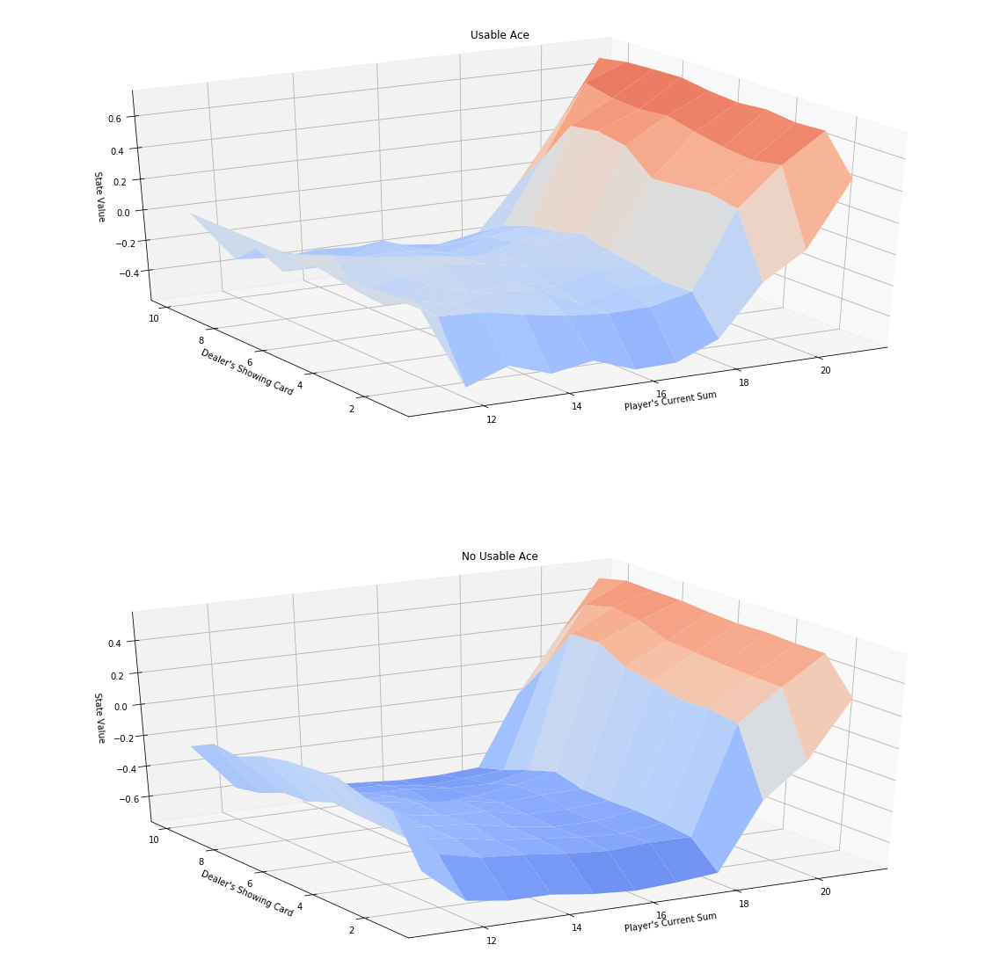

In [12]:
# obtain the action-value function
Q = mc_prediction_q(env, 500000, generate_episode_from_limit_stochastic)

# obtain the corresponding state-value function
V_to_plot = dict((k,(k[0]>18)*(np.dot([0.8, 0.2],v)) + (k[0]<=18)*(np.dot([0.2, 0.8],v))) \
         for k, v in Q.items())

# plot the state-value function
plot_blackjack_values(V_to_plot)

### Part 2: MC Control

In this section, you will write your own implementation of constant-$\alpha$ MC control.  

Your algorithm has four arguments:
- `env`: This is an instance of an OpenAI Gym environment.
- `num_episodes`: This is the number of episodes that are generated through agent-environment interaction.
- `alpha`: This is the step-size parameter for the update step.
- `gamma`: This is the discount rate.  It must be a value between 0 and 1, inclusive (default value: `1`).

The algorithm returns as output:
- `Q`: This is a dictionary (of one-dimensional arrays) where `Q[s][a]` is the estimated action value corresponding to state `s` and action `a`.
- `policy`: This is a dictionary where `policy[s]` returns the action that the agent chooses after observing state `s`.

(_Feel free to define additional functions to help you to organize your code._)

In [9]:
def generate_episode_from_Q(env, Q, epsilon, nA):
    """ generates an episode from following the epsilon-greedy policy """
    episode = []
    state = env.reset()
    while True:
        action = np.random.choice(np.arange(nA), p=get_probs(Q[state], epsilon, nA)) \
                                    if state in Q else env.action_space.sample()
        next_state, reward, done, info = env.step(action)
        episode.append((state, action, reward))
        state = next_state
        if done:
            break
    return episode

def get_probs(Q_s, epsilon, nA):
    """ obtains the action probabilities corresponding to epsilon-greedy policy """
    policy_s = np.ones(nA) * epsilon / nA
    best_a = np.argmax(Q_s)
    policy_s[best_a] = 1 - epsilon + (epsilon / nA)
    return policy_s

def update_Q(env, episode, Q, alpha, gamma):
    """ updates the action-value function estimate using the most recent episode """
    states, actions, rewards = zip(*episode)
    # prepare for discounting
    discounts = np.array([gamma**i for i in range(len(rewards)+1)])
    for i, state in enumerate(states):
        old_Q = Q[state][actions[i]] 
        Q[state][actions[i]] = old_Q + alpha*(sum(rewards[i:]*discounts[:-(1+i)]) - old_Q)
    return Q

In [14]:
def mc_control(env, num_episodes, alpha, gamma=1.0, eps_start=1.0, eps_decay=.999999, eps_min=0.05):
    nA = env.action_space.n
    # initialize empty dictionary of arrays
    Q = defaultdict(lambda: np.zeros(nA))
    epsilon = eps_start
    # loop over episodes
    for i_episode in range(1, num_episodes+1):
        # monitor progress
        if i_episode % 1000 == 0:
            print("\rEpisode {}/{}.".format(i_episode, num_episodes), end="")
            sys.stdout.flush()
        # set the value of epsilon
        epsilon = max(epsilon*eps_decay, eps_min)
        # generate an episode by following epsilon-greedy policy
        episode = generate_episode_from_Q(env, Q, epsilon, nA)
        # update the action-value function estimate using the episode
        Q = update_Q(env, episode, Q, alpha, gamma)
    # determine the policy corresponding to the final action-value function estimate
    policy = dict((k,np.argmax(v)) for k, v in Q.items())
    return policy, Q

Use the cell below to obtain the estimated optimal policy and action-value function.  Note that you should fill in your own values for the `num_episodes` and `alpha` parameters.

In [15]:
# obtain the estimated optimal policy and action-value function
policy, Q = mc_control(env, 5000000, 0.02)

Episode 5000000/5000000.

Next, we plot the corresponding state-value function.

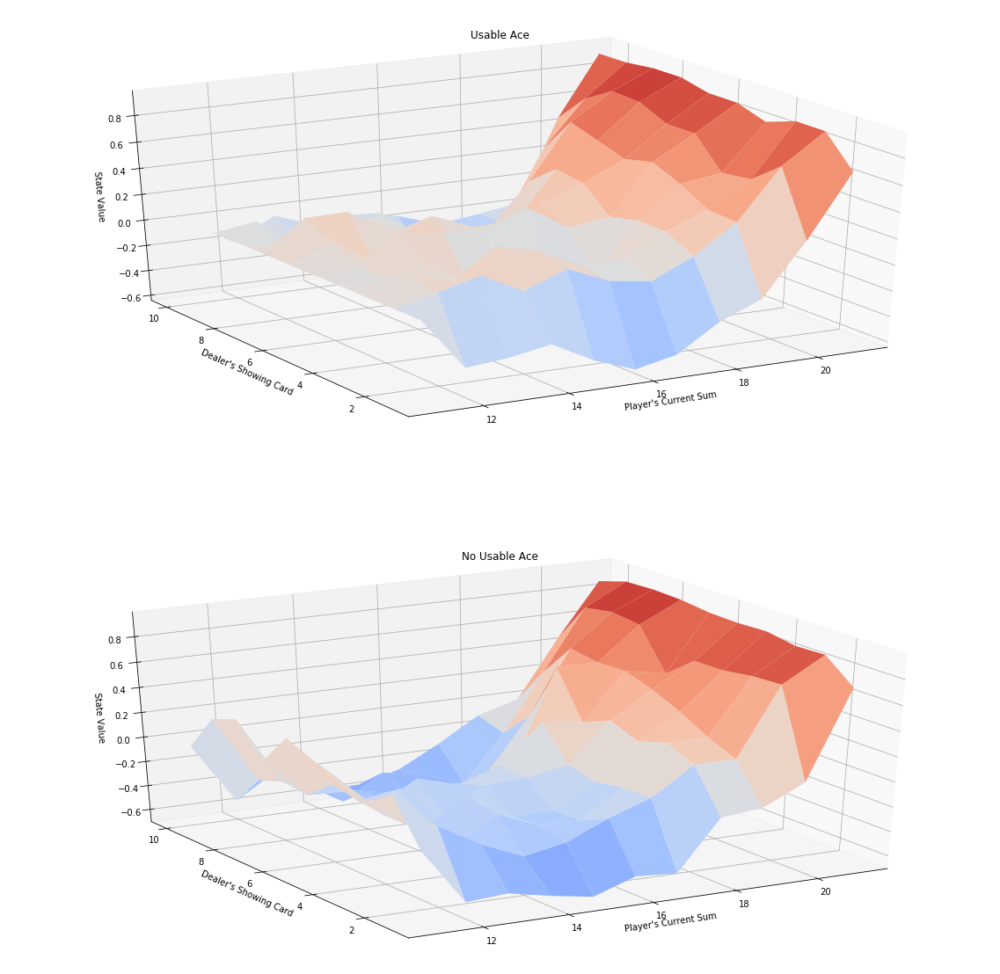

In [16]:
# obtain the corresponding state-value function
V = dict((k,np.max(v)) for k, v in Q.items())

# plot the state-value function
plot_blackjack_values(V)

Finally, we visualize the policy that is estimated to be optimal.

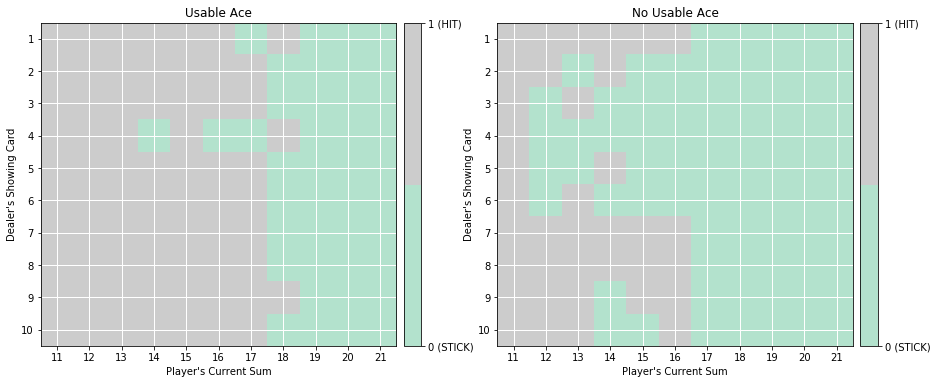

In [17]:
# plot the policy
plot_policy(policy)

The **true** optimal policy $\pi_*$ can be found in Figure 5.2 of the [textbook](http://go.udacity.com/rl-textbook) (and appears below).  Compare your final estimate to the optimal policy - how close are you able to get?  If you are not happy with the performance of your algorithm, take the time to tweak the decay rate of $\epsilon$, change the value of $\alpha$, and/or run the algorithm for more episodes to attain better results.

![True Optimal Policy](images/optimal.png)